# Multiclass Classification - Full Spectra
# Stage of growth

*in this notebook I try to classify stage of crops with the full dataset*

## Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

#DataViz
import seaborn as sns

from sklearn.model_selection import cross_val_score, GridSearchCV, train_test_split   #Perforing grid search
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler

# nn
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
from keras.wrappers.scikit_learn import KerasClassifier

#models
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

In [2]:
df = pd.read_csv('../data/GHISACONUS_2008_001_speclib.csv')

## Nulls

some bandwiths are nulls in all data because information about water absorption has been cleaned.

### DF with nulls at 0

In [3]:
df = df.fillna(value = 0)

Unique ID is different for each row, I will set that as an index.

In [4]:
df.set_index('UniqueID', inplace=True)

In [5]:
df.drop(columns = ['Country'], inplace= True)

### DF without nulls columns

In [6]:
df_no_null = pd.read_csv('GHISACONUS_2008_001_speclib.csv')

In [7]:
df_no_null.dropna(axis = 1, how = 'all', inplace= True)

In [8]:
df_no_null.isnull().sum().sum()

60

In [9]:
df_no_null.dropna(inplace= True)

## Preprocessing

In [10]:
features = [col for col in df_no_null.columns if col.startswith('X')]

In [11]:
stage_target = df_no_null['Stage'].astype('category').cat.codes

In [12]:
X = df_no_null[features]
y = stage_target

In [13]:
X.shape, y.shape

((6933, 131), (6933,))

In [14]:
y.value_counts()

0    1893
2    1296
5    1237
1    1224
4    1057
3     226
dtype: int64

In [16]:
df_no_null['Stage'].value_counts()

Critical         1893
Emerge_VEarly    1296
Mature_Senesc    1237
Early_Mid        1224
Late             1057
Harvest           226
Name: Stage, dtype: int64

In [17]:
labels = { 0: 'Critical',
          1: 'Early_Mid',
          2: 'Emerge_VEarly',
          3: 'Harvest',
          4: 'Late',
          5: 'Mature_Senesc'
}

In [18]:
#Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.15, random_state = 1, stratify=y)

## Gboost

In [16]:
gboost_class = GradientBoostingClassifier(n_estimators=100,
                                          learning_rate=1.0,
                                          max_depth=1,
                                          random_state=0).fit(X_train, y_train)

gboost_class.score(X_train, y_train), gboost_class.score(X_test, y_test)

(0.8435431868318344, 0.7471153846153846)

In [17]:
#parameters = {
#    "loss":["deviance"],
#    "learning_rate": [0.1, 0.2, 0.3, 0.5],
#    "min_samples_split": np.linspace(0.1, 0.5, 12),
#    "min_samples_leaf": np.linspace(0.1, 0.5, 12),
#    "max_depth":[10, 15, 20],
#    "max_features":["log2","sqrt"],
    #"criterion": ["friedman_mse",  "mae"],
    #"subsample":[0.5, 0.6, 0.8, 0.9, 1.0],
#    }

#clf = GridSearchCV(GradientBoostingClassifier(), parameters, cv=5, n_jobs=-2)

#clf.fit(X_train, y_train)
#print(clf.score(X_train, y_train))
#print(clf.score(X_test, y_test))
#print(clf.best_params_)

## ADAboost

In [18]:
ada = AdaBoostClassifier(random_state = 42)
ada.fit(X_train, y_train)
ada_preds = ada.predict(X_test)

In [19]:
print(f' Adaboost Classification Accuracy Score is {accuracy_score(y_test, ada_preds)}')

 Adaboost Classification Accuracy Score is 0.42788461538461536


## SVC

In [20]:
svc = SVC()
svc.fit(X_train,y_train)
svc_preds = svc.predict(X_test)

In [21]:
print(f' SVC Accuracy Score is {accuracy_score(y_test, svc_preds)}')

 SVC Accuracy Score is 0.7076923076923077


## Random Forest

In [22]:
rf = RandomForestClassifier(random_state = 42)
rf.fit(X_train, y_train)
rf_preds = rf.predict(X_test)

In [23]:
print(f'Random Forest Accuracy Score is {accuracy_score(y_test, rf_preds)}')

Random Forest Accuracy Score is 0.8096153846153846


In [24]:
cross_val_score(rf, X_train, y_train, cv=10)

array([0.78813559, 0.80169492, 0.8220339 , 0.7860781 , 0.79796265,
       0.77758913, 0.78947368, 0.78098472, 0.80814941, 0.78777589])

In [68]:
rf_1 = RandomForestClassifier(max_depth = 20,
                              max_features = 'auto',
                              min_samples_leaf = 3,
                              min_samples_split = 5,
                              n_estimators = 250,
                              random_state= 42)
rf_1.fit(X_train, y_train)
rf_1_preds = rf_1.predict(X_test)

In [69]:
print(f'Random Forest 1 Accuracy Score is {accuracy_score(y_test, rf_1_preds)}')

Random Forest 1 Accuracy Score is 0.8009615384615385


## Neural Network

In [16]:
# encode class values as integers
encoder = LabelEncoder()
encoder.fit(y)
encoded_y = encoder.transform(y)
# convert integers to dummy variables (i.e. one hot encoded)
dummy_y = to_categorical(encoded_y)

In [17]:
#Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, dummy_y, test_size = 0.15, random_state = 1, stratify=y)

In [18]:
Z_train, Z_test, z_train, z_test = train_test_split(X, y, test_size = 0.15, random_state = 1, stratify=y)

### Model 1

In [19]:
input_dim = len(X_train.columns)

model = Sequential()
model.add(Dense(8, input_dim = input_dim , activation = 'relu'))
model.add(Dense(20, activation = 'relu'))
model.add(Dense(20, activation = 'relu'))
model.add(Dense(10, activation = 'relu'))
model.add(Dense(6, activation = 'softmax'))

model.compile(loss = 'categorical_crossentropy' , optimizer = 'adam' , metrics = ['accuracy'] )

model.fit(X_train, y_train, epochs = 100, batch_size = 15)

scores = model.evaluate(X_train, y_train)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))


Epoch 1/100
393/393 [==============================] - 1s 615us/step - loss: 2.1626 - accuracy: 0.3316
Epoch 2/100
393/393 [==============================] - 0s 601us/step - loss: 1.1748 - accuracy: 0.5144
Epoch 3/100
393/393 [==============================] - 0s 596us/step - loss: 1.0617 - accuracy: 0.5688
Epoch 4/100
393/393 [==============================] - 0s 593us/step - loss: 1.0196 - accuracy: 0.5820
Epoch 5/100
393/393 [==============================] - 0s 594us/step - loss: 0.9697 - accuracy: 0.6058
Epoch 6/100
393/393 [==============================] - 0s 597us/step - loss: 0.9558 - accuracy: 0.6093
Epoch 7/100
393/393 [==============================] - 0s 603us/step - loss: 0.9303 - accuracy: 0.6218
Epoch 8/100
393/393 [==============================] - 0s 602us/step - loss: 0.9466 - accuracy: 0.6268
Epoch 9/100
393/393 [==============================] - 0s 606us/step - loss: 0.9299 - accuracy: 0.6233
Epoch 10/100
393/393 [==============================] - 0s 606us/step - l

### Searching Params

In [20]:
def model_func(layer_one_neurons = 8, layer_two_neurons = 8, layer_three_neurons = 8):
    model = Sequential()
    #layer 1
    model.add(Dense(layer_one_neurons,
                   activation = 'relu',
                   input_dim = input_dim))

    #layer 2
    model.add(Dense(layer_two_neurons, activation = 'relu'))
    
    #layer 3
    model.add(Dense(layer_three_neurons, activation = 'relu'))

    #output layer
    model.add(Dense(6, activation = 'softmax'))

    #Compile model
    model.compile(loss = 'categorical_crossentropy' , optimizer = 'adam' , metrics = ['accuracy'] )

    return model

nn = KerasClassifier(build_fn = model_func, batch_size =  512, epochs = 10, verbose = 1)

params = {'layer_one_neurons': [16 ,32, 64],
         'layer_two_neurons': [32, 64, 128],
          'layer_three_neurons': [32, 64, 128],
         'batch_size': [256, 512, 1024],
         'epochs': [300, 500, 700]}

gs = GridSearchCV (nn, params, cv = 3)

gs.fit(X_train, y_train)

print (gs.best_score_)
gs.best_params_

Epoch 1/300
16/16 [==============================] - 0s 814us/step - loss: 3.1169 - accuracy: 0.2913
Epoch 2/300
16/16 [==============================] - 0s 769us/step - loss: 1.4143 - accuracy: 0.4318
Epoch 3/300
16/16 [==============================] - 0s 727us/step - loss: 1.1999 - accuracy: 0.5337
Epoch 4/300
16/16 [==============================] - 0s 784us/step - loss: 1.1082 - accuracy: 0.5754
Epoch 5/300
16/16 [==============================] - 0s 744us/step - loss: 1.0441 - accuracy: 0.5848
Epoch 6/300
16/16 [==============================] - 0s 755us/step - loss: 1.0512 - accuracy: 0.5828
Epoch 7/300
16/16 [==============================] - 0s 735us/step - loss: 1.0087 - accuracy: 0.5944
Epoch 8/300
16/16 [==============================] - 0s 732us/step - loss: 0.9894 - accuracy: 0.6062
Epoch 9/300
16/16 [==============================] - 0s 760us/step - loss: 0.9357 - accuracy: 0.6491
Epoch 10/300
16/16 [==============================] - 0s 732us/step - loss: 0.9487 - accura

16/16 [==============================] - 0s 711us/step - loss: 0.5801 - accuracy: 0.7836
Epoch 161/300
16/16 [==============================] - 0s 732us/step - loss: 0.5559 - accuracy: 0.7857
Epoch 162/300
16/16 [==============================] - 0s 735us/step - loss: 0.5690 - accuracy: 0.7900
Epoch 163/300
16/16 [==============================] - 0s 707us/step - loss: 0.5508 - accuracy: 0.7879
Epoch 164/300
16/16 [==============================] - 0s 759us/step - loss: 0.5547 - accuracy: 0.7935
Epoch 165/300
16/16 [==============================] - 0s 711us/step - loss: 0.5693 - accuracy: 0.7802
Epoch 166/300
16/16 [==============================] - 0s 755us/step - loss: 0.6305 - accuracy: 0.7613
Epoch 167/300
16/16 [==============================] - 0s 742us/step - loss: 0.6240 - accuracy: 0.7635
Epoch 168/300
16/16 [==============================] - 0s 728us/step - loss: 0.6299 - accuracy: 0.7590
Epoch 169/300
16/16 [==============================] - 0s 751us/step - loss: 0.6028 - a

16/16 [==============================] - 0s 724us/step - loss: 1.0254 - accuracy: 0.5788
Epoch 19/300
16/16 [==============================] - 0s 737us/step - loss: 1.0074 - accuracy: 0.5819
Epoch 20/300
16/16 [==============================] - 0s 742us/step - loss: 0.9860 - accuracy: 0.5865
Epoch 21/300
16/16 [==============================] - 0s 742us/step - loss: 1.0046 - accuracy: 0.5774
Epoch 22/300
16/16 [==============================] - 0s 754us/step - loss: 0.9748 - accuracy: 0.5971
Epoch 23/300
16/16 [==============================] - 0s 714us/step - loss: 0.9852 - accuracy: 0.5903
Epoch 24/300
16/16 [==============================] - 0s 746us/step - loss: 1.0062 - accuracy: 0.5820
Epoch 25/300
16/16 [==============================] - 0s 728us/step - loss: 0.9750 - accuracy: 0.5867
Epoch 26/300
16/16 [==============================] - 0s 728us/step - loss: 0.9850 - accuracy: 0.5888
Epoch 27/300
16/16 [==============================] - 0s 755us/step - loss: 0.9700 - accuracy: 

16/16 [==============================] - 0s 718us/step - loss: 0.7395 - accuracy: 0.7099
Epoch 178/300
16/16 [==============================] - 0s 728us/step - loss: 0.7495 - accuracy: 0.7064
Epoch 179/300
16/16 [==============================] - 0s 740us/step - loss: 0.7223 - accuracy: 0.7142
Epoch 180/300
16/16 [==============================] - 0s 734us/step - loss: 0.7263 - accuracy: 0.7033
Epoch 181/300
16/16 [==============================] - 0s 758us/step - loss: 0.7505 - accuracy: 0.6931
Epoch 182/300
16/16 [==============================] - 0s 710us/step - loss: 0.7606 - accuracy: 0.6919
Epoch 183/300
16/16 [==============================] - 0s 758us/step - loss: 0.7344 - accuracy: 0.7064
Epoch 184/300
16/16 [==============================] - 0s 728us/step - loss: 0.7360 - accuracy: 0.7099
Epoch 185/300
16/16 [==============================] - 0s 750us/step - loss: 0.7507 - accuracy: 0.7083
Epoch 186/300
16/16 [==============================] - 0s 756us/step - loss: 0.7067 - a

16/16 [==============================] - 0s 753us/step - loss: 0.9276 - accuracy: 0.6168
Epoch 36/300
16/16 [==============================] - 0s 745us/step - loss: 0.9358 - accuracy: 0.6076
Epoch 37/300
16/16 [==============================] - 0s 731us/step - loss: 0.9226 - accuracy: 0.6212
Epoch 38/300
16/16 [==============================] - 0s 731us/step - loss: 0.9060 - accuracy: 0.6196
Epoch 39/300
16/16 [==============================] - 0s 743us/step - loss: 0.9206 - accuracy: 0.6151
Epoch 40/300
16/16 [==============================] - 0s 751us/step - loss: 0.9208 - accuracy: 0.6121
Epoch 41/300
16/16 [==============================] - 0s 733us/step - loss: 0.8996 - accuracy: 0.6258
Epoch 42/300
16/16 [==============================] - 0s 721us/step - loss: 0.9014 - accuracy: 0.6244
Epoch 43/300
16/16 [==============================] - 0s 761us/step - loss: 0.9047 - accuracy: 0.6189
Epoch 44/300
16/16 [==============================] - 0s 731us/step - loss: 0.9087 - accuracy: 

16/16 [==============================] - 0s 735us/step - loss: 0.8115 - accuracy: 0.6656
Epoch 195/300
16/16 [==============================] - 0s 751us/step - loss: 0.7953 - accuracy: 0.6718
Epoch 196/300
16/16 [==============================] - 0s 718us/step - loss: 0.8087 - accuracy: 0.6623
Epoch 197/300
16/16 [==============================] - 0s 767us/step - loss: 0.7723 - accuracy: 0.6906
Epoch 198/300
16/16 [==============================] - 0s 760us/step - loss: 0.8108 - accuracy: 0.6600
Epoch 199/300
16/16 [==============================] - 0s 733us/step - loss: 0.7855 - accuracy: 0.6694
Epoch 200/300
16/16 [==============================] - 0s 749us/step - loss: 0.8133 - accuracy: 0.6553
Epoch 201/300
16/16 [==============================] - 0s 719us/step - loss: 0.7808 - accuracy: 0.6780
Epoch 202/300
16/16 [==============================] - 0s 757us/step - loss: 0.7944 - accuracy: 0.6749
Epoch 203/300
16/16 [==============================] - 0s 733us/step - loss: 0.8113 - a

16/16 [==============================] - 0s 967us/step - loss: 0.7584 - accuracy: 0.7048
Epoch 53/300
16/16 [==============================] - 0s 920us/step - loss: 0.7858 - accuracy: 0.6911
Epoch 54/300
16/16 [==============================] - 0s 946us/step - loss: 0.7777 - accuracy: 0.6837
Epoch 55/300
16/16 [==============================] - 0s 830us/step - loss: 0.7506 - accuracy: 0.7075
Epoch 56/300
16/16 [==============================] - 0s 774us/step - loss: 0.7518 - accuracy: 0.7138
Epoch 57/300
16/16 [==============================] - 0s 746us/step - loss: 0.7450 - accuracy: 0.7055
Epoch 58/300
16/16 [==============================] - 0s 797us/step - loss: 0.7396 - accuracy: 0.7112
Epoch 59/300
16/16 [==============================] - 0s 762us/step - loss: 0.7657 - accuracy: 0.7025
Epoch 60/300
16/16 [==============================] - 0s 779us/step - loss: 0.7484 - accuracy: 0.7042
Epoch 61/300
16/16 [==============================] - 0s 774us/step - loss: 0.7466 - accuracy: 

16/16 [==============================] - 0s 756us/step - loss: 0.5970 - accuracy: 0.7826
Epoch 133/300
16/16 [==============================] - 0s 766us/step - loss: 0.5875 - accuracy: 0.7830
Epoch 134/300
16/16 [==============================] - 0s 753us/step - loss: 0.5789 - accuracy: 0.7807
Epoch 135/300
16/16 [==============================] - 0s 779us/step - loss: 0.5770 - accuracy: 0.7824
Epoch 136/300
16/16 [==============================] - 0s 777us/step - loss: 0.5854 - accuracy: 0.7820
Epoch 137/300
16/16 [==============================] - 0s 749us/step - loss: 0.5612 - accuracy: 0.7894
Epoch 138/300
16/16 [==============================] - 0s 788us/step - loss: 0.5907 - accuracy: 0.7821
Epoch 139/300
16/16 [==============================] - 0s 762us/step - loss: 0.5986 - accuracy: 0.7752
Epoch 140/300
16/16 [==============================] - 0s 772us/step - loss: 0.5737 - accuracy: 0.7741
Epoch 141/300
16/16 [==============================] - 0s 772us/step - loss: 0.6241 - a

16/16 [==============================] - 0s 773us/step - loss: 0.4469 - accuracy: 0.8513
Epoch 291/300
16/16 [==============================] - 0s 773us/step - loss: 0.4643 - accuracy: 0.8283
Epoch 292/300
16/16 [==============================] - 0s 766us/step - loss: 0.4467 - accuracy: 0.8373
Epoch 293/300
16/16 [==============================] - 0s 766us/step - loss: 0.4748 - accuracy: 0.8223
Epoch 294/300
16/16 [==============================] - 0s 742us/step - loss: 0.4673 - accuracy: 0.8225
Epoch 295/300
16/16 [==============================] - 0s 793us/step - loss: 0.4916 - accuracy: 0.8184
Epoch 296/300
16/16 [==============================] - 0s 747us/step - loss: 0.4845 - accuracy: 0.8252
Epoch 297/300
16/16 [==============================] - 0s 788us/step - loss: 0.4356 - accuracy: 0.8394
Epoch 298/300
16/16 [==============================] - 0s 743us/step - loss: 0.4474 - accuracy: 0.8354
Epoch 299/300
16/16 [==============================] - 0s 764us/step - loss: 0.4711 - a

Epoch 149/300
16/16 [==============================] - 0s 780us/step - loss: 0.6150 - accuracy: 0.7675
Epoch 150/300
16/16 [==============================] - 0s 757us/step - loss: 0.6142 - accuracy: 0.7636
Epoch 151/300
16/16 [==============================] - 0s 759us/step - loss: 0.5701 - accuracy: 0.7868
Epoch 152/300
16/16 [==============================] - 0s 772us/step - loss: 0.5837 - accuracy: 0.7757
Epoch 153/300
16/16 [==============================] - 0s 774us/step - loss: 0.5663 - accuracy: 0.7794
Epoch 154/300
16/16 [==============================] - 0s 770us/step - loss: 0.5646 - accuracy: 0.7863
Epoch 155/300
16/16 [==============================] - 0s 750us/step - loss: 0.5571 - accuracy: 0.7977
Epoch 156/300
16/16 [==============================] - 0s 782us/step - loss: 0.5378 - accuracy: 0.8024
Epoch 157/300
16/16 [==============================] - 0s 772us/step - loss: 0.5666 - accuracy: 0.7892
Epoch 158/300
16/16 [==============================] - 0s 778us/step - lo

Epoch 7/300
16/16 [==============================] - 0s 770us/step - loss: 1.0420 - accuracy: 0.6057
Epoch 8/300
16/16 [==============================] - 0s 759us/step - loss: 1.0197 - accuracy: 0.5977
Epoch 9/300
16/16 [==============================] - 0s 760us/step - loss: 1.0074 - accuracy: 0.6005
Epoch 10/300
16/16 [==============================] - 0s 786us/step - loss: 0.9909 - accuracy: 0.6120
Epoch 11/300
16/16 [==============================] - 0s 751us/step - loss: 0.9949 - accuracy: 0.5945
Epoch 12/300
16/16 [==============================] - 0s 767us/step - loss: 0.9465 - accuracy: 0.6219
Epoch 13/300
16/16 [==============================] - 0s 752us/step - loss: 0.9565 - accuracy: 0.6162
Epoch 14/300
16/16 [==============================] - 0s 776us/step - loss: 0.9429 - accuracy: 0.6114
Epoch 15/300
16/16 [==============================] - 0s 779us/step - loss: 0.9308 - accuracy: 0.6350
Epoch 16/300
16/16 [==============================] - 0s 760us/step - loss: 0.9578 - 

16/16 [==============================] - 0s 783us/step - loss: 0.6154 - accuracy: 0.7597
Epoch 167/300
16/16 [==============================] - 0s 757us/step - loss: 0.6082 - accuracy: 0.7619
Epoch 168/300
16/16 [==============================] - 0s 758us/step - loss: 0.6513 - accuracy: 0.7505
Epoch 169/300
16/16 [==============================] - 0s 758us/step - loss: 0.6122 - accuracy: 0.7555
Epoch 170/300
16/16 [==============================] - 0s 787us/step - loss: 0.6248 - accuracy: 0.7574
Epoch 171/300
16/16 [==============================] - 0s 759us/step - loss: 0.6203 - accuracy: 0.7577
Epoch 172/300
16/16 [==============================] - 0s 795us/step - loss: 0.6333 - accuracy: 0.7550
Epoch 173/300
16/16 [==============================] - 0s 796us/step - loss: 0.5998 - accuracy: 0.7655
Epoch 174/300
16/16 [==============================] - 0s 749us/step - loss: 0.6124 - accuracy: 0.7656
Epoch 175/300
16/16 [==============================] - 0s 793us/step - loss: 0.6418 - a

16/16 [==============================] - 0s 816us/step - loss: 0.9837 - accuracy: 0.6021
Epoch 25/300
16/16 [==============================] - 0s 810us/step - loss: 1.0052 - accuracy: 0.5991
Epoch 26/300
16/16 [==============================] - 0s 789us/step - loss: 1.0005 - accuracy: 0.5895
Epoch 27/300
16/16 [==============================] - 0s 816us/step - loss: 0.9828 - accuracy: 0.6100
Epoch 28/300
16/16 [==============================] - 0s 805us/step - loss: 0.9458 - accuracy: 0.6199
Epoch 29/300
16/16 [==============================] - 0s 843us/step - loss: 0.9696 - accuracy: 0.6122
Epoch 30/300
16/16 [==============================] - 0s 783us/step - loss: 0.9230 - accuracy: 0.6245
Epoch 31/300
16/16 [==============================] - 0s 829us/step - loss: 0.9399 - accuracy: 0.6141
Epoch 32/300
16/16 [==============================] - 0s 806us/step - loss: 0.9507 - accuracy: 0.5939
Epoch 33/300
16/16 [==============================] - 0s 785us/step - loss: 0.9484 - accuracy: 

16/16 [==============================] - 0s 831us/step - loss: 0.5673 - accuracy: 0.7792
Epoch 184/300
16/16 [==============================] - 0s 790us/step - loss: 0.5694 - accuracy: 0.7712
Epoch 185/300
16/16 [==============================] - 0s 849us/step - loss: 0.5683 - accuracy: 0.7682
Epoch 186/300
16/16 [==============================] - 0s 801us/step - loss: 0.5779 - accuracy: 0.7677
Epoch 187/300
16/16 [==============================] - 0s 811us/step - loss: 0.5701 - accuracy: 0.7767
Epoch 188/300
16/16 [==============================] - 0s 805us/step - loss: 0.6142 - accuracy: 0.7526
Epoch 189/300
16/16 [==============================] - 0s 779us/step - loss: 0.5958 - accuracy: 0.7675
Epoch 190/300
16/16 [==============================] - 0s 833us/step - loss: 0.6112 - accuracy: 0.7583
Epoch 191/300
16/16 [==============================] - 0s 781us/step - loss: 0.5772 - accuracy: 0.7719
Epoch 192/300
16/16 [==============================] - 0s 855us/step - loss: 0.5666 - a

16/16 [==============================] - 0s 817us/step - loss: 0.8112 - accuracy: 0.6746
Epoch 42/300
16/16 [==============================] - 0s 838us/step - loss: 0.8300 - accuracy: 0.6691
Epoch 43/300
16/16 [==============================] - 0s 789us/step - loss: 0.8127 - accuracy: 0.6814
Epoch 44/300
16/16 [==============================] - 0s 831us/step - loss: 0.7952 - accuracy: 0.6752
Epoch 45/300
16/16 [==============================] - 0s 809us/step - loss: 0.7907 - accuracy: 0.6926
Epoch 46/300
16/16 [==============================] - 0s 822us/step - loss: 0.7817 - accuracy: 0.6965
Epoch 47/300
16/16 [==============================] - 0s 820us/step - loss: 0.8088 - accuracy: 0.6766
Epoch 48/300
16/16 [==============================] - 0s 824us/step - loss: 0.8176 - accuracy: 0.6762
Epoch 49/300
16/16 [==============================] - 0s 821us/step - loss: 0.8082 - accuracy: 0.6708
Epoch 50/300
16/16 [==============================] - 0s 800us/step - loss: 0.7863 - accuracy: 

16/16 [==============================] - 0s 795us/step - loss: 0.5796 - accuracy: 0.7797
Epoch 201/300
16/16 [==============================] - 0s 809us/step - loss: 0.5530 - accuracy: 0.7994
Epoch 202/300
16/16 [==============================] - 0s 833us/step - loss: 0.5712 - accuracy: 0.7729
Epoch 203/300
16/16 [==============================] - 0s 807us/step - loss: 0.5901 - accuracy: 0.7718
Epoch 204/300
16/16 [==============================] - 0s 815us/step - loss: 0.5574 - accuracy: 0.7912
Epoch 205/300
16/16 [==============================] - 0s 802us/step - loss: 0.5414 - accuracy: 0.7952
Epoch 206/300
16/16 [==============================] - 0s 830us/step - loss: 0.5224 - accuracy: 0.7973
Epoch 207/300
16/16 [==============================] - 0s 794us/step - loss: 0.5483 - accuracy: 0.7821
Epoch 208/300
16/16 [==============================] - 0s 818us/step - loss: 0.5738 - accuracy: 0.7819
Epoch 209/300
16/16 [==============================] - 0s 815us/step - loss: 0.5622 - a

16/16 [==============================] - 0s 834us/step - loss: 0.6859 - accuracy: 0.7370
Epoch 59/300
16/16 [==============================] - 0s 817us/step - loss: 0.6889 - accuracy: 0.7209
Epoch 60/300
16/16 [==============================] - 0s 830us/step - loss: 0.6668 - accuracy: 0.7390
Epoch 61/300
16/16 [==============================] - 0s 808us/step - loss: 0.6500 - accuracy: 0.7545
Epoch 62/300
16/16 [==============================] - 0s 817us/step - loss: 0.6677 - accuracy: 0.7398
Epoch 63/300
16/16 [==============================] - 0s 803us/step - loss: 0.7154 - accuracy: 0.7108
Epoch 64/300
16/16 [==============================] - 0s 835us/step - loss: 0.6933 - accuracy: 0.7319
Epoch 65/300
16/16 [==============================] - 0s 813us/step - loss: 0.6553 - accuracy: 0.7427
Epoch 66/300
16/16 [==============================] - 0s 824us/step - loss: 0.6532 - accuracy: 0.7529
Epoch 67/300
16/16 [==============================] - 0s 794us/step - loss: 0.6410 - accuracy: 

16/16 [==============================] - 0s 827us/step - loss: 0.5632 - accuracy: 0.7920
Epoch 139/300
16/16 [==============================] - 0s 827us/step - loss: 0.5611 - accuracy: 0.7921
Epoch 140/300
16/16 [==============================] - 0s 808us/step - loss: 0.5780 - accuracy: 0.7810
Epoch 141/300
16/16 [==============================] - 0s 829us/step - loss: 0.5530 - accuracy: 0.7890
Epoch 142/300
16/16 [==============================] - 0s 809us/step - loss: 0.6055 - accuracy: 0.7650
Epoch 143/300
16/16 [==============================] - 0s 833us/step - loss: 0.5795 - accuracy: 0.7704
Epoch 144/300
16/16 [==============================] - 0s 809us/step - loss: 0.5888 - accuracy: 0.7691
Epoch 145/300
16/16 [==============================] - 0s 816us/step - loss: 0.5526 - accuracy: 0.7890
Epoch 146/300
16/16 [==============================] - 0s 827us/step - loss: 0.5175 - accuracy: 0.8055
Epoch 147/300
16/16 [==============================] - 0s 818us/step - loss: 0.5347 - a

16/16 [==============================] - 0s 816us/step - loss: 0.4240 - accuracy: 0.8376
Epoch 297/300
16/16 [==============================] - 0s 820us/step - loss: 0.4226 - accuracy: 0.8386
Epoch 298/300
16/16 [==============================] - 0s 804us/step - loss: 0.4176 - accuracy: 0.8533
Epoch 299/300
16/16 [==============================] - 0s 831us/step - loss: 0.4403 - accuracy: 0.8365
Epoch 300/300
8/8 [==============================] - 0s 879us/step - loss: 0.5776 - accuracy: 0.7979
Epoch 1/300
16/16 [==============================] - 0s 1ms/step - loss: 5.1418 - accuracy: 0.2196
Epoch 2/300
16/16 [==============================] - 0s 819us/step - loss: 1.4014 - accuracy: 0.4693
Epoch 3/300
16/16 [==============================] - 0s 752us/step - loss: 1.1658 - accuracy: 0.5555
Epoch 4/300
16/16 [==============================] - 0s 813us/step - loss: 1.0490 - accuracy: 0.5879
Epoch 5/300
16/16 [==============================] - 0s 738us/step - loss: 1.0274 - accuracy: 0.587

16/16 [==============================] - 0s 738us/step - loss: 0.5353 - accuracy: 0.7889
Epoch 155/300
16/16 [==============================] - 0s 718us/step - loss: 0.5663 - accuracy: 0.7721
Epoch 156/300
16/16 [==============================] - 0s 796us/step - loss: 0.5645 - accuracy: 0.7863
Epoch 157/300
16/16 [==============================] - 0s 744us/step - loss: 0.5853 - accuracy: 0.7780
Epoch 158/300
16/16 [==============================] - 0s 756us/step - loss: 0.5986 - accuracy: 0.7639
Epoch 159/300
16/16 [==============================] - 0s 765us/step - loss: 0.5622 - accuracy: 0.7856
Epoch 160/300
16/16 [==============================] - 0s 717us/step - loss: 0.5897 - accuracy: 0.7749
Epoch 161/300
16/16 [==============================] - 0s 785us/step - loss: 0.5552 - accuracy: 0.7882
Epoch 162/300
16/16 [==============================] - 0s 728us/step - loss: 0.5474 - accuracy: 0.7905
Epoch 163/300
16/16 [==============================] - 0s 769us/step - loss: 0.5664 - a

16/16 [==============================] - 0s 729us/step - loss: 0.9459 - accuracy: 0.6355
Epoch 13/300
16/16 [==============================] - 0s 765us/step - loss: 0.9177 - accuracy: 0.6385
Epoch 14/300
16/16 [==============================] - 0s 734us/step - loss: 0.9303 - accuracy: 0.6352
Epoch 15/300
16/16 [==============================] - 0s 772us/step - loss: 0.9037 - accuracy: 0.6413
Epoch 16/300
16/16 [==============================] - 0s 754us/step - loss: 0.8970 - accuracy: 0.6389
Epoch 17/300
16/16 [==============================] - 0s 741us/step - loss: 0.9047 - accuracy: 0.6438
Epoch 18/300
16/16 [==============================] - 0s 765us/step - loss: 0.8867 - accuracy: 0.6515
Epoch 19/300
16/16 [==============================] - 0s 740us/step - loss: 0.8585 - accuracy: 0.6616
Epoch 20/300
16/16 [==============================] - 0s 777us/step - loss: 0.8677 - accuracy: 0.6660
Epoch 21/300
16/16 [==============================] - 0s 758us/step - loss: 0.8665 - accuracy: 

16/16 [==============================] - 0s 744us/step - loss: 0.5283 - accuracy: 0.7917
Epoch 172/300
16/16 [==============================] - 0s 757us/step - loss: 0.5838 - accuracy: 0.7707
Epoch 173/300
16/16 [==============================] - 0s 807us/step - loss: 0.5239 - accuracy: 0.8025
Epoch 174/300
16/16 [==============================] - 0s 756us/step - loss: 0.5113 - accuracy: 0.8076
Epoch 175/300
16/16 [==============================] - 0s 805us/step - loss: 0.5110 - accuracy: 0.8041
Epoch 176/300
16/16 [==============================] - 0s 751us/step - loss: 0.5195 - accuracy: 0.7969
Epoch 177/300
16/16 [==============================] - 0s 780us/step - loss: 0.5042 - accuracy: 0.8081
Epoch 178/300
16/16 [==============================] - 0s 740us/step - loss: 0.5028 - accuracy: 0.8078
Epoch 179/300
16/16 [==============================] - 0s 741us/step - loss: 0.5176 - accuracy: 0.7947
Epoch 180/300
16/16 [==============================] - 0s 770us/step - loss: 0.4911 - a

16/16 [==============================] - 0s 729us/step - loss: 0.8733 - accuracy: 0.6594
Epoch 30/300
16/16 [==============================] - 0s 754us/step - loss: 0.8600 - accuracy: 0.6613
Epoch 31/300
16/16 [==============================] - 0s 738us/step - loss: 0.8556 - accuracy: 0.6620
Epoch 32/300
16/16 [==============================] - 0s 762us/step - loss: 0.8624 - accuracy: 0.6508
Epoch 33/300
16/16 [==============================] - 0s 751us/step - loss: 0.8478 - accuracy: 0.6757
Epoch 34/300
16/16 [==============================] - 0s 731us/step - loss: 0.8282 - accuracy: 0.6847
Epoch 35/300
16/16 [==============================] - 0s 770us/step - loss: 0.8226 - accuracy: 0.6817
Epoch 36/300
16/16 [==============================] - 0s 978us/step - loss: 0.8207 - accuracy: 0.6770
Epoch 37/300
16/16 [==============================] - 0s 786us/step - loss: 0.7981 - accuracy: 0.6937
Epoch 38/300
16/16 [==============================] - 0s 749us/step - loss: 0.8180 - accuracy: 

16/16 [==============================] - 0s 757us/step - loss: 0.6115 - accuracy: 0.7710
Epoch 189/300
16/16 [==============================] - 0s 738us/step - loss: 0.6028 - accuracy: 0.7620
Epoch 190/300
16/16 [==============================] - 0s 724us/step - loss: 0.6158 - accuracy: 0.7680
Epoch 191/300
16/16 [==============================] - 0s 758us/step - loss: 0.6274 - accuracy: 0.7597
Epoch 192/300
16/16 [==============================] - 0s 738us/step - loss: 0.5909 - accuracy: 0.7715
Epoch 193/300
16/16 [==============================] - 0s 734us/step - loss: 0.5874 - accuracy: 0.7726
Epoch 194/300
16/16 [==============================] - 0s 776us/step - loss: 0.5900 - accuracy: 0.7636
Epoch 195/300
16/16 [==============================] - 0s 726us/step - loss: 0.5988 - accuracy: 0.7691
Epoch 196/300
16/16 [==============================] - 0s 776us/step - loss: 0.5877 - accuracy: 0.7713
Epoch 197/300
16/16 [==============================] - 0s 728us/step - loss: 0.5867 - a

16/16 [==============================] - 0s 780us/step - loss: 0.8006 - accuracy: 0.6644
Epoch 47/300
16/16 [==============================] - 0s 803us/step - loss: 0.7831 - accuracy: 0.6834
Epoch 48/300
16/16 [==============================] - 0s 792us/step - loss: 0.8079 - accuracy: 0.6724
Epoch 49/300
16/16 [==============================] - 0s 795us/step - loss: 0.8063 - accuracy: 0.6682
Epoch 50/300
16/16 [==============================] - 0s 790us/step - loss: 0.7896 - accuracy: 0.6789
Epoch 51/300
16/16 [==============================] - 0s 775us/step - loss: 0.7871 - accuracy: 0.6751
Epoch 52/300
16/16 [==============================] - 0s 806us/step - loss: 0.7802 - accuracy: 0.6705
Epoch 53/300
16/16 [==============================] - 0s 764us/step - loss: 0.7771 - accuracy: 0.6858
Epoch 54/300
16/16 [==============================] - 0s 796us/step - loss: 0.7848 - accuracy: 0.6800
Epoch 55/300
16/16 [==============================] - 0s 775us/step - loss: 0.8095 - accuracy: 

16/16 [==============================] - 0s 771us/step - loss: 0.6955 - accuracy: 0.7210
Epoch 206/300
16/16 [==============================] - 0s 765us/step - loss: 0.6701 - accuracy: 0.7214
Epoch 207/300
16/16 [==============================] - 0s 784us/step - loss: 0.6686 - accuracy: 0.7275
Epoch 208/300
16/16 [==============================] - 0s 783us/step - loss: 0.6810 - accuracy: 0.7244
Epoch 209/300
16/16 [==============================] - 0s 788us/step - loss: 0.6676 - accuracy: 0.7336
Epoch 210/300
16/16 [==============================] - 0s 794us/step - loss: 0.6725 - accuracy: 0.7227
Epoch 211/300
16/16 [==============================] - 0s 791us/step - loss: 0.6764 - accuracy: 0.7258
Epoch 212/300
16/16 [==============================] - 0s 805us/step - loss: 0.6753 - accuracy: 0.7230
Epoch 213/300
16/16 [==============================] - 0s 748us/step - loss: 0.6751 - accuracy: 0.7140
Epoch 214/300
16/16 [==============================] - 0s 838us/step - loss: 0.7162 - a

16/16 [==============================] - 0s 803us/step - loss: 0.6855 - accuracy: 0.7330
Epoch 64/300
16/16 [==============================] - 0s 770us/step - loss: 0.6398 - accuracy: 0.7451
Epoch 65/300
16/16 [==============================] - 0s 841us/step - loss: 0.6280 - accuracy: 0.7597
Epoch 66/300
16/16 [==============================] - 0s 812us/step - loss: 0.6197 - accuracy: 0.7655
Epoch 67/300
16/16 [==============================] - 0s 830us/step - loss: 0.6567 - accuracy: 0.7436
Epoch 68/300
16/16 [==============================] - 0s 761us/step - loss: 0.6789 - accuracy: 0.7298
Epoch 69/300
16/16 [==============================] - 0s 786us/step - loss: 0.6380 - accuracy: 0.7468
Epoch 70/300
16/16 [==============================] - 0s 813us/step - loss: 0.6118 - accuracy: 0.7620
Epoch 71/300
16/16 [==============================] - 0s 780us/step - loss: 0.6128 - accuracy: 0.7570
Epoch 72/300
16/16 [==============================] - 0s 814us/step - loss: 0.6405 - accuracy: 

16/16 [==============================] - 0s 795us/step - loss: 0.5373 - accuracy: 0.7970
Epoch 144/300
16/16 [==============================] - 0s 809us/step - loss: 0.5248 - accuracy: 0.8043
Epoch 145/300
16/16 [==============================] - 0s 781us/step - loss: 0.5512 - accuracy: 0.7884
Epoch 146/300
16/16 [==============================] - 0s 813us/step - loss: 0.5222 - accuracy: 0.8011
Epoch 147/300
16/16 [==============================] - 0s 765us/step - loss: 0.5367 - accuracy: 0.7975
Epoch 148/300
16/16 [==============================] - 0s 807us/step - loss: 0.5383 - accuracy: 0.7909
Epoch 149/300
16/16 [==============================] - 0s 822us/step - loss: 0.5200 - accuracy: 0.8010
Epoch 150/300
16/16 [==============================] - 0s 796us/step - loss: 0.5467 - accuracy: 0.7940
Epoch 151/300
16/16 [==============================] - 0s 792us/step - loss: 0.5333 - accuracy: 0.7997
Epoch 152/300
16/16 [==============================] - 0s 789us/step - loss: 0.5061 - a

8/8 [==============================] - 0s 868us/step - loss: 0.5435 - accuracy: 0.7887
Epoch 1/300
16/16 [==============================] - 0s 1ms/step - loss: 3.7250 - accuracy: 0.3029
Epoch 2/300
16/16 [==============================] - 0s 885us/step - loss: 1.3402 - accuracy: 0.4375
Epoch 3/300
16/16 [==============================] - 0s 792us/step - loss: 1.1792 - accuracy: 0.5153
Epoch 4/300
16/16 [==============================] - 0s 881us/step - loss: 1.1320 - accuracy: 0.5303
Epoch 5/300
16/16 [==============================] - 0s 801us/step - loss: 1.0869 - accuracy: 0.5318
Epoch 6/300
16/16 [==============================] - 0s 829us/step - loss: 1.0704 - accuracy: 0.5389
Epoch 7/300
16/16 [==============================] - 0s 794us/step - loss: 1.0369 - accuracy: 0.5626
Epoch 8/300
16/16 [==============================] - 0s 768us/step - loss: 1.0262 - accuracy: 0.5717
Epoch 9/300
16/16 [==============================] - 0s 831us/step - loss: 1.0046 - accuracy: 0.5737
Epoch 

16/16 [==============================] - 0s 818us/step - loss: 0.5599 - accuracy: 0.7841
Epoch 160/300
16/16 [==============================] - 0s 785us/step - loss: 0.5817 - accuracy: 0.7818
Epoch 161/300
16/16 [==============================] - 0s 791us/step - loss: 0.5902 - accuracy: 0.7647
Epoch 162/300
16/16 [==============================] - 0s 806us/step - loss: 0.5574 - accuracy: 0.7932
Epoch 163/300
16/16 [==============================] - 0s 810us/step - loss: 0.5619 - accuracy: 0.7848
Epoch 164/300
16/16 [==============================] - 0s 794us/step - loss: 0.5575 - accuracy: 0.7911
Epoch 165/300
16/16 [==============================] - 0s 813us/step - loss: 0.5804 - accuracy: 0.7807
Epoch 166/300
16/16 [==============================] - 0s 786us/step - loss: 0.5716 - accuracy: 0.7882
Epoch 167/300
16/16 [==============================] - 0s 788us/step - loss: 0.5794 - accuracy: 0.7789
Epoch 168/300
16/16 [==============================] - 0s 804us/step - loss: 0.5765 - a

16/16 [==============================] - 0s 907us/step - loss: 0.8313 - accuracy: 0.6740
Epoch 18/300
16/16 [==============================] - 0s 856us/step - loss: 0.7964 - accuracy: 0.6934
Epoch 19/300
16/16 [==============================] - 0s 867us/step - loss: 0.8099 - accuracy: 0.6767
Epoch 20/300
16/16 [==============================] - 0s 876us/step - loss: 0.7853 - accuracy: 0.7058
Epoch 21/300
16/16 [==============================] - 0s 854us/step - loss: 0.7988 - accuracy: 0.6818
Epoch 22/300
16/16 [==============================] - 0s 876us/step - loss: 0.7636 - accuracy: 0.6955
Epoch 23/300
16/16 [==============================] - 0s 875us/step - loss: 0.7930 - accuracy: 0.6889
Epoch 24/300
16/16 [==============================] - 0s 871us/step - loss: 0.7936 - accuracy: 0.6824
Epoch 25/300
16/16 [==============================] - 0s 886us/step - loss: 0.7561 - accuracy: 0.7144
Epoch 26/300
16/16 [==============================] - 0s 863us/step - loss: 0.7562 - accuracy: 

16/16 [==============================] - 0s 862us/step - loss: 0.4746 - accuracy: 0.8184
Epoch 177/300
16/16 [==============================] - 0s 864us/step - loss: 0.4515 - accuracy: 0.8266
Epoch 178/300
16/16 [==============================] - 0s 857us/step - loss: 0.4724 - accuracy: 0.8184
Epoch 179/300
16/16 [==============================] - 0s 897us/step - loss: 0.4668 - accuracy: 0.8151
Epoch 180/300
16/16 [==============================] - 0s 865us/step - loss: 0.4643 - accuracy: 0.8275
Epoch 181/300
16/16 [==============================] - 0s 855us/step - loss: 0.4545 - accuracy: 0.8306
Epoch 182/300
16/16 [==============================] - 0s 869us/step - loss: 0.4476 - accuracy: 0.8315
Epoch 183/300
16/16 [==============================] - 0s 852us/step - loss: 0.4384 - accuracy: 0.8411
Epoch 184/300
16/16 [==============================] - 0s 882us/step - loss: 0.4288 - accuracy: 0.8377
Epoch 185/300
16/16 [==============================] - 0s 837us/step - loss: 0.4302 - a

16/16 [==============================] - 0s 849us/step - loss: 0.7881 - accuracy: 0.6877
Epoch 35/300
16/16 [==============================] - 0s 885us/step - loss: 0.8038 - accuracy: 0.6860
Epoch 36/300
16/16 [==============================] - 0s 849us/step - loss: 0.7861 - accuracy: 0.6956
Epoch 37/300
16/16 [==============================] - 0s 873us/step - loss: 0.7477 - accuracy: 0.7083
Epoch 38/300
16/16 [==============================] - 0s 851us/step - loss: 0.7744 - accuracy: 0.7033
Epoch 39/300
16/16 [==============================] - 0s 859us/step - loss: 0.7650 - accuracy: 0.7063
Epoch 40/300
16/16 [==============================] - 0s 899us/step - loss: 0.7569 - accuracy: 0.7041
Epoch 41/300
16/16 [==============================] - 0s 865us/step - loss: 0.7836 - accuracy: 0.6864
Epoch 42/300
16/16 [==============================] - 0s 912us/step - loss: 0.7455 - accuracy: 0.7085
Epoch 43/300
16/16 [==============================] - 0s 839us/step - loss: 0.7708 - accuracy: 

16/16 [==============================] - 0s 893us/step - loss: 0.5286 - accuracy: 0.7946
Epoch 194/300
16/16 [==============================] - 0s 853us/step - loss: 0.5185 - accuracy: 0.7985
Epoch 195/300
16/16 [==============================] - 0s 855us/step - loss: 0.5421 - accuracy: 0.7975
Epoch 196/300
16/16 [==============================] - 0s 863us/step - loss: 0.4849 - accuracy: 0.8148
Epoch 197/300
16/16 [==============================] - 0s 864us/step - loss: 0.5161 - accuracy: 0.8065
Epoch 198/300
16/16 [==============================] - 0s 870us/step - loss: 0.5483 - accuracy: 0.7826
Epoch 199/300
16/16 [==============================] - 0s 878us/step - loss: 0.5261 - accuracy: 0.7994
Epoch 200/300
16/16 [==============================] - 0s 847us/step - loss: 0.5445 - accuracy: 0.7918
Epoch 201/300
16/16 [==============================] - 0s 879us/step - loss: 0.5032 - accuracy: 0.8081
Epoch 202/300
16/16 [==============================] - 0s 834us/step - loss: 0.5130 - a

16/16 [==============================] - 0s 853us/step - loss: 0.7276 - accuracy: 0.7161
Epoch 52/300
16/16 [==============================] - 0s 862us/step - loss: 0.7343 - accuracy: 0.7125
Epoch 53/300
16/16 [==============================] - 0s 862us/step - loss: 0.7333 - accuracy: 0.7007
Epoch 54/300
16/16 [==============================] - 0s 902us/step - loss: 0.7191 - accuracy: 0.7219
Epoch 55/300
16/16 [==============================] - 0s 868us/step - loss: 0.7104 - accuracy: 0.7257
Epoch 56/300
16/16 [==============================] - 0s 855us/step - loss: 0.6787 - accuracy: 0.7354
Epoch 57/300
16/16 [==============================] - 0s 845us/step - loss: 0.6976 - accuracy: 0.7266
Epoch 58/300
16/16 [==============================] - 0s 894us/step - loss: 0.7027 - accuracy: 0.7357
Epoch 59/300
16/16 [==============================] - 0s 825us/step - loss: 0.7208 - accuracy: 0.7156
Epoch 60/300
16/16 [==============================] - 0s 876us/step - loss: 0.7100 - accuracy: 

16/16 [==============================] - 0s 835us/step - loss: 0.5401 - accuracy: 0.7891
Epoch 211/300
16/16 [==============================] - 0s 848us/step - loss: 0.5344 - accuracy: 0.7971
Epoch 212/300
16/16 [==============================] - 0s 844us/step - loss: 0.5087 - accuracy: 0.7997
Epoch 213/300
16/16 [==============================] - 0s 860us/step - loss: 0.5013 - accuracy: 0.8148
Epoch 214/300
16/16 [==============================] - 0s 844us/step - loss: 0.5322 - accuracy: 0.7937
Epoch 215/300
16/16 [==============================] - 0s 852us/step - loss: 0.5139 - accuracy: 0.7996
Epoch 216/300
16/16 [==============================] - 0s 837us/step - loss: 0.5259 - accuracy: 0.7998
Epoch 217/300
16/16 [==============================] - 0s 884us/step - loss: 0.4744 - accuracy: 0.8213
Epoch 218/300
16/16 [==============================] - 0s 852us/step - loss: 0.5008 - accuracy: 0.8064
Epoch 219/300
16/16 [==============================] - 0s 856us/step - loss: 0.5304 - a

16/16 [==============================] - 0s 812us/step - loss: 0.7019 - accuracy: 0.7227
Epoch 69/300
16/16 [==============================] - 0s 830us/step - loss: 0.6971 - accuracy: 0.7217
Epoch 70/300
16/16 [==============================] - 0s 842us/step - loss: 0.7059 - accuracy: 0.7111
Epoch 71/300
16/16 [==============================] - 0s 834us/step - loss: 0.7110 - accuracy: 0.7129
Epoch 72/300
16/16 [==============================] - 0s 832us/step - loss: 0.7105 - accuracy: 0.7203
Epoch 73/300
16/16 [==============================] - 0s 807us/step - loss: 0.7003 - accuracy: 0.7272
Epoch 74/300
16/16 [==============================] - 0s 825us/step - loss: 0.7286 - accuracy: 0.7060
Epoch 75/300
16/16 [==============================] - 0s 806us/step - loss: 0.7092 - accuracy: 0.7247
Epoch 76/300
16/16 [==============================] - 0s 841us/step - loss: 0.6940 - accuracy: 0.7264
Epoch 77/300
16/16 [==============================] - 0s 805us/step - loss: 0.6989 - accuracy: 

Epoch 148/300
16/16 [==============================] - 0s 818us/step - loss: 0.5977 - accuracy: 0.7674
Epoch 149/300
16/16 [==============================] - 0s 817us/step - loss: 0.5767 - accuracy: 0.7857
Epoch 150/300
16/16 [==============================] - 0s 809us/step - loss: 0.5891 - accuracy: 0.7741
Epoch 151/300
16/16 [==============================] - 0s 826us/step - loss: 0.5831 - accuracy: 0.7751
Epoch 152/300
16/16 [==============================] - 0s 791us/step - loss: 0.5900 - accuracy: 0.7754
Epoch 153/300
16/16 [==============================] - 0s 859us/step - loss: 0.5706 - accuracy: 0.7820
Epoch 154/300
16/16 [==============================] - 0s 800us/step - loss: 0.5950 - accuracy: 0.7722
Epoch 155/300
16/16 [==============================] - 0s 864us/step - loss: 0.5771 - accuracy: 0.7691
Epoch 156/300
16/16 [==============================] - 0s 818us/step - loss: 0.6008 - accuracy: 0.7669
Epoch 157/300
16/16 [==============================] - 0s 815us/step - lo

Epoch 6/300
16/16 [==============================] - 0s 812us/step - loss: 1.0824 - accuracy: 0.5375
Epoch 7/300
16/16 [==============================] - 0s 796us/step - loss: 1.0839 - accuracy: 0.5399
Epoch 8/300
16/16 [==============================] - 0s 840us/step - loss: 1.0549 - accuracy: 0.5498
Epoch 9/300
16/16 [==============================] - 0s 785us/step - loss: 1.0229 - accuracy: 0.5752
Epoch 10/300
16/16 [==============================] - 0s 851us/step - loss: 0.9817 - accuracy: 0.6114
Epoch 11/300
16/16 [==============================] - 0s 780us/step - loss: 0.9811 - accuracy: 0.6287
Epoch 12/300
16/16 [==============================] - 0s 833us/step - loss: 0.9443 - accuracy: 0.6313
Epoch 13/300
16/16 [==============================] - 0s 797us/step - loss: 0.9460 - accuracy: 0.6257
Epoch 14/300
16/16 [==============================] - 0s 828us/step - loss: 0.9503 - accuracy: 0.6220
Epoch 15/300
16/16 [==============================] - 0s 805us/step - loss: 0.9421 - a

16/16 [==============================] - 0s 840us/step - loss: 0.5844 - accuracy: 0.7679
Epoch 166/300
16/16 [==============================] - 0s 795us/step - loss: 0.5763 - accuracy: 0.7820
Epoch 167/300
16/16 [==============================] - 0s 872us/step - loss: 0.5742 - accuracy: 0.7801
Epoch 168/300
16/16 [==============================] - 0s 811us/step - loss: 0.5738 - accuracy: 0.7837
Epoch 169/300
16/16 [==============================] - 0s 843us/step - loss: 0.5735 - accuracy: 0.7798
Epoch 170/300
16/16 [==============================] - 0s 813us/step - loss: 0.5570 - accuracy: 0.7854
Epoch 171/300
16/16 [==============================] - 0s 825us/step - loss: 0.5627 - accuracy: 0.7799
Epoch 172/300
16/16 [==============================] - 0s 814us/step - loss: 0.5573 - accuracy: 0.7897
Epoch 173/300
16/16 [==============================] - 0s 810us/step - loss: 0.5741 - accuracy: 0.7793
Epoch 174/300
16/16 [==============================] - 0s 841us/step - loss: 0.5731 - a

16/16 [==============================] - 0s 825us/step - loss: 0.7841 - accuracy: 0.6829
Epoch 24/300
16/16 [==============================] - 0s 802us/step - loss: 0.7582 - accuracy: 0.6999
Epoch 25/300
16/16 [==============================] - 0s 831us/step - loss: 0.7467 - accuracy: 0.7120
Epoch 26/300
16/16 [==============================] - 0s 815us/step - loss: 0.7416 - accuracy: 0.7201
Epoch 27/300
16/16 [==============================] - 0s 837us/step - loss: 0.7658 - accuracy: 0.7028
Epoch 28/300
16/16 [==============================] - 0s 813us/step - loss: 0.7287 - accuracy: 0.7126
Epoch 29/300
16/16 [==============================] - 0s 823us/step - loss: 0.7321 - accuracy: 0.7127
Epoch 30/300
16/16 [==============================] - 0s 841us/step - loss: 0.7249 - accuracy: 0.7207
Epoch 31/300
16/16 [==============================] - 0s 827us/step - loss: 0.7073 - accuracy: 0.7303
Epoch 32/300
16/16 [==============================] - 0s 849us/step - loss: 0.7210 - accuracy: 

16/16 [==============================] - 0s 821us/step - loss: 0.4530 - accuracy: 0.8253
Epoch 183/300
16/16 [==============================] - 0s 814us/step - loss: 0.4629 - accuracy: 0.8218
Epoch 184/300
16/16 [==============================] - 0s 837us/step - loss: 0.4858 - accuracy: 0.8071
Epoch 185/300
16/16 [==============================] - 0s 802us/step - loss: 0.4459 - accuracy: 0.8256
Epoch 186/300
16/16 [==============================] - 0s 835us/step - loss: 0.4480 - accuracy: 0.8254
Epoch 187/300
16/16 [==============================] - 0s 808us/step - loss: 0.4708 - accuracy: 0.8251
Epoch 188/300
16/16 [==============================] - 0s 850us/step - loss: 0.4673 - accuracy: 0.8223
Epoch 189/300
16/16 [==============================] - 0s 804us/step - loss: 0.5187 - accuracy: 0.8004
Epoch 190/300
16/16 [==============================] - 0s 808us/step - loss: 0.4618 - accuracy: 0.8214
Epoch 191/300
16/16 [==============================] - 0s 832us/step - loss: 0.4477 - a

16/16 [==============================] - 0s 881us/step - loss: 0.7611 - accuracy: 0.6981
Epoch 41/300
16/16 [==============================] - 0s 845us/step - loss: 0.7861 - accuracy: 0.6770
Epoch 42/300
16/16 [==============================] - 0s 858us/step - loss: 0.7202 - accuracy: 0.7139
Epoch 43/300
16/16 [==============================] - 0s 867us/step - loss: 0.7085 - accuracy: 0.7102
Epoch 44/300
16/16 [==============================] - 0s 868us/step - loss: 0.7049 - accuracy: 0.7245
Epoch 45/300
16/16 [==============================] - 0s 861us/step - loss: 0.7081 - accuracy: 0.7145
Epoch 46/300
16/16 [==============================] - 0s 906us/step - loss: 0.7347 - accuracy: 0.6979
Epoch 47/300
16/16 [==============================] - 0s 870us/step - loss: 0.7342 - accuracy: 0.7067
Epoch 48/300
16/16 [==============================] - 0s 883us/step - loss: 0.6864 - accuracy: 0.7332
Epoch 49/300
16/16 [==============================] - 0s 890us/step - loss: 0.6957 - accuracy: 

16/16 [==============================] - 0s 853us/step - loss: 0.4415 - accuracy: 0.8340
Epoch 200/300
16/16 [==============================] - 0s 869us/step - loss: 0.4284 - accuracy: 0.8382
Epoch 201/300
16/16 [==============================] - 0s 875us/step - loss: 0.4292 - accuracy: 0.8322
Epoch 202/300
16/16 [==============================] - 0s 891us/step - loss: 0.4289 - accuracy: 0.8434
Epoch 203/300
16/16 [==============================] - 0s 841us/step - loss: 0.4387 - accuracy: 0.8405
Epoch 204/300
16/16 [==============================] - 0s 878us/step - loss: 0.4252 - accuracy: 0.8393
Epoch 205/300
16/16 [==============================] - 0s 852us/step - loss: 0.4550 - accuracy: 0.8232
Epoch 206/300
16/16 [==============================] - 0s 865us/step - loss: 0.4242 - accuracy: 0.8461
Epoch 207/300
16/16 [==============================] - 0s 859us/step - loss: 0.4408 - accuracy: 0.8294
Epoch 208/300
16/16 [==============================] - 0s 869us/step - loss: 0.4540 - a

16/16 [==============================] - 0s 835us/step - loss: 0.6305 - accuracy: 0.7559
Epoch 58/300
16/16 [==============================] - 0s 961us/step - loss: 0.6259 - accuracy: 0.7561
Epoch 59/300
16/16 [==============================] - 0s 862us/step - loss: 0.6205 - accuracy: 0.7586
Epoch 60/300
16/16 [==============================] - 0s 874us/step - loss: 0.6446 - accuracy: 0.7418
Epoch 61/300
16/16 [==============================] - 0s 846us/step - loss: 0.6352 - accuracy: 0.7613
Epoch 62/300
16/16 [==============================] - 0s 963us/step - loss: 0.6726 - accuracy: 0.7363
Epoch 63/300
16/16 [==============================] - 0s 859us/step - loss: 0.6374 - accuracy: 0.7549
Epoch 64/300
16/16 [==============================] - 0s 943us/step - loss: 0.6289 - accuracy: 0.7570
Epoch 65/300
16/16 [==============================] - 0s 862us/step - loss: 0.6208 - accuracy: 0.7636
Epoch 66/300
16/16 [==============================] - 0s 886us/step - loss: 0.6280 - accuracy: 

16/16 [==============================] - 0s 925us/step - loss: 0.5267 - accuracy: 0.7980
Epoch 138/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5167 - accuracy: 0.8094
Epoch 139/300
16/16 [==============================] - 0s 985us/step - loss: 0.5482 - accuracy: 0.7873
Epoch 140/300
16/16 [==============================] - 0s 923us/step - loss: 0.5153 - accuracy: 0.8015
Epoch 141/300
16/16 [==============================] - 0s 862us/step - loss: 0.5323 - accuracy: 0.7944
Epoch 142/300
16/16 [==============================] - 0s 904us/step - loss: 0.4919 - accuracy: 0.8129
Epoch 143/300
16/16 [==============================] - 0s 865us/step - loss: 0.5197 - accuracy: 0.7893
Epoch 144/300
16/16 [==============================] - 0s 891us/step - loss: 0.5342 - accuracy: 0.7945
Epoch 145/300
16/16 [==============================] - 0s 873us/step - loss: 0.4932 - accuracy: 0.8136
Epoch 146/300
16/16 [==============================] - 0s 885us/step - loss: 0.5257 - acc

16/16 [==============================] - 0s 983us/step - loss: 0.3979 - accuracy: 0.8528
Epoch 296/300
16/16 [==============================] - 0s 851us/step - loss: 0.4082 - accuracy: 0.8435
Epoch 297/300
16/16 [==============================] - 0s 872us/step - loss: 0.4017 - accuracy: 0.8421
Epoch 298/300
16/16 [==============================] - 0s 845us/step - loss: 0.4033 - accuracy: 0.8443
Epoch 299/300
16/16 [==============================] - 0s 890us/step - loss: 0.3844 - accuracy: 0.8558
Epoch 300/300
8/8 [==============================] - 0s 922us/step - loss: 0.6167 - accuracy: 0.7892
Epoch 1/300
16/16 [==============================] - 0s 1ms/step - loss: 5.3640 - accuracy: 0.2208
Epoch 2/300
16/16 [==============================] - 0s 1ms/step - loss: 1.2563 - accuracy: 0.4986
Epoch 3/300
16/16 [==============================] - 0s 893us/step - loss: 1.1056 - accuracy: 0.5550
Epoch 4/300
16/16 [==============================] - 0s 930us/step - loss: 1.0409 - accuracy: 0.569

16/16 [==============================] - 0s 997us/step - loss: 0.5119 - accuracy: 0.8078
Epoch 154/300
16/16 [==============================] - 0s 877us/step - loss: 0.5066 - accuracy: 0.8070
Epoch 155/300
16/16 [==============================] - 0s 875us/step - loss: 0.4954 - accuracy: 0.8137
Epoch 156/300
16/16 [==============================] - 0s 864us/step - loss: 0.5054 - accuracy: 0.8035
Epoch 157/300
16/16 [==============================] - 0s 861us/step - loss: 0.5020 - accuracy: 0.8006
Epoch 158/300
16/16 [==============================] - 0s 876us/step - loss: 0.5197 - accuracy: 0.7980
Epoch 159/300
16/16 [==============================] - 0s 859us/step - loss: 0.4847 - accuracy: 0.8120
Epoch 160/300
16/16 [==============================] - 0s 876us/step - loss: 0.5020 - accuracy: 0.8121
Epoch 161/300
16/16 [==============================] - 0s 864us/step - loss: 0.5058 - accuracy: 0.8066
Epoch 162/300
16/16 [==============================] - 0s 880us/step - loss: 0.4783 - a

16/16 [==============================] - 0s 915us/step - loss: 0.9774 - accuracy: 0.5906
Epoch 12/300
16/16 [==============================] - 0s 938us/step - loss: 0.9377 - accuracy: 0.5974
Epoch 13/300
16/16 [==============================] - 0s 889us/step - loss: 0.9583 - accuracy: 0.5988
Epoch 14/300
16/16 [==============================] - 0s 952us/step - loss: 0.9324 - accuracy: 0.6059
Epoch 15/300
16/16 [==============================] - 0s 897us/step - loss: 0.9799 - accuracy: 0.5846
Epoch 16/300
16/16 [==============================] - 0s 983us/step - loss: 0.9504 - accuracy: 0.6026
Epoch 17/300
16/16 [==============================] - 0s 899us/step - loss: 0.9123 - accuracy: 0.6005
Epoch 18/300
16/16 [==============================] - 0s 972us/step - loss: 0.8929 - accuracy: 0.6255
Epoch 19/300
16/16 [==============================] - 0s 892us/step - loss: 0.9134 - accuracy: 0.6165
Epoch 20/300
16/16 [==============================] - 0s 991us/step - loss: 0.8848 - accuracy: 

16/16 [==============================] - 0s 939us/step - loss: 0.5724 - accuracy: 0.7750
Epoch 171/300
16/16 [==============================] - 0s 942us/step - loss: 0.5551 - accuracy: 0.7782
Epoch 172/300
16/16 [==============================] - 0s 921us/step - loss: 0.5404 - accuracy: 0.7875
Epoch 173/300
16/16 [==============================] - 0s 952us/step - loss: 0.5341 - accuracy: 0.7894
Epoch 174/300
16/16 [==============================] - 0s 930us/step - loss: 0.5228 - accuracy: 0.7939
Epoch 175/300
16/16 [==============================] - 0s 981us/step - loss: 0.5186 - accuracy: 0.7942
Epoch 176/300
16/16 [==============================] - 0s 920us/step - loss: 0.5173 - accuracy: 0.7920
Epoch 177/300
16/16 [==============================] - 0s 947us/step - loss: 0.5359 - accuracy: 0.7880
Epoch 178/300
16/16 [==============================] - 0s 928us/step - loss: 0.4834 - accuracy: 0.8137
Epoch 179/300
16/16 [==============================] - 0s 951us/step - loss: 0.5170 - a

16/16 [==============================] - 0s 936us/step - loss: 0.7307 - accuracy: 0.7178
Epoch 29/300
16/16 [==============================] - 0s 987us/step - loss: 0.7170 - accuracy: 0.7087
Epoch 30/300
16/16 [==============================] - 0s 926us/step - loss: 0.7676 - accuracy: 0.6985
Epoch 31/300
16/16 [==============================] - 0s 999us/step - loss: 0.7584 - accuracy: 0.6855
Epoch 32/300
16/16 [==============================] - 0s 913us/step - loss: 0.7546 - accuracy: 0.7012
Epoch 33/300
16/16 [==============================] - 0s 997us/step - loss: 0.6859 - accuracy: 0.7350
Epoch 34/300
16/16 [==============================] - 0s 919us/step - loss: 0.7301 - accuracy: 0.7126
Epoch 35/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6855 - accuracy: 0.7338
Epoch 36/300
16/16 [==============================] - 0s 891us/step - loss: 0.6920 - accuracy: 0.7225
Epoch 37/300
16/16 [==============================] - 0s 935us/step - loss: 0.7163 - accuracy: 0.

16/16 [==============================] - 0s 934us/step - loss: 0.4538 - accuracy: 0.8223
Epoch 188/300
16/16 [==============================] - 0s 919us/step - loss: 0.4260 - accuracy: 0.8453
Epoch 189/300
16/16 [==============================] - 0s 918us/step - loss: 0.4454 - accuracy: 0.8189
Epoch 190/300
16/16 [==============================] - 0s 924us/step - loss: 0.4488 - accuracy: 0.8251
Epoch 191/300
16/16 [==============================] - 0s 936us/step - loss: 0.4311 - accuracy: 0.8433
Epoch 192/300
16/16 [==============================] - 0s 929us/step - loss: 0.4242 - accuracy: 0.8339
Epoch 193/300
16/16 [==============================] - 0s 918us/step - loss: 0.4387 - accuracy: 0.8302
Epoch 194/300
16/16 [==============================] - 0s 964us/step - loss: 0.4608 - accuracy: 0.8144
Epoch 195/300
16/16 [==============================] - 0s 934us/step - loss: 0.4571 - accuracy: 0.8228
Epoch 196/300
16/16 [==============================] - 0s 960us/step - loss: 0.4261 - a

16/16 [==============================] - 0s 910us/step - loss: 0.6568 - accuracy: 0.7382
Epoch 46/300
16/16 [==============================] - 0s 915us/step - loss: 0.6272 - accuracy: 0.7514
Epoch 47/300
16/16 [==============================] - 0s 936us/step - loss: 0.6502 - accuracy: 0.7426
Epoch 48/300
16/16 [==============================] - 0s 926us/step - loss: 0.6241 - accuracy: 0.7589
Epoch 49/300
16/16 [==============================] - 0s 885us/step - loss: 0.6564 - accuracy: 0.7530
Epoch 50/300
16/16 [==============================] - 0s 994us/step - loss: 0.6319 - accuracy: 0.7551
Epoch 51/300
16/16 [==============================] - 0s 927us/step - loss: 0.6980 - accuracy: 0.7132
Epoch 52/300
16/16 [==============================] - 0s 989us/step - loss: 0.6902 - accuracy: 0.7312
Epoch 53/300
16/16 [==============================] - 0s 903us/step - loss: 0.6426 - accuracy: 0.7529
Epoch 54/300
16/16 [==============================] - 0s 924us/step - loss: 0.6076 - accuracy: 

16/16 [==============================] - 0s 942us/step - loss: 0.3908 - accuracy: 0.8588
Epoch 205/300
16/16 [==============================] - 0s 916us/step - loss: 0.3889 - accuracy: 0.8558
Epoch 206/300
16/16 [==============================] - 0s 949us/step - loss: 0.3782 - accuracy: 0.8529
Epoch 207/300
16/16 [==============================] - 0s 887us/step - loss: 0.3572 - accuracy: 0.8644
Epoch 208/300
16/16 [==============================] - 0s 947us/step - loss: 0.4297 - accuracy: 0.8364
Epoch 209/300
16/16 [==============================] - 0s 898us/step - loss: 0.3703 - accuracy: 0.8588
Epoch 210/300
16/16 [==============================] - 0s 943us/step - loss: 0.3873 - accuracy: 0.8500
Epoch 211/300
16/16 [==============================] - 0s 878us/step - loss: 0.3789 - accuracy: 0.8601
Epoch 212/300
16/16 [==============================] - 0s 940us/step - loss: 0.3711 - accuracy: 0.8553
Epoch 213/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3984 - acc

16/16 [==============================] - 0s 790us/step - loss: 0.7307 - accuracy: 0.6994
Epoch 63/300
16/16 [==============================] - 0s 795us/step - loss: 0.7805 - accuracy: 0.6842
Epoch 64/300
16/16 [==============================] - 0s 816us/step - loss: 0.7080 - accuracy: 0.7215
Epoch 65/300
16/16 [==============================] - 0s 822us/step - loss: 0.7184 - accuracy: 0.7263
Epoch 66/300
16/16 [==============================] - 0s 904us/step - loss: 0.6983 - accuracy: 0.7277
Epoch 67/300
16/16 [==============================] - 0s 884us/step - loss: 0.7186 - accuracy: 0.7150
Epoch 68/300
16/16 [==============================] - 0s 836us/step - loss: 0.7092 - accuracy: 0.7270
Epoch 69/300
16/16 [==============================] - 0s 844us/step - loss: 0.6810 - accuracy: 0.7300
Epoch 70/300
16/16 [==============================] - 0s 935us/step - loss: 0.7129 - accuracy: 0.7257
Epoch 71/300
16/16 [==============================] - 0s 866us/step - loss: 0.7641 - accuracy: 

16/16 [==============================] - 0s 792us/step - loss: 0.6404 - accuracy: 0.7550
Epoch 143/300
16/16 [==============================] - 0s 783us/step - loss: 0.6447 - accuracy: 0.7481
Epoch 144/300
16/16 [==============================] - 0s 777us/step - loss: 0.6192 - accuracy: 0.7623
Epoch 145/300
16/16 [==============================] - 0s 832us/step - loss: 0.6220 - accuracy: 0.7604
Epoch 146/300
16/16 [==============================] - 0s 824us/step - loss: 0.6276 - accuracy: 0.7567
Epoch 147/300
16/16 [==============================] - 0s 876us/step - loss: 0.6409 - accuracy: 0.7521
Epoch 148/300
16/16 [==============================] - 0s 829us/step - loss: 0.6548 - accuracy: 0.7535
Epoch 149/300
16/16 [==============================] - 0s 844us/step - loss: 0.6531 - accuracy: 0.7473
Epoch 150/300
16/16 [==============================] - 0s 845us/step - loss: 0.5955 - accuracy: 0.7722
Epoch 151/300
16/16 [==============================] - 0s 788us/step - loss: 0.5918 - a

8/8 [==============================] - 0s 687us/step - loss: 0.5463 - accuracy: 0.8031
Epoch 1/300
16/16 [==============================] - 0s 1ms/step - loss: 10.3215 - accuracy: 0.2844
Epoch 2/300
16/16 [==============================] - 0s 767us/step - loss: 1.9342 - accuracy: 0.2926
Epoch 3/300
16/16 [==============================] - 0s 826us/step - loss: 1.2345 - accuracy: 0.5473
Epoch 4/300
16/16 [==============================] - 0s 783us/step - loss: 1.1246 - accuracy: 0.5513
Epoch 5/300
16/16 [==============================] - 0s 803us/step - loss: 1.0815 - accuracy: 0.5757
Epoch 6/300
16/16 [==============================] - 0s 785us/step - loss: 1.0437 - accuracy: 0.5920
Epoch 7/300
16/16 [==============================] - 0s 776us/step - loss: 1.0410 - accuracy: 0.5794
Epoch 8/300
16/16 [==============================] - 0s 796us/step - loss: 1.0218 - accuracy: 0.5885
Epoch 9/300
16/16 [==============================] - 0s 764us/step - loss: 1.0041 - accuracy: 0.5936
Epoch

16/16 [==============================] - 0s 773us/step - loss: 0.5877 - accuracy: 0.7797
Epoch 159/300
16/16 [==============================] - 0s 772us/step - loss: 0.5941 - accuracy: 0.7665
Epoch 160/300
16/16 [==============================] - 0s 796us/step - loss: 0.5809 - accuracy: 0.7857
Epoch 161/300
16/16 [==============================] - 0s 768us/step - loss: 0.6422 - accuracy: 0.7503
Epoch 162/300
16/16 [==============================] - 0s 797us/step - loss: 0.5708 - accuracy: 0.7850
Epoch 163/300
16/16 [==============================] - 0s 795us/step - loss: 0.5994 - accuracy: 0.7822
Epoch 164/300
16/16 [==============================] - 0s 796us/step - loss: 0.5808 - accuracy: 0.7806
Epoch 165/300
16/16 [==============================] - 0s 782us/step - loss: 0.5815 - accuracy: 0.7864
Epoch 166/300
16/16 [==============================] - 0s 757us/step - loss: 0.5845 - accuracy: 0.7799
Epoch 167/300
16/16 [==============================] - 0s 813us/step - loss: 0.5696 - a

16/16 [==============================] - 0s 789us/step - loss: 0.8547 - accuracy: 0.6681
Epoch 17/300
16/16 [==============================] - 0s 760us/step - loss: 0.8347 - accuracy: 0.6697
Epoch 18/300
16/16 [==============================] - 0s 805us/step - loss: 0.8137 - accuracy: 0.6760
Epoch 19/300
16/16 [==============================] - 0s 763us/step - loss: 0.8427 - accuracy: 0.6664
Epoch 20/300
16/16 [==============================] - 0s 766us/step - loss: 0.8482 - accuracy: 0.6670
Epoch 21/300
16/16 [==============================] - 0s 828us/step - loss: 0.8339 - accuracy: 0.6772
Epoch 22/300
16/16 [==============================] - 0s 763us/step - loss: 0.8122 - accuracy: 0.6828
Epoch 23/300
16/16 [==============================] - 0s 789us/step - loss: 0.8193 - accuracy: 0.6783
Epoch 24/300
16/16 [==============================] - 0s 776us/step - loss: 0.8088 - accuracy: 0.6806
Epoch 25/300
16/16 [==============================] - 0s 805us/step - loss: 0.8216 - accuracy: 

16/16 [==============================] - 0s 778us/step - loss: 0.5675 - accuracy: 0.7876
Epoch 176/300
16/16 [==============================] - 0s 793us/step - loss: 0.5946 - accuracy: 0.7695
Epoch 177/300
16/16 [==============================] - 0s 821us/step - loss: 0.6214 - accuracy: 0.7551
Epoch 178/300
16/16 [==============================] - 0s 769us/step - loss: 0.5853 - accuracy: 0.7743
Epoch 179/300
16/16 [==============================] - 0s 920us/step - loss: 0.5838 - accuracy: 0.7855
Epoch 180/300
16/16 [==============================] - 0s 906us/step - loss: 0.5803 - accuracy: 0.7753
Epoch 181/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5949 - accuracy: 0.7697
Epoch 182/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5888 - accuracy: 0.7795
Epoch 183/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5944 - accuracy: 0.7776
Epoch 184/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5866 - accuracy:

16/16 [==============================] - 0s 835us/step - loss: 0.8220 - accuracy: 0.6706
Epoch 34/300
16/16 [==============================] - 0s 808us/step - loss: 0.8036 - accuracy: 0.6886
Epoch 35/300
16/16 [==============================] - 0s 843us/step - loss: 0.8446 - accuracy: 0.6571
Epoch 36/300
16/16 [==============================] - 0s 825us/step - loss: 0.8392 - accuracy: 0.6678
Epoch 37/300
16/16 [==============================] - 0s 823us/step - loss: 0.8308 - accuracy: 0.6537
Epoch 38/300
16/16 [==============================] - 0s 822us/step - loss: 0.8264 - accuracy: 0.6770
Epoch 39/300
16/16 [==============================] - 0s 825us/step - loss: 0.8393 - accuracy: 0.6678
Epoch 40/300
16/16 [==============================] - 0s 819us/step - loss: 0.8049 - accuracy: 0.6792
Epoch 41/300
16/16 [==============================] - 0s 823us/step - loss: 0.8138 - accuracy: 0.6715
Epoch 42/300
16/16 [==============================] - 0s 841us/step - loss: 0.7997 - accuracy: 

16/16 [==============================] - 0s 823us/step - loss: 0.5496 - accuracy: 0.8017
Epoch 193/300
16/16 [==============================] - 0s 798us/step - loss: 0.5767 - accuracy: 0.7739
Epoch 194/300
16/16 [==============================] - 0s 831us/step - loss: 0.5581 - accuracy: 0.7914
Epoch 195/300
16/16 [==============================] - 0s 804us/step - loss: 0.5773 - accuracy: 0.7845
Epoch 196/300
16/16 [==============================] - 0s 806us/step - loss: 0.5934 - accuracy: 0.7798
Epoch 197/300
16/16 [==============================] - 0s 836us/step - loss: 0.5686 - accuracy: 0.7924
Epoch 198/300
16/16 [==============================] - 0s 821us/step - loss: 0.5625 - accuracy: 0.7869
Epoch 199/300
16/16 [==============================] - 0s 840us/step - loss: 0.5601 - accuracy: 0.7902
Epoch 200/300
16/16 [==============================] - 0s 819us/step - loss: 0.5633 - accuracy: 0.7768
Epoch 201/300
16/16 [==============================] - 0s 854us/step - loss: 0.5710 - a

16/16 [==============================] - 0s 853us/step - loss: 0.7204 - accuracy: 0.7253
Epoch 51/300
16/16 [==============================] - 0s 851us/step - loss: 0.7708 - accuracy: 0.6892
Epoch 52/300
16/16 [==============================] - 0s 850us/step - loss: 0.7705 - accuracy: 0.6884
Epoch 53/300
16/16 [==============================] - 0s 855us/step - loss: 0.7177 - accuracy: 0.7196
Epoch 54/300
16/16 [==============================] - 0s 881us/step - loss: 0.7716 - accuracy: 0.6903
Epoch 55/300
16/16 [==============================] - 0s 847us/step - loss: 0.7416 - accuracy: 0.6978
Epoch 56/300
16/16 [==============================] - 0s 860us/step - loss: 0.7269 - accuracy: 0.7091
Epoch 57/300
16/16 [==============================] - 0s 833us/step - loss: 0.7355 - accuracy: 0.7053
Epoch 58/300
16/16 [==============================] - 0s 863us/step - loss: 0.7271 - accuracy: 0.7252
Epoch 59/300
16/16 [==============================] - 0s 829us/step - loss: 0.7041 - accuracy: 

16/16 [==============================] - 0s 832us/step - loss: 0.4912 - accuracy: 0.8103
Epoch 210/300
16/16 [==============================] - 0s 819us/step - loss: 0.5132 - accuracy: 0.8073
Epoch 211/300
16/16 [==============================] - 0s 811us/step - loss: 0.5049 - accuracy: 0.8145
Epoch 212/300
16/16 [==============================] - 0s 828us/step - loss: 0.5196 - accuracy: 0.8032
Epoch 213/300
16/16 [==============================] - 0s 804us/step - loss: 0.4952 - accuracy: 0.8109
Epoch 214/300
16/16 [==============================] - 0s 843us/step - loss: 0.4944 - accuracy: 0.8206
Epoch 215/300
16/16 [==============================] - 0s 792us/step - loss: 0.5107 - accuracy: 0.8134
Epoch 216/300
16/16 [==============================] - 0s 845us/step - loss: 0.5127 - accuracy: 0.7984
Epoch 217/300
16/16 [==============================] - 0s 823us/step - loss: 0.5218 - accuracy: 0.8019
Epoch 218/300
16/16 [==============================] - 0s 833us/step - loss: 0.5235 - a

16/16 [==============================] - 0s 827us/step - loss: 0.7465 - accuracy: 0.7129
Epoch 68/300
16/16 [==============================] - 0s 837us/step - loss: 0.7060 - accuracy: 0.7196
Epoch 69/300
16/16 [==============================] - 0s 833us/step - loss: 0.7057 - accuracy: 0.7264
Epoch 70/300
16/16 [==============================] - 0s 870us/step - loss: 0.6947 - accuracy: 0.7252
Epoch 71/300
16/16 [==============================] - 0s 846us/step - loss: 0.6901 - accuracy: 0.7294
Epoch 72/300
16/16 [==============================] - 0s 859us/step - loss: 0.7020 - accuracy: 0.7300
Epoch 73/300
16/16 [==============================] - 0s 855us/step - loss: 0.6715 - accuracy: 0.7427
Epoch 74/300
16/16 [==============================] - 0s 847us/step - loss: 0.6797 - accuracy: 0.7276
Epoch 75/300
16/16 [==============================] - 0s 829us/step - loss: 0.7051 - accuracy: 0.7203
Epoch 76/300
16/16 [==============================] - 0s 860us/step - loss: 0.6739 - accuracy: 

Epoch 147/300
16/16 [==============================] - 0s 847us/step - loss: 0.5974 - accuracy: 0.7710
Epoch 148/300
16/16 [==============================] - 0s 820us/step - loss: 0.6026 - accuracy: 0.7698
Epoch 149/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5902 - accuracy: 0.7722
Epoch 150/300
16/16 [==============================] - 0s 916us/step - loss: 0.5762 - accuracy: 0.7832
Epoch 151/300
16/16 [==============================] - 0s 853us/step - loss: 0.5872 - accuracy: 0.7824
Epoch 152/300
16/16 [==============================] - 0s 825us/step - loss: 0.5604 - accuracy: 0.7896
Epoch 153/300
16/16 [==============================] - 0s 853us/step - loss: 0.5583 - accuracy: 0.7855
Epoch 154/300
16/16 [==============================] - 0s 816us/step - loss: 0.6104 - accuracy: 0.7689
Epoch 155/300
16/16 [==============================] - 0s 853us/step - loss: 0.5844 - accuracy: 0.7797
Epoch 156/300
16/16 [==============================] - 0s 823us/step - loss

Epoch 5/300
16/16 [==============================] - 0s 895us/step - loss: 1.0753 - accuracy: 0.5762
Epoch 6/300
16/16 [==============================] - 0s 888us/step - loss: 1.0607 - accuracy: 0.5677
Epoch 7/300
16/16 [==============================] - 0s 907us/step - loss: 1.0585 - accuracy: 0.5578
Epoch 8/300
16/16 [==============================] - 0s 900us/step - loss: 1.0429 - accuracy: 0.5729
Epoch 9/300
16/16 [==============================] - 0s 898us/step - loss: 1.0071 - accuracy: 0.6011
Epoch 10/300
16/16 [==============================] - 0s 890us/step - loss: 1.0058 - accuracy: 0.5950
Epoch 11/300
16/16 [==============================] - 0s 892us/step - loss: 0.9846 - accuracy: 0.5998
Epoch 12/300
16/16 [==============================] - 0s 895us/step - loss: 0.9635 - accuracy: 0.6127
Epoch 13/300
16/16 [==============================] - 0s 875us/step - loss: 0.9743 - accuracy: 0.6036
Epoch 14/300
16/16 [==============================] - 0s 916us/step - loss: 0.9513 - ac

16/16 [==============================] - 0s 860us/step - loss: 0.5101 - accuracy: 0.8057
Epoch 165/300
16/16 [==============================] - 0s 886us/step - loss: 0.5488 - accuracy: 0.7893
Epoch 166/300
16/16 [==============================] - 0s 852us/step - loss: 0.5587 - accuracy: 0.7963
Epoch 167/300
16/16 [==============================] - 0s 912us/step - loss: 0.5623 - accuracy: 0.7815
Epoch 168/300
16/16 [==============================] - 0s 855us/step - loss: 0.5738 - accuracy: 0.7801
Epoch 169/300
16/16 [==============================] - 0s 935us/step - loss: 0.5480 - accuracy: 0.7969
Epoch 170/300
16/16 [==============================] - 0s 876us/step - loss: 0.5353 - accuracy: 0.7981
Epoch 171/300
16/16 [==============================] - 0s 900us/step - loss: 0.5507 - accuracy: 0.7928
Epoch 172/300
16/16 [==============================] - 0s 852us/step - loss: 0.5550 - accuracy: 0.7999
Epoch 173/300
16/16 [==============================] - 0s 873us/step - loss: 0.5397 - a

16/16 [==============================] - 0s 860us/step - loss: 0.8029 - accuracy: 0.6716
Epoch 23/300
16/16 [==============================] - 0s 905us/step - loss: 0.8141 - accuracy: 0.6711
Epoch 24/300
16/16 [==============================] - 0s 861us/step - loss: 0.8190 - accuracy: 0.6625
Epoch 25/300
16/16 [==============================] - 0s 901us/step - loss: 0.7977 - accuracy: 0.6755
Epoch 26/300
16/16 [==============================] - 0s 874us/step - loss: 0.8239 - accuracy: 0.6603
Epoch 27/300
16/16 [==============================] - 0s 895us/step - loss: 0.8527 - accuracy: 0.6496
Epoch 28/300
16/16 [==============================] - 0s 860us/step - loss: 0.7992 - accuracy: 0.6735
Epoch 29/300
16/16 [==============================] - 0s 887us/step - loss: 0.7761 - accuracy: 0.6897
Epoch 30/300
16/16 [==============================] - 0s 890us/step - loss: 0.7350 - accuracy: 0.7081
Epoch 31/300
16/16 [==============================] - 0s 885us/step - loss: 0.8051 - accuracy: 

16/16 [==============================] - 0s 919us/step - loss: 0.4979 - accuracy: 0.8059
Epoch 182/300
16/16 [==============================] - 0s 980us/step - loss: 0.5115 - accuracy: 0.8026
Epoch 183/300
16/16 [==============================] - 0s 882us/step - loss: 0.4868 - accuracy: 0.8127
Epoch 184/300
16/16 [==============================] - 0s 924us/step - loss: 0.4695 - accuracy: 0.8169
Epoch 185/300
16/16 [==============================] - 0s 893us/step - loss: 0.5356 - accuracy: 0.7947
Epoch 186/300
16/16 [==============================] - 0s 944us/step - loss: 0.5150 - accuracy: 0.8072
Epoch 187/300
16/16 [==============================] - 0s 894us/step - loss: 0.5077 - accuracy: 0.8101
Epoch 188/300
16/16 [==============================] - 0s 922us/step - loss: 0.4915 - accuracy: 0.8171
Epoch 189/300
16/16 [==============================] - 0s 877us/step - loss: 0.4802 - accuracy: 0.8196
Epoch 190/300
16/16 [==============================] - 0s 978us/step - loss: 0.4758 - a

16/16 [==============================] - 0s 904us/step - loss: 0.7108 - accuracy: 0.7289
Epoch 40/300
16/16 [==============================] - 0s 905us/step - loss: 0.7438 - accuracy: 0.7109
Epoch 41/300
16/16 [==============================] - 0s 906us/step - loss: 0.7181 - accuracy: 0.7172
Epoch 42/300
16/16 [==============================] - 0s 902us/step - loss: 0.7086 - accuracy: 0.7226
Epoch 43/300
16/16 [==============================] - 0s 913us/step - loss: 0.7080 - accuracy: 0.7171
Epoch 44/300
16/16 [==============================] - 0s 883us/step - loss: 0.6996 - accuracy: 0.7282
Epoch 45/300
16/16 [==============================] - 0s 901us/step - loss: 0.7365 - accuracy: 0.7062
Epoch 46/300
16/16 [==============================] - 0s 881us/step - loss: 0.6927 - accuracy: 0.7264
Epoch 47/300
16/16 [==============================] - 0s 886us/step - loss: 0.7071 - accuracy: 0.7224
Epoch 48/300
16/16 [==============================] - 0s 888us/step - loss: 0.7416 - accuracy: 

16/16 [==============================] - 0s 1ms/step - loss: 0.4610 - accuracy: 0.8296
Epoch 201/300
16/16 [==============================] - 0s 953us/step - loss: 0.4590 - accuracy: 0.8168
Epoch 202/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4822 - accuracy: 0.8209
Epoch 203/300
16/16 [==============================] - 0s 980us/step - loss: 0.4627 - accuracy: 0.8272
Epoch 204/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4598 - accuracy: 0.8314
Epoch 205/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4699 - accuracy: 0.8188
Epoch 206/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4533 - accuracy: 0.8234
Epoch 207/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4458 - accuracy: 0.8254
Epoch 208/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4691 - accuracy: 0.8216
Epoch 209/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4913 - accuracy: 0.8132


16/16 [==============================] - 0s 2ms/step - loss: 0.4053 - accuracy: 0.8537
Epoch 282/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3929 - accuracy: 0.8552
Epoch 283/300
16/16 [==============================] - 0s 2ms/step - loss: 0.3910 - accuracy: 0.8532
Epoch 284/300
16/16 [==============================] - 0s 2ms/step - loss: 0.3741 - accuracy: 0.8594
Epoch 285/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4005 - accuracy: 0.8542
Epoch 286/300
16/16 [==============================] - 0s 2ms/step - loss: 0.3983 - accuracy: 0.8463
Epoch 287/300
16/16 [==============================] - 0s 2ms/step - loss: 0.3792 - accuracy: 0.8600
Epoch 288/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4084 - accuracy: 0.8550
Epoch 289/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4833 - accuracy: 0.8203
Epoch 290/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4829 - accuracy: 0.8185
Epoc

16/16 [==============================] - 0s 825us/step - loss: 0.5524 - accuracy: 0.7868
Epoch 141/300
16/16 [==============================] - 0s 800us/step - loss: 0.5598 - accuracy: 0.7895
Epoch 142/300
16/16 [==============================] - 0s 780us/step - loss: 0.5723 - accuracy: 0.7833
Epoch 143/300
16/16 [==============================] - 0s 804us/step - loss: 0.5636 - accuracy: 0.7850
Epoch 144/300
16/16 [==============================] - 0s 804us/step - loss: 0.5607 - accuracy: 0.7802
Epoch 145/300
16/16 [==============================] - 0s 787us/step - loss: 0.5282 - accuracy: 0.7989
Epoch 146/300
16/16 [==============================] - 0s 802us/step - loss: 0.5797 - accuracy: 0.7774
Epoch 147/300
16/16 [==============================] - 0s 786us/step - loss: 0.5326 - accuracy: 0.7982
Epoch 148/300
16/16 [==============================] - 0s 875us/step - loss: 0.5280 - accuracy: 0.7991
Epoch 149/300
16/16 [==============================] - 0s 770us/step - loss: 0.5113 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.3783 - accuracy: 0.8630
Epoch 299/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4017 - accuracy: 0.8432
Epoch 300/300
8/8 [==============================] - 0s 910us/step - loss: 0.5557 - accuracy: 0.8081
Epoch 1/300
16/16 [==============================] - 1s 2ms/step - loss: 6.8899 - accuracy: 0.2173
Epoch 2/300
16/16 [==============================] - 0s 2ms/step - loss: 1.8704 - accuracy: 0.3441
Epoch 3/300
16/16 [==============================] - 0s 2ms/step - loss: 1.2787 - accuracy: 0.4552
Epoch 4/300
16/16 [==============================] - 0s 2ms/step - loss: 1.1394 - accuracy: 0.5158
Epoch 5/300
16/16 [==============================] - 0s 2ms/step - loss: 1.0591 - accuracy: 0.5491
Epoch 6/300
16/16 [==============================] - 0s 2ms/step - loss: 1.0163 - accuracy: 0.5745
Epoch 7/300
16/16 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5810
Epoch 8/300
16/16 

Epoch 159/300
16/16 [==============================] - 0s 821us/step - loss: 0.5797 - accuracy: 0.7828
Epoch 160/300
16/16 [==============================] - 0s 946us/step - loss: 0.5555 - accuracy: 0.7908
Epoch 161/300
16/16 [==============================] - 0s 906us/step - loss: 0.5286 - accuracy: 0.7959
Epoch 162/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5784 - accuracy: 0.7849
Epoch 163/300
16/16 [==============================] - 0s 808us/step - loss: 0.5893 - accuracy: 0.7712
Epoch 164/300
16/16 [==============================] - 0s 966us/step - loss: 0.5503 - accuracy: 0.7863
Epoch 165/300
16/16 [==============================] - 0s 964us/step - loss: 0.5177 - accuracy: 0.8103
Epoch 166/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5408 - accuracy: 0.8050
Epoch 167/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5306 - accuracy: 0.8016
Epoch 168/300
16/16 [==============================] - 0s 970us/step - loss: 0.

16/16 [==============================] - 0s 2ms/step - loss: 0.8901 - accuracy: 0.6452
Epoch 19/300
16/16 [==============================] - 0s 2ms/step - loss: 0.8511 - accuracy: 0.6532
Epoch 20/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8339 - accuracy: 0.6709
Epoch 21/300
16/16 [==============================] - 0s 2ms/step - loss: 0.8374 - accuracy: 0.6745
Epoch 22/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8494 - accuracy: 0.6601
Epoch 23/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8294 - accuracy: 0.6792
Epoch 24/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8205 - accuracy: 0.6855
Epoch 25/300
16/16 [==============================] - 0s 857us/step - loss: 0.8141 - accuracy: 0.6791
Epoch 26/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8413 - accuracy: 0.6725
Epoch 27/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7954 - accuracy: 0.6945
Epoch 28/30

16/16 [==============================] - 0s 889us/step - loss: 0.5720 - accuracy: 0.7804
Epoch 178/300
16/16 [==============================] - 0s 800us/step - loss: 0.5778 - accuracy: 0.7829
Epoch 179/300
16/16 [==============================] - 0s 911us/step - loss: 0.6063 - accuracy: 0.7726
Epoch 180/300
16/16 [==============================] - 0s 781us/step - loss: 0.6167 - accuracy: 0.7623
Epoch 181/300
16/16 [==============================] - 0s 832us/step - loss: 0.5996 - accuracy: 0.7742
Epoch 182/300
16/16 [==============================] - 0s 934us/step - loss: 0.6079 - accuracy: 0.7788
Epoch 183/300
16/16 [==============================] - 0s 837us/step - loss: 0.6211 - accuracy: 0.7649
Epoch 184/300
16/16 [==============================] - 0s 792us/step - loss: 0.5770 - accuracy: 0.7819
Epoch 185/300
16/16 [==============================] - 0s 767us/step - loss: 0.5778 - accuracy: 0.7807
Epoch 186/300
16/16 [==============================] - 0s 980us/step - loss: 0.5779 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.7461 - accuracy: 0.7059
Epoch 36/300
16/16 [==============================] - 0s 964us/step - loss: 0.7717 - accuracy: 0.7009
Epoch 37/300
16/16 [==============================] - 0s 918us/step - loss: 0.7940 - accuracy: 0.6780
Epoch 38/300
16/16 [==============================] - 0s 842us/step - loss: 0.7405 - accuracy: 0.7134
Epoch 39/300
16/16 [==============================] - 0s 850us/step - loss: 0.7223 - accuracy: 0.7280
Epoch 40/300
16/16 [==============================] - 0s 821us/step - loss: 0.7354 - accuracy: 0.7240
Epoch 41/300
16/16 [==============================] - 0s 850us/step - loss: 0.7410 - accuracy: 0.7118
Epoch 42/300
16/16 [==============================] - 0s 846us/step - loss: 0.7460 - accuracy: 0.7110
Epoch 43/300
16/16 [==============================] - 0s 870us/step - loss: 0.7374 - accuracy: 0.7136
Epoch 44/300
16/16 [==============================] - 0s 830us/step - loss: 0.7415 - accuracy: 0.

16/16 [==============================] - 0s 855us/step - loss: 0.4911 - accuracy: 0.8157
Epoch 195/300
16/16 [==============================] - 0s 849us/step - loss: 0.5102 - accuracy: 0.8042
Epoch 196/300
16/16 [==============================] - 0s 852us/step - loss: 0.5165 - accuracy: 0.8086
Epoch 197/300
16/16 [==============================] - 0s 849us/step - loss: 0.4780 - accuracy: 0.8256
Epoch 198/300
16/16 [==============================] - 0s 849us/step - loss: 0.4590 - accuracy: 0.8316
Epoch 199/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4758 - accuracy: 0.8215
Epoch 200/300
16/16 [==============================] - 0s 870us/step - loss: 0.4888 - accuracy: 0.8107
Epoch 201/300
16/16 [==============================] - 0s 848us/step - loss: 0.4422 - accuracy: 0.8353
Epoch 202/300
16/16 [==============================] - 0s 843us/step - loss: 0.4797 - accuracy: 0.8224
Epoch 203/300
16/16 [==============================] - 0s 835us/step - loss: 0.4699 - acc

16/16 [==============================] - 0s 944us/step - loss: 0.7385 - accuracy: 0.7136
Epoch 53/300
16/16 [==============================] - 0s 852us/step - loss: 0.7474 - accuracy: 0.7064
Epoch 54/300
16/16 [==============================] - 0s 859us/step - loss: 0.7885 - accuracy: 0.6902
Epoch 55/300
16/16 [==============================] - 0s 850us/step - loss: 0.7184 - accuracy: 0.7192
Epoch 56/300
16/16 [==============================] - 0s 853us/step - loss: 0.7466 - accuracy: 0.7088
Epoch 57/300
16/16 [==============================] - 0s 898us/step - loss: 0.7458 - accuracy: 0.6999
Epoch 58/300
16/16 [==============================] - 0s 854us/step - loss: 0.7214 - accuracy: 0.7185
Epoch 59/300
16/16 [==============================] - 0s 838us/step - loss: 0.7554 - accuracy: 0.7045
Epoch 60/300
16/16 [==============================] - 0s 943us/step - loss: 0.8077 - accuracy: 0.6756
Epoch 61/300
16/16 [==============================] - 0s 820us/step - loss: 0.7276 - accuracy: 

16/16 [==============================] - 0s 854us/step - loss: 0.5991 - accuracy: 0.7628
Epoch 133/300
16/16 [==============================] - 0s 845us/step - loss: 0.6388 - accuracy: 0.7420
Epoch 134/300
16/16 [==============================] - 0s 922us/step - loss: 0.5935 - accuracy: 0.7719
Epoch 135/300
16/16 [==============================] - 0s 840us/step - loss: 0.6335 - accuracy: 0.7514
Epoch 136/300
16/16 [==============================] - 0s 877us/step - loss: 0.5571 - accuracy: 0.7789
Epoch 137/300
16/16 [==============================] - 0s 837us/step - loss: 0.5656 - accuracy: 0.7847
Epoch 138/300
16/16 [==============================] - 0s 852us/step - loss: 0.5500 - accuracy: 0.7939
Epoch 139/300
16/16 [==============================] - 0s 862us/step - loss: 0.5387 - accuracy: 0.7916
Epoch 140/300
16/16 [==============================] - 0s 884us/step - loss: 0.5731 - accuracy: 0.7817
Epoch 141/300
16/16 [==============================] - 0s 841us/step - loss: 0.5603 - a

16/16 [==============================] - 0s 884us/step - loss: 0.4143 - accuracy: 0.8448
Epoch 292/300
16/16 [==============================] - 0s 893us/step - loss: 0.4620 - accuracy: 0.8224
Epoch 293/300
16/16 [==============================] - 0s 969us/step - loss: 0.4316 - accuracy: 0.8326
Epoch 294/300
16/16 [==============================] - 0s 918us/step - loss: 0.4294 - accuracy: 0.8399
Epoch 295/300
16/16 [==============================] - 0s 973us/step - loss: 0.4390 - accuracy: 0.8404
Epoch 296/300
16/16 [==============================] - 0s 822us/step - loss: 0.4100 - accuracy: 0.8432
Epoch 297/300
16/16 [==============================] - 0s 881us/step - loss: 0.4226 - accuracy: 0.8377
Epoch 298/300
16/16 [==============================] - 0s 818us/step - loss: 0.4192 - accuracy: 0.8348
Epoch 299/300
16/16 [==============================] - 0s 860us/step - loss: 0.4485 - accuracy: 0.8261
Epoch 300/300
8/8 [==============================] - 0s 746us/step - loss: 0.5581 - acc

Epoch 150/300
16/16 [==============================] - 0s 848us/step - loss: 0.5804 - accuracy: 0.7744
Epoch 151/300
16/16 [==============================] - 0s 840us/step - loss: 0.5529 - accuracy: 0.7897
Epoch 152/300
16/16 [==============================] - 0s 834us/step - loss: 0.5191 - accuracy: 0.8001
Epoch 153/300
16/16 [==============================] - 0s 848us/step - loss: 0.5429 - accuracy: 0.7935
Epoch 154/300
16/16 [==============================] - 0s 843us/step - loss: 0.5528 - accuracy: 0.7884
Epoch 155/300
16/16 [==============================] - 0s 818us/step - loss: 0.5671 - accuracy: 0.7851
Epoch 156/300
16/16 [==============================] - 0s 860us/step - loss: 0.5245 - accuracy: 0.8047
Epoch 157/300
16/16 [==============================] - 0s 815us/step - loss: 0.5612 - accuracy: 0.7802
Epoch 158/300
16/16 [==============================] - 0s 839us/step - loss: 0.5703 - accuracy: 0.7826
Epoch 159/300
16/16 [==============================] - 0s 837us/step - lo

Epoch 8/300
16/16 [==============================] - 0s 942us/step - loss: 0.9621 - accuracy: 0.6151
Epoch 9/300
16/16 [==============================] - 0s 899us/step - loss: 0.9779 - accuracy: 0.6131
Epoch 10/300
16/16 [==============================] - 0s 974us/step - loss: 0.9407 - accuracy: 0.6131
Epoch 11/300
16/16 [==============================] - 0s 909us/step - loss: 0.8885 - accuracy: 0.6447
Epoch 12/300
16/16 [==============================] - 0s 954us/step - loss: 0.9308 - accuracy: 0.6126
Epoch 13/300
16/16 [==============================] - 0s 902us/step - loss: 0.9118 - accuracy: 0.6215
Epoch 14/300
16/16 [==============================] - 0s 967us/step - loss: 0.8920 - accuracy: 0.6402
Epoch 15/300
16/16 [==============================] - 0s 919us/step - loss: 0.8441 - accuracy: 0.6539
Epoch 16/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8427 - accuracy: 0.6484
Epoch 17/300
16/16 [==============================] - 0s 944us/step - loss: 0.8814 - a

16/16 [==============================] - 0s 935us/step - loss: 0.4752 - accuracy: 0.8204
Epoch 168/300
16/16 [==============================] - 0s 979us/step - loss: 0.5013 - accuracy: 0.8092
Epoch 169/300
16/16 [==============================] - 0s 982us/step - loss: 0.4628 - accuracy: 0.8275
Epoch 170/300
16/16 [==============================] - 0s 998us/step - loss: 0.4734 - accuracy: 0.8196
Epoch 171/300
16/16 [==============================] - 0s 938us/step - loss: 0.4883 - accuracy: 0.8176
Epoch 172/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5186 - accuracy: 0.7999
Epoch 173/300
16/16 [==============================] - 0s 949us/step - loss: 0.5239 - accuracy: 0.7996
Epoch 174/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5020 - accuracy: 0.8120
Epoch 175/300
16/16 [==============================] - 0s 922us/step - loss: 0.4727 - accuracy: 0.8237
Epoch 176/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4769 - accurac

16/16 [==============================] - 0s 920us/step - loss: 0.7117 - accuracy: 0.7166
Epoch 26/300
16/16 [==============================] - 0s 910us/step - loss: 0.6771 - accuracy: 0.7310
Epoch 27/300
16/16 [==============================] - 0s 933us/step - loss: 0.7137 - accuracy: 0.7203
Epoch 28/300
16/16 [==============================] - 0s 894us/step - loss: 0.6927 - accuracy: 0.7208
Epoch 29/300
16/16 [==============================] - 0s 942us/step - loss: 0.7242 - accuracy: 0.7021
Epoch 30/300
16/16 [==============================] - 0s 890us/step - loss: 0.6860 - accuracy: 0.7249
Epoch 31/300
16/16 [==============================] - 0s 933us/step - loss: 0.6804 - accuracy: 0.7270
Epoch 32/300
16/16 [==============================] - 0s 892us/step - loss: 0.7156 - accuracy: 0.7159
Epoch 33/300
16/16 [==============================] - 0s 938us/step - loss: 0.6651 - accuracy: 0.7490
Epoch 34/300
16/16 [==============================] - 0s 900us/step - loss: 0.6527 - accuracy: 

16/16 [==============================] - 0s 935us/step - loss: 0.3851 - accuracy: 0.8521
Epoch 185/300
16/16 [==============================] - 0s 895us/step - loss: 0.3810 - accuracy: 0.8553
Epoch 186/300
16/16 [==============================] - 0s 932us/step - loss: 0.3954 - accuracy: 0.8526
Epoch 187/300
16/16 [==============================] - 0s 906us/step - loss: 0.3863 - accuracy: 0.8489
Epoch 188/300
16/16 [==============================] - 0s 919us/step - loss: 0.3730 - accuracy: 0.8552
Epoch 189/300
16/16 [==============================] - 0s 959us/step - loss: 0.3826 - accuracy: 0.8566
Epoch 190/300
16/16 [==============================] - 0s 957us/step - loss: 0.3508 - accuracy: 0.8702
Epoch 191/300
16/16 [==============================] - 0s 889us/step - loss: 0.3748 - accuracy: 0.8607
Epoch 192/300
16/16 [==============================] - 0s 949us/step - loss: 0.3668 - accuracy: 0.8544
Epoch 193/300
16/16 [==============================] - 0s 885us/step - loss: 0.4109 - a

16/16 [==============================] - 0s 952us/step - loss: 0.6831 - accuracy: 0.7286
Epoch 43/300
16/16 [==============================] - 0s 896us/step - loss: 0.6225 - accuracy: 0.7572
Epoch 44/300
16/16 [==============================] - 0s 932us/step - loss: 0.6490 - accuracy: 0.7547
Epoch 45/300
16/16 [==============================] - 0s 938us/step - loss: 0.6687 - accuracy: 0.7339
Epoch 46/300
16/16 [==============================] - 0s 979us/step - loss: 0.7220 - accuracy: 0.7109
Epoch 47/300
16/16 [==============================] - 0s 917us/step - loss: 0.7056 - accuracy: 0.7180
Epoch 48/300
16/16 [==============================] - 0s 943us/step - loss: 0.7188 - accuracy: 0.7218
Epoch 49/300
16/16 [==============================] - 0s 896us/step - loss: 0.6777 - accuracy: 0.7307
Epoch 50/300
16/16 [==============================] - 0s 942us/step - loss: 0.6589 - accuracy: 0.7447
Epoch 51/300
16/16 [==============================] - 0s 908us/step - loss: 0.6900 - accuracy: 

Epoch 202/300
16/16 [==============================] - 0s 932us/step - loss: 0.4562 - accuracy: 0.8295
Epoch 203/300
16/16 [==============================] - 0s 926us/step - loss: 0.4256 - accuracy: 0.8290
Epoch 204/300
16/16 [==============================] - 0s 903us/step - loss: 0.4028 - accuracy: 0.8449
Epoch 205/300
16/16 [==============================] - 0s 925us/step - loss: 0.4299 - accuracy: 0.8331
Epoch 206/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4291 - accuracy: 0.8294
Epoch 207/300
16/16 [==============================] - 0s 892us/step - loss: 0.4732 - accuracy: 0.8146
Epoch 208/300
16/16 [==============================] - 0s 926us/step - loss: 0.4664 - accuracy: 0.8201
Epoch 209/300
16/16 [==============================] - 0s 925us/step - loss: 0.4456 - accuracy: 0.8256
Epoch 210/300
16/16 [==============================] - 0s 914us/step - loss: 0.4879 - accuracy: 0.8112
Epoch 211/300
16/16 [==============================] - 0s 948us/step - loss

16/16 [==============================] - 0s 936us/step - loss: 0.6767 - accuracy: 0.7264
Epoch 61/300
16/16 [==============================] - 0s 2ms/step - loss: 0.6694 - accuracy: 0.7470
Epoch 62/300
16/16 [==============================] - 0s 2ms/step - loss: 0.6907 - accuracy: 0.7361
Epoch 63/300
16/16 [==============================] - 0s 2ms/step - loss: 0.8419 - accuracy: 0.6578
Epoch 64/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7772 - accuracy: 0.6853
Epoch 65/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6800 - accuracy: 0.7417
Epoch 66/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6461 - accuracy: 0.7553
Epoch 67/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6684 - accuracy: 0.7483
Epoch 68/300
16/16 [==============================] - 0s 997us/step - loss: 0.6385 - accuracy: 0.7498
Epoch 69/300
16/16 [==============================] - 0s 875us/step - loss: 0.6414 - accuracy: 0.7465
Epoch 7

16/16 [==============================] - 0s 872us/step - loss: 0.4534 - accuracy: 0.8260
Epoch 220/300
16/16 [==============================] - 0s 851us/step - loss: 0.4780 - accuracy: 0.8215
Epoch 221/300
16/16 [==============================] - 0s 884us/step - loss: 0.4646 - accuracy: 0.8262
Epoch 222/300
16/16 [==============================] - 0s 882us/step - loss: 0.4442 - accuracy: 0.8324
Epoch 223/300
16/16 [==============================] - 0s 866us/step - loss: 0.4773 - accuracy: 0.8241
Epoch 224/300
16/16 [==============================] - 0s 871us/step - loss: 0.4881 - accuracy: 0.8167
Epoch 225/300
16/16 [==============================] - 0s 871us/step - loss: 0.4698 - accuracy: 0.8243
Epoch 226/300
16/16 [==============================] - 0s 872us/step - loss: 0.4614 - accuracy: 0.8227
Epoch 227/300
16/16 [==============================] - 0s 852us/step - loss: 0.4474 - accuracy: 0.8252
Epoch 228/300
16/16 [==============================] - 0s 859us/step - loss: 0.4598 - a

16/16 [==============================] - 0s 870us/step - loss: 0.6656 - accuracy: 0.7354
Epoch 78/300
16/16 [==============================] - 0s 878us/step - loss: 0.6315 - accuracy: 0.7626
Epoch 79/300
16/16 [==============================] - 0s 889us/step - loss: 0.6301 - accuracy: 0.7604
Epoch 80/300
16/16 [==============================] - 0s 882us/step - loss: 0.5947 - accuracy: 0.7711
Epoch 81/300
16/16 [==============================] - 0s 887us/step - loss: 0.6876 - accuracy: 0.7213
Epoch 82/300
16/16 [==============================] - 0s 926us/step - loss: 0.5910 - accuracy: 0.7753
Epoch 83/300
16/16 [==============================] - 0s 898us/step - loss: 0.6006 - accuracy: 0.7677
Epoch 84/300
16/16 [==============================] - 0s 890us/step - loss: 0.6512 - accuracy: 0.7409
Epoch 85/300
16/16 [==============================] - 0s 902us/step - loss: 0.6052 - accuracy: 0.7719
Epoch 86/300
16/16 [==============================] - 0s 892us/step - loss: 0.5909 - accuracy: 

16/16 [==============================] - 0s 917us/step - loss: 0.4019 - accuracy: 0.8489
Epoch 236/300
16/16 [==============================] - 0s 906us/step - loss: 0.4154 - accuracy: 0.8531
Epoch 237/300
16/16 [==============================] - 0s 913us/step - loss: 0.4149 - accuracy: 0.8437
Epoch 238/300
16/16 [==============================] - 0s 950us/step - loss: 0.4097 - accuracy: 0.8464
Epoch 239/300
16/16 [==============================] - 0s 873us/step - loss: 0.4542 - accuracy: 0.8228
Epoch 240/300
16/16 [==============================] - 0s 861us/step - loss: 0.4742 - accuracy: 0.8231
Epoch 241/300
16/16 [==============================] - 0s 886us/step - loss: 0.4469 - accuracy: 0.8294
Epoch 242/300
16/16 [==============================] - 0s 867us/step - loss: 0.4753 - accuracy: 0.8131
Epoch 243/300
16/16 [==============================] - 0s 876us/step - loss: 0.4491 - accuracy: 0.8256
Epoch 244/300
16/16 [==============================] - 0s 846us/step - loss: 0.4483 - a

16/16 [==============================] - 0s 863us/step - loss: 0.8842 - accuracy: 0.6586
Epoch 15/300
16/16 [==============================] - 0s 863us/step - loss: 0.8842 - accuracy: 0.6393
Epoch 16/300
16/16 [==============================] - 0s 859us/step - loss: 0.9034 - accuracy: 0.6417
Epoch 17/300
16/16 [==============================] - 0s 872us/step - loss: 0.8805 - accuracy: 0.6509
Epoch 18/300
16/16 [==============================] - 0s 865us/step - loss: 0.8511 - accuracy: 0.6640
Epoch 19/300
16/16 [==============================] - 0s 874us/step - loss: 0.8682 - accuracy: 0.6552
Epoch 20/300
16/16 [==============================] - 0s 880us/step - loss: 0.8279 - accuracy: 0.6869
Epoch 21/300
16/16 [==============================] - 0s 909us/step - loss: 0.8150 - accuracy: 0.6786
Epoch 22/300
16/16 [==============================] - 0s 855us/step - loss: 0.8283 - accuracy: 0.6727
Epoch 23/300
16/16 [==============================] - 0s 891us/step - loss: 0.7899 - accuracy: 

16/16 [==============================] - 0s 851us/step - loss: 0.4879 - accuracy: 0.8142
Epoch 174/300
16/16 [==============================] - 0s 896us/step - loss: 0.5350 - accuracy: 0.7961
Epoch 175/300
16/16 [==============================] - 0s 863us/step - loss: 0.5115 - accuracy: 0.8057
Epoch 176/300
16/16 [==============================] - 0s 896us/step - loss: 0.5224 - accuracy: 0.7999
Epoch 177/300
16/16 [==============================] - 0s 846us/step - loss: 0.5153 - accuracy: 0.8081
Epoch 178/300
16/16 [==============================] - 0s 908us/step - loss: 0.4875 - accuracy: 0.8136
Epoch 179/300
16/16 [==============================] - 0s 860us/step - loss: 0.4634 - accuracy: 0.8243
Epoch 180/300
16/16 [==============================] - 0s 897us/step - loss: 0.4840 - accuracy: 0.8123
Epoch 181/300
16/16 [==============================] - 0s 865us/step - loss: 0.4966 - accuracy: 0.8152
Epoch 182/300
16/16 [==============================] - 0s 908us/step - loss: 0.5167 - a

16/16 [==============================] - 0s 910us/step - loss: 0.7921 - accuracy: 0.6862
Epoch 32/300
16/16 [==============================] - 0s 931us/step - loss: 0.8273 - accuracy: 0.6726
Epoch 33/300
16/16 [==============================] - 0s 909us/step - loss: 0.8263 - accuracy: 0.6719
Epoch 34/300
16/16 [==============================] - 0s 919us/step - loss: 0.8162 - accuracy: 0.6690
Epoch 35/300
16/16 [==============================] - 0s 915us/step - loss: 0.8270 - accuracy: 0.6735
Epoch 36/300
16/16 [==============================] - 0s 931us/step - loss: 0.8123 - accuracy: 0.6768
Epoch 37/300
16/16 [==============================] - 0s 908us/step - loss: 0.8036 - accuracy: 0.6788
Epoch 38/300
16/16 [==============================] - 0s 924us/step - loss: 0.7889 - accuracy: 0.6818
Epoch 39/300
16/16 [==============================] - 0s 914us/step - loss: 0.7632 - accuracy: 0.7042
Epoch 40/300
16/16 [==============================] - 0s 915us/step - loss: 0.7861 - accuracy: 

16/16 [==============================] - 0s 899us/step - loss: 0.4662 - accuracy: 0.8250
Epoch 191/300
16/16 [==============================] - 0s 996us/step - loss: 0.4602 - accuracy: 0.8359
Epoch 192/300
16/16 [==============================] - 0s 918us/step - loss: 0.4833 - accuracy: 0.8218
Epoch 193/300
16/16 [==============================] - 0s 933us/step - loss: 0.4512 - accuracy: 0.8214
Epoch 194/300
16/16 [==============================] - 0s 918us/step - loss: 0.4620 - accuracy: 0.8238
Epoch 195/300
16/16 [==============================] - 0s 948us/step - loss: 0.4357 - accuracy: 0.8373
Epoch 196/300
16/16 [==============================] - 0s 878us/step - loss: 0.4546 - accuracy: 0.8253
Epoch 197/300
16/16 [==============================] - 0s 925us/step - loss: 0.4581 - accuracy: 0.8296
Epoch 198/300
16/16 [==============================] - 0s 893us/step - loss: 0.4310 - accuracy: 0.8428
Epoch 199/300
16/16 [==============================] - 0s 927us/step - loss: 0.4830 - a

16/16 [==============================] - 0s 938us/step - loss: 0.6384 - accuracy: 0.7449
Epoch 49/300
16/16 [==============================] - 0s 955us/step - loss: 0.6173 - accuracy: 0.7569
Epoch 50/300
16/16 [==============================] - 0s 944us/step - loss: 0.6570 - accuracy: 0.7418
Epoch 51/300
16/16 [==============================] - 0s 938us/step - loss: 0.6462 - accuracy: 0.7491
Epoch 52/300
16/16 [==============================] - 0s 922us/step - loss: 0.6239 - accuracy: 0.7551
Epoch 53/300
16/16 [==============================] - 0s 957us/step - loss: 0.5941 - accuracy: 0.7665
Epoch 54/300
16/16 [==============================] - 0s 923us/step - loss: 0.5899 - accuracy: 0.7696
Epoch 55/300
16/16 [==============================] - 0s 936us/step - loss: 0.6630 - accuracy: 0.7423
Epoch 56/300
16/16 [==============================] - 0s 930us/step - loss: 0.6073 - accuracy: 0.7612
Epoch 57/300
16/16 [==============================] - 0s 943us/step - loss: 0.6004 - accuracy: 

16/16 [==============================] - 0s 970us/step - loss: 0.4317 - accuracy: 0.8319
Epoch 209/300
16/16 [==============================] - 0s 924us/step - loss: 0.4128 - accuracy: 0.8462
Epoch 210/300
16/16 [==============================] - 0s 957us/step - loss: 0.3802 - accuracy: 0.8581
Epoch 211/300
16/16 [==============================] - 0s 885us/step - loss: 0.3541 - accuracy: 0.8698
Epoch 212/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4019 - accuracy: 0.8462
Epoch 213/300
16/16 [==============================] - 0s 939us/step - loss: 0.3796 - accuracy: 0.8511
Epoch 214/300
16/16 [==============================] - 0s 959us/step - loss: 0.3832 - accuracy: 0.8504
Epoch 215/300
16/16 [==============================] - 0s 908us/step - loss: 0.4299 - accuracy: 0.8379
Epoch 216/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4285 - accuracy: 0.8366
Epoch 217/300
16/16 [==============================] - 0s 905us/step - loss: 0.3716 - accur

16/16 [==============================] - 0s 914us/step - loss: 0.5841 - accuracy: 0.7835
Epoch 67/300
16/16 [==============================] - 0s 911us/step - loss: 0.5999 - accuracy: 0.7720
Epoch 68/300
16/16 [==============================] - 0s 936us/step - loss: 0.5757 - accuracy: 0.7822
Epoch 69/300
16/16 [==============================] - 0s 923us/step - loss: 0.5677 - accuracy: 0.7851
Epoch 70/300
16/16 [==============================] - 0s 915us/step - loss: 0.5960 - accuracy: 0.7762
Epoch 71/300
16/16 [==============================] - 0s 931us/step - loss: 0.5959 - accuracy: 0.7722
Epoch 72/300
16/16 [==============================] - 0s 919us/step - loss: 0.6189 - accuracy: 0.7667
Epoch 73/300
16/16 [==============================] - 0s 920us/step - loss: 0.5784 - accuracy: 0.7743
Epoch 74/300
16/16 [==============================] - 0s 935us/step - loss: 0.5863 - accuracy: 0.7730
Epoch 75/300
16/16 [==============================] - 0s 904us/step - loss: 0.6139 - accuracy: 

16/16 [==============================] - 0s 931us/step - loss: 0.4847 - accuracy: 0.8121
Epoch 147/300
16/16 [==============================] - 0s 936us/step - loss: 0.4625 - accuracy: 0.8305
Epoch 148/300
16/16 [==============================] - 0s 956us/step - loss: 0.4671 - accuracy: 0.8219
Epoch 149/300
16/16 [==============================] - 0s 948us/step - loss: 0.4395 - accuracy: 0.8428
Epoch 150/300
16/16 [==============================] - 0s 917us/step - loss: 0.4758 - accuracy: 0.8179
Epoch 151/300
16/16 [==============================] - 0s 922us/step - loss: 0.4614 - accuracy: 0.8283
Epoch 152/300
16/16 [==============================] - 0s 892us/step - loss: 0.4264 - accuracy: 0.8431
Epoch 153/300
16/16 [==============================] - 0s 938us/step - loss: 0.4426 - accuracy: 0.8341
Epoch 154/300
16/16 [==============================] - 0s 912us/step - loss: 0.4461 - accuracy: 0.8296
Epoch 155/300
16/16 [==============================] - 0s 942us/step - loss: 0.4564 - a

Epoch 4/300
16/16 [==============================] - 0s 977us/step - loss: 1.0077 - accuracy: 0.5795
Epoch 5/300
16/16 [==============================] - 0s 983us/step - loss: 0.9515 - accuracy: 0.6114
Epoch 6/300
16/16 [==============================] - 0s 997us/step - loss: 0.9279 - accuracy: 0.6267
Epoch 7/300
16/16 [==============================] - 0s 947us/step - loss: 0.9247 - accuracy: 0.6125
Epoch 8/300
16/16 [==============================] - 0s 989us/step - loss: 0.8939 - accuracy: 0.6304
Epoch 9/300
16/16 [==============================] - 0s 953us/step - loss: 0.8435 - accuracy: 0.6545
Epoch 10/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8262 - accuracy: 0.6683
Epoch 11/300
16/16 [==============================] - 0s 952us/step - loss: 0.8111 - accuracy: 0.6661
Epoch 12/300
16/16 [==============================] - 0s 991us/step - loss: 0.7825 - accuracy: 0.6851
Epoch 13/300
16/16 [==============================] - 0s 959us/step - loss: 0.8069 - accur

Epoch 164/300
16/16 [==============================] - 0s 979us/step - loss: 0.3472 - accuracy: 0.8732
Epoch 165/300
16/16 [==============================] - 0s 967us/step - loss: 0.3614 - accuracy: 0.8661
Epoch 166/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3291 - accuracy: 0.8793
Epoch 167/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3407 - accuracy: 0.8770
Epoch 168/300
16/16 [==============================] - 0s 1000us/step - loss: 0.3309 - accuracy: 0.8732
Epoch 169/300
16/16 [==============================] - 0s 960us/step - loss: 0.3642 - accuracy: 0.8580
Epoch 170/300
16/16 [==============================] - 0s 982us/step - loss: 0.3510 - accuracy: 0.8713
Epoch 171/300
16/16 [==============================] - 0s 969us/step - loss: 0.3408 - accuracy: 0.8723
Epoch 172/300
16/16 [==============================] - 0s 984us/step - loss: 0.3393 - accuracy: 0.8715
Epoch 173/300
16/16 [==============================] - 0s 974us/step - loss:

16/16 [==============================] - 0s 972us/step - loss: 0.2621 - accuracy: 0.8998
Epoch 245/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2695 - accuracy: 0.8951
Epoch 246/300
16/16 [==============================] - 0s 950us/step - loss: 0.2835 - accuracy: 0.8835
Epoch 247/300
16/16 [==============================] - 0s 974us/step - loss: 0.2615 - accuracy: 0.9010
Epoch 248/300
16/16 [==============================] - 0s 977us/step - loss: 0.2743 - accuracy: 0.8885
Epoch 249/300
16/16 [==============================] - 0s 989us/step - loss: 0.2678 - accuracy: 0.8982
Epoch 250/300
16/16 [==============================] - 0s 972us/step - loss: 0.3626 - accuracy: 0.8629
Epoch 251/300
16/16 [==============================] - 0s 995us/step - loss: 0.3153 - accuracy: 0.8775
Epoch 252/300
16/16 [==============================] - 0s 959us/step - loss: 0.2432 - accuracy: 0.9075
Epoch 253/300
16/16 [==============================] - 0s 976us/step - loss: 0.2522 - acc

16/16 [==============================] - 0s 992us/step - loss: 0.5375 - accuracy: 0.7911
Epoch 104/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5292 - accuracy: 0.7927
Epoch 105/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.8130
Epoch 106/300
16/16 [==============================] - 0s 978us/step - loss: 0.4923 - accuracy: 0.8147
Epoch 107/300
16/16 [==============================] - 0s 992us/step - loss: 0.4923 - accuracy: 0.8175
Epoch 108/300
16/16 [==============================] - 0s 979us/step - loss: 0.5230 - accuracy: 0.8059
Epoch 109/300
16/16 [==============================] - 0s 990us/step - loss: 0.5221 - accuracy: 0.7960
Epoch 110/300
16/16 [==============================] - 0s 995us/step - loss: 0.5056 - accuracy: 0.8053
Epoch 111/300
16/16 [==============================] - 0s 976us/step - loss: 0.4811 - accuracy: 0.8165
Epoch 112/300
16/16 [==============================] - 0s 990us/step - loss: 0.4942 - accur

Epoch 262/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4327 - accuracy: 0.8261
Epoch 263/300
16/16 [==============================] - 0s 978us/step - loss: 0.4322 - accuracy: 0.8270
Epoch 264/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3440 - accuracy: 0.8682
Epoch 265/300
16/16 [==============================] - 0s 965us/step - loss: 0.3236 - accuracy: 0.8741
Epoch 266/300
16/16 [==============================] - 0s 971us/step - loss: 0.3254 - accuracy: 0.8759
Epoch 267/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3065 - accuracy: 0.8839
Epoch 268/300
16/16 [==============================] - 0s 998us/step - loss: 0.3468 - accuracy: 0.8638
Epoch 269/300
16/16 [==============================] - 0s 995us/step - loss: 0.3343 - accuracy: 0.8678
Epoch 270/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3098 - accuracy: 0.8870
Epoch 271/300
16/16 [==============================] - 0s 989us/step - loss: 0.31

16/16 [==============================] - 0s 989us/step - loss: 0.4745 - accuracy: 0.8206
Epoch 122/300
16/16 [==============================] - 0s 985us/step - loss: 0.4908 - accuracy: 0.8167
Epoch 123/300
16/16 [==============================] - 0s 971us/step - loss: 0.5193 - accuracy: 0.7945
Epoch 124/300
16/16 [==============================] - 0s 976us/step - loss: 0.5317 - accuracy: 0.7860
Epoch 125/300
16/16 [==============================] - 0s 961us/step - loss: 0.5008 - accuracy: 0.8097
Epoch 126/300
16/16 [==============================] - 0s 977us/step - loss: 0.4601 - accuracy: 0.8219
Epoch 127/300
16/16 [==============================] - 0s 968us/step - loss: 0.4710 - accuracy: 0.8252
Epoch 128/300
16/16 [==============================] - 0s 993us/step - loss: 0.4619 - accuracy: 0.8216
Epoch 129/300
16/16 [==============================] - 0s 988us/step - loss: 0.4810 - accuracy: 0.8175
Epoch 130/300
16/16 [==============================] - 0s 969us/step - loss: 0.4793 - a

Epoch 281/300
16/16 [==============================] - 0s 999us/step - loss: 0.3484 - accuracy: 0.8690
Epoch 282/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3253 - accuracy: 0.8796
Epoch 283/300
16/16 [==============================] - 0s 988us/step - loss: 0.3089 - accuracy: 0.8817
Epoch 284/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3523 - accuracy: 0.8673
Epoch 285/300
16/16 [==============================] - 0s 988us/step - loss: 0.3348 - accuracy: 0.8769
Epoch 286/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3148 - accuracy: 0.8789
Epoch 287/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3345 - accuracy: 0.8762
Epoch 288/300
16/16 [==============================] - 0s 984us/step - loss: 0.3011 - accuracy: 0.8826
Epoch 289/300
16/16 [==============================] - 0s 979us/step - loss: 0.3024 - accuracy: 0.8859
Epoch 290/300
16/16 [==============================] - 0s 978us/step - loss: 0.30

16/16 [==============================] - 0s 865us/step - loss: 0.6444 - accuracy: 0.7498
Epoch 141/300
16/16 [==============================] - 0s 866us/step - loss: 0.6356 - accuracy: 0.7529
Epoch 142/300
16/16 [==============================] - 0s 845us/step - loss: 0.6438 - accuracy: 0.7369
Epoch 143/300
16/16 [==============================] - 0s 879us/step - loss: 0.6471 - accuracy: 0.7519
Epoch 144/300
16/16 [==============================] - 0s 855us/step - loss: 0.6442 - accuracy: 0.7498
Epoch 145/300
16/16 [==============================] - 0s 854us/step - loss: 0.6480 - accuracy: 0.7401
Epoch 146/300
16/16 [==============================] - 0s 854us/step - loss: 0.6442 - accuracy: 0.7416
Epoch 147/300
16/16 [==============================] - 0s 861us/step - loss: 0.6666 - accuracy: 0.7367
Epoch 148/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7436 - accuracy: 0.7058
Epoch 149/300
16/16 [==============================] - 0s 923us/step - loss: 0.7074 - acc

16/16 [==============================] - 0s 862us/step - loss: 0.5354 - accuracy: 0.7985
Epoch 299/300
16/16 [==============================] - 0s 846us/step - loss: 0.5542 - accuracy: 0.7992
Epoch 300/300
8/8 [==============================] - 0s 708us/step - loss: 0.5721 - accuracy: 0.7852
Epoch 1/300
16/16 [==============================] - 0s 886us/step - loss: 13.7838 - accuracy: 0.2159
Epoch 2/300
16/16 [==============================] - 0s 866us/step - loss: 1.8313 - accuracy: 0.4258
Epoch 3/300
16/16 [==============================] - 0s 870us/step - loss: 1.2979 - accuracy: 0.4932
Epoch 4/300
16/16 [==============================] - 0s 867us/step - loss: 1.1636 - accuracy: 0.5311
Epoch 5/300
16/16 [==============================] - 0s 859us/step - loss: 1.1115 - accuracy: 0.5590
Epoch 6/300
16/16 [==============================] - 0s 873us/step - loss: 1.0803 - accuracy: 0.5603
Epoch 7/300
16/16 [==============================] - 0s 847us/step - loss: 1.0849 - accuracy: 0.5436

Epoch 157/300
16/16 [==============================] - 0s 874us/step - loss: 0.6081 - accuracy: 0.7613
Epoch 158/300
16/16 [==============================] - 0s 845us/step - loss: 0.6511 - accuracy: 0.7425
Epoch 159/300
16/16 [==============================] - 0s 843us/step - loss: 0.6204 - accuracy: 0.7635
Epoch 160/300
16/16 [==============================] - 0s 859us/step - loss: 0.6078 - accuracy: 0.7658
Epoch 161/300
16/16 [==============================] - 0s 858us/step - loss: 0.6269 - accuracy: 0.7509
Epoch 162/300
16/16 [==============================] - 0s 846us/step - loss: 0.6177 - accuracy: 0.7590
Epoch 163/300
16/16 [==============================] - 0s 871us/step - loss: 0.6101 - accuracy: 0.7614
Epoch 164/300
16/16 [==============================] - 0s 814us/step - loss: 0.6827 - accuracy: 0.7358
Epoch 165/300
16/16 [==============================] - 0s 859us/step - loss: 0.6587 - accuracy: 0.7379
Epoch 166/300
16/16 [==============================] - 0s 835us/step - lo

16/16 [==============================] - 0s 859us/step - loss: 1.0249 - accuracy: 0.5749
Epoch 16/300
16/16 [==============================] - 0s 839us/step - loss: 0.9975 - accuracy: 0.5820
Epoch 17/300
16/16 [==============================] - 0s 850us/step - loss: 0.9851 - accuracy: 0.6003
Epoch 18/300
16/16 [==============================] - 0s 835us/step - loss: 0.9755 - accuracy: 0.5955
Epoch 19/300
16/16 [==============================] - 0s 849us/step - loss: 0.9559 - accuracy: 0.6025
Epoch 20/300
16/16 [==============================] - 0s 836us/step - loss: 0.9690 - accuracy: 0.5993
Epoch 21/300
16/16 [==============================] - 0s 854us/step - loss: 0.9488 - accuracy: 0.6220
Epoch 22/300
16/16 [==============================] - 0s 829us/step - loss: 0.9730 - accuracy: 0.5918
Epoch 23/300
16/16 [==============================] - 0s 849us/step - loss: 0.9675 - accuracy: 0.6037
Epoch 24/300
16/16 [==============================] - 0s 812us/step - loss: 0.9526 - accuracy: 

16/16 [==============================] - 0s 858us/step - loss: 0.6385 - accuracy: 0.7489
Epoch 175/300
16/16 [==============================] - 0s 865us/step - loss: 0.6231 - accuracy: 0.7674
Epoch 176/300
16/16 [==============================] - 0s 842us/step - loss: 0.6447 - accuracy: 0.7480
Epoch 177/300
16/16 [==============================] - 0s 836us/step - loss: 0.6908 - accuracy: 0.7393
Epoch 178/300
16/16 [==============================] - 0s 876us/step - loss: 0.6656 - accuracy: 0.7458
Epoch 179/300
16/16 [==============================] - 0s 826us/step - loss: 0.6700 - accuracy: 0.7544
Epoch 180/300
16/16 [==============================] - 0s 861us/step - loss: 0.6135 - accuracy: 0.7769
Epoch 181/300
16/16 [==============================] - 0s 825us/step - loss: 0.6323 - accuracy: 0.7588
Epoch 182/300
16/16 [==============================] - 0s 884us/step - loss: 0.6552 - accuracy: 0.7426
Epoch 183/300
16/16 [==============================] - 0s 841us/step - loss: 0.6536 - a

16/16 [==============================] - 0s 910us/step - loss: 0.7569 - accuracy: 0.7058
Epoch 33/300
16/16 [==============================] - 0s 886us/step - loss: 0.7619 - accuracy: 0.7121
Epoch 34/300
16/16 [==============================] - 0s 891us/step - loss: 0.7603 - accuracy: 0.7044
Epoch 35/300
16/16 [==============================] - 0s 892us/step - loss: 0.7472 - accuracy: 0.7101
Epoch 36/300
16/16 [==============================] - 0s 903us/step - loss: 0.7375 - accuracy: 0.7191
Epoch 37/300
16/16 [==============================] - 0s 883us/step - loss: 0.7228 - accuracy: 0.7300
Epoch 38/300
16/16 [==============================] - 0s 903us/step - loss: 0.8027 - accuracy: 0.6888
Epoch 39/300
16/16 [==============================] - 0s 888us/step - loss: 0.7731 - accuracy: 0.6974
Epoch 40/300
16/16 [==============================] - 0s 896us/step - loss: 0.7349 - accuracy: 0.7124
Epoch 41/300
16/16 [==============================] - 0s 888us/step - loss: 0.7825 - accuracy: 

16/16 [==============================] - 0s 880us/step - loss: 0.4942 - accuracy: 0.8214
Epoch 192/300
16/16 [==============================] - 0s 958us/step - loss: 0.4829 - accuracy: 0.8227
Epoch 193/300
16/16 [==============================] - 0s 860us/step - loss: 0.4904 - accuracy: 0.8128
Epoch 194/300
16/16 [==============================] - 0s 939us/step - loss: 0.5189 - accuracy: 0.8025
Epoch 195/300
16/16 [==============================] - 0s 891us/step - loss: 0.4843 - accuracy: 0.8188
Epoch 196/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5204 - accuracy: 0.8007
Epoch 197/300
16/16 [==============================] - 0s 873us/step - loss: 0.5292 - accuracy: 0.8017
Epoch 198/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4952 - accuracy: 0.8188
Epoch 199/300
16/16 [==============================] - 0s 871us/step - loss: 0.5302 - accuracy: 0.8019
Epoch 200/300
16/16 [==============================] - 0s 994us/step - loss: 0.5283 - accur

16/16 [==============================] - 0s 883us/step - loss: 0.7012 - accuracy: 0.7117
Epoch 50/300
16/16 [==============================] - 0s 900us/step - loss: 0.6888 - accuracy: 0.7218
Epoch 51/300
16/16 [==============================] - 0s 889us/step - loss: 0.7392 - accuracy: 0.7148
Epoch 52/300
16/16 [==============================] - 0s 922us/step - loss: 0.7602 - accuracy: 0.7004
Epoch 53/300
16/16 [==============================] - 0s 917us/step - loss: 0.7157 - accuracy: 0.7187
Epoch 54/300
16/16 [==============================] - 0s 896us/step - loss: 0.7315 - accuracy: 0.7124
Epoch 55/300
16/16 [==============================] - 0s 883us/step - loss: 0.7059 - accuracy: 0.7210
Epoch 56/300
16/16 [==============================] - 0s 899us/step - loss: 0.7085 - accuracy: 0.7156
Epoch 57/300
16/16 [==============================] - 0s 872us/step - loss: 0.7421 - accuracy: 0.7055
Epoch 58/300
16/16 [==============================] - 0s 907us/step - loss: 0.6919 - accuracy: 

16/16 [==============================] - 0s 1ms/step - loss: 0.4683 - accuracy: 0.8209
Epoch 209/300
16/16 [==============================] - 0s 979us/step - loss: 0.4760 - accuracy: 0.8125
Epoch 210/300
16/16 [==============================] - 0s 933us/step - loss: 0.4714 - accuracy: 0.8234
Epoch 211/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4742 - accuracy: 0.8214
Epoch 212/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4458 - accuracy: 0.8354
Epoch 213/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4806 - accuracy: 0.8256
Epoch 214/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4763 - accuracy: 0.8190
Epoch 215/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4368 - accuracy: 0.8442
Epoch 216/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4568 - accuracy: 0.8208
Epoch 217/300
16/16 [==============================] - 0s 2ms/step - loss: 0.4756 - accuracy: 0.8226


16/16 [==============================] - 0s 884us/step - loss: 0.4533 - accuracy: 0.8211
Epoch 289/300
16/16 [==============================] - 0s 886us/step - loss: 0.4827 - accuracy: 0.8205
Epoch 290/300
16/16 [==============================] - 0s 884us/step - loss: 0.4612 - accuracy: 0.8212
Epoch 291/300
16/16 [==============================] - 0s 887us/step - loss: 0.4959 - accuracy: 0.8114
Epoch 292/300
16/16 [==============================] - 0s 882us/step - loss: 0.4765 - accuracy: 0.8232
Epoch 293/300
16/16 [==============================] - 0s 864us/step - loss: 0.4365 - accuracy: 0.8394
Epoch 294/300
16/16 [==============================] - 0s 900us/step - loss: 0.4227 - accuracy: 0.8370
Epoch 295/300
16/16 [==============================] - 0s 877us/step - loss: 0.4076 - accuracy: 0.8480
Epoch 296/300
16/16 [==============================] - 0s 923us/step - loss: 0.4401 - accuracy: 0.8376
Epoch 297/300
16/16 [==============================] - 0s 875us/step - loss: 0.4874 - a

16/16 [==============================] - 0s 931us/step - loss: 0.5547 - accuracy: 0.7827
Epoch 148/300
16/16 [==============================] - 0s 909us/step - loss: 0.5510 - accuracy: 0.7888
Epoch 149/300
16/16 [==============================] - 0s 918us/step - loss: 0.5215 - accuracy: 0.8061
Epoch 150/300
16/16 [==============================] - 0s 898us/step - loss: 0.5324 - accuracy: 0.7919
Epoch 151/300
16/16 [==============================] - 0s 901us/step - loss: 0.5503 - accuracy: 0.7857
Epoch 152/300
16/16 [==============================] - 0s 894us/step - loss: 0.5194 - accuracy: 0.8065
Epoch 153/300
16/16 [==============================] - 0s 908us/step - loss: 0.5244 - accuracy: 0.8043
Epoch 154/300
16/16 [==============================] - 0s 909us/step - loss: 0.5365 - accuracy: 0.7977
Epoch 155/300
16/16 [==============================] - 0s 910us/step - loss: 0.5204 - accuracy: 0.8026
Epoch 156/300
16/16 [==============================] - 0s 895us/step - loss: 0.5377 - a

Epoch 5/300
16/16 [==============================] - 0s 959us/step - loss: 1.0018 - accuracy: 0.5897
Epoch 6/300
16/16 [==============================] - 0s 957us/step - loss: 1.0119 - accuracy: 0.5969
Epoch 7/300
16/16 [==============================] - 0s 938us/step - loss: 0.9369 - accuracy: 0.6302
Epoch 8/300
16/16 [==============================] - 0s 983us/step - loss: 0.9311 - accuracy: 0.6268
Epoch 9/300
16/16 [==============================] - 0s 922us/step - loss: 0.9498 - accuracy: 0.6215
Epoch 10/300
16/16 [==============================] - 0s 981us/step - loss: 0.9306 - accuracy: 0.6267
Epoch 11/300
16/16 [==============================] - 0s 924us/step - loss: 0.9015 - accuracy: 0.6340
Epoch 12/300
16/16 [==============================] - 0s 971us/step - loss: 0.9274 - accuracy: 0.6155
Epoch 13/300
16/16 [==============================] - 0s 926us/step - loss: 0.9034 - accuracy: 0.6401
Epoch 14/300
16/16 [==============================] - 0s 976us/step - loss: 0.9129 - ac

16/16 [==============================] - 0s 958us/step - loss: 0.5231 - accuracy: 0.8073
Epoch 165/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5423 - accuracy: 0.7915
Epoch 166/300
16/16 [==============================] - 0s 983us/step - loss: 0.5624 - accuracy: 0.7872
Epoch 167/300
16/16 [==============================] - 0s 963us/step - loss: 0.5253 - accuracy: 0.7942
Epoch 168/300
16/16 [==============================] - 0s 979us/step - loss: 0.5291 - accuracy: 0.8038
Epoch 169/300
16/16 [==============================] - 0s 924us/step - loss: 0.5183 - accuracy: 0.7998
Epoch 170/300
16/16 [==============================] - 0s 974us/step - loss: 0.4944 - accuracy: 0.8168
Epoch 171/300
16/16 [==============================] - 0s 928us/step - loss: 0.5174 - accuracy: 0.8006
Epoch 172/300
16/16 [==============================] - 0s 954us/step - loss: 0.4909 - accuracy: 0.8216
Epoch 173/300
16/16 [==============================] - 0s 911us/step - loss: 0.4730 - acc

16/16 [==============================] - 0s 938us/step - loss: 0.8668 - accuracy: 0.6475
Epoch 23/300
16/16 [==============================] - 0s 961us/step - loss: 0.8679 - accuracy: 0.6549
Epoch 24/300
16/16 [==============================] - 0s 935us/step - loss: 0.8446 - accuracy: 0.6544
Epoch 25/300
16/16 [==============================] - 0s 954us/step - loss: 0.8124 - accuracy: 0.6892
Epoch 26/300
16/16 [==============================] - 0s 954us/step - loss: 0.8289 - accuracy: 0.6683
Epoch 27/300
16/16 [==============================] - 0s 961us/step - loss: 0.8416 - accuracy: 0.6697
Epoch 28/300
16/16 [==============================] - 0s 939us/step - loss: 0.8064 - accuracy: 0.6765
Epoch 29/300
16/16 [==============================] - 0s 964us/step - loss: 0.8151 - accuracy: 0.6768
Epoch 30/300
16/16 [==============================] - 0s 927us/step - loss: 0.8047 - accuracy: 0.6844
Epoch 31/300
16/16 [==============================] - 0s 976us/step - loss: 0.8331 - accuracy: 

16/16 [==============================] - 0s 959us/step - loss: 0.5479 - accuracy: 0.7832
Epoch 182/300
16/16 [==============================] - 0s 941us/step - loss: 0.5781 - accuracy: 0.7849
Epoch 183/300
16/16 [==============================] - 0s 948us/step - loss: 0.5009 - accuracy: 0.8089
Epoch 184/300
16/16 [==============================] - 0s 943us/step - loss: 0.5124 - accuracy: 0.8010
Epoch 185/300
16/16 [==============================] - 0s 952us/step - loss: 0.5001 - accuracy: 0.8066
Epoch 186/300
16/16 [==============================] - 0s 947us/step - loss: 0.4994 - accuracy: 0.8043
Epoch 187/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5948 - accuracy: 0.7670
Epoch 188/300
16/16 [==============================] - 0s 978us/step - loss: 0.5519 - accuracy: 0.7866
Epoch 189/300
16/16 [==============================] - 0s 949us/step - loss: 0.5306 - accuracy: 0.8037
Epoch 190/300
16/16 [==============================] - 0s 966us/step - loss: 0.4847 - acc

16/16 [==============================] - 0s 1ms/step - loss: 0.7906 - accuracy: 0.7045
Epoch 40/300
16/16 [==============================] - 0s 959us/step - loss: 0.7211 - accuracy: 0.7279
Epoch 41/300
16/16 [==============================] - 0s 995us/step - loss: 0.7200 - accuracy: 0.7311
Epoch 42/300
16/16 [==============================] - 0s 940us/step - loss: 0.7277 - accuracy: 0.7269
Epoch 43/300
16/16 [==============================] - 0s 996us/step - loss: 0.7216 - accuracy: 0.7246
Epoch 44/300
16/16 [==============================] - 0s 932us/step - loss: 0.7082 - accuracy: 0.7315
Epoch 45/300
16/16 [==============================] - 0s 988us/step - loss: 0.7327 - accuracy: 0.7114
Epoch 46/300
16/16 [==============================] - 0s 939us/step - loss: 0.7319 - accuracy: 0.7150
Epoch 47/300
16/16 [==============================] - 0s 980us/step - loss: 0.6874 - accuracy: 0.7459
Epoch 48/300
16/16 [==============================] - 0s 936us/step - loss: 0.6720 - accuracy: 0.

16/16 [==============================] - 0s 966us/step - loss: 0.4823 - accuracy: 0.8148
Epoch 199/300
16/16 [==============================] - 0s 971us/step - loss: 0.4882 - accuracy: 0.8155
Epoch 200/300
16/16 [==============================] - 0s 941us/step - loss: 0.4265 - accuracy: 0.8424
Epoch 201/300
16/16 [==============================] - 0s 999us/step - loss: 0.4332 - accuracy: 0.8425
Epoch 202/300
16/16 [==============================] - 0s 953us/step - loss: 0.4368 - accuracy: 0.8398
Epoch 203/300
16/16 [==============================] - 0s 986us/step - loss: 0.4809 - accuracy: 0.8162
Epoch 204/300
16/16 [==============================] - 0s 952us/step - loss: 0.4809 - accuracy: 0.8219
Epoch 205/300
16/16 [==============================] - 0s 985us/step - loss: 0.4519 - accuracy: 0.8317
Epoch 206/300
16/16 [==============================] - 0s 946us/step - loss: 0.4498 - accuracy: 0.8251
Epoch 207/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4681 - acc

16/16 [==============================] - 0s 964us/step - loss: 0.3886 - accuracy: 0.8553
Epoch 279/300
16/16 [==============================] - 0s 944us/step - loss: 0.3912 - accuracy: 0.8467
Epoch 280/300
16/16 [==============================] - 0s 957us/step - loss: 0.3806 - accuracy: 0.8560
Epoch 281/300
16/16 [==============================] - 0s 970us/step - loss: 0.4063 - accuracy: 0.8463
Epoch 282/300
16/16 [==============================] - 0s 966us/step - loss: 0.4152 - accuracy: 0.8486
Epoch 283/300
16/16 [==============================] - 0s 971us/step - loss: 0.4225 - accuracy: 0.8440
Epoch 284/300
16/16 [==============================] - 0s 971us/step - loss: 0.3927 - accuracy: 0.8475
Epoch 285/300
16/16 [==============================] - 0s 963us/step - loss: 0.3737 - accuracy: 0.8717
Epoch 286/300
16/16 [==============================] - 0s 974us/step - loss: 0.3865 - accuracy: 0.8517
Epoch 287/300
16/16 [==============================] - 0s 968us/step - loss: 0.3988 - a

16/16 [==============================] - 0s 884us/step - loss: 0.5875 - accuracy: 0.7733
Epoch 138/300
16/16 [==============================] - 0s 889us/step - loss: 0.5633 - accuracy: 0.7755
Epoch 139/300
16/16 [==============================] - 0s 887us/step - loss: 0.5385 - accuracy: 0.7950
Epoch 140/300
16/16 [==============================] - 0s 914us/step - loss: 0.5444 - accuracy: 0.7886
Epoch 141/300
16/16 [==============================] - 0s 868us/step - loss: 0.5231 - accuracy: 0.7995
Epoch 142/300
16/16 [==============================] - 0s 875us/step - loss: 0.5311 - accuracy: 0.7944
Epoch 143/300
16/16 [==============================] - 0s 885us/step - loss: 0.5551 - accuracy: 0.7852
Epoch 144/300
16/16 [==============================] - 0s 899us/step - loss: 0.5278 - accuracy: 0.7986
Epoch 145/300
16/16 [==============================] - 0s 857us/step - loss: 0.5487 - accuracy: 0.7943
Epoch 146/300
16/16 [==============================] - 0s 885us/step - loss: 0.5361 - a

16/16 [==============================] - 0s 863us/step - loss: 0.4303 - accuracy: 0.8296
Epoch 296/300
16/16 [==============================] - 0s 869us/step - loss: 0.4429 - accuracy: 0.8418
Epoch 297/300
16/16 [==============================] - 0s 861us/step - loss: 0.4270 - accuracy: 0.8429
Epoch 298/300
16/16 [==============================] - 0s 866us/step - loss: 0.4107 - accuracy: 0.8435
Epoch 299/300
16/16 [==============================] - 0s 864us/step - loss: 0.4282 - accuracy: 0.8492
Epoch 300/300
8/8 [==============================] - 0s 946us/step - loss: 0.5495 - accuracy: 0.8051
Epoch 1/300
16/16 [==============================] - 0s 1ms/step - loss: 4.9494 - accuracy: 0.2393
Epoch 2/300
16/16 [==============================] - 0s 972us/step - loss: 1.4535 - accuracy: 0.4791
Epoch 3/300
16/16 [==============================] - 0s 890us/step - loss: 1.2045 - accuracy: 0.5226
Epoch 4/300
16/16 [==============================] - 0s 856us/step - loss: 1.1057 - accuracy: 0.5

16/16 [==============================] - 0s 857us/step - loss: 0.5721 - accuracy: 0.7760
Epoch 154/300
16/16 [==============================] - 0s 864us/step - loss: 0.5450 - accuracy: 0.7908
Epoch 155/300
16/16 [==============================] - 0s 859us/step - loss: 0.5500 - accuracy: 0.7855
Epoch 156/300
16/16 [==============================] - 0s 859us/step - loss: 0.5288 - accuracy: 0.8014
Epoch 157/300
16/16 [==============================] - 0s 851us/step - loss: 0.5418 - accuracy: 0.7999
Epoch 158/300
16/16 [==============================] - 0s 886us/step - loss: 0.5246 - accuracy: 0.7990
Epoch 159/300
16/16 [==============================] - 0s 853us/step - loss: 0.5372 - accuracy: 0.7919
Epoch 160/300
16/16 [==============================] - 0s 879us/step - loss: 0.5301 - accuracy: 0.7993
Epoch 161/300
16/16 [==============================] - 0s 864us/step - loss: 0.5487 - accuracy: 0.7959
Epoch 162/300
16/16 [==============================] - 0s 866us/step - loss: 0.5431 - a

16/16 [==============================] - 0s 859us/step - loss: 0.9732 - accuracy: 0.6019
Epoch 12/300
16/16 [==============================] - 0s 851us/step - loss: 0.9526 - accuracy: 0.6221
Epoch 13/300
16/16 [==============================] - 0s 856us/step - loss: 0.9510 - accuracy: 0.6320
Epoch 14/300
16/16 [==============================] - 0s 862us/step - loss: 0.9129 - accuracy: 0.6316
Epoch 15/300
16/16 [==============================] - 0s 849us/step - loss: 0.9167 - accuracy: 0.6262
Epoch 16/300
16/16 [==============================] - 0s 887us/step - loss: 0.9205 - accuracy: 0.6373
Epoch 17/300
16/16 [==============================] - 0s 850us/step - loss: 0.9070 - accuracy: 0.6362
Epoch 18/300
16/16 [==============================] - 0s 890us/step - loss: 0.8879 - accuracy: 0.6372
Epoch 19/300
16/16 [==============================] - 0s 847us/step - loss: 0.8852 - accuracy: 0.6374
Epoch 20/300
16/16 [==============================] - 0s 872us/step - loss: 0.8601 - accuracy: 

16/16 [==============================] - 0s 862us/step - loss: 0.5339 - accuracy: 0.7896
Epoch 171/300
16/16 [==============================] - 0s 862us/step - loss: 0.5781 - accuracy: 0.7757
Epoch 172/300
16/16 [==============================] - 0s 876us/step - loss: 0.5796 - accuracy: 0.7693
Epoch 173/300
16/16 [==============================] - 0s 857us/step - loss: 0.5478 - accuracy: 0.7938
Epoch 174/300
16/16 [==============================] - 0s 879us/step - loss: 0.5870 - accuracy: 0.7699
Epoch 175/300
16/16 [==============================] - 0s 878us/step - loss: 0.5646 - accuracy: 0.7891
Epoch 176/300
16/16 [==============================] - 0s 870us/step - loss: 0.5489 - accuracy: 0.7922
Epoch 177/300
16/16 [==============================] - 0s 852us/step - loss: 0.5808 - accuracy: 0.7781
Epoch 178/300
16/16 [==============================] - 0s 878us/step - loss: 0.5822 - accuracy: 0.7662
Epoch 179/300
16/16 [==============================] - 0s 858us/step - loss: 0.5367 - a

16/16 [==============================] - 0s 917us/step - loss: 0.8231 - accuracy: 0.6675
Epoch 29/300
16/16 [==============================] - 0s 900us/step - loss: 0.8059 - accuracy: 0.6874
Epoch 30/300
16/16 [==============================] - 0s 919us/step - loss: 0.7662 - accuracy: 0.6895
Epoch 31/300
16/16 [==============================] - 0s 909us/step - loss: 0.7570 - accuracy: 0.7007
Epoch 32/300
16/16 [==============================] - 0s 930us/step - loss: 0.7467 - accuracy: 0.6965
Epoch 33/300
16/16 [==============================] - 0s 928us/step - loss: 0.7662 - accuracy: 0.6972
Epoch 34/300
16/16 [==============================] - 0s 915us/step - loss: 0.7636 - accuracy: 0.6975
Epoch 35/300
16/16 [==============================] - 0s 915us/step - loss: 0.7479 - accuracy: 0.7031
Epoch 36/300
16/16 [==============================] - 0s 923us/step - loss: 0.7955 - accuracy: 0.6793
Epoch 37/300
16/16 [==============================] - 0s 912us/step - loss: 0.7879 - accuracy: 

16/16 [==============================] - 0s 939us/step - loss: 0.4877 - accuracy: 0.8148
Epoch 188/300
16/16 [==============================] - 0s 947us/step - loss: 0.4890 - accuracy: 0.8157
Epoch 189/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4704 - accuracy: 0.8243
Epoch 190/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4469 - accuracy: 0.8243
Epoch 191/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4387 - accuracy: 0.8357
Epoch 192/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4518 - accuracy: 0.8351
Epoch 193/300
16/16 [==============================] - 0s 972us/step - loss: 0.5073 - accuracy: 0.8085
Epoch 194/300
16/16 [==============================] - 0s 932us/step - loss: 0.4828 - accuracy: 0.8311
Epoch 195/300
16/16 [==============================] - 0s 939us/step - loss: 0.4484 - accuracy: 0.8318
Epoch 196/300
16/16 [==============================] - 0s 916us/step - loss: 0.4650 - accuracy:

16/16 [==============================] - 0s 932us/step - loss: 0.7198 - accuracy: 0.7173
Epoch 46/300
16/16 [==============================] - 0s 925us/step - loss: 0.7250 - accuracy: 0.7158
Epoch 47/300
16/16 [==============================] - 0s 896us/step - loss: 0.7507 - accuracy: 0.6945
Epoch 48/300
16/16 [==============================] - 0s 917us/step - loss: 0.7260 - accuracy: 0.7214
Epoch 49/300
16/16 [==============================] - 0s 910us/step - loss: 0.7211 - accuracy: 0.7213
Epoch 50/300
16/16 [==============================] - 0s 929us/step - loss: 0.7506 - accuracy: 0.7087
Epoch 51/300
16/16 [==============================] - 0s 949us/step - loss: 0.7189 - accuracy: 0.7215
Epoch 52/300
16/16 [==============================] - 0s 938us/step - loss: 0.6910 - accuracy: 0.7363
Epoch 53/300
16/16 [==============================] - 0s 903us/step - loss: 0.6772 - accuracy: 0.7459
Epoch 54/300
16/16 [==============================] - 0s 935us/step - loss: 0.7002 - accuracy: 

16/16 [==============================] - 0s 915us/step - loss: 0.4586 - accuracy: 0.8409
Epoch 205/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4619 - accuracy: 0.8213
Epoch 206/300
16/16 [==============================] - 0s 950us/step - loss: 0.4704 - accuracy: 0.8275
Epoch 207/300
16/16 [==============================] - 0s 912us/step - loss: 0.4506 - accuracy: 0.8291
Epoch 208/300
16/16 [==============================] - 0s 920us/step - loss: 0.4725 - accuracy: 0.8199
Epoch 209/300
16/16 [==============================] - 0s 885us/step - loss: 0.4858 - accuracy: 0.8145
Epoch 210/300
16/16 [==============================] - 0s 920us/step - loss: 0.4776 - accuracy: 0.8274
Epoch 211/300
16/16 [==============================] - 0s 879us/step - loss: 0.4699 - accuracy: 0.8266
Epoch 212/300
16/16 [==============================] - 0s 938us/step - loss: 0.4454 - accuracy: 0.8312
Epoch 213/300
16/16 [==============================] - 0s 886us/step - loss: 0.4538 - acc

16/16 [==============================] - 0s 901us/step - loss: 0.7440 - accuracy: 0.7028
Epoch 63/300
16/16 [==============================] - 0s 922us/step - loss: 0.7109 - accuracy: 0.7130
Epoch 64/300
16/16 [==============================] - 0s 889us/step - loss: 0.7143 - accuracy: 0.7119
Epoch 65/300
16/16 [==============================] - 0s 927us/step - loss: 0.7198 - accuracy: 0.7182
Epoch 66/300
16/16 [==============================] - 0s 889us/step - loss: 0.7236 - accuracy: 0.7144
Epoch 67/300
16/16 [==============================] - 0s 945us/step - loss: 0.7662 - accuracy: 0.6945
Epoch 68/300
16/16 [==============================] - 0s 888us/step - loss: 0.7296 - accuracy: 0.7250
Epoch 69/300
16/16 [==============================] - 0s 959us/step - loss: 0.6918 - accuracy: 0.7380
Epoch 70/300
16/16 [==============================] - 0s 879us/step - loss: 0.6620 - accuracy: 0.7464
Epoch 71/300
16/16 [==============================] - 0s 945us/step - loss: 0.6755 - accuracy: 

16/16 [==============================] - 0s 907us/step - loss: 0.5713 - accuracy: 0.7812
Epoch 143/300
16/16 [==============================] - 0s 933us/step - loss: 0.5905 - accuracy: 0.7810
Epoch 144/300
16/16 [==============================] - 0s 905us/step - loss: 0.6059 - accuracy: 0.7705
Epoch 145/300
16/16 [==============================] - 0s 935us/step - loss: 0.5569 - accuracy: 0.7812
Epoch 146/300
16/16 [==============================] - 0s 899us/step - loss: 0.5745 - accuracy: 0.7739
Epoch 147/300
16/16 [==============================] - 0s 950us/step - loss: 0.5782 - accuracy: 0.7786
Epoch 148/300
16/16 [==============================] - 0s 861us/step - loss: 0.6090 - accuracy: 0.7699
Epoch 149/300
16/16 [==============================] - 0s 940us/step - loss: 0.6251 - accuracy: 0.7629
Epoch 150/300
16/16 [==============================] - 0s 890us/step - loss: 0.5661 - accuracy: 0.7808
Epoch 151/300
16/16 [==============================] - 0s 918us/step - loss: 0.6110 - a

8/8 [==============================] - 0s 958us/step - loss: 0.4960 - accuracy: 0.8208
Epoch 1/300
16/16 [==============================] - 0s 1ms/step - loss: 4.8718 - accuracy: 0.3162
Epoch 2/300
16/16 [==============================] - 0s 1ms/step - loss: 1.4196 - accuracy: 0.5241
Epoch 3/300
16/16 [==============================] - 0s 1ms/step - loss: 1.1272 - accuracy: 0.5618
Epoch 4/300
16/16 [==============================] - 0s 1ms/step - loss: 1.2092 - accuracy: 0.5379
Epoch 5/300
16/16 [==============================] - 0s 1ms/step - loss: 1.0876 - accuracy: 0.5485
Epoch 6/300
16/16 [==============================] - 0s 998us/step - loss: 0.9860 - accuracy: 0.5777
Epoch 7/300
16/16 [==============================] - 0s 999us/step - loss: 0.9976 - accuracy: 0.5919
Epoch 8/300
16/16 [==============================] - 0s 995us/step - loss: 0.9376 - accuracy: 0.6308
Epoch 9/300
16/16 [==============================] - 0s 989us/step - loss: 0.9263 - accuracy: 0.6209
Epoch 10/300
1

16/16 [==============================] - 0s 996us/step - loss: 0.4706 - accuracy: 0.8243
Epoch 161/300
16/16 [==============================] - 0s 994us/step - loss: 0.4880 - accuracy: 0.8164
Epoch 162/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5098 - accuracy: 0.8011
Epoch 163/300
16/16 [==============================] - 0s 986us/step - loss: 0.4705 - accuracy: 0.8228
Epoch 164/300
16/16 [==============================] - 0s 989us/step - loss: 0.4626 - accuracy: 0.8256
Epoch 165/300
16/16 [==============================] - 0s 981us/step - loss: 0.4518 - accuracy: 0.8272
Epoch 166/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4453 - accuracy: 0.8337
Epoch 167/300
16/16 [==============================] - 0s 993us/step - loss: 0.4328 - accuracy: 0.8371
Epoch 168/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4521 - accuracy: 0.8213
Epoch 169/300
16/16 [==============================] - 0s 994us/step - loss: 0.4643 - accurac

16/16 [==============================] - 0s 992us/step - loss: 0.7914 - accuracy: 0.6780
Epoch 20/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7493 - accuracy: 0.7183
Epoch 21/300
16/16 [==============================] - 0s 1000us/step - loss: 0.7785 - accuracy: 0.6986
Epoch 22/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7209 - accuracy: 0.7073
Epoch 23/300
16/16 [==============================] - 0s 987us/step - loss: 0.7849 - accuracy: 0.6858
Epoch 24/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8178 - accuracy: 0.6842
Epoch 25/300
16/16 [==============================] - 0s 985us/step - loss: 0.7375 - accuracy: 0.7053
Epoch 26/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7606 - accuracy: 0.7027
Epoch 27/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7441 - accuracy: 0.7105
Epoch 28/300
16/16 [==============================] - 0s 995us/step - loss: 0.7781 - accuracy: 0.6944
Ep

16/16 [==============================] - 0s 1ms/step - loss: 0.4155 - accuracy: 0.8400
Epoch 181/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4084 - accuracy: 0.8443
Epoch 182/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4166 - accuracy: 0.8464
Epoch 183/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4177 - accuracy: 0.8394
Epoch 184/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4598 - accuracy: 0.8165
Epoch 185/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4414 - accuracy: 0.8288
Epoch 186/300
16/16 [==============================] - 0s 988us/step - loss: 0.4244 - accuracy: 0.8391
Epoch 187/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4362 - accuracy: 0.8343
Epoch 188/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4053 - accuracy: 0.8523
Epoch 189/300
16/16 [==============================] - 0s 988us/step - loss: 0.4137 - accuracy: 0.8426


16/16 [==============================] - 0s 1ms/step - loss: 0.6555 - accuracy: 0.7479
Epoch 41/300
16/16 [==============================] - 0s 995us/step - loss: 0.6562 - accuracy: 0.7459
Epoch 42/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6571 - accuracy: 0.7411
Epoch 43/300
16/16 [==============================] - 0s 986us/step - loss: 0.6869 - accuracy: 0.7409
Epoch 44/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6438 - accuracy: 0.7384
Epoch 45/300
16/16 [==============================] - 0s 994us/step - loss: 0.6337 - accuracy: 0.7614
Epoch 46/300
16/16 [==============================] - 0s 988us/step - loss: 0.6408 - accuracy: 0.7532
Epoch 47/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6135 - accuracy: 0.7649
Epoch 48/300
16/16 [==============================] - 0s 985us/step - loss: 0.6287 - accuracy: 0.7502
Epoch 49/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6403 - accuracy: 0.7550
Epo

16/16 [==============================] - 0s 1ms/step - loss: 0.4638 - accuracy: 0.8206
Epoch 122/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4582 - accuracy: 0.8291
Epoch 123/300
16/16 [==============================] - 0s 1000us/step - loss: 0.4664 - accuracy: 0.8212
Epoch 124/300
16/16 [==============================] - 0s 996us/step - loss: 0.4471 - accuracy: 0.8279
Epoch 125/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4613 - accuracy: 0.8268
Epoch 126/300
16/16 [==============================] - 0s 986us/step - loss: 0.4560 - accuracy: 0.8283
Epoch 127/300
16/16 [==============================] - 0s 995us/step - loss: 0.4703 - accuracy: 0.8184
Epoch 128/300
16/16 [==============================] - 0s 988us/step - loss: 0.4280 - accuracy: 0.8427
Epoch 129/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4640 - accuracy: 0.8244
Epoch 130/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4803 - accuracy: 

16/16 [==============================] - 0s 989us/step - loss: 0.3634 - accuracy: 0.8601
Epoch 282/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3152 - accuracy: 0.8758
Epoch 283/300
16/16 [==============================] - 0s 998us/step - loss: 0.3057 - accuracy: 0.8794
Epoch 284/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2978 - accuracy: 0.8924
Epoch 285/300
16/16 [==============================] - 0s 990us/step - loss: 0.3263 - accuracy: 0.8775
Epoch 286/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3195 - accuracy: 0.8832
Epoch 287/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3523 - accuracy: 0.8622
Epoch 288/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3271 - accuracy: 0.8701
Epoch 289/300
16/16 [==============================] - 0s 991us/step - loss: 0.3151 - accuracy: 0.8797
Epoch 290/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3209 - accuracy: 0.8

16/16 [==============================] - 0s 946us/step - loss: 0.5623 - accuracy: 0.7809
Epoch 141/300
16/16 [==============================] - 0s 963us/step - loss: 0.5071 - accuracy: 0.8079
Epoch 142/300
16/16 [==============================] - 0s 937us/step - loss: 0.5063 - accuracy: 0.8054
Epoch 143/300
16/16 [==============================] - 0s 940us/step - loss: 0.5083 - accuracy: 0.8045
Epoch 144/300
16/16 [==============================] - 0s 919us/step - loss: 0.5034 - accuracy: 0.8063
Epoch 145/300
16/16 [==============================] - 0s 920us/step - loss: 0.5528 - accuracy: 0.7846
Epoch 146/300
16/16 [==============================] - 0s 914us/step - loss: 0.5487 - accuracy: 0.7970
Epoch 147/300
16/16 [==============================] - 0s 951us/step - loss: 0.5828 - accuracy: 0.7827
Epoch 148/300
16/16 [==============================] - 0s 928us/step - loss: 0.6023 - accuracy: 0.7735
Epoch 149/300
16/16 [==============================] - 0s 947us/step - loss: 0.5883 - a

16/16 [==============================] - 0s 957us/step - loss: 0.3884 - accuracy: 0.8562
Epoch 299/300
16/16 [==============================] - 0s 926us/step - loss: 0.3678 - accuracy: 0.8614
Epoch 300/300
8/8 [==============================] - 0s 997us/step - loss: 0.5052 - accuracy: 0.8112
Epoch 1/300
16/16 [==============================] - 0s 1ms/step - loss: 3.6085 - accuracy: 0.2512
Epoch 2/300
16/16 [==============================] - 0s 1ms/step - loss: 1.3443 - accuracy: 0.4380
Epoch 3/300
16/16 [==============================] - 0s 889us/step - loss: 1.1632 - accuracy: 0.5286
Epoch 4/300
16/16 [==============================] - 0s 945us/step - loss: 1.0825 - accuracy: 0.5637
Epoch 5/300
16/16 [==============================] - 0s 921us/step - loss: 1.0559 - accuracy: 0.5738
Epoch 6/300
16/16 [==============================] - 0s 960us/step - loss: 1.1197 - accuracy: 0.5444
Epoch 7/300
16/16 [==============================] - 0s 879us/step - loss: 1.0810 - accuracy: 0.5647
Epoc

Epoch 157/300
16/16 [==============================] - 0s 902us/step - loss: 0.5183 - accuracy: 0.8009
Epoch 158/300
16/16 [==============================] - 0s 937us/step - loss: 0.4811 - accuracy: 0.8182
Epoch 159/300
16/16 [==============================] - 0s 918us/step - loss: 0.5423 - accuracy: 0.7887
Epoch 160/300
16/16 [==============================] - 0s 927us/step - loss: 0.5160 - accuracy: 0.8113
Epoch 161/300
16/16 [==============================] - 0s 912us/step - loss: 0.5501 - accuracy: 0.7913
Epoch 162/300
16/16 [==============================] - 0s 942us/step - loss: 0.5015 - accuracy: 0.8110
Epoch 163/300
16/16 [==============================] - 0s 902us/step - loss: 0.5558 - accuracy: 0.7939
Epoch 164/300
16/16 [==============================] - 0s 927us/step - loss: 0.4805 - accuracy: 0.8196
Epoch 165/300
16/16 [==============================] - 0s 902us/step - loss: 0.4776 - accuracy: 0.8228
Epoch 166/300
16/16 [==============================] - 0s 941us/step - lo

16/16 [==============================] - 0s 928us/step - loss: 0.8595 - accuracy: 0.6582
Epoch 16/300
16/16 [==============================] - 0s 912us/step - loss: 0.8649 - accuracy: 0.6448
Epoch 17/300
16/16 [==============================] - 0s 932us/step - loss: 0.8434 - accuracy: 0.6664
Epoch 18/300
16/16 [==============================] - 0s 911us/step - loss: 0.8083 - accuracy: 0.6776
Epoch 19/300
16/16 [==============================] - 0s 919us/step - loss: 0.8337 - accuracy: 0.6661
Epoch 20/300
16/16 [==============================] - 0s 902us/step - loss: 0.7948 - accuracy: 0.6881
Epoch 21/300
16/16 [==============================] - 0s 941us/step - loss: 0.7932 - accuracy: 0.6973
Epoch 22/300
16/16 [==============================] - 0s 938us/step - loss: 0.8018 - accuracy: 0.6876
Epoch 23/300
16/16 [==============================] - 0s 942us/step - loss: 0.8292 - accuracy: 0.6643
Epoch 24/300
16/16 [==============================] - 0s 957us/step - loss: 0.7551 - accuracy: 

16/16 [==============================] - 0s 946us/step - loss: 0.5938 - accuracy: 0.7612
Epoch 175/300
16/16 [==============================] - 0s 916us/step - loss: 0.4849 - accuracy: 0.8172
Epoch 176/300
16/16 [==============================] - 0s 938us/step - loss: 0.4948 - accuracy: 0.8117
Epoch 177/300
16/16 [==============================] - 0s 927us/step - loss: 0.4987 - accuracy: 0.8093
Epoch 178/300
16/16 [==============================] - 0s 914us/step - loss: 0.4610 - accuracy: 0.8253
Epoch 179/300
16/16 [==============================] - 0s 911us/step - loss: 0.4785 - accuracy: 0.8209
Epoch 180/300
16/16 [==============================] - 0s 913us/step - loss: 0.4925 - accuracy: 0.8184
Epoch 181/300
16/16 [==============================] - 0s 928us/step - loss: 0.4801 - accuracy: 0.8199
Epoch 182/300
16/16 [==============================] - 0s 918us/step - loss: 0.4646 - accuracy: 0.8311
Epoch 183/300
16/16 [==============================] - 0s 911us/step - loss: 0.4736 - a

16/16 [==============================] - 0s 970us/step - loss: 0.7875 - accuracy: 0.6864
Epoch 33/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7769 - accuracy: 0.6869
Epoch 34/300
16/16 [==============================] - 0s 985us/step - loss: 0.7630 - accuracy: 0.6949
Epoch 35/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7618 - accuracy: 0.7057
Epoch 36/300
16/16 [==============================] - 0s 969us/step - loss: 0.7747 - accuracy: 0.6904
Epoch 37/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7598 - accuracy: 0.6919
Epoch 38/300
16/16 [==============================] - 0s 983us/step - loss: 0.8069 - accuracy: 0.6772
Epoch 39/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7519 - accuracy: 0.7013
Epoch 40/300
16/16 [==============================] - 0s 991us/step - loss: 0.7102 - accuracy: 0.7357
Epoch 41/300
16/16 [==============================] - 0s 988us/step - loss: 0.7167 - accuracy: 0.7251
E

16/16 [==============================] - 0s 975us/step - loss: 0.5363 - accuracy: 0.7928
Epoch 114/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5979 - accuracy: 0.7721
Epoch 115/300
16/16 [==============================] - 0s 977us/step - loss: 0.6108 - accuracy: 0.7699
Epoch 116/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5961 - accuracy: 0.7599
Epoch 117/300
16/16 [==============================] - 0s 977us/step - loss: 0.5750 - accuracy: 0.7677
Epoch 118/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5893 - accuracy: 0.7769
Epoch 119/300
16/16 [==============================] - 0s 978us/step - loss: 0.6349 - accuracy: 0.7516
Epoch 120/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5376 - accuracy: 0.7986
Epoch 121/300
16/16 [==============================] - 0s 980us/step - loss: 0.5742 - accuracy: 0.7831
Epoch 122/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5502 - accuracy: 0

16/16 [==============================] - 0s 969us/step - loss: 0.3899 - accuracy: 0.8486
Epoch 274/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3904 - accuracy: 0.8442
Epoch 275/300
16/16 [==============================] - 0s 992us/step - loss: 0.3670 - accuracy: 0.8625
Epoch 276/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3606 - accuracy: 0.8631
Epoch 277/300
16/16 [==============================] - 0s 945us/step - loss: 0.3564 - accuracy: 0.8587
Epoch 278/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3848 - accuracy: 0.8562
Epoch 279/300
16/16 [==============================] - 0s 985us/step - loss: 0.4128 - accuracy: 0.8544
Epoch 280/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3984 - accuracy: 0.8525
Epoch 281/300
16/16 [==============================] - 0s 986us/step - loss: 0.3841 - accuracy: 0.8550
Epoch 282/300
16/16 [==============================] - 0s 996us/step - loss: 0.3926 - accuracy:

16/16 [==============================] - 0s 979us/step - loss: 0.6821 - accuracy: 0.7237
Epoch 54/300
16/16 [==============================] - 0s 999us/step - loss: 0.6250 - accuracy: 0.7694
Epoch 55/300
16/16 [==============================] - 0s 978us/step - loss: 0.6927 - accuracy: 0.7283
Epoch 56/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6377 - accuracy: 0.7555
Epoch 57/300
16/16 [==============================] - 0s 977us/step - loss: 0.6402 - accuracy: 0.7526
Epoch 58/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6987 - accuracy: 0.7263
Epoch 59/300
16/16 [==============================] - 0s 964us/step - loss: 0.6756 - accuracy: 0.7461
Epoch 60/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6436 - accuracy: 0.7525
Epoch 61/300
16/16 [==============================] - 0s 957us/step - loss: 0.6784 - accuracy: 0.7327
Epoch 62/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6171 - accuracy: 0.7719
E

16/16 [==============================] - 0s 999us/step - loss: 0.4440 - accuracy: 0.8312
Epoch 214/300
16/16 [==============================] - 0s 983us/step - loss: 0.4096 - accuracy: 0.8451
Epoch 215/300
16/16 [==============================] - 0s 999us/step - loss: 0.4257 - accuracy: 0.8382
Epoch 216/300
16/16 [==============================] - 0s 970us/step - loss: 0.4116 - accuracy: 0.8430
Epoch 217/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4539 - accuracy: 0.8333
Epoch 218/300
16/16 [==============================] - 0s 970us/step - loss: 0.4142 - accuracy: 0.8516
Epoch 219/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5023 - accuracy: 0.8073
Epoch 220/300
16/16 [==============================] - 0s 977us/step - loss: 0.4157 - accuracy: 0.8459
Epoch 221/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4203 - accuracy: 0.8435
Epoch 222/300
16/16 [==============================] - 0s 966us/step - loss: 0.4248 - accurac

16/16 [==============================] - 0s 982us/step - loss: 0.5922 - accuracy: 0.7801
Epoch 73/300
16/16 [==============================] - 0s 977us/step - loss: 0.6476 - accuracy: 0.7517
Epoch 74/300
16/16 [==============================] - 0s 986us/step - loss: 0.6112 - accuracy: 0.7710
Epoch 75/300
16/16 [==============================] - 0s 992us/step - loss: 0.6088 - accuracy: 0.7659
Epoch 76/300
16/16 [==============================] - 0s 987us/step - loss: 0.6083 - accuracy: 0.7714
Epoch 77/300
16/16 [==============================] - 0s 975us/step - loss: 0.6188 - accuracy: 0.7633
Epoch 78/300
16/16 [==============================] - 0s 991us/step - loss: 0.5760 - accuracy: 0.7905
Epoch 79/300
16/16 [==============================] - 0s 974us/step - loss: 0.5960 - accuracy: 0.7772
Epoch 80/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5816 - accuracy: 0.7788
Epoch 81/300
16/16 [==============================] - 0s 970us/step - loss: 0.5743 - accuracy: 0.

16/16 [==============================] - 0s 984us/step - loss: 0.4876 - accuracy: 0.8109
Epoch 153/300
16/16 [==============================] - 0s 980us/step - loss: 0.4738 - accuracy: 0.8223
Epoch 154/300
16/16 [==============================] - 0s 980us/step - loss: 0.4929 - accuracy: 0.8129
Epoch 155/300
16/16 [==============================] - 0s 980us/step - loss: 0.4947 - accuracy: 0.8161
Epoch 156/300
16/16 [==============================] - 0s 986us/step - loss: 0.5120 - accuracy: 0.8005
Epoch 157/300
16/16 [==============================] - 0s 989us/step - loss: 0.4710 - accuracy: 0.8222
Epoch 158/300
16/16 [==============================] - 0s 978us/step - loss: 0.4646 - accuracy: 0.8269
Epoch 159/300
16/16 [==============================] - 0s 980us/step - loss: 0.4655 - accuracy: 0.8173
Epoch 160/300
16/16 [==============================] - 0s 976us/step - loss: 0.4507 - accuracy: 0.8365
Epoch 161/300
16/16 [==============================] - 0s 997us/step - loss: 0.4825 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.8627 - accuracy: 0.6462
Epoch 11/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8461 - accuracy: 0.6552
Epoch 12/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8291 - accuracy: 0.6728
Epoch 13/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8417 - accuracy: 0.6599
Epoch 14/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7965 - accuracy: 0.6941
Epoch 15/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7847 - accuracy: 0.7019
Epoch 16/300
16/16 [==============================] - 0s 1ms/step - loss: 0.8537 - accuracy: 0.6660
Epoch 17/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7948 - accuracy: 0.6938
Epoch 18/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7841 - accuracy: 0.6905
Epoch 19/300
16/16 [==============================] - 0s 1ms/step - loss: 0.7762 - accuracy: 0.6852
Epoch 20/300


16/16 [==============================] - 0s 1ms/step - loss: 0.4946 - accuracy: 0.8163
Epoch 93/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4648 - accuracy: 0.8266
Epoch 94/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4914 - accuracy: 0.8084
Epoch 95/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4598 - accuracy: 0.8292
Epoch 96/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5092 - accuracy: 0.8089
Epoch 97/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4681 - accuracy: 0.8199
Epoch 98/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4648 - accuracy: 0.8280
Epoch 99/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5199 - accuracy: 0.8076
Epoch 100/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4913 - accuracy: 0.8246
Epoch 101/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5091 - accuracy: 0.8053
Epoch 102/3

16/16 [==============================] - 0s 1ms/step - loss: 0.3045 - accuracy: 0.8854
Epoch 255/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3276 - accuracy: 0.8752
Epoch 256/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2806 - accuracy: 0.8980
Epoch 257/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2785 - accuracy: 0.8936
Epoch 258/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2868 - accuracy: 0.8966
Epoch 259/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2808 - accuracy: 0.8962
Epoch 260/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2562 - accuracy: 0.9072
Epoch 261/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2424 - accuracy: 0.9106
Epoch 262/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2540 - accuracy: 0.9048
Epoch 263/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2785 - accuracy: 0.8953
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.5065 - accuracy: 0.8076
Epoch 116/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5233 - accuracy: 0.8011
Epoch 117/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5490 - accuracy: 0.7920
Epoch 118/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4868 - accuracy: 0.8239
Epoch 119/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5027 - accuracy: 0.8026
Epoch 120/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4827 - accuracy: 0.8176
Epoch 121/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5226 - accuracy: 0.7913
Epoch 122/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5077 - accuracy: 0.8067
Epoch 123/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5186 - accuracy: 0.8031
Epoch 124/300
16/16 [==============================] - 0s 1ms/step - loss: 0.4967 - accuracy: 0.8138
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.3670 - accuracy: 0.8619
Epoch 278/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3406 - accuracy: 0.8669
Epoch 279/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3010 - accuracy: 0.8854
Epoch 280/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3341 - accuracy: 0.8724
Epoch 281/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3186 - accuracy: 0.8762
Epoch 282/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3392 - accuracy: 0.8707
Epoch 283/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2773 - accuracy: 0.8965
Epoch 284/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3078 - accuracy: 0.8852
Epoch 285/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3015 - accuracy: 0.8847
Epoch 286/300
16/16 [==============================] - 0s 1ms/step - loss: 0.2981 - accuracy: 0.8889
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.6631 - accuracy: 0.7387
Epoch 59/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6090 - accuracy: 0.7671
Epoch 60/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6188 - accuracy: 0.7614
Epoch 61/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5753 - accuracy: 0.7777
Epoch 62/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6200 - accuracy: 0.7563
Epoch 63/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5952 - accuracy: 0.7706
Epoch 64/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5925 - accuracy: 0.7720
Epoch 65/300
16/16 [==============================] - 0s 1ms/step - loss: 0.5926 - accuracy: 0.7677
Epoch 66/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6373 - accuracy: 0.7574
Epoch 67/300
16/16 [==============================] - 0s 1ms/step - loss: 0.6029 - accuracy: 0.7625
Epoch 68/300


16/16 [==============================] - 0s 1ms/step - loss: 0.3374 - accuracy: 0.8720
Epoch 221/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3828 - accuracy: 0.8543
Epoch 222/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3927 - accuracy: 0.8514
Epoch 223/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3669 - accuracy: 0.8641
Epoch 224/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3868 - accuracy: 0.8590
Epoch 225/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3784 - accuracy: 0.8548
Epoch 226/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3672 - accuracy: 0.8690
Epoch 227/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3717 - accuracy: 0.8672
Epoch 228/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3450 - accuracy: 0.8672
Epoch 229/300
16/16 [==============================] - 0s 1ms/step - loss: 0.3647 - accuracy: 0.8594
Epoc

16/16 [==============================] - 0s 744us/step - loss: 0.8057 - accuracy: 0.6833
Epoch 81/500
16/16 [==============================] - 0s 768us/step - loss: 0.7824 - accuracy: 0.6871
Epoch 82/500
16/16 [==============================] - 0s 741us/step - loss: 0.7826 - accuracy: 0.6975
Epoch 83/500
16/16 [==============================] - 0s 744us/step - loss: 0.7790 - accuracy: 0.6899
Epoch 84/500
16/16 [==============================] - 0s 745us/step - loss: 0.8155 - accuracy: 0.6655
Epoch 85/500
16/16 [==============================] - 0s 732us/step - loss: 0.7846 - accuracy: 0.6951
Epoch 86/500
16/16 [==============================] - 0s 759us/step - loss: 0.7528 - accuracy: 0.7043
Epoch 87/500
16/16 [==============================] - 0s 733us/step - loss: 0.7830 - accuracy: 0.6947
Epoch 88/500
16/16 [==============================] - 0s 758us/step - loss: 0.7766 - accuracy: 0.6916
Epoch 89/500
16/16 [==============================] - 0s 741us/step - loss: 0.7488 - accuracy: 

16/16 [==============================] - 0s 753us/step - loss: 0.6115 - accuracy: 0.7699
Epoch 239/500
16/16 [==============================] - 0s 736us/step - loss: 0.6076 - accuracy: 0.7664
Epoch 240/500
16/16 [==============================] - 0s 736us/step - loss: 0.6351 - accuracy: 0.7541
Epoch 241/500
16/16 [==============================] - 0s 749us/step - loss: 0.5884 - accuracy: 0.7705
Epoch 242/500
16/16 [==============================] - 0s 770us/step - loss: 0.6268 - accuracy: 0.7617
Epoch 243/500
16/16 [==============================] - 0s 744us/step - loss: 0.6509 - accuracy: 0.7423
Epoch 244/500
16/16 [==============================] - 0s 745us/step - loss: 0.6348 - accuracy: 0.7471
Epoch 245/500
16/16 [==============================] - 0s 745us/step - loss: 0.5946 - accuracy: 0.7771
Epoch 246/500
16/16 [==============================] - 0s 728us/step - loss: 0.6284 - accuracy: 0.7630
Epoch 247/500
16/16 [==============================] - 0s 777us/step - loss: 0.6174 - a

16/16 [==============================] - 0s 753us/step - loss: 0.5286 - accuracy: 0.7964
Epoch 397/500
16/16 [==============================] - 0s 740us/step - loss: 0.5527 - accuracy: 0.7866
Epoch 398/500
16/16 [==============================] - 0s 748us/step - loss: 0.5689 - accuracy: 0.7826
Epoch 399/500
16/16 [==============================] - 0s 759us/step - loss: 0.6547 - accuracy: 0.7637
Epoch 400/500
16/16 [==============================] - 0s 770us/step - loss: 0.5824 - accuracy: 0.7810
Epoch 401/500
16/16 [==============================] - 0s 760us/step - loss: 0.5704 - accuracy: 0.7745
Epoch 402/500
16/16 [==============================] - 0s 723us/step - loss: 0.6027 - accuracy: 0.7660
Epoch 403/500
16/16 [==============================] - 0s 734us/step - loss: 0.6006 - accuracy: 0.7716
Epoch 404/500
16/16 [==============================] - 0s 734us/step - loss: 0.5721 - accuracy: 0.7781
Epoch 405/500
16/16 [==============================] - 0s 755us/step - loss: 0.5764 - a

16/16 [==============================] - 0s 754us/step - loss: 1.1813 - accuracy: 0.4748
Epoch 55/500
16/16 [==============================] - 0s 738us/step - loss: 1.1931 - accuracy: 0.4791
Epoch 56/500
16/16 [==============================] - 0s 758us/step - loss: 1.2169 - accuracy: 0.4534
Epoch 57/500
16/16 [==============================] - 0s 751us/step - loss: 1.2050 - accuracy: 0.4722
Epoch 58/500
16/16 [==============================] - 0s 751us/step - loss: 1.1858 - accuracy: 0.4685
Epoch 59/500
16/16 [==============================] - 0s 728us/step - loss: 1.1907 - accuracy: 0.4754
Epoch 60/500
16/16 [==============================] - 0s 754us/step - loss: 1.1901 - accuracy: 0.4733
Epoch 61/500
16/16 [==============================] - 0s 745us/step - loss: 1.1826 - accuracy: 0.4742
Epoch 62/500
16/16 [==============================] - 0s 733us/step - loss: 1.2057 - accuracy: 0.4549
Epoch 63/500
16/16 [==============================] - 0s 751us/step - loss: 1.1948 - accuracy: 

16/16 [==============================] - 0s 735us/step - loss: 1.1673 - accuracy: 0.5038
Epoch 135/500
16/16 [==============================] - 0s 727us/step - loss: 1.1680 - accuracy: 0.5058
Epoch 136/500
16/16 [==============================] - 0s 752us/step - loss: 1.1609 - accuracy: 0.5155
Epoch 137/500
16/16 [==============================] - 0s 741us/step - loss: 1.1471 - accuracy: 0.5236
Epoch 138/500
16/16 [==============================] - 0s 754us/step - loss: 1.1599 - accuracy: 0.5180
Epoch 139/500
16/16 [==============================] - 0s 744us/step - loss: 1.1585 - accuracy: 0.5193
Epoch 140/500
16/16 [==============================] - 0s 735us/step - loss: 1.1656 - accuracy: 0.5140
Epoch 141/500
16/16 [==============================] - 0s 923us/step - loss: 1.1509 - accuracy: 0.5162
Epoch 142/500
16/16 [==============================] - 0s 835us/step - loss: 1.1756 - accuracy: 0.5132
Epoch 143/500
16/16 [==============================] - 0s 758us/step - loss: 1.1864 - a

16/16 [==============================] - 0s 765us/step - loss: 1.1659 - accuracy: 0.5313
Epoch 293/500
16/16 [==============================] - 0s 742us/step - loss: 1.1472 - accuracy: 0.5276
Epoch 294/500
16/16 [==============================] - 0s 729us/step - loss: 1.1440 - accuracy: 0.5276
Epoch 295/500
16/16 [==============================] - 0s 727us/step - loss: 1.1377 - accuracy: 0.5337
Epoch 296/500
16/16 [==============================] - 0s 734us/step - loss: 1.1412 - accuracy: 0.5331
Epoch 297/500
16/16 [==============================] - 0s 752us/step - loss: 1.1388 - accuracy: 0.5387
Epoch 298/500
16/16 [==============================] - 0s 738us/step - loss: 1.1386 - accuracy: 0.5476
Epoch 299/500
16/16 [==============================] - 0s 754us/step - loss: 1.1484 - accuracy: 0.5370
Epoch 300/500
16/16 [==============================] - 0s 749us/step - loss: 1.1403 - accuracy: 0.5314
Epoch 301/500
16/16 [==============================] - 0s 741us/step - loss: 1.1298 - a

16/16 [==============================] - 0s 748us/step - loss: 1.1209 - accuracy: 0.5518
Epoch 451/500
16/16 [==============================] - 0s 740us/step - loss: 1.1153 - accuracy: 0.5540
Epoch 452/500
16/16 [==============================] - 0s 741us/step - loss: 1.1224 - accuracy: 0.5590
Epoch 453/500
16/16 [==============================] - 0s 750us/step - loss: 1.1177 - accuracy: 0.5545
Epoch 454/500
16/16 [==============================] - 0s 753us/step - loss: 1.1270 - accuracy: 0.5544
Epoch 455/500
16/16 [==============================] - 0s 748us/step - loss: 1.1357 - accuracy: 0.5457
Epoch 456/500
16/16 [==============================] - 0s 733us/step - loss: 1.1409 - accuracy: 0.5454
Epoch 457/500
16/16 [==============================] - 0s 745us/step - loss: 1.1261 - accuracy: 0.5579
Epoch 458/500
16/16 [==============================] - 0s 742us/step - loss: 1.1329 - accuracy: 0.5440
Epoch 459/500
16/16 [==============================] - 0s 750us/step - loss: 1.1439 - a

16/16 [==============================] - 0s 755us/step - loss: 0.7857 - accuracy: 0.6915
Epoch 110/500
16/16 [==============================] - 0s 760us/step - loss: 0.7786 - accuracy: 0.6928
Epoch 111/500
16/16 [==============================] - 0s 769us/step - loss: 0.7819 - accuracy: 0.6900
Epoch 112/500
16/16 [==============================] - 0s 725us/step - loss: 0.7691 - accuracy: 0.6911
Epoch 113/500
16/16 [==============================] - 0s 741us/step - loss: 0.7487 - accuracy: 0.7127
Epoch 114/500
16/16 [==============================] - 0s 753us/step - loss: 0.7568 - accuracy: 0.7020
Epoch 115/500
16/16 [==============================] - 0s 743us/step - loss: 0.7640 - accuracy: 0.7066
Epoch 116/500
16/16 [==============================] - 0s 755us/step - loss: 0.7697 - accuracy: 0.6900
Epoch 117/500
16/16 [==============================] - 0s 731us/step - loss: 0.7714 - accuracy: 0.6973
Epoch 118/500
16/16 [==============================] - 0s 748us/step - loss: 0.7669 - a

16/16 [==============================] - 0s 745us/step - loss: 0.6973 - accuracy: 0.7220
Epoch 268/500
16/16 [==============================] - 0s 757us/step - loss: 0.6718 - accuracy: 0.7317
Epoch 269/500
16/16 [==============================] - 0s 723us/step - loss: 0.6788 - accuracy: 0.7203
Epoch 270/500
16/16 [==============================] - 0s 740us/step - loss: 0.6969 - accuracy: 0.7248
Epoch 271/500
16/16 [==============================] - 0s 750us/step - loss: 0.6749 - accuracy: 0.7299
Epoch 272/500
16/16 [==============================] - 0s 746us/step - loss: 0.6691 - accuracy: 0.7403
Epoch 273/500
16/16 [==============================] - 0s 750us/step - loss: 0.6850 - accuracy: 0.7274
Epoch 274/500
16/16 [==============================] - 0s 725us/step - loss: 0.6947 - accuracy: 0.7261
Epoch 275/500
16/16 [==============================] - 0s 749us/step - loss: 0.6859 - accuracy: 0.7213
Epoch 276/500
16/16 [==============================] - 0s 715us/step - loss: 0.6520 - a

16/16 [==============================] - 0s 761us/step - loss: 0.6576 - accuracy: 0.7400
Epoch 426/500
16/16 [==============================] - 0s 744us/step - loss: 0.6733 - accuracy: 0.7221
Epoch 427/500
16/16 [==============================] - 0s 739us/step - loss: 0.6448 - accuracy: 0.7400
Epoch 428/500
16/16 [==============================] - 0s 719us/step - loss: 0.6453 - accuracy: 0.7372
Epoch 429/500
16/16 [==============================] - 0s 735us/step - loss: 0.6177 - accuracy: 0.7572
Epoch 430/500
16/16 [==============================] - 0s 741us/step - loss: 0.6077 - accuracy: 0.7576
Epoch 431/500
16/16 [==============================] - 0s 739us/step - loss: 0.6282 - accuracy: 0.7464
Epoch 432/500
16/16 [==============================] - 0s 749us/step - loss: 0.6206 - accuracy: 0.7544
Epoch 433/500
16/16 [==============================] - 0s 722us/step - loss: 0.6064 - accuracy: 0.7560
Epoch 434/500
16/16 [==============================] - 0s 755us/step - loss: 0.6054 - a

16/16 [==============================] - 0s 793us/step - loss: 0.7322 - accuracy: 0.7200
Epoch 84/500
16/16 [==============================] - 0s 770us/step - loss: 0.6880 - accuracy: 0.7348
Epoch 85/500
16/16 [==============================] - 0s 757us/step - loss: 0.6981 - accuracy: 0.7289
Epoch 86/500
16/16 [==============================] - 0s 788us/step - loss: 0.6991 - accuracy: 0.7335
Epoch 87/500
16/16 [==============================] - 0s 759us/step - loss: 0.7383 - accuracy: 0.7237
Epoch 88/500
16/16 [==============================] - 0s 804us/step - loss: 0.7067 - accuracy: 0.7246
Epoch 89/500
16/16 [==============================] - 0s 750us/step - loss: 0.6697 - accuracy: 0.7403
Epoch 90/500
16/16 [==============================] - 0s 784us/step - loss: 0.6699 - accuracy: 0.7465
Epoch 91/500
16/16 [==============================] - 0s 747us/step - loss: 0.6977 - accuracy: 0.7243
Epoch 92/500
16/16 [==============================] - 0s 745us/step - loss: 0.6743 - accuracy: 

16/16 [==============================] - 0s 761us/step - loss: 0.5443 - accuracy: 0.7974
Epoch 242/500
16/16 [==============================] - 0s 771us/step - loss: 0.5416 - accuracy: 0.7947
Epoch 243/500
16/16 [==============================] - 0s 771us/step - loss: 0.5604 - accuracy: 0.7875
Epoch 244/500
16/16 [==============================] - 0s 782us/step - loss: 0.5616 - accuracy: 0.7872
Epoch 245/500
16/16 [==============================] - 0s 775us/step - loss: 0.5693 - accuracy: 0.7877
Epoch 246/500
16/16 [==============================] - 0s 790us/step - loss: 0.5259 - accuracy: 0.8051
Epoch 247/500
16/16 [==============================] - 0s 765us/step - loss: 0.5533 - accuracy: 0.7948
Epoch 248/500
16/16 [==============================] - 0s 765us/step - loss: 0.5444 - accuracy: 0.7914
Epoch 249/500
16/16 [==============================] - 0s 785us/step - loss: 0.5346 - accuracy: 0.7969
Epoch 250/500
16/16 [==============================] - 0s 774us/step - loss: 0.5357 - a

16/16 [==============================] - 0s 766us/step - loss: 0.4575 - accuracy: 0.8312
Epoch 400/500
16/16 [==============================] - 0s 793us/step - loss: 0.4788 - accuracy: 0.8214
Epoch 401/500
16/16 [==============================] - 0s 757us/step - loss: 0.4426 - accuracy: 0.8313
Epoch 402/500
16/16 [==============================] - 0s 752us/step - loss: 0.4571 - accuracy: 0.8340
Epoch 403/500
16/16 [==============================] - 0s 760us/step - loss: 0.4660 - accuracy: 0.8184
Epoch 404/500
16/16 [==============================] - 0s 744us/step - loss: 0.4812 - accuracy: 0.8170
Epoch 405/500
16/16 [==============================] - 0s 793us/step - loss: 0.4471 - accuracy: 0.8290
Epoch 406/500
16/16 [==============================] - 0s 740us/step - loss: 0.4962 - accuracy: 0.8097
Epoch 407/500
16/16 [==============================] - 0s 771us/step - loss: 0.4699 - accuracy: 0.8255
Epoch 408/500
16/16 [==============================] - 0s 763us/step - loss: 0.4419 - a

16/16 [==============================] - 0s 764us/step - loss: 0.8466 - accuracy: 0.6667
Epoch 58/500
16/16 [==============================] - 0s 773us/step - loss: 0.8139 - accuracy: 0.6787
Epoch 59/500
16/16 [==============================] - 0s 774us/step - loss: 0.8400 - accuracy: 0.6696
Epoch 60/500
16/16 [==============================] - 0s 751us/step - loss: 0.8580 - accuracy: 0.6636
Epoch 61/500
16/16 [==============================] - 0s 768us/step - loss: 0.8502 - accuracy: 0.6670
Epoch 62/500
16/16 [==============================] - 0s 764us/step - loss: 0.8648 - accuracy: 0.6745
Epoch 63/500
16/16 [==============================] - 0s 788us/step - loss: 0.8300 - accuracy: 0.6703
Epoch 64/500
16/16 [==============================] - 0s 777us/step - loss: 0.8535 - accuracy: 0.6515
Epoch 65/500
16/16 [==============================] - 0s 784us/step - loss: 0.8732 - accuracy: 0.6421
Epoch 66/500
16/16 [==============================] - 0s 779us/step - loss: 0.8344 - accuracy: 

16/16 [==============================] - 0s 770us/step - loss: 0.7436 - accuracy: 0.7115
Epoch 138/500
16/16 [==============================] - 0s 767us/step - loss: 0.7623 - accuracy: 0.7035
Epoch 139/500
16/16 [==============================] - 0s 763us/step - loss: 0.7381 - accuracy: 0.7177
Epoch 140/500
16/16 [==============================] - 0s 753us/step - loss: 0.7495 - accuracy: 0.7024
Epoch 141/500
16/16 [==============================] - 0s 775us/step - loss: 0.7659 - accuracy: 0.6913
Epoch 142/500
16/16 [==============================] - 0s 762us/step - loss: 0.7369 - accuracy: 0.7159
Epoch 143/500
16/16 [==============================] - 0s 768us/step - loss: 0.7307 - accuracy: 0.7132
Epoch 144/500
16/16 [==============================] - 0s 769us/step - loss: 0.7290 - accuracy: 0.7179
Epoch 145/500
16/16 [==============================] - 0s 781us/step - loss: 0.7476 - accuracy: 0.7100
Epoch 146/500
16/16 [==============================] - 0s 754us/step - loss: 0.7406 - a

16/16 [==============================] - 0s 768us/step - loss: 0.6261 - accuracy: 0.7569
Epoch 296/500
16/16 [==============================] - 0s 759us/step - loss: 0.6452 - accuracy: 0.7438
Epoch 297/500
16/16 [==============================] - 0s 754us/step - loss: 0.6641 - accuracy: 0.7384
Epoch 298/500
16/16 [==============================] - 0s 787us/step - loss: 0.6058 - accuracy: 0.7709
Epoch 299/500
16/16 [==============================] - 0s 758us/step - loss: 0.6641 - accuracy: 0.7391
Epoch 300/500
16/16 [==============================] - 0s 779us/step - loss: 0.6387 - accuracy: 0.7563
Epoch 301/500
16/16 [==============================] - 0s 751us/step - loss: 0.6326 - accuracy: 0.7465
Epoch 302/500
16/16 [==============================] - 0s 753us/step - loss: 0.6362 - accuracy: 0.7468
Epoch 303/500
16/16 [==============================] - 0s 745us/step - loss: 0.6225 - accuracy: 0.7539
Epoch 304/500
16/16 [==============================] - 0s 772us/step - loss: 0.6309 - a

16/16 [==============================] - 0s 771us/step - loss: 0.5926 - accuracy: 0.7682
Epoch 454/500
16/16 [==============================] - 0s 758us/step - loss: 0.6038 - accuracy: 0.7625
Epoch 455/500
16/16 [==============================] - 0s 752us/step - loss: 0.5856 - accuracy: 0.7713
Epoch 456/500
16/16 [==============================] - 0s 762us/step - loss: 0.5846 - accuracy: 0.7660
Epoch 457/500
16/16 [==============================] - 0s 770us/step - loss: 0.6200 - accuracy: 0.7545
Epoch 458/500
16/16 [==============================] - 0s 769us/step - loss: 0.5833 - accuracy: 0.7718
Epoch 459/500
16/16 [==============================] - 0s 777us/step - loss: 0.5749 - accuracy: 0.7714
Epoch 460/500
16/16 [==============================] - 0s 753us/step - loss: 0.5915 - accuracy: 0.7663
Epoch 461/500
16/16 [==============================] - 0s 760us/step - loss: 0.5978 - accuracy: 0.7680
Epoch 462/500
16/16 [==============================] - 0s 757us/step - loss: 0.5916 - a

16/16 [==============================] - 0s 753us/step - loss: 0.6800 - accuracy: 0.7303
Epoch 113/500
16/16 [==============================] - 0s 770us/step - loss: 0.7130 - accuracy: 0.7198
Epoch 114/500
16/16 [==============================] - 0s 784us/step - loss: 0.6859 - accuracy: 0.7370
Epoch 115/500
16/16 [==============================] - 0s 774us/step - loss: 0.6931 - accuracy: 0.7331
Epoch 116/500
16/16 [==============================] - 0s 788us/step - loss: 0.6776 - accuracy: 0.7406
Epoch 117/500
16/16 [==============================] - 0s 784us/step - loss: 0.7188 - accuracy: 0.7208
Epoch 118/500
16/16 [==============================] - 0s 766us/step - loss: 0.6786 - accuracy: 0.7298
Epoch 119/500
16/16 [==============================] - 0s 792us/step - loss: 0.7271 - accuracy: 0.7111
Epoch 120/500
16/16 [==============================] - 0s 779us/step - loss: 0.6842 - accuracy: 0.7351
Epoch 121/500
16/16 [==============================] - 0s 827us/step - loss: 0.6966 - a

16/16 [==============================] - 0s 754us/step - loss: 0.5384 - accuracy: 0.7879
Epoch 271/500
16/16 [==============================] - 0s 772us/step - loss: 0.5407 - accuracy: 0.7964
Epoch 272/500
16/16 [==============================] - 0s 782us/step - loss: 0.6031 - accuracy: 0.7632
Epoch 273/500
16/16 [==============================] - 0s 793us/step - loss: 0.6918 - accuracy: 0.7316
Epoch 274/500
16/16 [==============================] - 0s 766us/step - loss: 0.5512 - accuracy: 0.7824
Epoch 275/500
16/16 [==============================] - 0s 778us/step - loss: 0.5226 - accuracy: 0.8019
Epoch 276/500
16/16 [==============================] - 0s 766us/step - loss: 0.5309 - accuracy: 0.7951
Epoch 277/500
16/16 [==============================] - 0s 767us/step - loss: 0.5488 - accuracy: 0.7913
Epoch 278/500
16/16 [==============================] - 0s 800us/step - loss: 0.5288 - accuracy: 0.7945
Epoch 279/500
16/16 [==============================] - 0s 768us/step - loss: 0.5521 - a

16/16 [==============================] - 0s 769us/step - loss: 0.4446 - accuracy: 0.8326
Epoch 429/500
16/16 [==============================] - 0s 795us/step - loss: 0.4412 - accuracy: 0.8357
Epoch 430/500
16/16 [==============================] - 0s 767us/step - loss: 0.4419 - accuracy: 0.8319
Epoch 431/500
16/16 [==============================] - 0s 778us/step - loss: 0.4427 - accuracy: 0.8335
Epoch 432/500
16/16 [==============================] - 0s 766us/step - loss: 0.4423 - accuracy: 0.8297
Epoch 433/500
16/16 [==============================] - 0s 752us/step - loss: 0.4423 - accuracy: 0.8293
Epoch 434/500
16/16 [==============================] - 0s 784us/step - loss: 0.4376 - accuracy: 0.8388
Epoch 435/500
16/16 [==============================] - 0s 752us/step - loss: 0.4520 - accuracy: 0.8229
Epoch 436/500
16/16 [==============================] - 0s 770us/step - loss: 0.4216 - accuracy: 0.8360
Epoch 437/500
16/16 [==============================] - 0s 767us/step - loss: 0.4345 - a

Epoch 7/500
16/16 [==============================] - 0s 799us/step - loss: 0.9835 - accuracy: 0.6033
Epoch 8/500
16/16 [==============================] - 0s 808us/step - loss: 0.9745 - accuracy: 0.6077
Epoch 9/500
16/16 [==============================] - 0s 811us/step - loss: 0.9540 - accuracy: 0.6121
Epoch 10/500
16/16 [==============================] - 0s 782us/step - loss: 0.9527 - accuracy: 0.6123
Epoch 11/500
16/16 [==============================] - 0s 837us/step - loss: 0.9265 - accuracy: 0.6153
Epoch 12/500
16/16 [==============================] - 0s 815us/step - loss: 0.9392 - accuracy: 0.6069
Epoch 13/500
16/16 [==============================] - 0s 834us/step - loss: 0.8994 - accuracy: 0.6337
Epoch 14/500
16/16 [==============================] - 0s 814us/step - loss: 0.8945 - accuracy: 0.6293
Epoch 15/500
16/16 [==============================] - 0s 832us/step - loss: 0.9166 - accuracy: 0.6245
Epoch 16/500
16/16 [==============================] - 0s 812us/step - loss: 0.8819 - 

16/16 [==============================] - 0s 830us/step - loss: 0.5072 - accuracy: 0.8168
Epoch 167/500
16/16 [==============================] - 0s 815us/step - loss: 0.5264 - accuracy: 0.8059
Epoch 168/500
16/16 [==============================] - 0s 862us/step - loss: 0.4902 - accuracy: 0.8270
Epoch 169/500
16/16 [==============================] - 0s 807us/step - loss: 0.5072 - accuracy: 0.8167
Epoch 170/500
16/16 [==============================] - 0s 825us/step - loss: 0.5437 - accuracy: 0.8026
Epoch 171/500
16/16 [==============================] - 0s 838us/step - loss: 0.5202 - accuracy: 0.8074
Epoch 172/500
16/16 [==============================] - 0s 816us/step - loss: 0.5532 - accuracy: 0.7885
Epoch 173/500
16/16 [==============================] - 0s 845us/step - loss: 0.5302 - accuracy: 0.8086
Epoch 174/500
16/16 [==============================] - 0s 831us/step - loss: 0.5225 - accuracy: 0.8036
Epoch 175/500
16/16 [==============================] - 0s 857us/step - loss: 0.5215 - a

16/16 [==============================] - 0s 802us/step - loss: 0.4207 - accuracy: 0.8479
Epoch 325/500
16/16 [==============================] - 0s 798us/step - loss: 0.3909 - accuracy: 0.8578
Epoch 326/500
16/16 [==============================] - 0s 823us/step - loss: 0.4069 - accuracy: 0.8501
Epoch 327/500
16/16 [==============================] - 0s 793us/step - loss: 0.4012 - accuracy: 0.8592
Epoch 328/500
16/16 [==============================] - 0s 848us/step - loss: 0.4040 - accuracy: 0.8579
Epoch 329/500
16/16 [==============================] - 0s 799us/step - loss: 0.4359 - accuracy: 0.8359
Epoch 330/500
16/16 [==============================] - 0s 807us/step - loss: 0.4570 - accuracy: 0.8281
Epoch 331/500
16/16 [==============================] - 0s 801us/step - loss: 0.4255 - accuracy: 0.8341
Epoch 332/500
16/16 [==============================] - 0s 803us/step - loss: 0.4068 - accuracy: 0.8564
Epoch 333/500
16/16 [==============================] - 0s 820us/step - loss: 0.3963 - a

16/16 [==============================] - 0s 797us/step - loss: 0.3554 - accuracy: 0.8756
Epoch 483/500
16/16 [==============================] - 0s 825us/step - loss: 0.3471 - accuracy: 0.8773
Epoch 484/500
16/16 [==============================] - 0s 811us/step - loss: 0.3571 - accuracy: 0.8758
Epoch 485/500
16/16 [==============================] - 0s 823us/step - loss: 0.3518 - accuracy: 0.8722
Epoch 486/500
16/16 [==============================] - 0s 803us/step - loss: 0.3488 - accuracy: 0.8714
Epoch 487/500
16/16 [==============================] - 0s 798us/step - loss: 0.3360 - accuracy: 0.8765
Epoch 488/500
16/16 [==============================] - 0s 841us/step - loss: 0.3473 - accuracy: 0.8728
Epoch 489/500
16/16 [==============================] - 0s 792us/step - loss: 0.3492 - accuracy: 0.8693
Epoch 490/500
16/16 [==============================] - 0s 836us/step - loss: 0.3767 - accuracy: 0.8602
Epoch 491/500
16/16 [==============================] - 0s 808us/step - loss: 0.3648 - a

16/16 [==============================] - 0s 797us/step - loss: 0.8104 - accuracy: 0.6811
Epoch 142/500
16/16 [==============================] - 0s 797us/step - loss: 0.8214 - accuracy: 0.6788
Epoch 143/500
16/16 [==============================] - 0s 802us/step - loss: 0.8719 - accuracy: 0.6568
Epoch 144/500
16/16 [==============================] - 0s 814us/step - loss: 0.8294 - accuracy: 0.6700
Epoch 145/500
16/16 [==============================] - 0s 823us/step - loss: 0.8323 - accuracy: 0.6625
Epoch 146/500
16/16 [==============================] - 0s 810us/step - loss: 0.8146 - accuracy: 0.6606
Epoch 147/500
16/16 [==============================] - 0s 811us/step - loss: 0.7943 - accuracy: 0.6917
Epoch 148/500
16/16 [==============================] - 0s 827us/step - loss: 0.8047 - accuracy: 0.6827
Epoch 149/500
16/16 [==============================] - 0s 809us/step - loss: 0.8019 - accuracy: 0.6829
Epoch 150/500
16/16 [==============================] - 0s 806us/step - loss: 0.8128 - a

16/16 [==============================] - 0s 801us/step - loss: 0.7325 - accuracy: 0.6992
Epoch 300/500
16/16 [==============================] - 0s 797us/step - loss: 0.7173 - accuracy: 0.7132
Epoch 301/500
16/16 [==============================] - 0s 827us/step - loss: 0.7451 - accuracy: 0.7028
Epoch 302/500
16/16 [==============================] - 0s 810us/step - loss: 0.7200 - accuracy: 0.7117
Epoch 303/500
16/16 [==============================] - 0s 836us/step - loss: 0.6947 - accuracy: 0.7211
Epoch 304/500
16/16 [==============================] - 0s 815us/step - loss: 0.7178 - accuracy: 0.7001
Epoch 305/500
16/16 [==============================] - 0s 805us/step - loss: 0.7384 - accuracy: 0.7011
Epoch 306/500
16/16 [==============================] - 0s 792us/step - loss: 0.7404 - accuracy: 0.6943
Epoch 307/500
16/16 [==============================] - 0s 800us/step - loss: 0.7400 - accuracy: 0.6986
Epoch 308/500
16/16 [==============================] - 0s 793us/step - loss: 0.7588 - a

16/16 [==============================] - 0s 807us/step - loss: 0.6864 - accuracy: 0.7252
Epoch 458/500
16/16 [==============================] - 0s 808us/step - loss: 0.6757 - accuracy: 0.7247
Epoch 459/500
16/16 [==============================] - 0s 815us/step - loss: 0.6794 - accuracy: 0.7195
Epoch 460/500
16/16 [==============================] - 0s 804us/step - loss: 0.6759 - accuracy: 0.7275
Epoch 461/500
16/16 [==============================] - 0s 815us/step - loss: 0.6667 - accuracy: 0.7226
Epoch 462/500
16/16 [==============================] - 0s 806us/step - loss: 0.6968 - accuracy: 0.7239
Epoch 463/500
16/16 [==============================] - 0s 827us/step - loss: 0.6598 - accuracy: 0.7410
Epoch 464/500
16/16 [==============================] - 0s 817us/step - loss: 0.6915 - accuracy: 0.7162
Epoch 465/500
16/16 [==============================] - 0s 816us/step - loss: 0.6714 - accuracy: 0.7265
Epoch 466/500
16/16 [==============================] - 0s 820us/step - loss: 0.6855 - a

16/16 [==============================] - 0s 812us/step - loss: 0.5669 - accuracy: 0.7838
Epoch 117/500
16/16 [==============================] - 0s 784us/step - loss: 0.5461 - accuracy: 0.7889
Epoch 118/500
16/16 [==============================] - 0s 813us/step - loss: 0.5223 - accuracy: 0.7991
Epoch 119/500
16/16 [==============================] - 0s 800us/step - loss: 0.5438 - accuracy: 0.7886
Epoch 120/500
16/16 [==============================] - 0s 804us/step - loss: 0.5254 - accuracy: 0.7991
Epoch 121/500
16/16 [==============================] - 0s 801us/step - loss: 0.5350 - accuracy: 0.8078
Epoch 122/500
16/16 [==============================] - 0s 800us/step - loss: 0.5366 - accuracy: 0.7913
Epoch 123/500
16/16 [==============================] - 0s 802us/step - loss: 0.5337 - accuracy: 0.7989
Epoch 124/500
16/16 [==============================] - 0s 804us/step - loss: 0.5723 - accuracy: 0.7831
Epoch 125/500
16/16 [==============================] - 0s 803us/step - loss: 0.5144 - a

16/16 [==============================] - 0s 817us/step - loss: 0.4385 - accuracy: 0.8235
Epoch 275/500
16/16 [==============================] - 0s 801us/step - loss: 0.4427 - accuracy: 0.8323
Epoch 276/500
16/16 [==============================] - 0s 820us/step - loss: 0.4056 - accuracy: 0.8519
Epoch 277/500
16/16 [==============================] - 0s 806us/step - loss: 0.4312 - accuracy: 0.8351
Epoch 278/500
16/16 [==============================] - 0s 818us/step - loss: 0.4295 - accuracy: 0.8397
Epoch 279/500
16/16 [==============================] - 0s 809us/step - loss: 0.4211 - accuracy: 0.8444
Epoch 280/500
16/16 [==============================] - 0s 812us/step - loss: 0.4322 - accuracy: 0.8321
Epoch 281/500
16/16 [==============================] - 0s 806us/step - loss: 0.4356 - accuracy: 0.8354
Epoch 282/500
16/16 [==============================] - 0s 823us/step - loss: 0.4131 - accuracy: 0.8463
Epoch 283/500
16/16 [==============================] - 0s 815us/step - loss: 0.4383 - a

16/16 [==============================] - 0s 814us/step - loss: 0.4210 - accuracy: 0.8362
Epoch 433/500
16/16 [==============================] - 0s 805us/step - loss: 0.3779 - accuracy: 0.8558
Epoch 434/500
16/16 [==============================] - 0s 835us/step - loss: 0.3683 - accuracy: 0.8553
Epoch 435/500
16/16 [==============================] - 0s 831us/step - loss: 0.3305 - accuracy: 0.8805
Epoch 436/500
16/16 [==============================] - 0s 793us/step - loss: 0.3468 - accuracy: 0.8753
Epoch 437/500
16/16 [==============================] - 0s 822us/step - loss: 0.3740 - accuracy: 0.8557
Epoch 438/500
16/16 [==============================] - 0s 804us/step - loss: 0.3555 - accuracy: 0.8723
Epoch 439/500
16/16 [==============================] - 0s 820us/step - loss: 0.3567 - accuracy: 0.8634
Epoch 440/500
16/16 [==============================] - 0s 807us/step - loss: 0.3546 - accuracy: 0.8718
Epoch 441/500
16/16 [==============================] - 0s 804us/step - loss: 0.3679 - a

16/16 [==============================] - 0s 762us/step - loss: 0.9792 - accuracy: 0.6010
Epoch 12/500
16/16 [==============================] - 0s 741us/step - loss: 0.9773 - accuracy: 0.5961
Epoch 13/500
16/16 [==============================] - 0s 765us/step - loss: 1.0031 - accuracy: 0.5889
Epoch 14/500
16/16 [==============================] - 0s 790us/step - loss: 0.9609 - accuracy: 0.6095
Epoch 15/500
16/16 [==============================] - 0s 769us/step - loss: 0.9421 - accuracy: 0.6052
Epoch 16/500
16/16 [==============================] - 0s 766us/step - loss: 0.9587 - accuracy: 0.6136
Epoch 17/500
16/16 [==============================] - 0s 761us/step - loss: 0.9426 - accuracy: 0.6176
Epoch 18/500
16/16 [==============================] - 0s 743us/step - loss: 0.9310 - accuracy: 0.6184
Epoch 19/500
16/16 [==============================] - 0s 784us/step - loss: 0.9054 - accuracy: 0.6335
Epoch 20/500
16/16 [==============================] - 0s 764us/step - loss: 0.9158 - accuracy: 

16/16 [==============================] - 0s 763us/step - loss: 0.6031 - accuracy: 0.7699
Epoch 171/500
16/16 [==============================] - 0s 767us/step - loss: 0.5637 - accuracy: 0.7856
Epoch 172/500
16/16 [==============================] - 0s 751us/step - loss: 0.5897 - accuracy: 0.7734
Epoch 173/500
16/16 [==============================] - 0s 755us/step - loss: 0.6240 - accuracy: 0.7560
Epoch 174/500
16/16 [==============================] - 0s 754us/step - loss: 0.5845 - accuracy: 0.7789
Epoch 175/500
16/16 [==============================] - 0s 742us/step - loss: 0.5892 - accuracy: 0.7682
Epoch 176/500
16/16 [==============================] - 0s 771us/step - loss: 0.5707 - accuracy: 0.7823
Epoch 177/500
16/16 [==============================] - 0s 752us/step - loss: 0.5667 - accuracy: 0.7821
Epoch 178/500
16/16 [==============================] - 0s 765us/step - loss: 0.5889 - accuracy: 0.7655
Epoch 179/500
16/16 [==============================] - 0s 759us/step - loss: 0.5976 - a

16/16 [==============================] - 0s 781us/step - loss: 0.4620 - accuracy: 0.8196
Epoch 329/500
16/16 [==============================] - 0s 758us/step - loss: 0.4426 - accuracy: 0.8297
Epoch 330/500
16/16 [==============================] - 0s 772us/step - loss: 0.4494 - accuracy: 0.8293
Epoch 331/500
16/16 [==============================] - 0s 754us/step - loss: 0.4496 - accuracy: 0.8337
Epoch 332/500
16/16 [==============================] - 0s 752us/step - loss: 0.4513 - accuracy: 0.8324
Epoch 333/500
16/16 [==============================] - 0s 778us/step - loss: 0.4491 - accuracy: 0.8254
Epoch 334/500
16/16 [==============================] - 0s 743us/step - loss: 0.4744 - accuracy: 0.8229
Epoch 335/500
16/16 [==============================] - 0s 781us/step - loss: 0.4732 - accuracy: 0.8132
Epoch 336/500
16/16 [==============================] - 0s 768us/step - loss: 0.5204 - accuracy: 0.7978
Epoch 337/500
16/16 [==============================] - 0s 741us/step - loss: 0.4604 - a

16/16 [==============================] - 0s 773us/step - loss: 0.3792 - accuracy: 0.8577
Epoch 487/500
16/16 [==============================] - 0s 794us/step - loss: 0.3927 - accuracy: 0.8509
Epoch 488/500
16/16 [==============================] - 0s 744us/step - loss: 0.4109 - accuracy: 0.8457
Epoch 489/500
16/16 [==============================] - 0s 741us/step - loss: 0.3977 - accuracy: 0.8472
Epoch 490/500
16/16 [==============================] - 0s 769us/step - loss: 0.3730 - accuracy: 0.8606
Epoch 491/500
16/16 [==============================] - 0s 757us/step - loss: 0.3778 - accuracy: 0.8499
Epoch 492/500
16/16 [==============================] - 0s 800us/step - loss: 0.3736 - accuracy: 0.8581
Epoch 493/500
16/16 [==============================] - 0s 780us/step - loss: 0.3735 - accuracy: 0.8630
Epoch 494/500
16/16 [==============================] - 0s 764us/step - loss: 0.4050 - accuracy: 0.8454
Epoch 495/500
16/16 [==============================] - 0s 765us/step - loss: 0.3834 - a

16/16 [==============================] - 0s 769us/step - loss: 0.6475 - accuracy: 0.7514
Epoch 146/500
16/16 [==============================] - 0s 755us/step - loss: 0.6177 - accuracy: 0.7576
Epoch 147/500
16/16 [==============================] - 0s 765us/step - loss: 0.6623 - accuracy: 0.7323
Epoch 148/500
16/16 [==============================] - 0s 762us/step - loss: 0.6355 - accuracy: 0.7468
Epoch 149/500
16/16 [==============================] - 0s 763us/step - loss: 0.6339 - accuracy: 0.7494
Epoch 150/500
16/16 [==============================] - 0s 764us/step - loss: 0.6418 - accuracy: 0.7422
Epoch 151/500
16/16 [==============================] - 0s 761us/step - loss: 0.6437 - accuracy: 0.7415
Epoch 152/500
16/16 [==============================] - 0s 748us/step - loss: 0.7505 - accuracy: 0.6987
Epoch 153/500
16/16 [==============================] - 0s 746us/step - loss: 0.6500 - accuracy: 0.7415
Epoch 154/500
16/16 [==============================] - 0s 769us/step - loss: 0.6318 - a

16/16 [==============================] - 0s 751us/step - loss: 0.5443 - accuracy: 0.7864
Epoch 304/500
16/16 [==============================] - 0s 777us/step - loss: 0.5366 - accuracy: 0.7949
Epoch 305/500
16/16 [==============================] - 0s 761us/step - loss: 0.5449 - accuracy: 0.7981
Epoch 306/500
16/16 [==============================] - 0s 759us/step - loss: 0.5284 - accuracy: 0.8033
Epoch 307/500
16/16 [==============================] - 0s 757us/step - loss: 0.5241 - accuracy: 0.8032
Epoch 308/500
16/16 [==============================] - 0s 768us/step - loss: 0.5129 - accuracy: 0.8090
Epoch 309/500
16/16 [==============================] - 0s 753us/step - loss: 0.5268 - accuracy: 0.8080
Epoch 310/500
16/16 [==============================] - 0s 758us/step - loss: 0.5388 - accuracy: 0.7976
Epoch 311/500
16/16 [==============================] - 0s 769us/step - loss: 0.5219 - accuracy: 0.8001
Epoch 312/500
16/16 [==============================] - 0s 757us/step - loss: 0.5415 - a

16/16 [==============================] - 0s 769us/step - loss: 0.4587 - accuracy: 0.8220
Epoch 462/500
16/16 [==============================] - 0s 764us/step - loss: 0.4700 - accuracy: 0.8186
Epoch 463/500
16/16 [==============================] - 0s 761us/step - loss: 0.4805 - accuracy: 0.8137
Epoch 464/500
16/16 [==============================] - 0s 746us/step - loss: 0.4910 - accuracy: 0.8063
Epoch 465/500
16/16 [==============================] - 0s 749us/step - loss: 0.4940 - accuracy: 0.8046
Epoch 466/500
16/16 [==============================] - 0s 744us/step - loss: 0.4847 - accuracy: 0.8105
Epoch 467/500
16/16 [==============================] - 0s 759us/step - loss: 0.4973 - accuracy: 0.8180
Epoch 468/500
16/16 [==============================] - 0s 765us/step - loss: 0.4980 - accuracy: 0.8094
Epoch 469/500
16/16 [==============================] - 0s 764us/step - loss: 0.4558 - accuracy: 0.8239
Epoch 470/500
16/16 [==============================] - 0s 752us/step - loss: 0.5128 - a

16/16 [==============================] - 0s 765us/step - loss: 0.7188 - accuracy: 0.7236
Epoch 121/500
16/16 [==============================] - 0s 792us/step - loss: 0.7226 - accuracy: 0.7211
Epoch 122/500
16/16 [==============================] - 0s 735us/step - loss: 0.7154 - accuracy: 0.7167
Epoch 123/500
16/16 [==============================] - 0s 770us/step - loss: 0.7345 - accuracy: 0.7039
Epoch 124/500
16/16 [==============================] - 0s 751us/step - loss: 0.7272 - accuracy: 0.7102
Epoch 125/500
16/16 [==============================] - 0s 744us/step - loss: 0.6969 - accuracy: 0.7201
Epoch 126/500
16/16 [==============================] - 0s 788us/step - loss: 0.6882 - accuracy: 0.7203
Epoch 127/500
16/16 [==============================] - 0s 754us/step - loss: 0.7134 - accuracy: 0.7169
Epoch 128/500
16/16 [==============================] - 0s 793us/step - loss: 0.7100 - accuracy: 0.7115
Epoch 129/500
16/16 [==============================] - 0s 768us/step - loss: 0.7070 - a

16/16 [==============================] - 0s 779us/step - loss: 0.6391 - accuracy: 0.7512
Epoch 279/500
16/16 [==============================] - 0s 761us/step - loss: 0.6264 - accuracy: 0.7502
Epoch 280/500
16/16 [==============================] - 0s 796us/step - loss: 0.6492 - accuracy: 0.7426
Epoch 281/500
16/16 [==============================] - 0s 764us/step - loss: 0.6236 - accuracy: 0.7473
Epoch 282/500
16/16 [==============================] - 0s 779us/step - loss: 0.6498 - accuracy: 0.7347
Epoch 283/500
16/16 [==============================] - 0s 768us/step - loss: 0.6331 - accuracy: 0.7523
Epoch 284/500
16/16 [==============================] - 0s 753us/step - loss: 0.6659 - accuracy: 0.7346
Epoch 285/500
16/16 [==============================] - 0s 776us/step - loss: 0.6448 - accuracy: 0.7360
Epoch 286/500
16/16 [==============================] - 0s 771us/step - loss: 0.6284 - accuracy: 0.7466
Epoch 287/500
16/16 [==============================] - 0s 793us/step - loss: 0.6191 - a

16/16 [==============================] - 0s 758us/step - loss: 0.6236 - accuracy: 0.7498
Epoch 437/500
16/16 [==============================] - 0s 752us/step - loss: 0.6335 - accuracy: 0.7486
Epoch 438/500
16/16 [==============================] - 0s 780us/step - loss: 0.6191 - accuracy: 0.7590
Epoch 439/500
16/16 [==============================] - 0s 781us/step - loss: 0.6250 - accuracy: 0.7463
Epoch 440/500
16/16 [==============================] - 0s 750us/step - loss: 0.5870 - accuracy: 0.7603
Epoch 441/500
16/16 [==============================] - 0s 769us/step - loss: 0.5909 - accuracy: 0.7629
Epoch 442/500
16/16 [==============================] - 0s 775us/step - loss: 0.6451 - accuracy: 0.7508
Epoch 443/500
16/16 [==============================] - 0s 752us/step - loss: 0.6305 - accuracy: 0.7527
Epoch 444/500
16/16 [==============================] - 0s 765us/step - loss: 0.6245 - accuracy: 0.7626
Epoch 445/500
16/16 [==============================] - 0s 757us/step - loss: 0.6050 - a

16/16 [==============================] - 0s 788us/step - loss: 0.9204 - accuracy: 0.6066
Epoch 16/500
16/16 [==============================] - 0s 832us/step - loss: 0.9269 - accuracy: 0.6144
Epoch 17/500
16/16 [==============================] - 0s 792us/step - loss: 0.8874 - accuracy: 0.6329
Epoch 18/500
16/16 [==============================] - 0s 828us/step - loss: 0.8784 - accuracy: 0.6259
Epoch 19/500
16/16 [==============================] - 0s 801us/step - loss: 0.8778 - accuracy: 0.6406
Epoch 20/500
16/16 [==============================] - 0s 787us/step - loss: 0.8677 - accuracy: 0.6353
Epoch 21/500
16/16 [==============================] - 0s 798us/step - loss: 0.8624 - accuracy: 0.6402
Epoch 22/500
16/16 [==============================] - 0s 785us/step - loss: 0.9014 - accuracy: 0.6126
Epoch 23/500
16/16 [==============================] - 0s 802us/step - loss: 0.9114 - accuracy: 0.6163
Epoch 24/500
16/16 [==============================] - 0s 791us/step - loss: 0.8746 - accuracy: 

16/16 [==============================] - 0s 788us/step - loss: 0.5957 - accuracy: 0.7681
Epoch 175/500
16/16 [==============================] - 0s 808us/step - loss: 0.5932 - accuracy: 0.7676
Epoch 176/500
16/16 [==============================] - 0s 781us/step - loss: 0.6043 - accuracy: 0.7643
Epoch 177/500
16/16 [==============================] - 0s 785us/step - loss: 0.6467 - accuracy: 0.7400
Epoch 178/500
16/16 [==============================] - 0s 823us/step - loss: 0.6051 - accuracy: 0.7600
Epoch 179/500
16/16 [==============================] - 0s 814us/step - loss: 0.6009 - accuracy: 0.7603
Epoch 180/500
16/16 [==============================] - 0s 790us/step - loss: 0.5834 - accuracy: 0.7774
Epoch 181/500
16/16 [==============================] - 0s 783us/step - loss: 0.6042 - accuracy: 0.7617
Epoch 182/500
16/16 [==============================] - 0s 802us/step - loss: 0.5852 - accuracy: 0.7736
Epoch 183/500
16/16 [==============================] - 0s 778us/step - loss: 0.6468 - a

16/16 [==============================] - 0s 783us/step - loss: 0.5212 - accuracy: 0.7840
Epoch 333/500
16/16 [==============================] - 0s 787us/step - loss: 0.5139 - accuracy: 0.8033
Epoch 334/500
16/16 [==============================] - 0s 788us/step - loss: 0.5095 - accuracy: 0.8014
Epoch 335/500
16/16 [==============================] - 0s 805us/step - loss: 0.5340 - accuracy: 0.7934
Epoch 336/500
16/16 [==============================] - 0s 790us/step - loss: 0.5073 - accuracy: 0.8055
Epoch 337/500
16/16 [==============================] - 0s 763us/step - loss: 0.4936 - accuracy: 0.8067
Epoch 338/500
16/16 [==============================] - 0s 839us/step - loss: 0.5104 - accuracy: 0.7979
Epoch 339/500
16/16 [==============================] - 0s 818us/step - loss: 0.4857 - accuracy: 0.8133
Epoch 340/500
16/16 [==============================] - 0s 799us/step - loss: 0.4775 - accuracy: 0.8182
Epoch 341/500
16/16 [==============================] - 0s 791us/step - loss: 0.4798 - a

16/16 [==============================] - 0s 796us/step - loss: 0.4128 - accuracy: 0.8472
Epoch 491/500
16/16 [==============================] - 0s 775us/step - loss: 0.4206 - accuracy: 0.8300
Epoch 492/500
16/16 [==============================] - 0s 784us/step - loss: 0.4537 - accuracy: 0.8236
Epoch 493/500
16/16 [==============================] - 0s 803us/step - loss: 0.4545 - accuracy: 0.8313
Epoch 494/500
16/16 [==============================] - 0s 813us/step - loss: 0.4992 - accuracy: 0.8038
Epoch 495/500
16/16 [==============================] - 0s 795us/step - loss: 0.4743 - accuracy: 0.8148
Epoch 496/500
16/16 [==============================] - 0s 786us/step - loss: 0.4376 - accuracy: 0.8312
Epoch 497/500
16/16 [==============================] - 0s 788us/step - loss: 0.4340 - accuracy: 0.8342
Epoch 498/500
16/16 [==============================] - 0s 802us/step - loss: 0.4220 - accuracy: 0.8431
Epoch 499/500
16/16 [==============================] - 0s 775us/step - loss: 0.4071 - a

16/16 [==============================] - 0s 803us/step - loss: 0.5264 - accuracy: 0.8027
Epoch 149/500
16/16 [==============================] - 0s 788us/step - loss: 0.5868 - accuracy: 0.7785
Epoch 150/500
16/16 [==============================] - 0s 796us/step - loss: 0.5643 - accuracy: 0.7863
Epoch 151/500
16/16 [==============================] - 0s 789us/step - loss: 0.5484 - accuracy: 0.7887
Epoch 152/500
16/16 [==============================] - 0s 778us/step - loss: 0.5196 - accuracy: 0.8044
Epoch 153/500
16/16 [==============================] - 0s 802us/step - loss: 0.5192 - accuracy: 0.8046
Epoch 154/500
16/16 [==============================] - 0s 795us/step - loss: 0.5621 - accuracy: 0.7823
Epoch 155/500
16/16 [==============================] - 0s 823us/step - loss: 0.5270 - accuracy: 0.8023
Epoch 156/500
16/16 [==============================] - 0s 794us/step - loss: 0.5140 - accuracy: 0.8072
Epoch 157/500
16/16 [==============================] - 0s 784us/step - loss: 0.5458 - a

16/16 [==============================] - 0s 811us/step - loss: 0.3771 - accuracy: 0.8539
Epoch 307/500
16/16 [==============================] - 0s 846us/step - loss: 0.4223 - accuracy: 0.8352
Epoch 308/500
16/16 [==============================] - 0s 784us/step - loss: 0.3896 - accuracy: 0.8503
Epoch 309/500
16/16 [==============================] - 0s 785us/step - loss: 0.4343 - accuracy: 0.8374
Epoch 310/500
16/16 [==============================] - 0s 796us/step - loss: 0.4345 - accuracy: 0.8314
Epoch 311/500
16/16 [==============================] - 0s 775us/step - loss: 0.4257 - accuracy: 0.8376
Epoch 312/500
16/16 [==============================] - 0s 778us/step - loss: 0.3955 - accuracy: 0.8478
Epoch 313/500
16/16 [==============================] - 0s 811us/step - loss: 0.4014 - accuracy: 0.8476
Epoch 314/500
16/16 [==============================] - 0s 798us/step - loss: 0.3995 - accuracy: 0.8495
Epoch 315/500
16/16 [==============================] - 0s 806us/step - loss: 0.3961 - a

16/16 [==============================] - 0s 835us/step - loss: 0.3136 - accuracy: 0.8782
Epoch 465/500
16/16 [==============================] - 0s 779us/step - loss: 0.2815 - accuracy: 0.8963
Epoch 466/500
16/16 [==============================] - 0s 800us/step - loss: 0.2994 - accuracy: 0.8845
Epoch 467/500
16/16 [==============================] - 0s 789us/step - loss: 0.2975 - accuracy: 0.8883
Epoch 468/500
16/16 [==============================] - 0s 794us/step - loss: 0.3570 - accuracy: 0.8576
Epoch 469/500
16/16 [==============================] - 0s 798us/step - loss: 0.3616 - accuracy: 0.8576
Epoch 470/500
16/16 [==============================] - 0s 798us/step - loss: 0.3217 - accuracy: 0.8765
Epoch 471/500
16/16 [==============================] - 0s 793us/step - loss: 0.3527 - accuracy: 0.8597
Epoch 472/500
16/16 [==============================] - 0s 771us/step - loss: 0.3370 - accuracy: 0.8692
Epoch 473/500
16/16 [==============================] - 0s 822us/step - loss: 0.3237 - a

16/16 [==============================] - 0s 800us/step - loss: 0.5853 - accuracy: 0.7700
Epoch 124/500
16/16 [==============================] - 0s 808us/step - loss: 0.5813 - accuracy: 0.7691
Epoch 125/500
16/16 [==============================] - 0s 805us/step - loss: 0.5816 - accuracy: 0.7785
Epoch 126/500
16/16 [==============================] - 0s 786us/step - loss: 0.5848 - accuracy: 0.7676
Epoch 127/500
16/16 [==============================] - 0s 782us/step - loss: 0.5689 - accuracy: 0.7770
Epoch 128/500
16/16 [==============================] - 0s 808us/step - loss: 0.6163 - accuracy: 0.7578
Epoch 129/500
16/16 [==============================] - 0s 794us/step - loss: 0.5906 - accuracy: 0.7660
Epoch 130/500
16/16 [==============================] - 0s 807us/step - loss: 0.6217 - accuracy: 0.7598
Epoch 131/500
16/16 [==============================] - 0s 789us/step - loss: 0.5770 - accuracy: 0.7717
Epoch 132/500
16/16 [==============================] - 0s 783us/step - loss: 0.5589 - a

16/16 [==============================] - 0s 818us/step - loss: 0.4222 - accuracy: 0.8423
Epoch 282/500
16/16 [==============================] - 0s 800us/step - loss: 0.4256 - accuracy: 0.8380
Epoch 283/500
16/16 [==============================] - 0s 782us/step - loss: 0.4173 - accuracy: 0.8413
Epoch 284/500
16/16 [==============================] - 0s 793us/step - loss: 0.3853 - accuracy: 0.8501
Epoch 285/500
16/16 [==============================] - 0s 788us/step - loss: 0.4149 - accuracy: 0.8443
Epoch 286/500
16/16 [==============================] - 0s 794us/step - loss: 0.4068 - accuracy: 0.8438
Epoch 287/500
16/16 [==============================] - 0s 789us/step - loss: 0.4330 - accuracy: 0.8310
Epoch 288/500
16/16 [==============================] - 0s 795us/step - loss: 0.4230 - accuracy: 0.8396
Epoch 289/500
16/16 [==============================] - 0s 788us/step - loss: 0.4145 - accuracy: 0.8389
Epoch 290/500
16/16 [==============================] - 0s 790us/step - loss: 0.4680 - a

16/16 [==============================] - 0s 779us/step - loss: 0.3466 - accuracy: 0.8739
Epoch 440/500
16/16 [==============================] - 0s 807us/step - loss: 0.3460 - accuracy: 0.8765
Epoch 441/500
16/16 [==============================] - 0s 805us/step - loss: 0.3586 - accuracy: 0.8650
Epoch 442/500
16/16 [==============================] - 0s 791us/step - loss: 0.3161 - accuracy: 0.8801
Epoch 443/500
16/16 [==============================] - 0s 805us/step - loss: 0.3190 - accuracy: 0.8837
Epoch 444/500
16/16 [==============================] - 0s 786us/step - loss: 0.3282 - accuracy: 0.8745
Epoch 445/500
16/16 [==============================] - 0s 799us/step - loss: 0.3592 - accuracy: 0.8641
Epoch 446/500
16/16 [==============================] - 0s 790us/step - loss: 0.3400 - accuracy: 0.8702
Epoch 447/500
16/16 [==============================] - 0s 768us/step - loss: 0.3703 - accuracy: 0.8621
Epoch 448/500
16/16 [==============================] - 0s 805us/step - loss: 0.3637 - a

16/16 [==============================] - 0s 854us/step - loss: 0.8895 - accuracy: 0.6383
Epoch 19/500
16/16 [==============================] - 0s 883us/step - loss: 0.8516 - accuracy: 0.6508
Epoch 20/500
16/16 [==============================] - 0s 868us/step - loss: 0.8304 - accuracy: 0.6750
Epoch 21/500
16/16 [==============================] - 0s 893us/step - loss: 0.8168 - accuracy: 0.6767
Epoch 22/500
16/16 [==============================] - 0s 864us/step - loss: 0.8377 - accuracy: 0.6731
Epoch 23/500
16/16 [==============================] - 0s 883us/step - loss: 0.8109 - accuracy: 0.6803
Epoch 24/500
16/16 [==============================] - 0s 865us/step - loss: 0.8047 - accuracy: 0.6811
Epoch 25/500
16/16 [==============================] - 0s 866us/step - loss: 0.8065 - accuracy: 0.6677
Epoch 26/500
16/16 [==============================] - 0s 850us/step - loss: 0.8008 - accuracy: 0.6791
Epoch 27/500
16/16 [==============================] - 0s 858us/step - loss: 0.8235 - accuracy: 

16/16 [==============================] - 0s 868us/step - loss: 0.4875 - accuracy: 0.8115
Epoch 178/500
16/16 [==============================] - 0s 891us/step - loss: 0.4439 - accuracy: 0.8406
Epoch 179/500
16/16 [==============================] - 0s 870us/step - loss: 0.4985 - accuracy: 0.8084
Epoch 180/500
16/16 [==============================] - 0s 880us/step - loss: 0.4631 - accuracy: 0.8283
Epoch 181/500
16/16 [==============================] - 0s 871us/step - loss: 0.4468 - accuracy: 0.8416
Epoch 182/500
16/16 [==============================] - 0s 865us/step - loss: 0.4600 - accuracy: 0.8304
Epoch 183/500
16/16 [==============================] - 0s 864us/step - loss: 0.4652 - accuracy: 0.8239
Epoch 184/500
16/16 [==============================] - 0s 866us/step - loss: 0.4818 - accuracy: 0.8151
Epoch 185/500
16/16 [==============================] - 0s 909us/step - loss: 0.4623 - accuracy: 0.8325
Epoch 186/500
16/16 [==============================] - 0s 911us/step - loss: 0.4488 - a

16/16 [==============================] - 0s 913us/step - loss: 0.3086 - accuracy: 0.8809
Epoch 336/500
16/16 [==============================] - 0s 899us/step - loss: 0.3222 - accuracy: 0.8772
Epoch 337/500
16/16 [==============================] - 0s 921us/step - loss: 0.3365 - accuracy: 0.8770
Epoch 338/500
16/16 [==============================] - 0s 893us/step - loss: 0.3519 - accuracy: 0.8669
Epoch 339/500
16/16 [==============================] - 0s 912us/step - loss: 0.3311 - accuracy: 0.8707
Epoch 340/500
16/16 [==============================] - 0s 902us/step - loss: 0.3526 - accuracy: 0.8652
Epoch 341/500
16/16 [==============================] - 0s 899us/step - loss: 0.3549 - accuracy: 0.8602
Epoch 342/500
16/16 [==============================] - 0s 918us/step - loss: 0.3387 - accuracy: 0.8735
Epoch 343/500
16/16 [==============================] - 0s 882us/step - loss: 0.3349 - accuracy: 0.8653
Epoch 344/500
16/16 [==============================] - 0s 953us/step - loss: 0.3616 - a

16/16 [==============================] - 0s 846us/step - loss: 0.2586 - accuracy: 0.9037
Epoch 494/500
16/16 [==============================] - 0s 891us/step - loss: 0.2778 - accuracy: 0.8965
Epoch 495/500
16/16 [==============================] - 0s 859us/step - loss: 0.2962 - accuracy: 0.8797
Epoch 496/500
16/16 [==============================] - 0s 879us/step - loss: 0.2435 - accuracy: 0.9087
Epoch 497/500
16/16 [==============================] - 0s 873us/step - loss: 0.2896 - accuracy: 0.8872
Epoch 498/500
16/16 [==============================] - 0s 880us/step - loss: 0.2517 - accuracy: 0.9080
Epoch 499/500
16/16 [==============================] - 0s 875us/step - loss: 0.2571 - accuracy: 0.8978
Epoch 500/500
8/8 [==============================] - 0s 805us/step - loss: 0.5238 - accuracy: 0.8392
Epoch 1/500
16/16 [==============================] - 0s 1ms/step - loss: 2.7845 - accuracy: 0.2471
Epoch 2/500
16/16 [==============================] - 0s 968us/step - loss: 1.4333 - accuracy:

Epoch 152/500
16/16 [==============================] - 0s 905us/step - loss: 0.6078 - accuracy: 0.7679
Epoch 153/500
16/16 [==============================] - 0s 878us/step - loss: 0.5752 - accuracy: 0.7758
Epoch 154/500
16/16 [==============================] - 0s 921us/step - loss: 0.5662 - accuracy: 0.7916
Epoch 155/500
16/16 [==============================] - 0s 900us/step - loss: 0.5506 - accuracy: 0.7904
Epoch 156/500
16/16 [==============================] - 0s 913us/step - loss: 0.5769 - accuracy: 0.7780
Epoch 157/500
16/16 [==============================] - 0s 903us/step - loss: 0.5538 - accuracy: 0.7884
Epoch 158/500
16/16 [==============================] - 0s 896us/step - loss: 0.5423 - accuracy: 0.7990
Epoch 159/500
16/16 [==============================] - 0s 915us/step - loss: 0.5837 - accuracy: 0.7794
Epoch 160/500
16/16 [==============================] - 0s 874us/step - loss: 0.5674 - accuracy: 0.7819
Epoch 161/500
16/16 [==============================] - 0s 932us/step - lo

16/16 [==============================] - 0s 877us/step - loss: 0.4509 - accuracy: 0.8282
Epoch 311/500
16/16 [==============================] - 0s 876us/step - loss: 0.5014 - accuracy: 0.8043
Epoch 312/500
16/16 [==============================] - 0s 857us/step - loss: 0.4723 - accuracy: 0.8235
Epoch 313/500
16/16 [==============================] - 0s 897us/step - loss: 0.4867 - accuracy: 0.8216
Epoch 314/500
16/16 [==============================] - 0s 867us/step - loss: 0.4698 - accuracy: 0.8128
Epoch 315/500
16/16 [==============================] - 0s 878us/step - loss: 0.4780 - accuracy: 0.8167
Epoch 316/500
16/16 [==============================] - 0s 876us/step - loss: 0.4820 - accuracy: 0.8200
Epoch 317/500
16/16 [==============================] - 0s 891us/step - loss: 0.5125 - accuracy: 0.8087
Epoch 318/500
16/16 [==============================] - 0s 852us/step - loss: 0.4561 - accuracy: 0.8257
Epoch 319/500
16/16 [==============================] - 0s 881us/step - loss: 0.5162 - a

16/16 [==============================] - 0s 881us/step - loss: 0.4221 - accuracy: 0.8368
Epoch 469/500
16/16 [==============================] - 0s 860us/step - loss: 0.4484 - accuracy: 0.8292
Epoch 470/500
16/16 [==============================] - 0s 865us/step - loss: 0.4228 - accuracy: 0.8410
Epoch 471/500
16/16 [==============================] - 0s 852us/step - loss: 0.4049 - accuracy: 0.8483
Epoch 472/500
16/16 [==============================] - 0s 871us/step - loss: 0.4190 - accuracy: 0.8435
Epoch 473/500
16/16 [==============================] - 0s 867us/step - loss: 0.4148 - accuracy: 0.8456
Epoch 474/500
16/16 [==============================] - 0s 870us/step - loss: 0.4221 - accuracy: 0.8465
Epoch 475/500
16/16 [==============================] - 0s 857us/step - loss: 0.4431 - accuracy: 0.8273
Epoch 476/500
16/16 [==============================] - 0s 843us/step - loss: 0.4150 - accuracy: 0.8363
Epoch 477/500
16/16 [==============================] - 0s 877us/step - loss: 0.4165 - a

16/16 [==============================] - 0s 879us/step - loss: 0.5323 - accuracy: 0.7919
Epoch 128/500
16/16 [==============================] - 0s 861us/step - loss: 0.5432 - accuracy: 0.7906
Epoch 129/500
16/16 [==============================] - 0s 905us/step - loss: 0.5299 - accuracy: 0.7890
Epoch 130/500
16/16 [==============================] - 0s 864us/step - loss: 0.5462 - accuracy: 0.7873
Epoch 131/500
16/16 [==============================] - 0s 873us/step - loss: 0.5199 - accuracy: 0.8034
Epoch 132/500
16/16 [==============================] - 0s 852us/step - loss: 0.5388 - accuracy: 0.7954
Epoch 133/500
16/16 [==============================] - 0s 873us/step - loss: 0.5450 - accuracy: 0.7851
Epoch 134/500
16/16 [==============================] - 0s 886us/step - loss: 0.5255 - accuracy: 0.7985
Epoch 135/500
16/16 [==============================] - 0s 891us/step - loss: 0.5262 - accuracy: 0.8012
Epoch 136/500
16/16 [==============================] - 0s 868us/step - loss: 0.5193 - a

16/16 [==============================] - 0s 848us/step - loss: 0.3696 - accuracy: 0.8627
Epoch 286/500
16/16 [==============================] - 0s 867us/step - loss: 0.3864 - accuracy: 0.8587
Epoch 287/500
16/16 [==============================] - 0s 849us/step - loss: 0.3712 - accuracy: 0.8563
Epoch 288/500
16/16 [==============================] - 0s 886us/step - loss: 0.3581 - accuracy: 0.8618
Epoch 289/500
16/16 [==============================] - 0s 856us/step - loss: 0.3733 - accuracy: 0.8648
Epoch 290/500
16/16 [==============================] - 0s 894us/step - loss: 0.3552 - accuracy: 0.8611
Epoch 291/500
16/16 [==============================] - 0s 870us/step - loss: 0.3363 - accuracy: 0.8701
Epoch 292/500
16/16 [==============================] - 0s 889us/step - loss: 0.3687 - accuracy: 0.8591
Epoch 293/500
16/16 [==============================] - 0s 868us/step - loss: 0.3547 - accuracy: 0.8658
Epoch 294/500
16/16 [==============================] - 0s 874us/step - loss: 0.3515 - a

16/16 [==============================] - 0s 882us/step - loss: 0.2922 - accuracy: 0.8887
Epoch 444/500
16/16 [==============================] - 0s 889us/step - loss: 0.2628 - accuracy: 0.9015
Epoch 445/500
16/16 [==============================] - 0s 878us/step - loss: 0.2770 - accuracy: 0.8953
Epoch 446/500
16/16 [==============================] - 0s 881us/step - loss: 0.3104 - accuracy: 0.8840
Epoch 447/500
16/16 [==============================] - 0s 880us/step - loss: 0.3060 - accuracy: 0.8742
Epoch 448/500
16/16 [==============================] - 0s 861us/step - loss: 0.2781 - accuracy: 0.8963
Epoch 449/500
16/16 [==============================] - 0s 853us/step - loss: 0.2994 - accuracy: 0.8887
Epoch 450/500
16/16 [==============================] - 0s 855us/step - loss: 0.2572 - accuracy: 0.9033
Epoch 451/500
16/16 [==============================] - 0s 890us/step - loss: 0.2829 - accuracy: 0.8956
Epoch 452/500
16/16 [==============================] - 0s 888us/step - loss: 0.2833 - a

16/16 [==============================] - 0s 837us/step - loss: 0.7346 - accuracy: 0.7082
Epoch 103/500
16/16 [==============================] - 0s 821us/step - loss: 0.7295 - accuracy: 0.7082
Epoch 104/500
16/16 [==============================] - 0s 842us/step - loss: 0.7250 - accuracy: 0.7106
Epoch 105/500
16/16 [==============================] - 0s 819us/step - loss: 0.7627 - accuracy: 0.6944
Epoch 106/500
16/16 [==============================] - 0s 835us/step - loss: 0.7515 - accuracy: 0.6891
Epoch 107/500
16/16 [==============================] - 0s 827us/step - loss: 0.7283 - accuracy: 0.7109
Epoch 108/500
16/16 [==============================] - 0s 834us/step - loss: 0.7145 - accuracy: 0.7151
Epoch 109/500
16/16 [==============================] - 0s 823us/step - loss: 0.7395 - accuracy: 0.7034
Epoch 110/500
16/16 [==============================] - 0s 809us/step - loss: 0.7228 - accuracy: 0.7169
Epoch 111/500
16/16 [==============================] - 0s 832us/step - loss: 0.7022 - a

16/16 [==============================] - 0s 830us/step - loss: 0.4797 - accuracy: 0.8186
Epoch 261/500
16/16 [==============================] - 0s 832us/step - loss: 0.4844 - accuracy: 0.8153
Epoch 262/500
16/16 [==============================] - 0s 827us/step - loss: 0.5305 - accuracy: 0.8024
Epoch 263/500
16/16 [==============================] - 0s 833us/step - loss: 0.5121 - accuracy: 0.8123
Epoch 264/500
16/16 [==============================] - 0s 844us/step - loss: 0.4917 - accuracy: 0.8146
Epoch 265/500
16/16 [==============================] - 0s 821us/step - loss: 0.4647 - accuracy: 0.8321
Epoch 266/500
16/16 [==============================] - 0s 829us/step - loss: 0.4693 - accuracy: 0.8241
Epoch 267/500
16/16 [==============================] - 0s 828us/step - loss: 0.4589 - accuracy: 0.8298
Epoch 268/500
16/16 [==============================] - 0s 856us/step - loss: 0.5463 - accuracy: 0.7859
Epoch 269/500
16/16 [==============================] - 0s 830us/step - loss: 0.5110 - a

16/16 [==============================] - 0s 828us/step - loss: 0.3807 - accuracy: 0.8612
Epoch 419/500
16/16 [==============================] - 0s 814us/step - loss: 0.3496 - accuracy: 0.8684
Epoch 420/500
16/16 [==============================] - 0s 834us/step - loss: 0.3769 - accuracy: 0.8594
Epoch 421/500
16/16 [==============================] - 0s 826us/step - loss: 0.3748 - accuracy: 0.8637
Epoch 422/500
16/16 [==============================] - 0s 845us/step - loss: 0.3749 - accuracy: 0.8592
Epoch 423/500
16/16 [==============================] - 0s 831us/step - loss: 0.3811 - accuracy: 0.8557
Epoch 424/500
16/16 [==============================] - 0s 836us/step - loss: 0.4551 - accuracy: 0.8308
Epoch 425/500
16/16 [==============================] - 0s 823us/step - loss: 0.4211 - accuracy: 0.8392
Epoch 426/500
16/16 [==============================] - 0s 821us/step - loss: 0.4572 - accuracy: 0.8226
Epoch 427/500
16/16 [==============================] - 0s 814us/step - loss: 0.3932 - a

16/16 [==============================] - 0s 858us/step - loss: 0.7127 - accuracy: 0.7271
Epoch 77/500
16/16 [==============================] - 0s 833us/step - loss: 0.6790 - accuracy: 0.7404
Epoch 78/500
16/16 [==============================] - 0s 875us/step - loss: 0.6625 - accuracy: 0.7462
Epoch 79/500
16/16 [==============================] - 0s 851us/step - loss: 0.7071 - accuracy: 0.7201
Epoch 80/500
16/16 [==============================] - 0s 855us/step - loss: 0.6777 - accuracy: 0.7399
Epoch 81/500
16/16 [==============================] - 0s 842us/step - loss: 0.6716 - accuracy: 0.7465
Epoch 82/500
16/16 [==============================] - 0s 821us/step - loss: 0.6373 - accuracy: 0.7570
Epoch 83/500
16/16 [==============================] - 0s 835us/step - loss: 0.6571 - accuracy: 0.7548
Epoch 84/500
16/16 [==============================] - 0s 823us/step - loss: 0.6809 - accuracy: 0.7348
Epoch 85/500
16/16 [==============================] - 0s 841us/step - loss: 0.6582 - accuracy: 

16/16 [==============================] - 0s 834us/step - loss: 0.5009 - accuracy: 0.8066
Epoch 235/500
16/16 [==============================] - 0s 824us/step - loss: 0.4950 - accuracy: 0.8131
Epoch 236/500
16/16 [==============================] - 0s 832us/step - loss: 0.4834 - accuracy: 0.8202
Epoch 237/500
16/16 [==============================] - 0s 833us/step - loss: 0.4741 - accuracy: 0.8225
Epoch 238/500
16/16 [==============================] - 0s 845us/step - loss: 0.4939 - accuracy: 0.8158
Epoch 239/500
16/16 [==============================] - 0s 826us/step - loss: 0.4874 - accuracy: 0.8192
Epoch 240/500
16/16 [==============================] - 0s 845us/step - loss: 0.4729 - accuracy: 0.8224
Epoch 241/500
16/16 [==============================] - 0s 826us/step - loss: 0.5275 - accuracy: 0.7941
Epoch 242/500
16/16 [==============================] - 0s 820us/step - loss: 0.5462 - accuracy: 0.7907
Epoch 243/500
16/16 [==============================] - 0s 829us/step - loss: 0.4689 - a

16/16 [==============================] - 0s 817us/step - loss: 0.3781 - accuracy: 0.8558
Epoch 393/500
16/16 [==============================] - 0s 838us/step - loss: 0.4069 - accuracy: 0.8465
Epoch 394/500
16/16 [==============================] - 0s 824us/step - loss: 0.4233 - accuracy: 0.8387
Epoch 395/500
16/16 [==============================] - 0s 847us/step - loss: 0.4356 - accuracy: 0.8343
Epoch 396/500
16/16 [==============================] - 0s 809us/step - loss: 0.4439 - accuracy: 0.8249
Epoch 397/500
16/16 [==============================] - 0s 828us/step - loss: 0.4119 - accuracy: 0.8451
Epoch 398/500
16/16 [==============================] - 0s 827us/step - loss: 0.4246 - accuracy: 0.8447
Epoch 399/500
16/16 [==============================] - 0s 802us/step - loss: 0.4073 - accuracy: 0.8367
Epoch 400/500
16/16 [==============================] - 0s 821us/step - loss: 0.3940 - accuracy: 0.8504
Epoch 401/500
16/16 [==============================] - 0s 814us/step - loss: 0.3968 - a

16/16 [==============================] - 0s 836us/step - loss: 0.7070 - accuracy: 0.7322
Epoch 51/500
16/16 [==============================] - 0s 817us/step - loss: 0.6813 - accuracy: 0.7369
Epoch 52/500
16/16 [==============================] - 0s 853us/step - loss: 0.6550 - accuracy: 0.7533
Epoch 53/500
16/16 [==============================] - 0s 830us/step - loss: 0.7104 - accuracy: 0.7251
Epoch 54/500
16/16 [==============================] - 0s 841us/step - loss: 0.6841 - accuracy: 0.7402
Epoch 55/500
16/16 [==============================] - 0s 827us/step - loss: 0.6865 - accuracy: 0.7338
Epoch 56/500
16/16 [==============================] - 0s 820us/step - loss: 0.6748 - accuracy: 0.7481
Epoch 57/500
16/16 [==============================] - 0s 820us/step - loss: 0.7119 - accuracy: 0.7247
Epoch 58/500
16/16 [==============================] - 0s 810us/step - loss: 0.6994 - accuracy: 0.7283
Epoch 59/500
16/16 [==============================] - 0s 839us/step - loss: 0.6404 - accuracy: 

16/16 [==============================] - 0s 840us/step - loss: 0.4713 - accuracy: 0.8205
Epoch 210/500
16/16 [==============================] - 0s 923us/step - loss: 0.4572 - accuracy: 0.8251
Epoch 211/500
16/16 [==============================] - 0s 827us/step - loss: 0.4629 - accuracy: 0.8234
Epoch 212/500
16/16 [==============================] - 0s 858us/step - loss: 0.4784 - accuracy: 0.8159
Epoch 213/500
16/16 [==============================] - 0s 836us/step - loss: 0.4873 - accuracy: 0.8176
Epoch 214/500
16/16 [==============================] - 0s 838us/step - loss: 0.4955 - accuracy: 0.8123
Epoch 215/500
16/16 [==============================] - 0s 829us/step - loss: 0.4329 - accuracy: 0.8325
Epoch 216/500
16/16 [==============================] - 0s 828us/step - loss: 0.4617 - accuracy: 0.8272
Epoch 217/500
16/16 [==============================] - 0s 854us/step - loss: 0.4604 - accuracy: 0.8281
Epoch 218/500
16/16 [==============================] - 0s 835us/step - loss: 0.4740 - a

16/16 [==============================] - 0s 839us/step - loss: 0.4032 - accuracy: 0.8507
Epoch 368/500
16/16 [==============================] - 0s 830us/step - loss: 0.3823 - accuracy: 0.8490
Epoch 369/500
16/16 [==============================] - 0s 835us/step - loss: 0.3872 - accuracy: 0.8522
Epoch 370/500
16/16 [==============================] - 0s 853us/step - loss: 0.3747 - accuracy: 0.8647
Epoch 371/500
16/16 [==============================] - 0s 851us/step - loss: 0.3541 - accuracy: 0.8595
Epoch 372/500
16/16 [==============================] - 0s 828us/step - loss: 0.3628 - accuracy: 0.8728
Epoch 373/500
16/16 [==============================] - 0s 847us/step - loss: 0.3622 - accuracy: 0.8673
Epoch 374/500
16/16 [==============================] - 0s 865us/step - loss: 0.3682 - accuracy: 0.8608
Epoch 375/500
16/16 [==============================] - 0s 834us/step - loss: 0.3618 - accuracy: 0.8707
Epoch 376/500
16/16 [==============================] - 0s 811us/step - loss: 0.3828 - a

16/16 [==============================] - 0s 866us/step - loss: 0.8525 - accuracy: 0.6660
Epoch 26/500
16/16 [==============================] - 0s 856us/step - loss: 0.8932 - accuracy: 0.6253
Epoch 27/500
16/16 [==============================] - 0s 875us/step - loss: 0.8683 - accuracy: 0.6460
Epoch 28/500
16/16 [==============================] - 0s 856us/step - loss: 0.8373 - accuracy: 0.6685
Epoch 29/500
16/16 [==============================] - 0s 884us/step - loss: 0.8489 - accuracy: 0.6522
Epoch 30/500
16/16 [==============================] - 0s 871us/step - loss: 0.8423 - accuracy: 0.6636
Epoch 31/500
16/16 [==============================] - 0s 866us/step - loss: 0.8372 - accuracy: 0.6614
Epoch 32/500
16/16 [==============================] - 0s 860us/step - loss: 0.8135 - accuracy: 0.6747
Epoch 33/500
16/16 [==============================] - 0s 879us/step - loss: 0.8495 - accuracy: 0.6502
Epoch 34/500
16/16 [==============================] - 0s 879us/step - loss: 0.8304 - accuracy: 

16/16 [==============================] - 0s 857us/step - loss: 0.6532 - accuracy: 0.7429
Epoch 185/500
16/16 [==============================] - 0s 880us/step - loss: 0.6178 - accuracy: 0.7629
Epoch 186/500
16/16 [==============================] - 0s 857us/step - loss: 0.6415 - accuracy: 0.7466
Epoch 187/500
16/16 [==============================] - 0s 885us/step - loss: 0.6355 - accuracy: 0.7497
Epoch 188/500
16/16 [==============================] - 0s 861us/step - loss: 0.6103 - accuracy: 0.7672
Epoch 189/500
16/16 [==============================] - 0s 881us/step - loss: 0.6190 - accuracy: 0.7578
Epoch 190/500
16/16 [==============================] - 0s 858us/step - loss: 0.6283 - accuracy: 0.7604
Epoch 191/500
16/16 [==============================] - 0s 861us/step - loss: 0.6143 - accuracy: 0.7607
Epoch 192/500
16/16 [==============================] - 0s 867us/step - loss: 0.6151 - accuracy: 0.7659
Epoch 193/500
16/16 [==============================] - 0s 872us/step - loss: 0.6300 - a

16/16 [==============================] - 0s 870us/step - loss: 0.5662 - accuracy: 0.7785
Epoch 343/500
16/16 [==============================] - 0s 842us/step - loss: 0.5144 - accuracy: 0.8054
Epoch 344/500
16/16 [==============================] - 0s 866us/step - loss: 0.5405 - accuracy: 0.7949
Epoch 345/500
16/16 [==============================] - 0s 884us/step - loss: 0.5379 - accuracy: 0.7916
Epoch 346/500
16/16 [==============================] - 0s 863us/step - loss: 0.5526 - accuracy: 0.7857
Epoch 347/500
16/16 [==============================] - 0s 901us/step - loss: 0.5372 - accuracy: 0.7969
Epoch 348/500
16/16 [==============================] - 0s 897us/step - loss: 0.5649 - accuracy: 0.7895
Epoch 349/500
16/16 [==============================] - 0s 886us/step - loss: 0.5201 - accuracy: 0.7983
Epoch 350/500
16/16 [==============================] - 0s 865us/step - loss: 0.5293 - accuracy: 0.7978
Epoch 351/500
16/16 [==============================] - 0s 874us/step - loss: 0.5547 - a

8/8 [==============================] - 0s 925us/step - loss: 0.5932 - accuracy: 0.7903
Epoch 1/500
16/16 [==============================] - 0s 1ms/step - loss: 3.8878 - accuracy: 0.2901
Epoch 2/500
16/16 [==============================] - 0s 943us/step - loss: 1.3593 - accuracy: 0.4957
Epoch 3/500
16/16 [==============================] - 0s 866us/step - loss: 1.1564 - accuracy: 0.5098
Epoch 4/500
16/16 [==============================] - 0s 879us/step - loss: 1.1078 - accuracy: 0.5473
Epoch 5/500
16/16 [==============================] - 0s 866us/step - loss: 1.0720 - accuracy: 0.5725
Epoch 6/500
16/16 [==============================] - 0s 857us/step - loss: 1.0140 - accuracy: 0.5941
Epoch 7/500
16/16 [==============================] - 0s 854us/step - loss: 1.0034 - accuracy: 0.6004
Epoch 8/500
16/16 [==============================] - 0s 845us/step - loss: 0.9799 - accuracy: 0.6110
Epoch 9/500
16/16 [==============================] - 0s 865us/step - loss: 0.9570 - accuracy: 0.6273
Epoch 

16/16 [==============================] - 0s 837us/step - loss: 0.5637 - accuracy: 0.7858
Epoch 159/500
16/16 [==============================] - 0s 864us/step - loss: 0.5502 - accuracy: 0.7919
Epoch 160/500
16/16 [==============================] - 0s 856us/step - loss: 0.5459 - accuracy: 0.7902
Epoch 161/500
16/16 [==============================] - 0s 897us/step - loss: 0.5526 - accuracy: 0.7935
Epoch 162/500
16/16 [==============================] - 0s 870us/step - loss: 0.5761 - accuracy: 0.7821
Epoch 163/500
16/16 [==============================] - 0s 899us/step - loss: 0.5527 - accuracy: 0.7983
Epoch 164/500
16/16 [==============================] - 0s 851us/step - loss: 0.5725 - accuracy: 0.7724
Epoch 165/500
16/16 [==============================] - 0s 884us/step - loss: 0.5946 - accuracy: 0.7644
Epoch 166/500
16/16 [==============================] - 0s 860us/step - loss: 0.5551 - accuracy: 0.7860
Epoch 167/500
16/16 [==============================] - 0s 865us/step - loss: 0.5599 - a

16/16 [==============================] - 0s 870us/step - loss: 0.4695 - accuracy: 0.8208
Epoch 317/500
16/16 [==============================] - 0s 861us/step - loss: 0.4327 - accuracy: 0.8354
Epoch 318/500
16/16 [==============================] - 0s 893us/step - loss: 0.4307 - accuracy: 0.8374
Epoch 319/500
16/16 [==============================] - 0s 852us/step - loss: 0.4570 - accuracy: 0.8370
Epoch 320/500
16/16 [==============================] - 0s 898us/step - loss: 0.4690 - accuracy: 0.8199
Epoch 321/500
16/16 [==============================] - 0s 844us/step - loss: 0.4473 - accuracy: 0.8293
Epoch 322/500
16/16 [==============================] - 0s 876us/step - loss: 0.4700 - accuracy: 0.8222
Epoch 323/500
16/16 [==============================] - 0s 857us/step - loss: 0.4352 - accuracy: 0.8395
Epoch 324/500
16/16 [==============================] - 0s 872us/step - loss: 0.4449 - accuracy: 0.8263
Epoch 325/500
16/16 [==============================] - 0s 857us/step - loss: 0.4666 - a

16/16 [==============================] - 0s 877us/step - loss: 0.3585 - accuracy: 0.8710
Epoch 475/500
16/16 [==============================] - 0s 841us/step - loss: 0.3503 - accuracy: 0.8755
Epoch 476/500
16/16 [==============================] - 0s 885us/step - loss: 0.3686 - accuracy: 0.8578
Epoch 477/500
16/16 [==============================] - 0s 861us/step - loss: 0.4130 - accuracy: 0.8369
Epoch 478/500
16/16 [==============================] - 0s 918us/step - loss: 0.4040 - accuracy: 0.8410
Epoch 479/500
16/16 [==============================] - 0s 868us/step - loss: 0.3705 - accuracy: 0.8579
Epoch 480/500
16/16 [==============================] - 0s 860us/step - loss: 0.3629 - accuracy: 0.8596
Epoch 481/500
16/16 [==============================] - 0s 862us/step - loss: 0.3596 - accuracy: 0.8597
Epoch 482/500
16/16 [==============================] - 0s 846us/step - loss: 0.3868 - accuracy: 0.8510
Epoch 483/500
16/16 [==============================] - 0s 889us/step - loss: 0.3631 - a

16/16 [==============================] - 0s 876us/step - loss: 0.5819 - accuracy: 0.7742
Epoch 134/500
16/16 [==============================] - 0s 873us/step - loss: 0.5652 - accuracy: 0.7938
Epoch 135/500
16/16 [==============================] - 0s 877us/step - loss: 0.6024 - accuracy: 0.7809
Epoch 136/500
16/16 [==============================] - 0s 870us/step - loss: 0.5661 - accuracy: 0.7860
Epoch 137/500
16/16 [==============================] - 0s 917us/step - loss: 0.5617 - accuracy: 0.7919
Epoch 138/500
16/16 [==============================] - 0s 868us/step - loss: 0.5295 - accuracy: 0.8102
Epoch 139/500
16/16 [==============================] - 0s 898us/step - loss: 0.5757 - accuracy: 0.7871
Epoch 140/500
16/16 [==============================] - 0s 876us/step - loss: 0.5998 - accuracy: 0.7802
Epoch 141/500
16/16 [==============================] - 0s 879us/step - loss: 0.5472 - accuracy: 0.7946
Epoch 142/500
16/16 [==============================] - 0s 873us/step - loss: 0.5415 - a

16/16 [==============================] - 0s 886us/step - loss: 0.4791 - accuracy: 0.8065
Epoch 292/500
16/16 [==============================] - 0s 869us/step - loss: 0.4460 - accuracy: 0.8341
Epoch 293/500
16/16 [==============================] - 0s 894us/step - loss: 0.4401 - accuracy: 0.8301
Epoch 294/500
16/16 [==============================] - 0s 862us/step - loss: 0.4540 - accuracy: 0.8288
Epoch 295/500
16/16 [==============================] - 0s 898us/step - loss: 0.5459 - accuracy: 0.7905
Epoch 296/500
16/16 [==============================] - 0s 873us/step - loss: 0.4620 - accuracy: 0.8245
Epoch 297/500
16/16 [==============================] - 0s 898us/step - loss: 0.4199 - accuracy: 0.8432
Epoch 298/500
16/16 [==============================] - 0s 861us/step - loss: 0.4754 - accuracy: 0.8188
Epoch 299/500
16/16 [==============================] - 0s 905us/step - loss: 0.4552 - accuracy: 0.8278
Epoch 300/500
16/16 [==============================] - 0s 855us/step - loss: 0.4622 - a

16/16 [==============================] - 0s 902us/step - loss: 0.4206 - accuracy: 0.8498
Epoch 450/500
16/16 [==============================] - 0s 835us/step - loss: 0.4373 - accuracy: 0.8342
Epoch 451/500
16/16 [==============================] - 0s 923us/step - loss: 0.3994 - accuracy: 0.8516
Epoch 452/500
16/16 [==============================] - 0s 996us/step - loss: 0.3754 - accuracy: 0.8643
Epoch 453/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4034 - accuracy: 0.8523
Epoch 454/500
16/16 [==============================] - 0s 912us/step - loss: 0.3838 - accuracy: 0.8585
Epoch 455/500
16/16 [==============================] - 0s 893us/step - loss: 0.3647 - accuracy: 0.8624
Epoch 456/500
16/16 [==============================] - 0s 869us/step - loss: 0.3663 - accuracy: 0.8686
Epoch 457/500
16/16 [==============================] - 0s 907us/step - loss: 0.3827 - accuracy: 0.8532
Epoch 458/500
16/16 [==============================] - 0s 846us/step - loss: 0.3869 - acc

16/16 [==============================] - 0s 926us/step - loss: 0.5769 - accuracy: 0.7785
Epoch 109/500
16/16 [==============================] - 0s 909us/step - loss: 0.5827 - accuracy: 0.7646
Epoch 110/500
16/16 [==============================] - 0s 895us/step - loss: 0.5788 - accuracy: 0.7878
Epoch 111/500
16/16 [==============================] - 0s 963us/step - loss: 0.5698 - accuracy: 0.7811
Epoch 112/500
16/16 [==============================] - 0s 897us/step - loss: 0.5726 - accuracy: 0.7815
Epoch 113/500
16/16 [==============================] - 0s 922us/step - loss: 0.5797 - accuracy: 0.7761
Epoch 114/500
16/16 [==============================] - 0s 932us/step - loss: 0.5620 - accuracy: 0.7878
Epoch 115/500
16/16 [==============================] - 0s 922us/step - loss: 0.5841 - accuracy: 0.7731
Epoch 116/500
16/16 [==============================] - 0s 901us/step - loss: 0.5957 - accuracy: 0.7623
Epoch 117/500
16/16 [==============================] - 0s 934us/step - loss: 0.5723 - a

16/16 [==============================] - 0s 931us/step - loss: 0.3772 - accuracy: 0.8541
Epoch 267/500
16/16 [==============================] - 0s 916us/step - loss: 0.3836 - accuracy: 0.8506
Epoch 268/500
16/16 [==============================] - 0s 932us/step - loss: 0.3827 - accuracy: 0.8586
Epoch 269/500
16/16 [==============================] - 0s 901us/step - loss: 0.3848 - accuracy: 0.8552
Epoch 270/500
16/16 [==============================] - 0s 916us/step - loss: 0.3923 - accuracy: 0.8506
Epoch 271/500
16/16 [==============================] - 0s 918us/step - loss: 0.4003 - accuracy: 0.8491
Epoch 272/500
16/16 [==============================] - 0s 918us/step - loss: 0.3685 - accuracy: 0.8609
Epoch 273/500
16/16 [==============================] - 0s 895us/step - loss: 0.3909 - accuracy: 0.8553
Epoch 274/500
16/16 [==============================] - 0s 925us/step - loss: 0.3752 - accuracy: 0.8572
Epoch 275/500
16/16 [==============================] - 0s 891us/step - loss: 0.3854 - a

16/16 [==============================] - 0s 925us/step - loss: 0.2990 - accuracy: 0.8890
Epoch 425/500
16/16 [==============================] - 0s 903us/step - loss: 0.3203 - accuracy: 0.8746
Epoch 426/500
16/16 [==============================] - 0s 924us/step - loss: 0.3056 - accuracy: 0.8901
Epoch 427/500
16/16 [==============================] - 0s 986us/step - loss: 0.2939 - accuracy: 0.8916
Epoch 428/500
16/16 [==============================] - 0s 948us/step - loss: 0.2765 - accuracy: 0.8930
Epoch 429/500
16/16 [==============================] - 0s 906us/step - loss: 0.2909 - accuracy: 0.8888
Epoch 430/500
16/16 [==============================] - 0s 944us/step - loss: 0.2703 - accuracy: 0.8985
Epoch 431/500
16/16 [==============================] - 0s 902us/step - loss: 0.3070 - accuracy: 0.8866
Epoch 432/500
16/16 [==============================] - 0s 957us/step - loss: 0.2817 - accuracy: 0.8913
Epoch 433/500
16/16 [==============================] - 0s 907us/step - loss: 0.2606 - a

16/16 [==============================] - 0s 939us/step - loss: 0.5820 - accuracy: 0.7813
Epoch 83/500
16/16 [==============================] - 0s 916us/step - loss: 0.5984 - accuracy: 0.7724
Epoch 84/500
16/16 [==============================] - 0s 952us/step - loss: 0.5805 - accuracy: 0.7793
Epoch 85/500
16/16 [==============================] - 0s 929us/step - loss: 0.5919 - accuracy: 0.7687
Epoch 86/500
16/16 [==============================] - 0s 967us/step - loss: 0.5975 - accuracy: 0.7662
Epoch 87/500
16/16 [==============================] - 0s 943us/step - loss: 0.6136 - accuracy: 0.7585
Epoch 88/500
16/16 [==============================] - 0s 908us/step - loss: 0.6355 - accuracy: 0.7620
Epoch 89/500
16/16 [==============================] - 0s 930us/step - loss: 0.5968 - accuracy: 0.7764
Epoch 90/500
16/16 [==============================] - 0s 915us/step - loss: 0.5837 - accuracy: 0.7718
Epoch 91/500
16/16 [==============================] - 0s 909us/step - loss: 0.5954 - accuracy: 

16/16 [==============================] - 0s 957us/step - loss: 0.4076 - accuracy: 0.8484
Epoch 242/500
16/16 [==============================] - 0s 921us/step - loss: 0.4432 - accuracy: 0.8257
Epoch 243/500
16/16 [==============================] - 0s 950us/step - loss: 0.4110 - accuracy: 0.8448
Epoch 244/500
16/16 [==============================] - 0s 922us/step - loss: 0.4270 - accuracy: 0.8376
Epoch 245/500
16/16 [==============================] - 0s 955us/step - loss: 0.3983 - accuracy: 0.8471
Epoch 246/500
16/16 [==============================] - 0s 921us/step - loss: 0.4095 - accuracy: 0.8447
Epoch 247/500
16/16 [==============================] - 0s 915us/step - loss: 0.4418 - accuracy: 0.8315
Epoch 248/500
16/16 [==============================] - 0s 921us/step - loss: 0.4656 - accuracy: 0.8193
Epoch 249/500
16/16 [==============================] - 0s 926us/step - loss: 0.4092 - accuracy: 0.8417
Epoch 250/500
16/16 [==============================] - 0s 924us/step - loss: 0.4146 - a

16/16 [==============================] - 0s 948us/step - loss: 0.3255 - accuracy: 0.8749
Epoch 400/500
16/16 [==============================] - 0s 933us/step - loss: 0.2907 - accuracy: 0.8930
Epoch 401/500
16/16 [==============================] - 0s 942us/step - loss: 0.3047 - accuracy: 0.8816
Epoch 402/500
16/16 [==============================] - 0s 931us/step - loss: 0.3078 - accuracy: 0.8865
Epoch 403/500
16/16 [==============================] - 0s 937us/step - loss: 0.3116 - accuracy: 0.8820
Epoch 404/500
16/16 [==============================] - 0s 919us/step - loss: 0.3099 - accuracy: 0.8800
Epoch 405/500
16/16 [==============================] - 0s 969us/step - loss: 0.3081 - accuracy: 0.8766
Epoch 406/500
16/16 [==============================] - 0s 953us/step - loss: 0.3207 - accuracy: 0.8746
Epoch 407/500
16/16 [==============================] - 0s 935us/step - loss: 0.3250 - accuracy: 0.8768
Epoch 408/500
16/16 [==============================] - 0s 919us/step - loss: 0.2959 - a

16/16 [==============================] - 0s 923us/step - loss: 0.7005 - accuracy: 0.7243
Epoch 58/500
16/16 [==============================] - 0s 961us/step - loss: 0.7227 - accuracy: 0.7217
Epoch 59/500
16/16 [==============================] - 0s 906us/step - loss: 0.6881 - accuracy: 0.7349
Epoch 60/500
16/16 [==============================] - 0s 963us/step - loss: 0.6696 - accuracy: 0.7347
Epoch 61/500
16/16 [==============================] - 0s 914us/step - loss: 0.6676 - accuracy: 0.7405
Epoch 62/500
16/16 [==============================] - 0s 949us/step - loss: 0.6790 - accuracy: 0.7362
Epoch 63/500
16/16 [==============================] - 0s 953us/step - loss: 0.6837 - accuracy: 0.7216
Epoch 64/500
16/16 [==============================] - 0s 940us/step - loss: 0.6597 - accuracy: 0.7441
Epoch 65/500
16/16 [==============================] - 0s 926us/step - loss: 0.6980 - accuracy: 0.7246
Epoch 66/500
16/16 [==============================] - 0s 937us/step - loss: 0.6330 - accuracy: 

16/16 [==============================] - 0s 896us/step - loss: 0.4525 - accuracy: 0.8240
Epoch 217/500
16/16 [==============================] - 0s 942us/step - loss: 0.4804 - accuracy: 0.8150
Epoch 218/500
16/16 [==============================] - 0s 907us/step - loss: 0.5039 - accuracy: 0.8050
Epoch 219/500
16/16 [==============================] - 0s 944us/step - loss: 0.4662 - accuracy: 0.8202
Epoch 220/500
16/16 [==============================] - 0s 930us/step - loss: 0.4828 - accuracy: 0.8148
Epoch 221/500
16/16 [==============================] - 0s 923us/step - loss: 0.4515 - accuracy: 0.8227
Epoch 222/500
16/16 [==============================] - 0s 921us/step - loss: 0.4743 - accuracy: 0.8203
Epoch 223/500
16/16 [==============================] - 0s 924us/step - loss: 0.4471 - accuracy: 0.8254
Epoch 224/500
16/16 [==============================] - 0s 910us/step - loss: 0.4508 - accuracy: 0.8185
Epoch 225/500
16/16 [==============================] - 0s 933us/step - loss: 0.4450 - a

16/16 [==============================] - 0s 916us/step - loss: 0.3330 - accuracy: 0.8742
Epoch 375/500
16/16 [==============================] - 0s 946us/step - loss: 0.3394 - accuracy: 0.8736
Epoch 376/500
16/16 [==============================] - 0s 902us/step - loss: 0.3559 - accuracy: 0.8601
Epoch 377/500
16/16 [==============================] - 0s 958us/step - loss: 0.4084 - accuracy: 0.8383
Epoch 378/500
16/16 [==============================] - 0s 924us/step - loss: 0.3807 - accuracy: 0.8500
Epoch 379/500
16/16 [==============================] - 0s 961us/step - loss: 0.3780 - accuracy: 0.8497
Epoch 380/500
16/16 [==============================] - 0s 916us/step - loss: 0.3693 - accuracy: 0.8543
Epoch 381/500
16/16 [==============================] - 0s 942us/step - loss: 0.3552 - accuracy: 0.8633
Epoch 382/500
16/16 [==============================] - 0s 916us/step - loss: 0.3420 - accuracy: 0.8600
Epoch 383/500
16/16 [==============================] - 0s 953us/step - loss: 0.3713 - a

16/16 [==============================] - 0s 818us/step - loss: 0.8987 - accuracy: 0.6419
Epoch 33/500
16/16 [==============================] - 0s 771us/step - loss: 0.9213 - accuracy: 0.6273
Epoch 34/500
16/16 [==============================] - 0s 802us/step - loss: 0.8867 - accuracy: 0.6334
Epoch 35/500
16/16 [==============================] - 0s 765us/step - loss: 0.8650 - accuracy: 0.6560
Epoch 36/500
16/16 [==============================] - 0s 781us/step - loss: 0.8763 - accuracy: 0.6502
Epoch 37/500
16/16 [==============================] - 0s 796us/step - loss: 0.8864 - accuracy: 0.6256
Epoch 38/500
16/16 [==============================] - 0s 807us/step - loss: 0.8685 - accuracy: 0.6397
Epoch 39/500
16/16 [==============================] - 0s 822us/step - loss: 0.8696 - accuracy: 0.6500
Epoch 40/500
16/16 [==============================] - 0s 788us/step - loss: 0.8859 - accuracy: 0.6387
Epoch 41/500
16/16 [==============================] - 0s 819us/step - loss: 0.8568 - accuracy: 

16/16 [==============================] - 0s 782us/step - loss: 0.5527 - accuracy: 0.7867
Epoch 192/500
16/16 [==============================] - 0s 789us/step - loss: 0.5641 - accuracy: 0.7853
Epoch 193/500
16/16 [==============================] - 0s 765us/step - loss: 0.5786 - accuracy: 0.7770
Epoch 194/500
16/16 [==============================] - 0s 789us/step - loss: 0.6074 - accuracy: 0.7687
Epoch 195/500
16/16 [==============================] - 0s 818us/step - loss: 0.5670 - accuracy: 0.7937
Epoch 196/500
16/16 [==============================] - 0s 768us/step - loss: 0.5879 - accuracy: 0.7738
Epoch 197/500
16/16 [==============================] - 0s 782us/step - loss: 0.5867 - accuracy: 0.7784
Epoch 198/500
16/16 [==============================] - 0s 773us/step - loss: 0.5807 - accuracy: 0.7731
Epoch 199/500
16/16 [==============================] - 0s 765us/step - loss: 0.5856 - accuracy: 0.7762
Epoch 200/500
16/16 [==============================] - 0s 796us/step - loss: 0.5862 - a

16/16 [==============================] - 0s 790us/step - loss: 0.5008 - accuracy: 0.8078
Epoch 350/500
16/16 [==============================] - 0s 809us/step - loss: 0.4805 - accuracy: 0.8157
Epoch 351/500
16/16 [==============================] - 0s 815us/step - loss: 0.4646 - accuracy: 0.8262
Epoch 352/500
16/16 [==============================] - 0s 984us/step - loss: 0.4609 - accuracy: 0.8269
Epoch 353/500
16/16 [==============================] - 0s 785us/step - loss: 0.5259 - accuracy: 0.8016
Epoch 354/500
16/16 [==============================] - 0s 846us/step - loss: 0.5118 - accuracy: 0.8079
Epoch 355/500
16/16 [==============================] - 0s 766us/step - loss: 0.5188 - accuracy: 0.7909
Epoch 356/500
16/16 [==============================] - 0s 766us/step - loss: 0.4727 - accuracy: 0.8200
Epoch 357/500
16/16 [==============================] - 0s 780us/step - loss: 0.5092 - accuracy: 0.8022
Epoch 358/500
16/16 [==============================] - 0s 798us/step - loss: 0.4796 - a

Epoch 7/500
16/16 [==============================] - 0s 770us/step - loss: 1.1275 - accuracy: 0.5218
Epoch 8/500
16/16 [==============================] - 0s 776us/step - loss: 1.1049 - accuracy: 0.5316
Epoch 9/500
16/16 [==============================] - 0s 808us/step - loss: 1.0547 - accuracy: 0.5545
Epoch 10/500
16/16 [==============================] - 0s 767us/step - loss: 1.0569 - accuracy: 0.5611
Epoch 11/500
16/16 [==============================] - 0s 797us/step - loss: 1.0580 - accuracy: 0.5569
Epoch 12/500
16/16 [==============================] - 0s 757us/step - loss: 1.0198 - accuracy: 0.5729
Epoch 13/500
16/16 [==============================] - 0s 780us/step - loss: 1.0142 - accuracy: 0.5787
Epoch 14/500
16/16 [==============================] - 0s 796us/step - loss: 0.9828 - accuracy: 0.5957
Epoch 15/500
16/16 [==============================] - 0s 778us/step - loss: 0.9788 - accuracy: 0.5961
Epoch 16/500
16/16 [==============================] - 0s 796us/step - loss: 0.9820 - 

16/16 [==============================] - 0s 793us/step - loss: 0.6631 - accuracy: 0.7373
Epoch 167/500
16/16 [==============================] - 0s 803us/step - loss: 0.6049 - accuracy: 0.7779
Epoch 168/500
16/16 [==============================] - 0s 771us/step - loss: 0.6285 - accuracy: 0.7570
Epoch 169/500
16/16 [==============================] - 0s 797us/step - loss: 0.6438 - accuracy: 0.7525
Epoch 170/500
16/16 [==============================] - 0s 808us/step - loss: 0.6628 - accuracy: 0.7286
Epoch 171/500
16/16 [==============================] - 0s 811us/step - loss: 0.6285 - accuracy: 0.7645
Epoch 172/500
16/16 [==============================] - 0s 803us/step - loss: 0.7156 - accuracy: 0.7228
Epoch 173/500
16/16 [==============================] - 0s 786us/step - loss: 0.7056 - accuracy: 0.7147
Epoch 174/500
16/16 [==============================] - 0s 805us/step - loss: 0.6340 - accuracy: 0.7453
Epoch 175/500
16/16 [==============================] - 0s 778us/step - loss: 0.6279 - a

16/16 [==============================] - 0s 781us/step - loss: 0.5350 - accuracy: 0.7958
Epoch 325/500
16/16 [==============================] - 0s 798us/step - loss: 0.5535 - accuracy: 0.7967
Epoch 326/500
16/16 [==============================] - 0s 757us/step - loss: 0.5636 - accuracy: 0.7840
Epoch 327/500
16/16 [==============================] - 0s 786us/step - loss: 0.5687 - accuracy: 0.7948
Epoch 328/500
16/16 [==============================] - 0s 810us/step - loss: 0.5764 - accuracy: 0.7748
Epoch 329/500
16/16 [==============================] - 0s 777us/step - loss: 0.5591 - accuracy: 0.7906
Epoch 330/500
16/16 [==============================] - 0s 797us/step - loss: 0.5441 - accuracy: 0.7903
Epoch 331/500
16/16 [==============================] - 0s 775us/step - loss: 0.5336 - accuracy: 0.7896
Epoch 332/500
16/16 [==============================] - 0s 783us/step - loss: 0.5376 - accuracy: 0.7994
Epoch 333/500
16/16 [==============================] - 0s 770us/step - loss: 0.5259 - a

16/16 [==============================] - 0s 770us/step - loss: 0.4736 - accuracy: 0.8337
Epoch 483/500
16/16 [==============================] - 0s 802us/step - loss: 0.4576 - accuracy: 0.8338
Epoch 484/500
16/16 [==============================] - 0s 801us/step - loss: 0.4767 - accuracy: 0.8214
Epoch 485/500
16/16 [==============================] - 0s 788us/step - loss: 0.4521 - accuracy: 0.8339
Epoch 486/500
16/16 [==============================] - 0s 808us/step - loss: 0.4627 - accuracy: 0.8290
Epoch 487/500
16/16 [==============================] - 0s 780us/step - loss: 0.4236 - accuracy: 0.8473
Epoch 488/500
16/16 [==============================] - 0s 801us/step - loss: 0.4433 - accuracy: 0.8371
Epoch 489/500
16/16 [==============================] - 0s 783us/step - loss: 0.4336 - accuracy: 0.8479
Epoch 490/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4553 - accuracy: 0.8338
Epoch 491/500
16/16 [==============================] - 0s 767us/step - loss: 0.4386 - acc

16/16 [==============================] - 0s 775us/step - loss: 0.7101 - accuracy: 0.7269
Epoch 142/500
16/16 [==============================] - 0s 774us/step - loss: 0.6674 - accuracy: 0.7336
Epoch 143/500
16/16 [==============================] - 0s 753us/step - loss: 0.6523 - accuracy: 0.7539
Epoch 144/500
16/16 [==============================] - 0s 782us/step - loss: 0.6719 - accuracy: 0.7420
Epoch 145/500
16/16 [==============================] - 0s 757us/step - loss: 0.6765 - accuracy: 0.7359
Epoch 146/500
16/16 [==============================] - 0s 776us/step - loss: 0.6373 - accuracy: 0.7585
Epoch 147/500
16/16 [==============================] - 0s 779us/step - loss: 0.6797 - accuracy: 0.7392
Epoch 148/500
16/16 [==============================] - 0s 781us/step - loss: 0.6800 - accuracy: 0.7212
Epoch 149/500
16/16 [==============================] - 0s 771us/step - loss: 0.6532 - accuracy: 0.7389
Epoch 150/500
16/16 [==============================] - 0s 760us/step - loss: 0.6661 - a

16/16 [==============================] - 0s 768us/step - loss: 0.6031 - accuracy: 0.7616
Epoch 300/500
16/16 [==============================] - 0s 791us/step - loss: 0.5661 - accuracy: 0.7732
Epoch 301/500
16/16 [==============================] - 0s 769us/step - loss: 0.5653 - accuracy: 0.7846
Epoch 302/500
16/16 [==============================] - 0s 775us/step - loss: 0.5583 - accuracy: 0.7840
Epoch 303/500
16/16 [==============================] - 0s 760us/step - loss: 0.5403 - accuracy: 0.7900
Epoch 304/500
16/16 [==============================] - 0s 779us/step - loss: 0.5362 - accuracy: 0.7915
Epoch 305/500
16/16 [==============================] - 0s 765us/step - loss: 0.5694 - accuracy: 0.7820
Epoch 306/500
16/16 [==============================] - 0s 775us/step - loss: 0.5472 - accuracy: 0.7887
Epoch 307/500
16/16 [==============================] - 0s 771us/step - loss: 0.5657 - accuracy: 0.7851
Epoch 308/500
16/16 [==============================] - 0s 751us/step - loss: 0.5414 - a

16/16 [==============================] - 0s 755us/step - loss: 0.4893 - accuracy: 0.8123
Epoch 458/500
16/16 [==============================] - 0s 782us/step - loss: 0.5470 - accuracy: 0.7930
Epoch 459/500
16/16 [==============================] - 0s 774us/step - loss: 0.5145 - accuracy: 0.7960
Epoch 460/500
16/16 [==============================] - 0s 774us/step - loss: 0.5096 - accuracy: 0.8071
Epoch 461/500
16/16 [==============================] - 0s 771us/step - loss: 0.4884 - accuracy: 0.8189
Epoch 462/500
16/16 [==============================] - 0s 790us/step - loss: 0.4988 - accuracy: 0.8028
Epoch 463/500
16/16 [==============================] - 0s 767us/step - loss: 0.4902 - accuracy: 0.8228
Epoch 464/500
16/16 [==============================] - 0s 768us/step - loss: 0.4711 - accuracy: 0.8235
Epoch 465/500
16/16 [==============================] - 0s 779us/step - loss: 0.4732 - accuracy: 0.8274
Epoch 466/500
16/16 [==============================] - 0s 763us/step - loss: 0.4900 - a

16/16 [==============================] - 0s 811us/step - loss: 0.5820 - accuracy: 0.7809
Epoch 117/500
16/16 [==============================] - 0s 833us/step - loss: 0.5757 - accuracy: 0.7810
Epoch 118/500
16/16 [==============================] - 0s 821us/step - loss: 0.5941 - accuracy: 0.7695
Epoch 119/500
16/16 [==============================] - 0s 821us/step - loss: 0.5892 - accuracy: 0.7757
Epoch 120/500
16/16 [==============================] - 0s 850us/step - loss: 0.5726 - accuracy: 0.7863
Epoch 121/500
16/16 [==============================] - 0s 810us/step - loss: 0.5923 - accuracy: 0.7704
Epoch 122/500
16/16 [==============================] - 0s 805us/step - loss: 0.6225 - accuracy: 0.7624
Epoch 123/500
16/16 [==============================] - 0s 802us/step - loss: 0.5645 - accuracy: 0.7815
Epoch 124/500
16/16 [==============================] - 0s 835us/step - loss: 0.5816 - accuracy: 0.7844
Epoch 125/500
16/16 [==============================] - 0s 807us/step - loss: 0.5964 - a

16/16 [==============================] - 0s 847us/step - loss: 0.4286 - accuracy: 0.8349
Epoch 275/500
16/16 [==============================] - 0s 818us/step - loss: 0.4221 - accuracy: 0.8347
Epoch 276/500
16/16 [==============================] - 0s 832us/step - loss: 0.4172 - accuracy: 0.8429
Epoch 277/500
16/16 [==============================] - 0s 821us/step - loss: 0.4241 - accuracy: 0.8393
Epoch 278/500
16/16 [==============================] - 0s 830us/step - loss: 0.4647 - accuracy: 0.8236
Epoch 279/500
16/16 [==============================] - 0s 809us/step - loss: 0.5151 - accuracy: 0.7980
Epoch 280/500
16/16 [==============================] - 0s 829us/step - loss: 0.4494 - accuracy: 0.8224
Epoch 281/500
16/16 [==============================] - 0s 823us/step - loss: 0.5142 - accuracy: 0.8020
Epoch 282/500
16/16 [==============================] - 0s 826us/step - loss: 0.4953 - accuracy: 0.8048
Epoch 283/500
16/16 [==============================] - 0s 824us/step - loss: 0.4506 - a

16/16 [==============================] - 0s 834us/step - loss: 0.3604 - accuracy: 0.8642
Epoch 433/500
16/16 [==============================] - 0s 805us/step - loss: 0.3651 - accuracy: 0.8651
Epoch 434/500
16/16 [==============================] - 0s 819us/step - loss: 0.3455 - accuracy: 0.8704
Epoch 435/500
16/16 [==============================] - 0s 805us/step - loss: 0.4030 - accuracy: 0.8422
Epoch 436/500
16/16 [==============================] - 0s 806us/step - loss: 0.3774 - accuracy: 0.8586
Epoch 437/500
16/16 [==============================] - 0s 851us/step - loss: 0.3648 - accuracy: 0.8659
Epoch 438/500
16/16 [==============================] - 0s 826us/step - loss: 0.3548 - accuracy: 0.8672
Epoch 439/500
16/16 [==============================] - 0s 830us/step - loss: 0.3729 - accuracy: 0.8594
Epoch 440/500
16/16 [==============================] - 0s 824us/step - loss: 0.3939 - accuracy: 0.8550
Epoch 441/500
16/16 [==============================] - 0s 838us/step - loss: 0.3554 - a

16/16 [==============================] - 0s 822us/step - loss: 0.9783 - accuracy: 0.6076
Epoch 12/500
16/16 [==============================] - 0s 820us/step - loss: 0.9649 - accuracy: 0.6109
Epoch 13/500
16/16 [==============================] - 0s 813us/step - loss: 1.0067 - accuracy: 0.5896
Epoch 14/500
16/16 [==============================] - 0s 832us/step - loss: 1.0139 - accuracy: 0.6028
Epoch 15/500
16/16 [==============================] - 0s 818us/step - loss: 0.9835 - accuracy: 0.6049
Epoch 16/500
16/16 [==============================] - 0s 833us/step - loss: 0.9307 - accuracy: 0.6203
Epoch 17/500
16/16 [==============================] - 0s 820us/step - loss: 0.9622 - accuracy: 0.6141
Epoch 18/500
16/16 [==============================] - 0s 834us/step - loss: 0.9005 - accuracy: 0.6437
Epoch 19/500
16/16 [==============================] - 0s 813us/step - loss: 0.9181 - accuracy: 0.6440
Epoch 20/500
16/16 [==============================] - 0s 837us/step - loss: 0.9112 - accuracy: 

16/16 [==============================] - 0s 821us/step - loss: 0.6059 - accuracy: 0.7581
Epoch 171/500
16/16 [==============================] - 0s 807us/step - loss: 0.5761 - accuracy: 0.7808
Epoch 172/500
16/16 [==============================] - 0s 831us/step - loss: 0.5998 - accuracy: 0.7696
Epoch 173/500
16/16 [==============================] - 0s 800us/step - loss: 0.5899 - accuracy: 0.7736
Epoch 174/500
16/16 [==============================] - 0s 850us/step - loss: 0.5966 - accuracy: 0.7753
Epoch 175/500
16/16 [==============================] - 0s 804us/step - loss: 0.5832 - accuracy: 0.7731
Epoch 176/500
16/16 [==============================] - 0s 831us/step - loss: 0.5462 - accuracy: 0.7973
Epoch 177/500
16/16 [==============================] - 0s 836us/step - loss: 0.5674 - accuracy: 0.7853
Epoch 178/500
16/16 [==============================] - 0s 827us/step - loss: 0.5855 - accuracy: 0.7723
Epoch 179/500
16/16 [==============================] - 0s 835us/step - loss: 0.5581 - a

16/16 [==============================] - 0s 822us/step - loss: 0.4430 - accuracy: 0.8332
Epoch 329/500
16/16 [==============================] - 0s 817us/step - loss: 0.4390 - accuracy: 0.8360
Epoch 330/500
16/16 [==============================] - 0s 798us/step - loss: 0.4462 - accuracy: 0.8361
Epoch 331/500
16/16 [==============================] - 0s 820us/step - loss: 0.4642 - accuracy: 0.8255
Epoch 332/500
16/16 [==============================] - 0s 810us/step - loss: 0.4899 - accuracy: 0.8081
Epoch 333/500
16/16 [==============================] - 0s 821us/step - loss: 0.4812 - accuracy: 0.8126
Epoch 334/500
16/16 [==============================] - 0s 812us/step - loss: 0.4721 - accuracy: 0.8224
Epoch 335/500
16/16 [==============================] - 0s 820us/step - loss: 0.4625 - accuracy: 0.8340
Epoch 336/500
16/16 [==============================] - 0s 843us/step - loss: 0.4333 - accuracy: 0.8382
Epoch 337/500
16/16 [==============================] - 0s 825us/step - loss: 0.4240 - a

16/16 [==============================] - 0s 807us/step - loss: 0.3729 - accuracy: 0.8627
Epoch 487/500
16/16 [==============================] - 0s 842us/step - loss: 0.3808 - accuracy: 0.8560
Epoch 488/500
16/16 [==============================] - 0s 800us/step - loss: 0.3670 - accuracy: 0.8657
Epoch 489/500
16/16 [==============================] - 0s 822us/step - loss: 0.4059 - accuracy: 0.8440
Epoch 490/500
16/16 [==============================] - 0s 831us/step - loss: 0.3884 - accuracy: 0.8573
Epoch 491/500
16/16 [==============================] - 0s 818us/step - loss: 0.4100 - accuracy: 0.8390
Epoch 492/500
16/16 [==============================] - 0s 847us/step - loss: 0.3646 - accuracy: 0.8670
Epoch 493/500
16/16 [==============================] - 0s 819us/step - loss: 0.3846 - accuracy: 0.8516
Epoch 494/500
16/16 [==============================] - 0s 831us/step - loss: 0.3908 - accuracy: 0.8568
Epoch 495/500
16/16 [==============================] - 0s 812us/step - loss: 0.3858 - a

16/16 [==============================] - 0s 802us/step - loss: 0.5434 - accuracy: 0.7846
Epoch 146/500
16/16 [==============================] - 0s 820us/step - loss: 0.5605 - accuracy: 0.7817
Epoch 147/500
16/16 [==============================] - 0s 832us/step - loss: 0.5772 - accuracy: 0.7851
Epoch 148/500
16/16 [==============================] - 0s 807us/step - loss: 0.5589 - accuracy: 0.7961
Epoch 149/500
16/16 [==============================] - 0s 845us/step - loss: 0.5339 - accuracy: 0.8046
Epoch 150/500
16/16 [==============================] - 0s 830us/step - loss: 0.5501 - accuracy: 0.7912
Epoch 151/500
16/16 [==============================] - 0s 827us/step - loss: 0.5614 - accuracy: 0.7923
Epoch 152/500
16/16 [==============================] - 0s 797us/step - loss: 0.5170 - accuracy: 0.8023
Epoch 153/500
16/16 [==============================] - 0s 831us/step - loss: 0.5475 - accuracy: 0.7937
Epoch 154/500
16/16 [==============================] - 0s 809us/step - loss: 0.5507 - a

16/16 [==============================] - 0s 827us/step - loss: 0.4331 - accuracy: 0.8329
Epoch 304/500
16/16 [==============================] - 0s 819us/step - loss: 0.4498 - accuracy: 0.8267
Epoch 305/500
16/16 [==============================] - 0s 816us/step - loss: 0.4204 - accuracy: 0.8388
Epoch 306/500
16/16 [==============================] - 0s 825us/step - loss: 0.4477 - accuracy: 0.8309
Epoch 307/500
16/16 [==============================] - 0s 859us/step - loss: 0.4339 - accuracy: 0.8273
Epoch 308/500
16/16 [==============================] - 0s 812us/step - loss: 0.4578 - accuracy: 0.8307
Epoch 309/500
16/16 [==============================] - 0s 813us/step - loss: 0.3996 - accuracy: 0.8507
Epoch 310/500
16/16 [==============================] - 0s 845us/step - loss: 0.4409 - accuracy: 0.8297
Epoch 311/500
16/16 [==============================] - 0s 830us/step - loss: 0.4048 - accuracy: 0.8453
Epoch 312/500
16/16 [==============================] - 0s 839us/step - loss: 0.4517 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.3628 - accuracy: 0.8692
Epoch 462/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3403 - accuracy: 0.8688
Epoch 463/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3720 - accuracy: 0.8583
Epoch 464/500
16/16 [==============================] - 0s 891us/step - loss: 0.4060 - accuracy: 0.8500
Epoch 465/500
16/16 [==============================] - 0s 844us/step - loss: 0.3721 - accuracy: 0.8639
Epoch 466/500
16/16 [==============================] - 0s 810us/step - loss: 0.3822 - accuracy: 0.8552
Epoch 467/500
16/16 [==============================] - 0s 838us/step - loss: 0.3284 - accuracy: 0.8771
Epoch 468/500
16/16 [==============================] - 0s 817us/step - loss: 0.3805 - accuracy: 0.8540
Epoch 469/500
16/16 [==============================] - 0s 829us/step - loss: 0.3760 - accuracy: 0.8616
Epoch 470/500
16/16 [==============================] - 0s 817us/step - loss: 0.3801 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.6060 - accuracy: 0.7640
Epoch 121/500
16/16 [==============================] - 0s 993us/step - loss: 0.5563 - accuracy: 0.7951
Epoch 122/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5107 - accuracy: 0.8101
Epoch 123/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5512 - accuracy: 0.7983
Epoch 124/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7965
Epoch 125/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5551 - accuracy: 0.7848
Epoch 126/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5451 - accuracy: 0.7969
Epoch 127/500
16/16 [==============================] - 0s 994us/step - loss: 0.5702 - accuracy: 0.7905
Epoch 128/500
16/16 [==============================] - 0s 896us/step - loss: 0.5723 - accuracy: 0.7816
Epoch 129/500
16/16 [==============================] - 0s 902us/step - loss: 0.5408 - accuracy: 0.7

16/16 [==============================] - 0s 879us/step - loss: 0.4155 - accuracy: 0.8424
Epoch 279/500
16/16 [==============================] - 0s 899us/step - loss: 0.4001 - accuracy: 0.8487
Epoch 280/500
16/16 [==============================] - 0s 869us/step - loss: 0.3940 - accuracy: 0.8591
Epoch 281/500
16/16 [==============================] - 0s 890us/step - loss: 0.4145 - accuracy: 0.8503
Epoch 282/500
16/16 [==============================] - 0s 874us/step - loss: 0.4357 - accuracy: 0.8421
Epoch 283/500
16/16 [==============================] - 0s 884us/step - loss: 0.4249 - accuracy: 0.8389
Epoch 284/500
16/16 [==============================] - 0s 872us/step - loss: 0.4295 - accuracy: 0.8410
Epoch 285/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4164 - accuracy: 0.8433
Epoch 286/500
16/16 [==============================] - 0s 899us/step - loss: 0.3963 - accuracy: 0.8499
Epoch 287/500
16/16 [==============================] - 0s 944us/step - loss: 0.4064 - acc

16/16 [==============================] - 0s 879us/step - loss: 0.3102 - accuracy: 0.8858
Epoch 437/500
16/16 [==============================] - 0s 879us/step - loss: 0.3454 - accuracy: 0.8678
Epoch 438/500
16/16 [==============================] - 0s 895us/step - loss: 0.2930 - accuracy: 0.8973
Epoch 439/500
16/16 [==============================] - 0s 885us/step - loss: 0.3053 - accuracy: 0.8882
Epoch 440/500
16/16 [==============================] - 0s 896us/step - loss: 0.3060 - accuracy: 0.8831
Epoch 441/500
16/16 [==============================] - 0s 865us/step - loss: 0.3135 - accuracy: 0.8781
Epoch 442/500
16/16 [==============================] - 0s 874us/step - loss: 0.3100 - accuracy: 0.8875
Epoch 443/500
16/16 [==============================] - 0s 883us/step - loss: 0.3293 - accuracy: 0.8763
Epoch 444/500
16/16 [==============================] - 0s 897us/step - loss: 0.3193 - accuracy: 0.8796
Epoch 445/500
16/16 [==============================] - 0s 880us/step - loss: 0.3182 - a

16/16 [==============================] - 0s 904us/step - loss: 0.8651 - accuracy: 0.6698
Epoch 16/500
16/16 [==============================] - 0s 862us/step - loss: 0.8434 - accuracy: 0.6682
Epoch 17/500
16/16 [==============================] - 0s 881us/step - loss: 0.8308 - accuracy: 0.6698
Epoch 18/500
16/16 [==============================] - 0s 861us/step - loss: 0.8256 - accuracy: 0.6773
Epoch 19/500
16/16 [==============================] - 0s 877us/step - loss: 0.7960 - accuracy: 0.6981
Epoch 20/500
16/16 [==============================] - 0s 868us/step - loss: 0.7860 - accuracy: 0.6933
Epoch 21/500
16/16 [==============================] - 0s 891us/step - loss: 0.7897 - accuracy: 0.6928
Epoch 22/500
16/16 [==============================] - 0s 858us/step - loss: 0.7981 - accuracy: 0.6807
Epoch 23/500
16/16 [==============================] - 0s 875us/step - loss: 0.7843 - accuracy: 0.6918
Epoch 24/500
16/16 [==============================] - 0s 855us/step - loss: 0.7966 - accuracy: 

16/16 [==============================] - 0s 849us/step - loss: 0.5081 - accuracy: 0.8096
Epoch 175/500
16/16 [==============================] - 0s 868us/step - loss: 0.5199 - accuracy: 0.8031
Epoch 176/500
16/16 [==============================] - 0s 860us/step - loss: 0.5653 - accuracy: 0.7869
Epoch 177/500
16/16 [==============================] - 0s 887us/step - loss: 0.5241 - accuracy: 0.8054
Epoch 178/500
16/16 [==============================] - 0s 868us/step - loss: 0.5159 - accuracy: 0.8127
Epoch 179/500
16/16 [==============================] - 0s 862us/step - loss: 0.5134 - accuracy: 0.8020
Epoch 180/500
16/16 [==============================] - 0s 892us/step - loss: 0.4939 - accuracy: 0.8081
Epoch 181/500
16/16 [==============================] - 0s 859us/step - loss: 0.5355 - accuracy: 0.8014
Epoch 182/500
16/16 [==============================] - 0s 896us/step - loss: 0.5935 - accuracy: 0.7687
Epoch 183/500
16/16 [==============================] - 0s 853us/step - loss: 0.5143 - a

16/16 [==============================] - 0s 884us/step - loss: 0.3761 - accuracy: 0.8620
Epoch 333/500
16/16 [==============================] - 0s 846us/step - loss: 0.3756 - accuracy: 0.8575
Epoch 334/500
16/16 [==============================] - 0s 882us/step - loss: 0.4169 - accuracy: 0.8388
Epoch 335/500
16/16 [==============================] - 0s 874us/step - loss: 0.3844 - accuracy: 0.8509
Epoch 336/500
16/16 [==============================] - 0s 901us/step - loss: 0.3983 - accuracy: 0.8543
Epoch 337/500
16/16 [==============================] - 0s 848us/step - loss: 0.3968 - accuracy: 0.8484
Epoch 338/500
16/16 [==============================] - 0s 872us/step - loss: 0.3946 - accuracy: 0.8528
Epoch 339/500
16/16 [==============================] - 0s 854us/step - loss: 0.4187 - accuracy: 0.8426
Epoch 340/500
16/16 [==============================] - 0s 888us/step - loss: 0.3563 - accuracy: 0.8670
Epoch 341/500
16/16 [==============================] - 0s 886us/step - loss: 0.3622 - a

16/16 [==============================] - 0s 866us/step - loss: 0.3464 - accuracy: 0.8694
Epoch 491/500
16/16 [==============================] - 0s 865us/step - loss: 0.3195 - accuracy: 0.8778
Epoch 492/500
16/16 [==============================] - 0s 877us/step - loss: 0.2783 - accuracy: 0.8980
Epoch 493/500
16/16 [==============================] - 0s 888us/step - loss: 0.3501 - accuracy: 0.8677
Epoch 494/500
16/16 [==============================] - 0s 865us/step - loss: 0.3406 - accuracy: 0.8812
Epoch 495/500
16/16 [==============================] - 0s 890us/step - loss: 0.2811 - accuracy: 0.8977
Epoch 496/500
16/16 [==============================] - 0s 874us/step - loss: 0.2913 - accuracy: 0.8942
Epoch 497/500
16/16 [==============================] - 0s 886us/step - loss: 0.2990 - accuracy: 0.8893
Epoch 498/500
16/16 [==============================] - 0s 849us/step - loss: 0.3091 - accuracy: 0.8900
Epoch 499/500
16/16 [==============================] - 0s 893us/step - loss: 0.2901 - a

16/16 [==============================] - 0s 863us/step - loss: 0.5456 - accuracy: 0.7940
Epoch 150/500
16/16 [==============================] - 0s 906us/step - loss: 0.5521 - accuracy: 0.7948
Epoch 151/500
16/16 [==============================] - 0s 855us/step - loss: 0.5457 - accuracy: 0.7972
Epoch 152/500
16/16 [==============================] - 0s 879us/step - loss: 0.5227 - accuracy: 0.8073
Epoch 153/500
16/16 [==============================] - 0s 865us/step - loss: 0.5268 - accuracy: 0.8040
Epoch 154/500
16/16 [==============================] - 0s 863us/step - loss: 0.5220 - accuracy: 0.8112
Epoch 155/500
16/16 [==============================] - 0s 868us/step - loss: 0.5402 - accuracy: 0.7966
Epoch 156/500
16/16 [==============================] - 0s 870us/step - loss: 0.5473 - accuracy: 0.7911
Epoch 157/500
16/16 [==============================] - 0s 897us/step - loss: 0.5210 - accuracy: 0.8061
Epoch 158/500
16/16 [==============================] - 0s 872us/step - loss: 0.5401 - a

16/16 [==============================] - 0s 898us/step - loss: 0.4320 - accuracy: 0.8376
Epoch 308/500
16/16 [==============================] - 0s 841us/step - loss: 0.4236 - accuracy: 0.8406
Epoch 309/500
16/16 [==============================] - 0s 869us/step - loss: 0.4268 - accuracy: 0.8378
Epoch 310/500
16/16 [==============================] - 0s 861us/step - loss: 0.4418 - accuracy: 0.8434
Epoch 311/500
16/16 [==============================] - 0s 857us/step - loss: 0.3955 - accuracy: 0.8574
Epoch 312/500
16/16 [==============================] - 0s 849us/step - loss: 0.4384 - accuracy: 0.8401
Epoch 313/500
16/16 [==============================] - 0s 886us/step - loss: 0.4616 - accuracy: 0.8195
Epoch 314/500
16/16 [==============================] - 0s 905us/step - loss: 0.4401 - accuracy: 0.8370
Epoch 315/500
16/16 [==============================] - 0s 871us/step - loss: 0.4010 - accuracy: 0.8521
Epoch 316/500
16/16 [==============================] - 0s 899us/step - loss: 0.4252 - a

16/16 [==============================] - 0s 864us/step - loss: 0.3460 - accuracy: 0.8739
Epoch 466/500
16/16 [==============================] - 0s 877us/step - loss: 0.3356 - accuracy: 0.8713
Epoch 467/500
16/16 [==============================] - 0s 859us/step - loss: 0.3518 - accuracy: 0.8697
Epoch 468/500
16/16 [==============================] - 0s 870us/step - loss: 0.3677 - accuracy: 0.8587
Epoch 469/500
16/16 [==============================] - 0s 843us/step - loss: 0.3752 - accuracy: 0.8600
Epoch 470/500
16/16 [==============================] - 0s 874us/step - loss: 0.3624 - accuracy: 0.8695
Epoch 471/500
16/16 [==============================] - 0s 873us/step - loss: 0.4000 - accuracy: 0.8492
Epoch 472/500
16/16 [==============================] - 0s 849us/step - loss: 0.3733 - accuracy: 0.8631
Epoch 473/500
16/16 [==============================] - 0s 870us/step - loss: 0.3307 - accuracy: 0.8780
Epoch 474/500
16/16 [==============================] - 0s 856us/step - loss: 0.3243 - a

16/16 [==============================] - 0s 801us/step - loss: 0.6233 - accuracy: 0.7599
Epoch 125/500
16/16 [==============================] - 0s 802us/step - loss: 0.6301 - accuracy: 0.7547
Epoch 126/500
16/16 [==============================] - 0s 811us/step - loss: 0.6447 - accuracy: 0.7493
Epoch 127/500
16/16 [==============================] - 0s 797us/step - loss: 0.6070 - accuracy: 0.7716
Epoch 128/500
16/16 [==============================] - 0s 789us/step - loss: 0.6329 - accuracy: 0.7565
Epoch 129/500
16/16 [==============================] - 0s 783us/step - loss: 0.5872 - accuracy: 0.7829
Epoch 130/500
16/16 [==============================] - 0s 820us/step - loss: 0.5897 - accuracy: 0.7821
Epoch 131/500
16/16 [==============================] - 0s 784us/step - loss: 0.6070 - accuracy: 0.7648
Epoch 132/500
16/16 [==============================] - 0s 787us/step - loss: 0.6528 - accuracy: 0.7449
Epoch 133/500
16/16 [==============================] - 0s 774us/step - loss: 0.6364 - a

16/16 [==============================] - 0s 776us/step - loss: 0.4986 - accuracy: 0.8205
Epoch 283/500
16/16 [==============================] - 0s 782us/step - loss: 0.5009 - accuracy: 0.8105
Epoch 284/500
16/16 [==============================] - 0s 819us/step - loss: 0.4830 - accuracy: 0.8242
Epoch 285/500
16/16 [==============================] - 0s 769us/step - loss: 0.4870 - accuracy: 0.8123
Epoch 286/500
16/16 [==============================] - 0s 809us/step - loss: 0.4646 - accuracy: 0.8288
Epoch 287/500
16/16 [==============================] - 0s 785us/step - loss: 0.4785 - accuracy: 0.8147
Epoch 288/500
16/16 [==============================] - 0s 867us/step - loss: 0.4664 - accuracy: 0.8303
Epoch 289/500
16/16 [==============================] - 0s 828us/step - loss: 0.4695 - accuracy: 0.8292
Epoch 290/500
16/16 [==============================] - 0s 794us/step - loss: 0.4770 - accuracy: 0.8189
Epoch 291/500
16/16 [==============================] - 0s 798us/step - loss: 0.4672 - a

16/16 [==============================] - 0s 802us/step - loss: 0.3914 - accuracy: 0.8578
Epoch 441/500
16/16 [==============================] - 0s 779us/step - loss: 0.3638 - accuracy: 0.8629
Epoch 442/500
16/16 [==============================] - 0s 800us/step - loss: 0.4065 - accuracy: 0.8526
Epoch 443/500
16/16 [==============================] - 0s 794us/step - loss: 0.3922 - accuracy: 0.8601
Epoch 444/500
16/16 [==============================] - 0s 776us/step - loss: 0.3881 - accuracy: 0.8572
Epoch 445/500
16/16 [==============================] - 0s 788us/step - loss: 0.3750 - accuracy: 0.8534
Epoch 446/500
16/16 [==============================] - 0s 780us/step - loss: 0.3935 - accuracy: 0.8586
Epoch 447/500
16/16 [==============================] - 0s 817us/step - loss: 0.4147 - accuracy: 0.8455
Epoch 448/500
16/16 [==============================] - 0s 772us/step - loss: 0.4204 - accuracy: 0.8405
Epoch 449/500
16/16 [==============================] - 0s 816us/step - loss: 0.3833 - a

16/16 [==============================] - 0s 818us/step - loss: 0.6417 - accuracy: 0.7488
Epoch 100/500
16/16 [==============================] - 0s 794us/step - loss: 0.6527 - accuracy: 0.7385
Epoch 101/500
16/16 [==============================] - 0s 797us/step - loss: 0.6307 - accuracy: 0.7632
Epoch 102/500
16/16 [==============================] - 0s 776us/step - loss: 0.6257 - accuracy: 0.7576
Epoch 103/500
16/16 [==============================] - 0s 792us/step - loss: 0.6209 - accuracy: 0.7642
Epoch 104/500
16/16 [==============================] - 0s 810us/step - loss: 0.6629 - accuracy: 0.7420
Epoch 105/500
16/16 [==============================] - 0s 802us/step - loss: 0.6117 - accuracy: 0.7620
Epoch 106/500
16/16 [==============================] - 0s 824us/step - loss: 0.6353 - accuracy: 0.7549
Epoch 107/500
16/16 [==============================] - 0s 791us/step - loss: 0.6356 - accuracy: 0.7537
Epoch 108/500
16/16 [==============================] - 0s 800us/step - loss: 0.6167 - a

16/16 [==============================] - 0s 784us/step - loss: 0.4874 - accuracy: 0.8154
Epoch 258/500
16/16 [==============================] - 0s 804us/step - loss: 0.4582 - accuracy: 0.8326
Epoch 259/500
16/16 [==============================] - 0s 781us/step - loss: 0.4865 - accuracy: 0.8176
Epoch 260/500
16/16 [==============================] - 0s 836us/step - loss: 0.4757 - accuracy: 0.8206
Epoch 261/500
16/16 [==============================] - 0s 778us/step - loss: 0.4587 - accuracy: 0.8299
Epoch 262/500
16/16 [==============================] - 0s 792us/step - loss: 0.4701 - accuracy: 0.8239
Epoch 263/500
16/16 [==============================] - 0s 812us/step - loss: 0.4721 - accuracy: 0.8198
Epoch 264/500
16/16 [==============================] - 0s 786us/step - loss: 0.4660 - accuracy: 0.8272
Epoch 265/500
16/16 [==============================] - 0s 820us/step - loss: 0.4706 - accuracy: 0.8171
Epoch 266/500
16/16 [==============================] - 0s 772us/step - loss: 0.4664 - a

16/16 [==============================] - 0s 819us/step - loss: 0.4014 - accuracy: 0.8468
Epoch 416/500
16/16 [==============================] - 0s 811us/step - loss: 0.4041 - accuracy: 0.8443
Epoch 417/500
16/16 [==============================] - 0s 803us/step - loss: 0.3917 - accuracy: 0.8531
Epoch 418/500
16/16 [==============================] - 0s 984us/step - loss: 0.4069 - accuracy: 0.8478
Epoch 419/500
16/16 [==============================] - 0s 795us/step - loss: 0.3922 - accuracy: 0.8549
Epoch 420/500
16/16 [==============================] - 0s 906us/step - loss: 0.4454 - accuracy: 0.8273
Epoch 421/500
16/16 [==============================] - 0s 808us/step - loss: 0.3789 - accuracy: 0.8525
Epoch 422/500
16/16 [==============================] - 0s 815us/step - loss: 0.4087 - accuracy: 0.8538
Epoch 423/500
16/16 [==============================] - 0s 781us/step - loss: 0.4044 - accuracy: 0.8455
Epoch 424/500
16/16 [==============================] - 0s 796us/step - loss: 0.3902 - a

16/16 [==============================] - 0s 792us/step - loss: 0.6756 - accuracy: 0.7463
Epoch 74/500
16/16 [==============================] - 0s 799us/step - loss: 0.7177 - accuracy: 0.7268
Epoch 75/500
16/16 [==============================] - 0s 780us/step - loss: 0.7230 - accuracy: 0.7086
Epoch 76/500
16/16 [==============================] - 0s 829us/step - loss: 0.6874 - accuracy: 0.7348
Epoch 77/500
16/16 [==============================] - 0s 776us/step - loss: 0.6965 - accuracy: 0.7270
Epoch 78/500
16/16 [==============================] - 0s 795us/step - loss: 0.6876 - accuracy: 0.7308
Epoch 79/500
16/16 [==============================] - 0s 813us/step - loss: 0.7634 - accuracy: 0.7063
Epoch 80/500
16/16 [==============================] - 0s 785us/step - loss: 0.7064 - accuracy: 0.7304
Epoch 81/500
16/16 [==============================] - 0s 804us/step - loss: 0.6906 - accuracy: 0.7359
Epoch 82/500
16/16 [==============================] - 0s 783us/step - loss: 0.6668 - accuracy: 

16/16 [==============================] - 0s 801us/step - loss: 0.5021 - accuracy: 0.8077
Epoch 232/500
16/16 [==============================] - 0s 802us/step - loss: 0.4904 - accuracy: 0.8191
Epoch 233/500
16/16 [==============================] - 0s 809us/step - loss: 0.4880 - accuracy: 0.8264
Epoch 234/500
16/16 [==============================] - 0s 817us/step - loss: 0.4826 - accuracy: 0.8263
Epoch 235/500
16/16 [==============================] - 0s 784us/step - loss: 0.4693 - accuracy: 0.8311
Epoch 236/500
16/16 [==============================] - 0s 831us/step - loss: 0.5014 - accuracy: 0.8204
Epoch 237/500
16/16 [==============================] - 0s 773us/step - loss: 0.4785 - accuracy: 0.8188
Epoch 238/500
16/16 [==============================] - 0s 791us/step - loss: 0.4901 - accuracy: 0.8139
Epoch 239/500
16/16 [==============================] - 0s 788us/step - loss: 0.5290 - accuracy: 0.8070
Epoch 240/500
16/16 [==============================] - 0s 789us/step - loss: 0.4661 - a

16/16 [==============================] - 0s 812us/step - loss: 0.4064 - accuracy: 0.8493
Epoch 390/500
16/16 [==============================] - 0s 783us/step - loss: 0.4126 - accuracy: 0.8390
Epoch 391/500
16/16 [==============================] - 0s 807us/step - loss: 0.4119 - accuracy: 0.8430
Epoch 392/500
16/16 [==============================] - 0s 828us/step - loss: 0.3827 - accuracy: 0.8592
Epoch 393/500
16/16 [==============================] - 0s 793us/step - loss: 0.3980 - accuracy: 0.8499
Epoch 394/500
16/16 [==============================] - 0s 822us/step - loss: 0.3995 - accuracy: 0.8431
Epoch 395/500
16/16 [==============================] - 0s 786us/step - loss: 0.3816 - accuracy: 0.8574
Epoch 396/500
16/16 [==============================] - 0s 801us/step - loss: 0.3931 - accuracy: 0.8553
Epoch 397/500
16/16 [==============================] - 0s 787us/step - loss: 0.3762 - accuracy: 0.8596
Epoch 398/500
16/16 [==============================] - 0s 800us/step - loss: 0.4160 - a

16/16 [==============================] - 0s 849us/step - loss: 0.7825 - accuracy: 0.6755
Epoch 48/500
16/16 [==============================] - 0s 830us/step - loss: 0.7761 - accuracy: 0.6818
Epoch 49/500
16/16 [==============================] - 0s 878us/step - loss: 0.7297 - accuracy: 0.7135
Epoch 50/500
16/16 [==============================] - 0s 813us/step - loss: 0.7487 - accuracy: 0.6880
Epoch 51/500
16/16 [==============================] - 0s 847us/step - loss: 0.7249 - accuracy: 0.7079
Epoch 52/500
16/16 [==============================] - 0s 838us/step - loss: 0.7500 - accuracy: 0.6963
Epoch 53/500
16/16 [==============================] - 0s 830us/step - loss: 0.7173 - accuracy: 0.7134
Epoch 54/500
16/16 [==============================] - 0s 828us/step - loss: 0.7493 - accuracy: 0.6911
Epoch 55/500
16/16 [==============================] - 0s 820us/step - loss: 0.6785 - accuracy: 0.7366
Epoch 56/500
16/16 [==============================] - 0s 881us/step - loss: 0.6693 - accuracy: 

16/16 [==============================] - 0s 813us/step - loss: 0.4840 - accuracy: 0.8205
Epoch 207/500
16/16 [==============================] - 0s 807us/step - loss: 0.5150 - accuracy: 0.8139
Epoch 208/500
16/16 [==============================] - 0s 851us/step - loss: 0.5250 - accuracy: 0.8009
Epoch 209/500
16/16 [==============================] - 0s 819us/step - loss: 0.4469 - accuracy: 0.8348
Epoch 210/500
16/16 [==============================] - 0s 850us/step - loss: 0.4893 - accuracy: 0.8119
Epoch 211/500
16/16 [==============================] - 0s 822us/step - loss: 0.5201 - accuracy: 0.8100
Epoch 212/500
16/16 [==============================] - 0s 843us/step - loss: 0.4883 - accuracy: 0.8041
Epoch 213/500
16/16 [==============================] - 0s 820us/step - loss: 0.4430 - accuracy: 0.8334
Epoch 214/500
16/16 [==============================] - 0s 821us/step - loss: 0.4842 - accuracy: 0.8124
Epoch 215/500
16/16 [==============================] - 0s 819us/step - loss: 0.5271 - a

16/16 [==============================] - 0s 880us/step - loss: 0.3853 - accuracy: 0.8519
Epoch 365/500
16/16 [==============================] - 0s 824us/step - loss: 0.3636 - accuracy: 0.8600
Epoch 366/500
16/16 [==============================] - 0s 839us/step - loss: 0.3735 - accuracy: 0.8675
Epoch 367/500
16/16 [==============================] - 0s 870us/step - loss: 0.3724 - accuracy: 0.8627
Epoch 368/500
16/16 [==============================] - 0s 814us/step - loss: 0.3670 - accuracy: 0.8597
Epoch 369/500
16/16 [==============================] - 0s 859us/step - loss: 0.3503 - accuracy: 0.8699
Epoch 370/500
16/16 [==============================] - 0s 814us/step - loss: 0.3880 - accuracy: 0.8539
Epoch 371/500
16/16 [==============================] - 0s 852us/step - loss: 0.3583 - accuracy: 0.8689
Epoch 372/500
16/16 [==============================] - 0s 821us/step - loss: 0.3526 - accuracy: 0.8673
Epoch 373/500
16/16 [==============================] - 0s 829us/step - loss: 0.3558 - a

16/16 [==============================] - 0s 835us/step - loss: 0.7963 - accuracy: 0.6779
Epoch 23/500
16/16 [==============================] - 0s 851us/step - loss: 0.7856 - accuracy: 0.6929
Epoch 24/500
16/16 [==============================] - 0s 833us/step - loss: 0.7813 - accuracy: 0.6945
Epoch 25/500
16/16 [==============================] - 0s 846us/step - loss: 0.7376 - accuracy: 0.7060
Epoch 26/500
16/16 [==============================] - 0s 822us/step - loss: 0.7042 - accuracy: 0.7236
Epoch 27/500
16/16 [==============================] - 0s 848us/step - loss: 0.7083 - accuracy: 0.7270
Epoch 28/500
16/16 [==============================] - 0s 824us/step - loss: 0.6957 - accuracy: 0.7386
Epoch 29/500
16/16 [==============================] - 0s 846us/step - loss: 0.7120 - accuracy: 0.7272
Epoch 30/500
16/16 [==============================] - 0s 825us/step - loss: 0.6988 - accuracy: 0.7262
Epoch 31/500
16/16 [==============================] - 0s 815us/step - loss: 0.6997 - accuracy: 

16/16 [==============================] - 0s 858us/step - loss: 0.4119 - accuracy: 0.8471
Epoch 182/500
16/16 [==============================] - 0s 823us/step - loss: 0.4318 - accuracy: 0.8390
Epoch 183/500
16/16 [==============================] - 0s 822us/step - loss: 0.4618 - accuracy: 0.8202
Epoch 184/500
16/16 [==============================] - 0s 845us/step - loss: 0.4319 - accuracy: 0.8389
Epoch 185/500
16/16 [==============================] - 0s 839us/step - loss: 0.4354 - accuracy: 0.8302
Epoch 186/500
16/16 [==============================] - 0s 844us/step - loss: 0.4214 - accuracy: 0.8467
Epoch 187/500
16/16 [==============================] - 0s 818us/step - loss: 0.4330 - accuracy: 0.8378
Epoch 188/500
16/16 [==============================] - 0s 839us/step - loss: 0.4867 - accuracy: 0.8043
Epoch 189/500
16/16 [==============================] - 0s 818us/step - loss: 0.4604 - accuracy: 0.8262
Epoch 190/500
16/16 [==============================] - 0s 837us/step - loss: 0.4416 - a

Epoch 261/500
16/16 [==============================] - 0s 864us/step - loss: 0.3678 - accuracy: 0.8637
Epoch 262/500
16/16 [==============================] - 0s 814us/step - loss: 0.4067 - accuracy: 0.8466
Epoch 263/500
16/16 [==============================] - 0s 860us/step - loss: 0.3670 - accuracy: 0.8615
Epoch 264/500
16/16 [==============================] - 0s 808us/step - loss: 0.3810 - accuracy: 0.8586
Epoch 265/500
16/16 [==============================] - 0s 846us/step - loss: 0.3853 - accuracy: 0.8552
Epoch 266/500
16/16 [==============================] - 0s 860us/step - loss: 0.3641 - accuracy: 0.8616
Epoch 267/500
16/16 [==============================] - 0s 820us/step - loss: 0.3687 - accuracy: 0.8667
Epoch 268/500
16/16 [==============================] - 0s 867us/step - loss: 0.3883 - accuracy: 0.8463
Epoch 269/500
16/16 [==============================] - 0s 832us/step - loss: 0.3878 - accuracy: 0.8490
Epoch 270/500
16/16 [==============================] - 0s 839us/step - lo

16/16 [==============================] - 0s 846us/step - loss: 0.2960 - accuracy: 0.8921
Epoch 420/500
16/16 [==============================] - 0s 823us/step - loss: 0.3101 - accuracy: 0.8837
Epoch 421/500
16/16 [==============================] - 0s 854us/step - loss: 0.2868 - accuracy: 0.8924
Epoch 422/500
16/16 [==============================] - 0s 819us/step - loss: 0.3058 - accuracy: 0.8854
Epoch 423/500
16/16 [==============================] - 0s 839us/step - loss: 0.2904 - accuracy: 0.8870
Epoch 424/500
16/16 [==============================] - 0s 824us/step - loss: 0.2790 - accuracy: 0.8940
Epoch 425/500
16/16 [==============================] - 0s 834us/step - loss: 0.2699 - accuracy: 0.8996
Epoch 426/500
16/16 [==============================] - 0s 834us/step - loss: 0.2868 - accuracy: 0.8876
Epoch 427/500
16/16 [==============================] - 0s 826us/step - loss: 0.3040 - accuracy: 0.8850
Epoch 428/500
16/16 [==============================] - 0s 846us/step - loss: 0.2936 - a

16/16 [==============================] - 0s 845us/step - loss: 0.7948 - accuracy: 0.6897
Epoch 78/500
16/16 [==============================] - 0s 845us/step - loss: 0.7865 - accuracy: 0.6814
Epoch 79/500
16/16 [==============================] - 0s 843us/step - loss: 0.7362 - accuracy: 0.7030
Epoch 80/500
16/16 [==============================] - 0s 856us/step - loss: 0.8104 - accuracy: 0.6788
Epoch 81/500
16/16 [==============================] - 0s 824us/step - loss: 0.7264 - accuracy: 0.7111
Epoch 82/500
16/16 [==============================] - 0s 850us/step - loss: 0.7068 - accuracy: 0.7218
Epoch 83/500
16/16 [==============================] - 0s 846us/step - loss: 0.7260 - accuracy: 0.7054
Epoch 84/500
16/16 [==============================] - 0s 851us/step - loss: 0.7222 - accuracy: 0.7238
Epoch 85/500
16/16 [==============================] - 0s 822us/step - loss: 0.7305 - accuracy: 0.7126
Epoch 86/500
16/16 [==============================] - 0s 860us/step - loss: 0.7063 - accuracy: 

16/16 [==============================] - 0s 921us/step - loss: 0.5017 - accuracy: 0.8207
Epoch 236/500
16/16 [==============================] - 0s 914us/step - loss: 0.5238 - accuracy: 0.7997
Epoch 237/500
16/16 [==============================] - 0s 824us/step - loss: 0.5591 - accuracy: 0.7807
Epoch 238/500
16/16 [==============================] - 0s 873us/step - loss: 0.4986 - accuracy: 0.8139
Epoch 239/500
16/16 [==============================] - 0s 826us/step - loss: 0.4935 - accuracy: 0.8119
Epoch 240/500
16/16 [==============================] - 0s 861us/step - loss: 0.5043 - accuracy: 0.8153
Epoch 241/500
16/16 [==============================] - 0s 825us/step - loss: 0.4993 - accuracy: 0.8078
Epoch 242/500
16/16 [==============================] - 0s 830us/step - loss: 0.4764 - accuracy: 0.8253
Epoch 243/500
16/16 [==============================] - 0s 871us/step - loss: 0.4909 - accuracy: 0.8128
Epoch 244/500
16/16 [==============================] - 0s 837us/step - loss: 0.4679 - a

16/16 [==============================] - 0s 862us/step - loss: 0.4198 - accuracy: 0.8421
Epoch 394/500
16/16 [==============================] - 0s 848us/step - loss: 0.3894 - accuracy: 0.8518
Epoch 395/500
16/16 [==============================] - 0s 847us/step - loss: 0.4371 - accuracy: 0.8356
Epoch 396/500
16/16 [==============================] - 0s 835us/step - loss: 0.4077 - accuracy: 0.8395
Epoch 397/500
16/16 [==============================] - 0s 864us/step - loss: 0.4026 - accuracy: 0.8527
Epoch 398/500
16/16 [==============================] - 0s 835us/step - loss: 0.4348 - accuracy: 0.8359
Epoch 399/500
16/16 [==============================] - 0s 843us/step - loss: 0.3947 - accuracy: 0.8553
Epoch 400/500
16/16 [==============================] - 0s 865us/step - loss: 0.4069 - accuracy: 0.8452
Epoch 401/500
16/16 [==============================] - 0s 837us/step - loss: 0.4027 - accuracy: 0.8480
Epoch 402/500
16/16 [==============================] - 0s 875us/step - loss: 0.4413 - a

16/16 [==============================] - 0s 908us/step - loss: 0.6916 - accuracy: 0.7237
Epoch 52/500
16/16 [==============================] - 0s 948us/step - loss: 0.6840 - accuracy: 0.7280
Epoch 53/500
16/16 [==============================] - 0s 897us/step - loss: 0.6966 - accuracy: 0.7330
Epoch 54/500
16/16 [==============================] - 0s 951us/step - loss: 0.6813 - accuracy: 0.7308
Epoch 55/500
16/16 [==============================] - 0s 914us/step - loss: 0.6713 - accuracy: 0.7440
Epoch 56/500
16/16 [==============================] - 0s 925us/step - loss: 0.6498 - accuracy: 0.7529
Epoch 57/500
16/16 [==============================] - 0s 901us/step - loss: 0.6742 - accuracy: 0.7410
Epoch 58/500
16/16 [==============================] - 0s 906us/step - loss: 0.6940 - accuracy: 0.7190
Epoch 59/500
16/16 [==============================] - 0s 905us/step - loss: 0.6736 - accuracy: 0.7409
Epoch 60/500
16/16 [==============================] - 0s 919us/step - loss: 0.6655 - accuracy: 

16/16 [==============================] - 0s 945us/step - loss: 0.4355 - accuracy: 0.8389
Epoch 211/500
16/16 [==============================] - 0s 929us/step - loss: 0.4189 - accuracy: 0.8412
Epoch 212/500
16/16 [==============================] - 0s 941us/step - loss: 0.4300 - accuracy: 0.8384
Epoch 213/500
16/16 [==============================] - 0s 960us/step - loss: 0.3938 - accuracy: 0.8591
Epoch 214/500
16/16 [==============================] - 0s 952us/step - loss: 0.4102 - accuracy: 0.8590
Epoch 215/500
16/16 [==============================] - 0s 923us/step - loss: 0.4370 - accuracy: 0.8357
Epoch 216/500
16/16 [==============================] - 0s 950us/step - loss: 0.4563 - accuracy: 0.8247
Epoch 217/500
16/16 [==============================] - 0s 941us/step - loss: 0.4309 - accuracy: 0.8458
Epoch 218/500
16/16 [==============================] - 0s 942us/step - loss: 0.4174 - accuracy: 0.8435
Epoch 219/500
16/16 [==============================] - 0s 964us/step - loss: 0.4115 - a

16/16 [==============================] - 0s 944us/step - loss: 0.4248 - accuracy: 0.8387
Epoch 369/500
16/16 [==============================] - 0s 924us/step - loss: 0.3436 - accuracy: 0.8742
Epoch 370/500
16/16 [==============================] - 0s 952us/step - loss: 0.3365 - accuracy: 0.8717
Epoch 371/500
16/16 [==============================] - 0s 931us/step - loss: 0.3758 - accuracy: 0.8510
Epoch 372/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3346 - accuracy: 0.8734
Epoch 373/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3624 - accuracy: 0.8655
Epoch 374/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3241 - accuracy: 0.8774
Epoch 375/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4449 - accuracy: 0.8423
Epoch 376/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3388 - accuracy: 0.8772
Epoch 377/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3188 - accuracy: 0.8

16/16 [==============================] - 0s 948us/step - loss: 0.8187 - accuracy: 0.6771
Epoch 27/500
16/16 [==============================] - 0s 924us/step - loss: 0.8118 - accuracy: 0.6767
Epoch 28/500
16/16 [==============================] - 0s 946us/step - loss: 0.8190 - accuracy: 0.6803
Epoch 29/500
16/16 [==============================] - 0s 925us/step - loss: 0.7903 - accuracy: 0.6905
Epoch 30/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7883 - accuracy: 0.6816
Epoch 31/500
16/16 [==============================] - 0s 934us/step - loss: 0.7979 - accuracy: 0.6806
Epoch 32/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7783 - accuracy: 0.6924
Epoch 33/500
16/16 [==============================] - 0s 904us/step - loss: 0.7545 - accuracy: 0.7097
Epoch 34/500
16/16 [==============================] - 0s 944us/step - loss: 0.8086 - accuracy: 0.6854
Epoch 35/500
16/16 [==============================] - 0s 920us/step - loss: 0.8138 - accuracy: 0.66

16/16 [==============================] - 0s 936us/step - loss: 0.4788 - accuracy: 0.8171
Epoch 186/500
16/16 [==============================] - 0s 936us/step - loss: 0.4598 - accuracy: 0.8363
Epoch 187/500
16/16 [==============================] - 0s 950us/step - loss: 0.4883 - accuracy: 0.8135
Epoch 188/500
16/16 [==============================] - 0s 924us/step - loss: 0.4467 - accuracy: 0.8309
Epoch 189/500
16/16 [==============================] - 0s 942us/step - loss: 0.5151 - accuracy: 0.7959
Epoch 190/500
16/16 [==============================] - 0s 920us/step - loss: 0.5262 - accuracy: 0.7971
Epoch 191/500
16/16 [==============================] - 0s 939us/step - loss: 0.4699 - accuracy: 0.8213
Epoch 192/500
16/16 [==============================] - 0s 937us/step - loss: 0.4315 - accuracy: 0.8402
Epoch 193/500
16/16 [==============================] - 0s 936us/step - loss: 0.4554 - accuracy: 0.8293
Epoch 194/500
16/16 [==============================] - 0s 943us/step - loss: 0.4672 - a

16/16 [==============================] - 0s 940us/step - loss: 0.3681 - accuracy: 0.8568
Epoch 344/500
16/16 [==============================] - 0s 913us/step - loss: 0.3608 - accuracy: 0.8558
Epoch 345/500
16/16 [==============================] - 0s 923us/step - loss: 0.3612 - accuracy: 0.8647
Epoch 346/500
16/16 [==============================] - 0s 940us/step - loss: 0.4604 - accuracy: 0.8302
Epoch 347/500
16/16 [==============================] - 0s 938us/step - loss: 0.3740 - accuracy: 0.8516
Epoch 348/500
16/16 [==============================] - 0s 937us/step - loss: 0.3491 - accuracy: 0.8677
Epoch 349/500
16/16 [==============================] - 0s 973us/step - loss: 0.3884 - accuracy: 0.8506
Epoch 350/500
16/16 [==============================] - 0s 925us/step - loss: 0.3607 - accuracy: 0.8645
Epoch 351/500
16/16 [==============================] - 0s 925us/step - loss: 0.3450 - accuracy: 0.8714
Epoch 352/500
16/16 [==============================] - 0s 944us/step - loss: 0.3194 - a

8/8 [==============================] - 0s 930us/step - loss: 0.5354 - accuracy: 0.8243
Epoch 1/500
16/16 [==============================] - 0s 1ms/step - loss: 4.3594 - accuracy: 0.3039
Epoch 2/500
16/16 [==============================] - 0s 1ms/step - loss: 1.3387 - accuracy: 0.4627
Epoch 3/500
16/16 [==============================] - 0s 907us/step - loss: 1.1589 - accuracy: 0.5536
Epoch 4/500
16/16 [==============================] - 0s 960us/step - loss: 1.0841 - accuracy: 0.5771
Epoch 5/500
16/16 [==============================] - 0s 911us/step - loss: 1.0190 - accuracy: 0.5917
Epoch 6/500
16/16 [==============================] - 0s 941us/step - loss: 0.9779 - accuracy: 0.5946
Epoch 7/500
16/16 [==============================] - 0s 912us/step - loss: 0.9884 - accuracy: 0.5913
Epoch 8/500
16/16 [==============================] - 0s 935us/step - loss: 0.9163 - accuracy: 0.6201
Epoch 9/500
16/16 [==============================] - 0s 896us/step - loss: 0.9158 - accuracy: 0.6283
Epoch 10

16/16 [==============================] - 0s 927us/step - loss: 0.4281 - accuracy: 0.8401
Epoch 160/500
16/16 [==============================] - 0s 930us/step - loss: 0.4619 - accuracy: 0.8202
Epoch 161/500
16/16 [==============================] - 0s 916us/step - loss: 0.4475 - accuracy: 0.8338
Epoch 162/500
16/16 [==============================] - 0s 944us/step - loss: 0.4942 - accuracy: 0.8110
Epoch 163/500
16/16 [==============================] - 0s 926us/step - loss: 0.4484 - accuracy: 0.8330
Epoch 164/500
16/16 [==============================] - 0s 947us/step - loss: 0.4695 - accuracy: 0.8229
Epoch 165/500
16/16 [==============================] - 0s 929us/step - loss: 0.4915 - accuracy: 0.8253
Epoch 166/500
16/16 [==============================] - 0s 947us/step - loss: 0.4462 - accuracy: 0.8369
Epoch 167/500
16/16 [==============================] - 0s 915us/step - loss: 0.4476 - accuracy: 0.8285
Epoch 168/500
16/16 [==============================] - 0s 931us/step - loss: 0.4394 - a

16/16 [==============================] - 0s 892us/step - loss: 0.3222 - accuracy: 0.8849
Epoch 318/500
16/16 [==============================] - 0s 957us/step - loss: 0.3180 - accuracy: 0.8838
Epoch 319/500
16/16 [==============================] - 0s 906us/step - loss: 0.2930 - accuracy: 0.8886
Epoch 320/500
16/16 [==============================] - 0s 969us/step - loss: 0.3110 - accuracy: 0.8864
Epoch 321/500
16/16 [==============================] - 0s 922us/step - loss: 0.2883 - accuracy: 0.8922
Epoch 322/500
16/16 [==============================] - 0s 937us/step - loss: 0.2826 - accuracy: 0.8977
Epoch 323/500
16/16 [==============================] - 0s 904us/step - loss: 0.3293 - accuracy: 0.8752
Epoch 324/500
16/16 [==============================] - 0s 964us/step - loss: 0.2840 - accuracy: 0.8879
Epoch 325/500
16/16 [==============================] - 0s 913us/step - loss: 0.3111 - accuracy: 0.8854
Epoch 326/500
16/16 [==============================] - 0s 958us/step - loss: 0.3024 - a

16/16 [==============================] - 0s 914us/step - loss: 0.2346 - accuracy: 0.9074
Epoch 476/500
16/16 [==============================] - 0s 956us/step - loss: 0.2017 - accuracy: 0.9251
Epoch 477/500
16/16 [==============================] - 0s 910us/step - loss: 0.2491 - accuracy: 0.9093
Epoch 478/500
16/16 [==============================] - 0s 946us/step - loss: 0.2099 - accuracy: 0.9218
Epoch 479/500
16/16 [==============================] - 0s 897us/step - loss: 0.2464 - accuracy: 0.9080
Epoch 480/500
16/16 [==============================] - 0s 951us/step - loss: 0.2263 - accuracy: 0.9209
Epoch 481/500
16/16 [==============================] - 0s 918us/step - loss: 0.2025 - accuracy: 0.9203
Epoch 482/500
16/16 [==============================] - 0s 961us/step - loss: 0.2423 - accuracy: 0.9025
Epoch 483/500
16/16 [==============================] - 0s 908us/step - loss: 0.2182 - accuracy: 0.9176
Epoch 484/500
16/16 [==============================] - 0s 934us/step - loss: 0.2131 - a

16/16 [==============================] - 0s 848us/step - loss: 0.5490 - accuracy: 0.7881
Epoch 135/500
16/16 [==============================] - 0s 890us/step - loss: 0.5500 - accuracy: 0.7944
Epoch 136/500
16/16 [==============================] - 0s 842us/step - loss: 0.5596 - accuracy: 0.7853
Epoch 137/500
16/16 [==============================] - 0s 913us/step - loss: 0.5553 - accuracy: 0.7862
Epoch 138/500
16/16 [==============================] - 0s 849us/step - loss: 0.5883 - accuracy: 0.7649
Epoch 139/500
16/16 [==============================] - 0s 888us/step - loss: 0.5380 - accuracy: 0.7965
Epoch 140/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5463 - accuracy: 0.7914
Epoch 141/500
16/16 [==============================] - 0s 927us/step - loss: 0.5230 - accuracy: 0.8022
Epoch 142/500
16/16 [==============================] - 0s 869us/step - loss: 0.5688 - accuracy: 0.7809
Epoch 143/500
16/16 [==============================] - 0s 887us/step - loss: 0.5773 - acc

16/16 [==============================] - 0s 872us/step - loss: 0.4381 - accuracy: 0.8358
Epoch 293/500
16/16 [==============================] - 0s 897us/step - loss: 0.3987 - accuracy: 0.8560
Epoch 294/500
16/16 [==============================] - 0s 873us/step - loss: 0.3947 - accuracy: 0.8503
Epoch 295/500
16/16 [==============================] - 0s 885us/step - loss: 0.3935 - accuracy: 0.8518
Epoch 296/500
16/16 [==============================] - 0s 853us/step - loss: 0.4065 - accuracy: 0.8491
Epoch 297/500
16/16 [==============================] - 0s 884us/step - loss: 0.4366 - accuracy: 0.8370
Epoch 298/500
16/16 [==============================] - 0s 855us/step - loss: 0.4020 - accuracy: 0.8515
Epoch 299/500
16/16 [==============================] - 0s 876us/step - loss: 0.3884 - accuracy: 0.8541
Epoch 300/500
16/16 [==============================] - 0s 857us/step - loss: 0.3984 - accuracy: 0.8537
Epoch 301/500
16/16 [==============================] - 0s 877us/step - loss: 0.4156 - a

16/16 [==============================] - 0s 873us/step - loss: 0.3533 - accuracy: 0.8754
Epoch 451/500
16/16 [==============================] - 0s 863us/step - loss: 0.3436 - accuracy: 0.8777
Epoch 452/500
16/16 [==============================] - 0s 883us/step - loss: 0.3445 - accuracy: 0.8673
Epoch 453/500
16/16 [==============================] - 0s 848us/step - loss: 0.3548 - accuracy: 0.8700
Epoch 454/500
16/16 [==============================] - 0s 873us/step - loss: 0.3537 - accuracy: 0.8647
Epoch 455/500
16/16 [==============================] - 0s 848us/step - loss: 0.3523 - accuracy: 0.8616
Epoch 456/500
16/16 [==============================] - 0s 886us/step - loss: 0.3399 - accuracy: 0.8742
Epoch 457/500
16/16 [==============================] - 0s 856us/step - loss: 0.3157 - accuracy: 0.8762
Epoch 458/500
16/16 [==============================] - 0s 890us/step - loss: 0.3027 - accuracy: 0.8889
Epoch 459/500
16/16 [==============================] - 0s 858us/step - loss: 0.2777 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.5972 - accuracy: 0.7716
Epoch 110/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5796 - accuracy: 0.7839
Epoch 111/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5947 - accuracy: 0.7699
Epoch 112/500
16/16 [==============================] - 0s 863us/step - loss: 0.5558 - accuracy: 0.7853
Epoch 113/500
16/16 [==============================] - 0s 951us/step - loss: 0.5711 - accuracy: 0.7808
Epoch 114/500
16/16 [==============================] - 0s 868us/step - loss: 0.5520 - accuracy: 0.7947
Epoch 115/500
16/16 [==============================] - 0s 870us/step - loss: 0.5753 - accuracy: 0.7822
Epoch 116/500
16/16 [==============================] - 0s 853us/step - loss: 0.5618 - accuracy: 0.7834
Epoch 117/500
16/16 [==============================] - 0s 867us/step - loss: 0.5476 - accuracy: 0.7889
Epoch 118/500
16/16 [==============================] - 0s 853us/step - loss: 0.5605 - accurac

16/16 [==============================] - 0s 872us/step - loss: 0.4717 - accuracy: 0.8175
Epoch 268/500
16/16 [==============================] - 0s 880us/step - loss: 0.4688 - accuracy: 0.8231
Epoch 269/500
16/16 [==============================] - 0s 859us/step - loss: 0.4908 - accuracy: 0.8064
Epoch 270/500
16/16 [==============================] - 0s 895us/step - loss: 0.4626 - accuracy: 0.8286
Epoch 271/500
16/16 [==============================] - 0s 884us/step - loss: 0.4631 - accuracy: 0.8304
Epoch 272/500
16/16 [==============================] - 0s 873us/step - loss: 0.4626 - accuracy: 0.8341
Epoch 273/500
16/16 [==============================] - 0s 851us/step - loss: 0.4948 - accuracy: 0.8060
Epoch 274/500
16/16 [==============================] - 0s 866us/step - loss: 0.4889 - accuracy: 0.8110
Epoch 275/500
16/16 [==============================] - 0s 856us/step - loss: 0.4687 - accuracy: 0.8195
Epoch 276/500
16/16 [==============================] - 0s 884us/step - loss: 0.4775 - a

16/16 [==============================] - 0s 855us/step - loss: 0.3418 - accuracy: 0.8681
Epoch 426/500
16/16 [==============================] - 0s 918us/step - loss: 0.3407 - accuracy: 0.8816
Epoch 427/500
16/16 [==============================] - 0s 856us/step - loss: 0.3797 - accuracy: 0.8547
Epoch 428/500
16/16 [==============================] - 0s 878us/step - loss: 0.3864 - accuracy: 0.8560
Epoch 429/500
16/16 [==============================] - 0s 858us/step - loss: 0.3445 - accuracy: 0.8683
Epoch 430/500
16/16 [==============================] - 0s 865us/step - loss: 0.3700 - accuracy: 0.8535
Epoch 431/500
16/16 [==============================] - 0s 879us/step - loss: 0.3706 - accuracy: 0.8636
Epoch 432/500
16/16 [==============================] - 0s 863us/step - loss: 0.3948 - accuracy: 0.8443
Epoch 433/500
16/16 [==============================] - 0s 881us/step - loss: 0.3813 - accuracy: 0.8574
Epoch 434/500
16/16 [==============================] - 0s 860us/step - loss: 0.4455 - a

16/16 [==============================] - 0s 886us/step - loss: 0.6167 - accuracy: 0.7657
Epoch 84/500
16/16 [==============================] - 0s 855us/step - loss: 0.6188 - accuracy: 0.7616
Epoch 85/500
16/16 [==============================] - 0s 884us/step - loss: 0.6030 - accuracy: 0.7770
Epoch 86/500
16/16 [==============================] - 0s 831us/step - loss: 0.6594 - accuracy: 0.7473
Epoch 87/500
16/16 [==============================] - 0s 907us/step - loss: 0.5944 - accuracy: 0.7747
Epoch 88/500
16/16 [==============================] - 0s 854us/step - loss: 0.5997 - accuracy: 0.7741
Epoch 89/500
16/16 [==============================] - 0s 887us/step - loss: 0.6048 - accuracy: 0.7674
Epoch 90/500
16/16 [==============================] - 0s 862us/step - loss: 0.5979 - accuracy: 0.7733
Epoch 91/500
16/16 [==============================] - 0s 881us/step - loss: 0.6275 - accuracy: 0.7614
Epoch 92/500
16/16 [==============================] - 0s 871us/step - loss: 0.6519 - accuracy: 

16/16 [==============================] - 0s 907us/step - loss: 0.4230 - accuracy: 0.8441
Epoch 242/500
16/16 [==============================] - 0s 890us/step - loss: 0.4094 - accuracy: 0.8427
Epoch 243/500
16/16 [==============================] - 0s 864us/step - loss: 0.4122 - accuracy: 0.8410
Epoch 244/500
16/16 [==============================] - 0s 875us/step - loss: 0.4091 - accuracy: 0.8392
Epoch 245/500
16/16 [==============================] - 0s 874us/step - loss: 0.4247 - accuracy: 0.8403
Epoch 246/500
16/16 [==============================] - 0s 892us/step - loss: 0.3971 - accuracy: 0.8522
Epoch 247/500
16/16 [==============================] - 0s 852us/step - loss: 0.4022 - accuracy: 0.8432
Epoch 248/500
16/16 [==============================] - 0s 889us/step - loss: 0.4005 - accuracy: 0.8459
Epoch 249/500
16/16 [==============================] - 0s 857us/step - loss: 0.4193 - accuracy: 0.8423
Epoch 250/500
16/16 [==============================] - 0s 887us/step - loss: 0.3990 - a

Epoch 321/500
16/16 [==============================] - 0s 878us/step - loss: 0.3739 - accuracy: 0.8555
Epoch 322/500
16/16 [==============================] - 0s 885us/step - loss: 0.3496 - accuracy: 0.8666
Epoch 323/500
16/16 [==============================] - 0s 893us/step - loss: 0.3328 - accuracy: 0.8725
Epoch 324/500
16/16 [==============================] - 0s 861us/step - loss: 0.3426 - accuracy: 0.8680
Epoch 325/500
16/16 [==============================] - 0s 877us/step - loss: 0.3490 - accuracy: 0.8683
Epoch 326/500
16/16 [==============================] - 0s 873us/step - loss: 0.3445 - accuracy: 0.8690
Epoch 327/500
16/16 [==============================] - 0s 872us/step - loss: 0.3617 - accuracy: 0.8650
Epoch 328/500
16/16 [==============================] - 0s 851us/step - loss: 0.3900 - accuracy: 0.8527
Epoch 329/500
16/16 [==============================] - 0s 866us/step - loss: 0.3884 - accuracy: 0.8538
Epoch 330/500
16/16 [==============================] - 0s 860us/step - lo

16/16 [==============================] - 0s 872us/step - loss: 0.2870 - accuracy: 0.8879
Epoch 480/500
16/16 [==============================] - 0s 869us/step - loss: 0.2859 - accuracy: 0.8968
Epoch 481/500
16/16 [==============================] - 0s 870us/step - loss: 0.2720 - accuracy: 0.8958
Epoch 482/500
16/16 [==============================] - 0s 892us/step - loss: 0.2817 - accuracy: 0.8908
Epoch 483/500
16/16 [==============================] - 0s 863us/step - loss: 0.2755 - accuracy: 0.8943
Epoch 484/500
16/16 [==============================] - 0s 879us/step - loss: 0.2627 - accuracy: 0.8990
Epoch 485/500
16/16 [==============================] - 0s 846us/step - loss: 0.2569 - accuracy: 0.9033
Epoch 486/500
16/16 [==============================] - 0s 875us/step - loss: 0.3032 - accuracy: 0.8845
Epoch 487/500
16/16 [==============================] - 0s 845us/step - loss: 0.3508 - accuracy: 0.8667
Epoch 488/500
16/16 [==============================] - 0s 889us/step - loss: 0.2999 - a

16/16 [==============================] - 0s 911us/step - loss: 0.5346 - accuracy: 0.7927
Epoch 139/500
16/16 [==============================] - 0s 895us/step - loss: 0.5415 - accuracy: 0.8008
Epoch 140/500
16/16 [==============================] - 0s 921us/step - loss: 0.5310 - accuracy: 0.8030
Epoch 141/500
16/16 [==============================] - 0s 917us/step - loss: 0.5482 - accuracy: 0.7903
Epoch 142/500
16/16 [==============================] - 0s 924us/step - loss: 0.5311 - accuracy: 0.7964
Epoch 143/500
16/16 [==============================] - 0s 905us/step - loss: 0.5113 - accuracy: 0.8066
Epoch 144/500
16/16 [==============================] - 0s 912us/step - loss: 0.5209 - accuracy: 0.8054
Epoch 145/500
16/16 [==============================] - 0s 919us/step - loss: 0.5147 - accuracy: 0.7989
Epoch 146/500
16/16 [==============================] - 0s 894us/step - loss: 0.5471 - accuracy: 0.7932
Epoch 147/500
16/16 [==============================] - 0s 932us/step - loss: 0.5371 - a

16/16 [==============================] - 0s 897us/step - loss: 0.3554 - accuracy: 0.8699
Epoch 297/500
16/16 [==============================] - 0s 932us/step - loss: 0.4199 - accuracy: 0.8425
Epoch 298/500
16/16 [==============================] - 0s 901us/step - loss: 0.3927 - accuracy: 0.8482
Epoch 299/500
16/16 [==============================] - 0s 936us/step - loss: 0.4075 - accuracy: 0.8423
Epoch 300/500
16/16 [==============================] - 0s 896us/step - loss: 0.4116 - accuracy: 0.8410
Epoch 301/500
16/16 [==============================] - 0s 924us/step - loss: 0.3424 - accuracy: 0.8764
Epoch 302/500
16/16 [==============================] - 0s 932us/step - loss: 0.3545 - accuracy: 0.8644
Epoch 303/500
16/16 [==============================] - 0s 904us/step - loss: 0.3490 - accuracy: 0.8734
Epoch 304/500
16/16 [==============================] - 0s 941us/step - loss: 0.3631 - accuracy: 0.8705
Epoch 305/500
16/16 [==============================] - 0s 921us/step - loss: 0.3586 - a

16/16 [==============================] - 0s 892us/step - loss: 0.2894 - accuracy: 0.8882
Epoch 455/500
16/16 [==============================] - 0s 928us/step - loss: 0.2487 - accuracy: 0.9067
Epoch 456/500
16/16 [==============================] - 0s 899us/step - loss: 0.2452 - accuracy: 0.9093
Epoch 457/500
16/16 [==============================] - 0s 936us/step - loss: 0.2517 - accuracy: 0.9067
Epoch 458/500
16/16 [==============================] - 0s 896us/step - loss: 0.2446 - accuracy: 0.9140
Epoch 459/500
16/16 [==============================] - 0s 922us/step - loss: 0.2575 - accuracy: 0.9048
Epoch 460/500
16/16 [==============================] - 0s 892us/step - loss: 0.2648 - accuracy: 0.8990
Epoch 461/500
16/16 [==============================] - 0s 923us/step - loss: 0.2502 - accuracy: 0.9076
Epoch 462/500
16/16 [==============================] - 0s 895us/step - loss: 0.2356 - accuracy: 0.9145
Epoch 463/500
16/16 [==============================] - 0s 927us/step - loss: 0.2329 - a

16/16 [==============================] - 0s 898us/step - loss: 0.5401 - accuracy: 0.7910
Epoch 114/500
16/16 [==============================] - 0s 968us/step - loss: 0.5480 - accuracy: 0.7943
Epoch 115/500
16/16 [==============================] - 0s 914us/step - loss: 0.5598 - accuracy: 0.7925
Epoch 116/500
16/16 [==============================] - 0s 965us/step - loss: 0.5418 - accuracy: 0.7888
Epoch 117/500
16/16 [==============================] - 0s 905us/step - loss: 0.5125 - accuracy: 0.8057
Epoch 118/500
16/16 [==============================] - 0s 946us/step - loss: 0.5370 - accuracy: 0.7971
Epoch 119/500
16/16 [==============================] - 0s 921us/step - loss: 0.5125 - accuracy: 0.8118
Epoch 120/500
16/16 [==============================] - 0s 968us/step - loss: 0.5314 - accuracy: 0.7942
Epoch 121/500
16/16 [==============================] - 0s 917us/step - loss: 0.4909 - accuracy: 0.8101
Epoch 122/500
16/16 [==============================] - 0s 942us/step - loss: 0.5130 - a

16/16 [==============================] - 0s 929us/step - loss: 0.3488 - accuracy: 0.8681
Epoch 272/500
16/16 [==============================] - 0s 907us/step - loss: 0.3676 - accuracy: 0.8535
Epoch 273/500
16/16 [==============================] - 0s 946us/step - loss: 0.4006 - accuracy: 0.8465
Epoch 274/500
16/16 [==============================] - 0s 906us/step - loss: 0.3369 - accuracy: 0.8715
Epoch 275/500
16/16 [==============================] - 0s 951us/step - loss: 0.3491 - accuracy: 0.8690
Epoch 276/500
16/16 [==============================] - 0s 921us/step - loss: 0.3859 - accuracy: 0.8539
Epoch 277/500
16/16 [==============================] - 0s 941us/step - loss: 0.3465 - accuracy: 0.8717
Epoch 278/500
16/16 [==============================] - 0s 915us/step - loss: 0.3539 - accuracy: 0.8611
Epoch 279/500
16/16 [==============================] - 0s 940us/step - loss: 0.3801 - accuracy: 0.8516
Epoch 280/500
16/16 [==============================] - 0s 926us/step - loss: 0.3638 - a

16/16 [==============================] - 0s 928us/step - loss: 0.2611 - accuracy: 0.8989
Epoch 430/500
16/16 [==============================] - 0s 914us/step - loss: 0.2400 - accuracy: 0.9107
Epoch 431/500
16/16 [==============================] - 0s 933us/step - loss: 0.2742 - accuracy: 0.8941
Epoch 432/500
16/16 [==============================] - 0s 923us/step - loss: 0.2161 - accuracy: 0.9149
Epoch 433/500
16/16 [==============================] - 0s 935us/step - loss: 0.2064 - accuracy: 0.9279
Epoch 434/500
16/16 [==============================] - 0s 935us/step - loss: 0.2334 - accuracy: 0.9120
Epoch 435/500
16/16 [==============================] - 0s 981us/step - loss: 0.2330 - accuracy: 0.9141
Epoch 436/500
16/16 [==============================] - 0s 950us/step - loss: 0.2418 - accuracy: 0.9088
Epoch 437/500
16/16 [==============================] - 0s 977us/step - loss: 0.2849 - accuracy: 0.8958
Epoch 438/500
16/16 [==============================] - 0s 922us/step - loss: 0.2560 - a

16/16 [==============================] - 0s 927us/step - loss: 0.8742 - accuracy: 0.6565
Epoch 9/500
16/16 [==============================] - 0s 929us/step - loss: 0.8869 - accuracy: 0.6497
Epoch 10/500
16/16 [==============================] - 0s 902us/step - loss: 0.8671 - accuracy: 0.6526
Epoch 11/500
16/16 [==============================] - 0s 913us/step - loss: 0.8538 - accuracy: 0.6593
Epoch 12/500
16/16 [==============================] - 0s 906us/step - loss: 0.8082 - accuracy: 0.6806
Epoch 13/500
16/16 [==============================] - 0s 919us/step - loss: 0.8129 - accuracy: 0.6693
Epoch 14/500
16/16 [==============================] - 0s 933us/step - loss: 0.7852 - accuracy: 0.6959
Epoch 15/500
16/16 [==============================] - 0s 936us/step - loss: 0.8423 - accuracy: 0.6552
Epoch 16/500
16/16 [==============================] - 0s 936us/step - loss: 0.8117 - accuracy: 0.6686
Epoch 17/500
16/16 [==============================] - 0s 963us/step - loss: 0.8128 - accuracy: 0

16/16 [==============================] - 0s 931us/step - loss: 0.4516 - accuracy: 0.8356
Epoch 168/500
16/16 [==============================] - 0s 917us/step - loss: 0.4613 - accuracy: 0.8206
Epoch 169/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4446 - accuracy: 0.8377
Epoch 170/500
16/16 [==============================] - 0s 941us/step - loss: 0.4753 - accuracy: 0.8154
Epoch 171/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4384 - accuracy: 0.8386
Epoch 172/500
16/16 [==============================] - 0s 900us/step - loss: 0.5001 - accuracy: 0.8127
Epoch 173/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4782 - accuracy: 0.8196
Epoch 174/500
16/16 [==============================] - 0s 903us/step - loss: 0.4248 - accuracy: 0.8422
Epoch 175/500
16/16 [==============================] - 0s 975us/step - loss: 0.4681 - accuracy: 0.8190
Epoch 176/500
16/16 [==============================] - 0s 912us/step - loss: 0.4921 - accurac

16/16 [==============================] - 0s 924us/step - loss: 0.3192 - accuracy: 0.8846
Epoch 326/500
16/16 [==============================] - 0s 922us/step - loss: 0.3368 - accuracy: 0.8697
Epoch 327/500
16/16 [==============================] - 0s 941us/step - loss: 0.3200 - accuracy: 0.8754
Epoch 328/500
16/16 [==============================] - 0s 947us/step - loss: 0.3019 - accuracy: 0.8873
Epoch 329/500
16/16 [==============================] - 0s 927us/step - loss: 0.3299 - accuracy: 0.8720
Epoch 330/500
16/16 [==============================] - 0s 923us/step - loss: 0.3235 - accuracy: 0.8798
Epoch 331/500
16/16 [==============================] - 0s 943us/step - loss: 0.3189 - accuracy: 0.8753
Epoch 332/500
16/16 [==============================] - 0s 943us/step - loss: 0.3168 - accuracy: 0.8789
Epoch 333/500
16/16 [==============================] - 0s 940us/step - loss: 0.3520 - accuracy: 0.8625
Epoch 334/500
16/16 [==============================] - 0s 920us/step - loss: 0.4057 - a

16/16 [==============================] - 0s 920us/step - loss: 0.2256 - accuracy: 0.9172
Epoch 484/500
16/16 [==============================] - 0s 933us/step - loss: 0.2449 - accuracy: 0.9113
Epoch 485/500
16/16 [==============================] - 0s 934us/step - loss: 0.2564 - accuracy: 0.8988
Epoch 486/500
16/16 [==============================] - 0s 939us/step - loss: 0.2540 - accuracy: 0.8992
Epoch 487/500
16/16 [==============================] - 0s 944us/step - loss: 0.2351 - accuracy: 0.9115
Epoch 488/500
16/16 [==============================] - 0s 922us/step - loss: 0.2245 - accuracy: 0.9183
Epoch 489/500
16/16 [==============================] - 0s 909us/step - loss: 0.2368 - accuracy: 0.9039
Epoch 490/500
16/16 [==============================] - 0s 933us/step - loss: 0.2268 - accuracy: 0.9215
Epoch 491/500
16/16 [==============================] - 0s 918us/step - loss: 0.2546 - accuracy: 0.9060
Epoch 492/500
16/16 [==============================] - 0s 921us/step - loss: 0.2152 - a

Epoch 63/500
16/16 [==============================] - 0s 973us/step - loss: 0.5819 - accuracy: 0.7737
Epoch 64/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5914 - accuracy: 0.7664
Epoch 65/500
16/16 [==============================] - 0s 970us/step - loss: 0.5717 - accuracy: 0.7808
Epoch 66/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6099 - accuracy: 0.7744
Epoch 67/500
16/16 [==============================] - 0s 983us/step - loss: 0.5759 - accuracy: 0.7777
Epoch 68/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6065 - accuracy: 0.7584
Epoch 69/500
16/16 [==============================] - 0s 975us/step - loss: 0.5919 - accuracy: 0.7739
Epoch 70/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5748 - accuracy: 0.7811
Epoch 71/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5465 - accuracy: 0.7812
Epoch 72/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5885 - accuracy:

16/16 [==============================] - 0s 982us/step - loss: 0.2902 - accuracy: 0.8935
Epoch 224/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2679 - accuracy: 0.9041
Epoch 225/500
16/16 [==============================] - 0s 992us/step - loss: 0.3071 - accuracy: 0.8852
Epoch 226/500
16/16 [==============================] - 0s 995us/step - loss: 0.2952 - accuracy: 0.8939
Epoch 227/500
16/16 [==============================] - 0s 987us/step - loss: 0.3009 - accuracy: 0.8856
Epoch 228/500
16/16 [==============================] - 0s 976us/step - loss: 0.3379 - accuracy: 0.8674
Epoch 229/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3167 - accuracy: 0.8821
Epoch 230/500
16/16 [==============================] - 0s 963us/step - loss: 0.2978 - accuracy: 0.8890
Epoch 231/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3073 - accuracy: 0.8890
Epoch 232/500
16/16 [==============================] - 0s 967us/step - loss: 0.3348 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.1746 - accuracy: 0.9426
Epoch 384/500
16/16 [==============================] - 0s 969us/step - loss: 0.1844 - accuracy: 0.9271
Epoch 385/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1644 - accuracy: 0.9388
Epoch 386/500
16/16 [==============================] - 0s 970us/step - loss: 0.1609 - accuracy: 0.9397
Epoch 387/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1558 - accuracy: 0.9431
Epoch 388/500
16/16 [==============================] - 0s 971us/step - loss: 0.1799 - accuracy: 0.9333
Epoch 389/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1789 - accuracy: 0.9325
Epoch 390/500
16/16 [==============================] - 0s 971us/step - loss: 0.2110 - accuracy: 0.9243
Epoch 391/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2584 - accuracy: 0.9037
Epoch 392/500
16/16 [==============================] - 0s 966us/step - loss: 0.2375 - accuracy: 0

Epoch 43/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7380 - accuracy: 0.7012
Epoch 44/500
16/16 [==============================] - 0s 950us/step - loss: 0.6856 - accuracy: 0.7371
Epoch 45/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6547 - accuracy: 0.7404
Epoch 46/500
16/16 [==============================] - 0s 966us/step - loss: 0.7059 - accuracy: 0.7156
Epoch 47/500
16/16 [==============================] - 0s 990us/step - loss: 0.6647 - accuracy: 0.7256
Epoch 48/500
16/16 [==============================] - 0s 964us/step - loss: 0.6599 - accuracy: 0.7390
Epoch 49/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6575 - accuracy: 0.7434
Epoch 50/500
16/16 [==============================] - 0s 978us/step - loss: 0.6682 - accuracy: 0.7437
Epoch 51/500
16/16 [==============================] - 0s 997us/step - loss: 0.6265 - accuracy: 0.7559
Epoch 52/500
16/16 [==============================] - 0s 980us/step - loss: 0.6844 - acc

16/16 [==============================] - 0s 970us/step - loss: 0.3663 - accuracy: 0.8595
Epoch 204/500
16/16 [==============================] - 0s 994us/step - loss: 0.3858 - accuracy: 0.8522
Epoch 205/500
16/16 [==============================] - 0s 975us/step - loss: 0.3715 - accuracy: 0.8636
Epoch 206/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3740 - accuracy: 0.8554
Epoch 207/500
16/16 [==============================] - 0s 975us/step - loss: 0.3655 - accuracy: 0.8665
Epoch 208/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3964 - accuracy: 0.8533
Epoch 209/500
16/16 [==============================] - 0s 975us/step - loss: 0.3934 - accuracy: 0.8458
Epoch 210/500
16/16 [==============================] - 0s 984us/step - loss: 0.3800 - accuracy: 0.8528
Epoch 211/500
16/16 [==============================] - 0s 986us/step - loss: 0.3792 - accuracy: 0.8581
Epoch 212/500
16/16 [==============================] - 0s 963us/step - loss: 0.3755 - accur

16/16 [==============================] - 0s 965us/step - loss: 0.3155 - accuracy: 0.8806
Epoch 284/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3080 - accuracy: 0.8790
Epoch 285/500
16/16 [==============================] - 0s 982us/step - loss: 0.3270 - accuracy: 0.8648
Epoch 286/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2893 - accuracy: 0.8890
Epoch 287/500
16/16 [==============================] - 0s 968us/step - loss: 0.3140 - accuracy: 0.8865
Epoch 288/500
16/16 [==============================] - 0s 1000us/step - loss: 0.3273 - accuracy: 0.8732
Epoch 289/500
16/16 [==============================] - 0s 970us/step - loss: 0.2744 - accuracy: 0.9012
Epoch 290/500
16/16 [==============================] - 0s 997us/step - loss: 0.2742 - accuracy: 0.8974
Epoch 291/500
16/16 [==============================] - 0s 976us/step - loss: 0.2603 - accuracy: 0.9092
Epoch 292/500
16/16 [==============================] - 0s 999us/step - loss: 0.2748 - accu

16/16 [==============================] - 0s 1ms/step - loss: 0.2499 - accuracy: 0.9056
Epoch 364/500
16/16 [==============================] - 0s 995us/step - loss: 0.2276 - accuracy: 0.9176
Epoch 365/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2330 - accuracy: 0.9067
Epoch 366/500
16/16 [==============================] - 0s 995us/step - loss: 0.2308 - accuracy: 0.9198
Epoch 367/500
16/16 [==============================] - 0s 979us/step - loss: 0.2463 - accuracy: 0.8993
Epoch 368/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2564 - accuracy: 0.9038
Epoch 369/500
16/16 [==============================] - 0s 982us/step - loss: 0.2480 - accuracy: 0.9056
Epoch 370/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2454 - accuracy: 0.9056
Epoch 371/500
16/16 [==============================] - 0s 969us/step - loss: 0.2289 - accuracy: 0.9200
Epoch 372/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2272 - accuracy: 0

16/16 [==============================] - 0s 1ms/step - loss: 0.7261 - accuracy: 0.7150
Epoch 24/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7406 - accuracy: 0.7050
Epoch 25/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7479 - accuracy: 0.6976
Epoch 26/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7241 - accuracy: 0.7177
Epoch 27/500
16/16 [==============================] - 0s 982us/step - loss: 0.7285 - accuracy: 0.7098
Epoch 28/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7072 - accuracy: 0.7364
Epoch 29/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7284 - accuracy: 0.7179
Epoch 30/500
16/16 [==============================] - 0s 987us/step - loss: 0.7040 - accuracy: 0.7171
Epoch 31/500
16/16 [==============================] - 0s 967us/step - loss: 0.6627 - accuracy: 0.7432
Epoch 32/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6892 - accuracy: 0.7319
Epoch 3

16/16 [==============================] - 0s 1ms/step - loss: 0.4152 - accuracy: 0.8528
Epoch 185/500
16/16 [==============================] - 0s 993us/step - loss: 0.4372 - accuracy: 0.8286
Epoch 186/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4509 - accuracy: 0.8307
Epoch 187/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4486 - accuracy: 0.8311
Epoch 188/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4414 - accuracy: 0.8406
Epoch 189/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4393 - accuracy: 0.8287
Epoch 190/500
16/16 [==============================] - 0s 999us/step - loss: 0.4459 - accuracy: 0.8291
Epoch 191/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4215 - accuracy: 0.8343
Epoch 192/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4108 - accuracy: 0.8425
Epoch 193/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4075 - accuracy: 0.8430


16/16 [==============================] - 0s 982us/step - loss: 0.2649 - accuracy: 0.8989
Epoch 345/500
16/16 [==============================] - 0s 999us/step - loss: 0.2542 - accuracy: 0.9046
Epoch 346/500
16/16 [==============================] - 0s 997us/step - loss: 0.2693 - accuracy: 0.8960
Epoch 347/500
16/16 [==============================] - 0s 975us/step - loss: 0.2499 - accuracy: 0.9055
Epoch 348/500
16/16 [==============================] - 0s 967us/step - loss: 0.2586 - accuracy: 0.9038
Epoch 349/500
16/16 [==============================] - 0s 986us/step - loss: 0.2529 - accuracy: 0.9064
Epoch 350/500
16/16 [==============================] - 0s 981us/step - loss: 0.2424 - accuracy: 0.9056
Epoch 351/500
16/16 [==============================] - 0s 983us/step - loss: 0.2475 - accuracy: 0.9035
Epoch 352/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2561 - accuracy: 0.8992
Epoch 353/500
16/16 [==============================] - 0s 966us/step - loss: 0.2572 - acc

16/16 [==============================] - 0s 907us/step - loss: 1.1874 - accuracy: 0.5072
Epoch 4/500
16/16 [==============================] - 0s 891us/step - loss: 1.1379 - accuracy: 0.5244
Epoch 5/500
16/16 [==============================] - 0s 859us/step - loss: 1.1178 - accuracy: 0.5460
Epoch 6/500
16/16 [==============================] - 0s 928us/step - loss: 1.0812 - accuracy: 0.5449
Epoch 7/500
16/16 [==============================] - 0s 830us/step - loss: 1.0700 - accuracy: 0.5620
Epoch 8/500
16/16 [==============================] - 0s 903us/step - loss: 1.0516 - accuracy: 0.5719
Epoch 9/500
16/16 [==============================] - 0s 842us/step - loss: 1.0427 - accuracy: 0.5762
Epoch 10/500
16/16 [==============================] - 0s 870us/step - loss: 1.0536 - accuracy: 0.5563
Epoch 11/500
16/16 [==============================] - 0s 833us/step - loss: 1.0464 - accuracy: 0.5735
Epoch 12/500
16/16 [==============================] - 0s 855us/step - loss: 1.0266 - accuracy: 0.5734

Epoch 163/500
16/16 [==============================] - 0s 842us/step - loss: 0.6179 - accuracy: 0.7584
Epoch 164/500
16/16 [==============================] - 0s 912us/step - loss: 0.6007 - accuracy: 0.7623
Epoch 165/500
16/16 [==============================] - 0s 851us/step - loss: 0.5991 - accuracy: 0.7716
Epoch 166/500
16/16 [==============================] - 0s 895us/step - loss: 0.5907 - accuracy: 0.7702
Epoch 167/500
16/16 [==============================] - 0s 855us/step - loss: 0.6380 - accuracy: 0.7575
Epoch 168/500
16/16 [==============================] - 0s 880us/step - loss: 0.6311 - accuracy: 0.7601
Epoch 169/500
16/16 [==============================] - 0s 846us/step - loss: 0.6191 - accuracy: 0.7559
Epoch 170/500
16/16 [==============================] - 0s 872us/step - loss: 0.6007 - accuracy: 0.7653
Epoch 171/500
16/16 [==============================] - 0s 827us/step - loss: 0.5860 - accuracy: 0.7786
Epoch 172/500
16/16 [==============================] - 0s 899us/step - lo

16/16 [==============================] - 0s 880us/step - loss: 0.4826 - accuracy: 0.8166
Epoch 322/500
16/16 [==============================] - 0s 848us/step - loss: 0.4872 - accuracy: 0.8101
Epoch 323/500
16/16 [==============================] - 0s 892us/step - loss: 0.5197 - accuracy: 0.8050
Epoch 324/500
16/16 [==============================] - 0s 835us/step - loss: 0.5312 - accuracy: 0.7977
Epoch 325/500
16/16 [==============================] - 0s 896us/step - loss: 0.5195 - accuracy: 0.8044
Epoch 326/500
16/16 [==============================] - 0s 835us/step - loss: 0.5022 - accuracy: 0.8132
Epoch 327/500
16/16 [==============================] - 0s 900us/step - loss: 0.4924 - accuracy: 0.8090
Epoch 328/500
16/16 [==============================] - 0s 839us/step - loss: 0.4935 - accuracy: 0.8186
Epoch 329/500
16/16 [==============================] - 0s 872us/step - loss: 0.4816 - accuracy: 0.8168
Epoch 330/500
16/16 [==============================] - 0s 850us/step - loss: 0.4875 - a

16/16 [==============================] - 0s 828us/step - loss: 0.4618 - accuracy: 0.8273
Epoch 480/500
16/16 [==============================] - 0s 879us/step - loss: 0.4627 - accuracy: 0.8276
Epoch 481/500
16/16 [==============================] - 0s 870us/step - loss: 0.5245 - accuracy: 0.8039
Epoch 482/500
16/16 [==============================] - 0s 902us/step - loss: 0.4849 - accuracy: 0.8146
Epoch 483/500
16/16 [==============================] - 0s 838us/step - loss: 0.4654 - accuracy: 0.8255
Epoch 484/500
16/16 [==============================] - 0s 888us/step - loss: 0.4498 - accuracy: 0.8244
Epoch 485/500
16/16 [==============================] - 0s 844us/step - loss: 0.4753 - accuracy: 0.8286
Epoch 486/500
16/16 [==============================] - 0s 845us/step - loss: 0.4666 - accuracy: 0.8305
Epoch 487/500
16/16 [==============================] - 0s 865us/step - loss: 0.4250 - accuracy: 0.8421
Epoch 488/500
16/16 [==============================] - 0s 888us/step - loss: 0.4534 - a

Epoch 138/500
16/16 [==============================] - 0s 848us/step - loss: 0.6426 - accuracy: 0.7562
Epoch 139/500
16/16 [==============================] - 0s 849us/step - loss: 0.6635 - accuracy: 0.7487
Epoch 140/500
16/16 [==============================] - 0s 870us/step - loss: 0.6253 - accuracy: 0.7634
Epoch 141/500
16/16 [==============================] - 0s 829us/step - loss: 0.6283 - accuracy: 0.7628
Epoch 142/500
16/16 [==============================] - 0s 867us/step - loss: 0.6438 - accuracy: 0.7486
Epoch 143/500
16/16 [==============================] - 0s 836us/step - loss: 0.6327 - accuracy: 0.7655
Epoch 144/500
16/16 [==============================] - 0s 865us/step - loss: 0.6639 - accuracy: 0.7412
Epoch 145/500
16/16 [==============================] - 0s 832us/step - loss: 0.6634 - accuracy: 0.7429
Epoch 146/500
16/16 [==============================] - 0s 838us/step - loss: 0.6409 - accuracy: 0.7611
Epoch 147/500
16/16 [==============================] - 0s 846us/step - lo

16/16 [==============================] - 0s 850us/step - loss: 0.5758 - accuracy: 0.7786
Epoch 297/500
16/16 [==============================] - 0s 825us/step - loss: 0.5449 - accuracy: 0.7960
Epoch 298/500
16/16 [==============================] - 0s 878us/step - loss: 0.5166 - accuracy: 0.8032
Epoch 299/500
16/16 [==============================] - 0s 846us/step - loss: 0.5504 - accuracy: 0.7783
Epoch 300/500
16/16 [==============================] - 0s 867us/step - loss: 0.5063 - accuracy: 0.8130
Epoch 301/500
16/16 [==============================] - 0s 852us/step - loss: 0.5414 - accuracy: 0.7918
Epoch 302/500
16/16 [==============================] - 0s 857us/step - loss: 0.5239 - accuracy: 0.8108
Epoch 303/500
16/16 [==============================] - 0s 847us/step - loss: 0.4998 - accuracy: 0.8162
Epoch 304/500
16/16 [==============================] - 0s 830us/step - loss: 0.5088 - accuracy: 0.8139
Epoch 305/500
16/16 [==============================] - 0s 862us/step - loss: 0.5074 - a

16/16 [==============================] - 0s 861us/step - loss: 0.4556 - accuracy: 0.8241
Epoch 455/500
16/16 [==============================] - 0s 840us/step - loss: 0.4539 - accuracy: 0.8268
Epoch 456/500
16/16 [==============================] - 0s 834us/step - loss: 0.4556 - accuracy: 0.8211
Epoch 457/500
16/16 [==============================] - 0s 890us/step - loss: 0.4606 - accuracy: 0.8232
Epoch 458/500
16/16 [==============================] - 0s 823us/step - loss: 0.4321 - accuracy: 0.8362
Epoch 459/500
16/16 [==============================] - 0s 913us/step - loss: 0.4351 - accuracy: 0.8332
Epoch 460/500
16/16 [==============================] - 0s 819us/step - loss: 0.4136 - accuracy: 0.8448
Epoch 461/500
16/16 [==============================] - 0s 869us/step - loss: 0.4374 - accuracy: 0.8390
Epoch 462/500
16/16 [==============================] - 0s 839us/step - loss: 0.4333 - accuracy: 0.8354
Epoch 463/500
16/16 [==============================] - 0s 850us/step - loss: 0.4336 - a

16/16 [==============================] - 0s 834us/step - loss: 0.6755 - accuracy: 0.7300
Epoch 114/500
16/16 [==============================] - 0s 955us/step - loss: 0.6690 - accuracy: 0.7498
Epoch 115/500
16/16 [==============================] - 0s 842us/step - loss: 0.6368 - accuracy: 0.7460
Epoch 116/500
16/16 [==============================] - 0s 900us/step - loss: 0.6182 - accuracy: 0.7691
Epoch 117/500
16/16 [==============================] - 0s 829us/step - loss: 0.7187 - accuracy: 0.7170
Epoch 118/500
16/16 [==============================] - 0s 862us/step - loss: 0.6449 - accuracy: 0.7480
Epoch 119/500
16/16 [==============================] - 0s 831us/step - loss: 0.6711 - accuracy: 0.7433
Epoch 120/500
16/16 [==============================] - 0s 864us/step - loss: 0.6995 - accuracy: 0.7249
Epoch 121/500
16/16 [==============================] - 0s 831us/step - loss: 0.6877 - accuracy: 0.7401
Epoch 122/500
16/16 [==============================] - 0s 851us/step - loss: 0.6581 - a

16/16 [==============================] - 0s 857us/step - loss: 0.5075 - accuracy: 0.8063
Epoch 272/500
16/16 [==============================] - 0s 877us/step - loss: 0.5281 - accuracy: 0.7986
Epoch 273/500
16/16 [==============================] - 0s 858us/step - loss: 0.5172 - accuracy: 0.8066
Epoch 274/500
16/16 [==============================] - 0s 885us/step - loss: 0.4820 - accuracy: 0.8167
Epoch 275/500
16/16 [==============================] - 0s 845us/step - loss: 0.5136 - accuracy: 0.8091
Epoch 276/500
16/16 [==============================] - 0s 892us/step - loss: 0.5112 - accuracy: 0.8075
Epoch 277/500
16/16 [==============================] - 0s 848us/step - loss: 0.5370 - accuracy: 0.7923
Epoch 278/500
16/16 [==============================] - 0s 870us/step - loss: 0.5367 - accuracy: 0.8065
Epoch 279/500
16/16 [==============================] - 0s 848us/step - loss: 0.6378 - accuracy: 0.7540
Epoch 280/500
16/16 [==============================] - 0s 858us/step - loss: 0.5382 - a

16/16 [==============================] - 0s 861us/step - loss: 0.4733 - accuracy: 0.8187
Epoch 430/500
16/16 [==============================] - 0s 814us/step - loss: 0.4579 - accuracy: 0.8193
Epoch 431/500
16/16 [==============================] - 0s 889us/step - loss: 0.5116 - accuracy: 0.8067
Epoch 432/500
16/16 [==============================] - 0s 831us/step - loss: 0.4568 - accuracy: 0.8309
Epoch 433/500
16/16 [==============================] - 0s 904us/step - loss: 0.4790 - accuracy: 0.8185
Epoch 434/500
16/16 [==============================] - 0s 840us/step - loss: 0.4635 - accuracy: 0.8236
Epoch 435/500
16/16 [==============================] - 0s 902us/step - loss: 0.4631 - accuracy: 0.8315
Epoch 436/500
16/16 [==============================] - 0s 853us/step - loss: 0.4621 - accuracy: 0.8304
Epoch 437/500
16/16 [==============================] - 0s 895us/step - loss: 0.4785 - accuracy: 0.8137
Epoch 438/500
16/16 [==============================] - 0s 841us/step - loss: 0.4837 - a

Epoch 8/500
16/16 [==============================] - 0s 940us/step - loss: 0.9620 - accuracy: 0.6178
Epoch 9/500
16/16 [==============================] - 0s 871us/step - loss: 0.9722 - accuracy: 0.6055
Epoch 10/500
16/16 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.6077
Epoch 11/500
16/16 [==============================] - 0s 915us/step - loss: 0.9656 - accuracy: 0.6060
Epoch 12/500
16/16 [==============================] - 0s 939us/step - loss: 0.9604 - accuracy: 0.6140
Epoch 13/500
16/16 [==============================] - 0s 876us/step - loss: 0.9756 - accuracy: 0.6089
Epoch 14/500
16/16 [==============================] - 0s 954us/step - loss: 0.9461 - accuracy: 0.6152
Epoch 15/500
16/16 [==============================] - 0s 869us/step - loss: 0.9158 - accuracy: 0.6335
Epoch 16/500
16/16 [==============================] - 0s 937us/step - loss: 0.9141 - accuracy: 0.6292
Epoch 17/500
16/16 [==============================] - 0s 865us/step - loss: 0.9009 - a

16/16 [==============================] - 0s 912us/step - loss: 0.6273 - accuracy: 0.7499
Epoch 168/500
16/16 [==============================] - 0s 888us/step - loss: 0.5794 - accuracy: 0.7794
Epoch 169/500
16/16 [==============================] - 0s 901us/step - loss: 0.5703 - accuracy: 0.7832
Epoch 170/500
16/16 [==============================] - 0s 880us/step - loss: 0.5725 - accuracy: 0.7819
Epoch 171/500
16/16 [==============================] - 0s 951us/step - loss: 0.5666 - accuracy: 0.7893
Epoch 172/500
16/16 [==============================] - 0s 886us/step - loss: 0.5547 - accuracy: 0.7900
Epoch 173/500
16/16 [==============================] - 0s 934us/step - loss: 0.5598 - accuracy: 0.7902
Epoch 174/500
16/16 [==============================] - 0s 895us/step - loss: 0.5698 - accuracy: 0.7805
Epoch 175/500
16/16 [==============================] - 0s 911us/step - loss: 0.5639 - accuracy: 0.7863
Epoch 176/500
16/16 [==============================] - 0s 881us/step - loss: 0.5579 - a

16/16 [==============================] - 0s 916us/step - loss: 0.4649 - accuracy: 0.8271
Epoch 326/500
16/16 [==============================] - 0s 900us/step - loss: 0.4363 - accuracy: 0.8398
Epoch 327/500
16/16 [==============================] - 0s 910us/step - loss: 0.4563 - accuracy: 0.8320
Epoch 328/500
16/16 [==============================] - 0s 905us/step - loss: 0.4502 - accuracy: 0.8243
Epoch 329/500
16/16 [==============================] - 0s 888us/step - loss: 0.4592 - accuracy: 0.8178
Epoch 330/500
16/16 [==============================] - 0s 917us/step - loss: 0.4264 - accuracy: 0.8436
Epoch 331/500
16/16 [==============================] - 0s 885us/step - loss: 0.4437 - accuracy: 0.8254
Epoch 332/500
16/16 [==============================] - 0s 918us/step - loss: 0.4314 - accuracy: 0.8338
Epoch 333/500
16/16 [==============================] - 0s 888us/step - loss: 0.4823 - accuracy: 0.8171
Epoch 334/500
16/16 [==============================] - 0s 915us/step - loss: 0.4599 - a

16/16 [==============================] - 0s 904us/step - loss: 0.3798 - accuracy: 0.8549
Epoch 484/500
16/16 [==============================] - 0s 882us/step - loss: 0.4159 - accuracy: 0.8432
Epoch 485/500
16/16 [==============================] - 0s 901us/step - loss: 0.3854 - accuracy: 0.8509
Epoch 486/500
16/16 [==============================] - 0s 859us/step - loss: 0.4098 - accuracy: 0.8444
Epoch 487/500
16/16 [==============================] - 0s 929us/step - loss: 0.3885 - accuracy: 0.8494
Epoch 488/500
16/16 [==============================] - 0s 868us/step - loss: 0.3698 - accuracy: 0.8606
Epoch 489/500
16/16 [==============================] - 0s 934us/step - loss: 0.4048 - accuracy: 0.8368
Epoch 490/500
16/16 [==============================] - 0s 902us/step - loss: 0.3871 - accuracy: 0.8538
Epoch 491/500
16/16 [==============================] - 0s 898us/step - loss: 0.4128 - accuracy: 0.8429
Epoch 492/500
16/16 [==============================] - 0s 870us/step - loss: 0.3845 - a

16/16 [==============================] - 0s 866us/step - loss: 0.5614 - accuracy: 0.7775
Epoch 143/500
16/16 [==============================] - 0s 888us/step - loss: 0.5786 - accuracy: 0.7793
Epoch 144/500
16/16 [==============================] - 0s 885us/step - loss: 0.5475 - accuracy: 0.7849
Epoch 145/500
16/16 [==============================] - 0s 888us/step - loss: 0.5434 - accuracy: 0.7891
Epoch 146/500
16/16 [==============================] - 0s 919us/step - loss: 0.5288 - accuracy: 0.8065
Epoch 147/500
16/16 [==============================] - 0s 889us/step - loss: 0.5333 - accuracy: 0.8044
Epoch 148/500
16/16 [==============================] - 0s 906us/step - loss: 0.5669 - accuracy: 0.7818
Epoch 149/500
16/16 [==============================] - 0s 886us/step - loss: 0.5225 - accuracy: 0.8017
Epoch 150/500
16/16 [==============================] - 0s 921us/step - loss: 0.5414 - accuracy: 0.7950
Epoch 151/500
16/16 [==============================] - 0s 896us/step - loss: 0.5423 - a

16/16 [==============================] - 0s 927us/step - loss: 0.4288 - accuracy: 0.8350
Epoch 301/500
16/16 [==============================] - 0s 889us/step - loss: 0.4526 - accuracy: 0.8233
Epoch 302/500
16/16 [==============================] - 0s 906us/step - loss: 0.4448 - accuracy: 0.8319
Epoch 303/500
16/16 [==============================] - 0s 874us/step - loss: 0.4057 - accuracy: 0.8491
Epoch 304/500
16/16 [==============================] - 0s 940us/step - loss: 0.4037 - accuracy: 0.8466
Epoch 305/500
16/16 [==============================] - 0s 881us/step - loss: 0.4220 - accuracy: 0.8404
Epoch 306/500
16/16 [==============================] - 0s 904us/step - loss: 0.4092 - accuracy: 0.8495
Epoch 307/500
16/16 [==============================] - 0s 871us/step - loss: 0.4055 - accuracy: 0.8416
Epoch 308/500
16/16 [==============================] - 0s 909us/step - loss: 0.4143 - accuracy: 0.8406
Epoch 309/500
16/16 [==============================] - 0s 867us/step - loss: 0.4134 - a

16/16 [==============================] - 0s 905us/step - loss: 0.3009 - accuracy: 0.8881
Epoch 459/500
16/16 [==============================] - 0s 889us/step - loss: 0.3141 - accuracy: 0.8781
Epoch 460/500
16/16 [==============================] - 0s 946us/step - loss: 0.3473 - accuracy: 0.8716
Epoch 461/500
16/16 [==============================] - 0s 889us/step - loss: 0.4579 - accuracy: 0.8221
Epoch 462/500
16/16 [==============================] - 0s 910us/step - loss: 0.3863 - accuracy: 0.8512
Epoch 463/500
16/16 [==============================] - 0s 881us/step - loss: 0.3285 - accuracy: 0.8717
Epoch 464/500
16/16 [==============================] - 0s 903us/step - loss: 0.4204 - accuracy: 0.8349
Epoch 465/500
16/16 [==============================] - 0s 893us/step - loss: 0.3887 - accuracy: 0.8485
Epoch 466/500
16/16 [==============================] - 0s 906us/step - loss: 0.3638 - accuracy: 0.8593
Epoch 467/500
16/16 [==============================] - 0s 868us/step - loss: 0.3273 - a

16/16 [==============================] - 0s 896us/step - loss: 0.6658 - accuracy: 0.7327
Epoch 118/500
16/16 [==============================] - 0s 884us/step - loss: 0.6761 - accuracy: 0.7354
Epoch 119/500
16/16 [==============================] - 0s 901us/step - loss: 0.6655 - accuracy: 0.7318
Epoch 120/500
16/16 [==============================] - 0s 885us/step - loss: 0.6329 - accuracy: 0.7480
Epoch 121/500
16/16 [==============================] - 0s 910us/step - loss: 0.6357 - accuracy: 0.7504
Epoch 122/500
16/16 [==============================] - 0s 897us/step - loss: 0.6410 - accuracy: 0.7503
Epoch 123/500
16/16 [==============================] - 0s 888us/step - loss: 0.6652 - accuracy: 0.7471
Epoch 124/500
16/16 [==============================] - 0s 870us/step - loss: 0.6394 - accuracy: 0.7508
Epoch 125/500
16/16 [==============================] - 0s 900us/step - loss: 0.6586 - accuracy: 0.7377
Epoch 126/500
16/16 [==============================] - 0s 874us/step - loss: 0.6556 - a

16/16 [==============================] - 0s 872us/step - loss: 0.4805 - accuracy: 0.8164
Epoch 276/500
16/16 [==============================] - 0s 942us/step - loss: 0.5515 - accuracy: 0.7919
Epoch 277/500
16/16 [==============================] - 0s 872us/step - loss: 0.5062 - accuracy: 0.8063
Epoch 278/500
16/16 [==============================] - 0s 914us/step - loss: 0.5176 - accuracy: 0.8095
Epoch 279/500
16/16 [==============================] - 0s 890us/step - loss: 0.4939 - accuracy: 0.8080
Epoch 280/500
16/16 [==============================] - 0s 921us/step - loss: 0.4734 - accuracy: 0.8212
Epoch 281/500
16/16 [==============================] - 0s 872us/step - loss: 0.4847 - accuracy: 0.8204
Epoch 282/500
16/16 [==============================] - 0s 907us/step - loss: 0.4923 - accuracy: 0.8121
Epoch 283/500
16/16 [==============================] - 0s 881us/step - loss: 0.4818 - accuracy: 0.8210
Epoch 284/500
16/16 [==============================] - 0s 892us/step - loss: 0.4778 - a

16/16 [==============================] - 0s 931us/step - loss: 0.3795 - accuracy: 0.8567
Epoch 434/500
16/16 [==============================] - 0s 871us/step - loss: 0.4136 - accuracy: 0.8425
Epoch 435/500
16/16 [==============================] - 0s 936us/step - loss: 0.4658 - accuracy: 0.8253
Epoch 436/500
16/16 [==============================] - 0s 880us/step - loss: 0.3706 - accuracy: 0.8591
Epoch 437/500
16/16 [==============================] - 0s 923us/step - loss: 0.4171 - accuracy: 0.8439
Epoch 438/500
16/16 [==============================] - 0s 874us/step - loss: 0.4320 - accuracy: 0.8401
Epoch 439/500
16/16 [==============================] - 0s 909us/step - loss: 0.4091 - accuracy: 0.8473
Epoch 440/500
16/16 [==============================] - 0s 869us/step - loss: 0.3587 - accuracy: 0.8606
Epoch 441/500
16/16 [==============================] - 0s 912us/step - loss: 0.3716 - accuracy: 0.8626
Epoch 442/500
16/16 [==============================] - 0s 874us/step - loss: 0.3549 - a

16/16 [==============================] - 0s 945us/step - loss: 0.8949 - accuracy: 0.6550
Epoch 13/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8893 - accuracy: 0.6583
Epoch 14/500
16/16 [==============================] - 0s 926us/step - loss: 0.8831 - accuracy: 0.6559
Epoch 15/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8913 - accuracy: 0.6575
Epoch 16/500
16/16 [==============================] - 0s 933us/step - loss: 0.8798 - accuracy: 0.6547
Epoch 17/500
16/16 [==============================] - 0s 976us/step - loss: 0.8798 - accuracy: 0.6498
Epoch 18/500
16/16 [==============================] - 0s 939us/step - loss: 0.8706 - accuracy: 0.6582
Epoch 19/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8577 - accuracy: 0.6634
Epoch 20/500
16/16 [==============================] - 0s 956us/step - loss: 0.8537 - accuracy: 0.6687
Epoch 21/500
16/16 [==============================] - 0s 982us/step - loss: 0.8416 - accuracy: 0.6670

16/16 [==============================] - 0s 972us/step - loss: 0.5025 - accuracy: 0.8104
Epoch 172/500
16/16 [==============================] - 0s 940us/step - loss: 0.4570 - accuracy: 0.8226
Epoch 173/500
16/16 [==============================] - 0s 962us/step - loss: 0.4655 - accuracy: 0.8230
Epoch 174/500
16/16 [==============================] - 0s 965us/step - loss: 0.4806 - accuracy: 0.8301
Epoch 175/500
16/16 [==============================] - 0s 951us/step - loss: 0.4990 - accuracy: 0.8164
Epoch 176/500
16/16 [==============================] - 0s 958us/step - loss: 0.5200 - accuracy: 0.8035
Epoch 177/500
16/16 [==============================] - 0s 926us/step - loss: 0.4760 - accuracy: 0.8202
Epoch 178/500
16/16 [==============================] - 0s 971us/step - loss: 0.4810 - accuracy: 0.8122
Epoch 179/500
16/16 [==============================] - 0s 932us/step - loss: 0.5072 - accuracy: 0.8067
Epoch 180/500
16/16 [==============================] - 0s 967us/step - loss: 0.4593 - a

16/16 [==============================] - 0s 994us/step - loss: 0.3676 - accuracy: 0.8642
Epoch 330/500
16/16 [==============================] - 0s 956us/step - loss: 0.3731 - accuracy: 0.8583
Epoch 331/500
16/16 [==============================] - 0s 998us/step - loss: 0.3649 - accuracy: 0.8623
Epoch 332/500
16/16 [==============================] - 0s 918us/step - loss: 0.3741 - accuracy: 0.8645
Epoch 333/500
16/16 [==============================] - 0s 998us/step - loss: 0.3477 - accuracy: 0.8562
Epoch 334/500
16/16 [==============================] - 0s 931us/step - loss: 0.3638 - accuracy: 0.8657
Epoch 335/500
16/16 [==============================] - 0s 996us/step - loss: 0.3317 - accuracy: 0.8813
Epoch 336/500
16/16 [==============================] - 0s 943us/step - loss: 0.3369 - accuracy: 0.8763
Epoch 337/500
16/16 [==============================] - 0s 998us/step - loss: 0.3685 - accuracy: 0.8661
Epoch 338/500
16/16 [==============================] - 0s 945us/step - loss: 0.3280 - a

16/16 [==============================] - 0s 951us/step - loss: 0.2558 - accuracy: 0.9021
Epoch 488/500
16/16 [==============================] - 0s 978us/step - loss: 0.2539 - accuracy: 0.9047
Epoch 489/500
16/16 [==============================] - 0s 946us/step - loss: 0.2370 - accuracy: 0.9108
Epoch 490/500
16/16 [==============================] - 0s 965us/step - loss: 0.2429 - accuracy: 0.9047
Epoch 491/500
16/16 [==============================] - 0s 957us/step - loss: 0.2686 - accuracy: 0.8991
Epoch 492/500
16/16 [==============================] - 0s 973us/step - loss: 0.2876 - accuracy: 0.8857
Epoch 493/500
16/16 [==============================] - 0s 972us/step - loss: 0.2963 - accuracy: 0.8856
Epoch 494/500
16/16 [==============================] - 0s 953us/step - loss: 0.2764 - accuracy: 0.8909
Epoch 495/500
16/16 [==============================] - 0s 956us/step - loss: 0.3152 - accuracy: 0.8821
Epoch 496/500
16/16 [==============================] - 0s 946us/step - loss: 0.2833 - a

16/16 [==============================] - 0s 922us/step - loss: 0.5655 - accuracy: 0.7937
Epoch 147/500
16/16 [==============================] - 0s 986us/step - loss: 0.5561 - accuracy: 0.7929
Epoch 148/500
16/16 [==============================] - 0s 924us/step - loss: 0.6034 - accuracy: 0.7705
Epoch 149/500
16/16 [==============================] - 0s 993us/step - loss: 0.6251 - accuracy: 0.7621
Epoch 150/500
16/16 [==============================] - 0s 930us/step - loss: 0.5608 - accuracy: 0.7872
Epoch 151/500
16/16 [==============================] - 0s 969us/step - loss: 0.5328 - accuracy: 0.7966
Epoch 152/500
16/16 [==============================] - 0s 920us/step - loss: 0.5551 - accuracy: 0.7970
Epoch 153/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5805 - accuracy: 0.7705
Epoch 154/500
16/16 [==============================] - 0s 936us/step - loss: 0.5588 - accuracy: 0.7868
Epoch 155/500
16/16 [==============================] - 0s 975us/step - loss: 0.5003 - acc

16/16 [==============================] - 0s 972us/step - loss: 0.4496 - accuracy: 0.8299
Epoch 227/500
16/16 [==============================] - 0s 950us/step - loss: 0.4835 - accuracy: 0.8157
Epoch 228/500
16/16 [==============================] - 0s 983us/step - loss: 0.4618 - accuracy: 0.8311
Epoch 229/500
16/16 [==============================] - 0s 937us/step - loss: 0.4142 - accuracy: 0.8499
Epoch 230/500
16/16 [==============================] - 0s 968us/step - loss: 0.4499 - accuracy: 0.8305
Epoch 231/500
16/16 [==============================] - 0s 937us/step - loss: 0.4510 - accuracy: 0.8284
Epoch 232/500
16/16 [==============================] - 0s 981us/step - loss: 0.4375 - accuracy: 0.8392
Epoch 233/500
16/16 [==============================] - 0s 958us/step - loss: 0.4826 - accuracy: 0.8288
Epoch 234/500
16/16 [==============================] - 0s 974us/step - loss: 0.5111 - accuracy: 0.8100
Epoch 235/500
16/16 [==============================] - 0s 944us/step - loss: 0.4815 - a

16/16 [==============================] - 0s 945us/step - loss: 0.3645 - accuracy: 0.8631
Epoch 385/500
16/16 [==============================] - 0s 976us/step - loss: 0.3528 - accuracy: 0.8694
Epoch 386/500
16/16 [==============================] - 0s 938us/step - loss: 0.3576 - accuracy: 0.8625
Epoch 387/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3332 - accuracy: 0.8732
Epoch 388/500
16/16 [==============================] - 0s 946us/step - loss: 0.3380 - accuracy: 0.8780
Epoch 389/500
16/16 [==============================] - 0s 995us/step - loss: 0.3381 - accuracy: 0.8697
Epoch 390/500
16/16 [==============================] - 0s 945us/step - loss: 0.3749 - accuracy: 0.8630
Epoch 391/500
16/16 [==============================] - 0s 987us/step - loss: 0.3935 - accuracy: 0.8472
Epoch 392/500
16/16 [==============================] - 0s 920us/step - loss: 0.3823 - accuracy: 0.8590
Epoch 393/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3370 - accur

16/16 [==============================] - 0s 927us/step - loss: 0.7455 - accuracy: 0.7096
Epoch 43/500
16/16 [==============================] - 0s 987us/step - loss: 0.7599 - accuracy: 0.7055
Epoch 44/500
16/16 [==============================] - 0s 941us/step - loss: 0.7611 - accuracy: 0.7034
Epoch 45/500
16/16 [==============================] - 0s 994us/step - loss: 0.7746 - accuracy: 0.7004
Epoch 46/500
16/16 [==============================] - 0s 941us/step - loss: 0.7268 - accuracy: 0.7329
Epoch 47/500
16/16 [==============================] - 0s 983us/step - loss: 0.7863 - accuracy: 0.6885
Epoch 48/500
16/16 [==============================] - 0s 935us/step - loss: 0.7316 - accuracy: 0.7297
Epoch 49/500
16/16 [==============================] - 0s 968us/step - loss: 0.7708 - accuracy: 0.6984
Epoch 50/500
16/16 [==============================] - 0s 928us/step - loss: 0.7999 - accuracy: 0.6869
Epoch 51/500
16/16 [==============================] - 0s 957us/step - loss: 0.7569 - accuracy: 

16/16 [==============================] - 0s 978us/step - loss: 0.4932 - accuracy: 0.8152
Epoch 202/500
16/16 [==============================] - 0s 928us/step - loss: 0.5043 - accuracy: 0.8061
Epoch 203/500
16/16 [==============================] - 0s 962us/step - loss: 0.5005 - accuracy: 0.8085
Epoch 204/500
16/16 [==============================] - 0s 936us/step - loss: 0.4940 - accuracy: 0.8250
Epoch 205/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4641 - accuracy: 0.8304
Epoch 206/500
16/16 [==============================] - 0s 987us/step - loss: 0.4955 - accuracy: 0.8100
Epoch 207/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5114 - accuracy: 0.8019
Epoch 208/500
16/16 [==============================] - 0s 949us/step - loss: 0.4825 - accuracy: 0.8141
Epoch 209/500
16/16 [==============================] - 0s 937us/step - loss: 0.5362 - accuracy: 0.7974
Epoch 210/500
16/16 [==============================] - 0s 958us/step - loss: 0.5058 - accur

16/16 [==============================] - 0s 929us/step - loss: 0.3833 - accuracy: 0.8618
Epoch 360/500
16/16 [==============================] - 0s 982us/step - loss: 0.3996 - accuracy: 0.8569
Epoch 361/500
16/16 [==============================] - 0s 943us/step - loss: 0.4588 - accuracy: 0.8303
Epoch 362/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4062 - accuracy: 0.8488
Epoch 363/500
16/16 [==============================] - 0s 942us/step - loss: 0.3790 - accuracy: 0.8606
Epoch 364/500
16/16 [==============================] - 0s 993us/step - loss: 0.3822 - accuracy: 0.8568
Epoch 365/500
16/16 [==============================] - 0s 932us/step - loss: 0.3519 - accuracy: 0.8735
Epoch 366/500
16/16 [==============================] - 0s 991us/step - loss: 0.3582 - accuracy: 0.8665
Epoch 367/500
16/16 [==============================] - 0s 933us/step - loss: 0.3654 - accuracy: 0.8646
Epoch 368/500
16/16 [==============================] - 0s 984us/step - loss: 0.3393 - acc

16/16 [==============================] - 0s 913us/step - loss: 0.8985 - accuracy: 0.6353
Epoch 18/500
16/16 [==============================] - 0s 852us/step - loss: 0.8981 - accuracy: 0.6349
Epoch 19/500
16/16 [==============================] - 0s 885us/step - loss: 0.8775 - accuracy: 0.6332
Epoch 20/500
16/16 [==============================] - 0s 864us/step - loss: 0.8735 - accuracy: 0.6469
Epoch 21/500
16/16 [==============================] - 0s 870us/step - loss: 0.8946 - accuracy: 0.6380
Epoch 22/500
16/16 [==============================] - 0s 849us/step - loss: 0.9113 - accuracy: 0.6215
Epoch 23/500
16/16 [==============================] - 0s 848us/step - loss: 0.8737 - accuracy: 0.6579
Epoch 24/500
16/16 [==============================] - 0s 903us/step - loss: 0.8546 - accuracy: 0.6455
Epoch 25/500
16/16 [==============================] - 0s 845us/step - loss: 0.8085 - accuracy: 0.6792
Epoch 26/500
16/16 [==============================] - 0s 907us/step - loss: 0.8477 - accuracy: 

16/16 [==============================] - 0s 859us/step - loss: 0.5371 - accuracy: 0.7938
Epoch 177/500
16/16 [==============================] - 0s 896us/step - loss: 0.5754 - accuracy: 0.7810
Epoch 178/500
16/16 [==============================] - 0s 859us/step - loss: 0.5347 - accuracy: 0.8040
Epoch 179/500
16/16 [==============================] - 0s 886us/step - loss: 0.5432 - accuracy: 0.7873
Epoch 180/500
16/16 [==============================] - 0s 890us/step - loss: 0.5385 - accuracy: 0.7871
Epoch 181/500
16/16 [==============================] - 0s 865us/step - loss: 0.5377 - accuracy: 0.7858
Epoch 182/500
16/16 [==============================] - 0s 892us/step - loss: 0.5205 - accuracy: 0.8057
Epoch 183/500
16/16 [==============================] - 0s 863us/step - loss: 0.4951 - accuracy: 0.8180
Epoch 184/500
16/16 [==============================] - 0s 892us/step - loss: 0.5350 - accuracy: 0.7922
Epoch 185/500
16/16 [==============================] - 0s 878us/step - loss: 0.5336 - a

16/16 [==============================] - 0s 891us/step - loss: 0.4627 - accuracy: 0.8203
Epoch 335/500
16/16 [==============================] - 0s 853us/step - loss: 0.4970 - accuracy: 0.8102
Epoch 336/500
16/16 [==============================] - 0s 867us/step - loss: 0.4333 - accuracy: 0.8361
Epoch 337/500
16/16 [==============================] - 0s 885us/step - loss: 0.4353 - accuracy: 0.8363
Epoch 338/500
16/16 [==============================] - 0s 873us/step - loss: 0.4405 - accuracy: 0.8299
Epoch 339/500
16/16 [==============================] - 0s 893us/step - loss: 0.4778 - accuracy: 0.8257
Epoch 340/500
16/16 [==============================] - 0s 856us/step - loss: 0.4835 - accuracy: 0.8227
Epoch 341/500
16/16 [==============================] - 0s 891us/step - loss: 0.4655 - accuracy: 0.8265
Epoch 342/500
16/16 [==============================] - 0s 856us/step - loss: 0.4418 - accuracy: 0.8326
Epoch 343/500
16/16 [==============================] - 0s 882us/step - loss: 0.4411 - a

16/16 [==============================] - 0s 867us/step - loss: 0.3622 - accuracy: 0.8593
Epoch 493/500
16/16 [==============================] - 0s 921us/step - loss: 0.3650 - accuracy: 0.8577
Epoch 494/500
16/16 [==============================] - 0s 859us/step - loss: 0.3640 - accuracy: 0.8620
Epoch 495/500
16/16 [==============================] - 0s 936us/step - loss: 0.3937 - accuracy: 0.8517
Epoch 496/500
16/16 [==============================] - 0s 859us/step - loss: 0.3547 - accuracy: 0.8628
Epoch 497/500
16/16 [==============================] - 0s 937us/step - loss: 0.3834 - accuracy: 0.8515
Epoch 498/500
16/16 [==============================] - 0s 890us/step - loss: 0.3654 - accuracy: 0.8640
Epoch 499/500
16/16 [==============================] - 0s 872us/step - loss: 0.3587 - accuracy: 0.8628
Epoch 500/500
8/8 [==============================] - 0s 963us/step - loss: 0.5157 - accuracy: 0.8249
Epoch 1/500
16/16 [==============================] - 0s 1ms/step - loss: 7.8324 - accurac

Epoch 151/500
16/16 [==============================] - 0s 911us/step - loss: 0.5771 - accuracy: 0.7730
Epoch 152/500
16/16 [==============================] - 0s 842us/step - loss: 0.5889 - accuracy: 0.7689
Epoch 153/500
16/16 [==============================] - 0s 877us/step - loss: 0.5862 - accuracy: 0.7686
Epoch 154/500
16/16 [==============================] - 0s 865us/step - loss: 0.5763 - accuracy: 0.7730
Epoch 155/500
16/16 [==============================] - 0s 874us/step - loss: 0.5659 - accuracy: 0.7847
Epoch 156/500
16/16 [==============================] - 0s 854us/step - loss: 0.6330 - accuracy: 0.7627
Epoch 157/500
16/16 [==============================] - 0s 856us/step - loss: 0.5914 - accuracy: 0.7633
Epoch 158/500
16/16 [==============================] - 0s 883us/step - loss: 0.5854 - accuracy: 0.7890
Epoch 159/500
16/16 [==============================] - 0s 876us/step - loss: 0.5864 - accuracy: 0.7765
Epoch 160/500
16/16 [==============================] - 0s 907us/step - lo

16/16 [==============================] - 0s 871us/step - loss: 0.4573 - accuracy: 0.8286
Epoch 310/500
16/16 [==============================] - 0s 876us/step - loss: 0.5159 - accuracy: 0.7994
Epoch 311/500
16/16 [==============================] - 0s 855us/step - loss: 0.4605 - accuracy: 0.8298
Epoch 312/500
16/16 [==============================] - 0s 885us/step - loss: 0.4789 - accuracy: 0.8128
Epoch 313/500
16/16 [==============================] - 0s 843us/step - loss: 0.4674 - accuracy: 0.8248
Epoch 314/500
16/16 [==============================] - 0s 922us/step - loss: 0.4500 - accuracy: 0.8322
Epoch 315/500
16/16 [==============================] - 0s 850us/step - loss: 0.4804 - accuracy: 0.8256
Epoch 316/500
16/16 [==============================] - 0s 915us/step - loss: 0.4187 - accuracy: 0.8446
Epoch 317/500
16/16 [==============================] - 0s 840us/step - loss: 0.4450 - accuracy: 0.8302
Epoch 318/500
16/16 [==============================] - 0s 919us/step - loss: 0.4523 - a

16/16 [==============================] - 0s 856us/step - loss: 0.4333 - accuracy: 0.8387
Epoch 468/500
16/16 [==============================] - 0s 878us/step - loss: 0.3913 - accuracy: 0.8590
Epoch 469/500
16/16 [==============================] - 0s 861us/step - loss: 0.3844 - accuracy: 0.8576
Epoch 470/500
16/16 [==============================] - 0s 879us/step - loss: 0.4293 - accuracy: 0.8419
Epoch 471/500
16/16 [==============================] - 0s 850us/step - loss: 0.3730 - accuracy: 0.8639
Epoch 472/500
16/16 [==============================] - 0s 848us/step - loss: 0.3940 - accuracy: 0.8515
Epoch 473/500
16/16 [==============================] - 0s 888us/step - loss: 0.3997 - accuracy: 0.8473
Epoch 474/500
16/16 [==============================] - 0s 874us/step - loss: 0.3722 - accuracy: 0.8586
Epoch 475/500
16/16 [==============================] - 0s 886us/step - loss: 0.3877 - accuracy: 0.8499
Epoch 476/500
16/16 [==============================] - 0s 853us/step - loss: 0.3878 - a

16/16 [==============================] - 0s 847us/step - loss: 0.6153 - accuracy: 0.7638
Epoch 127/500
16/16 [==============================] - 0s 897us/step - loss: 0.6020 - accuracy: 0.7624
Epoch 128/500
16/16 [==============================] - 0s 846us/step - loss: 0.5778 - accuracy: 0.7716
Epoch 129/500
16/16 [==============================] - 0s 913us/step - loss: 0.6125 - accuracy: 0.7607
Epoch 130/500
16/16 [==============================] - 0s 853us/step - loss: 0.5868 - accuracy: 0.7753
Epoch 131/500
16/16 [==============================] - 0s 884us/step - loss: 0.5738 - accuracy: 0.7808
Epoch 132/500
16/16 [==============================] - 0s 842us/step - loss: 0.5773 - accuracy: 0.7744
Epoch 133/500
16/16 [==============================] - 0s 901us/step - loss: 0.6154 - accuracy: 0.7557
Epoch 134/500
16/16 [==============================] - 0s 850us/step - loss: 0.5797 - accuracy: 0.7739
Epoch 135/500
16/16 [==============================] - 0s 888us/step - loss: 0.6063 - a

16/16 [==============================] - 0s 868us/step - loss: 0.4321 - accuracy: 0.8371
Epoch 285/500
16/16 [==============================] - 0s 906us/step - loss: 0.5085 - accuracy: 0.8096
Epoch 286/500
16/16 [==============================] - 0s 855us/step - loss: 0.4853 - accuracy: 0.8147
Epoch 287/500
16/16 [==============================] - 0s 906us/step - loss: 0.4789 - accuracy: 0.8151
Epoch 288/500
16/16 [==============================] - 0s 848us/step - loss: 0.4670 - accuracy: 0.8274
Epoch 289/500
16/16 [==============================] - 0s 871us/step - loss: 0.4524 - accuracy: 0.8337
Epoch 290/500
16/16 [==============================] - 0s 845us/step - loss: 0.4760 - accuracy: 0.8222
Epoch 291/500
16/16 [==============================] - 0s 875us/step - loss: 0.4396 - accuracy: 0.8383
Epoch 292/500
16/16 [==============================] - 0s 875us/step - loss: 0.4365 - accuracy: 0.8389
Epoch 293/500
16/16 [==============================] - 0s 855us/step - loss: 0.4502 - a

16/16 [==============================] - 0s 871us/step - loss: 0.4159 - accuracy: 0.8432
Epoch 443/500
16/16 [==============================] - 0s 850us/step - loss: 0.3788 - accuracy: 0.8530
Epoch 444/500
16/16 [==============================] - 0s 900us/step - loss: 0.3687 - accuracy: 0.8688
Epoch 445/500
16/16 [==============================] - 0s 846us/step - loss: 0.3694 - accuracy: 0.8642
Epoch 446/500
16/16 [==============================] - 0s 903us/step - loss: 0.3894 - accuracy: 0.8554
Epoch 447/500
16/16 [==============================] - 0s 855us/step - loss: 0.3491 - accuracy: 0.8730
Epoch 448/500
16/16 [==============================] - 0s 908us/step - loss: 0.3640 - accuracy: 0.8630
Epoch 449/500
16/16 [==============================] - 0s 853us/step - loss: 0.3838 - accuracy: 0.8507
Epoch 450/500
16/16 [==============================] - 0s 943us/step - loss: 0.3648 - accuracy: 0.8688
Epoch 451/500
16/16 [==============================] - 0s 868us/step - loss: 0.3913 - a

16/16 [==============================] - 0s 919us/step - loss: 0.6110 - accuracy: 0.7661
Epoch 102/500
16/16 [==============================] - 0s 918us/step - loss: 0.6516 - accuracy: 0.7499
Epoch 103/500
16/16 [==============================] - 0s 920us/step - loss: 0.6442 - accuracy: 0.7527
Epoch 104/500
16/16 [==============================] - 0s 932us/step - loss: 0.5700 - accuracy: 0.7911
Epoch 105/500
16/16 [==============================] - 0s 901us/step - loss: 0.5852 - accuracy: 0.7680
Epoch 106/500
16/16 [==============================] - 0s 962us/step - loss: 0.5873 - accuracy: 0.7752
Epoch 107/500
16/16 [==============================] - 0s 902us/step - loss: 0.6042 - accuracy: 0.7665
Epoch 108/500
16/16 [==============================] - 0s 962us/step - loss: 0.5921 - accuracy: 0.7743
Epoch 109/500
16/16 [==============================] - 0s 941us/step - loss: 0.5578 - accuracy: 0.7933
Epoch 110/500
16/16 [==============================] - 0s 917us/step - loss: 0.5730 - a

16/16 [==============================] - 0s 929us/step - loss: 0.3941 - accuracy: 0.8471
Epoch 260/500
16/16 [==============================] - 0s 943us/step - loss: 0.3934 - accuracy: 0.8548
Epoch 261/500
16/16 [==============================] - 0s 917us/step - loss: 0.3999 - accuracy: 0.8481
Epoch 262/500
16/16 [==============================] - 0s 949us/step - loss: 0.3928 - accuracy: 0.8445
Epoch 263/500
16/16 [==============================] - 0s 914us/step - loss: 0.3940 - accuracy: 0.8526
Epoch 264/500
16/16 [==============================] - 0s 937us/step - loss: 0.4103 - accuracy: 0.8382
Epoch 265/500
16/16 [==============================] - 0s 909us/step - loss: 0.3944 - accuracy: 0.8506
Epoch 266/500
16/16 [==============================] - 0s 931us/step - loss: 0.3964 - accuracy: 0.8493
Epoch 267/500
16/16 [==============================] - 0s 897us/step - loss: 0.3875 - accuracy: 0.8588
Epoch 268/500
16/16 [==============================] - 0s 920us/step - loss: 0.3766 - a

16/16 [==============================] - 0s 912us/step - loss: 0.3314 - accuracy: 0.8734
Epoch 418/500
16/16 [==============================] - 0s 913us/step - loss: 0.3014 - accuracy: 0.8901
Epoch 419/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2857 - accuracy: 0.8906
Epoch 420/500
16/16 [==============================] - 0s 921us/step - loss: 0.3148 - accuracy: 0.8787
Epoch 421/500
16/16 [==============================] - 0s 938us/step - loss: 0.2799 - accuracy: 0.8953
Epoch 422/500
16/16 [==============================] - 0s 910us/step - loss: 0.2662 - accuracy: 0.8994
Epoch 423/500
16/16 [==============================] - 0s 925us/step - loss: 0.2680 - accuracy: 0.9001
Epoch 424/500
16/16 [==============================] - 0s 906us/step - loss: 0.3372 - accuracy: 0.8727
Epoch 425/500
16/16 [==============================] - 0s 937us/step - loss: 0.2713 - accuracy: 0.8934
Epoch 426/500
16/16 [==============================] - 0s 906us/step - loss: 0.2920 - acc

16/16 [==============================] - 0s 903us/step - loss: 0.6826 - accuracy: 0.7347
Epoch 76/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6373 - accuracy: 0.7515
Epoch 77/500
16/16 [==============================] - 0s 906us/step - loss: 0.6288 - accuracy: 0.7752
Epoch 78/500
16/16 [==============================] - 0s 982us/step - loss: 0.6530 - accuracy: 0.7497
Epoch 79/500
16/16 [==============================] - 0s 948us/step - loss: 0.6520 - accuracy: 0.7479
Epoch 80/500
16/16 [==============================] - 0s 944us/step - loss: 0.6224 - accuracy: 0.7617
Epoch 81/500
16/16 [==============================] - 0s 913us/step - loss: 0.6656 - accuracy: 0.7477
Epoch 82/500
16/16 [==============================] - 0s 965us/step - loss: 0.6527 - accuracy: 0.7439
Epoch 83/500
16/16 [==============================] - 0s 928us/step - loss: 0.6476 - accuracy: 0.7530
Epoch 84/500
16/16 [==============================] - 0s 950us/step - loss: 0.6852 - accuracy: 0.

16/16 [==============================] - 0s 995us/step - loss: 0.5329 - accuracy: 0.7950
Epoch 234/500
16/16 [==============================] - 0s 926us/step - loss: 0.4806 - accuracy: 0.8161
Epoch 235/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5677 - accuracy: 0.7872
Epoch 236/500
16/16 [==============================] - 0s 909us/step - loss: 0.5757 - accuracy: 0.7789
Epoch 237/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5225 - accuracy: 0.8013
Epoch 238/500
16/16 [==============================] - 0s 936us/step - loss: 0.4470 - accuracy: 0.8339
Epoch 239/500
16/16 [==============================] - 0s 973us/step - loss: 0.4400 - accuracy: 0.8396
Epoch 240/500
16/16 [==============================] - 0s 927us/step - loss: 0.4658 - accuracy: 0.8249
Epoch 241/500
16/16 [==============================] - 0s 936us/step - loss: 0.4918 - accuracy: 0.8117
Epoch 242/500
16/16 [==============================] - 0s 905us/step - loss: 0.4876 - accur

16/16 [==============================] - 0s 914us/step - loss: 0.3053 - accuracy: 0.8925
Epoch 392/500
16/16 [==============================] - 0s 994us/step - loss: 0.3049 - accuracy: 0.8893
Epoch 393/500
16/16 [==============================] - 0s 918us/step - loss: 0.3372 - accuracy: 0.8720
Epoch 394/500
16/16 [==============================] - 0s 970us/step - loss: 0.3240 - accuracy: 0.8855
Epoch 395/500
16/16 [==============================] - 0s 922us/step - loss: 0.3328 - accuracy: 0.8813
Epoch 396/500
16/16 [==============================] - 0s 948us/step - loss: 0.3523 - accuracy: 0.8657
Epoch 397/500
16/16 [==============================] - 0s 918us/step - loss: 0.4413 - accuracy: 0.8328
Epoch 398/500
16/16 [==============================] - 0s 947us/step - loss: 0.4585 - accuracy: 0.8332
Epoch 399/500
16/16 [==============================] - 0s 917us/step - loss: 0.4376 - accuracy: 0.8428
Epoch 400/500
16/16 [==============================] - 0s 964us/step - loss: 0.3488 - a

16/16 [==============================] - 0s 951us/step - loss: 0.6860 - accuracy: 0.7337
Epoch 50/500
16/16 [==============================] - 0s 937us/step - loss: 0.7069 - accuracy: 0.7153
Epoch 51/500
16/16 [==============================] - 0s 942us/step - loss: 0.6884 - accuracy: 0.7260
Epoch 52/500
16/16 [==============================] - 0s 966us/step - loss: 0.6968 - accuracy: 0.7294
Epoch 53/500
16/16 [==============================] - 0s 923us/step - loss: 0.7066 - accuracy: 0.7315
Epoch 54/500
16/16 [==============================] - 0s 973us/step - loss: 0.6972 - accuracy: 0.7271
Epoch 55/500
16/16 [==============================] - 0s 917us/step - loss: 0.7228 - accuracy: 0.7196
Epoch 56/500
16/16 [==============================] - 0s 988us/step - loss: 0.6716 - accuracy: 0.7457
Epoch 57/500
16/16 [==============================] - 0s 902us/step - loss: 0.6898 - accuracy: 0.7321
Epoch 58/500
16/16 [==============================] - 0s 965us/step - loss: 0.6725 - accuracy: 

16/16 [==============================] - 0s 940us/step - loss: 0.4304 - accuracy: 0.8451
Epoch 210/500
16/16 [==============================] - 0s 904us/step - loss: 0.4565 - accuracy: 0.8291
Epoch 211/500
16/16 [==============================] - 0s 943us/step - loss: 0.4524 - accuracy: 0.8332
Epoch 212/500
16/16 [==============================] - 0s 929us/step - loss: 0.4093 - accuracy: 0.8405
Epoch 213/500
16/16 [==============================] - 0s 938us/step - loss: 0.4608 - accuracy: 0.8302
Epoch 214/500
16/16 [==============================] - 0s 959us/step - loss: 0.4144 - accuracy: 0.8506
Epoch 215/500
16/16 [==============================] - 0s 914us/step - loss: 0.4233 - accuracy: 0.8377
Epoch 216/500
16/16 [==============================] - 0s 957us/step - loss: 0.4724 - accuracy: 0.8229
Epoch 217/500
16/16 [==============================] - 0s 903us/step - loss: 0.4523 - accuracy: 0.8261
Epoch 218/500
16/16 [==============================] - 0s 956us/step - loss: 0.4240 - a

16/16 [==============================] - 0s 925us/step - loss: 0.3645 - accuracy: 0.8592
Epoch 368/500
16/16 [==============================] - 0s 967us/step - loss: 0.3484 - accuracy: 0.8702
Epoch 369/500
16/16 [==============================] - 0s 923us/step - loss: 0.3764 - accuracy: 0.8581
Epoch 370/500
16/16 [==============================] - 0s 977us/step - loss: 0.3172 - accuracy: 0.8806
Epoch 371/500
16/16 [==============================] - 0s 934us/step - loss: 0.2982 - accuracy: 0.8878
Epoch 372/500
16/16 [==============================] - 0s 993us/step - loss: 0.3147 - accuracy: 0.8850
Epoch 373/500
16/16 [==============================] - 0s 951us/step - loss: 0.3367 - accuracy: 0.8719
Epoch 374/500
16/16 [==============================] - 0s 978us/step - loss: 0.3561 - accuracy: 0.8612
Epoch 375/500
16/16 [==============================] - 0s 919us/step - loss: 0.3513 - accuracy: 0.8611
Epoch 376/500
16/16 [==============================] - 0s 962us/step - loss: 0.2962 - a

16/16 [==============================] - 0s 984us/step - loss: 0.8639 - accuracy: 0.6555
Epoch 26/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8499 - accuracy: 0.6544
Epoch 27/500
16/16 [==============================] - 0s 983us/step - loss: 0.8710 - accuracy: 0.6415
Epoch 28/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8725 - accuracy: 0.6482
Epoch 29/500
16/16 [==============================] - 0s 977us/step - loss: 0.8841 - accuracy: 0.6528
Epoch 30/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8601 - accuracy: 0.6507
Epoch 31/500
16/16 [==============================] - 0s 993us/step - loss: 0.8195 - accuracy: 0.6761
Epoch 32/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8345 - accuracy: 0.6591
Epoch 33/500
16/16 [==============================] - 0s 962us/step - loss: 0.8076 - accuracy: 0.6753
Epoch 34/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8581 - accuracy: 0.6480
Epo

16/16 [==============================] - 0s 1ms/step - loss: 0.4445 - accuracy: 0.8413
Epoch 187/500
16/16 [==============================] - 0s 971us/step - loss: 0.4409 - accuracy: 0.8311
Epoch 188/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4553 - accuracy: 0.8242
Epoch 189/500
16/16 [==============================] - 0s 975us/step - loss: 0.4547 - accuracy: 0.8261
Epoch 190/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4560 - accuracy: 0.8399
Epoch 191/500
16/16 [==============================] - 0s 986us/step - loss: 0.4478 - accuracy: 0.8410
Epoch 192/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4631 - accuracy: 0.8277
Epoch 193/500
16/16 [==============================] - 0s 987us/step - loss: 0.4764 - accuracy: 0.8150
Epoch 194/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4699 - accuracy: 0.8194
Epoch 195/500
16/16 [==============================] - 0s 986us/step - loss: 0.4351 - accuracy: 0

16/16 [==============================] - 0s 1ms/step - loss: 0.2658 - accuracy: 0.9005
Epoch 347/500
16/16 [==============================] - 0s 989us/step - loss: 0.2830 - accuracy: 0.8928
Epoch 348/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3101 - accuracy: 0.8847
Epoch 349/500
16/16 [==============================] - 0s 988us/step - loss: 0.3536 - accuracy: 0.8569
Epoch 350/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3155 - accuracy: 0.8744
Epoch 351/500
16/16 [==============================] - 0s 974us/step - loss: 0.3246 - accuracy: 0.8825
Epoch 352/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3539 - accuracy: 0.8622
Epoch 353/500
16/16 [==============================] - 0s 975us/step - loss: 0.3458 - accuracy: 0.8668
Epoch 354/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3035 - accuracy: 0.8838
Epoch 355/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2826 - accuracy: 0.8

16/16 [==============================] - 0s 972us/step - loss: 1.0001 - accuracy: 0.6044
Epoch 6/500
16/16 [==============================] - 0s 1ms/step - loss: 0.9409 - accuracy: 0.6165
Epoch 7/500
16/16 [==============================] - 0s 966us/step - loss: 0.9577 - accuracy: 0.6085
Epoch 8/500
16/16 [==============================] - 0s 1ms/step - loss: 0.9196 - accuracy: 0.6268
Epoch 9/500
16/16 [==============================] - 0s 975us/step - loss: 0.8877 - accuracy: 0.6505
Epoch 10/500
16/16 [==============================] - 0s 1000us/step - loss: 0.8771 - accuracy: 0.6535
Epoch 11/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8508 - accuracy: 0.6511
Epoch 12/500
16/16 [==============================] - 0s 970us/step - loss: 0.8442 - accuracy: 0.6561
Epoch 13/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8575 - accuracy: 0.6565
Epoch 14/500
16/16 [==============================] - 0s 969us/step - loss: 0.8510 - accuracy: 0.6660
Epoc

16/16 [==============================] - 0s 965us/step - loss: 0.4642 - accuracy: 0.8211
Epoch 167/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4334 - accuracy: 0.8354
Epoch 168/500
16/16 [==============================] - 0s 993us/step - loss: 0.4227 - accuracy: 0.8436
Epoch 169/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4525 - accuracy: 0.8244
Epoch 170/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4360 - accuracy: 0.8348
Epoch 171/500
16/16 [==============================] - 0s 980us/step - loss: 0.4505 - accuracy: 0.8297
Epoch 172/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4704 - accuracy: 0.8199
Epoch 173/500
16/16 [==============================] - 0s 976us/step - loss: 0.4455 - accuracy: 0.8342
Epoch 174/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4986 - accuracy: 0.8083
Epoch 175/500
16/16 [==============================] - 0s 967us/step - loss: 0.4755 - accuracy: 0

16/16 [==============================] - 0s 1ms/step - loss: 0.3214 - accuracy: 0.8742
Epoch 327/500
16/16 [==============================] - 0s 974us/step - loss: 0.3624 - accuracy: 0.8585
Epoch 328/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3378 - accuracy: 0.8678
Epoch 329/500
16/16 [==============================] - 0s 963us/step - loss: 0.3577 - accuracy: 0.8651
Epoch 330/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4095 - accuracy: 0.8399
Epoch 331/500
16/16 [==============================] - 0s 994us/step - loss: 0.3434 - accuracy: 0.8645
Epoch 332/500
16/16 [==============================] - 0s 997us/step - loss: 0.3159 - accuracy: 0.8751
Epoch 333/500
16/16 [==============================] - 0s 990us/step - loss: 0.3206 - accuracy: 0.8767
Epoch 334/500
16/16 [==============================] - 0s 982us/step - loss: 0.3546 - accuracy: 0.8673
Epoch 335/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3680 - accuracy:

16/16 [==============================] - 0s 1ms/step - loss: 0.2767 - accuracy: 0.8944
Epoch 487/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2597 - accuracy: 0.9057
Epoch 488/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2587 - accuracy: 0.9013
Epoch 489/500
16/16 [==============================] - 0s 988us/step - loss: 0.2769 - accuracy: 0.8945
Epoch 490/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3127 - accuracy: 0.8816
Epoch 491/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2613 - accuracy: 0.9002
Epoch 492/500
16/16 [==============================] - 0s 997us/step - loss: 0.2444 - accuracy: 0.9097
Epoch 493/500
16/16 [==============================] - 0s 981us/step - loss: 0.2350 - accuracy: 0.9036
Epoch 494/500
16/16 [==============================] - 0s 990us/step - loss: 0.2241 - accuracy: 0.9158
Epoch 495/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2366 - accuracy: 0.9

16/16 [==============================] - 0s 1ms/step - loss: 0.6994 - accuracy: 0.7204
Epoch 147/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5698 - accuracy: 0.7811
Epoch 148/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5269 - accuracy: 0.8027
Epoch 149/500
16/16 [==============================] - 0s 994us/step - loss: 0.5140 - accuracy: 0.8092
Epoch 150/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5384 - accuracy: 0.7840
Epoch 151/500
16/16 [==============================] - 0s 992us/step - loss: 0.5596 - accuracy: 0.7829
Epoch 152/500
16/16 [==============================] - 0s 993us/step - loss: 0.5223 - accuracy: 0.8035
Epoch 153/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4908 - accuracy: 0.8104
Epoch 154/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4993 - accuracy: 0.8088
Epoch 155/500
16/16 [==============================] - 0s 984us/step - loss: 0.5042 - accuracy: 0.8

16/16 [==============================] - 0s 999us/step - loss: 0.3557 - accuracy: 0.8644
Epoch 307/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3883 - accuracy: 0.8510
Epoch 308/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4159 - accuracy: 0.8396
Epoch 309/500
16/16 [==============================] - 0s 963us/step - loss: 0.4112 - accuracy: 0.8431
Epoch 310/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3580 - accuracy: 0.8580
Epoch 311/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3976 - accuracy: 0.8455
Epoch 312/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3291 - accuracy: 0.8809
Epoch 313/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3368 - accuracy: 0.8830
Epoch 314/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3927 - accuracy: 0.8535
Epoch 315/500
16/16 [==============================] - 0s 996us/step - loss: 0.3395 - accuracy: 0.875

16/16 [==============================] - 0s 1ms/step - loss: 0.2444 - accuracy: 0.9059
Epoch 467/500
16/16 [==============================] - 0s 993us/step - loss: 0.2632 - accuracy: 0.9020
Epoch 468/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2518 - accuracy: 0.9038
Epoch 469/500
16/16 [==============================] - 0s 993us/step - loss: 0.2962 - accuracy: 0.8926
Epoch 470/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2732 - accuracy: 0.9012
Epoch 471/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3369 - accuracy: 0.8693
Epoch 472/500
16/16 [==============================] - 0s 983us/step - loss: 0.2979 - accuracy: 0.8838
Epoch 473/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2775 - accuracy: 0.8985
Epoch 474/500
16/16 [==============================] - 0s 981us/step - loss: 0.2579 - accuracy: 0.9044
Epoch 475/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3541 - accuracy: 0.8

16/16 [==============================] - 0s 921us/step - loss: 0.5787 - accuracy: 0.7811
Epoch 126/500
16/16 [==============================] - 0s 931us/step - loss: 0.5464 - accuracy: 0.7971
Epoch 127/500
16/16 [==============================] - 0s 951us/step - loss: 0.5754 - accuracy: 0.7886
Epoch 128/500
16/16 [==============================] - 0s 909us/step - loss: 0.5682 - accuracy: 0.7764
Epoch 129/500
16/16 [==============================] - 0s 933us/step - loss: 0.5313 - accuracy: 0.8042
Epoch 130/500
16/16 [==============================] - 0s 918us/step - loss: 0.5529 - accuracy: 0.7891
Epoch 131/500
16/16 [==============================] - 0s 957us/step - loss: 0.5507 - accuracy: 0.7843
Epoch 132/500
16/16 [==============================] - 0s 923us/step - loss: 0.5287 - accuracy: 0.8043
Epoch 133/500
16/16 [==============================] - 0s 971us/step - loss: 0.5321 - accuracy: 0.7976
Epoch 134/500
16/16 [==============================] - 0s 943us/step - loss: 0.5076 - a

16/16 [==============================] - 0s 947us/step - loss: 0.3982 - accuracy: 0.8505
Epoch 284/500
16/16 [==============================] - 0s 899us/step - loss: 0.3943 - accuracy: 0.8533
Epoch 285/500
16/16 [==============================] - 0s 937us/step - loss: 0.3826 - accuracy: 0.8606
Epoch 286/500
16/16 [==============================] - 0s 903us/step - loss: 0.4056 - accuracy: 0.8461
Epoch 287/500
16/16 [==============================] - 0s 917us/step - loss: 0.4077 - accuracy: 0.8523
Epoch 288/500
16/16 [==============================] - 0s 911us/step - loss: 0.3792 - accuracy: 0.8613
Epoch 289/500
16/16 [==============================] - 0s 922us/step - loss: 0.4726 - accuracy: 0.8290
Epoch 290/500
16/16 [==============================] - 0s 919us/step - loss: 0.4324 - accuracy: 0.8382
Epoch 291/500
16/16 [==============================] - 0s 915us/step - loss: 0.4184 - accuracy: 0.8357
Epoch 292/500
16/16 [==============================] - 0s 908us/step - loss: 0.3774 - a

16/16 [==============================] - 0s 913us/step - loss: 0.3605 - accuracy: 0.8580
Epoch 442/500
16/16 [==============================] - 0s 957us/step - loss: 0.3640 - accuracy: 0.8658
Epoch 443/500
16/16 [==============================] - 0s 895us/step - loss: 0.3295 - accuracy: 0.8773
Epoch 444/500
16/16 [==============================] - 0s 976us/step - loss: 0.3222 - accuracy: 0.8796
Epoch 445/500
16/16 [==============================] - 0s 911us/step - loss: 0.3489 - accuracy: 0.8748
Epoch 446/500
16/16 [==============================] - 0s 928us/step - loss: 0.3145 - accuracy: 0.8838
Epoch 447/500
16/16 [==============================] - 0s 925us/step - loss: 0.2876 - accuracy: 0.8924
Epoch 448/500
16/16 [==============================] - 0s 949us/step - loss: 0.3150 - accuracy: 0.8899
Epoch 449/500
16/16 [==============================] - 0s 934us/step - loss: 0.3240 - accuracy: 0.8807
Epoch 450/500
16/16 [==============================] - 0s 943us/step - loss: 0.3526 - a

16/16 [==============================] - 0s 930us/step - loss: 0.6121 - accuracy: 0.7664
Epoch 101/500
16/16 [==============================] - 0s 936us/step - loss: 0.5926 - accuracy: 0.7645
Epoch 102/500
16/16 [==============================] - 0s 931us/step - loss: 0.5935 - accuracy: 0.7754
Epoch 103/500
16/16 [==============================] - 0s 945us/step - loss: 0.5743 - accuracy: 0.7736
Epoch 104/500
16/16 [==============================] - 0s 935us/step - loss: 0.5569 - accuracy: 0.7854
Epoch 105/500
16/16 [==============================] - 0s 936us/step - loss: 0.5873 - accuracy: 0.7730
Epoch 106/500
16/16 [==============================] - 0s 973us/step - loss: 0.5721 - accuracy: 0.7745
Epoch 107/500
16/16 [==============================] - 0s 924us/step - loss: 0.5764 - accuracy: 0.7755
Epoch 108/500
16/16 [==============================] - 0s 969us/step - loss: 0.5544 - accuracy: 0.7857
Epoch 109/500
16/16 [==============================] - 0s 916us/step - loss: 0.5799 - a

16/16 [==============================] - 0s 931us/step - loss: 0.4233 - accuracy: 0.8362
Epoch 259/500
16/16 [==============================] - 0s 951us/step - loss: 0.4031 - accuracy: 0.8468
Epoch 260/500
16/16 [==============================] - 0s 935us/step - loss: 0.3923 - accuracy: 0.8543
Epoch 261/500
16/16 [==============================] - 0s 925us/step - loss: 0.3916 - accuracy: 0.8562
Epoch 262/500
16/16 [==============================] - 0s 935us/step - loss: 0.4664 - accuracy: 0.8255
Epoch 263/500
16/16 [==============================] - 0s 918us/step - loss: 0.4204 - accuracy: 0.8419
Epoch 264/500
16/16 [==============================] - 0s 972us/step - loss: 0.3979 - accuracy: 0.8588
Epoch 265/500
16/16 [==============================] - 0s 909us/step - loss: 0.4121 - accuracy: 0.8412
Epoch 266/500
16/16 [==============================] - 0s 987us/step - loss: 0.4200 - accuracy: 0.8419
Epoch 267/500
16/16 [==============================] - 0s 914us/step - loss: 0.3953 - a

16/16 [==============================] - 0s 987us/step - loss: 0.3436 - accuracy: 0.8637
Epoch 417/500
16/16 [==============================] - 0s 900us/step - loss: 0.3191 - accuracy: 0.8757
Epoch 418/500
16/16 [==============================] - 0s 984us/step - loss: 0.3381 - accuracy: 0.8773
Epoch 419/500
16/16 [==============================] - 0s 932us/step - loss: 0.3204 - accuracy: 0.8755
Epoch 420/500
16/16 [==============================] - 0s 966us/step - loss: 0.3357 - accuracy: 0.8673
Epoch 421/500
16/16 [==============================] - 0s 932us/step - loss: 0.2983 - accuracy: 0.8824
Epoch 422/500
16/16 [==============================] - 0s 973us/step - loss: 0.3376 - accuracy: 0.8711
Epoch 423/500
16/16 [==============================] - 0s 911us/step - loss: 0.3747 - accuracy: 0.8499
Epoch 424/500
16/16 [==============================] - 0s 975us/step - loss: 0.3687 - accuracy: 0.8586
Epoch 425/500
16/16 [==============================] - 0s 904us/step - loss: 0.3569 - a

16/16 [==============================] - 0s 922us/step - loss: 0.7202 - accuracy: 0.7139
Epoch 75/500
16/16 [==============================] - 0s 993us/step - loss: 0.6634 - accuracy: 0.7321
Epoch 76/500
16/16 [==============================] - 0s 908us/step - loss: 0.6794 - accuracy: 0.7358
Epoch 77/500
16/16 [==============================] - 0s 992us/step - loss: 0.6754 - accuracy: 0.7359
Epoch 78/500
16/16 [==============================] - 0s 933us/step - loss: 0.6646 - accuracy: 0.7285
Epoch 79/500
16/16 [==============================] - 0s 988us/step - loss: 0.6565 - accuracy: 0.7441
Epoch 80/500
16/16 [==============================] - 0s 912us/step - loss: 0.6545 - accuracy: 0.7506
Epoch 81/500
16/16 [==============================] - 0s 983us/step - loss: 0.6529 - accuracy: 0.7483
Epoch 82/500
16/16 [==============================] - 0s 918us/step - loss: 0.6719 - accuracy: 0.7327
Epoch 83/500
16/16 [==============================] - 0s 967us/step - loss: 0.6542 - accuracy: 

Epoch 154/500
16/16 [==============================] - 0s 920us/step - loss: 0.5643 - accuracy: 0.7859
Epoch 155/500
16/16 [==============================] - 0s 980us/step - loss: 0.5450 - accuracy: 0.7805
Epoch 156/500
16/16 [==============================] - 0s 913us/step - loss: 0.5777 - accuracy: 0.7770
Epoch 157/500
16/16 [==============================] - 0s 982us/step - loss: 0.5737 - accuracy: 0.7808
Epoch 158/500
16/16 [==============================] - 0s 922us/step - loss: 0.6566 - accuracy: 0.7442
Epoch 159/500
16/16 [==============================] - 0s 961us/step - loss: 0.5940 - accuracy: 0.7639
Epoch 160/500
16/16 [==============================] - 0s 934us/step - loss: 0.5292 - accuracy: 0.7974
Epoch 161/500
16/16 [==============================] - 0s 954us/step - loss: 0.5361 - accuracy: 0.7932
Epoch 162/500
16/16 [==============================] - 0s 937us/step - loss: 0.5172 - accuracy: 0.8052
Epoch 163/500
16/16 [==============================] - 0s 959us/step - lo

16/16 [==============================] - 0s 943us/step - loss: 0.4030 - accuracy: 0.8424
Epoch 313/500
16/16 [==============================] - 0s 936us/step - loss: 0.3894 - accuracy: 0.8507
Epoch 314/500
16/16 [==============================] - 0s 946us/step - loss: 0.3939 - accuracy: 0.8514
Epoch 315/500
16/16 [==============================] - 0s 946us/step - loss: 0.4583 - accuracy: 0.8207
Epoch 316/500
16/16 [==============================] - 0s 938us/step - loss: 0.4317 - accuracy: 0.8293
Epoch 317/500
16/16 [==============================] - 0s 935us/step - loss: 0.4666 - accuracy: 0.8304
Epoch 318/500
16/16 [==============================] - 0s 947us/step - loss: 0.3925 - accuracy: 0.8407
Epoch 319/500
16/16 [==============================] - 0s 948us/step - loss: 0.3735 - accuracy: 0.8599
Epoch 320/500
16/16 [==============================] - 0s 942us/step - loss: 0.4462 - accuracy: 0.8239
Epoch 321/500
16/16 [==============================] - 0s 954us/step - loss: 0.4223 - a

16/16 [==============================] - 0s 981us/step - loss: 0.3525 - accuracy: 0.8706
Epoch 471/500
16/16 [==============================] - 0s 925us/step - loss: 0.3516 - accuracy: 0.8644
Epoch 472/500
16/16 [==============================] - 0s 968us/step - loss: 0.3048 - accuracy: 0.8850
Epoch 473/500
16/16 [==============================] - 0s 921us/step - loss: 0.3106 - accuracy: 0.8819
Epoch 474/500
16/16 [==============================] - 0s 993us/step - loss: 0.3369 - accuracy: 0.8643
Epoch 475/500
16/16 [==============================] - 0s 923us/step - loss: 0.3098 - accuracy: 0.8828
Epoch 476/500
16/16 [==============================] - 0s 964us/step - loss: 0.3284 - accuracy: 0.8702
Epoch 477/500
16/16 [==============================] - 0s 920us/step - loss: 0.3570 - accuracy: 0.8649
Epoch 478/500
16/16 [==============================] - 0s 976us/step - loss: 0.3009 - accuracy: 0.8841
Epoch 479/500
16/16 [==============================] - 0s 918us/step - loss: 0.3391 - a

16/16 [==============================] - 0s 977us/step - loss: 0.7871 - accuracy: 0.6805
Epoch 51/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6993 - accuracy: 0.7039
Epoch 52/500
16/16 [==============================] - 0s 986us/step - loss: 0.6726 - accuracy: 0.7276
Epoch 53/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6901 - accuracy: 0.7164
Epoch 54/500
16/16 [==============================] - 0s 987us/step - loss: 0.6828 - accuracy: 0.7333
Epoch 55/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6860 - accuracy: 0.7373
Epoch 56/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6928 - accuracy: 0.7315
Epoch 57/500
16/16 [==============================] - 0s 987us/step - loss: 0.6840 - accuracy: 0.7329
Epoch 58/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6862 - accuracy: 0.7371
Epoch 59/500
16/16 [==============================] - 0s 973us/step - loss: 0.6933 - accuracy: 0.7186
Epo

16/16 [==============================] - 0s 978us/step - loss: 0.4522 - accuracy: 0.8221
Epoch 211/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4327 - accuracy: 0.8354
Epoch 212/500
16/16 [==============================] - 0s 993us/step - loss: 0.4294 - accuracy: 0.8357
Epoch 213/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4138 - accuracy: 0.8423
Epoch 214/500
16/16 [==============================] - 0s 979us/step - loss: 0.4134 - accuracy: 0.8403
Epoch 215/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4189 - accuracy: 0.8427
Epoch 216/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4418 - accuracy: 0.8313
Epoch 217/500
16/16 [==============================] - 0s 981us/step - loss: 0.4352 - accuracy: 0.8395
Epoch 218/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4134 - accuracy: 0.8490
Epoch 219/500
16/16 [==============================] - 0s 975us/step - loss: 0.4038 - accuracy: 0

16/16 [==============================] - 0s 1ms/step - loss: 0.2931 - accuracy: 0.8899
Epoch 371/500
16/16 [==============================] - 0s 982us/step - loss: 0.2987 - accuracy: 0.8809
Epoch 372/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3410 - accuracy: 0.8692
Epoch 373/500
16/16 [==============================] - 0s 963us/step - loss: 0.2949 - accuracy: 0.8902
Epoch 374/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2957 - accuracy: 0.8856
Epoch 375/500
16/16 [==============================] - 0s 969us/step - loss: 0.3476 - accuracy: 0.8697
Epoch 376/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3006 - accuracy: 0.8903
Epoch 377/500
16/16 [==============================] - 0s 995us/step - loss: 0.2879 - accuracy: 0.8876
Epoch 378/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2683 - accuracy: 0.9056
Epoch 379/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2771 - accuracy: 0.8

16/16 [==============================] - 0s 1ms/step - loss: 0.7084 - accuracy: 0.7178
Epoch 31/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7095 - accuracy: 0.7156
Epoch 32/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7176 - accuracy: 0.7146
Epoch 33/500
16/16 [==============================] - 0s 978us/step - loss: 0.7283 - accuracy: 0.7110
Epoch 34/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8483 - accuracy: 0.6683
Epoch 35/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7135 - accuracy: 0.7295
Epoch 36/500
16/16 [==============================] - 0s 992us/step - loss: 0.6622 - accuracy: 0.7450
Epoch 37/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6961 - accuracy: 0.7252
Epoch 38/500
16/16 [==============================] - 0s 985us/step - loss: 0.7421 - accuracy: 0.7110
Epoch 39/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7070 - accuracy: 0.7178
Epoch 4

16/16 [==============================] - 0s 1ms/step - loss: 0.4654 - accuracy: 0.8212
Epoch 192/500
16/16 [==============================] - 0s 977us/step - loss: 0.4156 - accuracy: 0.8441
Epoch 193/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4270 - accuracy: 0.8350
Epoch 194/500
16/16 [==============================] - 0s 990us/step - loss: 0.3898 - accuracy: 0.8584
Epoch 195/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4084 - accuracy: 0.8427
Epoch 196/500
16/16 [==============================] - 0s 978us/step - loss: 0.4068 - accuracy: 0.8426
Epoch 197/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4210 - accuracy: 0.8497
Epoch 198/500
16/16 [==============================] - 0s 970us/step - loss: 0.3967 - accuracy: 0.8530
Epoch 199/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4615 - accuracy: 0.8258
Epoch 200/500
16/16 [==============================] - 0s 978us/step - loss: 0.4146 - accuracy: 0

16/16 [==============================] - 0s 1ms/step - loss: 0.3095 - accuracy: 0.8836
Epoch 352/500
16/16 [==============================] - 0s 975us/step - loss: 0.2859 - accuracy: 0.8972
Epoch 353/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2909 - accuracy: 0.8907
Epoch 354/500
16/16 [==============================] - 0s 990us/step - loss: 0.2725 - accuracy: 0.8940
Epoch 355/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2596 - accuracy: 0.8994
Epoch 356/500
16/16 [==============================] - 0s 974us/step - loss: 0.2972 - accuracy: 0.8816
Epoch 357/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3023 - accuracy: 0.8815
Epoch 358/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3025 - accuracy: 0.8801
Epoch 359/500
16/16 [==============================] - 0s 985us/step - loss: 0.2636 - accuracy: 0.9011
Epoch 360/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2639 - accuracy: 0.8

16/16 [==============================] - 0s 1ms/step - loss: 0.8693 - accuracy: 0.6537
Epoch 11/500
16/16 [==============================] - 0s 956us/step - loss: 0.8160 - accuracy: 0.6748
Epoch 12/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8459 - accuracy: 0.6561
Epoch 13/500
16/16 [==============================] - 0s 974us/step - loss: 0.7927 - accuracy: 0.6809
Epoch 14/500
16/16 [==============================] - 0s 1ms/step - loss: 0.8073 - accuracy: 0.6893
Epoch 15/500
16/16 [==============================] - 0s 970us/step - loss: 0.8022 - accuracy: 0.6914
Epoch 16/500
16/16 [==============================] - 0s 986us/step - loss: 0.7975 - accuracy: 0.6830
Epoch 17/500
16/16 [==============================] - 0s 990us/step - loss: 0.7484 - accuracy: 0.7024
Epoch 18/500
16/16 [==============================] - 0s 997us/step - loss: 0.7943 - accuracy: 0.6842
Epoch 19/500
16/16 [==============================] - 0s 1ms/step - loss: 0.7652 - accuracy: 0.6906
E

16/16 [==============================] - 0s 982us/step - loss: 0.4190 - accuracy: 0.8409
Epoch 172/500
16/16 [==============================] - 0s 991us/step - loss: 0.4089 - accuracy: 0.8492
Epoch 173/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3775 - accuracy: 0.8613
Epoch 174/500
16/16 [==============================] - 0s 975us/step - loss: 0.4392 - accuracy: 0.8296
Epoch 175/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4395 - accuracy: 0.8333
Epoch 176/500
16/16 [==============================] - 0s 980us/step - loss: 0.3965 - accuracy: 0.8584
Epoch 177/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4167 - accuracy: 0.8427
Epoch 178/500
16/16 [==============================] - 0s 968us/step - loss: 0.4055 - accuracy: 0.8539
Epoch 179/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3923 - accuracy: 0.8546
Epoch 180/500
16/16 [==============================] - 0s 982us/step - loss: 0.4302 - accuracy:

16/16 [==============================] - 0s 979us/step - loss: 0.2850 - accuracy: 0.8958
Epoch 332/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2516 - accuracy: 0.9020
Epoch 333/500
16/16 [==============================] - 0s 978us/step - loss: 0.2583 - accuracy: 0.9021
Epoch 334/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2589 - accuracy: 0.9008
Epoch 335/500
16/16 [==============================] - 0s 995us/step - loss: 0.2351 - accuracy: 0.9111
Epoch 336/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2677 - accuracy: 0.9003
Epoch 337/500
16/16 [==============================] - 0s 998us/step - loss: 0.2851 - accuracy: 0.8909
Epoch 338/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2802 - accuracy: 0.8936
Epoch 339/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2879 - accuracy: 0.8907
Epoch 340/500
16/16 [==============================] - 0s 987us/step - loss: 0.3095 - accuracy: 0

16/16 [==============================] - 0s 1ms/step - loss: 0.1818 - accuracy: 0.9317
Epoch 492/500
16/16 [==============================] - 0s 973us/step - loss: 0.1924 - accuracy: 0.9282
Epoch 493/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1652 - accuracy: 0.9368
Epoch 494/500
16/16 [==============================] - 0s 979us/step - loss: 0.1938 - accuracy: 0.9240
Epoch 495/500
16/16 [==============================] - 0s 990us/step - loss: 0.2418 - accuracy: 0.9068
Epoch 496/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2633 - accuracy: 0.9010
Epoch 497/500
16/16 [==============================] - 0s 976us/step - loss: 0.2072 - accuracy: 0.9223
Epoch 498/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2227 - accuracy: 0.9123
Epoch 499/500
16/16 [==============================] - 0s 970us/step - loss: 0.2022 - accuracy: 0.9199
Epoch 500/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6131 - accuracy: 0.8

16/16 [==============================] - 0s 1ms/step - loss: 0.5787 - accuracy: 0.7796
Epoch 73/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5711 - accuracy: 0.7862
Epoch 74/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5886 - accuracy: 0.7711
Epoch 75/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5572 - accuracy: 0.7892
Epoch 76/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5855 - accuracy: 0.7832
Epoch 77/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6097 - accuracy: 0.7701
Epoch 78/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5649 - accuracy: 0.7883
Epoch 79/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5719 - accuracy: 0.7848
Epoch 80/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6037 - accuracy: 0.7814
Epoch 81/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5853 - accuracy: 0.7827
Epoch 82/500


16/16 [==============================] - 0s 1ms/step - loss: 0.4149 - accuracy: 0.8487
Epoch 235/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3502 - accuracy: 0.8719
Epoch 236/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3109 - accuracy: 0.8850
Epoch 237/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3254 - accuracy: 0.8813
Epoch 238/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3428 - accuracy: 0.8755
Epoch 239/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3835 - accuracy: 0.8574
Epoch 240/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3425 - accuracy: 0.8825
Epoch 241/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3168 - accuracy: 0.8802
Epoch 242/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3012 - accuracy: 0.8858
Epoch 243/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3323 - accuracy: 0.8659
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.2029 - accuracy: 0.9239
Epoch 397/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1985 - accuracy: 0.9212
Epoch 398/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1945 - accuracy: 0.9173
Epoch 399/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2123 - accuracy: 0.9216
Epoch 400/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2499 - accuracy: 0.9004
Epoch 401/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2523 - accuracy: 0.9049
Epoch 402/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2234 - accuracy: 0.9166
Epoch 403/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2191 - accuracy: 0.9133
Epoch 404/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1800 - accuracy: 0.9326
Epoch 405/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1970 - accuracy: 0.9290
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7832
Epoch 59/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6109 - accuracy: 0.7547
Epoch 60/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5576 - accuracy: 0.7862
Epoch 61/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5788 - accuracy: 0.7764
Epoch 62/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5471 - accuracy: 0.7848
Epoch 63/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5574 - accuracy: 0.7780
Epoch 64/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5294 - accuracy: 0.8000
Epoch 65/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5688 - accuracy: 0.7833
Epoch 66/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5457 - accuracy: 0.7951
Epoch 67/500
16/16 [==============================] - 0s 1ms/step - loss: 0.5631 - accuracy: 0.7924
Epoch 68/500


16/16 [==============================] - 0s 1ms/step - loss: 0.3232 - accuracy: 0.8730
Epoch 221/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3280 - accuracy: 0.8721
Epoch 222/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2949 - accuracy: 0.8868
Epoch 223/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3256 - accuracy: 0.8726
Epoch 224/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3159 - accuracy: 0.8749
Epoch 225/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3368 - accuracy: 0.8784
Epoch 226/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2919 - accuracy: 0.8887
Epoch 227/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2933 - accuracy: 0.8839
Epoch 228/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3201 - accuracy: 0.8708
Epoch 229/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3163 - accuracy: 0.8758
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.2115 - accuracy: 0.9214
Epoch 383/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1906 - accuracy: 0.9241
Epoch 384/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2016 - accuracy: 0.9187
Epoch 385/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2361 - accuracy: 0.9066
Epoch 386/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2244 - accuracy: 0.9132
Epoch 387/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2069 - accuracy: 0.9175
Epoch 388/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2234 - accuracy: 0.9160
Epoch 389/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1919 - accuracy: 0.9212
Epoch 390/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2026 - accuracy: 0.9242
Epoch 391/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1913 - accuracy: 0.9317
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.7054 - accuracy: 0.7211
Epoch 44/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6469 - accuracy: 0.7489
Epoch 45/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6228 - accuracy: 0.7528
Epoch 46/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6390 - accuracy: 0.7484
Epoch 47/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6304 - accuracy: 0.7627
Epoch 48/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6412 - accuracy: 0.7566
Epoch 49/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6940 - accuracy: 0.7277
Epoch 50/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6108 - accuracy: 0.7667
Epoch 51/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6203 - accuracy: 0.7599
Epoch 52/500
16/16 [==============================] - 0s 1ms/step - loss: 0.6437 - accuracy: 0.7437
Epoch 53/500


16/16 [==============================] - 0s 1ms/step - loss: 0.3644 - accuracy: 0.8612
Epoch 206/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3632 - accuracy: 0.8561
Epoch 207/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4014 - accuracy: 0.8551
Epoch 208/500
16/16 [==============================] - 0s 1ms/step - loss: 0.4096 - accuracy: 0.8441
Epoch 209/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3716 - accuracy: 0.8605
Epoch 210/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3765 - accuracy: 0.8567
Epoch 211/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3739 - accuracy: 0.8552
Epoch 212/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3715 - accuracy: 0.8657
Epoch 213/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3529 - accuracy: 0.8638
Epoch 214/500
16/16 [==============================] - 0s 1ms/step - loss: 0.3624 - accuracy: 0.8714
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.2305 - accuracy: 0.9123
Epoch 368/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2112 - accuracy: 0.9170
Epoch 369/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2235 - accuracy: 0.9136
Epoch 370/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2027 - accuracy: 0.9228
Epoch 371/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2078 - accuracy: 0.9225
Epoch 372/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2582 - accuracy: 0.8984
Epoch 373/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2346 - accuracy: 0.9110
Epoch 374/500
16/16 [==============================] - 0s 1ms/step - loss: 0.2113 - accuracy: 0.9208
Epoch 375/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1914 - accuracy: 0.9257
Epoch 376/500
16/16 [==============================] - 0s 1ms/step - loss: 0.1886 - accuracy: 0.9292
Epoc

16/16 [==============================] - 0s 745us/step - loss: 1.0208 - accuracy: 0.5884
Epoch 29/700
16/16 [==============================] - 0s 770us/step - loss: 1.0081 - accuracy: 0.6001
Epoch 30/700
16/16 [==============================] - 0s 753us/step - loss: 1.0122 - accuracy: 0.5932
Epoch 31/700
16/16 [==============================] - 0s 839us/step - loss: 1.0128 - accuracy: 0.5912
Epoch 32/700
16/16 [==============================] - 0s 784us/step - loss: 0.9811 - accuracy: 0.6064
Epoch 33/700
16/16 [==============================] - 0s 757us/step - loss: 0.9784 - accuracy: 0.6035
Epoch 34/700
16/16 [==============================] - 0s 958us/step - loss: 0.9896 - accuracy: 0.5920
Epoch 35/700
16/16 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5915
Epoch 36/700
16/16 [==============================] - 0s 1ms/step - loss: 0.9678 - accuracy: 0.5979
Epoch 37/700
16/16 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.5975

16/16 [==============================] - 0s 813us/step - loss: 0.7014 - accuracy: 0.7253
Epoch 188/700
16/16 [==============================] - 0s 746us/step - loss: 0.6708 - accuracy: 0.7313
Epoch 189/700
16/16 [==============================] - 0s 732us/step - loss: 0.6706 - accuracy: 0.7414
Epoch 190/700
16/16 [==============================] - 0s 729us/step - loss: 0.6879 - accuracy: 0.7385
Epoch 191/700
16/16 [==============================] - 0s 770us/step - loss: 0.6394 - accuracy: 0.7501
Epoch 192/700
16/16 [==============================] - 0s 756us/step - loss: 0.6640 - accuracy: 0.7336
Epoch 193/700
16/16 [==============================] - 0s 769us/step - loss: 0.6537 - accuracy: 0.7479
Epoch 194/700
16/16 [==============================] - 0s 751us/step - loss: 0.6646 - accuracy: 0.7433
Epoch 195/700
16/16 [==============================] - 0s 743us/step - loss: 0.6526 - accuracy: 0.7403
Epoch 196/700
16/16 [==============================] - 0s 766us/step - loss: 0.6523 - a

16/16 [==============================] - 0s 760us/step - loss: 0.5853 - accuracy: 0.7757
Epoch 346/700
16/16 [==============================] - 0s 770us/step - loss: 0.6119 - accuracy: 0.7552
Epoch 347/700
16/16 [==============================] - 0s 728us/step - loss: 0.5916 - accuracy: 0.7771
Epoch 348/700
16/16 [==============================] - 0s 743us/step - loss: 0.5963 - accuracy: 0.7702
Epoch 349/700
16/16 [==============================] - 0s 805us/step - loss: 0.6141 - accuracy: 0.7616
Epoch 350/700
16/16 [==============================] - 0s 751us/step - loss: 0.6000 - accuracy: 0.7667
Epoch 351/700
16/16 [==============================] - 0s 771us/step - loss: 0.5761 - accuracy: 0.7804
Epoch 352/700
16/16 [==============================] - 0s 744us/step - loss: 0.5616 - accuracy: 0.7840
Epoch 353/700
16/16 [==============================] - 0s 820us/step - loss: 0.5928 - accuracy: 0.7688
Epoch 354/700
16/16 [==============================] - 0s 740us/step - loss: 0.5790 - a

16/16 [==============================] - 0s 729us/step - loss: 0.5670 - accuracy: 0.7841
Epoch 504/700
16/16 [==============================] - 0s 790us/step - loss: 0.5278 - accuracy: 0.8013
Epoch 505/700
16/16 [==============================] - 0s 742us/step - loss: 0.5618 - accuracy: 0.7903
Epoch 506/700
16/16 [==============================] - 0s 731us/step - loss: 0.5607 - accuracy: 0.7922
Epoch 507/700
16/16 [==============================] - 0s 804us/step - loss: 0.5300 - accuracy: 0.7963
Epoch 508/700
16/16 [==============================] - 0s 723us/step - loss: 0.5496 - accuracy: 0.7830
Epoch 509/700
16/16 [==============================] - 0s 782us/step - loss: 0.5426 - accuracy: 0.7932
Epoch 510/700
16/16 [==============================] - 0s 741us/step - loss: 0.5594 - accuracy: 0.7759
Epoch 511/700
16/16 [==============================] - 0s 748us/step - loss: 0.5450 - accuracy: 0.7826
Epoch 512/700
16/16 [==============================] - 0s 763us/step - loss: 0.5761 - a

16/16 [==============================] - 0s 746us/step - loss: 0.4966 - accuracy: 0.8132
Epoch 662/700
16/16 [==============================] - 0s 771us/step - loss: 0.4895 - accuracy: 0.8143
Epoch 663/700
16/16 [==============================] - 0s 729us/step - loss: 0.5098 - accuracy: 0.8020
Epoch 664/700
16/16 [==============================] - 0s 742us/step - loss: 0.4903 - accuracy: 0.8077
Epoch 665/700
16/16 [==============================] - 0s 753us/step - loss: 0.4757 - accuracy: 0.8261
Epoch 666/700
16/16 [==============================] - 0s 741us/step - loss: 0.4754 - accuracy: 0.8217
Epoch 667/700
16/16 [==============================] - 0s 766us/step - loss: 0.4867 - accuracy: 0.8113
Epoch 668/700
16/16 [==============================] - 0s 743us/step - loss: 0.4859 - accuracy: 0.8201
Epoch 669/700
16/16 [==============================] - 0s 758us/step - loss: 0.4667 - accuracy: 0.8285
Epoch 670/700
16/16 [==============================] - 0s 746us/step - loss: 0.4915 - a

16/16 [==============================] - 0s 755us/step - loss: 0.7044 - accuracy: 0.7220
Epoch 121/700
16/16 [==============================] - 0s 765us/step - loss: 0.6742 - accuracy: 0.7375
Epoch 122/700
16/16 [==============================] - 0s 765us/step - loss: 0.6837 - accuracy: 0.7359
Epoch 123/700
16/16 [==============================] - 0s 769us/step - loss: 0.6736 - accuracy: 0.7333
Epoch 124/700
16/16 [==============================] - 0s 752us/step - loss: 0.6673 - accuracy: 0.7367
Epoch 125/700
16/16 [==============================] - 0s 734us/step - loss: 0.6737 - accuracy: 0.7360
Epoch 126/700
16/16 [==============================] - 0s 787us/step - loss: 0.6865 - accuracy: 0.7269
Epoch 127/700
16/16 [==============================] - 0s 736us/step - loss: 0.6867 - accuracy: 0.7298
Epoch 128/700
16/16 [==============================] - 0s 774us/step - loss: 0.6912 - accuracy: 0.7289
Epoch 129/700
16/16 [==============================] - 0s 749us/step - loss: 0.6968 - a

16/16 [==============================] - 0s 733us/step - loss: 0.5473 - accuracy: 0.7908
Epoch 279/700
16/16 [==============================] - 0s 739us/step - loss: 0.5684 - accuracy: 0.7799
Epoch 280/700
16/16 [==============================] - 0s 747us/step - loss: 0.5659 - accuracy: 0.7846
Epoch 281/700
16/16 [==============================] - 0s 759us/step - loss: 0.5367 - accuracy: 0.8007
Epoch 282/700
16/16 [==============================] - 0s 751us/step - loss: 0.5545 - accuracy: 0.7936
Epoch 283/700
16/16 [==============================] - 0s 730us/step - loss: 0.5379 - accuracy: 0.7988
Epoch 284/700
16/16 [==============================] - 0s 751us/step - loss: 0.5459 - accuracy: 0.7930
Epoch 285/700
16/16 [==============================] - 0s 759us/step - loss: 0.5395 - accuracy: 0.7905
Epoch 286/700
16/16 [==============================] - 0s 761us/step - loss: 0.5563 - accuracy: 0.7886
Epoch 287/700
16/16 [==============================] - 0s 748us/step - loss: 0.5826 - a

16/16 [==============================] - 0s 808us/step - loss: 0.4821 - accuracy: 0.8139
Epoch 437/700
16/16 [==============================] - 0s 738us/step - loss: 0.4621 - accuracy: 0.8258
Epoch 438/700
16/16 [==============================] - 0s 806us/step - loss: 0.4744 - accuracy: 0.8182
Epoch 439/700
16/16 [==============================] - 0s 746us/step - loss: 0.4643 - accuracy: 0.8269
Epoch 440/700
16/16 [==============================] - 0s 796us/step - loss: 0.4821 - accuracy: 0.8237
Epoch 441/700
16/16 [==============================] - 0s 873us/step - loss: 0.4566 - accuracy: 0.8275
Epoch 442/700
16/16 [==============================] - 0s 735us/step - loss: 0.4679 - accuracy: 0.8234
Epoch 443/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4723 - accuracy: 0.8232
Epoch 444/700
16/16 [==============================] - 0s 751us/step - loss: 0.4733 - accuracy: 0.8191
Epoch 445/700
16/16 [==============================] - 0s 837us/step - loss: 0.4794 - acc

16/16 [==============================] - 0s 748us/step - loss: 0.3895 - accuracy: 0.8490
Epoch 595/700
16/16 [==============================] - 0s 747us/step - loss: 0.4263 - accuracy: 0.8363
Epoch 596/700
16/16 [==============================] - 0s 728us/step - loss: 0.4671 - accuracy: 0.8221
Epoch 597/700
16/16 [==============================] - 0s 764us/step - loss: 0.4231 - accuracy: 0.8478
Epoch 598/700
16/16 [==============================] - 0s 754us/step - loss: 0.4515 - accuracy: 0.8223
Epoch 599/700
16/16 [==============================] - 0s 763us/step - loss: 0.4845 - accuracy: 0.8164
Epoch 600/700
16/16 [==============================] - 0s 786us/step - loss: 0.4233 - accuracy: 0.8433
Epoch 601/700
16/16 [==============================] - 0s 741us/step - loss: 0.4132 - accuracy: 0.8394
Epoch 602/700
16/16 [==============================] - 0s 760us/step - loss: 0.4093 - accuracy: 0.8431
Epoch 603/700
16/16 [==============================] - 0s 715us/step - loss: 0.4274 - a

16/16 [==============================] - 0s 736us/step - loss: 0.8686 - accuracy: 0.6489
Epoch 53/700
16/16 [==============================] - 0s 760us/step - loss: 0.8525 - accuracy: 0.6608
Epoch 54/700
16/16 [==============================] - 0s 713us/step - loss: 0.8799 - accuracy: 0.6518
Epoch 55/700
16/16 [==============================] - 0s 734us/step - loss: 0.8550 - accuracy: 0.6434
Epoch 56/700
16/16 [==============================] - 0s 754us/step - loss: 0.8365 - accuracy: 0.6738
Epoch 57/700
16/16 [==============================] - 0s 722us/step - loss: 0.8594 - accuracy: 0.6506
Epoch 58/700
16/16 [==============================] - 0s 747us/step - loss: 0.8343 - accuracy: 0.6712
Epoch 59/700
16/16 [==============================] - 0s 728us/step - loss: 0.8398 - accuracy: 0.6751
Epoch 60/700
16/16 [==============================] - 0s 716us/step - loss: 0.8283 - accuracy: 0.6742
Epoch 61/700
16/16 [==============================] - 0s 762us/step - loss: 0.8270 - accuracy: 

16/16 [==============================] - 0s 736us/step - loss: 0.7107 - accuracy: 0.7142
Epoch 133/700
16/16 [==============================] - 0s 757us/step - loss: 0.7074 - accuracy: 0.7257
Epoch 134/700
16/16 [==============================] - 0s 752us/step - loss: 0.7114 - accuracy: 0.7211
Epoch 135/700
16/16 [==============================] - 0s 751us/step - loss: 0.7234 - accuracy: 0.7050
Epoch 136/700
16/16 [==============================] - 0s 711us/step - loss: 0.7420 - accuracy: 0.7056
Epoch 137/700
16/16 [==============================] - 0s 748us/step - loss: 0.7270 - accuracy: 0.7128
Epoch 138/700
16/16 [==============================] - 0s 761us/step - loss: 0.7068 - accuracy: 0.7199
Epoch 139/700
16/16 [==============================] - 0s 754us/step - loss: 0.7288 - accuracy: 0.7097
Epoch 140/700
16/16 [==============================] - 0s 746us/step - loss: 0.7413 - accuracy: 0.7013
Epoch 141/700
16/16 [==============================] - 0s 724us/step - loss: 0.6987 - a

16/16 [==============================] - 0s 716us/step - loss: 0.6296 - accuracy: 0.7541
Epoch 291/700
16/16 [==============================] - 0s 769us/step - loss: 0.5981 - accuracy: 0.7621
Epoch 292/700
16/16 [==============================] - 0s 724us/step - loss: 0.6049 - accuracy: 0.7704
Epoch 293/700
16/16 [==============================] - 0s 732us/step - loss: 0.6258 - accuracy: 0.7618
Epoch 294/700
16/16 [==============================] - 0s 764us/step - loss: 0.6090 - accuracy: 0.7686
Epoch 295/700
16/16 [==============================] - 0s 720us/step - loss: 0.6110 - accuracy: 0.7628
Epoch 296/700
16/16 [==============================] - 0s 764us/step - loss: 0.6447 - accuracy: 0.7509
Epoch 297/700
16/16 [==============================] - 0s 728us/step - loss: 0.6145 - accuracy: 0.7615
Epoch 298/700
16/16 [==============================] - 0s 758us/step - loss: 0.6344 - accuracy: 0.7519
Epoch 299/700
16/16 [==============================] - 0s 715us/step - loss: 0.6308 - a

16/16 [==============================] - 0s 756us/step - loss: 0.5432 - accuracy: 0.7887
Epoch 449/700
16/16 [==============================] - 0s 727us/step - loss: 0.5566 - accuracy: 0.7878
Epoch 450/700
16/16 [==============================] - 0s 778us/step - loss: 0.5674 - accuracy: 0.7843
Epoch 451/700
16/16 [==============================] - 0s 738us/step - loss: 0.5574 - accuracy: 0.7789
Epoch 452/700
16/16 [==============================] - 0s 733us/step - loss: 0.5822 - accuracy: 0.7815
Epoch 453/700
16/16 [==============================] - 0s 752us/step - loss: 0.6043 - accuracy: 0.7739
Epoch 454/700
16/16 [==============================] - 0s 725us/step - loss: 0.6226 - accuracy: 0.7535
Epoch 455/700
16/16 [==============================] - 0s 759us/step - loss: 0.5689 - accuracy: 0.7827
Epoch 456/700
16/16 [==============================] - 0s 721us/step - loss: 0.5519 - accuracy: 0.7878
Epoch 457/700
16/16 [==============================] - 0s 739us/step - loss: 0.5430 - a

16/16 [==============================] - 0s 729us/step - loss: 0.5169 - accuracy: 0.8015
Epoch 607/700
16/16 [==============================] - 0s 753us/step - loss: 0.5317 - accuracy: 0.7945
Epoch 608/700
16/16 [==============================] - 0s 721us/step - loss: 0.5527 - accuracy: 0.7909
Epoch 609/700
16/16 [==============================] - 0s 709us/step - loss: 0.5111 - accuracy: 0.8051
Epoch 610/700
16/16 [==============================] - 0s 752us/step - loss: 0.5247 - accuracy: 0.7958
Epoch 611/700
16/16 [==============================] - 0s 723us/step - loss: 0.5132 - accuracy: 0.8131
Epoch 612/700
16/16 [==============================] - 0s 758us/step - loss: 0.5235 - accuracy: 0.7977
Epoch 613/700
16/16 [==============================] - 0s 729us/step - loss: 0.5287 - accuracy: 0.7954
Epoch 614/700
16/16 [==============================] - 0s 734us/step - loss: 0.5156 - accuracy: 0.8079
Epoch 615/700
16/16 [==============================] - 0s 728us/step - loss: 0.5245 - a

16/16 [==============================] - 0s 767us/step - loss: 0.8532 - accuracy: 0.6575
Epoch 65/700
16/16 [==============================] - 0s 814us/step - loss: 0.8820 - accuracy: 0.6332
Epoch 66/700
16/16 [==============================] - 0s 768us/step - loss: 0.8567 - accuracy: 0.6443
Epoch 67/700
16/16 [==============================] - 0s 771us/step - loss: 0.8544 - accuracy: 0.6437
Epoch 68/700
16/16 [==============================] - 0s 798us/step - loss: 0.8735 - accuracy: 0.6358
Epoch 69/700
16/16 [==============================] - 0s 764us/step - loss: 0.8558 - accuracy: 0.6416
Epoch 70/700
16/16 [==============================] - 0s 807us/step - loss: 0.8818 - accuracy: 0.6273
Epoch 71/700
16/16 [==============================] - 0s 763us/step - loss: 0.8440 - accuracy: 0.6607
Epoch 72/700
16/16 [==============================] - 0s 813us/step - loss: 0.8625 - accuracy: 0.6415
Epoch 73/700
16/16 [==============================] - 0s 751us/step - loss: 0.8412 - accuracy: 

16/16 [==============================] - 0s 785us/step - loss: 0.7386 - accuracy: 0.7087
Epoch 145/700
16/16 [==============================] - 0s 791us/step - loss: 0.7390 - accuracy: 0.6995
Epoch 146/700
16/16 [==============================] - 0s 772us/step - loss: 0.7334 - accuracy: 0.7041
Epoch 147/700
16/16 [==============================] - 0s 783us/step - loss: 0.7295 - accuracy: 0.7046
Epoch 148/700
16/16 [==============================] - 0s 760us/step - loss: 0.7401 - accuracy: 0.7004
Epoch 149/700
16/16 [==============================] - 0s 768us/step - loss: 0.7624 - accuracy: 0.6965
Epoch 150/700
16/16 [==============================] - 0s 771us/step - loss: 0.7464 - accuracy: 0.6894
Epoch 151/700
16/16 [==============================] - 0s 763us/step - loss: 0.7783 - accuracy: 0.6883
Epoch 152/700
16/16 [==============================] - 0s 777us/step - loss: 0.7346 - accuracy: 0.7044
Epoch 153/700
16/16 [==============================] - 0s 780us/step - loss: 0.7076 - a

16/16 [==============================] - 0s 816us/step - loss: 0.6409 - accuracy: 0.7420
Epoch 303/700
16/16 [==============================] - 0s 770us/step - loss: 0.6260 - accuracy: 0.7464
Epoch 304/700
16/16 [==============================] - 0s 778us/step - loss: 0.6439 - accuracy: 0.7487
Epoch 305/700
16/16 [==============================] - 0s 773us/step - loss: 0.6397 - accuracy: 0.7413
Epoch 306/700
16/16 [==============================] - 0s 769us/step - loss: 0.6330 - accuracy: 0.7530
Epoch 307/700
16/16 [==============================] - 0s 787us/step - loss: 0.6641 - accuracy: 0.7351
Epoch 308/700
16/16 [==============================] - 0s 783us/step - loss: 0.6549 - accuracy: 0.7494
Epoch 309/700
16/16 [==============================] - 0s 782us/step - loss: 0.6909 - accuracy: 0.7177
Epoch 310/700
16/16 [==============================] - 0s 776us/step - loss: 0.6427 - accuracy: 0.7402
Epoch 311/700
16/16 [==============================] - 0s 781us/step - loss: 0.6224 - a

16/16 [==============================] - 0s 804us/step - loss: 0.6499 - accuracy: 0.7417
Epoch 461/700
16/16 [==============================] - 0s 758us/step - loss: 0.7056 - accuracy: 0.7194
Epoch 462/700
16/16 [==============================] - 0s 783us/step - loss: 0.6777 - accuracy: 0.7284
Epoch 463/700
16/16 [==============================] - 0s 815us/step - loss: 0.5957 - accuracy: 0.7720
Epoch 464/700
16/16 [==============================] - 0s 750us/step - loss: 0.6027 - accuracy: 0.7625
Epoch 465/700
16/16 [==============================] - 0s 798us/step - loss: 0.5859 - accuracy: 0.7709
Epoch 466/700
16/16 [==============================] - 0s 769us/step - loss: 0.5839 - accuracy: 0.7722
Epoch 467/700
16/16 [==============================] - 0s 768us/step - loss: 0.5992 - accuracy: 0.7660
Epoch 468/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5958 - accuracy: 0.7725
Epoch 469/700
16/16 [==============================] - 0s 774us/step - loss: 0.6305 - acc

16/16 [==============================] - 0s 772us/step - loss: 0.5311 - accuracy: 0.7918
Epoch 619/700
16/16 [==============================] - 0s 786us/step - loss: 0.5563 - accuracy: 0.7856
Epoch 620/700
16/16 [==============================] - 0s 764us/step - loss: 0.5620 - accuracy: 0.7826
Epoch 621/700
16/16 [==============================] - 0s 776us/step - loss: 0.5980 - accuracy: 0.7642
Epoch 622/700
16/16 [==============================] - 0s 773us/step - loss: 0.5601 - accuracy: 0.7832
Epoch 623/700
16/16 [==============================] - 0s 779us/step - loss: 0.5313 - accuracy: 0.7961
Epoch 624/700
16/16 [==============================] - 0s 789us/step - loss: 0.5842 - accuracy: 0.7782
Epoch 625/700
16/16 [==============================] - 0s 760us/step - loss: 0.5652 - accuracy: 0.7797
Epoch 626/700
16/16 [==============================] - 0s 807us/step - loss: 0.5627 - accuracy: 0.7825
Epoch 627/700
16/16 [==============================] - 0s 757us/step - loss: 0.5637 - a

16/16 [==============================] - 0s 782us/step - loss: 0.7067 - accuracy: 0.7278
Epoch 77/700
16/16 [==============================] - 0s 793us/step - loss: 0.6874 - accuracy: 0.7294
Epoch 78/700
16/16 [==============================] - 0s 773us/step - loss: 0.6933 - accuracy: 0.7268
Epoch 79/700
16/16 [==============================] - 0s 769us/step - loss: 0.6720 - accuracy: 0.7333
Epoch 80/700
16/16 [==============================] - 0s 762us/step - loss: 0.6828 - accuracy: 0.7347
Epoch 81/700
16/16 [==============================] - 0s 773us/step - loss: 0.6957 - accuracy: 0.7206
Epoch 82/700
16/16 [==============================] - 0s 775us/step - loss: 0.6842 - accuracy: 0.7387
Epoch 83/700
16/16 [==============================] - 0s 780us/step - loss: 0.6748 - accuracy: 0.7355
Epoch 84/700
16/16 [==============================] - 0s 796us/step - loss: 0.6919 - accuracy: 0.7180
Epoch 85/700
16/16 [==============================] - 0s 773us/step - loss: 0.6929 - accuracy: 

16/16 [==============================] - 0s 778us/step - loss: 0.5631 - accuracy: 0.7752
Epoch 235/700
16/16 [==============================] - 0s 785us/step - loss: 0.5320 - accuracy: 0.7973
Epoch 236/700
16/16 [==============================] - 0s 768us/step - loss: 0.5490 - accuracy: 0.7816
Epoch 237/700
16/16 [==============================] - 0s 796us/step - loss: 0.5552 - accuracy: 0.7832
Epoch 238/700
16/16 [==============================] - 0s 760us/step - loss: 0.6087 - accuracy: 0.7713
Epoch 239/700
16/16 [==============================] - 0s 786us/step - loss: 0.5269 - accuracy: 0.7913
Epoch 240/700
16/16 [==============================] - 0s 786us/step - loss: 0.5203 - accuracy: 0.7991
Epoch 241/700
16/16 [==============================] - 0s 761us/step - loss: 0.5484 - accuracy: 0.7877
Epoch 242/700
16/16 [==============================] - 0s 799us/step - loss: 0.5516 - accuracy: 0.7854
Epoch 243/700
16/16 [==============================] - 0s 761us/step - loss: 0.5735 - a

16/16 [==============================] - 0s 758us/step - loss: 0.4950 - accuracy: 0.8113
Epoch 393/700
16/16 [==============================] - 0s 819us/step - loss: 0.4965 - accuracy: 0.8123
Epoch 394/700
16/16 [==============================] - 0s 767us/step - loss: 0.4499 - accuracy: 0.8294
Epoch 395/700
16/16 [==============================] - 0s 792us/step - loss: 0.4328 - accuracy: 0.8387
Epoch 396/700
16/16 [==============================] - 0s 758us/step - loss: 0.4432 - accuracy: 0.8357
Epoch 397/700
16/16 [==============================] - 0s 768us/step - loss: 0.4439 - accuracy: 0.8326
Epoch 398/700
16/16 [==============================] - 0s 786us/step - loss: 0.4478 - accuracy: 0.8346
Epoch 399/700
16/16 [==============================] - 0s 761us/step - loss: 0.4644 - accuracy: 0.8330
Epoch 400/700
16/16 [==============================] - 0s 795us/step - loss: 0.4520 - accuracy: 0.8283
Epoch 401/700
16/16 [==============================] - 0s 750us/step - loss: 0.4499 - a

16/16 [==============================] - 0s 767us/step - loss: 0.3783 - accuracy: 0.8633
Epoch 551/700
16/16 [==============================] - 0s 788us/step - loss: 0.4015 - accuracy: 0.8492
Epoch 552/700
16/16 [==============================] - 0s 778us/step - loss: 0.3973 - accuracy: 0.8494
Epoch 553/700
16/16 [==============================] - 0s 785us/step - loss: 0.4064 - accuracy: 0.8511
Epoch 554/700
16/16 [==============================] - 0s 781us/step - loss: 0.4141 - accuracy: 0.8409
Epoch 555/700
16/16 [==============================] - 0s 755us/step - loss: 0.4082 - accuracy: 0.8471
Epoch 556/700
16/16 [==============================] - 0s 786us/step - loss: 0.4068 - accuracy: 0.8461
Epoch 557/700
16/16 [==============================] - 0s 768us/step - loss: 0.3701 - accuracy: 0.8652
Epoch 558/700
16/16 [==============================] - 0s 804us/step - loss: 0.3821 - accuracy: 0.8596
Epoch 559/700
16/16 [==============================] - 0s 750us/step - loss: 0.3572 - a

Epoch 8/700
16/16 [==============================] - 0s 787us/step - loss: 1.0079 - accuracy: 0.5981
Epoch 9/700
16/16 [==============================] - 0s 755us/step - loss: 0.9977 - accuracy: 0.5884
Epoch 10/700
16/16 [==============================] - 0s 770us/step - loss: 0.9583 - accuracy: 0.6132
Epoch 11/700
16/16 [==============================] - 0s 759us/step - loss: 0.9914 - accuracy: 0.6067
Epoch 12/700
16/16 [==============================] - 0s 791us/step - loss: 0.9868 - accuracy: 0.6002
Epoch 13/700
16/16 [==============================] - 0s 777us/step - loss: 0.9797 - accuracy: 0.5966
Epoch 14/700
16/16 [==============================] - 0s 769us/step - loss: 0.9487 - accuracy: 0.6247
Epoch 15/700
16/16 [==============================] - 0s 825us/step - loss: 0.9368 - accuracy: 0.6242
Epoch 16/700
16/16 [==============================] - 0s 767us/step - loss: 0.9100 - accuracy: 0.6204
Epoch 17/700
16/16 [==============================] - 0s 817us/step - loss: 0.9281 -

16/16 [==============================] - 0s 794us/step - loss: 0.5534 - accuracy: 0.7827
Epoch 168/700
16/16 [==============================] - 0s 780us/step - loss: 0.5462 - accuracy: 0.7909
Epoch 169/700
16/16 [==============================] - 0s 788us/step - loss: 0.5521 - accuracy: 0.7854
Epoch 170/700
16/16 [==============================] - 0s 775us/step - loss: 0.5237 - accuracy: 0.8020
Epoch 171/700
16/16 [==============================] - 0s 768us/step - loss: 0.5378 - accuracy: 0.7927
Epoch 172/700
16/16 [==============================] - 0s 814us/step - loss: 0.5458 - accuracy: 0.7881
Epoch 173/700
16/16 [==============================] - 0s 780us/step - loss: 0.5228 - accuracy: 0.7957
Epoch 174/700
16/16 [==============================] - 0s 791us/step - loss: 0.5411 - accuracy: 0.7989
Epoch 175/700
16/16 [==============================] - 0s 760us/step - loss: 0.5464 - accuracy: 0.7963
Epoch 176/700
16/16 [==============================] - 0s 763us/step - loss: 0.5649 - a

16/16 [==============================] - 0s 759us/step - loss: 0.5139 - accuracy: 0.8070
Epoch 326/700
16/16 [==============================] - 0s 773us/step - loss: 0.4692 - accuracy: 0.8204
Epoch 327/700
16/16 [==============================] - 0s 811us/step - loss: 0.4674 - accuracy: 0.8260
Epoch 328/700
16/16 [==============================] - 0s 775us/step - loss: 0.4985 - accuracy: 0.8071
Epoch 329/700
16/16 [==============================] - 0s 785us/step - loss: 0.4562 - accuracy: 0.8277
Epoch 330/700
16/16 [==============================] - 0s 814us/step - loss: 0.4450 - accuracy: 0.8359
Epoch 331/700
16/16 [==============================] - 0s 782us/step - loss: 0.4670 - accuracy: 0.8268
Epoch 332/700
16/16 [==============================] - 0s 828us/step - loss: 0.4674 - accuracy: 0.8192
Epoch 333/700
16/16 [==============================] - 0s 758us/step - loss: 0.4489 - accuracy: 0.8289
Epoch 334/700
16/16 [==============================] - 0s 824us/step - loss: 0.4360 - a

16/16 [==============================] - 0s 757us/step - loss: 0.4721 - accuracy: 0.8169
Epoch 484/700
16/16 [==============================] - 0s 799us/step - loss: 0.4266 - accuracy: 0.8451
Epoch 485/700
16/16 [==============================] - 0s 772us/step - loss: 0.4091 - accuracy: 0.8450
Epoch 486/700
16/16 [==============================] - 0s 769us/step - loss: 0.4015 - accuracy: 0.8578
Epoch 487/700
16/16 [==============================] - 0s 775us/step - loss: 0.3906 - accuracy: 0.8585
Epoch 488/700
16/16 [==============================] - 0s 774us/step - loss: 0.3990 - accuracy: 0.8452
Epoch 489/700
16/16 [==============================] - 0s 792us/step - loss: 0.4376 - accuracy: 0.8397
Epoch 490/700
16/16 [==============================] - 0s 767us/step - loss: 0.4304 - accuracy: 0.8400
Epoch 491/700
16/16 [==============================] - 0s 816us/step - loss: 0.4145 - accuracy: 0.8480
Epoch 492/700
16/16 [==============================] - 0s 776us/step - loss: 0.4161 - a

16/16 [==============================] - 0s 764us/step - loss: 0.3513 - accuracy: 0.8669
Epoch 642/700
16/16 [==============================] - 0s 794us/step - loss: 0.3607 - accuracy: 0.8642
Epoch 643/700
16/16 [==============================] - 0s 773us/step - loss: 0.3777 - accuracy: 0.8535
Epoch 644/700
16/16 [==============================] - 0s 755us/step - loss: 0.3747 - accuracy: 0.8650
Epoch 645/700
16/16 [==============================] - 0s 822us/step - loss: 0.3468 - accuracy: 0.8782
Epoch 646/700
16/16 [==============================] - 0s 763us/step - loss: 0.3534 - accuracy: 0.8772
Epoch 647/700
16/16 [==============================] - 0s 771us/step - loss: 0.3617 - accuracy: 0.8673
Epoch 648/700
16/16 [==============================] - 0s 768us/step - loss: 0.3911 - accuracy: 0.8533
Epoch 649/700
16/16 [==============================] - 0s 790us/step - loss: 0.3450 - accuracy: 0.8698
Epoch 650/700
16/16 [==============================] - 0s 789us/step - loss: 0.3724 - a

16/16 [==============================] - 0s 823us/step - loss: 0.9366 - accuracy: 0.6167
Epoch 21/700
16/16 [==============================] - 0s 854us/step - loss: 0.9510 - accuracy: 0.6176
Epoch 22/700
16/16 [==============================] - 0s 835us/step - loss: 0.9235 - accuracy: 0.6336
Epoch 23/700
16/16 [==============================] - 0s 818us/step - loss: 0.9194 - accuracy: 0.6200
Epoch 24/700
16/16 [==============================] - 0s 814us/step - loss: 0.8827 - accuracy: 0.6566
Epoch 25/700
16/16 [==============================] - 0s 854us/step - loss: 0.8804 - accuracy: 0.6431
Epoch 26/700
16/16 [==============================] - 0s 860us/step - loss: 0.8715 - accuracy: 0.6530
Epoch 27/700
16/16 [==============================] - 0s 837us/step - loss: 0.8778 - accuracy: 0.6390
Epoch 28/700
16/16 [==============================] - 0s 867us/step - loss: 0.8979 - accuracy: 0.6246
Epoch 29/700
16/16 [==============================] - 0s 872us/step - loss: 0.8842 - accuracy: 

16/16 [==============================] - 0s 840us/step - loss: 0.6217 - accuracy: 0.7623
Epoch 180/700
16/16 [==============================] - 0s 837us/step - loss: 0.5672 - accuracy: 0.7784
Epoch 181/700
16/16 [==============================] - 0s 867us/step - loss: 0.5655 - accuracy: 0.7867
Epoch 182/700
16/16 [==============================] - 0s 855us/step - loss: 0.6062 - accuracy: 0.7595
Epoch 183/700
16/16 [==============================] - 0s 860us/step - loss: 0.6236 - accuracy: 0.7558
Epoch 184/700
16/16 [==============================] - 0s 844us/step - loss: 0.5640 - accuracy: 0.7881
Epoch 185/700
16/16 [==============================] - 0s 865us/step - loss: 0.6054 - accuracy: 0.7739
Epoch 186/700
16/16 [==============================] - 0s 870us/step - loss: 0.5723 - accuracy: 0.7859
Epoch 187/700
16/16 [==============================] - 0s 830us/step - loss: 0.5587 - accuracy: 0.7859
Epoch 188/700
16/16 [==============================] - 0s 833us/step - loss: 0.5602 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.5189 - accuracy: 0.7979
Epoch 338/700
16/16 [==============================] - 0s 878us/step - loss: 0.4720 - accuracy: 0.8189
Epoch 339/700
16/16 [==============================] - 0s 799us/step - loss: 0.4908 - accuracy: 0.8166
Epoch 340/700
16/16 [==============================] - 0s 815us/step - loss: 0.4807 - accuracy: 0.8125
Epoch 341/700
16/16 [==============================] - 0s 839us/step - loss: 0.5323 - accuracy: 0.7927
Epoch 342/700
16/16 [==============================] - 0s 880us/step - loss: 0.5478 - accuracy: 0.7823
Epoch 343/700
16/16 [==============================] - 0s 847us/step - loss: 0.5064 - accuracy: 0.8035
Epoch 344/700
16/16 [==============================] - 0s 837us/step - loss: 0.4800 - accuracy: 0.8197
Epoch 345/700
16/16 [==============================] - 0s 881us/step - loss: 0.4704 - accuracy: 0.8210
Epoch 346/700
16/16 [==============================] - 0s 842us/step - loss: 0.4939 - acc

16/16 [==============================] - 0s 870us/step - loss: 0.4316 - accuracy: 0.8414
Epoch 496/700
16/16 [==============================] - 0s 859us/step - loss: 0.4451 - accuracy: 0.8235
Epoch 497/700
16/16 [==============================] - 0s 862us/step - loss: 0.4514 - accuracy: 0.8313
Epoch 498/700
16/16 [==============================] - 0s 840us/step - loss: 0.4372 - accuracy: 0.8324
Epoch 499/700
16/16 [==============================] - 0s 854us/step - loss: 0.4453 - accuracy: 0.8302
Epoch 500/700
16/16 [==============================] - 0s 845us/step - loss: 0.4461 - accuracy: 0.8348
Epoch 501/700
16/16 [==============================] - 0s 867us/step - loss: 0.4344 - accuracy: 0.8323
Epoch 502/700
16/16 [==============================] - 0s 862us/step - loss: 0.4318 - accuracy: 0.8264
Epoch 503/700
16/16 [==============================] - 0s 840us/step - loss: 0.4234 - accuracy: 0.8371
Epoch 504/700
16/16 [==============================] - 0s 863us/step - loss: 0.4078 - a

16/16 [==============================] - 0s 864us/step - loss: 0.3918 - accuracy: 0.8529
Epoch 654/700
16/16 [==============================] - 0s 841us/step - loss: 0.3762 - accuracy: 0.8593
Epoch 655/700
16/16 [==============================] - 0s 891us/step - loss: 0.3828 - accuracy: 0.8579
Epoch 656/700
16/16 [==============================] - 0s 842us/step - loss: 0.3702 - accuracy: 0.8645
Epoch 657/700
16/16 [==============================] - 0s 838us/step - loss: 0.3997 - accuracy: 0.8509
Epoch 658/700
16/16 [==============================] - 0s 847us/step - loss: 0.4128 - accuracy: 0.8411
Epoch 659/700
16/16 [==============================] - 0s 841us/step - loss: 0.3830 - accuracy: 0.8583
Epoch 660/700
16/16 [==============================] - 0s 852us/step - loss: 0.3652 - accuracy: 0.8614
Epoch 661/700
16/16 [==============================] - 0s 827us/step - loss: 0.3832 - accuracy: 0.8572
Epoch 662/700
16/16 [==============================] - 0s 866us/step - loss: 0.4352 - a

16/16 [==============================] - 0s 842us/step - loss: 0.5750 - accuracy: 0.7813
Epoch 113/700
16/16 [==============================] - 0s 847us/step - loss: 0.6247 - accuracy: 0.7581
Epoch 114/700
16/16 [==============================] - 0s 850us/step - loss: 0.6526 - accuracy: 0.7471
Epoch 115/700
16/16 [==============================] - 0s 830us/step - loss: 0.6067 - accuracy: 0.7711
Epoch 116/700
16/16 [==============================] - 0s 845us/step - loss: 0.6350 - accuracy: 0.7468
Epoch 117/700
16/16 [==============================] - 0s 853us/step - loss: 0.6036 - accuracy: 0.7738
Epoch 118/700
16/16 [==============================] - 0s 838us/step - loss: 0.5726 - accuracy: 0.7807
Epoch 119/700
16/16 [==============================] - 0s 836us/step - loss: 0.6135 - accuracy: 0.7680
Epoch 120/700
16/16 [==============================] - 0s 853us/step - loss: 0.5630 - accuracy: 0.7897
Epoch 121/700
16/16 [==============================] - 0s 849us/step - loss: 0.5907 - a

16/16 [==============================] - 0s 815us/step - loss: 0.4925 - accuracy: 0.8092
Epoch 271/700
16/16 [==============================] - 0s 825us/step - loss: 0.4808 - accuracy: 0.8210
Epoch 272/700
16/16 [==============================] - 0s 819us/step - loss: 0.4597 - accuracy: 0.8261
Epoch 273/700
16/16 [==============================] - 0s 847us/step - loss: 0.4930 - accuracy: 0.8112
Epoch 274/700
16/16 [==============================] - 0s 836us/step - loss: 0.4745 - accuracy: 0.8205
Epoch 275/700
16/16 [==============================] - 0s 841us/step - loss: 0.4752 - accuracy: 0.8173
Epoch 276/700
16/16 [==============================] - 0s 823us/step - loss: 0.4480 - accuracy: 0.8375
Epoch 277/700
16/16 [==============================] - 0s 857us/step - loss: 0.4803 - accuracy: 0.8164
Epoch 278/700
16/16 [==============================] - 0s 871us/step - loss: 0.4613 - accuracy: 0.8369
Epoch 279/700
16/16 [==============================] - 0s 848us/step - loss: 0.4491 - a

16/16 [==============================] - 0s 822us/step - loss: 0.4012 - accuracy: 0.8497
Epoch 429/700
16/16 [==============================] - 0s 845us/step - loss: 0.4050 - accuracy: 0.8536
Epoch 430/700
16/16 [==============================] - 0s 851us/step - loss: 0.3572 - accuracy: 0.8628
Epoch 431/700
16/16 [==============================] - 0s 874us/step - loss: 0.3701 - accuracy: 0.8603
Epoch 432/700
16/16 [==============================] - 0s 834us/step - loss: 0.3597 - accuracy: 0.8647
Epoch 433/700
16/16 [==============================] - 0s 848us/step - loss: 0.3776 - accuracy: 0.8540
Epoch 434/700
16/16 [==============================] - 0s 842us/step - loss: 0.3701 - accuracy: 0.8653
Epoch 435/700
16/16 [==============================] - 0s 849us/step - loss: 0.3632 - accuracy: 0.8646
Epoch 436/700
16/16 [==============================] - 0s 848us/step - loss: 0.3882 - accuracy: 0.8557
Epoch 437/700
16/16 [==============================] - 0s 903us/step - loss: 0.3681 - a

16/16 [==============================] - 0s 846us/step - loss: 0.3813 - accuracy: 0.8552
Epoch 509/700
16/16 [==============================] - 0s 871us/step - loss: 0.3744 - accuracy: 0.8634
Epoch 510/700
16/16 [==============================] - 0s 851us/step - loss: 0.3448 - accuracy: 0.8719
Epoch 511/700
16/16 [==============================] - 0s 829us/step - loss: 0.3423 - accuracy: 0.8748
Epoch 512/700
16/16 [==============================] - 0s 834us/step - loss: 0.3629 - accuracy: 0.8597
Epoch 513/700
16/16 [==============================] - 0s 812us/step - loss: 0.3398 - accuracy: 0.8749
Epoch 514/700
16/16 [==============================] - 0s 851us/step - loss: 0.3209 - accuracy: 0.8801
Epoch 515/700
16/16 [==============================] - 0s 808us/step - loss: 0.3556 - accuracy: 0.8726
Epoch 516/700
16/16 [==============================] - 0s 866us/step - loss: 0.3287 - accuracy: 0.8756
Epoch 517/700
16/16 [==============================] - 0s 831us/step - loss: 0.3356 - a

Epoch 588/700
16/16 [==============================] - 0s 20ms/step - loss: 0.3120 - accuracy: 0.8799
Epoch 589/700
16/16 [==============================] - 0s 974us/step - loss: 0.3221 - accuracy: 0.8801
Epoch 590/700
16/16 [==============================] - 0s 2ms/step - loss: 0.3015 - accuracy: 0.8881
Epoch 591/700
16/16 [==============================] - 0s 999us/step - loss: 0.3055 - accuracy: 0.8884
Epoch 592/700
16/16 [==============================] - 0s 2ms/step - loss: 0.3352 - accuracy: 0.8777
Epoch 593/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3131 - accuracy: 0.8818
Epoch 594/700
16/16 [==============================] - 0s 959us/step - loss: 0.3141 - accuracy: 0.8816
Epoch 595/700
16/16 [==============================] - 0s 994us/step - loss: 0.3152 - accuracy: 0.8809
Epoch 596/700
16/16 [==============================] - 0s 849us/step - loss: 0.2981 - accuracy: 0.8907
Epoch 597/700
16/16 [==============================] - 0s 864us/step - loss: 0.3

16/16 [==============================] - 0s 894us/step - loss: 0.7540 - accuracy: 0.7147
Epoch 49/700
16/16 [==============================] - 0s 951us/step - loss: 0.7431 - accuracy: 0.7204
Epoch 50/700
16/16 [==============================] - 0s 919us/step - loss: 0.7376 - accuracy: 0.7168
Epoch 51/700
16/16 [==============================] - 0s 929us/step - loss: 0.7314 - accuracy: 0.7170
Epoch 52/700
16/16 [==============================] - 0s 816us/step - loss: 0.7764 - accuracy: 0.6927
Epoch 53/700
16/16 [==============================] - 0s 812us/step - loss: 0.7480 - accuracy: 0.7131
Epoch 54/700
16/16 [==============================] - 0s 843us/step - loss: 0.7483 - accuracy: 0.7064
Epoch 55/700
16/16 [==============================] - 0s 818us/step - loss: 0.7295 - accuracy: 0.7125
Epoch 56/700
16/16 [==============================] - 0s 859us/step - loss: 0.7239 - accuracy: 0.7192
Epoch 57/700
16/16 [==============================] - 0s 806us/step - loss: 0.7123 - accuracy: 

16/16 [==============================] - 0s 1ms/step - loss: 0.5193 - accuracy: 0.8099
Epoch 209/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5198 - accuracy: 0.8023
Epoch 210/700
16/16 [==============================] - 0s 894us/step - loss: 0.4916 - accuracy: 0.8116
Epoch 211/700
16/16 [==============================] - 0s 830us/step - loss: 0.5246 - accuracy: 0.8029
Epoch 212/700
16/16 [==============================] - 0s 869us/step - loss: 0.5210 - accuracy: 0.7994
Epoch 213/700
16/16 [==============================] - 0s 848us/step - loss: 0.5557 - accuracy: 0.7924
Epoch 214/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5278 - accuracy: 0.7958
Epoch 215/700
16/16 [==============================] - 0s 3ms/step - loss: 0.5131 - accuracy: 0.8014
Epoch 216/700
16/16 [==============================] - 0s 4ms/step - loss: 0.5101 - accuracy: 0.8014
Epoch 217/700
16/16 [==============================] - 0s 2ms/step - loss: 0.5315 - accuracy: 0.8

16/16 [==============================] - 0s 867us/step - loss: 0.4561 - accuracy: 0.8274
Epoch 369/700
16/16 [==============================] - 0s 841us/step - loss: 0.4240 - accuracy: 0.8448
Epoch 370/700
16/16 [==============================] - 0s 933us/step - loss: 0.4288 - accuracy: 0.8336
Epoch 371/700
16/16 [==============================] - 0s 839us/step - loss: 0.4358 - accuracy: 0.8396
Epoch 372/700
16/16 [==============================] - 0s 903us/step - loss: 0.4105 - accuracy: 0.8494
Epoch 373/700
16/16 [==============================] - 0s 846us/step - loss: 0.4210 - accuracy: 0.8388
Epoch 374/700
16/16 [==============================] - 0s 931us/step - loss: 0.4275 - accuracy: 0.8350
Epoch 375/700
16/16 [==============================] - 0s 856us/step - loss: 0.4125 - accuracy: 0.8477
Epoch 376/700
16/16 [==============================] - 0s 893us/step - loss: 0.4230 - accuracy: 0.8446
Epoch 377/700
16/16 [==============================] - 0s 860us/step - loss: 0.4045 - a

16/16 [==============================] - 0s 813us/step - loss: 0.3973 - accuracy: 0.8455
Epoch 527/700
16/16 [==============================] - 0s 895us/step - loss: 0.3673 - accuracy: 0.8668
Epoch 528/700
16/16 [==============================] - 0s 838us/step - loss: 0.3650 - accuracy: 0.8681
Epoch 529/700
16/16 [==============================] - 0s 859us/step - loss: 0.3442 - accuracy: 0.8695
Epoch 530/700
16/16 [==============================] - 0s 888us/step - loss: 0.3798 - accuracy: 0.8511
Epoch 531/700
16/16 [==============================] - 0s 838us/step - loss: 0.3762 - accuracy: 0.8498
Epoch 532/700
16/16 [==============================] - 0s 907us/step - loss: 0.3803 - accuracy: 0.8491
Epoch 533/700
16/16 [==============================] - 0s 873us/step - loss: 0.3502 - accuracy: 0.8674
Epoch 534/700
16/16 [==============================] - 0s 874us/step - loss: 0.3691 - accuracy: 0.8639
Epoch 535/700
16/16 [==============================] - 0s 843us/step - loss: 0.3605 - a

16/16 [==============================] - 0s 841us/step - loss: 0.2994 - accuracy: 0.8882
Epoch 685/700
16/16 [==============================] - 0s 811us/step - loss: 0.2692 - accuracy: 0.9044
Epoch 686/700
16/16 [==============================] - 0s 877us/step - loss: 0.2931 - accuracy: 0.8955
Epoch 687/700
16/16 [==============================] - 0s 813us/step - loss: 0.2716 - accuracy: 0.8970
Epoch 688/700
16/16 [==============================] - 0s 902us/step - loss: 0.2755 - accuracy: 0.8975
Epoch 689/700
16/16 [==============================] - 0s 825us/step - loss: 0.2875 - accuracy: 0.8880
Epoch 690/700
16/16 [==============================] - 0s 847us/step - loss: 0.3292 - accuracy: 0.8750
Epoch 691/700
16/16 [==============================] - 0s 851us/step - loss: 0.2689 - accuracy: 0.9006
Epoch 692/700
16/16 [==============================] - 0s 843us/step - loss: 0.3057 - accuracy: 0.8816
Epoch 693/700
16/16 [==============================] - 0s 842us/step - loss: 0.3004 - a

16/16 [==============================] - 0s 743us/step - loss: 0.5775 - accuracy: 0.7839
Epoch 144/700
16/16 [==============================] - 0s 756us/step - loss: 0.6022 - accuracy: 0.7619
Epoch 145/700
16/16 [==============================] - 0s 757us/step - loss: 0.6477 - accuracy: 0.7483
Epoch 146/700
16/16 [==============================] - 0s 742us/step - loss: 0.5995 - accuracy: 0.7593
Epoch 147/700
16/16 [==============================] - 0s 777us/step - loss: 0.6132 - accuracy: 0.7627
Epoch 148/700
16/16 [==============================] - 0s 766us/step - loss: 0.6292 - accuracy: 0.7589
Epoch 149/700
16/16 [==============================] - 0s 778us/step - loss: 0.5619 - accuracy: 0.7885
Epoch 150/700
16/16 [==============================] - 0s 779us/step - loss: 0.5676 - accuracy: 0.7879
Epoch 151/700
16/16 [==============================] - 0s 748us/step - loss: 0.5731 - accuracy: 0.7824
Epoch 152/700
16/16 [==============================] - 0s 796us/step - loss: 0.5865 - a

16/16 [==============================] - 0s 778us/step - loss: 0.4529 - accuracy: 0.8348
Epoch 302/700
16/16 [==============================] - 0s 745us/step - loss: 0.4697 - accuracy: 0.8266
Epoch 303/700
16/16 [==============================] - 0s 728us/step - loss: 0.4777 - accuracy: 0.8176
Epoch 304/700
16/16 [==============================] - 0s 789us/step - loss: 0.4488 - accuracy: 0.8291
Epoch 305/700
16/16 [==============================] - 0s 736us/step - loss: 0.4470 - accuracy: 0.8366
Epoch 306/700
16/16 [==============================] - 0s 765us/step - loss: 0.4820 - accuracy: 0.8242
Epoch 307/700
16/16 [==============================] - 0s 762us/step - loss: 0.4683 - accuracy: 0.8183
Epoch 308/700
16/16 [==============================] - 0s 730us/step - loss: 0.4592 - accuracy: 0.8266
Epoch 309/700
16/16 [==============================] - 0s 784us/step - loss: 0.4505 - accuracy: 0.8293
Epoch 310/700
16/16 [==============================] - 0s 746us/step - loss: 0.4557 - a

16/16 [==============================] - 0s 784us/step - loss: 0.3867 - accuracy: 0.8563
Epoch 460/700
16/16 [==============================] - 0s 753us/step - loss: 0.3804 - accuracy: 0.8594
Epoch 461/700
16/16 [==============================] - 0s 775us/step - loss: 0.3886 - accuracy: 0.8555
Epoch 462/700
16/16 [==============================] - 0s 739us/step - loss: 0.3597 - accuracy: 0.8680
Epoch 463/700
16/16 [==============================] - 0s 776us/step - loss: 0.3788 - accuracy: 0.8593
Epoch 464/700
16/16 [==============================] - 0s 784us/step - loss: 0.3743 - accuracy: 0.8617
Epoch 465/700
16/16 [==============================] - 0s 752us/step - loss: 0.3636 - accuracy: 0.8640
Epoch 466/700
16/16 [==============================] - 0s 762us/step - loss: 0.3738 - accuracy: 0.8641
Epoch 467/700
16/16 [==============================] - 0s 746us/step - loss: 0.3521 - accuracy: 0.8687
Epoch 468/700
16/16 [==============================] - 0s 756us/step - loss: 0.3542 - a

16/16 [==============================] - 0s 839us/step - loss: 0.3478 - accuracy: 0.8720
Epoch 618/700
16/16 [==============================] - 0s 800us/step - loss: 0.3214 - accuracy: 0.8832
Epoch 619/700
16/16 [==============================] - 0s 790us/step - loss: 0.3231 - accuracy: 0.8842
Epoch 620/700
16/16 [==============================] - 0s 815us/step - loss: 0.3182 - accuracy: 0.8805
Epoch 621/700
16/16 [==============================] - 0s 797us/step - loss: 0.3409 - accuracy: 0.8720
Epoch 622/700
16/16 [==============================] - 0s 830us/step - loss: 0.3346 - accuracy: 0.8778
Epoch 623/700
16/16 [==============================] - 0s 862us/step - loss: 0.3372 - accuracy: 0.8781
Epoch 624/700
16/16 [==============================] - 0s 868us/step - loss: 0.3488 - accuracy: 0.8653
Epoch 625/700
16/16 [==============================] - 0s 939us/step - loss: 0.3408 - accuracy: 0.8697
Epoch 626/700
16/16 [==============================] - 0s 798us/step - loss: 0.3550 - a

16/16 [==============================] - 0s 796us/step - loss: 0.7308 - accuracy: 0.7175
Epoch 76/700
16/16 [==============================] - 0s 744us/step - loss: 0.7208 - accuracy: 0.7260
Epoch 77/700
16/16 [==============================] - 0s 839us/step - loss: 0.7376 - accuracy: 0.7094
Epoch 78/700
16/16 [==============================] - 0s 766us/step - loss: 0.7140 - accuracy: 0.7364
Epoch 79/700
16/16 [==============================] - 0s 757us/step - loss: 0.7361 - accuracy: 0.7217
Epoch 80/700
16/16 [==============================] - 0s 785us/step - loss: 0.7545 - accuracy: 0.6976
Epoch 81/700
16/16 [==============================] - 0s 745us/step - loss: 0.7179 - accuracy: 0.7258
Epoch 82/700
16/16 [==============================] - 0s 810us/step - loss: 0.7316 - accuracy: 0.7143
Epoch 83/700
16/16 [==============================] - 0s 731us/step - loss: 0.7562 - accuracy: 0.7102
Epoch 84/700
16/16 [==============================] - 0s 785us/step - loss: 0.7379 - accuracy: 

16/16 [==============================] - 0s 790us/step - loss: 0.5882 - accuracy: 0.7706
Epoch 234/700
16/16 [==============================] - 0s 729us/step - loss: 0.5580 - accuracy: 0.7873
Epoch 235/700
16/16 [==============================] - 0s 757us/step - loss: 0.6047 - accuracy: 0.7721
Epoch 236/700
16/16 [==============================] - 0s 760us/step - loss: 0.5499 - accuracy: 0.7961
Epoch 237/700
16/16 [==============================] - 0s 734us/step - loss: 0.5580 - accuracy: 0.7858
Epoch 238/700
16/16 [==============================] - 0s 781us/step - loss: 0.6390 - accuracy: 0.7543
Epoch 239/700
16/16 [==============================] - 0s 743us/step - loss: 0.6018 - accuracy: 0.7628
Epoch 240/700
16/16 [==============================] - 0s 741us/step - loss: 0.5679 - accuracy: 0.7927
Epoch 241/700
16/16 [==============================] - 0s 757us/step - loss: 0.6153 - accuracy: 0.7723
Epoch 242/700
16/16 [==============================] - 0s 743us/step - loss: 0.6048 - a

16/16 [==============================] - 0s 743us/step - loss: 0.4818 - accuracy: 0.8208
Epoch 392/700
16/16 [==============================] - 0s 768us/step - loss: 0.4594 - accuracy: 0.8304
Epoch 393/700
16/16 [==============================] - 0s 746us/step - loss: 0.4392 - accuracy: 0.8396
Epoch 394/700
16/16 [==============================] - 0s 736us/step - loss: 0.4634 - accuracy: 0.8286
Epoch 395/700
16/16 [==============================] - 0s 856us/step - loss: 0.5283 - accuracy: 0.7961
Epoch 396/700
16/16 [==============================] - 0s 787us/step - loss: 0.4943 - accuracy: 0.8120
Epoch 397/700
16/16 [==============================] - 0s 808us/step - loss: 0.5343 - accuracy: 0.7962
Epoch 398/700
16/16 [==============================] - 0s 797us/step - loss: 0.5038 - accuracy: 0.8082
Epoch 399/700
16/16 [==============================] - 0s 763us/step - loss: 0.4857 - accuracy: 0.8167
Epoch 400/700
16/16 [==============================] - 0s 774us/step - loss: 0.4726 - a

16/16 [==============================] - 0s 818us/step - loss: 0.4268 - accuracy: 0.8399
Epoch 550/700
16/16 [==============================] - 0s 756us/step - loss: 0.4158 - accuracy: 0.8346
Epoch 551/700
16/16 [==============================] - 0s 762us/step - loss: 0.4565 - accuracy: 0.8243
Epoch 552/700
16/16 [==============================] - 0s 830us/step - loss: 0.4044 - accuracy: 0.8485
Epoch 553/700
16/16 [==============================] - 0s 741us/step - loss: 0.4119 - accuracy: 0.8400
Epoch 554/700
16/16 [==============================] - 0s 780us/step - loss: 0.4666 - accuracy: 0.8099
Epoch 555/700
16/16 [==============================] - 0s 774us/step - loss: 0.4013 - accuracy: 0.8518
Epoch 556/700
16/16 [==============================] - 0s 756us/step - loss: 0.4179 - accuracy: 0.8359
Epoch 557/700
16/16 [==============================] - 0s 819us/step - loss: 0.4138 - accuracy: 0.8385
Epoch 558/700
16/16 [==============================] - 0s 754us/step - loss: 0.4117 - a

Epoch 7/700
16/16 [==============================] - 0s 734us/step - loss: 1.1144 - accuracy: 0.5251
Epoch 8/700
16/16 [==============================] - 0s 745us/step - loss: 1.1101 - accuracy: 0.5269
Epoch 9/700
16/16 [==============================] - 0s 736us/step - loss: 1.0980 - accuracy: 0.5286
Epoch 10/700
16/16 [==============================] - 0s 747us/step - loss: 1.0893 - accuracy: 0.5406
Epoch 11/700
16/16 [==============================] - 0s 785us/step - loss: 1.0485 - accuracy: 0.5660
Epoch 12/700
16/16 [==============================] - 0s 725us/step - loss: 1.0615 - accuracy: 0.5500
Epoch 13/700
16/16 [==============================] - 0s 777us/step - loss: 1.0484 - accuracy: 0.5588
Epoch 14/700
16/16 [==============================] - 0s 755us/step - loss: 1.0356 - accuracy: 0.5651
Epoch 15/700
16/16 [==============================] - 0s 778us/step - loss: 1.0131 - accuracy: 0.5797
Epoch 16/700
16/16 [==============================] - 0s 772us/step - loss: 1.0327 - 

16/16 [==============================] - 0s 768us/step - loss: 0.6384 - accuracy: 0.7512
Epoch 167/700
16/16 [==============================] - 0s 752us/step - loss: 0.6492 - accuracy: 0.7374
Epoch 168/700
16/16 [==============================] - 0s 747us/step - loss: 0.6284 - accuracy: 0.7660
Epoch 169/700
16/16 [==============================] - 0s 788us/step - loss: 0.6654 - accuracy: 0.7336
Epoch 170/700
16/16 [==============================] - 0s 749us/step - loss: 0.6370 - accuracy: 0.7506
Epoch 171/700
16/16 [==============================] - 0s 771us/step - loss: 0.6360 - accuracy: 0.7520
Epoch 172/700
16/16 [==============================] - 0s 745us/step - loss: 0.6334 - accuracy: 0.7536
Epoch 173/700
16/16 [==============================] - 0s 744us/step - loss: 0.6368 - accuracy: 0.7449
Epoch 174/700
16/16 [==============================] - 0s 758us/step - loss: 0.6165 - accuracy: 0.7646
Epoch 175/700
16/16 [==============================] - 0s 753us/step - loss: 0.6256 - a

16/16 [==============================] - 0s 760us/step - loss: 0.4988 - accuracy: 0.8125
Epoch 325/700
16/16 [==============================] - 0s 739us/step - loss: 0.4768 - accuracy: 0.8253
Epoch 326/700
16/16 [==============================] - 0s 781us/step - loss: 0.5268 - accuracy: 0.8048
Epoch 327/700
16/16 [==============================] - 0s 730us/step - loss: 0.5548 - accuracy: 0.7838
Epoch 328/700
16/16 [==============================] - 0s 732us/step - loss: 0.4920 - accuracy: 0.8102
Epoch 329/700
16/16 [==============================] - 0s 781us/step - loss: 0.5136 - accuracy: 0.8082
Epoch 330/700
16/16 [==============================] - 0s 740us/step - loss: 0.5155 - accuracy: 0.8051
Epoch 331/700
16/16 [==============================] - 0s 804us/step - loss: 0.5110 - accuracy: 0.8082
Epoch 332/700
16/16 [==============================] - 0s 740us/step - loss: 0.5101 - accuracy: 0.8015
Epoch 333/700
16/16 [==============================] - 0s 752us/step - loss: 0.5479 - a

16/16 [==============================] - 0s 758us/step - loss: 0.4156 - accuracy: 0.8414
Epoch 483/700
16/16 [==============================] - 0s 784us/step - loss: 0.4306 - accuracy: 0.8316
Epoch 484/700
16/16 [==============================] - 0s 733us/step - loss: 0.4283 - accuracy: 0.8379
Epoch 485/700
16/16 [==============================] - 0s 773us/step - loss: 0.4157 - accuracy: 0.8494
Epoch 486/700
16/16 [==============================] - 0s 753us/step - loss: 0.4413 - accuracy: 0.8343
Epoch 487/700
16/16 [==============================] - 0s 745us/step - loss: 0.4167 - accuracy: 0.8486
Epoch 488/700
16/16 [==============================] - 0s 785us/step - loss: 0.4421 - accuracy: 0.8387
Epoch 489/700
16/16 [==============================] - 0s 741us/step - loss: 0.4267 - accuracy: 0.8392
Epoch 490/700
16/16 [==============================] - 0s 780us/step - loss: 0.4372 - accuracy: 0.8452
Epoch 491/700
16/16 [==============================] - 0s 745us/step - loss: 0.4102 - a

16/16 [==============================] - 0s 787us/step - loss: 0.4246 - accuracy: 0.8337
Epoch 641/700
16/16 [==============================] - 0s 815us/step - loss: 0.4033 - accuracy: 0.8479
Epoch 642/700
16/16 [==============================] - 0s 802us/step - loss: 0.4093 - accuracy: 0.8440
Epoch 643/700
16/16 [==============================] - 0s 842us/step - loss: 0.4269 - accuracy: 0.8349
Epoch 644/700
16/16 [==============================] - 0s 855us/step - loss: 0.3997 - accuracy: 0.8481
Epoch 645/700
16/16 [==============================] - 0s 844us/step - loss: 0.4003 - accuracy: 0.8518
Epoch 646/700
16/16 [==============================] - 0s 774us/step - loss: 0.3802 - accuracy: 0.8576
Epoch 647/700
16/16 [==============================] - 0s 899us/step - loss: 0.4111 - accuracy: 0.8484
Epoch 648/700
16/16 [==============================] - 0s 890us/step - loss: 0.4019 - accuracy: 0.8481
Epoch 649/700
16/16 [==============================] - 0s 999us/step - loss: 0.3773 - a

16/16 [==============================] - 0s 773us/step - loss: 0.6144 - accuracy: 0.7672
Epoch 100/700
16/16 [==============================] - 0s 855us/step - loss: 0.5789 - accuracy: 0.7782
Epoch 101/700
16/16 [==============================] - 0s 791us/step - loss: 0.5795 - accuracy: 0.7695
Epoch 102/700
16/16 [==============================] - 0s 781us/step - loss: 0.5795 - accuracy: 0.7806
Epoch 103/700
16/16 [==============================] - 0s 843us/step - loss: 0.6280 - accuracy: 0.7568
Epoch 104/700
16/16 [==============================] - 0s 806us/step - loss: 0.6262 - accuracy: 0.7636
Epoch 105/700
16/16 [==============================] - 0s 839us/step - loss: 0.5945 - accuracy: 0.7632
Epoch 106/700
16/16 [==============================] - 0s 799us/step - loss: 0.6183 - accuracy: 0.7566
Epoch 107/700
16/16 [==============================] - 0s 855us/step - loss: 0.6238 - accuracy: 0.7471
Epoch 108/700
16/16 [==============================] - 0s 811us/step - loss: 0.5919 - a

16/16 [==============================] - 0s 829us/step - loss: 0.4660 - accuracy: 0.8228
Epoch 258/700
16/16 [==============================] - 0s 823us/step - loss: 0.4625 - accuracy: 0.8326
Epoch 259/700
16/16 [==============================] - 0s 884us/step - loss: 0.4604 - accuracy: 0.8312
Epoch 260/700
16/16 [==============================] - 0s 823us/step - loss: 0.4526 - accuracy: 0.8276
Epoch 261/700
16/16 [==============================] - 0s 928us/step - loss: 0.4279 - accuracy: 0.8355
Epoch 262/700
16/16 [==============================] - 0s 879us/step - loss: 0.4531 - accuracy: 0.8285
Epoch 263/700
16/16 [==============================] - 0s 968us/step - loss: 0.4431 - accuracy: 0.8360
Epoch 264/700
16/16 [==============================] - 0s 861us/step - loss: 0.4559 - accuracy: 0.8244
Epoch 265/700
16/16 [==============================] - 0s 871us/step - loss: 0.4689 - accuracy: 0.8210
Epoch 266/700
16/16 [==============================] - 0s 834us/step - loss: 0.4304 - a

16/16 [==============================] - 0s 907us/step - loss: 0.3530 - accuracy: 0.8702
Epoch 416/700
16/16 [==============================] - 0s 817us/step - loss: 0.3691 - accuracy: 0.8667
Epoch 417/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3403 - accuracy: 0.8741
Epoch 418/700
16/16 [==============================] - 0s 825us/step - loss: 0.3572 - accuracy: 0.8672
Epoch 419/700
16/16 [==============================] - 0s 821us/step - loss: 0.3677 - accuracy: 0.8590
Epoch 420/700
16/16 [==============================] - 0s 848us/step - loss: 0.3867 - accuracy: 0.8545
Epoch 421/700
16/16 [==============================] - 0s 820us/step - loss: 0.3641 - accuracy: 0.8645
Epoch 422/700
16/16 [==============================] - 0s 856us/step - loss: 0.3571 - accuracy: 0.8692
Epoch 423/700
16/16 [==============================] - 0s 793us/step - loss: 0.3775 - accuracy: 0.8630
Epoch 424/700
16/16 [==============================] - 0s 881us/step - loss: 0.3558 - acc

16/16 [==============================] - 0s 820us/step - loss: 0.3096 - accuracy: 0.8793
Epoch 574/700
16/16 [==============================] - 0s 812us/step - loss: 0.3022 - accuracy: 0.8826
Epoch 575/700
16/16 [==============================] - 0s 848us/step - loss: 0.2723 - accuracy: 0.8992
Epoch 576/700
16/16 [==============================] - 0s 809us/step - loss: 0.2782 - accuracy: 0.8930
Epoch 577/700
16/16 [==============================] - 0s 791us/step - loss: 0.2927 - accuracy: 0.8935
Epoch 578/700
16/16 [==============================] - 0s 864us/step - loss: 0.3046 - accuracy: 0.8854
Epoch 579/700
16/16 [==============================] - 0s 814us/step - loss: 0.3045 - accuracy: 0.8844
Epoch 580/700
16/16 [==============================] - 0s 821us/step - loss: 0.3283 - accuracy: 0.8691
Epoch 581/700
16/16 [==============================] - 0s 787us/step - loss: 0.2930 - accuracy: 0.8853
Epoch 582/700
16/16 [==============================] - 0s 845us/step - loss: 0.3175 - a

16/16 [==============================] - 0s 803us/step - loss: 0.8106 - accuracy: 0.6649
Epoch 32/700
16/16 [==============================] - 0s 886us/step - loss: 0.8141 - accuracy: 0.6766
Epoch 33/700
16/16 [==============================] - 0s 783us/step - loss: 0.8131 - accuracy: 0.6683
Epoch 34/700
16/16 [==============================] - 0s 847us/step - loss: 0.7931 - accuracy: 0.6926
Epoch 35/700
16/16 [==============================] - 0s 814us/step - loss: 0.7710 - accuracy: 0.6889
Epoch 36/700
16/16 [==============================] - 0s 815us/step - loss: 0.7971 - accuracy: 0.6801
Epoch 37/700
16/16 [==============================] - 0s 827us/step - loss: 0.7749 - accuracy: 0.6910
Epoch 38/700
16/16 [==============================] - 0s 791us/step - loss: 0.7623 - accuracy: 0.6899
Epoch 39/700
16/16 [==============================] - 0s 841us/step - loss: 0.7556 - accuracy: 0.6926
Epoch 40/700
16/16 [==============================] - 0s 805us/step - loss: 0.7805 - accuracy: 

Epoch 191/700
16/16 [==============================] - 0s 830us/step - loss: 0.5475 - accuracy: 0.7961
Epoch 192/700
16/16 [==============================] - 0s 799us/step - loss: 0.4887 - accuracy: 0.8151
Epoch 193/700
16/16 [==============================] - 0s 824us/step - loss: 0.5015 - accuracy: 0.8058
Epoch 194/700
16/16 [==============================] - 0s 799us/step - loss: 0.5152 - accuracy: 0.8026
Epoch 195/700
16/16 [==============================] - 0s 791us/step - loss: 0.4878 - accuracy: 0.8262
Epoch 196/700
16/16 [==============================] - 0s 785us/step - loss: 0.4880 - accuracy: 0.8225
Epoch 197/700
16/16 [==============================] - 0s 813us/step - loss: 0.4939 - accuracy: 0.8171
Epoch 198/700
16/16 [==============================] - 0s 829us/step - loss: 0.4775 - accuracy: 0.8219
Epoch 199/700
16/16 [==============================] - 0s 802us/step - loss: 0.5775 - accuracy: 0.7846
Epoch 200/700
16/16 [==============================] - 0s 845us/step - lo

16/16 [==============================] - 0s 806us/step - loss: 0.3885 - accuracy: 0.8587
Epoch 350/700
16/16 [==============================] - 0s 795us/step - loss: 0.4456 - accuracy: 0.8351
Epoch 351/700
16/16 [==============================] - 0s 913us/step - loss: 0.5080 - accuracy: 0.8073
Epoch 352/700
16/16 [==============================] - 0s 844us/step - loss: 0.4591 - accuracy: 0.8230
Epoch 353/700
16/16 [==============================] - 0s 791us/step - loss: 0.4429 - accuracy: 0.8312
Epoch 354/700
16/16 [==============================] - 0s 843us/step - loss: 0.4161 - accuracy: 0.8415
Epoch 355/700
16/16 [==============================] - 0s 862us/step - loss: 0.4322 - accuracy: 0.8363
Epoch 356/700
16/16 [==============================] - 0s 793us/step - loss: 0.4368 - accuracy: 0.8390
Epoch 357/700
16/16 [==============================] - 0s 843us/step - loss: 0.4405 - accuracy: 0.8315
Epoch 358/700
16/16 [==============================] - 0s 784us/step - loss: 0.4485 - a

16/16 [==============================] - 0s 811us/step - loss: 0.3635 - accuracy: 0.8618
Epoch 508/700
16/16 [==============================] - 0s 776us/step - loss: 0.3684 - accuracy: 0.8571
Epoch 509/700
16/16 [==============================] - 0s 819us/step - loss: 0.3665 - accuracy: 0.8530
Epoch 510/700
16/16 [==============================] - 0s 885us/step - loss: 0.3609 - accuracy: 0.8638
Epoch 511/700
16/16 [==============================] - 0s 920us/step - loss: 0.3723 - accuracy: 0.8504
Epoch 512/700
16/16 [==============================] - 0s 946us/step - loss: 0.3802 - accuracy: 0.8572
Epoch 513/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3717 - accuracy: 0.8589
Epoch 514/700
16/16 [==============================] - 0s 890us/step - loss: 0.3774 - accuracy: 0.8548
Epoch 515/700
16/16 [==============================] - 0s 886us/step - loss: 0.3456 - accuracy: 0.8689
Epoch 516/700
16/16 [==============================] - 0s 827us/step - loss: 0.3485 - acc

16/16 [==============================] - 0s 804us/step - loss: 0.3030 - accuracy: 0.8860
Epoch 666/700
16/16 [==============================] - 0s 788us/step - loss: 0.3226 - accuracy: 0.8785
Epoch 667/700
16/16 [==============================] - 0s 805us/step - loss: 0.3149 - accuracy: 0.8808
Epoch 668/700
16/16 [==============================] - 0s 855us/step - loss: 0.3448 - accuracy: 0.8635
Epoch 669/700
16/16 [==============================] - 0s 828us/step - loss: 0.3649 - accuracy: 0.8556
Epoch 670/700
16/16 [==============================] - 0s 814us/step - loss: 0.2992 - accuracy: 0.8858
Epoch 671/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2995 - accuracy: 0.8872
Epoch 672/700
16/16 [==============================] - 0s 792us/step - loss: 0.3042 - accuracy: 0.8893
Epoch 673/700
16/16 [==============================] - 0s 893us/step - loss: 0.3434 - accuracy: 0.8728
Epoch 674/700
16/16 [==============================] - 0s 787us/step - loss: 0.3361 - acc

16/16 [==============================] - 0s 791us/step - loss: 0.5598 - accuracy: 0.7856
Epoch 125/700
16/16 [==============================] - 0s 830us/step - loss: 0.5728 - accuracy: 0.7801
Epoch 126/700
16/16 [==============================] - 0s 803us/step - loss: 0.5651 - accuracy: 0.7768
Epoch 127/700
16/16 [==============================] - 0s 783us/step - loss: 0.5460 - accuracy: 0.7871
Epoch 128/700
16/16 [==============================] - 0s 858us/step - loss: 0.5595 - accuracy: 0.7875
Epoch 129/700
16/16 [==============================] - 0s 793us/step - loss: 0.5899 - accuracy: 0.7682
Epoch 130/700
16/16 [==============================] - 0s 875us/step - loss: 0.5611 - accuracy: 0.7820
Epoch 131/700
16/16 [==============================] - 0s 793us/step - loss: 0.5507 - accuracy: 0.7895
Epoch 132/700
16/16 [==============================] - 0s 861us/step - loss: 0.5618 - accuracy: 0.7819
Epoch 133/700
16/16 [==============================] - 0s 811us/step - loss: 0.5622 - a

16/16 [==============================] - 0s 890us/step - loss: 0.4517 - accuracy: 0.8304
Epoch 283/700
16/16 [==============================] - 0s 966us/step - loss: 0.4418 - accuracy: 0.8307
Epoch 284/700
16/16 [==============================] - 0s 874us/step - loss: 0.4422 - accuracy: 0.8313
Epoch 285/700
16/16 [==============================] - 0s 939us/step - loss: 0.4189 - accuracy: 0.8454
Epoch 286/700
16/16 [==============================] - 0s 851us/step - loss: 0.4167 - accuracy: 0.8416
Epoch 287/700
16/16 [==============================] - 0s 809us/step - loss: 0.4412 - accuracy: 0.8333
Epoch 288/700
16/16 [==============================] - 0s 937us/step - loss: 0.4631 - accuracy: 0.8274
Epoch 289/700
16/16 [==============================] - 0s 801us/step - loss: 0.4503 - accuracy: 0.8218
Epoch 290/700
16/16 [==============================] - 0s 955us/step - loss: 0.4304 - accuracy: 0.8345
Epoch 291/700
16/16 [==============================] - 0s 787us/step - loss: 0.4712 - a

16/16 [==============================] - 0s 801us/step - loss: 0.3609 - accuracy: 0.8614
Epoch 441/700
16/16 [==============================] - 0s 798us/step - loss: 0.3639 - accuracy: 0.8569
Epoch 442/700
16/16 [==============================] - 0s 791us/step - loss: 0.3403 - accuracy: 0.8725
Epoch 443/700
16/16 [==============================] - 0s 778us/step - loss: 0.3557 - accuracy: 0.8659
Epoch 444/700
16/16 [==============================] - 0s 815us/step - loss: 0.3875 - accuracy: 0.8460
Epoch 445/700
16/16 [==============================] - 0s 775us/step - loss: 0.3719 - accuracy: 0.8543
Epoch 446/700
16/16 [==============================] - 0s 820us/step - loss: 0.3555 - accuracy: 0.8604
Epoch 447/700
16/16 [==============================] - 0s 782us/step - loss: 0.4219 - accuracy: 0.8441
Epoch 448/700
16/16 [==============================] - 0s 772us/step - loss: 0.3590 - accuracy: 0.8630
Epoch 449/700
16/16 [==============================] - 0s 823us/step - loss: 0.3541 - a

16/16 [==============================] - 0s 836us/step - loss: 0.3085 - accuracy: 0.8755
Epoch 599/700
16/16 [==============================] - 0s 824us/step - loss: 0.3266 - accuracy: 0.8745
Epoch 600/700
16/16 [==============================] - 0s 801us/step - loss: 0.3488 - accuracy: 0.8626
Epoch 601/700
16/16 [==============================] - 0s 882us/step - loss: 0.3099 - accuracy: 0.8800
Epoch 602/700
16/16 [==============================] - 0s 789us/step - loss: 0.2960 - accuracy: 0.8844
Epoch 603/700
16/16 [==============================] - 0s 880us/step - loss: 0.2898 - accuracy: 0.8846
Epoch 604/700
16/16 [==============================] - 0s 807us/step - loss: 0.2787 - accuracy: 0.8978
Epoch 605/700
16/16 [==============================] - 0s 813us/step - loss: 0.3167 - accuracy: 0.8736
Epoch 606/700
16/16 [==============================] - 0s 828us/step - loss: 0.2871 - accuracy: 0.8892
Epoch 607/700
16/16 [==============================] - 0s 805us/step - loss: 0.2901 - a

16/16 [==============================] - 0s 874us/step - loss: 0.7616 - accuracy: 0.6881
Epoch 57/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7408 - accuracy: 0.7047
Epoch 58/700
16/16 [==============================] - 0s 893us/step - loss: 0.7182 - accuracy: 0.7190
Epoch 59/700
16/16 [==============================] - 0s 943us/step - loss: 0.7943 - accuracy: 0.6809
Epoch 60/700
16/16 [==============================] - 0s 889us/step - loss: 0.7174 - accuracy: 0.7150
Epoch 61/700
16/16 [==============================] - 0s 939us/step - loss: 0.7057 - accuracy: 0.7148
Epoch 62/700
16/16 [==============================] - 0s 922us/step - loss: 0.7113 - accuracy: 0.7128
Epoch 63/700
16/16 [==============================] - 0s 931us/step - loss: 0.7000 - accuracy: 0.7198
Epoch 64/700
16/16 [==============================] - 0s 918us/step - loss: 0.7361 - accuracy: 0.6983
Epoch 65/700
16/16 [==============================] - 0s 931us/step - loss: 0.6988 - accuracy: 0.

16/16 [==============================] - 0s 894us/step - loss: 0.4667 - accuracy: 0.8212
Epoch 216/700
16/16 [==============================] - 0s 884us/step - loss: 0.4495 - accuracy: 0.8399
Epoch 217/700
16/16 [==============================] - 0s 876us/step - loss: 0.4455 - accuracy: 0.8352
Epoch 218/700
16/16 [==============================] - 0s 897us/step - loss: 0.4936 - accuracy: 0.8125
Epoch 219/700
16/16 [==============================] - 0s 867us/step - loss: 0.4771 - accuracy: 0.8202
Epoch 220/700
16/16 [==============================] - 0s 923us/step - loss: 0.4693 - accuracy: 0.8215
Epoch 221/700
16/16 [==============================] - 0s 864us/step - loss: 0.5013 - accuracy: 0.8122
Epoch 222/700
16/16 [==============================] - 0s 940us/step - loss: 0.5152 - accuracy: 0.8035
Epoch 223/700
16/16 [==============================] - 0s 889us/step - loss: 0.4812 - accuracy: 0.8165
Epoch 224/700
16/16 [==============================] - 0s 963us/step - loss: 0.4624 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.3891 - accuracy: 0.8539
Epoch 376/700
16/16 [==============================] - 0s 871us/step - loss: 0.3400 - accuracy: 0.8778
Epoch 377/700
16/16 [==============================] - 0s 947us/step - loss: 0.3227 - accuracy: 0.8806
Epoch 378/700
16/16 [==============================] - 0s 965us/step - loss: 0.3356 - accuracy: 0.8718
Epoch 379/700
16/16 [==============================] - 0s 878us/step - loss: 0.3240 - accuracy: 0.8775
Epoch 380/700
16/16 [==============================] - 0s 966us/step - loss: 0.3660 - accuracy: 0.8577
Epoch 381/700
16/16 [==============================] - 0s 895us/step - loss: 0.3430 - accuracy: 0.8729
Epoch 382/700
16/16 [==============================] - 0s 950us/step - loss: 0.3133 - accuracy: 0.8823
Epoch 383/700
16/16 [==============================] - 0s 924us/step - loss: 0.3538 - accuracy: 0.8700
Epoch 384/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3443 - accur

Epoch 535/700
16/16 [==============================] - 0s 935us/step - loss: 0.2471 - accuracy: 0.9072
Epoch 536/700
16/16 [==============================] - 0s 900us/step - loss: 0.2718 - accuracy: 0.8974
Epoch 537/700
16/16 [==============================] - 0s 981us/step - loss: 0.2540 - accuracy: 0.9018
Epoch 538/700
16/16 [==============================] - 0s 917us/step - loss: 0.2525 - accuracy: 0.9076
Epoch 539/700
16/16 [==============================] - 0s 956us/step - loss: 0.2704 - accuracy: 0.8968
Epoch 540/700
16/16 [==============================] - 0s 897us/step - loss: 0.2570 - accuracy: 0.9049
Epoch 541/700
16/16 [==============================] - 0s 946us/step - loss: 0.2594 - accuracy: 0.9046
Epoch 542/700
16/16 [==============================] - 0s 922us/step - loss: 0.2654 - accuracy: 0.9051
Epoch 543/700
16/16 [==============================] - 0s 921us/step - loss: 0.2595 - accuracy: 0.9043
Epoch 544/700
16/16 [==============================] - 0s 904us/step - lo

16/16 [==============================] - 0s 912us/step - loss: 0.2076 - accuracy: 0.9225
Epoch 695/700
16/16 [==============================] - 0s 889us/step - loss: 0.2535 - accuracy: 0.9030
Epoch 696/700
16/16 [==============================] - 0s 991us/step - loss: 0.2509 - accuracy: 0.9053
Epoch 697/700
16/16 [==============================] - 0s 902us/step - loss: 0.2765 - accuracy: 0.8911
Epoch 698/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2632 - accuracy: 0.8937
Epoch 699/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2661 - accuracy: 0.8963
Epoch 700/700
8/8 [==============================] - 0s 770us/step - loss: 0.5584 - accuracy: 0.8417
Epoch 1/700
16/16 [==============================] - 0s 1ms/step - loss: 6.5334 - accuracy: 0.2550
Epoch 2/700
16/16 [==============================] - 0s 922us/step - loss: 1.6169 - accuracy: 0.3832
Epoch 3/700
16/16 [==============================] - 0s 1ms/step - loss: 1.2291 - accuracy: 0.4829


16/16 [==============================] - 0s 893us/step - loss: 0.6137 - accuracy: 0.7566
Epoch 154/700
16/16 [==============================] - 0s 932us/step - loss: 0.5908 - accuracy: 0.7666
Epoch 155/700
16/16 [==============================] - 0s 856us/step - loss: 0.6013 - accuracy: 0.7638
Epoch 156/700
16/16 [==============================] - 0s 932us/step - loss: 0.6253 - accuracy: 0.7509
Epoch 157/700
16/16 [==============================] - 0s 893us/step - loss: 0.6010 - accuracy: 0.7732
Epoch 158/700
16/16 [==============================] - 0s 920us/step - loss: 0.5996 - accuracy: 0.7678
Epoch 159/700
16/16 [==============================] - 0s 872us/step - loss: 0.5951 - accuracy: 0.7677
Epoch 160/700
16/16 [==============================] - 0s 862us/step - loss: 0.5897 - accuracy: 0.7762
Epoch 161/700
16/16 [==============================] - 0s 903us/step - loss: 0.5875 - accuracy: 0.7682
Epoch 162/700
16/16 [==============================] - 0s 854us/step - loss: 0.5940 - a

16/16 [==============================] - 0s 858us/step - loss: 0.5041 - accuracy: 0.8111
Epoch 312/700
16/16 [==============================] - 0s 899us/step - loss: 0.4765 - accuracy: 0.8193
Epoch 313/700
16/16 [==============================] - 0s 908us/step - loss: 0.5034 - accuracy: 0.8077
Epoch 314/700
16/16 [==============================] - 0s 925us/step - loss: 0.4475 - accuracy: 0.8316
Epoch 315/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4226 - accuracy: 0.8422
Epoch 316/700
16/16 [==============================] - 0s 973us/step - loss: 0.4376 - accuracy: 0.8373
Epoch 317/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4710 - accuracy: 0.8164
Epoch 318/700
16/16 [==============================] - 0s 939us/step - loss: 0.4879 - accuracy: 0.8117
Epoch 319/700
16/16 [==============================] - 0s 990us/step - loss: 0.4629 - accuracy: 0.8201
Epoch 320/700
16/16 [==============================] - 0s 865us/step - loss: 0.4565 - accur

16/16 [==============================] - 0s 851us/step - loss: 0.4116 - accuracy: 0.8397
Epoch 470/700
16/16 [==============================] - 0s 875us/step - loss: 0.3769 - accuracy: 0.8562
Epoch 471/700
16/16 [==============================] - 0s 848us/step - loss: 0.3766 - accuracy: 0.8508
Epoch 472/700
16/16 [==============================] - 0s 859us/step - loss: 0.3568 - accuracy: 0.8666
Epoch 473/700
16/16 [==============================] - 0s 889us/step - loss: 0.3849 - accuracy: 0.8480
Epoch 474/700
16/16 [==============================] - 0s 882us/step - loss: 0.3760 - accuracy: 0.8488
Epoch 475/700
16/16 [==============================] - 0s 930us/step - loss: 0.4174 - accuracy: 0.8297
Epoch 476/700
16/16 [==============================] - 0s 869us/step - loss: 0.3744 - accuracy: 0.8494
Epoch 477/700
16/16 [==============================] - 0s 894us/step - loss: 0.3684 - accuracy: 0.8555
Epoch 478/700
16/16 [==============================] - 0s 876us/step - loss: 0.3812 - a

Epoch 628/700
16/16 [==============================] - 0s 837us/step - loss: 0.2964 - accuracy: 0.8863
Epoch 629/700
16/16 [==============================] - 0s 976us/step - loss: 0.3525 - accuracy: 0.8591
Epoch 630/700
16/16 [==============================] - 0s 868us/step - loss: 0.2971 - accuracy: 0.8846
Epoch 631/700
16/16 [==============================] - 0s 880us/step - loss: 0.2976 - accuracy: 0.8859
Epoch 632/700
16/16 [==============================] - 0s 937us/step - loss: 0.3109 - accuracy: 0.8873
Epoch 633/700
16/16 [==============================] - 0s 880us/step - loss: 0.2900 - accuracy: 0.8883
Epoch 634/700
16/16 [==============================] - 0s 906us/step - loss: 0.3303 - accuracy: 0.8622
Epoch 635/700
16/16 [==============================] - 0s 911us/step - loss: 0.3246 - accuracy: 0.8768
Epoch 636/700
16/16 [==============================] - 0s 887us/step - loss: 0.3249 - accuracy: 0.8684
Epoch 637/700
16/16 [==============================] - 0s 871us/step - lo

16/16 [==============================] - 0s 905us/step - loss: 0.6209 - accuracy: 0.7716
Epoch 87/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6332 - accuracy: 0.7537
Epoch 88/700
16/16 [==============================] - 0s 894us/step - loss: 0.6205 - accuracy: 0.7590
Epoch 89/700
16/16 [==============================] - 0s 934us/step - loss: 0.5847 - accuracy: 0.7808
Epoch 90/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5995 - accuracy: 0.7744
Epoch 91/700
16/16 [==============================] - 0s 940us/step - loss: 0.6009 - accuracy: 0.7600
Epoch 92/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6797 - accuracy: 0.7345
Epoch 93/700
16/16 [==============================] - 0s 929us/step - loss: 0.6032 - accuracy: 0.7623
Epoch 94/700
16/16 [==============================] - 0s 971us/step - loss: 0.5942 - accuracy: 0.7796
Epoch 95/700
16/16 [==============================] - 0s 910us/step - loss: 0.5848 - accuracy: 0.7825

16/16 [==============================] - 0s 862us/step - loss: 0.4155 - accuracy: 0.8427
Epoch 246/700
16/16 [==============================] - 0s 897us/step - loss: 0.4207 - accuracy: 0.8440
Epoch 247/700
16/16 [==============================] - 0s 856us/step - loss: 0.4139 - accuracy: 0.8478
Epoch 248/700
16/16 [==============================] - 0s 863us/step - loss: 0.4324 - accuracy: 0.8428
Epoch 249/700
16/16 [==============================] - 0s 858us/step - loss: 0.4144 - accuracy: 0.8488
Epoch 250/700
16/16 [==============================] - 0s 872us/step - loss: 0.4124 - accuracy: 0.8465
Epoch 251/700
16/16 [==============================] - 0s 874us/step - loss: 0.4143 - accuracy: 0.8451
Epoch 252/700
16/16 [==============================] - 0s 867us/step - loss: 0.4060 - accuracy: 0.8454
Epoch 253/700
16/16 [==============================] - 0s 900us/step - loss: 0.4040 - accuracy: 0.8552
Epoch 254/700
16/16 [==============================] - 0s 880us/step - loss: 0.3811 - a

16/16 [==============================] - 0s 877us/step - loss: 0.3281 - accuracy: 0.8814
Epoch 404/700
16/16 [==============================] - 0s 855us/step - loss: 0.3367 - accuracy: 0.8767
Epoch 405/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3010 - accuracy: 0.8935
Epoch 406/700
16/16 [==============================] - 0s 853us/step - loss: 0.3335 - accuracy: 0.8778
Epoch 407/700
16/16 [==============================] - 0s 871us/step - loss: 0.2987 - accuracy: 0.8892
Epoch 408/700
16/16 [==============================] - 0s 939us/step - loss: 0.2827 - accuracy: 0.8944
Epoch 409/700
16/16 [==============================] - 0s 894us/step - loss: 0.2899 - accuracy: 0.9008
Epoch 410/700
16/16 [==============================] - 0s 938us/step - loss: 0.3114 - accuracy: 0.8840
Epoch 411/700
16/16 [==============================] - 0s 934us/step - loss: 0.2986 - accuracy: 0.9000
Epoch 412/700
16/16 [==============================] - 0s 867us/step - loss: 0.3083 - acc

16/16 [==============================] - 0s 904us/step - loss: 0.2322 - accuracy: 0.9185
Epoch 562/700
16/16 [==============================] - 0s 876us/step - loss: 0.2492 - accuracy: 0.9112
Epoch 563/700
16/16 [==============================] - 0s 876us/step - loss: 0.2844 - accuracy: 0.9000
Epoch 564/700
16/16 [==============================] - 0s 873us/step - loss: 0.2738 - accuracy: 0.8929
Epoch 565/700
16/16 [==============================] - 0s 853us/step - loss: 0.3123 - accuracy: 0.8787
Epoch 566/700
16/16 [==============================] - 0s 931us/step - loss: 0.3209 - accuracy: 0.8771
Epoch 567/700
16/16 [==============================] - 0s 867us/step - loss: 0.2756 - accuracy: 0.8948
Epoch 568/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2619 - accuracy: 0.9049
Epoch 569/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2628 - accuracy: 0.9058
Epoch 570/700
16/16 [==============================] - 0s 988us/step - loss: 0.2657 - accur

16/16 [==============================] - 0s 841us/step - loss: 0.7762 - accuracy: 0.6832
Epoch 20/700
16/16 [==============================] - 0s 800us/step - loss: 0.7886 - accuracy: 0.6778
Epoch 21/700
16/16 [==============================] - 0s 807us/step - loss: 0.7604 - accuracy: 0.6944
Epoch 22/700
16/16 [==============================] - 0s 845us/step - loss: 0.7740 - accuracy: 0.6975
Epoch 23/700
16/16 [==============================] - 0s 803us/step - loss: 0.7658 - accuracy: 0.7047
Epoch 24/700
16/16 [==============================] - 0s 853us/step - loss: 0.7441 - accuracy: 0.7076
Epoch 25/700
16/16 [==============================] - 0s 811us/step - loss: 0.7583 - accuracy: 0.6936
Epoch 26/700
16/16 [==============================] - 0s 816us/step - loss: 0.7636 - accuracy: 0.6884
Epoch 27/700
16/16 [==============================] - 0s 860us/step - loss: 0.7192 - accuracy: 0.7162
Epoch 28/700
16/16 [==============================] - 0s 833us/step - loss: 0.7231 - accuracy: 

16/16 [==============================] - 0s 876us/step - loss: 0.4974 - accuracy: 0.8067
Epoch 179/700
16/16 [==============================] - 0s 814us/step - loss: 0.4792 - accuracy: 0.8163
Epoch 180/700
16/16 [==============================] - 0s 823us/step - loss: 0.4879 - accuracy: 0.8151
Epoch 181/700
16/16 [==============================] - 0s 852us/step - loss: 0.4724 - accuracy: 0.8169
Epoch 182/700
16/16 [==============================] - 0s 853us/step - loss: 0.4829 - accuracy: 0.8179
Epoch 183/700
16/16 [==============================] - 0s 814us/step - loss: 0.4907 - accuracy: 0.8182
Epoch 184/700
16/16 [==============================] - 0s 834us/step - loss: 0.4785 - accuracy: 0.8191
Epoch 185/700
16/16 [==============================] - 0s 825us/step - loss: 0.4630 - accuracy: 0.8313
Epoch 186/700
16/16 [==============================] - 0s 802us/step - loss: 0.4709 - accuracy: 0.8211
Epoch 187/700
16/16 [==============================] - 0s 843us/step - loss: 0.4487 - a

16/16 [==============================] - 0s 816us/step - loss: 0.3687 - accuracy: 0.8607
Epoch 337/700
16/16 [==============================] - 0s 826us/step - loss: 0.3671 - accuracy: 0.8548
Epoch 338/700
16/16 [==============================] - 0s 836us/step - loss: 0.3634 - accuracy: 0.8614
Epoch 339/700
16/16 [==============================] - 0s 814us/step - loss: 0.4055 - accuracy: 0.8457
Epoch 340/700
16/16 [==============================] - 0s 851us/step - loss: 0.3969 - accuracy: 0.8440
Epoch 341/700
16/16 [==============================] - 0s 807us/step - loss: 0.4389 - accuracy: 0.8302
Epoch 342/700
16/16 [==============================] - 0s 856us/step - loss: 0.3845 - accuracy: 0.8568
Epoch 343/700
16/16 [==============================] - 0s 803us/step - loss: 0.3897 - accuracy: 0.8525
Epoch 344/700
16/16 [==============================] - 0s 848us/step - loss: 0.3830 - accuracy: 0.8547
Epoch 345/700
16/16 [==============================] - 0s 792us/step - loss: 0.3567 - a

16/16 [==============================] - 0s 824us/step - loss: 0.3165 - accuracy: 0.8820
Epoch 495/700
16/16 [==============================] - 0s 838us/step - loss: 0.3135 - accuracy: 0.8774
Epoch 496/700
16/16 [==============================] - 0s 817us/step - loss: 0.3214 - accuracy: 0.8755
Epoch 497/700
16/16 [==============================] - 0s 823us/step - loss: 0.3118 - accuracy: 0.8779
Epoch 498/700
16/16 [==============================] - 0s 857us/step - loss: 0.3264 - accuracy: 0.8684
Epoch 499/700
16/16 [==============================] - 0s 830us/step - loss: 0.3136 - accuracy: 0.8814
Epoch 500/700
16/16 [==============================] - 0s 866us/step - loss: 0.3216 - accuracy: 0.8778
Epoch 501/700
16/16 [==============================] - 0s 842us/step - loss: 0.3318 - accuracy: 0.8765
Epoch 502/700
16/16 [==============================] - 0s 856us/step - loss: 0.3070 - accuracy: 0.8857
Epoch 503/700
16/16 [==============================] - 0s 837us/step - loss: 0.2967 - a

16/16 [==============================] - 0s 812us/step - loss: 0.2651 - accuracy: 0.9015
Epoch 653/700
16/16 [==============================] - 0s 823us/step - loss: 0.2552 - accuracy: 0.9083
Epoch 654/700
16/16 [==============================] - 0s 848us/step - loss: 0.2417 - accuracy: 0.9096
Epoch 655/700
16/16 [==============================] - 0s 834us/step - loss: 0.2364 - accuracy: 0.9094
Epoch 656/700
16/16 [==============================] - 0s 889us/step - loss: 0.2257 - accuracy: 0.9148
Epoch 657/700
16/16 [==============================] - 0s 851us/step - loss: 0.2393 - accuracy: 0.9120
Epoch 658/700
16/16 [==============================] - 0s 814us/step - loss: 0.2215 - accuracy: 0.9162
Epoch 659/700
16/16 [==============================] - 0s 873us/step - loss: 0.2440 - accuracy: 0.9084
Epoch 660/700
16/16 [==============================] - 0s 837us/step - loss: 0.2817 - accuracy: 0.8862
Epoch 661/700
16/16 [==============================] - 0s 946us/step - loss: 0.3155 - a

16/16 [==============================] - 0s 895us/step - loss: 0.5738 - accuracy: 0.7803
Epoch 112/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5634 - accuracy: 0.7855
Epoch 113/700
16/16 [==============================] - 0s 853us/step - loss: 0.6349 - accuracy: 0.7464
Epoch 114/700
16/16 [==============================] - 0s 833us/step - loss: 0.5579 - accuracy: 0.7871
Epoch 115/700
16/16 [==============================] - 0s 828us/step - loss: 0.5696 - accuracy: 0.7731
Epoch 116/700
16/16 [==============================] - 0s 808us/step - loss: 0.5908 - accuracy: 0.7819
Epoch 117/700
16/16 [==============================] - 0s 884us/step - loss: 0.6294 - accuracy: 0.7445
Epoch 118/700
16/16 [==============================] - 0s 834us/step - loss: 0.5845 - accuracy: 0.7697
Epoch 119/700
16/16 [==============================] - 0s 909us/step - loss: 0.5448 - accuracy: 0.7915
Epoch 120/700
16/16 [==============================] - 0s 837us/step - loss: 0.5780 - acc

16/16 [==============================] - 0s 832us/step - loss: 0.4730 - accuracy: 0.8139
Epoch 270/700
16/16 [==============================] - 0s 882us/step - loss: 0.4329 - accuracy: 0.8330
Epoch 271/700
16/16 [==============================] - 0s 847us/step - loss: 0.4308 - accuracy: 0.8332
Epoch 272/700
16/16 [==============================] - 0s 833us/step - loss: 0.4176 - accuracy: 0.8429
Epoch 273/700
16/16 [==============================] - 0s 839us/step - loss: 0.4625 - accuracy: 0.8174
Epoch 274/700
16/16 [==============================] - 0s 817us/step - loss: 0.4272 - accuracy: 0.8370
Epoch 275/700
16/16 [==============================] - 0s 830us/step - loss: 0.4267 - accuracy: 0.8369
Epoch 276/700
16/16 [==============================] - 0s 872us/step - loss: 0.4056 - accuracy: 0.8368
Epoch 277/700
16/16 [==============================] - 0s 808us/step - loss: 0.4203 - accuracy: 0.8420
Epoch 278/700
16/16 [==============================] - 0s 857us/step - loss: 0.4165 - a

16/16 [==============================] - 0s 825us/step - loss: 0.3430 - accuracy: 0.8675
Epoch 428/700
16/16 [==============================] - 0s 843us/step - loss: 0.3575 - accuracy: 0.8649
Epoch 429/700
16/16 [==============================] - 0s 828us/step - loss: 0.5097 - accuracy: 0.8066
Epoch 430/700
16/16 [==============================] - 0s 839us/step - loss: 0.3877 - accuracy: 0.8503
Epoch 431/700
16/16 [==============================] - 0s 871us/step - loss: 0.3222 - accuracy: 0.8747
Epoch 432/700
16/16 [==============================] - 0s 859us/step - loss: 0.3521 - accuracy: 0.8609
Epoch 433/700
16/16 [==============================] - 0s 849us/step - loss: 0.3509 - accuracy: 0.8601
Epoch 434/700
16/16 [==============================] - 0s 898us/step - loss: 0.3670 - accuracy: 0.8586
Epoch 435/700
16/16 [==============================] - 0s 876us/step - loss: 0.3454 - accuracy: 0.8623
Epoch 436/700
16/16 [==============================] - 0s 900us/step - loss: 0.3290 - a

16/16 [==============================] - 0s 811us/step - loss: 0.2930 - accuracy: 0.8851
Epoch 586/700
16/16 [==============================] - 0s 837us/step - loss: 0.2784 - accuracy: 0.8900
Epoch 587/700
16/16 [==============================] - 0s 834us/step - loss: 0.2884 - accuracy: 0.8921
Epoch 588/700
16/16 [==============================] - 0s 813us/step - loss: 0.2757 - accuracy: 0.8985
Epoch 589/700
16/16 [==============================] - 0s 928us/step - loss: 0.2823 - accuracy: 0.8913
Epoch 590/700
16/16 [==============================] - 0s 916us/step - loss: 0.2809 - accuracy: 0.8939
Epoch 591/700
16/16 [==============================] - 0s 832us/step - loss: 0.2853 - accuracy: 0.8949
Epoch 592/700
16/16 [==============================] - 0s 869us/step - loss: 0.2822 - accuracy: 0.8932
Epoch 593/700
16/16 [==============================] - 0s 803us/step - loss: 0.2726 - accuracy: 0.8981
Epoch 594/700
16/16 [==============================] - 0s 855us/step - loss: 0.2836 - a

16/16 [==============================] - 0s 822us/step - loss: 0.7222 - accuracy: 0.7004
Epoch 44/700
16/16 [==============================] - 0s 840us/step - loss: 0.7306 - accuracy: 0.7027
Epoch 45/700
16/16 [==============================] - 0s 828us/step - loss: 0.7393 - accuracy: 0.7027
Epoch 46/700
16/16 [==============================] - 0s 810us/step - loss: 0.7363 - accuracy: 0.6998
Epoch 47/700
16/16 [==============================] - 0s 876us/step - loss: 0.7248 - accuracy: 0.7226
Epoch 48/700
16/16 [==============================] - 0s 821us/step - loss: 0.7113 - accuracy: 0.7119
Epoch 49/700
16/16 [==============================] - 0s 835us/step - loss: 0.7230 - accuracy: 0.7114
Epoch 50/700
16/16 [==============================] - 0s 835us/step - loss: 0.7041 - accuracy: 0.7162
Epoch 51/700
16/16 [==============================] - 0s 834us/step - loss: 0.7002 - accuracy: 0.7200
Epoch 52/700
16/16 [==============================] - 0s 852us/step - loss: 0.6953 - accuracy: 

16/16 [==============================] - 0s 853us/step - loss: 0.5007 - accuracy: 0.8071
Epoch 203/700
16/16 [==============================] - 0s 822us/step - loss: 0.5340 - accuracy: 0.7924
Epoch 204/700
16/16 [==============================] - 0s 824us/step - loss: 0.4888 - accuracy: 0.8058
Epoch 205/700
16/16 [==============================] - 0s 837us/step - loss: 0.4757 - accuracy: 0.8211
Epoch 206/700
16/16 [==============================] - 0s 831us/step - loss: 0.4935 - accuracy: 0.8041
Epoch 207/700
16/16 [==============================] - 0s 844us/step - loss: 0.4911 - accuracy: 0.8135
Epoch 208/700
16/16 [==============================] - 0s 836us/step - loss: 0.4837 - accuracy: 0.8203
Epoch 209/700
16/16 [==============================] - 0s 836us/step - loss: 0.5126 - accuracy: 0.8010
Epoch 210/700
16/16 [==============================] - 0s 871us/step - loss: 0.5251 - accuracy: 0.7978
Epoch 211/700
16/16 [==============================] - 0s 819us/step - loss: 0.4783 - a

16/16 [==============================] - 0s 830us/step - loss: 0.3627 - accuracy: 0.8623
Epoch 361/700
16/16 [==============================] - 0s 834us/step - loss: 0.4182 - accuracy: 0.8332
Epoch 362/700
16/16 [==============================] - 0s 835us/step - loss: 0.4144 - accuracy: 0.8387
Epoch 363/700
16/16 [==============================] - 0s 855us/step - loss: 0.3691 - accuracy: 0.8669
Epoch 364/700
16/16 [==============================] - 0s 814us/step - loss: 0.3575 - accuracy: 0.8725
Epoch 365/700
16/16 [==============================] - 0s 832us/step - loss: 0.3846 - accuracy: 0.8529
Epoch 366/700
16/16 [==============================] - 0s 850us/step - loss: 0.3758 - accuracy: 0.8580
Epoch 367/700
16/16 [==============================] - 0s 844us/step - loss: 0.3778 - accuracy: 0.8573
Epoch 368/700
16/16 [==============================] - 0s 841us/step - loss: 0.3809 - accuracy: 0.8592
Epoch 369/700
16/16 [==============================] - 0s 848us/step - loss: 0.3890 - a

16/16 [==============================] - 0s 864us/step - loss: 0.3054 - accuracy: 0.8828
Epoch 519/700
16/16 [==============================] - 0s 841us/step - loss: 0.3444 - accuracy: 0.8727
Epoch 520/700
16/16 [==============================] - 0s 825us/step - loss: 0.2972 - accuracy: 0.8873
Epoch 521/700
16/16 [==============================] - 0s 828us/step - loss: 0.3225 - accuracy: 0.8794
Epoch 522/700
16/16 [==============================] - 0s 816us/step - loss: 0.3361 - accuracy: 0.8731
Epoch 523/700
16/16 [==============================] - 0s 875us/step - loss: 0.3226 - accuracy: 0.8731
Epoch 524/700
16/16 [==============================] - 0s 825us/step - loss: 0.3708 - accuracy: 0.8599
Epoch 525/700
16/16 [==============================] - 0s 827us/step - loss: 0.3189 - accuracy: 0.8768
Epoch 526/700
16/16 [==============================] - 0s 873us/step - loss: 0.3050 - accuracy: 0.8839
Epoch 527/700
16/16 [==============================] - 0s 831us/step - loss: 0.3027 - a

16/16 [==============================] - 0s 844us/step - loss: 0.2423 - accuracy: 0.9082
Epoch 677/700
16/16 [==============================] - 0s 848us/step - loss: 0.2791 - accuracy: 0.8938
Epoch 678/700
16/16 [==============================] - 0s 929us/step - loss: 0.2729 - accuracy: 0.8947
Epoch 679/700
16/16 [==============================] - 0s 839us/step - loss: 0.2907 - accuracy: 0.8892
Epoch 680/700
16/16 [==============================] - 0s 902us/step - loss: 0.2749 - accuracy: 0.8943
Epoch 681/700
16/16 [==============================] - 0s 841us/step - loss: 0.2601 - accuracy: 0.9029
Epoch 682/700
16/16 [==============================] - 0s 882us/step - loss: 0.2406 - accuracy: 0.9116
Epoch 683/700
16/16 [==============================] - 0s 810us/step - loss: 0.2406 - accuracy: 0.9100
Epoch 684/700
16/16 [==============================] - 0s 890us/step - loss: 0.2659 - accuracy: 0.8984
Epoch 685/700
16/16 [==============================] - 0s 842us/step - loss: 0.2402 - a

16/16 [==============================] - 0s 880us/step - loss: 0.5189 - accuracy: 0.8041
Epoch 136/700
16/16 [==============================] - 0s 893us/step - loss: 0.5516 - accuracy: 0.7952
Epoch 137/700
16/16 [==============================] - 0s 840us/step - loss: 0.4918 - accuracy: 0.8109
Epoch 138/700
16/16 [==============================] - 0s 902us/step - loss: 0.4939 - accuracy: 0.8141
Epoch 139/700
16/16 [==============================] - 0s 843us/step - loss: 0.5003 - accuracy: 0.8116
Epoch 140/700
16/16 [==============================] - 0s 896us/step - loss: 0.4630 - accuracy: 0.8290
Epoch 141/700
16/16 [==============================] - 0s 854us/step - loss: 0.4726 - accuracy: 0.8229
Epoch 142/700
16/16 [==============================] - 0s 878us/step - loss: 0.5004 - accuracy: 0.8148
Epoch 143/700
16/16 [==============================] - 0s 896us/step - loss: 0.5076 - accuracy: 0.8103
Epoch 144/700
16/16 [==============================] - 0s 846us/step - loss: 0.4895 - a

16/16 [==============================] - 0s 940us/step - loss: 0.3665 - accuracy: 0.8647
Epoch 294/700
16/16 [==============================] - 0s 883us/step - loss: 0.3681 - accuracy: 0.8646
Epoch 295/700
16/16 [==============================] - 0s 895us/step - loss: 0.3608 - accuracy: 0.8653
Epoch 296/700
16/16 [==============================] - 0s 921us/step - loss: 0.3555 - accuracy: 0.8641
Epoch 297/700
16/16 [==============================] - 0s 885us/step - loss: 0.3559 - accuracy: 0.8667
Epoch 298/700
16/16 [==============================] - 0s 899us/step - loss: 0.3777 - accuracy: 0.8549
Epoch 299/700
16/16 [==============================] - 0s 876us/step - loss: 0.3869 - accuracy: 0.8532
Epoch 300/700
16/16 [==============================] - 0s 848us/step - loss: 0.4167 - accuracy: 0.8370
Epoch 301/700
16/16 [==============================] - 0s 877us/step - loss: 0.3463 - accuracy: 0.8694
Epoch 302/700
16/16 [==============================] - 0s 841us/step - loss: 0.3153 - a

16/16 [==============================] - 0s 859us/step - loss: 0.2606 - accuracy: 0.9003
Epoch 452/700
16/16 [==============================] - 0s 857us/step - loss: 0.3068 - accuracy: 0.8804
Epoch 453/700
16/16 [==============================] - 0s 881us/step - loss: 0.2669 - accuracy: 0.8965
Epoch 454/700
16/16 [==============================] - 0s 847us/step - loss: 0.2442 - accuracy: 0.9071
Epoch 455/700
16/16 [==============================] - 0s 936us/step - loss: 0.2570 - accuracy: 0.9103
Epoch 456/700
16/16 [==============================] - 0s 904us/step - loss: 0.2798 - accuracy: 0.8935
Epoch 457/700
16/16 [==============================] - 0s 880us/step - loss: 0.2462 - accuracy: 0.9062
Epoch 458/700
16/16 [==============================] - 0s 982us/step - loss: 0.2486 - accuracy: 0.9084
Epoch 459/700
16/16 [==============================] - 0s 946us/step - loss: 0.2444 - accuracy: 0.9089
Epoch 460/700
16/16 [==============================] - 0s 894us/step - loss: 0.2725 - a

16/16 [==============================] - 0s 907us/step - loss: 0.1951 - accuracy: 0.9226
Epoch 610/700
16/16 [==============================] - 0s 835us/step - loss: 0.1889 - accuracy: 0.9278
Epoch 611/700
16/16 [==============================] - 0s 931us/step - loss: 0.1896 - accuracy: 0.9348
Epoch 612/700
16/16 [==============================] - 0s 885us/step - loss: 0.2459 - accuracy: 0.9124
Epoch 613/700
16/16 [==============================] - 0s 874us/step - loss: 0.1988 - accuracy: 0.9289
Epoch 614/700
16/16 [==============================] - 0s 896us/step - loss: 0.1920 - accuracy: 0.9288
Epoch 615/700
16/16 [==============================] - 0s 866us/step - loss: 0.2183 - accuracy: 0.9098
Epoch 616/700
16/16 [==============================] - 0s 883us/step - loss: 0.1891 - accuracy: 0.9275
Epoch 617/700
16/16 [==============================] - 0s 874us/step - loss: 0.2064 - accuracy: 0.9194
Epoch 618/700
16/16 [==============================] - 0s 892us/step - loss: 0.2187 - a

Epoch 689/700
16/16 [==============================] - 0s 874us/step - loss: 0.1657 - accuracy: 0.9447
Epoch 690/700
16/16 [==============================] - 0s 891us/step - loss: 0.1692 - accuracy: 0.9355
Epoch 691/700
16/16 [==============================] - 0s 932us/step - loss: 0.1896 - accuracy: 0.9300
Epoch 692/700
16/16 [==============================] - 0s 909us/step - loss: 0.1706 - accuracy: 0.9392
Epoch 693/700
16/16 [==============================] - 0s 891us/step - loss: 0.1824 - accuracy: 0.9311
Epoch 694/700
16/16 [==============================] - 0s 927us/step - loss: 0.1567 - accuracy: 0.9424
Epoch 695/700
16/16 [==============================] - 0s 859us/step - loss: 0.1612 - accuracy: 0.9434
Epoch 696/700
16/16 [==============================] - 0s 918us/step - loss: 0.1990 - accuracy: 0.9298
Epoch 697/700
16/16 [==============================] - 0s 859us/step - loss: 0.2100 - accuracy: 0.9223
Epoch 698/700
16/16 [==============================] - 0s 908us/step - lo

16/16 [==============================] - 0s 970us/step - loss: 0.5805 - accuracy: 0.7711
Epoch 149/700
16/16 [==============================] - 0s 949us/step - loss: 0.5894 - accuracy: 0.7737
Epoch 150/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6231 - accuracy: 0.7583
Epoch 151/700
16/16 [==============================] - 0s 975us/step - loss: 0.6255 - accuracy: 0.7643
Epoch 152/700
16/16 [==============================] - 0s 953us/step - loss: 0.5825 - accuracy: 0.7747
Epoch 153/700
16/16 [==============================] - 0s 909us/step - loss: 0.6147 - accuracy: 0.7608
Epoch 154/700
16/16 [==============================] - 0s 934us/step - loss: 0.6346 - accuracy: 0.7585
Epoch 155/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6612 - accuracy: 0.7403
Epoch 156/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5974 - accuracy: 0.7637
Epoch 157/700
16/16 [==============================] - 0s 903us/step - loss: 0.5926 - accurac

16/16 [==============================] - 0s 932us/step - loss: 0.4862 - accuracy: 0.8180
Epoch 307/700
16/16 [==============================] - 0s 902us/step - loss: 0.5217 - accuracy: 0.8021
Epoch 308/700
16/16 [==============================] - 0s 938us/step - loss: 0.4741 - accuracy: 0.8205
Epoch 309/700
16/16 [==============================] - 0s 887us/step - loss: 0.5116 - accuracy: 0.7952
Epoch 310/700
16/16 [==============================] - 0s 876us/step - loss: 0.5036 - accuracy: 0.8033
Epoch 311/700
16/16 [==============================] - 0s 926us/step - loss: 0.4905 - accuracy: 0.8053
Epoch 312/700
16/16 [==============================] - 0s 863us/step - loss: 0.4878 - accuracy: 0.8143
Epoch 313/700
16/16 [==============================] - 0s 885us/step - loss: 0.4819 - accuracy: 0.8120
Epoch 314/700
16/16 [==============================] - 0s 887us/step - loss: 0.4662 - accuracy: 0.8217
Epoch 315/700
16/16 [==============================] - 0s 888us/step - loss: 0.4550 - a

16/16 [==============================] - 0s 877us/step - loss: 0.3875 - accuracy: 0.8556
Epoch 465/700
16/16 [==============================] - 0s 858us/step - loss: 0.4093 - accuracy: 0.8463
Epoch 466/700
16/16 [==============================] - 0s 918us/step - loss: 0.4087 - accuracy: 0.8389
Epoch 467/700
16/16 [==============================] - 0s 853us/step - loss: 0.3912 - accuracy: 0.8581
Epoch 468/700
16/16 [==============================] - 0s 916us/step - loss: 0.3979 - accuracy: 0.8417
Epoch 469/700
16/16 [==============================] - 0s 861us/step - loss: 0.4153 - accuracy: 0.8376
Epoch 470/700
16/16 [==============================] - 0s 886us/step - loss: 0.4085 - accuracy: 0.8367
Epoch 471/700
16/16 [==============================] - 0s 977us/step - loss: 0.3946 - accuracy: 0.8478
Epoch 472/700
16/16 [==============================] - 0s 897us/step - loss: 0.3937 - accuracy: 0.8498
Epoch 473/700
16/16 [==============================] - 0s 945us/step - loss: 0.4192 - a

16/16 [==============================] - 0s 880us/step - loss: 0.3543 - accuracy: 0.8639
Epoch 623/700
16/16 [==============================] - 0s 878us/step - loss: 0.3657 - accuracy: 0.8639
Epoch 624/700
16/16 [==============================] - 0s 879us/step - loss: 0.3874 - accuracy: 0.8505
Epoch 625/700
16/16 [==============================] - 0s 864us/step - loss: 0.3660 - accuracy: 0.8600
Epoch 626/700
16/16 [==============================] - 0s 922us/step - loss: 0.3577 - accuracy: 0.8579
Epoch 627/700
16/16 [==============================] - 0s 865us/step - loss: 0.3886 - accuracy: 0.8540
Epoch 628/700
16/16 [==============================] - 0s 911us/step - loss: 0.3598 - accuracy: 0.8569
Epoch 629/700
16/16 [==============================] - 0s 900us/step - loss: 0.3703 - accuracy: 0.8597
Epoch 630/700
16/16 [==============================] - 0s 920us/step - loss: 0.3595 - accuracy: 0.8614
Epoch 631/700
16/16 [==============================] - 0s 962us/step - loss: 0.3828 - a

16/16 [==============================] - 0s 872us/step - loss: 0.5909 - accuracy: 0.7725
Epoch 81/700
16/16 [==============================] - 0s 890us/step - loss: 0.5601 - accuracy: 0.7908
Epoch 82/700
16/16 [==============================] - 0s 907us/step - loss: 0.5874 - accuracy: 0.7809
Epoch 83/700
16/16 [==============================] - 0s 868us/step - loss: 0.5562 - accuracy: 0.7985
Epoch 84/700
16/16 [==============================] - 0s 901us/step - loss: 0.6134 - accuracy: 0.7612
Epoch 85/700
16/16 [==============================] - 0s 889us/step - loss: 0.5723 - accuracy: 0.7880
Epoch 86/700
16/16 [==============================] - 0s 878us/step - loss: 0.5865 - accuracy: 0.7729
Epoch 87/700
16/16 [==============================] - 0s 876us/step - loss: 0.5763 - accuracy: 0.7791
Epoch 88/700
16/16 [==============================] - 0s 870us/step - loss: 0.5880 - accuracy: 0.7686
Epoch 89/700
16/16 [==============================] - 0s 898us/step - loss: 0.5848 - accuracy: 

16/16 [==============================] - 0s 853us/step - loss: 0.3854 - accuracy: 0.8537
Epoch 240/700
16/16 [==============================] - 0s 869us/step - loss: 0.4022 - accuracy: 0.8522
Epoch 241/700
16/16 [==============================] - 0s 906us/step - loss: 0.4025 - accuracy: 0.8460
Epoch 242/700
16/16 [==============================] - 0s 872us/step - loss: 0.3924 - accuracy: 0.8530
Epoch 243/700
16/16 [==============================] - 0s 856us/step - loss: 0.3863 - accuracy: 0.8482
Epoch 244/700
16/16 [==============================] - 0s 922us/step - loss: 0.3752 - accuracy: 0.8620
Epoch 245/700
16/16 [==============================] - 0s 852us/step - loss: 0.3976 - accuracy: 0.8590
Epoch 246/700
16/16 [==============================] - 0s 908us/step - loss: 0.4516 - accuracy: 0.8239
Epoch 247/700
16/16 [==============================] - 0s 867us/step - loss: 0.3878 - accuracy: 0.8526
Epoch 248/700
16/16 [==============================] - 0s 915us/step - loss: 0.3993 - a

16/16 [==============================] - 0s 926us/step - loss: 0.2719 - accuracy: 0.8991
Epoch 398/700
16/16 [==============================] - 0s 881us/step - loss: 0.2946 - accuracy: 0.8889
Epoch 399/700
16/16 [==============================] - 0s 955us/step - loss: 0.3064 - accuracy: 0.8821
Epoch 400/700
16/16 [==============================] - 0s 874us/step - loss: 0.3025 - accuracy: 0.8857
Epoch 401/700
16/16 [==============================] - 0s 913us/step - loss: 0.3071 - accuracy: 0.8749
Epoch 402/700
16/16 [==============================] - 0s 861us/step - loss: 0.3386 - accuracy: 0.8643
Epoch 403/700
16/16 [==============================] - 0s 895us/step - loss: 0.3203 - accuracy: 0.8714
Epoch 404/700
16/16 [==============================] - 0s 895us/step - loss: 0.3007 - accuracy: 0.8833
Epoch 405/700
16/16 [==============================] - 0s 863us/step - loss: 0.2907 - accuracy: 0.8871
Epoch 406/700
16/16 [==============================] - 0s 916us/step - loss: 0.2819 - a

Epoch 477/700
16/16 [==============================] - 0s 878us/step - loss: 0.2467 - accuracy: 0.9159
Epoch 478/700
16/16 [==============================] - 0s 890us/step - loss: 0.2423 - accuracy: 0.9074
Epoch 479/700
16/16 [==============================] - 0s 862us/step - loss: 0.2475 - accuracy: 0.9075
Epoch 480/700
16/16 [==============================] - 0s 871us/step - loss: 0.2494 - accuracy: 0.9075
Epoch 481/700
16/16 [==============================] - 0s 911us/step - loss: 0.2532 - accuracy: 0.9052
Epoch 482/700
16/16 [==============================] - 0s 896us/step - loss: 0.2724 - accuracy: 0.8967
Epoch 483/700
16/16 [==============================] - 0s 863us/step - loss: 0.2736 - accuracy: 0.8930
Epoch 484/700
16/16 [==============================] - 0s 902us/step - loss: 0.2477 - accuracy: 0.9077
Epoch 485/700
16/16 [==============================] - 0s 875us/step - loss: 0.2768 - accuracy: 0.8952
Epoch 486/700
16/16 [==============================] - 0s 933us/step - lo

16/16 [==============================] - 0s 926us/step - loss: 0.2966 - accuracy: 0.8929
Epoch 636/700
16/16 [==============================] - 0s 864us/step - loss: 0.2279 - accuracy: 0.9159
Epoch 637/700
16/16 [==============================] - 0s 850us/step - loss: 0.2091 - accuracy: 0.9234
Epoch 638/700
16/16 [==============================] - 0s 919us/step - loss: 0.2067 - accuracy: 0.9297
Epoch 639/700
16/16 [==============================] - 0s 878us/step - loss: 0.2221 - accuracy: 0.9092
Epoch 640/700
16/16 [==============================] - 0s 862us/step - loss: 0.2288 - accuracy: 0.9101
Epoch 641/700
16/16 [==============================] - 0s 886us/step - loss: 0.2040 - accuracy: 0.9220
Epoch 642/700
16/16 [==============================] - 0s 872us/step - loss: 0.2042 - accuracy: 0.9256
Epoch 643/700
16/16 [==============================] - 0s 852us/step - loss: 0.2437 - accuracy: 0.9098
Epoch 644/700
16/16 [==============================] - 0s 913us/step - loss: 0.3107 - a

16/16 [==============================] - 0s 938us/step - loss: 0.9345 - accuracy: 0.6158
Epoch 15/700
16/16 [==============================] - 0s 944us/step - loss: 0.9117 - accuracy: 0.6268
Epoch 16/700
16/16 [==============================] - 0s 937us/step - loss: 0.9142 - accuracy: 0.6178
Epoch 17/700
16/16 [==============================] - 0s 977us/step - loss: 0.9682 - accuracy: 0.6033
Epoch 18/700
16/16 [==============================] - 0s 950us/step - loss: 0.9646 - accuracy: 0.5967
Epoch 19/700
16/16 [==============================] - 0s 949us/step - loss: 0.9391 - accuracy: 0.6156
Epoch 20/700
16/16 [==============================] - 0s 939us/step - loss: 0.9206 - accuracy: 0.6192
Epoch 21/700
16/16 [==============================] - 0s 922us/step - loss: 0.8997 - accuracy: 0.6362
Epoch 22/700
16/16 [==============================] - 0s 984us/step - loss: 0.8591 - accuracy: 0.6562
Epoch 23/700
16/16 [==============================] - 0s 924us/step - loss: 0.8482 - accuracy: 

16/16 [==============================] - 0s 1ms/step - loss: 0.5049 - accuracy: 0.8003
Epoch 174/700
16/16 [==============================] - 0s 976us/step - loss: 0.5022 - accuracy: 0.8037
Epoch 175/700
16/16 [==============================] - 0s 955us/step - loss: 0.5045 - accuracy: 0.8072
Epoch 176/700
16/16 [==============================] - 0s 957us/step - loss: 0.4832 - accuracy: 0.8118
Epoch 177/700
16/16 [==============================] - 0s 952us/step - loss: 0.4523 - accuracy: 0.8352
Epoch 178/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4599 - accuracy: 0.8250
Epoch 179/700
16/16 [==============================] - 0s 933us/step - loss: 0.4659 - accuracy: 0.8196
Epoch 180/700
16/16 [==============================] - 0s 931us/step - loss: 0.4370 - accuracy: 0.8348
Epoch 181/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4319 - accuracy: 0.8405
Epoch 182/700
16/16 [==============================] - 0s 928us/step - loss: 0.4567 - accurac

Epoch 253/700
16/16 [==============================] - 0s 909us/step - loss: 0.3976 - accuracy: 0.8497
Epoch 254/700
16/16 [==============================] - 0s 932us/step - loss: 0.4245 - accuracy: 0.8392
Epoch 255/700
16/16 [==============================] - 0s 955us/step - loss: 0.3982 - accuracy: 0.8439
Epoch 256/700
16/16 [==============================] - 0s 926us/step - loss: 0.4017 - accuracy: 0.8400
Epoch 257/700
16/16 [==============================] - 0s 980us/step - loss: 0.3634 - accuracy: 0.8534
Epoch 258/700
16/16 [==============================] - 0s 924us/step - loss: 0.3810 - accuracy: 0.8507
Epoch 259/700
16/16 [==============================] - 0s 954us/step - loss: 0.3609 - accuracy: 0.8648
Epoch 260/700
16/16 [==============================] - 0s 929us/step - loss: 0.4216 - accuracy: 0.8344
Epoch 261/700
16/16 [==============================] - 0s 937us/step - loss: 0.4767 - accuracy: 0.8130
Epoch 262/700
16/16 [==============================] - 0s 949us/step - lo

16/16 [==============================] - 0s 921us/step - loss: 0.2825 - accuracy: 0.8865
Epoch 412/700
16/16 [==============================] - 0s 920us/step - loss: 0.2998 - accuracy: 0.8794
Epoch 413/700
16/16 [==============================] - 0s 967us/step - loss: 0.2863 - accuracy: 0.8821
Epoch 414/700
16/16 [==============================] - 0s 914us/step - loss: 0.3153 - accuracy: 0.8753
Epoch 415/700
16/16 [==============================] - 0s 962us/step - loss: 0.2999 - accuracy: 0.8822
Epoch 416/700
16/16 [==============================] - 0s 977us/step - loss: 0.3174 - accuracy: 0.8854
Epoch 417/700
16/16 [==============================] - 0s 974us/step - loss: 0.2952 - accuracy: 0.8797
Epoch 418/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2824 - accuracy: 0.8944
Epoch 419/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2900 - accuracy: 0.8888
Epoch 420/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2880 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.2204 - accuracy: 0.9140
Epoch 572/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2094 - accuracy: 0.9261
Epoch 573/700
16/16 [==============================] - 0s 961us/step - loss: 0.2026 - accuracy: 0.9242
Epoch 574/700
16/16 [==============================] - 0s 919us/step - loss: 0.2215 - accuracy: 0.9121
Epoch 575/700
16/16 [==============================] - 0s 905us/step - loss: 0.2420 - accuracy: 0.9089
Epoch 576/700
16/16 [==============================] - 0s 992us/step - loss: 0.2345 - accuracy: 0.9075
Epoch 577/700
16/16 [==============================] - 0s 921us/step - loss: 0.2333 - accuracy: 0.9121
Epoch 578/700
16/16 [==============================] - 0s 983us/step - loss: 0.2499 - accuracy: 0.9079
Epoch 579/700
16/16 [==============================] - 0s 906us/step - loss: 0.2284 - accuracy: 0.9051
Epoch 580/700
16/16 [==============================] - 0s 993us/step - loss: 0.2611 - accur

16/16 [==============================] - 0s 898us/step - loss: 0.6664 - accuracy: 0.7466
Epoch 30/700
16/16 [==============================] - 0s 958us/step - loss: 0.6749 - accuracy: 0.7391
Epoch 31/700
16/16 [==============================] - 0s 907us/step - loss: 0.6969 - accuracy: 0.7268
Epoch 32/700
16/16 [==============================] - 0s 939us/step - loss: 0.6853 - accuracy: 0.7226
Epoch 33/700
16/16 [==============================] - 0s 913us/step - loss: 0.6721 - accuracy: 0.7334
Epoch 34/700
16/16 [==============================] - 0s 884us/step - loss: 0.6540 - accuracy: 0.7426
Epoch 35/700
16/16 [==============================] - 0s 952us/step - loss: 0.7058 - accuracy: 0.7238
Epoch 36/700
16/16 [==============================] - 0s 903us/step - loss: 0.6867 - accuracy: 0.7362
Epoch 37/700
16/16 [==============================] - 0s 946us/step - loss: 0.6432 - accuracy: 0.7434
Epoch 38/700
16/16 [==============================] - 0s 914us/step - loss: 0.6408 - accuracy: 

Epoch 189/700
16/16 [==============================] - 0s 924us/step - loss: 0.4131 - accuracy: 0.8426
Epoch 190/700
16/16 [==============================] - 0s 913us/step - loss: 0.4228 - accuracy: 0.8391
Epoch 191/700
16/16 [==============================] - 0s 893us/step - loss: 0.3713 - accuracy: 0.8566
Epoch 192/700
16/16 [==============================] - 0s 950us/step - loss: 0.3330 - accuracy: 0.8731
Epoch 193/700
16/16 [==============================] - 0s 880us/step - loss: 0.3492 - accuracy: 0.8682
Epoch 194/700
16/16 [==============================] - 0s 926us/step - loss: 0.3308 - accuracy: 0.8794
Epoch 195/700
16/16 [==============================] - 0s 890us/step - loss: 0.3810 - accuracy: 0.8574
Epoch 196/700
16/16 [==============================] - 0s 927us/step - loss: 0.3632 - accuracy: 0.8640
Epoch 197/700
16/16 [==============================] - 0s 920us/step - loss: 0.3568 - accuracy: 0.8612
Epoch 198/700
16/16 [==============================] - 0s 910us/step - lo

16/16 [==============================] - 0s 923us/step - loss: 0.2452 - accuracy: 0.9060
Epoch 349/700
16/16 [==============================] - 0s 922us/step - loss: 0.2485 - accuracy: 0.9052
Epoch 350/700
16/16 [==============================] - 0s 911us/step - loss: 0.2518 - accuracy: 0.8970
Epoch 351/700
16/16 [==============================] - 0s 980us/step - loss: 0.2638 - accuracy: 0.8940
Epoch 352/700
16/16 [==============================] - 0s 925us/step - loss: 0.2629 - accuracy: 0.8994
Epoch 353/700
16/16 [==============================] - 0s 944us/step - loss: 0.2264 - accuracy: 0.9163
Epoch 354/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2369 - accuracy: 0.9210
Epoch 355/700
16/16 [==============================] - 0s 977us/step - loss: 0.2160 - accuracy: 0.9164
Epoch 356/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2226 - accuracy: 0.9238
Epoch 357/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2024 - accurac

16/16 [==============================] - 0s 943us/step - loss: 0.1643 - accuracy: 0.9368
Epoch 508/700
16/16 [==============================] - 0s 923us/step - loss: 0.2183 - accuracy: 0.9137
Epoch 509/700
16/16 [==============================] - 0s 901us/step - loss: 0.1721 - accuracy: 0.9414
Epoch 510/700
16/16 [==============================] - 0s 930us/step - loss: 0.1700 - accuracy: 0.9351
Epoch 511/700
16/16 [==============================] - 0s 911us/step - loss: 0.1973 - accuracy: 0.9289
Epoch 512/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1888 - accuracy: 0.9338
Epoch 513/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2119 - accuracy: 0.9206
Epoch 514/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2051 - accuracy: 0.9189
Epoch 515/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1770 - accuracy: 0.9347
Epoch 516/700
16/16 [==============================] - 0s 949us/step - loss: 0.1410 - accuracy:

16/16 [==============================] - 0s 954us/step - loss: 0.1056 - accuracy: 0.9577
Epoch 667/700
16/16 [==============================] - 0s 937us/step - loss: 0.0961 - accuracy: 0.9662
Epoch 668/700
16/16 [==============================] - 0s 985us/step - loss: 0.1081 - accuracy: 0.9601
Epoch 669/700
16/16 [==============================] - 0s 903us/step - loss: 0.1382 - accuracy: 0.9427
Epoch 670/700
16/16 [==============================] - 0s 959us/step - loss: 0.1496 - accuracy: 0.9425
Epoch 671/700
16/16 [==============================] - 0s 946us/step - loss: 0.2291 - accuracy: 0.9092
Epoch 672/700
16/16 [==============================] - 0s 921us/step - loss: 0.1764 - accuracy: 0.9357
Epoch 673/700
16/16 [==============================] - 0s 996us/step - loss: 0.1435 - accuracy: 0.9444
Epoch 674/700
16/16 [==============================] - 0s 923us/step - loss: 0.1196 - accuracy: 0.9558
Epoch 675/700
16/16 [==============================] - 0s 949us/step - loss: 0.0907 - a

16/16 [==============================] - 0s 936us/step - loss: 0.4841 - accuracy: 0.8185
Epoch 126/700
16/16 [==============================] - 0s 915us/step - loss: 0.5242 - accuracy: 0.7972
Epoch 127/700
16/16 [==============================] - 0s 965us/step - loss: 0.5407 - accuracy: 0.7951
Epoch 128/700
16/16 [==============================] - 0s 962us/step - loss: 0.5367 - accuracy: 0.7877
Epoch 129/700
16/16 [==============================] - 0s 930us/step - loss: 0.5633 - accuracy: 0.7781
Epoch 130/700
16/16 [==============================] - 0s 965us/step - loss: 0.5228 - accuracy: 0.7933
Epoch 131/700
16/16 [==============================] - 0s 1000us/step - loss: 0.5016 - accuracy: 0.8096
Epoch 132/700
16/16 [==============================] - 0s 925us/step - loss: 0.5125 - accuracy: 0.8034
Epoch 133/700
16/16 [==============================] - 0s 924us/step - loss: 0.5142 - accuracy: 0.8019
Epoch 134/700
16/16 [==============================] - 0s 948us/step - loss: 0.5027 - 

16/16 [==============================] - 0s 955us/step - loss: 0.3283 - accuracy: 0.8760
Epoch 284/700
16/16 [==============================] - 0s 928us/step - loss: 0.3306 - accuracy: 0.8744
Epoch 285/700
16/16 [==============================] - 0s 965us/step - loss: 0.3406 - accuracy: 0.8683
Epoch 286/700
16/16 [==============================] - 0s 921us/step - loss: 0.3374 - accuracy: 0.8790
Epoch 287/700
16/16 [==============================] - 0s 945us/step - loss: 0.3357 - accuracy: 0.8797
Epoch 288/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3821 - accuracy: 0.8577
Epoch 289/700
16/16 [==============================] - 0s 897us/step - loss: 0.3843 - accuracy: 0.8462
Epoch 290/700
16/16 [==============================] - 0s 951us/step - loss: 0.3330 - accuracy: 0.8764
Epoch 291/700
16/16 [==============================] - 0s 909us/step - loss: 0.3371 - accuracy: 0.8815
Epoch 292/700
16/16 [==============================] - 0s 957us/step - loss: 0.3537 - acc

16/16 [==============================] - 0s 930us/step - loss: 0.2339 - accuracy: 0.9133
Epoch 442/700
16/16 [==============================] - 0s 933us/step - loss: 0.2606 - accuracy: 0.9045
Epoch 443/700
16/16 [==============================] - 0s 963us/step - loss: 0.2601 - accuracy: 0.9050
Epoch 444/700
16/16 [==============================] - 0s 931us/step - loss: 0.2588 - accuracy: 0.9039
Epoch 445/700
16/16 [==============================] - 0s 998us/step - loss: 0.2673 - accuracy: 0.9006
Epoch 446/700
16/16 [==============================] - 0s 941us/step - loss: 0.2534 - accuracy: 0.9092
Epoch 447/700
16/16 [==============================] - 0s 925us/step - loss: 0.2433 - accuracy: 0.9083
Epoch 448/700
16/16 [==============================] - 0s 958us/step - loss: 0.2151 - accuracy: 0.9188
Epoch 449/700
16/16 [==============================] - 0s 932us/step - loss: 0.2358 - accuracy: 0.9175
Epoch 450/700
16/16 [==============================] - 0s 921us/step - loss: 0.2406 - a

Epoch 600/700
16/16 [==============================] - 0s 979us/step - loss: 0.1574 - accuracy: 0.9426
Epoch 601/700
16/16 [==============================] - 0s 910us/step - loss: 0.1925 - accuracy: 0.9284
Epoch 602/700
16/16 [==============================] - 0s 937us/step - loss: 0.1873 - accuracy: 0.9320
Epoch 603/700
16/16 [==============================] - 0s 949us/step - loss: 0.1778 - accuracy: 0.9316
Epoch 604/700
16/16 [==============================] - 0s 941us/step - loss: 0.1604 - accuracy: 0.9433
Epoch 605/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1500 - accuracy: 0.9455
Epoch 606/700
16/16 [==============================] - 0s 1000us/step - loss: 0.1685 - accuracy: 0.9392
Epoch 607/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1577 - accuracy: 0.9414
Epoch 608/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1583 - accuracy: 0.9391
Epoch 609/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1

Epoch 680/700
16/16 [==============================] - 0s 942us/step - loss: 0.1350 - accuracy: 0.9496
Epoch 681/700
16/16 [==============================] - 0s 917us/step - loss: 0.1441 - accuracy: 0.9475
Epoch 682/700
16/16 [==============================] - 0s 937us/step - loss: 0.1364 - accuracy: 0.9483
Epoch 683/700
16/16 [==============================] - 0s 924us/step - loss: 0.1182 - accuracy: 0.9569
Epoch 684/700
16/16 [==============================] - 0s 933us/step - loss: 0.1322 - accuracy: 0.9485
Epoch 685/700
16/16 [==============================] - 0s 938us/step - loss: 0.1263 - accuracy: 0.9517
Epoch 686/700
16/16 [==============================] - 0s 904us/step - loss: 0.1208 - accuracy: 0.9564
Epoch 687/700
16/16 [==============================] - 0s 986us/step - loss: 0.1337 - accuracy: 0.9472
Epoch 688/700
16/16 [==============================] - 0s 890us/step - loss: 0.1498 - accuracy: 0.9464
Epoch 689/700
16/16 [==============================] - 0s 956us/step - lo

16/16 [==============================] - 0s 785us/step - loss: 0.6611 - accuracy: 0.7547
Epoch 140/700
16/16 [==============================] - 0s 803us/step - loss: 0.6632 - accuracy: 0.7523
Epoch 141/700
16/16 [==============================] - 0s 830us/step - loss: 0.6552 - accuracy: 0.7626
Epoch 142/700
16/16 [==============================] - 0s 794us/step - loss: 0.7171 - accuracy: 0.7264
Epoch 143/700
16/16 [==============================] - 0s 778us/step - loss: 0.6502 - accuracy: 0.7485
Epoch 144/700
16/16 [==============================] - 0s 891us/step - loss: 0.6459 - accuracy: 0.7560
Epoch 145/700
16/16 [==============================] - 0s 819us/step - loss: 0.6750 - accuracy: 0.7470
Epoch 146/700
16/16 [==============================] - 0s 793us/step - loss: 0.6448 - accuracy: 0.7582
Epoch 147/700
16/16 [==============================] - 0s 822us/step - loss: 0.6405 - accuracy: 0.7495
Epoch 148/700
16/16 [==============================] - 0s 784us/step - loss: 0.6719 - a

16/16 [==============================] - 0s 766us/step - loss: 0.5152 - accuracy: 0.8094
Epoch 298/700
16/16 [==============================] - 0s 782us/step - loss: 0.5221 - accuracy: 0.8024
Epoch 299/700
16/16 [==============================] - 0s 781us/step - loss: 0.5335 - accuracy: 0.7949
Epoch 300/700
16/16 [==============================] - 0s 755us/step - loss: 0.5772 - accuracy: 0.7813
Epoch 301/700
16/16 [==============================] - 0s 807us/step - loss: 0.5488 - accuracy: 0.7879
Epoch 302/700
16/16 [==============================] - 0s 777us/step - loss: 0.4991 - accuracy: 0.8124
Epoch 303/700
16/16 [==============================] - 0s 758us/step - loss: 0.5021 - accuracy: 0.8098
Epoch 304/700
16/16 [==============================] - 0s 811us/step - loss: 0.5433 - accuracy: 0.7831
Epoch 305/700
16/16 [==============================] - 0s 763us/step - loss: 0.5400 - accuracy: 0.7973
Epoch 306/700
16/16 [==============================] - 0s 777us/step - loss: 0.4784 - a

16/16 [==============================] - 0s 800us/step - loss: 0.4221 - accuracy: 0.8418
Epoch 456/700
16/16 [==============================] - 0s 787us/step - loss: 0.4402 - accuracy: 0.8383
Epoch 457/700
16/16 [==============================] - 0s 768us/step - loss: 0.4619 - accuracy: 0.8223
Epoch 458/700
16/16 [==============================] - 0s 763us/step - loss: 0.4399 - accuracy: 0.8361
Epoch 459/700
16/16 [==============================] - 0s 795us/step - loss: 0.4437 - accuracy: 0.8261
Epoch 460/700
16/16 [==============================] - 0s 773us/step - loss: 0.4574 - accuracy: 0.8290
Epoch 461/700
16/16 [==============================] - 0s 760us/step - loss: 0.4308 - accuracy: 0.8379
Epoch 462/700
16/16 [==============================] - 0s 798us/step - loss: 0.4300 - accuracy: 0.8386
Epoch 463/700
16/16 [==============================] - 0s 755us/step - loss: 0.4389 - accuracy: 0.8327
Epoch 464/700
16/16 [==============================] - 0s 796us/step - loss: 0.4371 - a

16/16 [==============================] - 0s 792us/step - loss: 0.3681 - accuracy: 0.8597
Epoch 614/700
16/16 [==============================] - 0s 792us/step - loss: 0.3739 - accuracy: 0.8631
Epoch 615/700
16/16 [==============================] - 0s 791us/step - loss: 0.3936 - accuracy: 0.8489
Epoch 616/700
16/16 [==============================] - 0s 785us/step - loss: 0.4517 - accuracy: 0.8315
Epoch 617/700
16/16 [==============================] - 0s 781us/step - loss: 0.4660 - accuracy: 0.8291
Epoch 618/700
16/16 [==============================] - 0s 777us/step - loss: 0.4182 - accuracy: 0.8461
Epoch 619/700
16/16 [==============================] - 0s 856us/step - loss: 0.3928 - accuracy: 0.8586
Epoch 620/700
16/16 [==============================] - 0s 796us/step - loss: 0.3774 - accuracy: 0.8593
Epoch 621/700
16/16 [==============================] - 0s 799us/step - loss: 0.3696 - accuracy: 0.8555
Epoch 622/700
16/16 [==============================] - 0s 801us/step - loss: 0.3748 - a

16/16 [==============================] - 0s 811us/step - loss: 0.7515 - accuracy: 0.7095
Epoch 72/700
16/16 [==============================] - 0s 786us/step - loss: 0.7616 - accuracy: 0.6985
Epoch 73/700
16/16 [==============================] - 0s 777us/step - loss: 0.7208 - accuracy: 0.7211
Epoch 74/700
16/16 [==============================] - 0s 814us/step - loss: 0.7223 - accuracy: 0.7115
Epoch 75/700
16/16 [==============================] - 0s 824us/step - loss: 0.7088 - accuracy: 0.7419
Epoch 76/700
16/16 [==============================] - 0s 820us/step - loss: 0.7252 - accuracy: 0.7332
Epoch 77/700
16/16 [==============================] - 0s 921us/step - loss: 0.7287 - accuracy: 0.7295
Epoch 78/700
16/16 [==============================] - 0s 816us/step - loss: 0.7233 - accuracy: 0.7153
Epoch 79/700
16/16 [==============================] - 0s 930us/step - loss: 0.7498 - accuracy: 0.7112
Epoch 80/700
16/16 [==============================] - 0s 928us/step - loss: 0.7305 - accuracy: 

Epoch 151/700
16/16 [==============================] - 0s 774us/step - loss: 0.6715 - accuracy: 0.7492
Epoch 152/700
16/16 [==============================] - 0s 762us/step - loss: 0.6472 - accuracy: 0.7522
Epoch 153/700
16/16 [==============================] - 0s 775us/step - loss: 0.6399 - accuracy: 0.7399
Epoch 154/700
16/16 [==============================] - 0s 780us/step - loss: 0.6408 - accuracy: 0.7544
Epoch 155/700
16/16 [==============================] - 0s 783us/step - loss: 0.6348 - accuracy: 0.7666
Epoch 156/700
16/16 [==============================] - 0s 809us/step - loss: 0.6865 - accuracy: 0.7328
Epoch 157/700
16/16 [==============================] - 0s 772us/step - loss: 0.6287 - accuracy: 0.7738
Epoch 158/700
16/16 [==============================] - 0s 771us/step - loss: 0.6075 - accuracy: 0.7773
Epoch 159/700
16/16 [==============================] - 0s 797us/step - loss: 0.6301 - accuracy: 0.7574
Epoch 160/700
16/16 [==============================] - 0s 780us/step - lo

Epoch 310/700
16/16 [==============================] - 0s 792us/step - loss: 0.5789 - accuracy: 0.7775
Epoch 311/700
16/16 [==============================] - 0s 766us/step - loss: 0.5259 - accuracy: 0.8099
Epoch 312/700
16/16 [==============================] - 0s 838us/step - loss: 0.5491 - accuracy: 0.7986
Epoch 313/700
16/16 [==============================] - 0s 792us/step - loss: 0.5162 - accuracy: 0.8088
Epoch 314/700
16/16 [==============================] - 0s 789us/step - loss: 0.5370 - accuracy: 0.8026
Epoch 315/700
16/16 [==============================] - 0s 780us/step - loss: 0.5351 - accuracy: 0.8007
Epoch 316/700
16/16 [==============================] - 0s 815us/step - loss: 0.5433 - accuracy: 0.7987
Epoch 317/700
16/16 [==============================] - 0s 802us/step - loss: 0.5572 - accuracy: 0.7909
Epoch 318/700
16/16 [==============================] - 0s 916us/step - loss: 0.5558 - accuracy: 0.7874
Epoch 319/700
16/16 [==============================] - 0s 938us/step - lo

16/16 [==============================] - 0s 944us/step - loss: 0.4819 - accuracy: 0.8249
Epoch 469/700
16/16 [==============================] - 0s 901us/step - loss: 0.4650 - accuracy: 0.8309
Epoch 470/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.8140
Epoch 471/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4702 - accuracy: 0.8222
Epoch 472/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.8106
Epoch 473/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4762 - accuracy: 0.8239
Epoch 474/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4816 - accuracy: 0.8157
Epoch 475/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5295 - accuracy: 0.8034
Epoch 476/700
16/16 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.8025
Epoch 477/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4954 - accuracy: 0.8208


16/16 [==============================] - 0s 851us/step - loss: 0.4666 - accuracy: 0.8283
Epoch 549/700
16/16 [==============================] - 0s 780us/step - loss: 0.4725 - accuracy: 0.8267
Epoch 550/700
16/16 [==============================] - 0s 812us/step - loss: 0.4692 - accuracy: 0.8207
Epoch 551/700
16/16 [==============================] - 0s 761us/step - loss: 0.4338 - accuracy: 0.8357
Epoch 552/700
16/16 [==============================] - 0s 780us/step - loss: 0.4729 - accuracy: 0.8289
Epoch 553/700
16/16 [==============================] - 0s 828us/step - loss: 0.4686 - accuracy: 0.8229
Epoch 554/700
16/16 [==============================] - 0s 769us/step - loss: 0.4580 - accuracy: 0.8324
Epoch 555/700
16/16 [==============================] - 0s 821us/step - loss: 0.4617 - accuracy: 0.8343
Epoch 556/700
16/16 [==============================] - 0s 763us/step - loss: 0.4921 - accuracy: 0.8197
Epoch 557/700
16/16 [==============================] - 0s 783us/step - loss: 0.4566 - a

Epoch 6/700
16/16 [==============================] - 0s 779us/step - loss: 1.1064 - accuracy: 0.5845
Epoch 7/700
16/16 [==============================] - 0s 762us/step - loss: 1.0847 - accuracy: 0.5894
Epoch 8/700
16/16 [==============================] - 0s 759us/step - loss: 1.0592 - accuracy: 0.6117
Epoch 9/700
16/16 [==============================] - 0s 792us/step - loss: 1.0279 - accuracy: 0.6105
Epoch 10/700
16/16 [==============================] - 0s 772us/step - loss: 0.9954 - accuracy: 0.6354
Epoch 11/700
16/16 [==============================] - 0s 766us/step - loss: 1.0041 - accuracy: 0.6274
Epoch 12/700
16/16 [==============================] - 0s 810us/step - loss: 0.9805 - accuracy: 0.6254
Epoch 13/700
16/16 [==============================] - 0s 763us/step - loss: 0.9658 - accuracy: 0.6353
Epoch 14/700
16/16 [==============================] - 0s 793us/step - loss: 0.9689 - accuracy: 0.6303
Epoch 15/700
16/16 [==============================] - 0s 819us/step - loss: 0.9207 - a

16/16 [==============================] - 0s 759us/step - loss: 0.5820 - accuracy: 0.7815
Epoch 166/700
16/16 [==============================] - 0s 802us/step - loss: 0.5775 - accuracy: 0.7783
Epoch 167/700
16/16 [==============================] - 0s 774us/step - loss: 0.5832 - accuracy: 0.7852
Epoch 168/700
16/16 [==============================] - 0s 757us/step - loss: 0.5695 - accuracy: 0.7848
Epoch 169/700
16/16 [==============================] - 0s 803us/step - loss: 0.5651 - accuracy: 0.7877
Epoch 170/700
16/16 [==============================] - 0s 779us/step - loss: 0.5597 - accuracy: 0.7827
Epoch 171/700
16/16 [==============================] - 0s 766us/step - loss: 0.5711 - accuracy: 0.7864
Epoch 172/700
16/16 [==============================] - 0s 853us/step - loss: 0.5615 - accuracy: 0.7848
Epoch 173/700
16/16 [==============================] - 0s 764us/step - loss: 0.6071 - accuracy: 0.7751
Epoch 174/700
16/16 [==============================] - 0s 801us/step - loss: 0.5717 - a

16/16 [==============================] - 0s 811us/step - loss: 0.4705 - accuracy: 0.8241
Epoch 324/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4577 - accuracy: 0.8333
Epoch 325/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4858 - accuracy: 0.8225
Epoch 326/700
16/16 [==============================] - 0s 880us/step - loss: 0.4592 - accuracy: 0.8326
Epoch 327/700
16/16 [==============================] - 0s 942us/step - loss: 0.4648 - accuracy: 0.8176
Epoch 328/700
16/16 [==============================] - 0s 879us/step - loss: 0.4772 - accuracy: 0.8188
Epoch 329/700
16/16 [==============================] - 0s 802us/step - loss: 0.4688 - accuracy: 0.8286
Epoch 330/700
16/16 [==============================] - 0s 819us/step - loss: 0.4903 - accuracy: 0.8168
Epoch 331/700
16/16 [==============================] - 0s 815us/step - loss: 0.4816 - accuracy: 0.8200
Epoch 332/700
16/16 [==============================] - 0s 878us/step - loss: 0.4494 - accur

16/16 [==============================] - 0s 790us/step - loss: 0.4930 - accuracy: 0.8179
Epoch 483/700
16/16 [==============================] - 0s 788us/step - loss: 0.4356 - accuracy: 0.8351
Epoch 484/700
16/16 [==============================] - 0s 791us/step - loss: 0.4101 - accuracy: 0.8483
Epoch 485/700
16/16 [==============================] - 0s 772us/step - loss: 0.4118 - accuracy: 0.8453
Epoch 486/700
16/16 [==============================] - 0s 774us/step - loss: 0.4265 - accuracy: 0.8353
Epoch 487/700
16/16 [==============================] - 0s 809us/step - loss: 0.4247 - accuracy: 0.8403
Epoch 488/700
16/16 [==============================] - 0s 762us/step - loss: 0.4083 - accuracy: 0.8536
Epoch 489/700
16/16 [==============================] - 0s 785us/step - loss: 0.4191 - accuracy: 0.8481
Epoch 490/700
16/16 [==============================] - 0s 815us/step - loss: 0.4123 - accuracy: 0.8469
Epoch 491/700
16/16 [==============================] - 0s 788us/step - loss: 0.4277 - a

16/16 [==============================] - 0s 751us/step - loss: 0.3645 - accuracy: 0.8606
Epoch 641/700
16/16 [==============================] - 0s 794us/step - loss: 0.3664 - accuracy: 0.8651
Epoch 642/700
16/16 [==============================] - 0s 777us/step - loss: 0.3721 - accuracy: 0.8609
Epoch 643/700
16/16 [==============================] - 0s 751us/step - loss: 0.3791 - accuracy: 0.8566
Epoch 644/700
16/16 [==============================] - 0s 785us/step - loss: 0.3908 - accuracy: 0.8514
Epoch 645/700
16/16 [==============================] - 0s 813us/step - loss: 0.3975 - accuracy: 0.8619
Epoch 646/700
16/16 [==============================] - 0s 775us/step - loss: 0.4465 - accuracy: 0.8294
Epoch 647/700
16/16 [==============================] - 0s 756us/step - loss: 0.4343 - accuracy: 0.8368
Epoch 648/700
16/16 [==============================] - 0s 832us/step - loss: 0.4143 - accuracy: 0.8454
Epoch 649/700
16/16 [==============================] - 0s 775us/step - loss: 0.3907 - a

16/16 [==============================] - 0s 992us/step - loss: 0.6584 - accuracy: 0.7428
Epoch 100/700
16/16 [==============================] - 0s 968us/step - loss: 0.6452 - accuracy: 0.7471
Epoch 101/700
16/16 [==============================] - 0s 954us/step - loss: 0.6456 - accuracy: 0.7546
Epoch 102/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6796 - accuracy: 0.7340
Epoch 103/700
16/16 [==============================] - 0s 916us/step - loss: 0.6592 - accuracy: 0.7495
Epoch 104/700
16/16 [==============================] - 0s 964us/step - loss: 0.6515 - accuracy: 0.7522
Epoch 105/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6511 - accuracy: 0.7500
Epoch 106/700
16/16 [==============================] - 0s 994us/step - loss: 0.6521 - accuracy: 0.7557
Epoch 107/700
16/16 [==============================] - 0s 973us/step - loss: 0.6506 - accuracy: 0.7479
Epoch 108/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6938 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.5502 - accuracy: 0.7900
Epoch 180/700
16/16 [==============================] - 0s 958us/step - loss: 0.5774 - accuracy: 0.7783
Epoch 181/700
16/16 [==============================] - 0s 945us/step - loss: 0.5842 - accuracy: 0.7807
Epoch 182/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5783 - accuracy: 0.7814
Epoch 183/700
16/16 [==============================] - 0s 917us/step - loss: 0.5798 - accuracy: 0.7757
Epoch 184/700
16/16 [==============================] - 0s 932us/step - loss: 0.5173 - accuracy: 0.7979
Epoch 185/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5553 - accuracy: 0.7876
Epoch 186/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5484 - accuracy: 0.7951
Epoch 187/700
16/16 [==============================] - 0s 948us/step - loss: 0.5724 - accuracy: 0.7855
Epoch 188/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6039 - accuracy: 0

16/16 [==============================] - 0s 1ms/step - loss: 0.4471 - accuracy: 0.8288
Epoch 339/700
16/16 [==============================] - 0s 987us/step - loss: 0.4260 - accuracy: 0.8395
Epoch 340/700
16/16 [==============================] - 0s 938us/step - loss: 0.4115 - accuracy: 0.8436
Epoch 341/700
16/16 [==============================] - 0s 981us/step - loss: 0.4335 - accuracy: 0.8349
Epoch 342/700
16/16 [==============================] - 0s 996us/step - loss: 0.4241 - accuracy: 0.8401
Epoch 343/700
16/16 [==============================] - 0s 986us/step - loss: 0.4457 - accuracy: 0.8290
Epoch 344/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4495 - accuracy: 0.8191
Epoch 345/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4234 - accuracy: 0.8416
Epoch 346/700
16/16 [==============================] - 0s 997us/step - loss: 0.4328 - accuracy: 0.8373
Epoch 347/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4250 - accuracy:

16/16 [==============================] - 0s 836us/step - loss: 0.3866 - accuracy: 0.8528
Epoch 497/700
16/16 [==============================] - 0s 846us/step - loss: 0.3573 - accuracy: 0.8614
Epoch 498/700
16/16 [==============================] - 0s 825us/step - loss: 0.3934 - accuracy: 0.8579
Epoch 499/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4194 - accuracy: 0.8357
Epoch 500/700
16/16 [==============================] - 0s 864us/step - loss: 0.3447 - accuracy: 0.8713
Epoch 501/700
16/16 [==============================] - 0s 817us/step - loss: 0.3699 - accuracy: 0.8637
Epoch 502/700
16/16 [==============================] - 0s 901us/step - loss: 0.3749 - accuracy: 0.8642
Epoch 503/700
16/16 [==============================] - 0s 831us/step - loss: 0.3915 - accuracy: 0.8492
Epoch 504/700
16/16 [==============================] - 0s 830us/step - loss: 0.3995 - accuracy: 0.8494
Epoch 505/700
16/16 [==============================] - 0s 906us/step - loss: 0.3833 - acc

16/16 [==============================] - 0s 868us/step - loss: 0.2914 - accuracy: 0.8957
Epoch 655/700
16/16 [==============================] - 0s 854us/step - loss: 0.3260 - accuracy: 0.8834
Epoch 656/700
16/16 [==============================] - 0s 825us/step - loss: 0.3297 - accuracy: 0.8800
Epoch 657/700
16/16 [==============================] - 0s 824us/step - loss: 0.3502 - accuracy: 0.8666
Epoch 658/700
16/16 [==============================] - 0s 830us/step - loss: 0.3128 - accuracy: 0.8854
Epoch 659/700
16/16 [==============================] - 0s 882us/step - loss: 0.3417 - accuracy: 0.8720
Epoch 660/700
16/16 [==============================] - 0s 814us/step - loss: 0.3075 - accuracy: 0.8858
Epoch 661/700
16/16 [==============================] - 0s 850us/step - loss: 0.3236 - accuracy: 0.8739
Epoch 662/700
16/16 [==============================] - 0s 850us/step - loss: 0.3432 - accuracy: 0.8747
Epoch 663/700
16/16 [==============================] - 0s 824us/step - loss: 0.3188 - a

16/16 [==============================] - 0s 844us/step - loss: 0.6069 - accuracy: 0.7659
Epoch 114/700
16/16 [==============================] - 0s 847us/step - loss: 0.5882 - accuracy: 0.7700
Epoch 115/700
16/16 [==============================] - 0s 820us/step - loss: 0.6055 - accuracy: 0.7646
Epoch 116/700
16/16 [==============================] - 0s 851us/step - loss: 0.5931 - accuracy: 0.7750
Epoch 117/700
16/16 [==============================] - 0s 813us/step - loss: 0.5803 - accuracy: 0.7770
Epoch 118/700
16/16 [==============================] - 0s 840us/step - loss: 0.6027 - accuracy: 0.7685
Epoch 119/700
16/16 [==============================] - 0s 862us/step - loss: 0.5810 - accuracy: 0.7794
Epoch 120/700
16/16 [==============================] - 0s 815us/step - loss: 0.6263 - accuracy: 0.7571
Epoch 121/700
16/16 [==============================] - 0s 842us/step - loss: 0.6052 - accuracy: 0.7575
Epoch 122/700
16/16 [==============================] - 0s 832us/step - loss: 0.5757 - a

16/16 [==============================] - 0s 817us/step - loss: 0.5020 - accuracy: 0.8100
Epoch 272/700
16/16 [==============================] - 0s 840us/step - loss: 0.4505 - accuracy: 0.8288
Epoch 273/700
16/16 [==============================] - 0s 825us/step - loss: 0.4476 - accuracy: 0.8405
Epoch 274/700
16/16 [==============================] - 0s 831us/step - loss: 0.4637 - accuracy: 0.8220
Epoch 275/700
16/16 [==============================] - 0s 837us/step - loss: 0.4724 - accuracy: 0.8166
Epoch 276/700
16/16 [==============================] - 0s 836us/step - loss: 0.4774 - accuracy: 0.8174
Epoch 277/700
16/16 [==============================] - 0s 814us/step - loss: 0.4461 - accuracy: 0.8396
Epoch 278/700
16/16 [==============================] - 0s 858us/step - loss: 0.4412 - accuracy: 0.8303
Epoch 279/700
16/16 [==============================] - 0s 803us/step - loss: 0.4545 - accuracy: 0.8230
Epoch 280/700
16/16 [==============================] - 0s 851us/step - loss: 0.5199 - a

16/16 [==============================] - 0s 871us/step - loss: 0.3880 - accuracy: 0.8532
Epoch 430/700
16/16 [==============================] - 0s 831us/step - loss: 0.3865 - accuracy: 0.8621
Epoch 431/700
16/16 [==============================] - 0s 852us/step - loss: 0.3737 - accuracy: 0.8627
Epoch 432/700
16/16 [==============================] - 0s 837us/step - loss: 0.3942 - accuracy: 0.8522
Epoch 433/700
16/16 [==============================] - 0s 808us/step - loss: 0.4219 - accuracy: 0.8421
Epoch 434/700
16/16 [==============================] - 0s 860us/step - loss: 0.3827 - accuracy: 0.8591
Epoch 435/700
16/16 [==============================] - 0s 815us/step - loss: 0.4139 - accuracy: 0.8415
Epoch 436/700
16/16 [==============================] - 0s 819us/step - loss: 0.4136 - accuracy: 0.8359
Epoch 437/700
16/16 [==============================] - 0s 852us/step - loss: 0.4209 - accuracy: 0.8444
Epoch 438/700
16/16 [==============================] - 0s 819us/step - loss: 0.3941 - a

16/16 [==============================] - 0s 851us/step - loss: 0.3820 - accuracy: 0.8545
Epoch 588/700
16/16 [==============================] - 0s 809us/step - loss: 0.3515 - accuracy: 0.8634
Epoch 589/700
16/16 [==============================] - 0s 836us/step - loss: 0.3161 - accuracy: 0.8817
Epoch 590/700
16/16 [==============================] - 0s 830us/step - loss: 0.3157 - accuracy: 0.8820
Epoch 591/700
16/16 [==============================] - 0s 819us/step - loss: 0.3381 - accuracy: 0.8715
Epoch 592/700
16/16 [==============================] - 0s 815us/step - loss: 0.3522 - accuracy: 0.8663
Epoch 593/700
16/16 [==============================] - 0s 835us/step - loss: 0.3218 - accuracy: 0.8740
Epoch 594/700
16/16 [==============================] - 0s 809us/step - loss: 0.3257 - accuracy: 0.8759
Epoch 595/700
16/16 [==============================] - 0s 851us/step - loss: 0.3536 - accuracy: 0.8643
Epoch 596/700
16/16 [==============================] - 0s 824us/step - loss: 0.3874 - a

16/16 [==============================] - 0s 840us/step - loss: 0.7258 - accuracy: 0.7170
Epoch 46/700
16/16 [==============================] - 0s 864us/step - loss: 0.7652 - accuracy: 0.6976
Epoch 47/700
16/16 [==============================] - 0s 836us/step - loss: 0.7280 - accuracy: 0.7085
Epoch 48/700
16/16 [==============================] - 0s 891us/step - loss: 0.7171 - accuracy: 0.7315
Epoch 49/700
16/16 [==============================] - 0s 829us/step - loss: 0.7517 - accuracy: 0.7003
Epoch 50/700
16/16 [==============================] - 0s 835us/step - loss: 0.7098 - accuracy: 0.7249
Epoch 51/700
16/16 [==============================] - 0s 863us/step - loss: 0.7247 - accuracy: 0.7271
Epoch 52/700
16/16 [==============================] - 0s 820us/step - loss: 0.7373 - accuracy: 0.7165
Epoch 53/700
16/16 [==============================] - 0s 825us/step - loss: 0.7279 - accuracy: 0.7134
Epoch 54/700
16/16 [==============================] - 0s 872us/step - loss: 0.6986 - accuracy: 

16/16 [==============================] - 0s 822us/step - loss: 0.4875 - accuracy: 0.8104
Epoch 205/700
16/16 [==============================] - 0s 845us/step - loss: 0.4908 - accuracy: 0.8141
Epoch 206/700
16/16 [==============================] - 0s 814us/step - loss: 0.5222 - accuracy: 0.7994
Epoch 207/700
16/16 [==============================] - 0s 809us/step - loss: 0.5167 - accuracy: 0.8064
Epoch 208/700
16/16 [==============================] - 0s 827us/step - loss: 0.5282 - accuracy: 0.7980
Epoch 209/700
16/16 [==============================] - 0s 854us/step - loss: 0.5126 - accuracy: 0.8036
Epoch 210/700
16/16 [==============================] - 0s 827us/step - loss: 0.5066 - accuracy: 0.7951
Epoch 211/700
16/16 [==============================] - 0s 840us/step - loss: 0.4941 - accuracy: 0.8103
Epoch 212/700
16/16 [==============================] - 0s 826us/step - loss: 0.4925 - accuracy: 0.8172
Epoch 213/700
16/16 [==============================] - 0s 809us/step - loss: 0.4878 - a

16/16 [==============================] - 0s 833us/step - loss: 0.4081 - accuracy: 0.8444
Epoch 363/700
16/16 [==============================] - 0s 822us/step - loss: 0.4116 - accuracy: 0.8469
Epoch 364/700
16/16 [==============================] - 0s 827us/step - loss: 0.3986 - accuracy: 0.8505
Epoch 365/700
16/16 [==============================] - 0s 805us/step - loss: 0.4151 - accuracy: 0.8526
Epoch 366/700
16/16 [==============================] - 0s 817us/step - loss: 0.4240 - accuracy: 0.8347
Epoch 367/700
16/16 [==============================] - 0s 885us/step - loss: 0.4507 - accuracy: 0.8355
Epoch 368/700
16/16 [==============================] - 0s 818us/step - loss: 0.4368 - accuracy: 0.8467
Epoch 369/700
16/16 [==============================] - 0s 815us/step - loss: 0.3971 - accuracy: 0.8562
Epoch 370/700
16/16 [==============================] - 0s 841us/step - loss: 0.3938 - accuracy: 0.8590
Epoch 371/700
16/16 [==============================] - 0s 805us/step - loss: 0.3772 - a

16/16 [==============================] - 0s 843us/step - loss: 0.3347 - accuracy: 0.8870
Epoch 521/700
16/16 [==============================] - 0s 876us/step - loss: 0.3574 - accuracy: 0.8667
Epoch 522/700
16/16 [==============================] - 0s 846us/step - loss: 0.3388 - accuracy: 0.8758
Epoch 523/700
16/16 [==============================] - 0s 870us/step - loss: 0.3637 - accuracy: 0.8661
Epoch 524/700
16/16 [==============================] - 0s 839us/step - loss: 0.3583 - accuracy: 0.8624
Epoch 525/700
16/16 [==============================] - 0s 889us/step - loss: 0.3675 - accuracy: 0.8662
Epoch 526/700
16/16 [==============================] - 0s 837us/step - loss: 0.3214 - accuracy: 0.8919
Epoch 527/700
16/16 [==============================] - 0s 864us/step - loss: 0.3330 - accuracy: 0.8809
Epoch 528/700
16/16 [==============================] - 0s 916us/step - loss: 0.3268 - accuracy: 0.8837
Epoch 529/700
16/16 [==============================] - 0s 848us/step - loss: 0.3415 - a

16/16 [==============================] - 0s 862us/step - loss: 0.3181 - accuracy: 0.8821
Epoch 679/700
16/16 [==============================] - 0s 867us/step - loss: 0.3156 - accuracy: 0.8823
Epoch 680/700
16/16 [==============================] - 0s 808us/step - loss: 0.2936 - accuracy: 0.8935
Epoch 681/700
16/16 [==============================] - 0s 865us/step - loss: 0.3002 - accuracy: 0.8869
Epoch 682/700
16/16 [==============================] - 0s 834us/step - loss: 0.2960 - accuracy: 0.8940
Epoch 683/700
16/16 [==============================] - 0s 857us/step - loss: 0.3386 - accuracy: 0.8710
Epoch 684/700
16/16 [==============================] - 0s 842us/step - loss: 0.2805 - accuracy: 0.9005
Epoch 685/700
16/16 [==============================] - 0s 803us/step - loss: 0.3068 - accuracy: 0.8891
Epoch 686/700
16/16 [==============================] - 0s 874us/step - loss: 0.2947 - accuracy: 0.8882
Epoch 687/700
16/16 [==============================] - 0s 808us/step - loss: 0.2954 - a

16/16 [==============================] - 0s 892us/step - loss: 0.5004 - accuracy: 0.8049
Epoch 138/700
16/16 [==============================] - 0s 886us/step - loss: 0.5259 - accuracy: 0.7945
Epoch 139/700
16/16 [==============================] - 0s 878us/step - loss: 0.5489 - accuracy: 0.7797
Epoch 140/700
16/16 [==============================] - 0s 873us/step - loss: 0.5431 - accuracy: 0.7922
Epoch 141/700
16/16 [==============================] - 0s 909us/step - loss: 0.5236 - accuracy: 0.8026
Epoch 142/700
16/16 [==============================] - 0s 876us/step - loss: 0.5281 - accuracy: 0.7965
Epoch 143/700
16/16 [==============================] - 0s 870us/step - loss: 0.5883 - accuracy: 0.7674
Epoch 144/700
16/16 [==============================] - 0s 921us/step - loss: 0.5289 - accuracy: 0.7893
Epoch 145/700
16/16 [==============================] - 0s 869us/step - loss: 0.5514 - accuracy: 0.7882
Epoch 146/700
16/16 [==============================] - 0s 886us/step - loss: 0.5581 - a

Epoch 217/700
16/16 [==============================] - 0s 868us/step - loss: 0.4880 - accuracy: 0.8130
Epoch 218/700
16/16 [==============================] - 0s 909us/step - loss: 0.4362 - accuracy: 0.8420
Epoch 219/700
16/16 [==============================] - 0s 905us/step - loss: 0.4273 - accuracy: 0.8446
Epoch 220/700
16/16 [==============================] - 0s 889us/step - loss: 0.4839 - accuracy: 0.8166
Epoch 221/700
16/16 [==============================] - 0s 885us/step - loss: 0.4657 - accuracy: 0.8232
Epoch 222/700
16/16 [==============================] - 0s 888us/step - loss: 0.4575 - accuracy: 0.8356
Epoch 223/700
16/16 [==============================] - 0s 877us/step - loss: 0.4137 - accuracy: 0.8468
Epoch 224/700
16/16 [==============================] - 0s 943us/step - loss: 0.4148 - accuracy: 0.8451
Epoch 225/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4391 - accuracy: 0.8312
Epoch 226/700
16/16 [==============================] - 0s 1ms/step - loss: 

16/16 [==============================] - 0s 970us/step - loss: 0.4938 - accuracy: 0.8167
Epoch 298/700
16/16 [==============================] - 0s 970us/step - loss: 0.4159 - accuracy: 0.8359
Epoch 299/700
16/16 [==============================] - 0s 991us/step - loss: 0.4054 - accuracy: 0.8451
Epoch 300/700
16/16 [==============================] - 0s 918us/step - loss: 0.4855 - accuracy: 0.8132
Epoch 301/700
16/16 [==============================] - 0s 876us/step - loss: 0.5333 - accuracy: 0.7974
Epoch 302/700
16/16 [==============================] - 0s 889us/step - loss: 0.4416 - accuracy: 0.8320
Epoch 303/700
16/16 [==============================] - 0s 865us/step - loss: 0.4043 - accuracy: 0.8482
Epoch 304/700
16/16 [==============================] - 0s 922us/step - loss: 0.4247 - accuracy: 0.8391
Epoch 305/700
16/16 [==============================] - 0s 954us/step - loss: 0.3744 - accuracy: 0.8580
Epoch 306/700
16/16 [==============================] - 0s 929us/step - loss: 0.3695 - a

16/16 [==============================] - 0s 938us/step - loss: 0.3613 - accuracy: 0.8623
Epoch 456/700
16/16 [==============================] - 0s 917us/step - loss: 0.3805 - accuracy: 0.8549
Epoch 457/700
16/16 [==============================] - 0s 903us/step - loss: 0.3444 - accuracy: 0.8673
Epoch 458/700
16/16 [==============================] - 0s 940us/step - loss: 0.3125 - accuracy: 0.8811
Epoch 459/700
16/16 [==============================] - 0s 956us/step - loss: 0.3447 - accuracy: 0.8713
Epoch 460/700
16/16 [==============================] - 0s 907us/step - loss: 0.3241 - accuracy: 0.8755
Epoch 461/700
16/16 [==============================] - 0s 879us/step - loss: 0.3166 - accuracy: 0.8803
Epoch 462/700
16/16 [==============================] - 0s 868us/step - loss: 0.3163 - accuracy: 0.8794
Epoch 463/700
16/16 [==============================] - 0s 868us/step - loss: 0.3024 - accuracy: 0.8917
Epoch 464/700
16/16 [==============================] - 0s 905us/step - loss: 0.3319 - a

16/16 [==============================] - 0s 944us/step - loss: 0.3013 - accuracy: 0.8871
Epoch 614/700
16/16 [==============================] - 0s 933us/step - loss: 0.2586 - accuracy: 0.9019
Epoch 615/700
16/16 [==============================] - 0s 933us/step - loss: 0.2898 - accuracy: 0.8910
Epoch 616/700
16/16 [==============================] - 0s 952us/step - loss: 0.3587 - accuracy: 0.8637
Epoch 617/700
16/16 [==============================] - 0s 986us/step - loss: 0.2844 - accuracy: 0.8907
Epoch 618/700
16/16 [==============================] - 0s 983us/step - loss: 0.2722 - accuracy: 0.9040
Epoch 619/700
16/16 [==============================] - 0s 958us/step - loss: 0.3172 - accuracy: 0.8786
Epoch 620/700
16/16 [==============================] - 0s 920us/step - loss: 0.3144 - accuracy: 0.8721
Epoch 621/700
16/16 [==============================] - 0s 929us/step - loss: 0.2506 - accuracy: 0.9076
Epoch 622/700
16/16 [==============================] - 0s 965us/step - loss: 0.2631 - a

Epoch 693/700
16/16 [==============================] - 0s 903us/step - loss: 0.2334 - accuracy: 0.9086
Epoch 694/700
16/16 [==============================] - 0s 930us/step - loss: 0.2787 - accuracy: 0.8949
Epoch 695/700
16/16 [==============================] - 0s 903us/step - loss: 0.2838 - accuracy: 0.8968
Epoch 696/700
16/16 [==============================] - 0s 906us/step - loss: 0.2334 - accuracy: 0.9145
Epoch 697/700
16/16 [==============================] - 0s 940us/step - loss: 0.2568 - accuracy: 0.9114
Epoch 698/700
16/16 [==============================] - 0s 940us/step - loss: 0.2412 - accuracy: 0.9025
Epoch 699/700
16/16 [==============================] - 0s 981us/step - loss: 0.2542 - accuracy: 0.9060
Epoch 700/700
8/8 [==============================] - 0s 924us/step - loss: 0.6066 - accuracy: 0.8229
Epoch 1/700
16/16 [==============================] - 0s 1ms/step - loss: 14.5383 - accuracy: 0.2336
Epoch 2/700
16/16 [==============================] - 0s 965us/step - loss: 1.6

16/16 [==============================] - 0s 943us/step - loss: 0.5813 - accuracy: 0.7789
Epoch 153/700
16/16 [==============================] - 0s 975us/step - loss: 0.5652 - accuracy: 0.7788
Epoch 154/700
16/16 [==============================] - 0s 922us/step - loss: 0.6218 - accuracy: 0.7558
Epoch 155/700
16/16 [==============================] - 0s 943us/step - loss: 0.5709 - accuracy: 0.7821
Epoch 156/700
16/16 [==============================] - 0s 947us/step - loss: 0.5611 - accuracy: 0.7909
Epoch 157/700
16/16 [==============================] - 0s 941us/step - loss: 0.5944 - accuracy: 0.7688
Epoch 158/700
16/16 [==============================] - 0s 941us/step - loss: 0.5910 - accuracy: 0.7634
Epoch 159/700
16/16 [==============================] - 0s 949us/step - loss: 0.5553 - accuracy: 0.7865
Epoch 160/700
16/16 [==============================] - 0s 950us/step - loss: 0.5944 - accuracy: 0.7660
Epoch 161/700
16/16 [==============================] - 0s 936us/step - loss: 0.5860 - a

16/16 [==============================] - 0s 936us/step - loss: 0.4480 - accuracy: 0.8377
Epoch 311/700
16/16 [==============================] - 0s 949us/step - loss: 0.4338 - accuracy: 0.8331
Epoch 312/700
16/16 [==============================] - 0s 935us/step - loss: 0.4476 - accuracy: 0.8240
Epoch 313/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4398 - accuracy: 0.8305
Epoch 314/700
16/16 [==============================] - 0s 944us/step - loss: 0.4179 - accuracy: 0.8388
Epoch 315/700
16/16 [==============================] - 0s 948us/step - loss: 0.4650 - accuracy: 0.8194
Epoch 316/700
16/16 [==============================] - 0s 941us/step - loss: 0.4134 - accuracy: 0.8345
Epoch 317/700
16/16 [==============================] - 0s 939us/step - loss: 0.4143 - accuracy: 0.8432
Epoch 318/700
16/16 [==============================] - 0s 936us/step - loss: 0.5370 - accuracy: 0.7876
Epoch 319/700
16/16 [==============================] - 0s 923us/step - loss: 0.4403 - acc

16/16 [==============================] - 0s 937us/step - loss: 0.3272 - accuracy: 0.8737
Epoch 469/700
16/16 [==============================] - 0s 939us/step - loss: 0.3303 - accuracy: 0.8746
Epoch 470/700
16/16 [==============================] - 0s 938us/step - loss: 0.2991 - accuracy: 0.8860
Epoch 471/700
16/16 [==============================] - 0s 934us/step - loss: 0.3136 - accuracy: 0.8786
Epoch 472/700
16/16 [==============================] - 0s 925us/step - loss: 0.3076 - accuracy: 0.8838
Epoch 473/700
16/16 [==============================] - 0s 949us/step - loss: 0.2972 - accuracy: 0.8900
Epoch 474/700
16/16 [==============================] - 0s 957us/step - loss: 0.3028 - accuracy: 0.8842
Epoch 475/700
16/16 [==============================] - 0s 929us/step - loss: 0.3208 - accuracy: 0.8785
Epoch 476/700
16/16 [==============================] - 0s 955us/step - loss: 0.3144 - accuracy: 0.8858
Epoch 477/700
16/16 [==============================] - 0s 952us/step - loss: 0.3416 - a

16/16 [==============================] - 0s 950us/step - loss: 0.3111 - accuracy: 0.8807
Epoch 627/700
16/16 [==============================] - 0s 947us/step - loss: 0.2882 - accuracy: 0.8990
Epoch 628/700
16/16 [==============================] - 0s 936us/step - loss: 0.2548 - accuracy: 0.9028
Epoch 629/700
16/16 [==============================] - 0s 896us/step - loss: 0.2392 - accuracy: 0.9082
Epoch 630/700
16/16 [==============================] - 0s 942us/step - loss: 0.2567 - accuracy: 0.9019
Epoch 631/700
16/16 [==============================] - 0s 900us/step - loss: 0.2353 - accuracy: 0.9154
Epoch 632/700
16/16 [==============================] - 0s 881us/step - loss: 0.2639 - accuracy: 0.8999
Epoch 633/700
16/16 [==============================] - 0s 930us/step - loss: 0.2411 - accuracy: 0.9115
Epoch 634/700
16/16 [==============================] - 0s 917us/step - loss: 0.2613 - accuracy: 0.8985
Epoch 635/700
16/16 [==============================] - 0s 920us/step - loss: 0.2512 - a

Epoch 5/700
16/16 [==============================] - 0s 900us/step - loss: 1.0527 - accuracy: 0.5948
Epoch 6/700
16/16 [==============================] - 0s 921us/step - loss: 1.0096 - accuracy: 0.6010
Epoch 7/700
16/16 [==============================] - 0s 897us/step - loss: 0.9841 - accuracy: 0.6077
Epoch 8/700
16/16 [==============================] - 0s 919us/step - loss: 0.9918 - accuracy: 0.6024
Epoch 9/700
16/16 [==============================] - 0s 912us/step - loss: 0.9688 - accuracy: 0.6099
Epoch 10/700
16/16 [==============================] - 0s 916us/step - loss: 0.9410 - accuracy: 0.6219
Epoch 11/700
16/16 [==============================] - 0s 906us/step - loss: 0.9073 - accuracy: 0.6418
Epoch 12/700
16/16 [==============================] - 0s 919us/step - loss: 0.9115 - accuracy: 0.6289
Epoch 13/700
16/16 [==============================] - 0s 899us/step - loss: 0.9046 - accuracy: 0.6322
Epoch 14/700
16/16 [==============================] - 0s 918us/step - loss: 0.9115 - ac

16/16 [==============================] - 0s 1ms/step - loss: 0.5094 - accuracy: 0.8129
Epoch 166/700
16/16 [==============================] - 0s 976us/step - loss: 0.4818 - accuracy: 0.8257
Epoch 167/700
16/16 [==============================] - 0s 957us/step - loss: 0.5112 - accuracy: 0.8098
Epoch 168/700
16/16 [==============================] - 0s 918us/step - loss: 0.5459 - accuracy: 0.7978
Epoch 169/700
16/16 [==============================] - 0s 2ms/step - loss: 0.5232 - accuracy: 0.8062
Epoch 170/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5586 - accuracy: 0.7867
Epoch 171/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5046 - accuracy: 0.8073
Epoch 172/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4784 - accuracy: 0.8337
Epoch 173/700
16/16 [==============================] - 0s 958us/step - loss: 0.4844 - accuracy: 0.8199
Epoch 174/700
16/16 [==============================] - 0s 921us/step - loss: 0.5135 - accuracy: 0

16/16 [==============================] - 0s 840us/step - loss: 0.3896 - accuracy: 0.8498
Epoch 324/700
16/16 [==============================] - 0s 941us/step - loss: 0.3578 - accuracy: 0.8725
Epoch 325/700
16/16 [==============================] - 0s 880us/step - loss: 0.3512 - accuracy: 0.8695
Epoch 326/700
16/16 [==============================] - 0s 925us/step - loss: 0.3488 - accuracy: 0.8751
Epoch 327/700
16/16 [==============================] - 0s 922us/step - loss: 0.3516 - accuracy: 0.8762
Epoch 328/700
16/16 [==============================] - 0s 958us/step - loss: 0.3653 - accuracy: 0.8601
Epoch 329/700
16/16 [==============================] - 0s 843us/step - loss: 0.3596 - accuracy: 0.8688
Epoch 330/700
16/16 [==============================] - 0s 893us/step - loss: 0.3838 - accuracy: 0.8569
Epoch 331/700
16/16 [==============================] - 0s 907us/step - loss: 0.3737 - accuracy: 0.8558
Epoch 332/700
16/16 [==============================] - 0s 922us/step - loss: 0.3841 - a

Epoch 482/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3652 - accuracy: 0.8603
Epoch 483/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3364 - accuracy: 0.8679
Epoch 484/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3125 - accuracy: 0.8839
Epoch 485/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3233 - accuracy: 0.8769
Epoch 486/700
16/16 [==============================] - 0s 936us/step - loss: 0.2918 - accuracy: 0.8919
Epoch 487/700
16/16 [==============================] - 0s 888us/step - loss: 0.3305 - accuracy: 0.8770
Epoch 488/700
16/16 [==============================] - 0s 858us/step - loss: 0.2859 - accuracy: 0.8954
Epoch 489/700
16/16 [==============================] - 0s 910us/step - loss: 0.2987 - accuracy: 0.8904
Epoch 490/700
16/16 [==============================] - 0s 887us/step - loss: 0.3353 - accuracy: 0.8765
Epoch 491/700
16/16 [==============================] - 0s 929us/step - loss: 0.29

16/16 [==============================] - 0s 936us/step - loss: 0.2472 - accuracy: 0.9094
Epoch 641/700
16/16 [==============================] - 0s 933us/step - loss: 0.2403 - accuracy: 0.9137
Epoch 642/700
16/16 [==============================] - 0s 931us/step - loss: 0.2451 - accuracy: 0.9070
Epoch 643/700
16/16 [==============================] - 0s 932us/step - loss: 0.2551 - accuracy: 0.9024
Epoch 644/700
16/16 [==============================] - 0s 912us/step - loss: 0.2173 - accuracy: 0.9183
Epoch 645/700
16/16 [==============================] - 0s 870us/step - loss: 0.2235 - accuracy: 0.9156
Epoch 646/700
16/16 [==============================] - 0s 899us/step - loss: 0.2506 - accuracy: 0.9050
Epoch 647/700
16/16 [==============================] - 0s 855us/step - loss: 0.2915 - accuracy: 0.8830
Epoch 648/700
16/16 [==============================] - 0s 917us/step - loss: 0.2848 - accuracy: 0.8886
Epoch 649/700
16/16 [==============================] - 0s 872us/step - loss: 0.2715 - a

16/16 [==============================] - 0s 824us/step - loss: 0.6938 - accuracy: 0.7362
Epoch 100/700
16/16 [==============================] - 0s 823us/step - loss: 0.7023 - accuracy: 0.7200
Epoch 101/700
16/16 [==============================] - 0s 811us/step - loss: 0.6937 - accuracy: 0.7415
Epoch 102/700
16/16 [==============================] - 0s 821us/step - loss: 0.6864 - accuracy: 0.7357
Epoch 103/700
16/16 [==============================] - 0s 808us/step - loss: 0.6700 - accuracy: 0.7469
Epoch 104/700
16/16 [==============================] - 0s 799us/step - loss: 0.7003 - accuracy: 0.7294
Epoch 105/700
16/16 [==============================] - 0s 848us/step - loss: 0.7159 - accuracy: 0.7170
Epoch 106/700
16/16 [==============================] - 0s 808us/step - loss: 0.6622 - accuracy: 0.7386
Epoch 107/700
16/16 [==============================] - 0s 801us/step - loss: 0.7026 - accuracy: 0.7239
Epoch 108/700
16/16 [==============================] - 0s 811us/step - loss: 0.7326 - a

16/16 [==============================] - 0s 829us/step - loss: 0.5308 - accuracy: 0.7920
Epoch 258/700
16/16 [==============================] - 0s 828us/step - loss: 0.5301 - accuracy: 0.7974
Epoch 259/700
16/16 [==============================] - 0s 812us/step - loss: 0.4983 - accuracy: 0.8180
Epoch 260/700
16/16 [==============================] - 0s 832us/step - loss: 0.5004 - accuracy: 0.8143
Epoch 261/700
16/16 [==============================] - 0s 837us/step - loss: 0.5036 - accuracy: 0.8124
Epoch 262/700
16/16 [==============================] - 0s 809us/step - loss: 0.5219 - accuracy: 0.7950
Epoch 263/700
16/16 [==============================] - 0s 809us/step - loss: 0.5563 - accuracy: 0.7788
Epoch 264/700
16/16 [==============================] - 0s 818us/step - loss: 0.5243 - accuracy: 0.7989
Epoch 265/700
16/16 [==============================] - 0s 799us/step - loss: 0.5355 - accuracy: 0.7958
Epoch 266/700
16/16 [==============================] - 0s 827us/step - loss: 0.4962 - a

16/16 [==============================] - 0s 834us/step - loss: 0.4186 - accuracy: 0.8413
Epoch 416/700
16/16 [==============================] - 0s 813us/step - loss: 0.4230 - accuracy: 0.8433
Epoch 417/700
16/16 [==============================] - 0s 818us/step - loss: 0.4357 - accuracy: 0.8313
Epoch 418/700
16/16 [==============================] - 0s 827us/step - loss: 0.4481 - accuracy: 0.8239
Epoch 419/700
16/16 [==============================] - 0s 856us/step - loss: 0.4388 - accuracy: 0.8362
Epoch 420/700
16/16 [==============================] - 0s 835us/step - loss: 0.4280 - accuracy: 0.8312
Epoch 421/700
16/16 [==============================] - 0s 777us/step - loss: 0.4634 - accuracy: 0.8126
Epoch 422/700
16/16 [==============================] - 0s 822us/step - loss: 0.4595 - accuracy: 0.8203
Epoch 423/700
16/16 [==============================] - 0s 815us/step - loss: 0.4445 - accuracy: 0.8280
Epoch 424/700
16/16 [==============================] - 0s 818us/step - loss: 0.4215 - a

16/16 [==============================] - 0s 780us/step - loss: 0.3256 - accuracy: 0.8814
Epoch 574/700
16/16 [==============================] - 0s 791us/step - loss: 0.3308 - accuracy: 0.8859
Epoch 575/700
16/16 [==============================] - 0s 807us/step - loss: 0.4000 - accuracy: 0.8438
Epoch 576/700
16/16 [==============================] - 0s 822us/step - loss: 0.3449 - accuracy: 0.8673
Epoch 577/700
16/16 [==============================] - 0s 823us/step - loss: 0.3659 - accuracy: 0.8590
Epoch 578/700
16/16 [==============================] - 0s 808us/step - loss: 0.4151 - accuracy: 0.8428
Epoch 579/700
16/16 [==============================] - 0s 771us/step - loss: 0.3988 - accuracy: 0.8475
Epoch 580/700
16/16 [==============================] - 0s 828us/step - loss: 0.3953 - accuracy: 0.8496
Epoch 581/700
16/16 [==============================] - 0s 808us/step - loss: 0.3659 - accuracy: 0.8652
Epoch 582/700
16/16 [==============================] - 0s 840us/step - loss: 0.3638 - a

16/16 [==============================] - 0s 817us/step - loss: 0.8416 - accuracy: 0.6763
Epoch 32/700
16/16 [==============================] - 0s 836us/step - loss: 0.8450 - accuracy: 0.6733
Epoch 33/700
16/16 [==============================] - 0s 815us/step - loss: 0.8585 - accuracy: 0.6616
Epoch 34/700
16/16 [==============================] - 0s 799us/step - loss: 0.8319 - accuracy: 0.6694
Epoch 35/700
16/16 [==============================] - 0s 805us/step - loss: 0.8203 - accuracy: 0.6887
Epoch 36/700
16/16 [==============================] - 0s 797us/step - loss: 0.8099 - accuracy: 0.6913
Epoch 37/700
16/16 [==============================] - 0s 817us/step - loss: 0.8098 - accuracy: 0.6930
Epoch 38/700
16/16 [==============================] - 0s 795us/step - loss: 0.8201 - accuracy: 0.6799
Epoch 39/700
16/16 [==============================] - 0s 822us/step - loss: 0.8158 - accuracy: 0.6796
Epoch 40/700
16/16 [==============================] - 0s 843us/step - loss: 0.7917 - accuracy: 

16/16 [==============================] - 0s 805us/step - loss: 0.5410 - accuracy: 0.8008
Epoch 191/700
16/16 [==============================] - 0s 827us/step - loss: 0.5768 - accuracy: 0.7836
Epoch 192/700
16/16 [==============================] - 0s 804us/step - loss: 0.5508 - accuracy: 0.7926
Epoch 193/700
16/16 [==============================] - 0s 830us/step - loss: 0.5411 - accuracy: 0.8002
Epoch 194/700
16/16 [==============================] - 0s 841us/step - loss: 0.5095 - accuracy: 0.8085
Epoch 195/700
16/16 [==============================] - 0s 815us/step - loss: 0.5228 - accuracy: 0.7991
Epoch 196/700
16/16 [==============================] - 0s 828us/step - loss: 0.5230 - accuracy: 0.8084
Epoch 197/700
16/16 [==============================] - 0s 795us/step - loss: 0.5375 - accuracy: 0.8022
Epoch 198/700
16/16 [==============================] - 0s 818us/step - loss: 0.5492 - accuracy: 0.7829
Epoch 199/700
16/16 [==============================] - 0s 806us/step - loss: 0.5824 - a

16/16 [==============================] - 0s 841us/step - loss: 0.4799 - accuracy: 0.8269
Epoch 349/700
16/16 [==============================] - 0s 800us/step - loss: 0.4273 - accuracy: 0.8309
Epoch 350/700
16/16 [==============================] - 0s 847us/step - loss: 0.4404 - accuracy: 0.8341
Epoch 351/700
16/16 [==============================] - 0s 888us/step - loss: 0.4267 - accuracy: 0.8410
Epoch 352/700
16/16 [==============================] - 0s 826us/step - loss: 0.5221 - accuracy: 0.8033
Epoch 353/700
16/16 [==============================] - 0s 805us/step - loss: 0.4885 - accuracy: 0.8167
Epoch 354/700
16/16 [==============================] - 0s 825us/step - loss: 0.4969 - accuracy: 0.8123
Epoch 355/700
16/16 [==============================] - 0s 809us/step - loss: 0.4766 - accuracy: 0.8103
Epoch 356/700
16/16 [==============================] - 0s 823us/step - loss: 0.4261 - accuracy: 0.8465
Epoch 357/700
16/16 [==============================] - 0s 826us/step - loss: 0.4282 - a

16/16 [==============================] - 0s 808us/step - loss: 0.3489 - accuracy: 0.8700
Epoch 507/700
16/16 [==============================] - 0s 783us/step - loss: 0.3534 - accuracy: 0.8667
Epoch 508/700
16/16 [==============================] - 0s 804us/step - loss: 0.3771 - accuracy: 0.8627
Epoch 509/700
16/16 [==============================] - 0s 835us/step - loss: 0.4300 - accuracy: 0.8330
Epoch 510/700
16/16 [==============================] - 0s 814us/step - loss: 0.3905 - accuracy: 0.8492
Epoch 511/700
16/16 [==============================] - 0s 805us/step - loss: 0.3538 - accuracy: 0.8701
Epoch 512/700
16/16 [==============================] - 0s 828us/step - loss: 0.3427 - accuracy: 0.8672
Epoch 513/700
16/16 [==============================] - 0s 829us/step - loss: 0.3449 - accuracy: 0.8718
Epoch 514/700
16/16 [==============================] - 0s 782us/step - loss: 0.3319 - accuracy: 0.8719
Epoch 515/700
16/16 [==============================] - 0s 822us/step - loss: 0.3416 - a

16/16 [==============================] - 0s 806us/step - loss: 0.2968 - accuracy: 0.8826
Epoch 665/700
16/16 [==============================] - 0s 773us/step - loss: 0.2757 - accuracy: 0.9003
Epoch 666/700
16/16 [==============================] - 0s 785us/step - loss: 0.2995 - accuracy: 0.8823
Epoch 667/700
16/16 [==============================] - 0s 764us/step - loss: 0.3049 - accuracy: 0.8839
Epoch 668/700
16/16 [==============================] - 0s 822us/step - loss: 0.3151 - accuracy: 0.8841
Epoch 669/700
16/16 [==============================] - 0s 773us/step - loss: 0.2882 - accuracy: 0.8942
Epoch 670/700
16/16 [==============================] - 0s 811us/step - loss: 0.2865 - accuracy: 0.8880
Epoch 671/700
16/16 [==============================] - 0s 828us/step - loss: 0.3545 - accuracy: 0.8639
Epoch 672/700
16/16 [==============================] - 0s 819us/step - loss: 0.3082 - accuracy: 0.8827
Epoch 673/700
16/16 [==============================] - 0s 889us/step - loss: 0.2989 - a

16/16 [==============================] - 0s 819us/step - loss: 0.5599 - accuracy: 0.7892
Epoch 124/700
16/16 [==============================] - 0s 853us/step - loss: 0.5560 - accuracy: 0.7812
Epoch 125/700
16/16 [==============================] - 0s 788us/step - loss: 0.5415 - accuracy: 0.7880
Epoch 126/700
16/16 [==============================] - 0s 775us/step - loss: 0.5353 - accuracy: 0.7986
Epoch 127/700
16/16 [==============================] - 0s 759us/step - loss: 0.5241 - accuracy: 0.8030
Epoch 128/700
16/16 [==============================] - 0s 774us/step - loss: 0.5471 - accuracy: 0.7962
Epoch 129/700
16/16 [==============================] - 0s 825us/step - loss: 0.5177 - accuracy: 0.8040
Epoch 130/700
16/16 [==============================] - 0s 791us/step - loss: 0.5527 - accuracy: 0.7862
Epoch 131/700
16/16 [==============================] - 0s 850us/step - loss: 0.5366 - accuracy: 0.8001
Epoch 132/700
16/16 [==============================] - 0s 818us/step - loss: 0.5325 - a

16/16 [==============================] - 0s 792us/step - loss: 0.4265 - accuracy: 0.8469
Epoch 282/700
16/16 [==============================] - 0s 773us/step - loss: 0.4246 - accuracy: 0.8337
Epoch 283/700
16/16 [==============================] - 0s 801us/step - loss: 0.4235 - accuracy: 0.8325
Epoch 284/700
16/16 [==============================] - 0s 847us/step - loss: 0.4767 - accuracy: 0.8166
Epoch 285/700
16/16 [==============================] - 0s 772us/step - loss: 0.4618 - accuracy: 0.8248
Epoch 286/700
16/16 [==============================] - 0s 816us/step - loss: 0.4346 - accuracy: 0.8460
Epoch 287/700
16/16 [==============================] - 0s 783us/step - loss: 0.4314 - accuracy: 0.8417
Epoch 288/700
16/16 [==============================] - 0s 802us/step - loss: 0.4151 - accuracy: 0.8401
Epoch 289/700
16/16 [==============================] - 0s 792us/step - loss: 0.4021 - accuracy: 0.8505
Epoch 290/700
16/16 [==============================] - 0s 788us/step - loss: 0.4323 - a

16/16 [==============================] - 0s 836us/step - loss: 0.3666 - accuracy: 0.8649
Epoch 440/700
16/16 [==============================] - 0s 806us/step - loss: 0.3628 - accuracy: 0.8628
Epoch 441/700
16/16 [==============================] - 0s 813us/step - loss: 0.3969 - accuracy: 0.8511
Epoch 442/700
16/16 [==============================] - 0s 796us/step - loss: 0.3585 - accuracy: 0.8631
Epoch 443/700
16/16 [==============================] - 0s 811us/step - loss: 0.3684 - accuracy: 0.8614
Epoch 444/700
16/16 [==============================] - 0s 790us/step - loss: 0.4235 - accuracy: 0.8372
Epoch 445/700
16/16 [==============================] - 0s 783us/step - loss: 0.3649 - accuracy: 0.8642
Epoch 446/700
16/16 [==============================] - 0s 785us/step - loss: 0.3817 - accuracy: 0.8570
Epoch 447/700
16/16 [==============================] - 0s 790us/step - loss: 0.3873 - accuracy: 0.8495
Epoch 448/700
16/16 [==============================] - 0s 816us/step - loss: 0.4081 - a

16/16 [==============================] - 0s 812us/step - loss: 0.3208 - accuracy: 0.8734
Epoch 598/700
16/16 [==============================] - 0s 783us/step - loss: 0.2893 - accuracy: 0.8884
Epoch 599/700
16/16 [==============================] - 0s 780us/step - loss: 0.3224 - accuracy: 0.8787
Epoch 600/700
16/16 [==============================] - 0s 786us/step - loss: 0.3306 - accuracy: 0.8703
Epoch 601/700
16/16 [==============================] - 0s 775us/step - loss: 0.3150 - accuracy: 0.8754
Epoch 602/700
16/16 [==============================] - 0s 800us/step - loss: 0.2962 - accuracy: 0.8878
Epoch 603/700
16/16 [==============================] - 0s 788us/step - loss: 0.3046 - accuracy: 0.8812
Epoch 604/700
16/16 [==============================] - 0s 825us/step - loss: 0.3465 - accuracy: 0.8595
Epoch 605/700
16/16 [==============================] - 0s 819us/step - loss: 0.3132 - accuracy: 0.8841
Epoch 606/700
16/16 [==============================] - 0s 860us/step - loss: 0.3552 - a

16/16 [==============================] - 0s 875us/step - loss: 0.6524 - accuracy: 0.7502
Epoch 56/700
16/16 [==============================] - 0s 955us/step - loss: 0.6746 - accuracy: 0.7268
Epoch 57/700
16/16 [==============================] - 0s 872us/step - loss: 0.6762 - accuracy: 0.7301
Epoch 58/700
16/16 [==============================] - 0s 850us/step - loss: 0.6968 - accuracy: 0.7155
Epoch 59/700
16/16 [==============================] - 0s 868us/step - loss: 0.6565 - accuracy: 0.7415
Epoch 60/700
16/16 [==============================] - 0s 857us/step - loss: 0.6372 - accuracy: 0.7481
Epoch 61/700
16/16 [==============================] - 0s 851us/step - loss: 0.6756 - accuracy: 0.7228
Epoch 62/700
16/16 [==============================] - 0s 860us/step - loss: 0.6470 - accuracy: 0.7446
Epoch 63/700
16/16 [==============================] - 0s 884us/step - loss: 0.6559 - accuracy: 0.7391
Epoch 64/700
16/16 [==============================] - 0s 857us/step - loss: 0.6208 - accuracy: 

16/16 [==============================] - 0s 833us/step - loss: 0.5002 - accuracy: 0.8197
Epoch 136/700
16/16 [==============================] - 0s 833us/step - loss: 0.5124 - accuracy: 0.8031
Epoch 137/700
16/16 [==============================] - 0s 943us/step - loss: 0.5145 - accuracy: 0.8033
Epoch 138/700
16/16 [==============================] - 0s 927us/step - loss: 0.5310 - accuracy: 0.8018
Epoch 139/700
16/16 [==============================] - 0s 925us/step - loss: 0.5913 - accuracy: 0.7776
Epoch 140/700
16/16 [==============================] - 0s 931us/step - loss: 0.5181 - accuracy: 0.8063
Epoch 141/700
16/16 [==============================] - 0s 902us/step - loss: 0.4941 - accuracy: 0.8147
Epoch 142/700
16/16 [==============================] - 0s 915us/step - loss: 0.5057 - accuracy: 0.8090
Epoch 143/700
16/16 [==============================] - 0s 929us/step - loss: 0.5087 - accuracy: 0.8058
Epoch 144/700
16/16 [==============================] - 0s 925us/step - loss: 0.5220 - a

16/16 [==============================] - 0s 866us/step - loss: 0.3868 - accuracy: 0.8485
Epoch 294/700
16/16 [==============================] - 0s 877us/step - loss: 0.4148 - accuracy: 0.8473
Epoch 295/700
16/16 [==============================] - 0s 867us/step - loss: 0.3769 - accuracy: 0.8589
Epoch 296/700
16/16 [==============================] - 0s 866us/step - loss: 0.3762 - accuracy: 0.8587
Epoch 297/700
16/16 [==============================] - 0s 871us/step - loss: 0.3944 - accuracy: 0.8499
Epoch 298/700
16/16 [==============================] - 0s 863us/step - loss: 0.3928 - accuracy: 0.8515
Epoch 299/700
16/16 [==============================] - 0s 885us/step - loss: 0.3977 - accuracy: 0.8497
Epoch 300/700
16/16 [==============================] - 0s 868us/step - loss: 0.4090 - accuracy: 0.8459
Epoch 301/700
16/16 [==============================] - 0s 906us/step - loss: 0.4316 - accuracy: 0.8271
Epoch 302/700
16/16 [==============================] - 0s 842us/step - loss: 0.3892 - a

16/16 [==============================] - 0s 817us/step - loss: 0.3400 - accuracy: 0.8668
Epoch 452/700
16/16 [==============================] - 0s 841us/step - loss: 0.3555 - accuracy: 0.8617
Epoch 453/700
16/16 [==============================] - 0s 852us/step - loss: 0.3171 - accuracy: 0.8787
Epoch 454/700
16/16 [==============================] - 0s 854us/step - loss: 0.3192 - accuracy: 0.8790
Epoch 455/700
16/16 [==============================] - 0s 877us/step - loss: 0.3419 - accuracy: 0.8723
Epoch 456/700
16/16 [==============================] - 0s 863us/step - loss: 0.3450 - accuracy: 0.8682
Epoch 457/700
16/16 [==============================] - 0s 868us/step - loss: 0.3396 - accuracy: 0.8691
Epoch 458/700
16/16 [==============================] - 0s 867us/step - loss: 0.3392 - accuracy: 0.8718
Epoch 459/700
16/16 [==============================] - 0s 885us/step - loss: 0.3271 - accuracy: 0.8797
Epoch 460/700
16/16 [==============================] - 0s 866us/step - loss: 0.3357 - a

16/16 [==============================] - 0s 877us/step - loss: 0.2833 - accuracy: 0.8932
Epoch 610/700
16/16 [==============================] - 0s 887us/step - loss: 0.2436 - accuracy: 0.9109
Epoch 611/700
16/16 [==============================] - 0s 890us/step - loss: 0.2683 - accuracy: 0.8944
Epoch 612/700
16/16 [==============================] - 0s 898us/step - loss: 0.2943 - accuracy: 0.8852
Epoch 613/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2834 - accuracy: 0.8914
Epoch 614/700
16/16 [==============================] - 0s 920us/step - loss: 0.2801 - accuracy: 0.8980
Epoch 615/700
16/16 [==============================] - 0s 828us/step - loss: 0.3058 - accuracy: 0.8851
Epoch 616/700
16/16 [==============================] - 0s 827us/step - loss: 0.2918 - accuracy: 0.8835
Epoch 617/700
16/16 [==============================] - 0s 824us/step - loss: 0.2897 - accuracy: 0.8878
Epoch 618/700
16/16 [==============================] - 0s 865us/step - loss: 0.2971 - acc

16/16 [==============================] - 0s 1ms/step - loss: 0.6376 - accuracy: 0.7497
Epoch 68/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6133 - accuracy: 0.7621
Epoch 69/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5960 - accuracy: 0.7753
Epoch 70/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5906 - accuracy: 0.7773
Epoch 71/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5980 - accuracy: 0.7638
Epoch 72/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5961 - accuracy: 0.7762
Epoch 73/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5851 - accuracy: 0.7863
Epoch 74/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5792 - accuracy: 0.7752
Epoch 75/700
16/16 [==============================] - 0s 961us/step - loss: 0.5710 - accuracy: 0.7793
Epoch 76/700
16/16 [==============================] - 0s 849us/step - loss: 0.5565 - accuracy: 0.7925
Epoch 77/

16/16 [==============================] - 0s 877us/step - loss: 0.4094 - accuracy: 0.8447
Epoch 227/700
16/16 [==============================] - 0s 869us/step - loss: 0.4312 - accuracy: 0.8336
Epoch 228/700
16/16 [==============================] - 0s 914us/step - loss: 0.4236 - accuracy: 0.8344
Epoch 229/700
16/16 [==============================] - 0s 879us/step - loss: 0.3888 - accuracy: 0.8473
Epoch 230/700
16/16 [==============================] - 0s 891us/step - loss: 0.3977 - accuracy: 0.8460
Epoch 231/700
16/16 [==============================] - 0s 872us/step - loss: 0.4087 - accuracy: 0.8422
Epoch 232/700
16/16 [==============================] - 0s 889us/step - loss: 0.4166 - accuracy: 0.8426
Epoch 233/700
16/16 [==============================] - 0s 887us/step - loss: 0.4101 - accuracy: 0.8406
Epoch 234/700
16/16 [==============================] - 0s 921us/step - loss: 0.3783 - accuracy: 0.8623
Epoch 235/700
16/16 [==============================] - 0s 874us/step - loss: 0.4104 - a

16/16 [==============================] - 0s 871us/step - loss: 0.2798 - accuracy: 0.8919
Epoch 385/700
16/16 [==============================] - 0s 887us/step - loss: 0.2957 - accuracy: 0.8882
Epoch 386/700
16/16 [==============================] - 0s 873us/step - loss: 0.3111 - accuracy: 0.8777
Epoch 387/700
16/16 [==============================] - 0s 914us/step - loss: 0.3548 - accuracy: 0.8644
Epoch 388/700
16/16 [==============================] - 0s 872us/step - loss: 0.3313 - accuracy: 0.8791
Epoch 389/700
16/16 [==============================] - 0s 909us/step - loss: 0.3005 - accuracy: 0.8839
Epoch 390/700
16/16 [==============================] - 0s 867us/step - loss: 0.3126 - accuracy: 0.8748
Epoch 391/700
16/16 [==============================] - 0s 872us/step - loss: 0.3070 - accuracy: 0.8834
Epoch 392/700
16/16 [==============================] - 0s 890us/step - loss: 0.3692 - accuracy: 0.8572
Epoch 393/700
16/16 [==============================] - 0s 914us/step - loss: 0.2960 - a

16/16 [==============================] - 0s 910us/step - loss: 0.2203 - accuracy: 0.9164
Epoch 543/700
16/16 [==============================] - 0s 918us/step - loss: 0.1904 - accuracy: 0.9331
Epoch 544/700
16/16 [==============================] - 0s 892us/step - loss: 0.2074 - accuracy: 0.9241
Epoch 545/700
16/16 [==============================] - 0s 902us/step - loss: 0.2139 - accuracy: 0.9201
Epoch 546/700
16/16 [==============================] - 0s 915us/step - loss: 0.2462 - accuracy: 0.9029
Epoch 547/700
16/16 [==============================] - 0s 897us/step - loss: 0.2468 - accuracy: 0.9019
Epoch 548/700
16/16 [==============================] - 0s 901us/step - loss: 0.2585 - accuracy: 0.9017
Epoch 549/700
16/16 [==============================] - 0s 899us/step - loss: 0.2221 - accuracy: 0.9215
Epoch 550/700
16/16 [==============================] - 0s 895us/step - loss: 0.2057 - accuracy: 0.9226
Epoch 551/700
16/16 [==============================] - 0s 908us/step - loss: 0.2103 - a

8/8 [==============================] - 0s 838us/step - loss: 0.5718 - accuracy: 0.8345
Epoch 1/700
16/16 [==============================] - 0s 1ms/step - loss: 5.6550 - accuracy: 0.2390
Epoch 2/700
16/16 [==============================] - 0s 897us/step - loss: 1.3322 - accuracy: 0.5021
Epoch 3/700
16/16 [==============================] - 0s 864us/step - loss: 1.1481 - accuracy: 0.5326
Epoch 4/700
16/16 [==============================] - 0s 875us/step - loss: 1.0321 - accuracy: 0.5848
Epoch 5/700
16/16 [==============================] - 0s 851us/step - loss: 1.0219 - accuracy: 0.5995
Epoch 6/700
16/16 [==============================] - 0s 1ms/step - loss: 0.9823 - accuracy: 0.6053
Epoch 7/700
16/16 [==============================] - 0s 1ms/step - loss: 0.9377 - accuracy: 0.6360
Epoch 8/700
16/16 [==============================] - 0s 953us/step - loss: 0.9224 - accuracy: 0.6452
Epoch 9/700
16/16 [==============================] - 0s 2ms/step - loss: 0.9147 - accuracy: 0.6367
Epoch 10/700

16/16 [==============================] - 0s 839us/step - loss: 0.5311 - accuracy: 0.8058
Epoch 159/700
16/16 [==============================] - 0s 862us/step - loss: 0.5661 - accuracy: 0.7794
Epoch 160/700
16/16 [==============================] - 0s 878us/step - loss: 0.5690 - accuracy: 0.7768
Epoch 161/700
16/16 [==============================] - 0s 890us/step - loss: 0.5376 - accuracy: 0.8013
Epoch 162/700
16/16 [==============================] - 0s 872us/step - loss: 0.5006 - accuracy: 0.8084
Epoch 163/700
16/16 [==============================] - 0s 879us/step - loss: 0.5254 - accuracy: 0.7998
Epoch 164/700
16/16 [==============================] - 0s 850us/step - loss: 0.5411 - accuracy: 0.7951
Epoch 165/700
16/16 [==============================] - 0s 870us/step - loss: 0.5620 - accuracy: 0.7807
Epoch 166/700
16/16 [==============================] - 0s 890us/step - loss: 0.5856 - accuracy: 0.7764
Epoch 167/700
16/16 [==============================] - 0s 891us/step - loss: 0.5401 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.3655 - accuracy: 0.8644
Epoch 317/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3859 - accuracy: 0.8473
Epoch 318/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4184 - accuracy: 0.8416
Epoch 319/700
16/16 [==============================] - 0s 955us/step - loss: 0.4131 - accuracy: 0.8410
Epoch 320/700
16/16 [==============================] - 0s 894us/step - loss: 0.3891 - accuracy: 0.8496
Epoch 321/700
16/16 [==============================] - 0s 929us/step - loss: 0.3952 - accuracy: 0.8469
Epoch 322/700
16/16 [==============================] - 0s 810us/step - loss: 0.3656 - accuracy: 0.8640
Epoch 323/700
16/16 [==============================] - 0s 906us/step - loss: 0.3881 - accuracy: 0.8544
Epoch 324/700
16/16 [==============================] - 0s 862us/step - loss: 0.3849 - accuracy: 0.8506
Epoch 325/700
16/16 [==============================] - 0s 883us/step - loss: 0.3606 - accurac

16/16 [==============================] - 0s 883us/step - loss: 0.2771 - accuracy: 0.8976
Epoch 475/700
16/16 [==============================] - 0s 864us/step - loss: 0.2864 - accuracy: 0.8890
Epoch 476/700
16/16 [==============================] - 0s 888us/step - loss: 0.3020 - accuracy: 0.8900
Epoch 477/700
16/16 [==============================] - 0s 859us/step - loss: 0.2859 - accuracy: 0.8954
Epoch 478/700
16/16 [==============================] - 0s 850us/step - loss: 0.2919 - accuracy: 0.8848
Epoch 479/700
16/16 [==============================] - 0s 856us/step - loss: 0.3101 - accuracy: 0.8815
Epoch 480/700
16/16 [==============================] - 0s 877us/step - loss: 0.2876 - accuracy: 0.8978
Epoch 481/700
16/16 [==============================] - 0s 881us/step - loss: 0.2870 - accuracy: 0.8946
Epoch 482/700
16/16 [==============================] - 0s 854us/step - loss: 0.2832 - accuracy: 0.8966
Epoch 483/700
16/16 [==============================] - 0s 881us/step - loss: 0.3070 - a

16/16 [==============================] - 0s 867us/step - loss: 0.2354 - accuracy: 0.9157
Epoch 633/700
16/16 [==============================] - 0s 860us/step - loss: 0.2373 - accuracy: 0.9058
Epoch 634/700
16/16 [==============================] - 0s 864us/step - loss: 0.2317 - accuracy: 0.9164
Epoch 635/700
16/16 [==============================] - 0s 871us/step - loss: 0.2330 - accuracy: 0.9146
Epoch 636/700
16/16 [==============================] - 0s 843us/step - loss: 0.2219 - accuracy: 0.9198
Epoch 637/700
16/16 [==============================] - 0s 875us/step - loss: 0.2170 - accuracy: 0.9161
Epoch 638/700
16/16 [==============================] - 0s 847us/step - loss: 0.2440 - accuracy: 0.9068
Epoch 639/700
16/16 [==============================] - 0s 851us/step - loss: 0.2293 - accuracy: 0.9201
Epoch 640/700
16/16 [==============================] - 0s 862us/step - loss: 0.2552 - accuracy: 0.9055
Epoch 641/700
16/16 [==============================] - 0s 860us/step - loss: 0.2374 - a

16/16 [==============================] - 0s 999us/step - loss: 0.6605 - accuracy: 0.7533
Epoch 93/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6597 - accuracy: 0.7485
Epoch 94/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6795 - accuracy: 0.7377
Epoch 95/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6738 - accuracy: 0.7409
Epoch 96/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6763 - accuracy: 0.7404
Epoch 97/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6335 - accuracy: 0.7627
Epoch 98/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6448 - accuracy: 0.7534
Epoch 99/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6610 - accuracy: 0.7421
Epoch 100/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6597 - accuracy: 0.7379
Epoch 101/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6610 - accuracy: 0.7449
Epoch 102

16/16 [==============================] - 0s 1ms/step - loss: 0.5469 - accuracy: 0.7848
Epoch 174/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5584 - accuracy: 0.7892
Epoch 175/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5503 - accuracy: 0.7865
Epoch 176/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5521 - accuracy: 0.7843
Epoch 177/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5918 - accuracy: 0.7732
Epoch 178/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.8085
Epoch 179/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5398 - accuracy: 0.7946
Epoch 180/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5526 - accuracy: 0.7855
Epoch 181/700
16/16 [==============================] - 0s 996us/step - loss: 0.5266 - accuracy: 0.8050
Epoch 182/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5433 - accuracy: 0.7938
Ep

16/16 [==============================] - 0s 1ms/step - loss: 0.4181 - accuracy: 0.8466
Epoch 334/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4035 - accuracy: 0.8444
Epoch 335/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3711 - accuracy: 0.8657
Epoch 336/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3990 - accuracy: 0.8503
Epoch 337/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3643 - accuracy: 0.8639
Epoch 338/700
16/16 [==============================] - 0s 999us/step - loss: 0.4082 - accuracy: 0.8433
Epoch 339/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4512 - accuracy: 0.8270
Epoch 340/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4091 - accuracy: 0.8495
Epoch 341/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4033 - accuracy: 0.8428
Epoch 342/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4027 - accuracy: 0.8478
Ep

16/16 [==============================] - 0s 1ms/step - loss: 0.3031 - accuracy: 0.8829
Epoch 494/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3400 - accuracy: 0.8724
Epoch 495/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3374 - accuracy: 0.8746
Epoch 496/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2962 - accuracy: 0.8876
Epoch 497/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2913 - accuracy: 0.8907
Epoch 498/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3853 - accuracy: 0.8520
Epoch 499/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2881 - accuracy: 0.8868
Epoch 500/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2829 - accuracy: 0.8950
Epoch 501/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2856 - accuracy: 0.8978
Epoch 502/700
16/16 [==============================] - 0s 998us/step - loss: 0.3393 - accuracy: 0.8721
Ep

Epoch 654/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2111 - accuracy: 0.9272
Epoch 655/700
16/16 [==============================] - 0s 1000us/step - loss: 0.2469 - accuracy: 0.9043
Epoch 656/700
16/16 [==============================] - 0s 988us/step - loss: 0.2279 - accuracy: 0.9081
Epoch 657/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2383 - accuracy: 0.9148
Epoch 658/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2362 - accuracy: 0.9100
Epoch 659/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2127 - accuracy: 0.9183
Epoch 660/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2277 - accuracy: 0.9081
Epoch 661/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2611 - accuracy: 0.8985
Epoch 662/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2639 - accuracy: 0.8988
Epoch 663/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2705 - ac

16/16 [==============================] - 0s 935us/step - loss: 0.7242 - accuracy: 0.7149
Epoch 35/700
16/16 [==============================] - 0s 901us/step - loss: 0.7418 - accuracy: 0.7036
Epoch 36/700
16/16 [==============================] - 0s 949us/step - loss: 0.6901 - accuracy: 0.7360
Epoch 37/700
16/16 [==============================] - 0s 936us/step - loss: 0.7045 - accuracy: 0.7258
Epoch 38/700
16/16 [==============================] - 0s 989us/step - loss: 0.7495 - accuracy: 0.7061
Epoch 39/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7189 - accuracy: 0.7209
Epoch 40/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6966 - accuracy: 0.7356
Epoch 41/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7209 - accuracy: 0.7259
Epoch 42/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7337 - accuracy: 0.7095
Epoch 43/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6810 - accuracy: 0.7317
Epo

16/16 [==============================] - 0s 929us/step - loss: 0.4118 - accuracy: 0.8477
Epoch 196/700
16/16 [==============================] - 0s 919us/step - loss: 0.4338 - accuracy: 0.8423
Epoch 197/700
16/16 [==============================] - 0s 916us/step - loss: 0.4750 - accuracy: 0.8185
Epoch 198/700
16/16 [==============================] - 0s 925us/step - loss: 0.4709 - accuracy: 0.8198
Epoch 199/700
16/16 [==============================] - 0s 946us/step - loss: 0.4344 - accuracy: 0.8385
Epoch 200/700
16/16 [==============================] - 0s 918us/step - loss: 0.4336 - accuracy: 0.8291
Epoch 201/700
16/16 [==============================] - 0s 929us/step - loss: 0.4470 - accuracy: 0.8288
Epoch 202/700
16/16 [==============================] - 0s 929us/step - loss: 0.4136 - accuracy: 0.8490
Epoch 203/700
16/16 [==============================] - 0s 922us/step - loss: 0.4381 - accuracy: 0.8347
Epoch 204/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4217 - acc

16/16 [==============================] - 0s 1ms/step - loss: 0.3333 - accuracy: 0.8727
Epoch 356/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3504 - accuracy: 0.8671
Epoch 357/700
16/16 [==============================] - 0s 995us/step - loss: 0.3295 - accuracy: 0.8841
Epoch 358/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3790 - accuracy: 0.8533
Epoch 359/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3329 - accuracy: 0.8771
Epoch 360/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3090 - accuracy: 0.8872
Epoch 361/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3388 - accuracy: 0.8687
Epoch 362/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3248 - accuracy: 0.8872
Epoch 363/700
16/16 [==============================] - 0s 986us/step - loss: 0.3106 - accuracy: 0.8864
Epoch 364/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2952 - accuracy: 0.8887


16/16 [==============================] - 0s 975us/step - loss: 0.3065 - accuracy: 0.8871
Epoch 516/700
16/16 [==============================] - 0s 975us/step - loss: 0.3373 - accuracy: 0.8721
Epoch 517/700
16/16 [==============================] - 0s 978us/step - loss: 0.2938 - accuracy: 0.8860
Epoch 518/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3075 - accuracy: 0.8806
Epoch 519/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2409 - accuracy: 0.9083
Epoch 520/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2324 - accuracy: 0.9157
Epoch 521/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2130 - accuracy: 0.9242
Epoch 522/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2638 - accuracy: 0.9025
Epoch 523/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3062 - accuracy: 0.8816
Epoch 524/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2557 - accuracy: 0.898

16/16 [==============================] - 0s 1ms/step - loss: 0.1890 - accuracy: 0.9283
Epoch 676/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2151 - accuracy: 0.9147
Epoch 677/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1957 - accuracy: 0.9276
Epoch 678/700
16/16 [==============================] - 0s 892us/step - loss: 0.1674 - accuracy: 0.9396
Epoch 679/700
16/16 [==============================] - 0s 879us/step - loss: 0.1813 - accuracy: 0.9372
Epoch 680/700
16/16 [==============================] - 0s 933us/step - loss: 0.2363 - accuracy: 0.9085
Epoch 681/700
16/16 [==============================] - 0s 985us/step - loss: 0.1954 - accuracy: 0.9224
Epoch 682/700
16/16 [==============================] - 0s 985us/step - loss: 0.1820 - accuracy: 0.9320
Epoch 683/700
16/16 [==============================] - 0s 997us/step - loss: 0.1979 - accuracy: 0.9298
Epoch 684/700
16/16 [==============================] - 0s 986us/step - loss: 0.1863 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.5293 - accuracy: 0.8026
Epoch 137/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4984 - accuracy: 0.8148
Epoch 138/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5181 - accuracy: 0.8025
Epoch 139/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4960 - accuracy: 0.8128
Epoch 140/700
16/16 [==============================] - 0s 988us/step - loss: 0.5004 - accuracy: 0.8142
Epoch 141/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4982 - accuracy: 0.8128
Epoch 142/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5277 - accuracy: 0.7989
Epoch 143/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5133 - accuracy: 0.8092
Epoch 144/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5209 - accuracy: 0.8101
Epoch 145/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5059 - accuracy: 0.8060
Ep

16/16 [==============================] - 0s 1ms/step - loss: 0.4071 - accuracy: 0.8442
Epoch 297/700
16/16 [==============================] - 0s 942us/step - loss: 0.3645 - accuracy: 0.8609
Epoch 298/700
16/16 [==============================] - 0s 943us/step - loss: 0.3301 - accuracy: 0.8778
Epoch 299/700
16/16 [==============================] - 0s 924us/step - loss: 0.3361 - accuracy: 0.8748
Epoch 300/700
16/16 [==============================] - 0s 981us/step - loss: 0.3334 - accuracy: 0.8775
Epoch 301/700
16/16 [==============================] - 0s 913us/step - loss: 0.3526 - accuracy: 0.8617
Epoch 302/700
16/16 [==============================] - 0s 987us/step - loss: 0.3937 - accuracy: 0.8517
Epoch 303/700
16/16 [==============================] - 0s 928us/step - loss: 0.3798 - accuracy: 0.8536
Epoch 304/700
16/16 [==============================] - 0s 985us/step - loss: 0.3308 - accuracy: 0.8705
Epoch 305/700
16/16 [==============================] - 0s 907us/step - loss: 0.3273 - acc

16/16 [==============================] - 0s 1ms/step - loss: 0.2765 - accuracy: 0.8985
Epoch 457/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2687 - accuracy: 0.8947
Epoch 458/700
16/16 [==============================] - 0s 998us/step - loss: 0.2256 - accuracy: 0.9198
Epoch 459/700
16/16 [==============================] - 0s 977us/step - loss: 0.2714 - accuracy: 0.9025
Epoch 460/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2295 - accuracy: 0.9143
Epoch 461/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2363 - accuracy: 0.9112
Epoch 462/700
16/16 [==============================] - 0s 993us/step - loss: 0.2902 - accuracy: 0.8907
Epoch 463/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2572 - accuracy: 0.9015
Epoch 464/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2556 - accuracy: 0.8996
Epoch 465/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2852 - accuracy: 0.890

16/16 [==============================] - 0s 960us/step - loss: 0.1512 - accuracy: 0.9465
Epoch 617/700
16/16 [==============================] - 0s 941us/step - loss: 0.1482 - accuracy: 0.9477
Epoch 618/700
16/16 [==============================] - 0s 958us/step - loss: 0.1508 - accuracy: 0.9474
Epoch 619/700
16/16 [==============================] - 0s 923us/step - loss: 0.2150 - accuracy: 0.9183
Epoch 620/700
16/16 [==============================] - 0s 970us/step - loss: 0.2417 - accuracy: 0.9108
Epoch 621/700
16/16 [==============================] - 0s 917us/step - loss: 0.2225 - accuracy: 0.9149
Epoch 622/700
16/16 [==============================] - 0s 942us/step - loss: 0.1922 - accuracy: 0.9263
Epoch 623/700
16/16 [==============================] - 0s 938us/step - loss: 0.1951 - accuracy: 0.9287
Epoch 624/700
16/16 [==============================] - 0s 967us/step - loss: 0.2087 - accuracy: 0.9202
Epoch 625/700
16/16 [==============================] - 0s 941us/step - loss: 0.2084 - a

16/16 [==============================] - 0s 955us/step - loss: 0.6102 - accuracy: 0.7658
Epoch 76/700
16/16 [==============================] - 0s 914us/step - loss: 0.6069 - accuracy: 0.7697
Epoch 77/700
16/16 [==============================] - 0s 858us/step - loss: 0.6150 - accuracy: 0.7616
Epoch 78/700
16/16 [==============================] - 0s 928us/step - loss: 0.6115 - accuracy: 0.7710
Epoch 79/700
16/16 [==============================] - 0s 871us/step - loss: 0.5982 - accuracy: 0.7705
Epoch 80/700
16/16 [==============================] - 0s 877us/step - loss: 0.6058 - accuracy: 0.7783
Epoch 81/700
16/16 [==============================] - 0s 848us/step - loss: 0.5994 - accuracy: 0.7664
Epoch 82/700
16/16 [==============================] - 0s 864us/step - loss: 0.6223 - accuracy: 0.7642
Epoch 83/700
16/16 [==============================] - 0s 849us/step - loss: 0.6142 - accuracy: 0.7642
Epoch 84/700
16/16 [==============================] - 0s 857us/step - loss: 0.6080 - accuracy: 

Epoch 155/700
16/16 [==============================] - 0s 883us/step - loss: 0.5390 - accuracy: 0.7923
Epoch 156/700
16/16 [==============================] - 0s 947us/step - loss: 0.4917 - accuracy: 0.8148
Epoch 157/700
16/16 [==============================] - 0s 894us/step - loss: 0.4723 - accuracy: 0.8221
Epoch 158/700
16/16 [==============================] - 0s 897us/step - loss: 0.4524 - accuracy: 0.8315
Epoch 159/700
16/16 [==============================] - 0s 902us/step - loss: 0.4973 - accuracy: 0.8107
Epoch 160/700
16/16 [==============================] - 0s 927us/step - loss: 0.4788 - accuracy: 0.8204
Epoch 161/700
16/16 [==============================] - 0s 905us/step - loss: 0.4875 - accuracy: 0.8280
Epoch 162/700
16/16 [==============================] - 0s 901us/step - loss: 0.4999 - accuracy: 0.8184
Epoch 163/700
16/16 [==============================] - 0s 923us/step - loss: 0.4821 - accuracy: 0.8224
Epoch 164/700
16/16 [==============================] - 0s 937us/step - lo

16/16 [==============================] - 0s 908us/step - loss: 0.3485 - accuracy: 0.8708
Epoch 314/700
16/16 [==============================] - 0s 916us/step - loss: 0.3507 - accuracy: 0.8695
Epoch 315/700
16/16 [==============================] - 0s 917us/step - loss: 0.3707 - accuracy: 0.8708
Epoch 316/700
16/16 [==============================] - 0s 890us/step - loss: 0.3485 - accuracy: 0.8694
Epoch 317/700
16/16 [==============================] - 0s 939us/step - loss: 0.3296 - accuracy: 0.8788
Epoch 318/700
16/16 [==============================] - 0s 909us/step - loss: 0.3602 - accuracy: 0.8581
Epoch 319/700
16/16 [==============================] - 0s 932us/step - loss: 0.3798 - accuracy: 0.8581
Epoch 320/700
16/16 [==============================] - 0s 908us/step - loss: 0.3693 - accuracy: 0.8614
Epoch 321/700
16/16 [==============================] - 0s 915us/step - loss: 0.3905 - accuracy: 0.8389
Epoch 322/700
16/16 [==============================] - 0s 879us/step - loss: 0.3721 - a

16/16 [==============================] - 0s 901us/step - loss: 0.2619 - accuracy: 0.8983
Epoch 472/700
16/16 [==============================] - 0s 892us/step - loss: 0.2739 - accuracy: 0.8961
Epoch 473/700
16/16 [==============================] - 0s 911us/step - loss: 0.2629 - accuracy: 0.8991
Epoch 474/700
16/16 [==============================] - 0s 894us/step - loss: 0.2631 - accuracy: 0.9040
Epoch 475/700
16/16 [==============================] - 0s 896us/step - loss: 0.2932 - accuracy: 0.8791
Epoch 476/700
16/16 [==============================] - 0s 941us/step - loss: 0.2799 - accuracy: 0.8988
Epoch 477/700
16/16 [==============================] - 0s 904us/step - loss: 0.3008 - accuracy: 0.8904
Epoch 478/700
16/16 [==============================] - 0s 909us/step - loss: 0.2842 - accuracy: 0.8872
Epoch 479/700
16/16 [==============================] - 0s 888us/step - loss: 0.3072 - accuracy: 0.8895
Epoch 480/700
16/16 [==============================] - 0s 907us/step - loss: 0.2871 - a

16/16 [==============================] - 0s 875us/step - loss: 0.2146 - accuracy: 0.9228
Epoch 630/700
16/16 [==============================] - 0s 929us/step - loss: 0.2548 - accuracy: 0.9004
Epoch 631/700
16/16 [==============================] - 0s 935us/step - loss: 0.2675 - accuracy: 0.8924
Epoch 632/700
16/16 [==============================] - 0s 876us/step - loss: 0.2320 - accuracy: 0.9115
Epoch 633/700
16/16 [==============================] - 0s 925us/step - loss: 0.2260 - accuracy: 0.9161
Epoch 634/700
16/16 [==============================] - 0s 921us/step - loss: 0.2276 - accuracy: 0.9154
Epoch 635/700
16/16 [==============================] - 0s 911us/step - loss: 0.2706 - accuracy: 0.8966
Epoch 636/700
16/16 [==============================] - 0s 911us/step - loss: 0.2582 - accuracy: 0.8966
Epoch 637/700
16/16 [==============================] - 0s 909us/step - loss: 0.2084 - accuracy: 0.9197
Epoch 638/700
16/16 [==============================] - 0s 891us/step - loss: 0.2146 - a

Epoch 8/700
16/16 [==============================] - 0s 896us/step - loss: 1.0620 - accuracy: 0.5468
Epoch 9/700
16/16 [==============================] - 0s 885us/step - loss: 1.0119 - accuracy: 0.5816
Epoch 10/700
16/16 [==============================] - 0s 899us/step - loss: 0.9925 - accuracy: 0.5984
Epoch 11/700
16/16 [==============================] - 0s 896us/step - loss: 0.9927 - accuracy: 0.5927
Epoch 12/700
16/16 [==============================] - 0s 931us/step - loss: 0.9867 - accuracy: 0.5938
Epoch 13/700
16/16 [==============================] - 0s 904us/step - loss: 0.9543 - accuracy: 0.6111
Epoch 14/700
16/16 [==============================] - 0s 944us/step - loss: 0.9303 - accuracy: 0.6187
Epoch 15/700
16/16 [==============================] - 0s 921us/step - loss: 0.9069 - accuracy: 0.6320
Epoch 16/700
16/16 [==============================] - 0s 951us/step - loss: 0.9428 - accuracy: 0.6079
Epoch 17/700
16/16 [==============================] - 0s 936us/step - loss: 0.9385 -

16/16 [==============================] - 0s 921us/step - loss: 0.5570 - accuracy: 0.7895
Epoch 168/700
16/16 [==============================] - 0s 923us/step - loss: 0.5541 - accuracy: 0.7781
Epoch 169/700
16/16 [==============================] - 0s 936us/step - loss: 0.5104 - accuracy: 0.8133
Epoch 170/700
16/16 [==============================] - 0s 907us/step - loss: 0.5273 - accuracy: 0.8035
Epoch 171/700
16/16 [==============================] - 0s 897us/step - loss: 0.5450 - accuracy: 0.7962
Epoch 172/700
16/16 [==============================] - 0s 882us/step - loss: 0.5487 - accuracy: 0.7919
Epoch 173/700
16/16 [==============================] - 0s 937us/step - loss: 0.5561 - accuracy: 0.7915
Epoch 174/700
16/16 [==============================] - 0s 944us/step - loss: 0.5566 - accuracy: 0.7895
Epoch 175/700
16/16 [==============================] - 0s 941us/step - loss: 0.5688 - accuracy: 0.7732
Epoch 176/700
16/16 [==============================] - 0s 903us/step - loss: 0.5434 - a

16/16 [==============================] - 0s 907us/step - loss: 0.3893 - accuracy: 0.8563
Epoch 326/700
16/16 [==============================] - 0s 905us/step - loss: 0.3939 - accuracy: 0.8513
Epoch 327/700
16/16 [==============================] - 0s 907us/step - loss: 0.3742 - accuracy: 0.8588
Epoch 328/700
16/16 [==============================] - 0s 907us/step - loss: 0.3925 - accuracy: 0.8542
Epoch 329/700
16/16 [==============================] - 0s 929us/step - loss: 0.3847 - accuracy: 0.8485
Epoch 330/700
16/16 [==============================] - 0s 851us/step - loss: 0.3870 - accuracy: 0.8550
Epoch 331/700
16/16 [==============================] - 0s 895us/step - loss: 0.4516 - accuracy: 0.8328
Epoch 332/700
16/16 [==============================] - 0s 892us/step - loss: 0.4670 - accuracy: 0.8247
Epoch 333/700
16/16 [==============================] - 0s 913us/step - loss: 0.4003 - accuracy: 0.8441
Epoch 334/700
16/16 [==============================] - 0s 913us/step - loss: 0.3728 - a

16/16 [==============================] - 0s 945us/step - loss: 0.3515 - accuracy: 0.8675
Epoch 484/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3287 - accuracy: 0.8744
Epoch 485/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3493 - accuracy: 0.8725
Epoch 486/700
16/16 [==============================] - 0s 994us/step - loss: 0.3302 - accuracy: 0.8778
Epoch 487/700
16/16 [==============================] - 0s 930us/step - loss: 0.3100 - accuracy: 0.8882
Epoch 488/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3273 - accuracy: 0.8761
Epoch 489/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2846 - accuracy: 0.8952
Epoch 490/700
16/16 [==============================] - 0s 969us/step - loss: 0.3254 - accuracy: 0.8804
Epoch 491/700
16/16 [==============================] - 0s 895us/step - loss: 0.3251 - accuracy: 0.8776
Epoch 492/700
16/16 [==============================] - 0s 948us/step - loss: 0.3778 - accuracy:

16/16 [==============================] - 0s 873us/step - loss: 0.2942 - accuracy: 0.8907
Epoch 643/700
16/16 [==============================] - 0s 880us/step - loss: 0.2725 - accuracy: 0.9022
Epoch 644/700
16/16 [==============================] - 0s 854us/step - loss: 0.2865 - accuracy: 0.8941
Epoch 645/700
16/16 [==============================] - 0s 871us/step - loss: 0.2771 - accuracy: 0.8914
Epoch 646/700
16/16 [==============================] - 0s 852us/step - loss: 0.2700 - accuracy: 0.9002
Epoch 647/700
16/16 [==============================] - 0s 856us/step - loss: 0.2598 - accuracy: 0.9028
Epoch 648/700
16/16 [==============================] - 0s 865us/step - loss: 0.3010 - accuracy: 0.8890
Epoch 649/700
16/16 [==============================] - 0s 871us/step - loss: 0.2758 - accuracy: 0.8998
Epoch 650/700
16/16 [==============================] - 0s 859us/step - loss: 0.2710 - accuracy: 0.9019
Epoch 651/700
16/16 [==============================] - 0s 860us/step - loss: 0.2814 - a

16/16 [==============================] - 0s 906us/step - loss: 0.8304 - accuracy: 0.6724
Epoch 22/700
16/16 [==============================] - 0s 911us/step - loss: 0.8306 - accuracy: 0.6715
Epoch 23/700
16/16 [==============================] - 0s 907us/step - loss: 0.8106 - accuracy: 0.6819
Epoch 24/700
16/16 [==============================] - 0s 894us/step - loss: 0.8287 - accuracy: 0.6668
Epoch 25/700
16/16 [==============================] - 0s 948us/step - loss: 0.7641 - accuracy: 0.7169
Epoch 26/700
16/16 [==============================] - 0s 898us/step - loss: 0.7914 - accuracy: 0.6840
Epoch 27/700
16/16 [==============================] - 0s 880us/step - loss: 0.7777 - accuracy: 0.6988
Epoch 28/700
16/16 [==============================] - 0s 922us/step - loss: 0.7777 - accuracy: 0.6963
Epoch 29/700
16/16 [==============================] - 0s 886us/step - loss: 0.7752 - accuracy: 0.6975
Epoch 30/700
16/16 [==============================] - 0s 875us/step - loss: 0.7492 - accuracy: 

16/16 [==============================] - 0s 902us/step - loss: 0.5428 - accuracy: 0.7931
Epoch 181/700
16/16 [==============================] - 0s 896us/step - loss: 0.5157 - accuracy: 0.7981
Epoch 182/700
16/16 [==============================] - 0s 886us/step - loss: 0.4928 - accuracy: 0.8183
Epoch 183/700
16/16 [==============================] - 0s 904us/step - loss: 0.4965 - accuracy: 0.8178
Epoch 184/700
16/16 [==============================] - 0s 891us/step - loss: 0.5553 - accuracy: 0.7787
Epoch 185/700
16/16 [==============================] - 0s 877us/step - loss: 0.5153 - accuracy: 0.8071
Epoch 186/700
16/16 [==============================] - 0s 862us/step - loss: 0.5041 - accuracy: 0.8087
Epoch 187/700
16/16 [==============================] - 0s 897us/step - loss: 0.4845 - accuracy: 0.8176
Epoch 188/700
16/16 [==============================] - 0s 892us/step - loss: 0.4880 - accuracy: 0.8153
Epoch 189/700
16/16 [==============================] - 0s 885us/step - loss: 0.5133 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.3895 - accuracy: 0.8504
Epoch 339/700
16/16 [==============================] - 0s 996us/step - loss: 0.3871 - accuracy: 0.8532
Epoch 340/700
16/16 [==============================] - 0s 840us/step - loss: 0.3833 - accuracy: 0.8493
Epoch 341/700
16/16 [==============================] - 0s 852us/step - loss: 0.3943 - accuracy: 0.8554
Epoch 342/700
16/16 [==============================] - 0s 838us/step - loss: 0.4037 - accuracy: 0.8482
Epoch 343/700
16/16 [==============================] - 0s 854us/step - loss: 0.4386 - accuracy: 0.8397
Epoch 344/700
16/16 [==============================] - 0s 928us/step - loss: 0.3825 - accuracy: 0.8516
Epoch 345/700
16/16 [==============================] - 0s 904us/step - loss: 0.4155 - accuracy: 0.8471
Epoch 346/700
16/16 [==============================] - 0s 853us/step - loss: 0.4145 - accuracy: 0.8456
Epoch 347/700
16/16 [==============================] - 0s 899us/step - loss: 0.3841 - acc

16/16 [==============================] - 0s 845us/step - loss: 0.3340 - accuracy: 0.8787
Epoch 497/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3028 - accuracy: 0.8901
Epoch 498/700
16/16 [==============================] - 0s 889us/step - loss: 0.2894 - accuracy: 0.8962
Epoch 499/700
16/16 [==============================] - 0s 828us/step - loss: 0.3272 - accuracy: 0.8746
Epoch 500/700
16/16 [==============================] - 0s 832us/step - loss: 0.3414 - accuracy: 0.8731
Epoch 501/700
16/16 [==============================] - 0s 901us/step - loss: 0.3554 - accuracy: 0.8671
Epoch 502/700
16/16 [==============================] - 0s 907us/step - loss: 0.3660 - accuracy: 0.8546
Epoch 503/700
16/16 [==============================] - 0s 897us/step - loss: 0.3182 - accuracy: 0.8765
Epoch 504/700
16/16 [==============================] - 0s 905us/step - loss: 0.3548 - accuracy: 0.8658
Epoch 505/700
16/16 [==============================] - 0s 922us/step - loss: 0.3320 - acc

16/16 [==============================] - 0s 903us/step - loss: 0.2868 - accuracy: 0.8926
Epoch 655/700
16/16 [==============================] - 0s 891us/step - loss: 0.2372 - accuracy: 0.9122
Epoch 656/700
16/16 [==============================] - 0s 887us/step - loss: 0.3069 - accuracy: 0.8786
Epoch 657/700
16/16 [==============================] - 0s 911us/step - loss: 0.3143 - accuracy: 0.8791
Epoch 658/700
16/16 [==============================] - 0s 903us/step - loss: 0.2845 - accuracy: 0.8961
Epoch 659/700
16/16 [==============================] - 0s 900us/step - loss: 0.2730 - accuracy: 0.8970
Epoch 660/700
16/16 [==============================] - 0s 909us/step - loss: 0.2757 - accuracy: 0.8993
Epoch 661/700
16/16 [==============================] - 0s 874us/step - loss: 0.2565 - accuracy: 0.8971
Epoch 662/700
16/16 [==============================] - 0s 916us/step - loss: 0.2619 - accuracy: 0.9037
Epoch 663/700
16/16 [==============================] - 0s 875us/step - loss: 0.2331 - a

16/16 [==============================] - 0s 996us/step - loss: 0.5446 - accuracy: 0.7874
Epoch 115/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5717 - accuracy: 0.7680
Epoch 116/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5413 - accuracy: 0.7915
Epoch 117/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5591 - accuracy: 0.7935
Epoch 118/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5596 - accuracy: 0.7817
Epoch 119/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5389 - accuracy: 0.7898
Epoch 120/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5236 - accuracy: 0.7958
Epoch 121/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5276 - accuracy: 0.8002
Epoch 122/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5219 - accuracy: 0.7946
Epoch 123/700
16/16 [==============================] - 0s 999us/step - loss: 0.5806 - accuracy: 0.7701


16/16 [==============================] - 0s 1ms/step - loss: 0.3568 - accuracy: 0.8650
Epoch 275/700
16/16 [==============================] - 0s 973us/step - loss: 0.3839 - accuracy: 0.8507
Epoch 276/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3496 - accuracy: 0.8723
Epoch 277/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3406 - accuracy: 0.8736
Epoch 278/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3335 - accuracy: 0.8705
Epoch 279/700
16/16 [==============================] - 0s 997us/step - loss: 0.3623 - accuracy: 0.8523
Epoch 280/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3710 - accuracy: 0.8670
Epoch 281/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3229 - accuracy: 0.8758
Epoch 282/700
16/16 [==============================] - 0s 990us/step - loss: 0.3145 - accuracy: 0.8839
Epoch 283/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3502 - accuracy: 0.867

16/16 [==============================] - 0s 1ms/step - loss: 0.2824 - accuracy: 0.8870
Epoch 435/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2264 - accuracy: 0.9159
Epoch 436/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2479 - accuracy: 0.9078
Epoch 437/700
16/16 [==============================] - 0s 987us/step - loss: 0.2477 - accuracy: 0.9019
Epoch 438/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2315 - accuracy: 0.9177
Epoch 439/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2533 - accuracy: 0.8974
Epoch 440/700
16/16 [==============================] - 0s 984us/step - loss: 0.2568 - accuracy: 0.9028
Epoch 441/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2247 - accuracy: 0.9112
Epoch 442/700
16/16 [==============================] - 0s 975us/step - loss: 0.2343 - accuracy: 0.9097
Epoch 443/700
16/16 [==============================] - 0s 985us/step - loss: 0.2484 - accuracy: 0.9

16/16 [==============================] - 0s 1ms/step - loss: 0.1741 - accuracy: 0.9296
Epoch 595/700
16/16 [==============================] - 0s 932us/step - loss: 0.1792 - accuracy: 0.9315
Epoch 596/700
16/16 [==============================] - 0s 960us/step - loss: 0.1802 - accuracy: 0.9330
Epoch 597/700
16/16 [==============================] - 0s 940us/step - loss: 0.1852 - accuracy: 0.9281
Epoch 598/700
16/16 [==============================] - 0s 982us/step - loss: 0.1808 - accuracy: 0.9256
Epoch 599/700
16/16 [==============================] - 0s 922us/step - loss: 0.2001 - accuracy: 0.9250
Epoch 600/700
16/16 [==============================] - 0s 976us/step - loss: 0.1905 - accuracy: 0.9265
Epoch 601/700
16/16 [==============================] - 0s 957us/step - loss: 0.1702 - accuracy: 0.9361
Epoch 602/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1861 - accuracy: 0.9254
Epoch 603/700
16/16 [==============================] - 0s 930us/step - loss: 0.1512 - accur

Epoch 54/700
16/16 [==============================] - 0s 992us/step - loss: 0.6232 - accuracy: 0.7574
Epoch 55/700
16/16 [==============================] - 0s 973us/step - loss: 0.6406 - accuracy: 0.7535
Epoch 56/700
16/16 [==============================] - 0s 987us/step - loss: 0.6139 - accuracy: 0.7681
Epoch 57/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6082 - accuracy: 0.7739
Epoch 58/700
16/16 [==============================] - 0s 992us/step - loss: 0.6245 - accuracy: 0.7659
Epoch 59/700
16/16 [==============================] - 0s 999us/step - loss: 0.6296 - accuracy: 0.7576
Epoch 60/700
16/16 [==============================] - 0s 999us/step - loss: 0.6625 - accuracy: 0.7406
Epoch 61/700
16/16 [==============================] - 0s 978us/step - loss: 0.6164 - accuracy: 0.7505
Epoch 62/700
16/16 [==============================] - 0s 995us/step - loss: 0.6168 - accuracy: 0.7625
Epoch 63/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6214 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.3714 - accuracy: 0.8618
Epoch 215/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3894 - accuracy: 0.8598
Epoch 216/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3904 - accuracy: 0.8588
Epoch 217/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3738 - accuracy: 0.8654
Epoch 218/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4152 - accuracy: 0.8477
Epoch 219/700
16/16 [==============================] - 0s 989us/step - loss: 0.4189 - accuracy: 0.8363
Epoch 220/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3777 - accuracy: 0.8596
Epoch 221/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4592 - accuracy: 0.8173
Epoch 222/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4255 - accuracy: 0.8361
Epoch 223/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4522 - accuracy: 0.8314
Ep

16/16 [==============================] - 0s 911us/step - loss: 0.3001 - accuracy: 0.8797
Epoch 375/700
16/16 [==============================] - 0s 925us/step - loss: 0.3064 - accuracy: 0.8826
Epoch 376/700
16/16 [==============================] - 0s 925us/step - loss: 0.2838 - accuracy: 0.8957
Epoch 377/700
16/16 [==============================] - 0s 943us/step - loss: 0.2938 - accuracy: 0.8838
Epoch 378/700
16/16 [==============================] - 0s 922us/step - loss: 0.3151 - accuracy: 0.8899
Epoch 379/700
16/16 [==============================] - 0s 912us/step - loss: 0.3300 - accuracy: 0.8745
Epoch 380/700
16/16 [==============================] - 0s 904us/step - loss: 0.3333 - accuracy: 0.8703
Epoch 381/700
16/16 [==============================] - 0s 913us/step - loss: 0.3429 - accuracy: 0.8656
Epoch 382/700
16/16 [==============================] - 0s 914us/step - loss: 0.3247 - accuracy: 0.8749
Epoch 383/700
16/16 [==============================] - 0s 913us/step - loss: 0.2908 - a

Epoch 533/700
16/16 [==============================] - 0s 893us/step - loss: 0.2097 - accuracy: 0.9175
Epoch 534/700
16/16 [==============================] - 0s 887us/step - loss: 0.2406 - accuracy: 0.9072
Epoch 535/700
16/16 [==============================] - 0s 880us/step - loss: 0.2356 - accuracy: 0.9157
Epoch 536/700
16/16 [==============================] - 0s 968us/step - loss: 0.2655 - accuracy: 0.8920
Epoch 537/700
16/16 [==============================] - 0s 997us/step - loss: 0.2305 - accuracy: 0.9072
Epoch 538/700
16/16 [==============================] - 0s 978us/step - loss: 0.2299 - accuracy: 0.9028
Epoch 539/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2285 - accuracy: 0.9114
Epoch 540/700
16/16 [==============================] - 0s 957us/step - loss: 0.2427 - accuracy: 0.9131
Epoch 541/700
16/16 [==============================] - 0s 982us/step - loss: 0.2106 - accuracy: 0.9240
Epoch 542/700
16/16 [==============================] - 0s 994us/step - loss

16/16 [==============================] - 0s 1ms/step - loss: 0.1714 - accuracy: 0.9331
Epoch 693/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1748 - accuracy: 0.9326
Epoch 694/700
16/16 [==============================] - 0s 982us/step - loss: 0.1614 - accuracy: 0.9404
Epoch 695/700
16/16 [==============================] - 0s 983us/step - loss: 0.1700 - accuracy: 0.9399
Epoch 696/700
16/16 [==============================] - 0s 996us/step - loss: 0.1572 - accuracy: 0.9427
Epoch 697/700
16/16 [==============================] - 0s 983us/step - loss: 0.1744 - accuracy: 0.9320
Epoch 698/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1812 - accuracy: 0.9375
Epoch 699/700
16/16 [==============================] - 0s 990us/step - loss: 0.1846 - accuracy: 0.9304
Epoch 700/700
8/8 [==============================] - 0s 876us/step - loss: 0.5610 - accuracy: 0.8427
Epoch 1/700
16/16 [==============================] - 0s 1ms/step - loss: 5.3147 - accuracy: 0.2

16/16 [==============================] - 0s 999us/step - loss: 0.4742 - accuracy: 0.8107
Epoch 153/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4820 - accuracy: 0.8114
Epoch 154/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4805 - accuracy: 0.8210
Epoch 155/700
16/16 [==============================] - 0s 998us/step - loss: 0.5006 - accuracy: 0.8132
Epoch 156/700
16/16 [==============================] - 0s 983us/step - loss: 0.4903 - accuracy: 0.8092
Epoch 157/700
16/16 [==============================] - 0s 988us/step - loss: 0.4498 - accuracy: 0.8415
Epoch 158/700
16/16 [==============================] - 0s 989us/step - loss: 0.4714 - accuracy: 0.8195
Epoch 159/700
16/16 [==============================] - 0s 990us/step - loss: 0.4492 - accuracy: 0.8323
Epoch 160/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4624 - accuracy: 0.8178
Epoch 161/700
16/16 [==============================] - 0s 991us/step - loss: 0.4642 - accurac

16/16 [==============================] - 0s 992us/step - loss: 0.3115 - accuracy: 0.8827
Epoch 313/700
16/16 [==============================] - 0s 958us/step - loss: 0.2984 - accuracy: 0.8897
Epoch 314/700
16/16 [==============================] - 0s 995us/step - loss: 0.3073 - accuracy: 0.8842
Epoch 315/700
16/16 [==============================] - 0s 984us/step - loss: 0.3498 - accuracy: 0.8618
Epoch 316/700
16/16 [==============================] - 0s 981us/step - loss: 0.3460 - accuracy: 0.8741
Epoch 317/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3388 - accuracy: 0.8680
Epoch 318/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3152 - accuracy: 0.8816
Epoch 319/700
16/16 [==============================] - 0s 979us/step - loss: 0.3477 - accuracy: 0.8672
Epoch 320/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3150 - accuracy: 0.8809
Epoch 321/700
16/16 [==============================] - 0s 995us/step - loss: 0.3236 - accurac

16/16 [==============================] - 0s 986us/step - loss: 0.2193 - accuracy: 0.9163
Epoch 473/700
16/16 [==============================] - 0s 986us/step - loss: 0.1983 - accuracy: 0.9267
Epoch 474/700
16/16 [==============================] - 0s 969us/step - loss: 0.2056 - accuracy: 0.9217
Epoch 475/700
16/16 [==============================] - 0s 967us/step - loss: 0.2103 - accuracy: 0.9191
Epoch 476/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2311 - accuracy: 0.9123
Epoch 477/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2859 - accuracy: 0.8884
Epoch 478/700
16/16 [==============================] - 0s 968us/step - loss: 0.2190 - accuracy: 0.9191
Epoch 479/700
16/16 [==============================] - 0s 994us/step - loss: 0.2174 - accuracy: 0.9180
Epoch 480/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2260 - accuracy: 0.9152
Epoch 481/700
16/16 [==============================] - 0s 996us/step - loss: 0.2067 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.1585 - accuracy: 0.9423
Epoch 633/700
16/16 [==============================] - 0s 990us/step - loss: 0.1459 - accuracy: 0.9447
Epoch 634/700
16/16 [==============================] - 0s 994us/step - loss: 0.1515 - accuracy: 0.9431
Epoch 635/700
16/16 [==============================] - 0s 990us/step - loss: 0.1442 - accuracy: 0.9478
Epoch 636/700
16/16 [==============================] - 0s 977us/step - loss: 0.1519 - accuracy: 0.9408
Epoch 637/700
16/16 [==============================] - 0s 964us/step - loss: 0.1423 - accuracy: 0.9486
Epoch 638/700
16/16 [==============================] - 0s 984us/step - loss: 0.1875 - accuracy: 0.9244
Epoch 639/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2064 - accuracy: 0.9166
Epoch 640/700
16/16 [==============================] - 0s 981us/step - loss: 0.2645 - accuracy: 0.9014
Epoch 641/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2325 - accurac

Epoch 93/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5581 - accuracy: 0.7807
Epoch 94/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5790 - accuracy: 0.7756
Epoch 95/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5732 - accuracy: 0.7756
Epoch 96/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6154 - accuracy: 0.7561
Epoch 97/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5954 - accuracy: 0.7694
Epoch 98/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5575 - accuracy: 0.7877
Epoch 99/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5601 - accuracy: 0.7856
Epoch 100/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5565 - accuracy: 0.7852
Epoch 101/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5577 - accuracy: 0.7812
Epoch 102/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5340 - accuracy: 0.79

16/16 [==============================] - 0s 1ms/step - loss: 0.3304 - accuracy: 0.8800
Epoch 256/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3412 - accuracy: 0.8748
Epoch 257/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3362 - accuracy: 0.8737
Epoch 258/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3446 - accuracy: 0.8778
Epoch 259/700
16/16 [==============================] - 0s 989us/step - loss: 0.3445 - accuracy: 0.8735
Epoch 260/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3321 - accuracy: 0.8788
Epoch 261/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3529 - accuracy: 0.8681
Epoch 262/700
16/16 [==============================] - 0s 998us/step - loss: 0.3542 - accuracy: 0.8653
Epoch 263/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3416 - accuracy: 0.8752
Epoch 264/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3477 - accuracy: 0.8691


16/16 [==============================] - 0s 1ms/step - loss: 0.2849 - accuracy: 0.8919
Epoch 337/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3042 - accuracy: 0.8875
Epoch 338/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2807 - accuracy: 0.8932
Epoch 339/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2546 - accuracy: 0.9095
Epoch 340/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2871 - accuracy: 0.8927
Epoch 341/700
16/16 [==============================] - 0s 2ms/step - loss: 0.3381 - accuracy: 0.8756
Epoch 342/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2883 - accuracy: 0.8893
Epoch 343/700
16/16 [==============================] - 0s 2ms/step - loss: 0.3326 - accuracy: 0.8693
Epoch 344/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2881 - accuracy: 0.8970
Epoch 345/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2974 - accuracy: 0.8846
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1753 - accuracy: 0.9309
Epoch 499/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2150 - accuracy: 0.9187
Epoch 500/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1880 - accuracy: 0.9296
Epoch 501/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2153 - accuracy: 0.9176
Epoch 502/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2466 - accuracy: 0.9016
Epoch 503/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2079 - accuracy: 0.9203
Epoch 504/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1905 - accuracy: 0.9265
Epoch 505/700
16/16 [==============================] - 0s 2ms/step - loss: 0.1887 - accuracy: 0.9222
Epoch 506/700
16/16 [==============================] - 0s 2ms/step - loss: 0.1815 - accuracy: 0.9352
Epoch 507/700
16/16 [==============================] - 0s 2ms/step - loss: 0.1949 - accuracy: 0.9238
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1321 - accuracy: 0.9566
Epoch 580/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1560 - accuracy: 0.9397
Epoch 581/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2062 - accuracy: 0.9226
Epoch 582/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1671 - accuracy: 0.9398
Epoch 583/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1622 - accuracy: 0.9400
Epoch 584/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1630 - accuracy: 0.9438
Epoch 585/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1245 - accuracy: 0.9561
Epoch 586/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1316 - accuracy: 0.9560
Epoch 587/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1438 - accuracy: 0.9449
Epoch 588/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1569 - accuracy: 0.9410
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.7294 - accuracy: 0.7134
Epoch 41/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7245 - accuracy: 0.7053
Epoch 42/700
16/16 [==============================] - 0s 2ms/step - loss: 0.6593 - accuracy: 0.7457
Epoch 43/700
16/16 [==============================] - 0s 2ms/step - loss: 0.6928 - accuracy: 0.7261
Epoch 44/700
16/16 [==============================] - 0s 2ms/step - loss: 0.6612 - accuracy: 0.7431
Epoch 45/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6243 - accuracy: 0.7583
Epoch 46/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6330 - accuracy: 0.7630
Epoch 47/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6348 - accuracy: 0.7451
Epoch 48/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6645 - accuracy: 0.7369
Epoch 49/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6524 - accuracy: 0.7407
Epoch 50/700


16/16 [==============================] - 0s 1ms/step - loss: 0.3868 - accuracy: 0.8544
Epoch 202/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4039 - accuracy: 0.8581
Epoch 203/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4082 - accuracy: 0.8508
Epoch 204/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3884 - accuracy: 0.8502
Epoch 205/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3747 - accuracy: 0.8595
Epoch 206/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4018 - accuracy: 0.8510
Epoch 207/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3901 - accuracy: 0.8546
Epoch 208/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3893 - accuracy: 0.8571
Epoch 209/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3906 - accuracy: 0.8519
Epoch 210/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3749 - accuracy: 0.8655
Epoc

Epoch 282/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3193 - accuracy: 0.8789
Epoch 283/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3248 - accuracy: 0.8788
Epoch 284/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3108 - accuracy: 0.8811
Epoch 285/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2975 - accuracy: 0.8893
Epoch 286/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3047 - accuracy: 0.8886
Epoch 287/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2961 - accuracy: 0.8860
Epoch 288/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2641 - accuracy: 0.9065
Epoch 289/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3300 - accuracy: 0.8734
Epoch 290/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3472 - accuracy: 0.8713
Epoch 291/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3270 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.1831 - accuracy: 0.9339
Epoch 443/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1830 - accuracy: 0.9298
Epoch 444/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1853 - accuracy: 0.9309
Epoch 445/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2130 - accuracy: 0.9131
Epoch 446/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3111 - accuracy: 0.8884
Epoch 447/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2100 - accuracy: 0.9186
Epoch 448/700
16/16 [==============================] - 0s 991us/step - loss: 0.1881 - accuracy: 0.9314
Epoch 449/700
16/16 [==============================] - 0s 986us/step - loss: 0.2109 - accuracy: 0.9205
Epoch 450/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2301 - accuracy: 0.9138
Epoch 451/700
16/16 [==============================] - 0s 986us/step - loss: 0.1976 - accuracy: 0.929

16/16 [==============================] - 0s 1ms/step - loss: 0.1386 - accuracy: 0.9506
Epoch 604/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1300 - accuracy: 0.9495
Epoch 605/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1165 - accuracy: 0.9558
Epoch 606/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1149 - accuracy: 0.9577
Epoch 607/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1132 - accuracy: 0.9573
Epoch 608/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1061 - accuracy: 0.9597
Epoch 609/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1103 - accuracy: 0.9652
Epoch 610/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1247 - accuracy: 0.9525
Epoch 611/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1251 - accuracy: 0.9540
Epoch 612/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1286 - accuracy: 0.9551
Epoc

Epoch 684/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0900 - accuracy: 0.9699
Epoch 685/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0854 - accuracy: 0.9769
Epoch 686/700
16/16 [==============================] - 0s 974us/step - loss: 0.0799 - accuracy: 0.9753
Epoch 687/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1032 - accuracy: 0.9646
Epoch 688/700
16/16 [==============================] - 0s 991us/step - loss: 0.1024 - accuracy: 0.9650
Epoch 689/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0921 - accuracy: 0.9702
Epoch 690/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0963 - accuracy: 0.9658
Epoch 691/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0924 - accuracy: 0.9720
Epoch 692/700
16/16 [==============================] - 0s 984us/step - loss: 0.0973 - accuracy: 0.9641
Epoch 693/700
16/16 [==============================] - 0s 975us/step - loss: 0.1106 -

16/16 [==============================] - 0s 1ms/step - loss: 0.5375 - accuracy: 0.7909
Epoch 146/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4727 - accuracy: 0.8194
Epoch 147/700
16/16 [==============================] - 0s 2ms/step - loss: 0.4728 - accuracy: 0.8251
Epoch 148/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4961 - accuracy: 0.8157
Epoch 149/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4628 - accuracy: 0.8249
Epoch 150/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4906 - accuracy: 0.8158
Epoch 151/700
16/16 [==============================] - 0s 993us/step - loss: 0.5601 - accuracy: 0.7767
Epoch 152/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4685 - accuracy: 0.8294
Epoch 153/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4655 - accuracy: 0.8260
Epoch 154/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4556 - accuracy: 0.8182
Ep

16/16 [==============================] - 0s 1ms/step - loss: 0.3289 - accuracy: 0.8696
Epoch 306/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3751 - accuracy: 0.8532
Epoch 307/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3660 - accuracy: 0.8617
Epoch 308/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3229 - accuracy: 0.8768
Epoch 309/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2993 - accuracy: 0.8870
Epoch 310/700
16/16 [==============================] - 0s 973us/step - loss: 0.3354 - accuracy: 0.8751
Epoch 311/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3180 - accuracy: 0.8837
Epoch 312/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3298 - accuracy: 0.8788
Epoch 313/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3020 - accuracy: 0.8927
Epoch 314/700
16/16 [==============================] - 0s 986us/step - loss: 0.3212 - accuracy: 0.8829


16/16 [==============================] - 0s 1ms/step - loss: 0.2059 - accuracy: 0.9226
Epoch 466/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2087 - accuracy: 0.9239
Epoch 467/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2007 - accuracy: 0.9251
Epoch 468/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2642 - accuracy: 0.8953
Epoch 469/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2322 - accuracy: 0.9123
Epoch 470/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2073 - accuracy: 0.9261
Epoch 471/700
16/16 [==============================] - 0s 2ms/step - loss: 0.2163 - accuracy: 0.9206
Epoch 472/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1850 - accuracy: 0.9350
Epoch 473/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1661 - accuracy: 0.9367
Epoch 474/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2023 - accuracy: 0.9264
Epoc

Epoch 626/700
16/16 [==============================] - 0s 996us/step - loss: 0.1680 - accuracy: 0.9369
Epoch 627/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1769 - accuracy: 0.9381
Epoch 628/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1426 - accuracy: 0.9469
Epoch 629/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1202 - accuracy: 0.9569
Epoch 630/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1293 - accuracy: 0.9519
Epoch 631/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1459 - accuracy: 0.9429
Epoch 632/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1300 - accuracy: 0.9509
Epoch 633/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1225 - accuracy: 0.9590
Epoch 634/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1359 - accuracy: 0.9511
Epoch 635/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1314 - accur

16/16 [==============================] - 0s 899us/step - loss: 1.0908 - accuracy: 0.5587
Epoch 7/700
16/16 [==============================] - 0s 876us/step - loss: 1.0884 - accuracy: 0.5680
Epoch 8/700
16/16 [==============================] - 0s 928us/step - loss: 1.0762 - accuracy: 0.5782
Epoch 9/700
16/16 [==============================] - 0s 879us/step - loss: 1.0510 - accuracy: 0.5794
Epoch 10/700
16/16 [==============================] - 0s 894us/step - loss: 1.0562 - accuracy: 0.5840
Epoch 11/700
16/16 [==============================] - 0s 886us/step - loss: 1.0460 - accuracy: 0.5789
Epoch 12/700
16/16 [==============================] - 0s 894us/step - loss: 1.0173 - accuracy: 0.6025
Epoch 13/700
16/16 [==============================] - 0s 905us/step - loss: 0.9914 - accuracy: 0.6128
Epoch 14/700
16/16 [==============================] - 0s 877us/step - loss: 1.0329 - accuracy: 0.5932
Epoch 15/700
16/16 [==============================] - 0s 935us/step - loss: 1.0164 - accuracy: 0.6

16/16 [==============================] - 0s 820us/step - loss: 0.5802 - accuracy: 0.7777
Epoch 166/700
16/16 [==============================] - 0s 841us/step - loss: 0.5647 - accuracy: 0.7823
Epoch 167/700
16/16 [==============================] - 0s 856us/step - loss: 0.6125 - accuracy: 0.7593
Epoch 168/700
16/16 [==============================] - 0s 901us/step - loss: 0.6092 - accuracy: 0.7565
Epoch 169/700
16/16 [==============================] - 0s 875us/step - loss: 0.5704 - accuracy: 0.7747
Epoch 170/700
16/16 [==============================] - 0s 952us/step - loss: 0.5971 - accuracy: 0.7610
Epoch 171/700
16/16 [==============================] - 0s 954us/step - loss: 0.5966 - accuracy: 0.7667
Epoch 172/700
16/16 [==============================] - 0s 841us/step - loss: 0.6393 - accuracy: 0.7430
Epoch 173/700
16/16 [==============================] - 0s 871us/step - loss: 0.5687 - accuracy: 0.7828
Epoch 174/700
16/16 [==============================] - 0s 846us/step - loss: 0.5838 - a

16/16 [==============================] - 0s 851us/step - loss: 0.4788 - accuracy: 0.8199
Epoch 324/700
16/16 [==============================] - 0s 852us/step - loss: 0.4510 - accuracy: 0.8287
Epoch 325/700
16/16 [==============================] - 0s 846us/step - loss: 0.4596 - accuracy: 0.8190
Epoch 326/700
16/16 [==============================] - 0s 868us/step - loss: 0.5231 - accuracy: 0.8010
Epoch 327/700
16/16 [==============================] - 0s 914us/step - loss: 0.4983 - accuracy: 0.8030
Epoch 328/700
16/16 [==============================] - 0s 836us/step - loss: 0.4693 - accuracy: 0.8260
Epoch 329/700
16/16 [==============================] - 0s 863us/step - loss: 0.4919 - accuracy: 0.8120
Epoch 330/700
16/16 [==============================] - 0s 841us/step - loss: 0.5253 - accuracy: 0.8072
Epoch 331/700
16/16 [==============================] - 0s 844us/step - loss: 0.5089 - accuracy: 0.8048
Epoch 332/700
16/16 [==============================] - 0s 831us/step - loss: 0.4876 - a

16/16 [==============================] - 0s 834us/step - loss: 0.3902 - accuracy: 0.8528
Epoch 482/700
16/16 [==============================] - 0s 882us/step - loss: 0.4235 - accuracy: 0.8339
Epoch 483/700
16/16 [==============================] - 0s 850us/step - loss: 0.3928 - accuracy: 0.8473
Epoch 484/700
16/16 [==============================] - 0s 865us/step - loss: 0.3869 - accuracy: 0.8533
Epoch 485/700
16/16 [==============================] - 0s 861us/step - loss: 0.4003 - accuracy: 0.8462
Epoch 486/700
16/16 [==============================] - 0s 828us/step - loss: 0.3935 - accuracy: 0.8556
Epoch 487/700
16/16 [==============================] - 0s 824us/step - loss: 0.3778 - accuracy: 0.8583
Epoch 488/700
16/16 [==============================] - 0s 842us/step - loss: 0.4293 - accuracy: 0.8416
Epoch 489/700
16/16 [==============================] - 0s 857us/step - loss: 0.4235 - accuracy: 0.8438
Epoch 490/700
16/16 [==============================] - 0s 922us/step - loss: 0.4164 - a

16/16 [==============================] - 0s 869us/step - loss: 0.3599 - accuracy: 0.8581
Epoch 640/700
16/16 [==============================] - 0s 891us/step - loss: 0.3564 - accuracy: 0.8608
Epoch 641/700
16/16 [==============================] - 0s 891us/step - loss: 0.4132 - accuracy: 0.8438
Epoch 642/700
16/16 [==============================] - 0s 886us/step - loss: 0.4387 - accuracy: 0.8215
Epoch 643/700
16/16 [==============================] - 0s 875us/step - loss: 0.3617 - accuracy: 0.8551
Epoch 644/700
16/16 [==============================] - 0s 876us/step - loss: 0.3561 - accuracy: 0.8666
Epoch 645/700
16/16 [==============================] - 0s 884us/step - loss: 0.3638 - accuracy: 0.8643
Epoch 646/700
16/16 [==============================] - 0s 873us/step - loss: 0.3422 - accuracy: 0.8743
Epoch 647/700
16/16 [==============================] - 0s 903us/step - loss: 0.3663 - accuracy: 0.8633
Epoch 648/700
16/16 [==============================] - 0s 918us/step - loss: 0.3674 - a

16/16 [==============================] - 0s 908us/step - loss: 0.8724 - accuracy: 0.6615
Epoch 19/700
16/16 [==============================] - 0s 899us/step - loss: 0.8772 - accuracy: 0.6623
Epoch 20/700
16/16 [==============================] - 0s 875us/step - loss: 0.8844 - accuracy: 0.6572
Epoch 21/700
16/16 [==============================] - 0s 904us/step - loss: 0.8858 - accuracy: 0.6415
Epoch 22/700
16/16 [==============================] - 0s 898us/step - loss: 0.8479 - accuracy: 0.6663
Epoch 23/700
16/16 [==============================] - 0s 909us/step - loss: 0.8257 - accuracy: 0.6816
Epoch 24/700
16/16 [==============================] - 0s 904us/step - loss: 0.8766 - accuracy: 0.6497
Epoch 25/700
16/16 [==============================] - 0s 915us/step - loss: 0.8641 - accuracy: 0.6494
Epoch 26/700
16/16 [==============================] - 0s 905us/step - loss: 0.8108 - accuracy: 0.6791
Epoch 27/700
16/16 [==============================] - 0s 902us/step - loss: 0.8010 - accuracy: 

16/16 [==============================] - 0s 916us/step - loss: 0.5727 - accuracy: 0.7862
Epoch 178/700
16/16 [==============================] - 0s 879us/step - loss: 0.5585 - accuracy: 0.7947
Epoch 179/700
16/16 [==============================] - 0s 886us/step - loss: 0.5558 - accuracy: 0.7852
Epoch 180/700
16/16 [==============================] - 0s 929us/step - loss: 0.5669 - accuracy: 0.7774
Epoch 181/700
16/16 [==============================] - 0s 890us/step - loss: 0.5777 - accuracy: 0.7798
Epoch 182/700
16/16 [==============================] - 0s 911us/step - loss: 0.5850 - accuracy: 0.7673
Epoch 183/700
16/16 [==============================] - 0s 913us/step - loss: 0.5671 - accuracy: 0.7991
Epoch 184/700
16/16 [==============================] - 0s 930us/step - loss: 0.5472 - accuracy: 0.7930
Epoch 185/700
16/16 [==============================] - 0s 916us/step - loss: 0.5747 - accuracy: 0.7787
Epoch 186/700
16/16 [==============================] - 0s 916us/step - loss: 0.5484 - a

16/16 [==============================] - 0s 833us/step - loss: 0.4846 - accuracy: 0.8197
Epoch 336/700
16/16 [==============================] - 0s 977us/step - loss: 0.4711 - accuracy: 0.8188
Epoch 337/700
16/16 [==============================] - 0s 929us/step - loss: 0.4452 - accuracy: 0.8277
Epoch 338/700
16/16 [==============================] - 0s 901us/step - loss: 0.4791 - accuracy: 0.8170
Epoch 339/700
16/16 [==============================] - 0s 902us/step - loss: 0.4977 - accuracy: 0.8215
Epoch 340/700
16/16 [==============================] - 0s 910us/step - loss: 0.4506 - accuracy: 0.8244
Epoch 341/700
16/16 [==============================] - 0s 892us/step - loss: 0.4705 - accuracy: 0.8269
Epoch 342/700
16/16 [==============================] - 0s 902us/step - loss: 0.4600 - accuracy: 0.8301
Epoch 343/700
16/16 [==============================] - 0s 891us/step - loss: 0.4746 - accuracy: 0.8276
Epoch 344/700
16/16 [==============================] - 0s 890us/step - loss: 0.4697 - a

16/16 [==============================] - 0s 895us/step - loss: 0.4044 - accuracy: 0.8478
Epoch 494/700
16/16 [==============================] - 0s 913us/step - loss: 0.3843 - accuracy: 0.8507
Epoch 495/700
16/16 [==============================] - 0s 897us/step - loss: 0.4120 - accuracy: 0.8408
Epoch 496/700
16/16 [==============================] - 0s 881us/step - loss: 0.3816 - accuracy: 0.8551
Epoch 497/700
16/16 [==============================] - 0s 897us/step - loss: 0.3731 - accuracy: 0.8619
Epoch 498/700
16/16 [==============================] - 0s 928us/step - loss: 0.4033 - accuracy: 0.8443
Epoch 499/700
16/16 [==============================] - 0s 877us/step - loss: 0.4237 - accuracy: 0.8376
Epoch 500/700
16/16 [==============================] - 0s 877us/step - loss: 0.4108 - accuracy: 0.8503
Epoch 501/700
16/16 [==============================] - 0s 921us/step - loss: 0.4037 - accuracy: 0.8433
Epoch 502/700
16/16 [==============================] - 0s 913us/step - loss: 0.3971 - a

16/16 [==============================] - 0s 858us/step - loss: 0.3604 - accuracy: 0.8661
Epoch 652/700
16/16 [==============================] - 0s 908us/step - loss: 0.3770 - accuracy: 0.8611
Epoch 653/700
16/16 [==============================] - 0s 855us/step - loss: 0.3279 - accuracy: 0.8679
Epoch 654/700
16/16 [==============================] - 0s 984us/step - loss: 0.3263 - accuracy: 0.8751
Epoch 655/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3438 - accuracy: 0.8732
Epoch 656/700
16/16 [==============================] - 0s 926us/step - loss: 0.3248 - accuracy: 0.8846
Epoch 657/700
16/16 [==============================] - 0s 834us/step - loss: 0.3154 - accuracy: 0.8853
Epoch 658/700
16/16 [==============================] - 0s 850us/step - loss: 0.3251 - accuracy: 0.8804
Epoch 659/700
16/16 [==============================] - 0s 917us/step - loss: 0.3395 - accuracy: 0.8748
Epoch 660/700
16/16 [==============================] - 0s 918us/step - loss: 0.3697 - acc

16/16 [==============================] - 0s 895us/step - loss: 0.7202 - accuracy: 0.7221
Epoch 111/700
16/16 [==============================] - 0s 887us/step - loss: 0.7196 - accuracy: 0.7114
Epoch 112/700
16/16 [==============================] - 0s 865us/step - loss: 0.6910 - accuracy: 0.7329
Epoch 113/700
16/16 [==============================] - 0s 878us/step - loss: 0.6783 - accuracy: 0.7403
Epoch 114/700
16/16 [==============================] - 0s 879us/step - loss: 0.7010 - accuracy: 0.7182
Epoch 115/700
16/16 [==============================] - 0s 880us/step - loss: 0.7213 - accuracy: 0.7175
Epoch 116/700
16/16 [==============================] - 0s 871us/step - loss: 0.6747 - accuracy: 0.7345
Epoch 117/700
16/16 [==============================] - 0s 888us/step - loss: 0.6860 - accuracy: 0.7403
Epoch 118/700
16/16 [==============================] - 0s 882us/step - loss: 0.6537 - accuracy: 0.7470
Epoch 119/700
16/16 [==============================] - 0s 905us/step - loss: 0.6673 - a

16/16 [==============================] - 0s 876us/step - loss: 0.5983 - accuracy: 0.7592
Epoch 269/700
16/16 [==============================] - 0s 896us/step - loss: 0.5618 - accuracy: 0.7874
Epoch 270/700
16/16 [==============================] - 0s 909us/step - loss: 0.5728 - accuracy: 0.7855
Epoch 271/700
16/16 [==============================] - 0s 926us/step - loss: 0.5636 - accuracy: 0.7884
Epoch 272/700
16/16 [==============================] - 0s 908us/step - loss: 0.5559 - accuracy: 0.7959
Epoch 273/700
16/16 [==============================] - 0s 923us/step - loss: 0.5570 - accuracy: 0.7819
Epoch 274/700
16/16 [==============================] - 0s 873us/step - loss: 0.5324 - accuracy: 0.8025
Epoch 275/700
16/16 [==============================] - 0s 883us/step - loss: 0.5727 - accuracy: 0.7729
Epoch 276/700
16/16 [==============================] - 0s 884us/step - loss: 0.5507 - accuracy: 0.7832
Epoch 277/700
16/16 [==============================] - 0s 865us/step - loss: 0.5496 - a

16/16 [==============================] - 0s 884us/step - loss: 0.5006 - accuracy: 0.8126
Epoch 427/700
16/16 [==============================] - 0s 912us/step - loss: 0.4659 - accuracy: 0.8323
Epoch 428/700
16/16 [==============================] - 0s 906us/step - loss: 0.4967 - accuracy: 0.8120
Epoch 429/700
16/16 [==============================] - 0s 877us/step - loss: 0.4645 - accuracy: 0.8248
Epoch 430/700
16/16 [==============================] - 0s 886us/step - loss: 0.4560 - accuracy: 0.8334
Epoch 431/700
16/16 [==============================] - 0s 897us/step - loss: 0.5237 - accuracy: 0.8101
Epoch 432/700
16/16 [==============================] - 0s 899us/step - loss: 0.4749 - accuracy: 0.8271
Epoch 433/700
16/16 [==============================] - 0s 883us/step - loss: 0.4622 - accuracy: 0.8263
Epoch 434/700
16/16 [==============================] - 0s 910us/step - loss: 0.4632 - accuracy: 0.8180
Epoch 435/700
16/16 [==============================] - 0s 893us/step - loss: 0.4697 - a

16/16 [==============================] - 0s 901us/step - loss: 0.4156 - accuracy: 0.8411
Epoch 585/700
16/16 [==============================] - 0s 887us/step - loss: 0.4153 - accuracy: 0.8464
Epoch 586/700
16/16 [==============================] - 0s 891us/step - loss: 0.4224 - accuracy: 0.8354
Epoch 587/700
16/16 [==============================] - 0s 894us/step - loss: 0.4939 - accuracy: 0.8159
Epoch 588/700
16/16 [==============================] - 0s 860us/step - loss: 0.4585 - accuracy: 0.8222
Epoch 589/700
16/16 [==============================] - 0s 881us/step - loss: 0.4578 - accuracy: 0.8250
Epoch 590/700
16/16 [==============================] - 0s 909us/step - loss: 0.4435 - accuracy: 0.8342
Epoch 591/700
16/16 [==============================] - 0s 896us/step - loss: 0.4337 - accuracy: 0.8372
Epoch 592/700
16/16 [==============================] - 0s 862us/step - loss: 0.4355 - accuracy: 0.8317
Epoch 593/700
16/16 [==============================] - 0s 922us/step - loss: 0.4671 - a

16/16 [==============================] - 0s 977us/step - loss: 0.8234 - accuracy: 0.6762
Epoch 43/700
16/16 [==============================] - 0s 935us/step - loss: 0.8365 - accuracy: 0.6637
Epoch 44/700
16/16 [==============================] - 0s 932us/step - loss: 0.8025 - accuracy: 0.6767
Epoch 45/700
16/16 [==============================] - 0s 943us/step - loss: 0.7714 - accuracy: 0.6943
Epoch 46/700
16/16 [==============================] - 0s 945us/step - loss: 0.7672 - accuracy: 0.6907
Epoch 47/700
16/16 [==============================] - 0s 950us/step - loss: 0.7690 - accuracy: 0.6970
Epoch 48/700
16/16 [==============================] - 0s 950us/step - loss: 0.7749 - accuracy: 0.6935
Epoch 49/700
16/16 [==============================] - 0s 956us/step - loss: 0.8685 - accuracy: 0.6620
Epoch 50/700
16/16 [==============================] - 0s 957us/step - loss: 0.7941 - accuracy: 0.6873
Epoch 51/700
16/16 [==============================] - 0s 945us/step - loss: 0.7541 - accuracy: 

16/16 [==============================] - 0s 947us/step - loss: 0.6211 - accuracy: 0.7596
Epoch 202/700
16/16 [==============================] - 0s 925us/step - loss: 0.5593 - accuracy: 0.7793
Epoch 203/700
16/16 [==============================] - 0s 938us/step - loss: 0.5583 - accuracy: 0.7924
Epoch 204/700
16/16 [==============================] - 0s 971us/step - loss: 0.4964 - accuracy: 0.8168
Epoch 205/700
16/16 [==============================] - 0s 989us/step - loss: 0.5088 - accuracy: 0.8023
Epoch 206/700
16/16 [==============================] - 0s 919us/step - loss: 0.5160 - accuracy: 0.8059
Epoch 207/700
16/16 [==============================] - 0s 948us/step - loss: 0.5364 - accuracy: 0.7876
Epoch 208/700
16/16 [==============================] - 0s 939us/step - loss: 0.4813 - accuracy: 0.8177
Epoch 209/700
16/16 [==============================] - 0s 872us/step - loss: 0.4829 - accuracy: 0.8228
Epoch 210/700
16/16 [==============================] - 0s 903us/step - loss: 0.5593 - a

16/16 [==============================] - 0s 878us/step - loss: 0.4029 - accuracy: 0.8458
Epoch 360/700
16/16 [==============================] - 0s 889us/step - loss: 0.4049 - accuracy: 0.8472
Epoch 361/700
16/16 [==============================] - 0s 891us/step - loss: 0.4261 - accuracy: 0.8474
Epoch 362/700
16/16 [==============================] - 0s 886us/step - loss: 0.3834 - accuracy: 0.8547
Epoch 363/700
16/16 [==============================] - 0s 879us/step - loss: 0.3837 - accuracy: 0.8630
Epoch 364/700
16/16 [==============================] - 0s 886us/step - loss: 0.4185 - accuracy: 0.8365
Epoch 365/700
16/16 [==============================] - 0s 858us/step - loss: 0.3793 - accuracy: 0.8609
Epoch 366/700
16/16 [==============================] - 0s 958us/step - loss: 0.3763 - accuracy: 0.8662
Epoch 367/700
16/16 [==============================] - 0s 947us/step - loss: 0.3978 - accuracy: 0.8403
Epoch 368/700
16/16 [==============================] - 0s 924us/step - loss: 0.3882 - a

16/16 [==============================] - 0s 934us/step - loss: 0.3213 - accuracy: 0.8774
Epoch 518/700
16/16 [==============================] - 0s 924us/step - loss: 0.3411 - accuracy: 0.8698
Epoch 519/700
16/16 [==============================] - 0s 941us/step - loss: 0.3695 - accuracy: 0.8642
Epoch 520/700
16/16 [==============================] - 0s 941us/step - loss: 0.3498 - accuracy: 0.8667
Epoch 521/700
16/16 [==============================] - 0s 927us/step - loss: 0.3502 - accuracy: 0.8636
Epoch 522/700
16/16 [==============================] - 0s 938us/step - loss: 0.3540 - accuracy: 0.8655
Epoch 523/700
16/16 [==============================] - 0s 916us/step - loss: 0.3321 - accuracy: 0.8723
Epoch 524/700
16/16 [==============================] - 0s 965us/step - loss: 0.3214 - accuracy: 0.8796
Epoch 525/700
16/16 [==============================] - 0s 938us/step - loss: 0.3159 - accuracy: 0.8815
Epoch 526/700
16/16 [==============================] - 0s 927us/step - loss: 0.2838 - a

16/16 [==============================] - 0s 891us/step - loss: 0.2930 - accuracy: 0.8886
Epoch 676/700
16/16 [==============================] - 0s 879us/step - loss: 0.2639 - accuracy: 0.9032
Epoch 677/700
16/16 [==============================] - 0s 956us/step - loss: 0.2634 - accuracy: 0.9002
Epoch 678/700
16/16 [==============================] - 0s 902us/step - loss: 0.2628 - accuracy: 0.9005
Epoch 679/700
16/16 [==============================] - 0s 916us/step - loss: 0.2870 - accuracy: 0.8912
Epoch 680/700
16/16 [==============================] - 0s 897us/step - loss: 0.2818 - accuracy: 0.8903
Epoch 681/700
16/16 [==============================] - 0s 907us/step - loss: 0.2786 - accuracy: 0.8928
Epoch 682/700
16/16 [==============================] - 0s 871us/step - loss: 0.2665 - accuracy: 0.9054
Epoch 683/700
16/16 [==============================] - 0s 873us/step - loss: 0.2700 - accuracy: 0.8997
Epoch 684/700
16/16 [==============================] - 0s 879us/step - loss: 0.2510 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.5610 - accuracy: 0.7909
Epoch 135/700
16/16 [==============================] - 0s 970us/step - loss: 0.5744 - accuracy: 0.7811
Epoch 136/700
16/16 [==============================] - 0s 874us/step - loss: 0.6139 - accuracy: 0.7648
Epoch 137/700
16/16 [==============================] - 0s 877us/step - loss: 0.5398 - accuracy: 0.8010
Epoch 138/700
16/16 [==============================] - 0s 909us/step - loss: 0.6076 - accuracy: 0.7683
Epoch 139/700
16/16 [==============================] - 0s 951us/step - loss: 0.6274 - accuracy: 0.7571
Epoch 140/700
16/16 [==============================] - 0s 937us/step - loss: 0.5929 - accuracy: 0.7786
Epoch 141/700
16/16 [==============================] - 0s 964us/step - loss: 0.5629 - accuracy: 0.7838
Epoch 142/700
16/16 [==============================] - 0s 939us/step - loss: 0.5443 - accuracy: 0.7933
Epoch 143/700
16/16 [==============================] - 0s 945us/step - loss: 0.5632 - acc

16/16 [==============================] - 0s 994us/step - loss: 0.4346 - accuracy: 0.8382
Epoch 293/700
16/16 [==============================] - 0s 956us/step - loss: 0.4433 - accuracy: 0.8371
Epoch 294/700
16/16 [==============================] - 0s 943us/step - loss: 0.4342 - accuracy: 0.8394
Epoch 295/700
16/16 [==============================] - 0s 981us/step - loss: 0.4335 - accuracy: 0.8327
Epoch 296/700
16/16 [==============================] - 0s 935us/step - loss: 0.4315 - accuracy: 0.8389
Epoch 297/700
16/16 [==============================] - 0s 947us/step - loss: 0.4393 - accuracy: 0.8481
Epoch 298/700
16/16 [==============================] - 0s 945us/step - loss: 0.4303 - accuracy: 0.8414
Epoch 299/700
16/16 [==============================] - 0s 932us/step - loss: 0.4263 - accuracy: 0.8472
Epoch 300/700
16/16 [==============================] - 0s 941us/step - loss: 0.4763 - accuracy: 0.8213
Epoch 301/700
16/16 [==============================] - 0s 947us/step - loss: 0.4483 - a

16/16 [==============================] - 0s 971us/step - loss: 0.3887 - accuracy: 0.8516
Epoch 451/700
16/16 [==============================] - 0s 895us/step - loss: 0.3869 - accuracy: 0.8586
Epoch 452/700
16/16 [==============================] - 0s 879us/step - loss: 0.3473 - accuracy: 0.8669
Epoch 453/700
16/16 [==============================] - 0s 901us/step - loss: 0.3674 - accuracy: 0.8616
Epoch 454/700
16/16 [==============================] - 0s 948us/step - loss: 0.3690 - accuracy: 0.8597
Epoch 455/700
16/16 [==============================] - 0s 958us/step - loss: 0.3851 - accuracy: 0.8538
Epoch 456/700
16/16 [==============================] - 0s 940us/step - loss: 0.3583 - accuracy: 0.8591
Epoch 457/700
16/16 [==============================] - 0s 933us/step - loss: 0.3705 - accuracy: 0.8591
Epoch 458/700
16/16 [==============================] - 0s 937us/step - loss: 0.3431 - accuracy: 0.8648
Epoch 459/700
16/16 [==============================] - 0s 954us/step - loss: 0.3469 - a

Epoch 609/700
16/16 [==============================] - 0s 934us/step - loss: 0.2615 - accuracy: 0.9083
Epoch 610/700
16/16 [==============================] - 0s 902us/step - loss: 0.2760 - accuracy: 0.9033
Epoch 611/700
16/16 [==============================] - 0s 934us/step - loss: 0.2782 - accuracy: 0.8955
Epoch 612/700
16/16 [==============================] - 0s 931us/step - loss: 0.2866 - accuracy: 0.8978
Epoch 613/700
16/16 [==============================] - 0s 929us/step - loss: 0.2676 - accuracy: 0.9032
Epoch 614/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2933 - accuracy: 0.8842
Epoch 615/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2684 - accuracy: 0.9002
Epoch 616/700
16/16 [==============================] - 0s 875us/step - loss: 0.2911 - accuracy: 0.8925
Epoch 617/700
16/16 [==============================] - 0s 943us/step - loss: 0.3102 - accuracy: 0.8829
Epoch 618/700
16/16 [==============================] - 0s 933us/step - loss: 

16/16 [==============================] - 0s 935us/step - loss: 0.7078 - accuracy: 0.7133
Epoch 68/700
16/16 [==============================] - 0s 896us/step - loss: 0.7183 - accuracy: 0.7114
Epoch 69/700
16/16 [==============================] - 0s 913us/step - loss: 0.6930 - accuracy: 0.7254
Epoch 70/700
16/16 [==============================] - 0s 891us/step - loss: 0.6888 - accuracy: 0.7235
Epoch 71/700
16/16 [==============================] - 0s 873us/step - loss: 0.7307 - accuracy: 0.7115
Epoch 72/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6867 - accuracy: 0.7356
Epoch 73/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7039 - accuracy: 0.7281
Epoch 74/700
16/16 [==============================] - 0s 875us/step - loss: 0.7120 - accuracy: 0.7229
Epoch 75/700
16/16 [==============================] - 0s 896us/step - loss: 0.6893 - accuracy: 0.7306
Epoch 76/700
16/16 [==============================] - 0s 877us/step - loss: 0.6930 - accuracy: 0.73

16/16 [==============================] - 0s 950us/step - loss: 0.6003 - accuracy: 0.7703
Epoch 148/700
16/16 [==============================] - 0s 958us/step - loss: 0.6005 - accuracy: 0.7637
Epoch 149/700
16/16 [==============================] - 0s 900us/step - loss: 0.6162 - accuracy: 0.7678
Epoch 150/700
16/16 [==============================] - 0s 916us/step - loss: 0.6119 - accuracy: 0.7734
Epoch 151/700
16/16 [==============================] - 0s 868us/step - loss: 0.5841 - accuracy: 0.7809
Epoch 152/700
16/16 [==============================] - 0s 874us/step - loss: 0.5939 - accuracy: 0.7817
Epoch 153/700
16/16 [==============================] - 0s 891us/step - loss: 0.5700 - accuracy: 0.7760
Epoch 154/700
16/16 [==============================] - 0s 905us/step - loss: 0.5766 - accuracy: 0.7827
Epoch 155/700
16/16 [==============================] - 0s 889us/step - loss: 0.5777 - accuracy: 0.7794
Epoch 156/700
16/16 [==============================] - 0s 949us/step - loss: 0.6188 - a

16/16 [==============================] - 0s 935us/step - loss: 0.4576 - accuracy: 0.8191
Epoch 306/700
16/16 [==============================] - 0s 930us/step - loss: 0.5161 - accuracy: 0.8071
Epoch 307/700
16/16 [==============================] - 0s 951us/step - loss: 0.5031 - accuracy: 0.8085
Epoch 308/700
16/16 [==============================] - 0s 971us/step - loss: 0.4696 - accuracy: 0.8248
Epoch 309/700
16/16 [==============================] - 0s 957us/step - loss: 0.4518 - accuracy: 0.8265
Epoch 310/700
16/16 [==============================] - 0s 922us/step - loss: 0.4595 - accuracy: 0.8319
Epoch 311/700
16/16 [==============================] - 0s 971us/step - loss: 0.4302 - accuracy: 0.8352
Epoch 312/700
16/16 [==============================] - 0s 888us/step - loss: 0.4631 - accuracy: 0.8209
Epoch 313/700
16/16 [==============================] - 0s 887us/step - loss: 0.4422 - accuracy: 0.8319
Epoch 314/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4415 - acc

16/16 [==============================] - 0s 957us/step - loss: 0.3864 - accuracy: 0.8603
Epoch 464/700
16/16 [==============================] - 0s 933us/step - loss: 0.3664 - accuracy: 0.8639
Epoch 465/700
16/16 [==============================] - 0s 929us/step - loss: 0.3671 - accuracy: 0.8607
Epoch 466/700
16/16 [==============================] - 0s 937us/step - loss: 0.3804 - accuracy: 0.8558
Epoch 467/700
16/16 [==============================] - 0s 942us/step - loss: 0.3637 - accuracy: 0.8613
Epoch 468/700
16/16 [==============================] - 0s 918us/step - loss: 0.3628 - accuracy: 0.8614
Epoch 469/700
16/16 [==============================] - 0s 929us/step - loss: 0.4012 - accuracy: 0.8484
Epoch 470/700
16/16 [==============================] - 0s 956us/step - loss: 0.3602 - accuracy: 0.8638
Epoch 471/700
16/16 [==============================] - 0s 917us/step - loss: 0.3737 - accuracy: 0.8626
Epoch 472/700
16/16 [==============================] - 0s 952us/step - loss: 0.3859 - a

16/16 [==============================] - 0s 896us/step - loss: 0.3533 - accuracy: 0.8623
Epoch 622/700
16/16 [==============================] - 0s 893us/step - loss: 0.3350 - accuracy: 0.8751
Epoch 623/700
16/16 [==============================] - 0s 899us/step - loss: 0.2959 - accuracy: 0.8912
Epoch 624/700
16/16 [==============================] - 0s 949us/step - loss: 0.3322 - accuracy: 0.8714
Epoch 625/700
16/16 [==============================] - 0s 899us/step - loss: 0.3104 - accuracy: 0.8819
Epoch 626/700
16/16 [==============================] - 0s 892us/step - loss: 0.2983 - accuracy: 0.8912
Epoch 627/700
16/16 [==============================] - 0s 890us/step - loss: 0.2797 - accuracy: 0.8948
Epoch 628/700
16/16 [==============================] - 0s 886us/step - loss: 0.2984 - accuracy: 0.8878
Epoch 629/700
16/16 [==============================] - 0s 890us/step - loss: 0.3152 - accuracy: 0.8776
Epoch 630/700
16/16 [==============================] - 0s 913us/step - loss: 0.3141 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.6243 - accuracy: 0.7676
Epoch 81/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6135 - accuracy: 0.7647
Epoch 82/700
16/16 [==============================] - 0s 970us/step - loss: 0.6188 - accuracy: 0.7594
Epoch 83/700
16/16 [==============================] - 0s 932us/step - loss: 0.6401 - accuracy: 0.7561
Epoch 84/700
16/16 [==============================] - 0s 940us/step - loss: 0.5882 - accuracy: 0.7823
Epoch 85/700
16/16 [==============================] - 0s 953us/step - loss: 0.5820 - accuracy: 0.7838
Epoch 86/700
16/16 [==============================] - 0s 998us/step - loss: 0.5980 - accuracy: 0.7766
Epoch 87/700
16/16 [==============================] - 0s 994us/step - loss: 0.6137 - accuracy: 0.7614
Epoch 88/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6099 - accuracy: 0.7607
Epoch 89/700
16/16 [==============================] - 0s 979us/step - loss: 0.6302 - accuracy: 0.7640

Epoch 240/700
16/16 [==============================] - 0s 991us/step - loss: 0.3770 - accuracy: 0.8568
Epoch 241/700
16/16 [==============================] - 0s 979us/step - loss: 0.3934 - accuracy: 0.8553
Epoch 242/700
16/16 [==============================] - 0s 973us/step - loss: 0.3906 - accuracy: 0.8512
Epoch 243/700
16/16 [==============================] - 0s 957us/step - loss: 0.3913 - accuracy: 0.8572
Epoch 244/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4226 - accuracy: 0.8359
Epoch 245/700
16/16 [==============================] - 0s 964us/step - loss: 0.4848 - accuracy: 0.8202
Epoch 246/700
16/16 [==============================] - 0s 994us/step - loss: 0.4878 - accuracy: 0.8227
Epoch 247/700
16/16 [==============================] - 0s 939us/step - loss: 0.4116 - accuracy: 0.8560
Epoch 248/700
16/16 [==============================] - 0s 968us/step - loss: 0.3910 - accuracy: 0.8558
Epoch 249/700
16/16 [==============================] - 0s 939us/step - loss

Epoch 320/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3402 - accuracy: 0.8745
Epoch 321/700
16/16 [==============================] - 0s 980us/step - loss: 0.3923 - accuracy: 0.8584
Epoch 322/700
16/16 [==============================] - 0s 983us/step - loss: 0.3953 - accuracy: 0.8556
Epoch 323/700
16/16 [==============================] - 0s 985us/step - loss: 0.4152 - accuracy: 0.8459
Epoch 324/700
16/16 [==============================] - 0s 987us/step - loss: 0.3815 - accuracy: 0.8595
Epoch 325/700
16/16 [==============================] - 0s 988us/step - loss: 0.3647 - accuracy: 0.8678
Epoch 326/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3350 - accuracy: 0.8751
Epoch 327/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3087 - accuracy: 0.8896
Epoch 328/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3188 - accuracy: 0.8827
Epoch 329/700
16/16 [==============================] - 0s 966us/step - loss: 0.30

Epoch 400/700
16/16 [==============================] - 0s 978us/step - loss: 0.2887 - accuracy: 0.8945
Epoch 401/700
16/16 [==============================] - 0s 995us/step - loss: 0.3042 - accuracy: 0.8862
Epoch 402/700
16/16 [==============================] - 0s 978us/step - loss: 0.3162 - accuracy: 0.8842
Epoch 403/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2803 - accuracy: 0.8953
Epoch 404/700
16/16 [==============================] - 0s 990us/step - loss: 0.3339 - accuracy: 0.8720
Epoch 405/700
16/16 [==============================] - 0s 989us/step - loss: 0.3152 - accuracy: 0.8795
Epoch 406/700
16/16 [==============================] - 0s 974us/step - loss: 0.3227 - accuracy: 0.8769
Epoch 407/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2994 - accuracy: 0.8881
Epoch 408/700
16/16 [==============================] - 0s 966us/step - loss: 0.3175 - accuracy: 0.8778
Epoch 409/700
16/16 [==============================] - 0s 950us/step - loss: 

16/16 [==============================] - 0s 1ms/step - loss: 0.2025 - accuracy: 0.9245
Epoch 560/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2008 - accuracy: 0.9256
Epoch 561/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1955 - accuracy: 0.9295
Epoch 562/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2437 - accuracy: 0.9052
Epoch 563/700
16/16 [==============================] - 0s 981us/step - loss: 0.2764 - accuracy: 0.8932
Epoch 564/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2228 - accuracy: 0.9160
Epoch 565/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2285 - accuracy: 0.9100
Epoch 566/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2084 - accuracy: 0.9233
Epoch 567/700
16/16 [==============================] - 0s 934us/step - loss: 0.2273 - accuracy: 0.9149
Epoch 568/700
16/16 [==============================] - 0s 989us/step - loss: 0.2617 - accuracy: 0.903

16/16 [==============================] - 0s 1ms/step - loss: 0.8834 - accuracy: 0.6448
Epoch 19/700
16/16 [==============================] - 0s 1ms/step - loss: 0.8552 - accuracy: 0.6498
Epoch 20/700
16/16 [==============================] - 0s 992us/step - loss: 0.8695 - accuracy: 0.6593
Epoch 21/700
16/16 [==============================] - 0s 1ms/step - loss: 0.8923 - accuracy: 0.6340
Epoch 22/700
16/16 [==============================] - 0s 1ms/step - loss: 0.8560 - accuracy: 0.6639
Epoch 23/700
16/16 [==============================] - 0s 1ms/step - loss: 0.8120 - accuracy: 0.6832
Epoch 24/700
16/16 [==============================] - 0s 1ms/step - loss: 0.8172 - accuracy: 0.6722
Epoch 25/700
16/16 [==============================] - 0s 1ms/step - loss: 0.8290 - accuracy: 0.6690
Epoch 26/700
16/16 [==============================] - 0s 982us/step - loss: 0.8097 - accuracy: 0.6874
Epoch 27/700
16/16 [==============================] - 0s 956us/step - loss: 0.8091 - accuracy: 0.6688
Epoch 2

16/16 [==============================] - 0s 968us/step - loss: 0.4880 - accuracy: 0.8134
Epoch 180/700
16/16 [==============================] - 0s 988us/step - loss: 0.4984 - accuracy: 0.8137
Epoch 181/700
16/16 [==============================] - 0s 969us/step - loss: 0.4703 - accuracy: 0.8312
Epoch 182/700
16/16 [==============================] - 0s 974us/step - loss: 0.5200 - accuracy: 0.8011
Epoch 183/700
16/16 [==============================] - 0s 920us/step - loss: 0.4789 - accuracy: 0.8145
Epoch 184/700
16/16 [==============================] - 0s 991us/step - loss: 0.5039 - accuracy: 0.8117
Epoch 185/700
16/16 [==============================] - 0s 949us/step - loss: 0.4652 - accuracy: 0.8294
Epoch 186/700
16/16 [==============================] - 0s 981us/step - loss: 0.4745 - accuracy: 0.8266
Epoch 187/700
16/16 [==============================] - 0s 994us/step - loss: 0.4565 - accuracy: 0.8421
Epoch 188/700
16/16 [==============================] - 0s 980us/step - loss: 0.5234 - a

16/16 [==============================] - 0s 961us/step - loss: 0.4368 - accuracy: 0.8364
Epoch 260/700
16/16 [==============================] - 0s 950us/step - loss: 0.3979 - accuracy: 0.8535
Epoch 261/700
16/16 [==============================] - 0s 945us/step - loss: 0.4193 - accuracy: 0.8420
Epoch 262/700
16/16 [==============================] - 0s 942us/step - loss: 0.4481 - accuracy: 0.8264
Epoch 263/700
16/16 [==============================] - 0s 960us/step - loss: 0.4445 - accuracy: 0.8355
Epoch 264/700
16/16 [==============================] - 0s 949us/step - loss: 0.4357 - accuracy: 0.8433
Epoch 265/700
16/16 [==============================] - 0s 943us/step - loss: 0.4185 - accuracy: 0.8386
Epoch 266/700
16/16 [==============================] - 0s 963us/step - loss: 0.3999 - accuracy: 0.8499
Epoch 267/700
16/16 [==============================] - 0s 956us/step - loss: 0.3982 - accuracy: 0.8540
Epoch 268/700
16/16 [==============================] - 0s 945us/step - loss: 0.3892 - a

16/16 [==============================] - 0s 945us/step - loss: 0.3001 - accuracy: 0.8820
Epoch 419/700
16/16 [==============================] - 0s 957us/step - loss: 0.2821 - accuracy: 0.8935
Epoch 420/700
16/16 [==============================] - 0s 957us/step - loss: 0.2775 - accuracy: 0.8917
Epoch 421/700
16/16 [==============================] - 0s 934us/step - loss: 0.2838 - accuracy: 0.8952
Epoch 422/700
16/16 [==============================] - 0s 980us/step - loss: 0.2821 - accuracy: 0.8915
Epoch 423/700
16/16 [==============================] - 0s 999us/step - loss: 0.2911 - accuracy: 0.8915
Epoch 424/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2887 - accuracy: 0.8895
Epoch 425/700
16/16 [==============================] - 0s 975us/step - loss: 0.4498 - accuracy: 0.8478
Epoch 426/700
16/16 [==============================] - 0s 965us/step - loss: 0.3324 - accuracy: 0.8753
Epoch 427/700
16/16 [==============================] - 0s 959us/step - loss: 0.2985 - acc

16/16 [==============================] - 0s 1ms/step - loss: 0.2672 - accuracy: 0.8963
Epoch 499/700
16/16 [==============================] - 0s 953us/step - loss: 0.3622 - accuracy: 0.8612
Epoch 500/700
16/16 [==============================] - 0s 947us/step - loss: 0.3365 - accuracy: 0.8726
Epoch 501/700
16/16 [==============================] - 0s 933us/step - loss: 0.2754 - accuracy: 0.8982
Epoch 502/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2774 - accuracy: 0.8990
Epoch 503/700
16/16 [==============================] - 0s 996us/step - loss: 0.2566 - accuracy: 0.8961
Epoch 504/700
16/16 [==============================] - 0s 982us/step - loss: 0.2414 - accuracy: 0.9093
Epoch 505/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2711 - accuracy: 0.8951
Epoch 506/700
16/16 [==============================] - 0s 984us/step - loss: 0.2668 - accuracy: 0.8996
Epoch 507/700
16/16 [==============================] - 0s 994us/step - loss: 0.2669 - accurac

16/16 [==============================] - 0s 988us/step - loss: 0.1941 - accuracy: 0.9262
Epoch 659/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1890 - accuracy: 0.9287
Epoch 660/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2183 - accuracy: 0.9158
Epoch 661/700
16/16 [==============================] - 0s 981us/step - loss: 0.2155 - accuracy: 0.9193
Epoch 662/700
16/16 [==============================] - 0s 939us/step - loss: 0.2011 - accuracy: 0.9231
Epoch 663/700
16/16 [==============================] - 0s 936us/step - loss: 0.1800 - accuracy: 0.9329
Epoch 664/700
16/16 [==============================] - 0s 970us/step - loss: 0.1815 - accuracy: 0.9321
Epoch 665/700
16/16 [==============================] - 0s 985us/step - loss: 0.1645 - accuracy: 0.9381
Epoch 666/700
16/16 [==============================] - 0s 961us/step - loss: 0.1585 - accuracy: 0.9388
Epoch 667/700
16/16 [==============================] - 0s 966us/step - loss: 0.1523 - accur

16/16 [==============================] - 0s 963us/step - loss: 0.7881 - accuracy: 0.6771
Epoch 39/700
16/16 [==============================] - 0s 980us/step - loss: 0.7847 - accuracy: 0.6777
Epoch 40/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7336 - accuracy: 0.7173
Epoch 41/700
16/16 [==============================] - 0s 977us/step - loss: 0.7474 - accuracy: 0.7048
Epoch 42/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7371 - accuracy: 0.7121
Epoch 43/700
16/16 [==============================] - 0s 967us/step - loss: 0.7119 - accuracy: 0.7262
Epoch 44/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7730 - accuracy: 0.6835
Epoch 45/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7256 - accuracy: 0.7186
Epoch 46/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7414 - accuracy: 0.7107
Epoch 47/700
16/16 [==============================] - 0s 973us/step - loss: 0.7790 - accuracy: 0.6851
Epo

16/16 [==============================] - 0s 991us/step - loss: 0.4622 - accuracy: 0.8198
Epoch 200/700
16/16 [==============================] - 0s 981us/step - loss: 0.4335 - accuracy: 0.8377
Epoch 201/700
16/16 [==============================] - 0s 968us/step - loss: 0.4301 - accuracy: 0.8368
Epoch 202/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4421 - accuracy: 0.8331
Epoch 203/700
16/16 [==============================] - 0s 989us/step - loss: 0.4418 - accuracy: 0.8420
Epoch 204/700
16/16 [==============================] - 0s 996us/step - loss: 0.4493 - accuracy: 0.8293
Epoch 205/700
16/16 [==============================] - 0s 982us/step - loss: 0.4641 - accuracy: 0.8367
Epoch 206/700
16/16 [==============================] - 0s 981us/step - loss: 0.4287 - accuracy: 0.8434
Epoch 207/700
16/16 [==============================] - 0s 971us/step - loss: 0.4672 - accuracy: 0.8235
Epoch 208/700
16/16 [==============================] - 0s 995us/step - loss: 0.4270 - acc

16/16 [==============================] - 0s 968us/step - loss: 0.2998 - accuracy: 0.8925
Epoch 360/700
16/16 [==============================] - 0s 957us/step - loss: 0.3597 - accuracy: 0.8683
Epoch 361/700
16/16 [==============================] - 0s 943us/step - loss: 0.3000 - accuracy: 0.8879
Epoch 362/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3668 - accuracy: 0.8573
Epoch 363/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3094 - accuracy: 0.8823
Epoch 364/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3432 - accuracy: 0.8702
Epoch 365/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3536 - accuracy: 0.8656
Epoch 366/700
16/16 [==============================] - 0s 982us/step - loss: 0.3422 - accuracy: 0.8714
Epoch 367/700
16/16 [==============================] - 0s 967us/step - loss: 0.3400 - accuracy: 0.8739
Epoch 368/700
16/16 [==============================] - 0s 977us/step - loss: 0.4154 - accuracy:

16/16 [==============================] - 0s 979us/step - loss: 0.2574 - accuracy: 0.9079
Epoch 520/700
16/16 [==============================] - 0s 980us/step - loss: 0.2559 - accuracy: 0.9056
Epoch 521/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2479 - accuracy: 0.9076
Epoch 522/700
16/16 [==============================] - 0s 991us/step - loss: 0.2673 - accuracy: 0.8922
Epoch 523/700
16/16 [==============================] - 0s 996us/step - loss: 0.2837 - accuracy: 0.8963
Epoch 524/700
16/16 [==============================] - 0s 997us/step - loss: 0.2614 - accuracy: 0.8991
Epoch 525/700
16/16 [==============================] - 0s 996us/step - loss: 0.2555 - accuracy: 0.8986
Epoch 526/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2513 - accuracy: 0.9004
Epoch 527/700
16/16 [==============================] - 0s 985us/step - loss: 0.2971 - accuracy: 0.8814
Epoch 528/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2948 - accurac

16/16 [==============================] - 0s 950us/step - loss: 0.2383 - accuracy: 0.9033
Epoch 600/700
16/16 [==============================] - 0s 945us/step - loss: 0.2688 - accuracy: 0.8969
Epoch 601/700
16/16 [==============================] - 0s 939us/step - loss: 0.2274 - accuracy: 0.9144
Epoch 602/700
16/16 [==============================] - 0s 958us/step - loss: 0.2311 - accuracy: 0.9127
Epoch 603/700
16/16 [==============================] - 0s 956us/step - loss: 0.2558 - accuracy: 0.9041
Epoch 604/700
16/16 [==============================] - 0s 953us/step - loss: 0.2429 - accuracy: 0.9077
Epoch 605/700
16/16 [==============================] - 0s 958us/step - loss: 0.2633 - accuracy: 0.8999
Epoch 606/700
16/16 [==============================] - 0s 990us/step - loss: 0.2958 - accuracy: 0.8860
Epoch 607/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2567 - accuracy: 0.9008
Epoch 608/700
16/16 [==============================] - 0s 980us/step - loss: 0.2670 - acc

16/16 [==============================] - 0s 916us/step - loss: 0.7841 - accuracy: 0.6776
Epoch 59/700
16/16 [==============================] - 0s 905us/step - loss: 0.7518 - accuracy: 0.7035
Epoch 60/700
16/16 [==============================] - 0s 905us/step - loss: 0.7510 - accuracy: 0.7148
Epoch 61/700
16/16 [==============================] - 0s 888us/step - loss: 0.8122 - accuracy: 0.6678
Epoch 62/700
16/16 [==============================] - 0s 897us/step - loss: 0.7690 - accuracy: 0.6877
Epoch 63/700
16/16 [==============================] - 0s 893us/step - loss: 0.7864 - accuracy: 0.6852
Epoch 64/700
16/16 [==============================] - 0s 936us/step - loss: 0.7354 - accuracy: 0.7014
Epoch 65/700
16/16 [==============================] - 0s 929us/step - loss: 0.7820 - accuracy: 0.6854
Epoch 66/700
16/16 [==============================] - 0s 943us/step - loss: 0.7926 - accuracy: 0.6726
Epoch 67/700
16/16 [==============================] - 0s 919us/step - loss: 0.7407 - accuracy: 

16/16 [==============================] - 0s 910us/step - loss: 0.5342 - accuracy: 0.7940
Epoch 218/700
16/16 [==============================] - 0s 912us/step - loss: 0.4936 - accuracy: 0.8046
Epoch 219/700
16/16 [==============================] - 0s 899us/step - loss: 0.5060 - accuracy: 0.8136
Epoch 220/700
16/16 [==============================] - 0s 904us/step - loss: 0.5963 - accuracy: 0.7645
Epoch 221/700
16/16 [==============================] - 0s 919us/step - loss: 0.5120 - accuracy: 0.8031
Epoch 222/700
16/16 [==============================] - 0s 911us/step - loss: 0.5205 - accuracy: 0.7987
Epoch 223/700
16/16 [==============================] - 0s 860us/step - loss: 0.5321 - accuracy: 0.7987
Epoch 224/700
16/16 [==============================] - 0s 914us/step - loss: 0.4887 - accuracy: 0.8079
Epoch 225/700
16/16 [==============================] - 0s 900us/step - loss: 0.4897 - accuracy: 0.8194
Epoch 226/700
16/16 [==============================] - 0s 892us/step - loss: 0.5111 - a

16/16 [==============================] - 0s 898us/step - loss: 0.3995 - accuracy: 0.8483
Epoch 376/700
16/16 [==============================] - 0s 909us/step - loss: 0.4153 - accuracy: 0.8467
Epoch 377/700
16/16 [==============================] - 0s 930us/step - loss: 0.3833 - accuracy: 0.8569
Epoch 378/700
16/16 [==============================] - 0s 917us/step - loss: 0.4232 - accuracy: 0.8437
Epoch 379/700
16/16 [==============================] - 0s 905us/step - loss: 0.4365 - accuracy: 0.8327
Epoch 380/700
16/16 [==============================] - 0s 825us/step - loss: 0.4251 - accuracy: 0.8362
Epoch 381/700
16/16 [==============================] - 0s 882us/step - loss: 0.3764 - accuracy: 0.8605
Epoch 382/700
16/16 [==============================] - 0s 869us/step - loss: 0.4136 - accuracy: 0.8446
Epoch 383/700
16/16 [==============================] - 0s 929us/step - loss: 0.4010 - accuracy: 0.8421
Epoch 384/700
16/16 [==============================] - 0s 914us/step - loss: 0.4142 - a

16/16 [==============================] - 0s 900us/step - loss: 0.3530 - accuracy: 0.8639
Epoch 534/700
16/16 [==============================] - 0s 903us/step - loss: 0.3566 - accuracy: 0.8695
Epoch 535/700
16/16 [==============================] - 0s 903us/step - loss: 0.3344 - accuracy: 0.8769
Epoch 536/700
16/16 [==============================] - 0s 917us/step - loss: 0.3425 - accuracy: 0.8730
Epoch 537/700
16/16 [==============================] - 0s 873us/step - loss: 0.3595 - accuracy: 0.8604
Epoch 538/700
16/16 [==============================] - 0s 918us/step - loss: 0.3825 - accuracy: 0.8520
Epoch 539/700
16/16 [==============================] - 0s 904us/step - loss: 0.3724 - accuracy: 0.8611
Epoch 540/700
16/16 [==============================] - 0s 883us/step - loss: 0.3653 - accuracy: 0.8670
Epoch 541/700
16/16 [==============================] - 0s 937us/step - loss: 0.3750 - accuracy: 0.8548
Epoch 542/700
16/16 [==============================] - 0s 851us/step - loss: 0.3718 - a

16/16 [==============================] - 0s 902us/step - loss: 0.2922 - accuracy: 0.8875
Epoch 692/700
16/16 [==============================] - 0s 903us/step - loss: 0.2782 - accuracy: 0.8943
Epoch 693/700
16/16 [==============================] - 0s 919us/step - loss: 0.2918 - accuracy: 0.8978
Epoch 694/700
16/16 [==============================] - 0s 900us/step - loss: 0.2875 - accuracy: 0.8916
Epoch 695/700
16/16 [==============================] - 0s 889us/step - loss: 0.2833 - accuracy: 0.8906
Epoch 696/700
16/16 [==============================] - 0s 911us/step - loss: 0.2981 - accuracy: 0.8911
Epoch 697/700
16/16 [==============================] - 0s 926us/step - loss: 0.3082 - accuracy: 0.8860
Epoch 698/700
16/16 [==============================] - 0s 921us/step - loss: 0.3073 - accuracy: 0.8890
Epoch 699/700
16/16 [==============================] - 0s 990us/step - loss: 0.3388 - accuracy: 0.8737
Epoch 700/700
8/8 [==============================] - 0s 996us/step - loss: 0.4774 - acc

Epoch 150/700
16/16 [==============================] - 0s 887us/step - loss: 0.5652 - accuracy: 0.7915
Epoch 151/700
16/16 [==============================] - 0s 927us/step - loss: 0.6062 - accuracy: 0.7715
Epoch 152/700
16/16 [==============================] - 0s 904us/step - loss: 0.7098 - accuracy: 0.7262
Epoch 153/700
16/16 [==============================] - 0s 915us/step - loss: 0.6257 - accuracy: 0.7634
Epoch 154/700
16/16 [==============================] - 0s 964us/step - loss: 0.5928 - accuracy: 0.7805
Epoch 155/700
16/16 [==============================] - 0s 934us/step - loss: 0.6185 - accuracy: 0.7645
Epoch 156/700
16/16 [==============================] - 0s 923us/step - loss: 0.5367 - accuracy: 0.7974
Epoch 157/700
16/16 [==============================] - 0s 905us/step - loss: 0.5966 - accuracy: 0.7693
Epoch 158/700
16/16 [==============================] - 0s 928us/step - loss: 0.5676 - accuracy: 0.7863
Epoch 159/700
16/16 [==============================] - 0s 928us/step - lo

16/16 [==============================] - 0s 885us/step - loss: 0.4508 - accuracy: 0.8248
Epoch 309/700
16/16 [==============================] - 0s 871us/step - loss: 0.4267 - accuracy: 0.8386
Epoch 310/700
16/16 [==============================] - 0s 934us/step - loss: 0.4447 - accuracy: 0.8362
Epoch 311/700
16/16 [==============================] - 0s 916us/step - loss: 0.4425 - accuracy: 0.8341
Epoch 312/700
16/16 [==============================] - 0s 921us/step - loss: 0.4800 - accuracy: 0.8095
Epoch 313/700
16/16 [==============================] - 0s 909us/step - loss: 0.4435 - accuracy: 0.8312
Epoch 314/700
16/16 [==============================] - 0s 921us/step - loss: 0.4318 - accuracy: 0.8373
Epoch 315/700
16/16 [==============================] - 0s 874us/step - loss: 0.4605 - accuracy: 0.8269
Epoch 316/700
16/16 [==============================] - 0s 904us/step - loss: 0.4412 - accuracy: 0.8292
Epoch 317/700
16/16 [==============================] - 0s 882us/step - loss: 0.4533 - a

16/16 [==============================] - 0s 922us/step - loss: 0.4121 - accuracy: 0.8432
Epoch 467/700
16/16 [==============================] - 0s 886us/step - loss: 0.3855 - accuracy: 0.8549
Epoch 468/700
16/16 [==============================] - 0s 888us/step - loss: 0.4006 - accuracy: 0.8490
Epoch 469/700
16/16 [==============================] - 0s 935us/step - loss: 0.3487 - accuracy: 0.8700
Epoch 470/700
16/16 [==============================] - 0s 914us/step - loss: 0.3779 - accuracy: 0.8628
Epoch 471/700
16/16 [==============================] - 0s 959us/step - loss: 0.3756 - accuracy: 0.8555
Epoch 472/700
16/16 [==============================] - 0s 914us/step - loss: 0.3691 - accuracy: 0.8702
Epoch 473/700
16/16 [==============================] - 0s 950us/step - loss: 0.3512 - accuracy: 0.8686
Epoch 474/700
16/16 [==============================] - 0s 904us/step - loss: 0.3717 - accuracy: 0.8608
Epoch 475/700
16/16 [==============================] - 0s 940us/step - loss: 0.3369 - a

16/16 [==============================] - 0s 936us/step - loss: 0.3281 - accuracy: 0.8773
Epoch 626/700
16/16 [==============================] - 0s 930us/step - loss: 0.3289 - accuracy: 0.8750
Epoch 627/700
16/16 [==============================] - 0s 925us/step - loss: 0.3207 - accuracy: 0.8803
Epoch 628/700
16/16 [==============================] - 0s 904us/step - loss: 0.4008 - accuracy: 0.8485
Epoch 629/700
16/16 [==============================] - 0s 930us/step - loss: 0.3810 - accuracy: 0.8598
Epoch 630/700
16/16 [==============================] - 0s 868us/step - loss: 0.3457 - accuracy: 0.8752
Epoch 631/700
16/16 [==============================] - 0s 930us/step - loss: 0.2937 - accuracy: 0.8917
Epoch 632/700
16/16 [==============================] - 0s 911us/step - loss: 0.3212 - accuracy: 0.8795
Epoch 633/700
16/16 [==============================] - 0s 898us/step - loss: 0.3126 - accuracy: 0.8802
Epoch 634/700
16/16 [==============================] - 0s 932us/step - loss: 0.2801 - a

Epoch 4/700
16/16 [==============================] - 0s 898us/step - loss: 1.1047 - accuracy: 0.5619
Epoch 5/700
16/16 [==============================] - 0s 914us/step - loss: 1.0562 - accuracy: 0.5819
Epoch 6/700
16/16 [==============================] - 0s 923us/step - loss: 1.0265 - accuracy: 0.5939
Epoch 7/700
16/16 [==============================] - 0s 962us/step - loss: 0.9960 - accuracy: 0.6064
Epoch 8/700
16/16 [==============================] - 0s 915us/step - loss: 0.9913 - accuracy: 0.6032
Epoch 9/700
16/16 [==============================] - 0s 931us/step - loss: 0.9740 - accuracy: 0.6201
Epoch 10/700
16/16 [==============================] - 0s 954us/step - loss: 0.9665 - accuracy: 0.6177
Epoch 11/700
16/16 [==============================] - 0s 917us/step - loss: 0.9399 - accuracy: 0.6159
Epoch 12/700
16/16 [==============================] - 0s 899us/step - loss: 0.9414 - accuracy: 0.6208
Epoch 13/700
16/16 [==============================] - 0s 918us/step - loss: 0.9232 - acc

16/16 [==============================] - 0s 931us/step - loss: 0.5960 - accuracy: 0.7685
Epoch 164/700
16/16 [==============================] - 0s 921us/step - loss: 0.6272 - accuracy: 0.7533
Epoch 165/700
16/16 [==============================] - 0s 914us/step - loss: 0.5913 - accuracy: 0.7792
Epoch 166/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5734 - accuracy: 0.7857
Epoch 167/700
16/16 [==============================] - 0s 853us/step - loss: 0.5898 - accuracy: 0.7747
Epoch 168/700
16/16 [==============================] - 0s 923us/step - loss: 0.5701 - accuracy: 0.7866
Epoch 169/700
16/16 [==============================] - 0s 836us/step - loss: 0.5978 - accuracy: 0.7743
Epoch 170/700
16/16 [==============================] - 0s 863us/step - loss: 0.6103 - accuracy: 0.7692
Epoch 171/700
16/16 [==============================] - 0s 839us/step - loss: 0.6102 - accuracy: 0.7606
Epoch 172/700
16/16 [==============================] - 0s 846us/step - loss: 0.6598 - acc

16/16 [==============================] - 0s 899us/step - loss: 0.4805 - accuracy: 0.8169
Epoch 322/700
16/16 [==============================] - 0s 887us/step - loss: 0.4663 - accuracy: 0.8211
Epoch 323/700
16/16 [==============================] - 0s 874us/step - loss: 0.4592 - accuracy: 0.8198
Epoch 324/700
16/16 [==============================] - 0s 892us/step - loss: 0.4635 - accuracy: 0.8288
Epoch 325/700
16/16 [==============================] - 0s 900us/step - loss: 0.4146 - accuracy: 0.8477
Epoch 326/700
16/16 [==============================] - 0s 960us/step - loss: 0.4818 - accuracy: 0.8184
Epoch 327/700
16/16 [==============================] - 0s 899us/step - loss: 0.4737 - accuracy: 0.8261
Epoch 328/700
16/16 [==============================] - 0s 931us/step - loss: 0.4684 - accuracy: 0.8205
Epoch 329/700
16/16 [==============================] - 0s 876us/step - loss: 0.4561 - accuracy: 0.8303
Epoch 330/700
16/16 [==============================] - 0s 903us/step - loss: 0.4386 - a

16/16 [==============================] - 0s 1ms/step - loss: 0.4458 - accuracy: 0.8313
Epoch 481/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4111 - accuracy: 0.8448
Epoch 482/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3862 - accuracy: 0.8550
Epoch 483/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3932 - accuracy: 0.8556
Epoch 484/700
16/16 [==============================] - 0s 965us/step - loss: 0.3917 - accuracy: 0.8565
Epoch 485/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3812 - accuracy: 0.8574
Epoch 486/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3608 - accuracy: 0.8711
Epoch 487/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3570 - accuracy: 0.8638
Epoch 488/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3776 - accuracy: 0.8657
Epoch 489/700
16/16 [==============================] - 0s 940us/step - loss: 0.3708 - accuracy: 0.8625


16/16 [==============================] - 0s 2ms/step - loss: 0.3142 - accuracy: 0.8816
Epoch 641/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3160 - accuracy: 0.8840
Epoch 642/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3425 - accuracy: 0.8735
Epoch 643/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3500 - accuracy: 0.8684
Epoch 644/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3604 - accuracy: 0.8633
Epoch 645/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3223 - accuracy: 0.8776
Epoch 646/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3349 - accuracy: 0.8796
Epoch 647/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3048 - accuracy: 0.8794
Epoch 648/700
16/16 [==============================] - 0s 920us/step - loss: 0.3068 - accuracy: 0.8858
Epoch 649/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3008 - accuracy: 0.8933
Ep

16/16 [==============================] - 0s 927us/step - loss: 0.6083 - accuracy: 0.7499
Epoch 100/700
16/16 [==============================] - 0s 955us/step - loss: 0.5866 - accuracy: 0.7724
Epoch 101/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5976 - accuracy: 0.7654
Epoch 102/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6293 - accuracy: 0.7536
Epoch 103/700
16/16 [==============================] - 0s 924us/step - loss: 0.6135 - accuracy: 0.7581
Epoch 104/700
16/16 [==============================] - 0s 989us/step - loss: 0.5746 - accuracy: 0.7785
Epoch 105/700
16/16 [==============================] - 0s 928us/step - loss: 0.5828 - accuracy: 0.7700
Epoch 106/700
16/16 [==============================] - 0s 945us/step - loss: 0.5921 - accuracy: 0.7638
Epoch 107/700
16/16 [==============================] - 0s 914us/step - loss: 0.5976 - accuracy: 0.7749
Epoch 108/700
16/16 [==============================] - 0s 947us/step - loss: 0.5909 - accur

Epoch 179/700
16/16 [==============================] - 0s 931us/step - loss: 0.4712 - accuracy: 0.8194
Epoch 180/700
16/16 [==============================] - 0s 924us/step - loss: 0.4614 - accuracy: 0.8331
Epoch 181/700
16/16 [==============================] - 0s 945us/step - loss: 0.4924 - accuracy: 0.8127
Epoch 182/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4899 - accuracy: 0.8114
Epoch 183/700
16/16 [==============================] - 0s 987us/step - loss: 0.4737 - accuracy: 0.8089
Epoch 184/700
16/16 [==============================] - 0s 974us/step - loss: 0.4893 - accuracy: 0.8127
Epoch 185/700
16/16 [==============================] - 0s 978us/step - loss: 0.4912 - accuracy: 0.8107
Epoch 186/700
16/16 [==============================] - 0s 954us/step - loss: 0.4657 - accuracy: 0.8222
Epoch 187/700
16/16 [==============================] - 0s 973us/step - loss: 0.5293 - accuracy: 0.7955
Epoch 188/700
16/16 [==============================] - 0s 964us/step - loss

16/16 [==============================] - 0s 940us/step - loss: 0.3420 - accuracy: 0.8695
Epoch 339/700
16/16 [==============================] - 0s 963us/step - loss: 0.3533 - accuracy: 0.8691
Epoch 340/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3419 - accuracy: 0.8765
Epoch 341/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3796 - accuracy: 0.8622
Epoch 342/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3665 - accuracy: 0.8606
Epoch 343/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3555 - accuracy: 0.8674
Epoch 344/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3557 - accuracy: 0.8592
Epoch 345/700
16/16 [==============================] - 0s 959us/step - loss: 0.3438 - accuracy: 0.8721
Epoch 346/700
16/16 [==============================] - 0s 907us/step - loss: 0.3465 - accuracy: 0.8687
Epoch 347/700
16/16 [==============================] - 0s 959us/step - loss: 0.4297 - accuracy: 0

16/16 [==============================] - 0s 976us/step - loss: 0.3073 - accuracy: 0.8809
Epoch 498/700
16/16 [==============================] - 0s 948us/step - loss: 0.2635 - accuracy: 0.8998
Epoch 499/700
16/16 [==============================] - 0s 982us/step - loss: 0.2785 - accuracy: 0.8917
Epoch 500/700
16/16 [==============================] - 0s 986us/step - loss: 0.2877 - accuracy: 0.8923
Epoch 501/700
16/16 [==============================] - 0s 962us/step - loss: 0.2814 - accuracy: 0.8944
Epoch 502/700
16/16 [==============================] - 0s 959us/step - loss: 0.2792 - accuracy: 0.8913
Epoch 503/700
16/16 [==============================] - 0s 978us/step - loss: 0.3022 - accuracy: 0.8862
Epoch 504/700
16/16 [==============================] - 0s 959us/step - loss: 0.3183 - accuracy: 0.8736
Epoch 505/700
16/16 [==============================] - 0s 987us/step - loss: 0.2836 - accuracy: 0.8898
Epoch 506/700
16/16 [==============================] - 0s 970us/step - loss: 0.3030 - a

16/16 [==============================] - 0s 951us/step - loss: 0.2364 - accuracy: 0.9101
Epoch 657/700
16/16 [==============================] - 0s 983us/step - loss: 0.2158 - accuracy: 0.9259
Epoch 658/700
16/16 [==============================] - 0s 948us/step - loss: 0.2089 - accuracy: 0.9251
Epoch 659/700
16/16 [==============================] - 0s 950us/step - loss: 0.2371 - accuracy: 0.9087
Epoch 660/700
16/16 [==============================] - 0s 964us/step - loss: 0.2440 - accuracy: 0.9040
Epoch 661/700
16/16 [==============================] - 0s 959us/step - loss: 0.2549 - accuracy: 0.9028
Epoch 662/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2071 - accuracy: 0.9173
Epoch 663/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2118 - accuracy: 0.9201
Epoch 664/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2607 - accuracy: 0.8946
Epoch 665/700
16/16 [==============================] - 0s 967us/step - loss: 0.2888 - accurac

16/16 [==============================] - 0s 963us/step - loss: 0.5956 - accuracy: 0.7657
Epoch 118/700
16/16 [==============================] - 0s 915us/step - loss: 0.5960 - accuracy: 0.7732
Epoch 119/700
16/16 [==============================] - 0s 912us/step - loss: 0.5741 - accuracy: 0.7778
Epoch 120/700
16/16 [==============================] - 0s 909us/step - loss: 0.5598 - accuracy: 0.7837
Epoch 121/700
16/16 [==============================] - 0s 942us/step - loss: 0.5941 - accuracy: 0.7750
Epoch 122/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6209 - accuracy: 0.7518
Epoch 123/700
16/16 [==============================] - 0s 928us/step - loss: 0.5832 - accuracy: 0.7757
Epoch 124/700
16/16 [==============================] - 0s 978us/step - loss: 0.5748 - accuracy: 0.7841
Epoch 125/700
16/16 [==============================] - 0s 917us/step - loss: 0.5693 - accuracy: 0.7816
Epoch 126/700
16/16 [==============================] - 0s 929us/step - loss: 0.6444 - acc

16/16 [==============================] - 0s 1ms/step - loss: 0.4290 - accuracy: 0.8340
Epoch 278/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4314 - accuracy: 0.8403
Epoch 279/700
16/16 [==============================] - 0s 995us/step - loss: 0.5433 - accuracy: 0.7904
Epoch 280/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4713 - accuracy: 0.8234
Epoch 281/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4405 - accuracy: 0.8341
Epoch 282/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4532 - accuracy: 0.8299
Epoch 283/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4397 - accuracy: 0.8385
Epoch 284/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4082 - accuracy: 0.8538
Epoch 285/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4331 - accuracy: 0.8472
Epoch 286/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4204 - accuracy: 0.8450
Ep

16/16 [==============================] - 0s 943us/step - loss: 0.3742 - accuracy: 0.8615
Epoch 439/700
16/16 [==============================] - 0s 910us/step - loss: 0.3848 - accuracy: 0.8513
Epoch 440/700
16/16 [==============================] - 0s 921us/step - loss: 0.4102 - accuracy: 0.8478
Epoch 441/700
16/16 [==============================] - 0s 909us/step - loss: 0.3517 - accuracy: 0.8686
Epoch 442/700
16/16 [==============================] - 0s 927us/step - loss: 0.3116 - accuracy: 0.8825
Epoch 443/700
16/16 [==============================] - 0s 911us/step - loss: 0.3331 - accuracy: 0.8782
Epoch 444/700
16/16 [==============================] - 0s 991us/step - loss: 0.3416 - accuracy: 0.8740
Epoch 445/700
16/16 [==============================] - 0s 945us/step - loss: 0.3172 - accuracy: 0.8830
Epoch 446/700
16/16 [==============================] - 0s 965us/step - loss: 0.3054 - accuracy: 0.8888
Epoch 447/700
16/16 [==============================] - 0s 957us/step - loss: 0.3152 - a

Epoch 518/700
16/16 [==============================] - 0s 921us/step - loss: 0.3005 - accuracy: 0.8827
Epoch 519/700
16/16 [==============================] - 0s 906us/step - loss: 0.2968 - accuracy: 0.8922
Epoch 520/700
16/16 [==============================] - 0s 926us/step - loss: 0.3051 - accuracy: 0.8803
Epoch 521/700
16/16 [==============================] - 0s 904us/step - loss: 0.2782 - accuracy: 0.8967
Epoch 522/700
16/16 [==============================] - 0s 928us/step - loss: 0.2901 - accuracy: 0.8897
Epoch 523/700
16/16 [==============================] - 0s 905us/step - loss: 0.2619 - accuracy: 0.9076
Epoch 524/700
16/16 [==============================] - 0s 918us/step - loss: 0.2875 - accuracy: 0.8909
Epoch 525/700
16/16 [==============================] - 0s 899us/step - loss: 0.3123 - accuracy: 0.8850
Epoch 526/700
16/16 [==============================] - 0s 928us/step - loss: 0.2899 - accuracy: 0.8927
Epoch 527/700
16/16 [==============================] - 0s 913us/step - lo

16/16 [==============================] - 0s 1ms/step - loss: 0.2276 - accuracy: 0.9157
Epoch 678/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2456 - accuracy: 0.9100
Epoch 679/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2242 - accuracy: 0.9165
Epoch 680/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1982 - accuracy: 0.9275
Epoch 681/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2073 - accuracy: 0.9243
Epoch 682/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2169 - accuracy: 0.9169
Epoch 683/700
16/16 [==============================] - 0s 943us/step - loss: 0.2301 - accuracy: 0.9148
Epoch 684/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2375 - accuracy: 0.9023
Epoch 685/700
16/16 [==============================] - 0s 912us/step - loss: 0.2512 - accuracy: 0.9054
Epoch 686/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2250 - accuracy: 0.9152


16/16 [==============================] - 0s 1ms/step - loss: 0.5508 - accuracy: 0.7949
Epoch 139/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5415 - accuracy: 0.7933
Epoch 140/700
16/16 [==============================] - 0s 954us/step - loss: 0.5428 - accuracy: 0.7963
Epoch 141/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5027 - accuracy: 0.8037
Epoch 142/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5938 - accuracy: 0.7712
Epoch 143/700
16/16 [==============================] - 0s 971us/step - loss: 0.5566 - accuracy: 0.7917
Epoch 144/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5754 - accuracy: 0.7806
Epoch 145/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5381 - accuracy: 0.7917
Epoch 146/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5461 - accuracy: 0.7904
Epoch 147/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5234 - accuracy: 0.7987


16/16 [==============================] - 0s 990us/step - loss: 0.3847 - accuracy: 0.8530
Epoch 298/700
16/16 [==============================] - 0s 969us/step - loss: 0.4234 - accuracy: 0.8439
Epoch 299/700
16/16 [==============================] - 0s 965us/step - loss: 0.4620 - accuracy: 0.8208
Epoch 300/700
16/16 [==============================] - 0s 994us/step - loss: 0.4054 - accuracy: 0.8438
Epoch 301/700
16/16 [==============================] - 0s 982us/step - loss: 0.3930 - accuracy: 0.8518
Epoch 302/700
16/16 [==============================] - 0s 969us/step - loss: 0.4060 - accuracy: 0.8452
Epoch 303/700
16/16 [==============================] - 0s 946us/step - loss: 0.3789 - accuracy: 0.8526
Epoch 304/700
16/16 [==============================] - 0s 970us/step - loss: 0.3787 - accuracy: 0.8508
Epoch 305/700
16/16 [==============================] - 0s 910us/step - loss: 0.3802 - accuracy: 0.8548
Epoch 306/700
16/16 [==============================] - 0s 968us/step - loss: 0.3997 - a

16/16 [==============================] - 0s 981us/step - loss: 0.2994 - accuracy: 0.8840
Epoch 456/700
16/16 [==============================] - 0s 920us/step - loss: 0.3184 - accuracy: 0.8824
Epoch 457/700
16/16 [==============================] - 0s 947us/step - loss: 0.2826 - accuracy: 0.8883
Epoch 458/700
16/16 [==============================] - 0s 932us/step - loss: 0.2885 - accuracy: 0.8924
Epoch 459/700
16/16 [==============================] - 0s 983us/step - loss: 0.3085 - accuracy: 0.8775
Epoch 460/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3230 - accuracy: 0.8721
Epoch 461/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2762 - accuracy: 0.8978
Epoch 462/700
16/16 [==============================] - 0s 967us/step - loss: 0.2655 - accuracy: 0.9071
Epoch 463/700
16/16 [==============================] - 0s 942us/step - loss: 0.2699 - accuracy: 0.8987
Epoch 464/700
16/16 [==============================] - 0s 937us/step - loss: 0.2854 - accur

16/16 [==============================] - 0s 952us/step - loss: 0.3175 - accuracy: 0.8780
Epoch 536/700
16/16 [==============================] - 0s 971us/step - loss: 0.2749 - accuracy: 0.9005
Epoch 537/700
16/16 [==============================] - 0s 979us/step - loss: 0.2665 - accuracy: 0.8962
Epoch 538/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3005 - accuracy: 0.8876
Epoch 539/700
16/16 [==============================] - 0s 974us/step - loss: 0.2912 - accuracy: 0.8867
Epoch 540/700
16/16 [==============================] - 0s 948us/step - loss: 0.2815 - accuracy: 0.8936
Epoch 541/700
16/16 [==============================] - 0s 951us/step - loss: 0.3005 - accuracy: 0.8869
Epoch 542/700
16/16 [==============================] - 0s 980us/step - loss: 0.2645 - accuracy: 0.9030
Epoch 543/700
16/16 [==============================] - 0s 970us/step - loss: 0.2688 - accuracy: 0.9017
Epoch 544/700
16/16 [==============================] - 0s 967us/step - loss: 0.2915 - acc

16/16 [==============================] - 0s 975us/step - loss: 0.1803 - accuracy: 0.9345
Epoch 694/700
16/16 [==============================] - 0s 906us/step - loss: 0.1864 - accuracy: 0.9326
Epoch 695/700
16/16 [==============================] - 0s 909us/step - loss: 0.2314 - accuracy: 0.9119
Epoch 696/700
16/16 [==============================] - 0s 914us/step - loss: 0.2254 - accuracy: 0.9195
Epoch 697/700
16/16 [==============================] - 0s 928us/step - loss: 0.2336 - accuracy: 0.9141
Epoch 698/700
16/16 [==============================] - 0s 966us/step - loss: 0.2380 - accuracy: 0.9083
Epoch 699/700
16/16 [==============================] - 0s 964us/step - loss: 0.2367 - accuracy: 0.9097
Epoch 700/700
8/8 [==============================] - 0s 909us/step - loss: 0.5258 - accuracy: 0.8437
Epoch 1/700
16/16 [==============================] - 0s 1ms/step - loss: 8.8125 - accuracy: 0.2583
Epoch 2/700
16/16 [==============================] - 0s 1ms/step - loss: 1.3706 - accuracy: 0

Epoch 74/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5927 - accuracy: 0.7802
Epoch 75/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5971 - accuracy: 0.7673
Epoch 76/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6205 - accuracy: 0.7488
Epoch 77/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6277 - accuracy: 0.7540
Epoch 78/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6366 - accuracy: 0.7562
Epoch 79/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6003 - accuracy: 0.7666
Epoch 80/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5648 - accuracy: 0.7825
Epoch 81/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5659 - accuracy: 0.7801
Epoch 82/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5975 - accuracy: 0.7778
Epoch 83/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5941 - accuracy: 0.7693


16/16 [==============================] - 0s 1ms/step - loss: 0.3670 - accuracy: 0.8605
Epoch 237/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3524 - accuracy: 0.8665
Epoch 238/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4015 - accuracy: 0.8421
Epoch 239/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3764 - accuracy: 0.8584
Epoch 240/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3502 - accuracy: 0.8736
Epoch 241/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3700 - accuracy: 0.8646
Epoch 242/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3689 - accuracy: 0.8641
Epoch 243/700
16/16 [==============================] - 0s 965us/step - loss: 0.3829 - accuracy: 0.8569
Epoch 244/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3942 - accuracy: 0.8492
Epoch 245/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3503 - accuracy: 0.8700
Ep

16/16 [==============================] - 0s 1ms/step - loss: 0.3017 - accuracy: 0.8797
Epoch 318/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3402 - accuracy: 0.8685
Epoch 319/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3425 - accuracy: 0.8731
Epoch 320/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3290 - accuracy: 0.8721
Epoch 321/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3394 - accuracy: 0.8762
Epoch 322/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3085 - accuracy: 0.8814
Epoch 323/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3391 - accuracy: 0.8753
Epoch 324/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3356 - accuracy: 0.8684
Epoch 325/700
16/16 [==============================] - 0s 975us/step - loss: 0.2933 - accuracy: 0.8894
Epoch 326/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2928 - accuracy: 0.8910
Ep

16/16 [==============================] - 0s 974us/step - loss: 0.2456 - accuracy: 0.9069
Epoch 480/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2044 - accuracy: 0.9258
Epoch 481/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1985 - accuracy: 0.9250
Epoch 482/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1989 - accuracy: 0.9236
Epoch 483/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2270 - accuracy: 0.9128
Epoch 484/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2661 - accuracy: 0.8981
Epoch 485/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2519 - accuracy: 0.9037
Epoch 486/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2394 - accuracy: 0.9050
Epoch 487/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2698 - accuracy: 0.8939
Epoch 488/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2534 - accuracy: 0.9054
Ep

Epoch 641/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1701 - accuracy: 0.9392
Epoch 642/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1945 - accuracy: 0.9277
Epoch 643/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1729 - accuracy: 0.9361
Epoch 644/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1278 - accuracy: 0.9534
Epoch 645/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1512 - accuracy: 0.9424
Epoch 646/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1406 - accuracy: 0.9455
Epoch 647/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1192 - accuracy: 0.9567
Epoch 648/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1642 - accuracy: 0.9401
Epoch 649/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1513 - accuracy: 0.9428
Epoch 650/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1667 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.5772 - accuracy: 0.7861
Epoch 103/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5239 - accuracy: 0.8058
Epoch 104/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5631 - accuracy: 0.7851
Epoch 105/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5440 - accuracy: 0.7919
Epoch 106/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5042 - accuracy: 0.8063
Epoch 107/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5168 - accuracy: 0.8011
Epoch 108/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5667 - accuracy: 0.7838
Epoch 109/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5137 - accuracy: 0.8028
Epoch 110/700
16/16 [==============================] - 0s 1000us/step - loss: 0.5051 - accuracy: 0.8092
Epoch 111/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5009 - accuracy: 0.8092
E

16/16 [==============================] - 0s 1ms/step - loss: 0.3934 - accuracy: 0.8530
Epoch 184/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4620 - accuracy: 0.8166
Epoch 185/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4302 - accuracy: 0.8426
Epoch 186/700
16/16 [==============================] - 0s 1000us/step - loss: 0.4199 - accuracy: 0.8343
Epoch 187/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4329 - accuracy: 0.8324
Epoch 188/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4242 - accuracy: 0.8355
Epoch 189/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4198 - accuracy: 0.8397
Epoch 190/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4257 - accuracy: 0.8444
Epoch 191/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4368 - accuracy: 0.8338
Epoch 192/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4452 - accuracy: 0.8337
E

16/16 [==============================] - 0s 1ms/step - loss: 0.2651 - accuracy: 0.8973
Epoch 344/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2728 - accuracy: 0.8958
Epoch 345/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2742 - accuracy: 0.8991
Epoch 346/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3105 - accuracy: 0.8858
Epoch 347/700
16/16 [==============================] - 0s 985us/step - loss: 0.3006 - accuracy: 0.8862
Epoch 348/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2584 - accuracy: 0.9090
Epoch 349/700
16/16 [==============================] - 0s 994us/step - loss: 0.2786 - accuracy: 0.8952
Epoch 350/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4203 - accuracy: 0.8469
Epoch 351/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3501 - accuracy: 0.8678
Epoch 352/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3196 - accuracy: 0.8787


16/16 [==============================] - 0s 1ms/step - loss: 0.2095 - accuracy: 0.9204
Epoch 506/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2036 - accuracy: 0.9198
Epoch 507/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1728 - accuracy: 0.9360
Epoch 508/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1794 - accuracy: 0.9316
Epoch 509/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1895 - accuracy: 0.9292
Epoch 510/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1885 - accuracy: 0.9304
Epoch 511/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1553 - accuracy: 0.9475
Epoch 512/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1579 - accuracy: 0.9403
Epoch 513/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2113 - accuracy: 0.9187
Epoch 514/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1739 - accuracy: 0.9362
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1020 - accuracy: 0.9638
Epoch 668/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1019 - accuracy: 0.9608
Epoch 669/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1044 - accuracy: 0.9622
Epoch 670/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0950 - accuracy: 0.9690
Epoch 671/700
16/16 [==============================] - 0s 983us/step - loss: 0.0933 - accuracy: 0.9686
Epoch 672/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1052 - accuracy: 0.9615
Epoch 673/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1818 - accuracy: 0.9367
Epoch 674/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1230 - accuracy: 0.9542
Epoch 675/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1481 - accuracy: 0.9386
Epoch 676/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1922 - accuracy: 0.9288
Ep

16/16 [==============================] - 0s 1ms/step - loss: 0.5173 - accuracy: 0.8022
Epoch 129/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5589 - accuracy: 0.7744
Epoch 130/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5554 - accuracy: 0.7825
Epoch 131/700
16/16 [==============================] - 0s 2ms/step - loss: 0.5568 - accuracy: 0.7934
Epoch 132/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5322 - accuracy: 0.8081
Epoch 133/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4815 - accuracy: 0.8219
Epoch 134/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4709 - accuracy: 0.8182
Epoch 135/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5480 - accuracy: 0.7879
Epoch 136/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5508 - accuracy: 0.7837
Epoch 137/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5140 - accuracy: 0.8125
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.4149 - accuracy: 0.8392
Epoch 210/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4018 - accuracy: 0.8556
Epoch 211/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3704 - accuracy: 0.8708
Epoch 212/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3925 - accuracy: 0.8542
Epoch 213/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3818 - accuracy: 0.8621
Epoch 214/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3945 - accuracy: 0.8505
Epoch 215/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4707 - accuracy: 0.8192
Epoch 216/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4483 - accuracy: 0.8278
Epoch 217/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4072 - accuracy: 0.8464
Epoch 218/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4263 - accuracy: 0.8319
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.3144 - accuracy: 0.8868
Epoch 291/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3608 - accuracy: 0.8636
Epoch 292/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2779 - accuracy: 0.9004
Epoch 293/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3120 - accuracy: 0.8862
Epoch 294/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2987 - accuracy: 0.8923
Epoch 295/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3013 - accuracy: 0.8874
Epoch 296/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2930 - accuracy: 0.8890
Epoch 297/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2789 - accuracy: 0.8990
Epoch 298/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2884 - accuracy: 0.8939
Epoch 299/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3307 - accuracy: 0.8697
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.2749 - accuracy: 0.8955
Epoch 372/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3022 - accuracy: 0.8871
Epoch 373/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2587 - accuracy: 0.9067
Epoch 374/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2457 - accuracy: 0.9128
Epoch 375/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2673 - accuracy: 0.8999
Epoch 376/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2835 - accuracy: 0.8921
Epoch 377/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2670 - accuracy: 0.9002
Epoch 378/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2785 - accuracy: 0.8957
Epoch 379/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2485 - accuracy: 0.9084
Epoch 380/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2964 - accuracy: 0.8876
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1904 - accuracy: 0.9302
Epoch 534/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2023 - accuracy: 0.9280
Epoch 535/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2033 - accuracy: 0.9224
Epoch 536/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2309 - accuracy: 0.9120
Epoch 537/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2064 - accuracy: 0.9164
Epoch 538/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2004 - accuracy: 0.9245
Epoch 539/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1953 - accuracy: 0.9318
Epoch 540/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1885 - accuracy: 0.9326
Epoch 541/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2045 - accuracy: 0.9219
Epoch 542/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2055 - accuracy: 0.9211
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1911 - accuracy: 0.9239
Epoch 615/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1885 - accuracy: 0.9307
Epoch 616/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1906 - accuracy: 0.9321
Epoch 617/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1761 - accuracy: 0.9382
Epoch 618/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1939 - accuracy: 0.9271
Epoch 619/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1550 - accuracy: 0.9481
Epoch 620/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1587 - accuracy: 0.9374
Epoch 621/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1546 - accuracy: 0.9448
Epoch 622/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1527 - accuracy: 0.9427
Epoch 623/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1538 - accuracy: 0.9435
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1480 - accuracy: 0.9474
Epoch 696/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1104 - accuracy: 0.9618
Epoch 697/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1234 - accuracy: 0.9584
Epoch 698/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1198 - accuracy: 0.9564
Epoch 699/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1355 - accuracy: 0.9507
Epoch 700/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7080 - accuracy: 0.8070
Epoch 1/700
16/16 [==============================] - 1s 1ms/step - loss: 6.7569 - accuracy: 0.2590
Epoch 2/700
16/16 [==============================] - 0s 973us/step - loss: 1.5441 - accuracy: 0.4584
Epoch 3/700
16/16 [==============================] - 0s 915us/step - loss: 1.1502 - accuracy: 0.5527
Epoch 4/700
16/16 [==============================] - 0s 943us/step - loss: 1.0929 - accuracy: 0.5716
Epoch 5/

Epoch 75/700
16/16 [==============================] - 0s 974us/step - loss: 0.6735 - accuracy: 0.7283
Epoch 76/700
16/16 [==============================] - 0s 963us/step - loss: 0.6790 - accuracy: 0.7282
Epoch 77/700
16/16 [==============================] - 0s 980us/step - loss: 0.6499 - accuracy: 0.7481
Epoch 78/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6770 - accuracy: 0.7361
Epoch 79/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6793 - accuracy: 0.7257
Epoch 80/700
16/16 [==============================] - 0s 987us/step - loss: 0.6808 - accuracy: 0.7418
Epoch 81/700
16/16 [==============================] - 0s 981us/step - loss: 0.6720 - accuracy: 0.7311
Epoch 82/700
16/16 [==============================] - 0s 958us/step - loss: 0.6464 - accuracy: 0.7530
Epoch 83/700
16/16 [==============================] - 0s 986us/step - loss: 0.6332 - accuracy: 0.7444
Epoch 84/700
16/16 [==============================] - 0s 964us/step - loss: 0.6715 - a

Epoch 155/700
16/16 [==============================] - 0s 960us/step - loss: 0.5558 - accuracy: 0.7837
Epoch 156/700
16/16 [==============================] - 0s 940us/step - loss: 0.5807 - accuracy: 0.7735
Epoch 157/700
16/16 [==============================] - 0s 995us/step - loss: 0.5955 - accuracy: 0.7775
Epoch 158/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5349 - accuracy: 0.7983
Epoch 159/700
16/16 [==============================] - 0s 971us/step - loss: 0.5521 - accuracy: 0.7835
Epoch 160/700
16/16 [==============================] - 0s 970us/step - loss: 0.5252 - accuracy: 0.7989
Epoch 161/700
16/16 [==============================] - 0s 971us/step - loss: 0.5311 - accuracy: 0.8057
Epoch 162/700
16/16 [==============================] - 0s 943us/step - loss: 0.5434 - accuracy: 0.7938
Epoch 163/700
16/16 [==============================] - 0s 995us/step - loss: 0.5008 - accuracy: 0.8117
Epoch 164/700
16/16 [==============================] - 0s 1ms/step - loss: 

Epoch 235/700
16/16 [==============================] - 0s 998us/step - loss: 0.4748 - accuracy: 0.8185
Epoch 236/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4429 - accuracy: 0.8301
Epoch 237/700
16/16 [==============================] - 0s 941us/step - loss: 0.4453 - accuracy: 0.8253
Epoch 238/700
16/16 [==============================] - 0s 917us/step - loss: 0.4202 - accuracy: 0.8390
Epoch 239/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4379 - accuracy: 0.8254
Epoch 240/700
16/16 [==============================] - 0s 934us/step - loss: 0.4411 - accuracy: 0.8365
Epoch 241/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4210 - accuracy: 0.8399
Epoch 242/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4906 - accuracy: 0.8129
Epoch 243/700
16/16 [==============================] - 0s 963us/step - loss: 0.4251 - accuracy: 0.8352
Epoch 244/700
16/16 [==============================] - 0s 961us/step - loss: 0.43

16/16 [==============================] - 0s 1ms/step - loss: 0.3484 - accuracy: 0.8657
Epoch 396/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2988 - accuracy: 0.8866
Epoch 397/700
16/16 [==============================] - 0s 931us/step - loss: 0.3148 - accuracy: 0.8787
Epoch 398/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3433 - accuracy: 0.8737
Epoch 399/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3304 - accuracy: 0.8817
Epoch 400/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3644 - accuracy: 0.8624
Epoch 401/700
16/16 [==============================] - 0s 2ms/step - loss: 0.3160 - accuracy: 0.8859
Epoch 402/700
16/16 [==============================] - 0s 2ms/step - loss: 0.3669 - accuracy: 0.8647
Epoch 403/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3411 - accuracy: 0.8702
Epoch 404/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3417 - accuracy: 0.8799
Ep

16/16 [==============================] - 0s 948us/step - loss: 0.2781 - accuracy: 0.8964
Epoch 556/700
16/16 [==============================] - 0s 937us/step - loss: 0.2957 - accuracy: 0.8850
Epoch 557/700
16/16 [==============================] - 0s 948us/step - loss: 0.2713 - accuracy: 0.8951
Epoch 558/700
16/16 [==============================] - 0s 934us/step - loss: 0.3007 - accuracy: 0.8891
Epoch 559/700
16/16 [==============================] - 0s 941us/step - loss: 0.3114 - accuracy: 0.8826
Epoch 560/700
16/16 [==============================] - 0s 904us/step - loss: 0.2907 - accuracy: 0.8833
Epoch 561/700
16/16 [==============================] - 0s 913us/step - loss: 0.2502 - accuracy: 0.9033
Epoch 562/700
16/16 [==============================] - 0s 901us/step - loss: 0.2475 - accuracy: 0.9102
Epoch 563/700
16/16 [==============================] - 0s 984us/step - loss: 0.2612 - accuracy: 0.8982
Epoch 564/700
16/16 [==============================] - 0s 966us/step - loss: 0.2795 - a

16/16 [==============================] - 0s 934us/step - loss: 0.8870 - accuracy: 0.6429
Epoch 16/700
16/16 [==============================] - 0s 947us/step - loss: 0.8734 - accuracy: 0.6480
Epoch 17/700
16/16 [==============================] - 0s 911us/step - loss: 0.8711 - accuracy: 0.6501
Epoch 18/700
16/16 [==============================] - 0s 909us/step - loss: 0.8689 - accuracy: 0.6451
Epoch 19/700
16/16 [==============================] - 0s 923us/step - loss: 0.8635 - accuracy: 0.6488
Epoch 20/700
16/16 [==============================] - 0s 960us/step - loss: 0.8397 - accuracy: 0.6665
Epoch 21/700
16/16 [==============================] - 0s 930us/step - loss: 0.8823 - accuracy: 0.6509
Epoch 22/700
16/16 [==============================] - 0s 989us/step - loss: 0.8319 - accuracy: 0.6693
Epoch 23/700
16/16 [==============================] - 0s 977us/step - loss: 0.8100 - accuracy: 0.6745
Epoch 24/700
16/16 [==============================] - 0s 996us/step - loss: 0.8066 - accuracy: 

16/16 [==============================] - 0s 953us/step - loss: 0.5043 - accuracy: 0.8082
Epoch 176/700
16/16 [==============================] - 0s 932us/step - loss: 0.4634 - accuracy: 0.8317
Epoch 177/700
16/16 [==============================] - 0s 890us/step - loss: 0.4767 - accuracy: 0.8168
Epoch 178/700
16/16 [==============================] - 0s 920us/step - loss: 0.5056 - accuracy: 0.8132
Epoch 179/700
16/16 [==============================] - 0s 909us/step - loss: 0.4873 - accuracy: 0.8251
Epoch 180/700
16/16 [==============================] - 0s 947us/step - loss: 0.4909 - accuracy: 0.8096
Epoch 181/700
16/16 [==============================] - 0s 966us/step - loss: 0.4836 - accuracy: 0.8243
Epoch 182/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4933 - accuracy: 0.8115
Epoch 183/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4906 - accuracy: 0.8209
Epoch 184/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5826 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.3973 - accuracy: 0.8475
Epoch 335/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4312 - accuracy: 0.8391
Epoch 336/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4175 - accuracy: 0.8402
Epoch 337/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3483 - accuracy: 0.8687
Epoch 338/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3810 - accuracy: 0.8602
Epoch 339/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3910 - accuracy: 0.8505
Epoch 340/700
16/16 [==============================] - 0s 927us/step - loss: 0.3449 - accuracy: 0.8697
Epoch 341/700
16/16 [==============================] - 0s 930us/step - loss: 0.3403 - accuracy: 0.8701
Epoch 342/700
16/16 [==============================] - 0s 958us/step - loss: 0.3503 - accuracy: 0.8654
Epoch 343/700
16/16 [==============================] - 0s 931us/step - loss: 0.3568 - accuracy: 0.8

16/16 [==============================] - 0s 908us/step - loss: 0.2774 - accuracy: 0.8937
Epoch 495/700
16/16 [==============================] - 0s 911us/step - loss: 0.2838 - accuracy: 0.8924
Epoch 496/700
16/16 [==============================] - 0s 931us/step - loss: 0.2966 - accuracy: 0.8831
Epoch 497/700
16/16 [==============================] - 0s 908us/step - loss: 0.3201 - accuracy: 0.8744
Epoch 498/700
16/16 [==============================] - 0s 899us/step - loss: 0.2780 - accuracy: 0.9017
Epoch 499/700
16/16 [==============================] - 0s 921us/step - loss: 0.3147 - accuracy: 0.8761
Epoch 500/700
16/16 [==============================] - 0s 971us/step - loss: 0.3206 - accuracy: 0.8743
Epoch 501/700
16/16 [==============================] - 0s 946us/step - loss: 0.3368 - accuracy: 0.8756
Epoch 502/700
16/16 [==============================] - 0s 924us/step - loss: 0.2753 - accuracy: 0.8906
Epoch 503/700
16/16 [==============================] - 0s 924us/step - loss: 0.2841 - a

16/16 [==============================] - 0s 915us/step - loss: 0.2849 - accuracy: 0.8869
Epoch 653/700
16/16 [==============================] - 0s 930us/step - loss: 0.2633 - accuracy: 0.8932
Epoch 654/700
16/16 [==============================] - 0s 914us/step - loss: 0.2363 - accuracy: 0.9126
Epoch 655/700
16/16 [==============================] - 0s 931us/step - loss: 0.2220 - accuracy: 0.9174
Epoch 656/700
16/16 [==============================] - 0s 958us/step - loss: 0.2219 - accuracy: 0.9149
Epoch 657/700
16/16 [==============================] - 0s 955us/step - loss: 0.2058 - accuracy: 0.9213
Epoch 658/700
16/16 [==============================] - 0s 924us/step - loss: 0.2145 - accuracy: 0.9167
Epoch 659/700
16/16 [==============================] - 0s 956us/step - loss: 0.2337 - accuracy: 0.9122
Epoch 660/700
16/16 [==============================] - 0s 900us/step - loss: 0.2223 - accuracy: 0.9121
Epoch 661/700
16/16 [==============================] - 0s 924us/step - loss: 0.2408 - a

16/16 [==============================] - 0s 922us/step - loss: 0.5268 - accuracy: 0.7987
Epoch 112/700
16/16 [==============================] - 0s 929us/step - loss: 0.5346 - accuracy: 0.7933
Epoch 113/700
16/16 [==============================] - 0s 969us/step - loss: 0.5766 - accuracy: 0.7755
Epoch 114/700
16/16 [==============================] - 0s 917us/step - loss: 0.5325 - accuracy: 0.7969
Epoch 115/700
16/16 [==============================] - 0s 980us/step - loss: 0.5113 - accuracy: 0.8154
Epoch 116/700
16/16 [==============================] - 0s 961us/step - loss: 0.5337 - accuracy: 0.7909
Epoch 117/700
16/16 [==============================] - 0s 988us/step - loss: 0.5126 - accuracy: 0.8083
Epoch 118/700
16/16 [==============================] - 0s 963us/step - loss: 0.5045 - accuracy: 0.8158
Epoch 119/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5331 - accuracy: 0.8038
Epoch 120/700
16/16 [==============================] - 0s 979us/step - loss: 0.5409 - acc

16/16 [==============================] - 0s 930us/step - loss: 0.4025 - accuracy: 0.8461
Epoch 272/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3780 - accuracy: 0.8565
Epoch 273/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4116 - accuracy: 0.8386
Epoch 274/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4044 - accuracy: 0.8488
Epoch 275/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3737 - accuracy: 0.8624
Epoch 276/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4011 - accuracy: 0.8453
Epoch 277/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3992 - accuracy: 0.8497
Epoch 278/700
16/16 [==============================] - 0s 933us/step - loss: 0.3970 - accuracy: 0.8453
Epoch 279/700
16/16 [==============================] - 0s 925us/step - loss: 0.3886 - accuracy: 0.8551
Epoch 280/700
16/16 [==============================] - 0s 920us/step - loss: 0.4131 - accuracy: 0.8

16/16 [==============================] - 0s 948us/step - loss: 0.3271 - accuracy: 0.8781
Epoch 432/700
16/16 [==============================] - 0s 956us/step - loss: 0.3211 - accuracy: 0.8839
Epoch 433/700
16/16 [==============================] - 0s 966us/step - loss: 0.3308 - accuracy: 0.8693
Epoch 434/700
16/16 [==============================] - 0s 948us/step - loss: 0.3099 - accuracy: 0.8865
Epoch 435/700
16/16 [==============================] - 0s 951us/step - loss: 0.3289 - accuracy: 0.8735
Epoch 436/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2858 - accuracy: 0.8950
Epoch 437/700
16/16 [==============================] - 0s 927us/step - loss: 0.3034 - accuracy: 0.8830
Epoch 438/700
16/16 [==============================] - 0s 963us/step - loss: 0.3064 - accuracy: 0.8863
Epoch 439/700
16/16 [==============================] - 0s 948us/step - loss: 0.2956 - accuracy: 0.8936
Epoch 440/700
16/16 [==============================] - 0s 927us/step - loss: 0.3103 - acc

Epoch 511/700
16/16 [==============================] - 0s 933us/step - loss: 0.2957 - accuracy: 0.8889
Epoch 512/700
16/16 [==============================] - 0s 944us/step - loss: 0.2668 - accuracy: 0.9031
Epoch 513/700
16/16 [==============================] - 0s 925us/step - loss: 0.2747 - accuracy: 0.8982
Epoch 514/700
16/16 [==============================] - 0s 967us/step - loss: 0.2577 - accuracy: 0.9027
Epoch 515/700
16/16 [==============================] - 0s 943us/step - loss: 0.3459 - accuracy: 0.8744
Epoch 516/700
16/16 [==============================] - 0s 979us/step - loss: 0.2929 - accuracy: 0.8926
Epoch 517/700
16/16 [==============================] - 0s 941us/step - loss: 0.3285 - accuracy: 0.8836
Epoch 518/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3044 - accuracy: 0.8837
Epoch 519/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3249 - accuracy: 0.8722
Epoch 520/700
16/16 [==============================] - 0s 1ms/step - loss: 0.

16/16 [==============================] - 0s 934us/step - loss: 0.2050 - accuracy: 0.9288
Epoch 671/700
16/16 [==============================] - 0s 970us/step - loss: 0.2314 - accuracy: 0.9096
Epoch 672/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2112 - accuracy: 0.9203
Epoch 673/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2374 - accuracy: 0.9105
Epoch 674/700
16/16 [==============================] - 0s 981us/step - loss: 0.2891 - accuracy: 0.8906
Epoch 675/700
16/16 [==============================] - 0s 943us/step - loss: 0.2208 - accuracy: 0.9176
Epoch 676/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2421 - accuracy: 0.9055
Epoch 677/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2247 - accuracy: 0.9131
Epoch 678/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2008 - accuracy: 0.9294
Epoch 679/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2076 - accuracy: 0.9

16/16 [==============================] - 0s 1ms/step - loss: 0.4769 - accuracy: 0.8245
Epoch 132/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5068 - accuracy: 0.8008
Epoch 133/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4925 - accuracy: 0.8079
Epoch 134/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4950 - accuracy: 0.8122
Epoch 135/700
16/16 [==============================] - 0s 993us/step - loss: 0.5093 - accuracy: 0.7958
Epoch 136/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4795 - accuracy: 0.8134
Epoch 137/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.8093
Epoch 138/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4809 - accuracy: 0.8126
Epoch 139/700
16/16 [==============================] - 0s 988us/step - loss: 0.4739 - accuracy: 0.8237
Epoch 140/700
16/16 [==============================] - 0s 974us/step - loss: 0.5048 - accuracy: 0.796

16/16 [==============================] - 0s 1ms/step - loss: 0.4119 - accuracy: 0.8460
Epoch 213/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3664 - accuracy: 0.8663
Epoch 214/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3723 - accuracy: 0.8585
Epoch 215/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3985 - accuracy: 0.8515
Epoch 216/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3973 - accuracy: 0.8482
Epoch 217/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3978 - accuracy: 0.8530
Epoch 218/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4271 - accuracy: 0.8335
Epoch 219/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3713 - accuracy: 0.8564
Epoch 220/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3995 - accuracy: 0.8419
Epoch 221/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3949 - accuracy: 0.8531
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.2548 - accuracy: 0.9039
Epoch 374/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2691 - accuracy: 0.8947
Epoch 375/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2539 - accuracy: 0.9034
Epoch 376/700
16/16 [==============================] - 0s 947us/step - loss: 0.2452 - accuracy: 0.9086
Epoch 377/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2816 - accuracy: 0.8993
Epoch 378/700
16/16 [==============================] - 0s 966us/step - loss: 0.3204 - accuracy: 0.8790
Epoch 379/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2895 - accuracy: 0.8909
Epoch 380/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2828 - accuracy: 0.8950
Epoch 381/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2816 - accuracy: 0.8910
Epoch 382/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2682 - accuracy: 0.9052


Epoch 535/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2114 - accuracy: 0.9151
Epoch 536/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2328 - accuracy: 0.9080
Epoch 537/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2281 - accuracy: 0.9119
Epoch 538/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1898 - accuracy: 0.9287
Epoch 539/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1868 - accuracy: 0.9284
Epoch 540/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2236 - accuracy: 0.9085
Epoch 541/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2383 - accuracy: 0.9078
Epoch 542/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2180 - accuracy: 0.9173
Epoch 543/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1671 - accuracy: 0.9367
Epoch 544/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1902 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.1781 - accuracy: 0.9324
Epoch 617/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2009 - accuracy: 0.9273
Epoch 618/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1753 - accuracy: 0.9314
Epoch 619/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1607 - accuracy: 0.9403
Epoch 620/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1527 - accuracy: 0.9441
Epoch 621/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1470 - accuracy: 0.9437
Epoch 622/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1403 - accuracy: 0.9529
Epoch 623/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1551 - accuracy: 0.9441
Epoch 624/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1482 - accuracy: 0.9461
Epoch 625/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1684 - accuracy: 0.9389
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.5847 - accuracy: 0.7730
Epoch 79/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5874 - accuracy: 0.7654
Epoch 80/700
16/16 [==============================] - 0s 1ms/step - loss: 0.6115 - accuracy: 0.7740
Epoch 81/700
16/16 [==============================] - 0s 1000us/step - loss: 0.5753 - accuracy: 0.7723
Epoch 82/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5551 - accuracy: 0.7947
Epoch 83/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5575 - accuracy: 0.7870
Epoch 84/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5704 - accuracy: 0.7907
Epoch 85/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5577 - accuracy: 0.7863
Epoch 86/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5653 - accuracy: 0.7818
Epoch 87/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5763 - accuracy: 0.7846
Epoch 88/7

16/16 [==============================] - 0s 1ms/step - loss: 0.4132 - accuracy: 0.8394
Epoch 241/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4632 - accuracy: 0.8288
Epoch 242/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4180 - accuracy: 0.8380
Epoch 243/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3895 - accuracy: 0.8571
Epoch 244/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4031 - accuracy: 0.8483
Epoch 245/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3683 - accuracy: 0.8595
Epoch 246/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3797 - accuracy: 0.8573
Epoch 247/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4074 - accuracy: 0.8454
Epoch 248/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4112 - accuracy: 0.8545
Epoch 249/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4397 - accuracy: 0.8313
Epoc

Epoch 402/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2957 - accuracy: 0.8814
Epoch 403/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2720 - accuracy: 0.8922
Epoch 404/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2753 - accuracy: 0.8943
Epoch 405/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2971 - accuracy: 0.8813
Epoch 406/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2701 - accuracy: 0.8968
Epoch 407/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2441 - accuracy: 0.9121
Epoch 408/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2555 - accuracy: 0.9046
Epoch 409/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2887 - accuracy: 0.8885
Epoch 410/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3056 - accuracy: 0.8865
Epoch 411/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2718 - accurac

Epoch 563/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1801 - accuracy: 0.9349
Epoch 564/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1633 - accuracy: 0.9377
Epoch 565/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1786 - accuracy: 0.9339
Epoch 566/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1807 - accuracy: 0.9337
Epoch 567/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1670 - accuracy: 0.9406
Epoch 568/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1700 - accuracy: 0.9343
Epoch 569/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1689 - accuracy: 0.9373
Epoch 570/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1695 - accuracy: 0.9360
Epoch 571/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1692 - accuracy: 0.9321
Epoch 572/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1651 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.7530 - accuracy: 0.7034
Epoch 24/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7432 - accuracy: 0.7183
Epoch 25/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7552 - accuracy: 0.7000
Epoch 26/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7269 - accuracy: 0.7216
Epoch 27/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7383 - accuracy: 0.7236
Epoch 28/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7109 - accuracy: 0.7397
Epoch 29/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7949 - accuracy: 0.6822
Epoch 30/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7594 - accuracy: 0.7104
Epoch 31/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7283 - accuracy: 0.7229
Epoch 32/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7105 - accuracy: 0.7278
Epoch 33/700


16/16 [==============================] - 0s 1ms/step - loss: 0.4184 - accuracy: 0.8446
Epoch 186/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4036 - accuracy: 0.8537
Epoch 187/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4081 - accuracy: 0.8460
Epoch 188/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4604 - accuracy: 0.8237
Epoch 189/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4655 - accuracy: 0.8132
Epoch 190/700
16/16 [==============================] - 0s 975us/step - loss: 0.4214 - accuracy: 0.8377
Epoch 191/700
16/16 [==============================] - 0s 966us/step - loss: 0.4209 - accuracy: 0.8448
Epoch 192/700
16/16 [==============================] - 0s 982us/step - loss: 0.4179 - accuracy: 0.8444
Epoch 193/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4125 - accuracy: 0.8479
Epoch 194/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4050 - accuracy: 0.848

Epoch 346/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3470 - accuracy: 0.8664
Epoch 347/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2858 - accuracy: 0.8901
Epoch 348/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2664 - accuracy: 0.8989
Epoch 349/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2466 - accuracy: 0.9086
Epoch 350/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2854 - accuracy: 0.8967
Epoch 351/700
16/16 [==============================] - 0s 940us/step - loss: 0.2821 - accuracy: 0.8959
Epoch 352/700
16/16 [==============================] - 0s 982us/step - loss: 0.3076 - accuracy: 0.8791
Epoch 353/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2985 - accuracy: 0.8910
Epoch 354/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2583 - accuracy: 0.9040
Epoch 355/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2962 - acc

16/16 [==============================] - 0s 1ms/step - loss: 0.2195 - accuracy: 0.9134
Epoch 508/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2076 - accuracy: 0.9226
Epoch 509/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1788 - accuracy: 0.9304
Epoch 510/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1869 - accuracy: 0.9326
Epoch 511/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2017 - accuracy: 0.9211
Epoch 512/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1910 - accuracy: 0.9289
Epoch 513/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2184 - accuracy: 0.9189
Epoch 514/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2472 - accuracy: 0.9050
Epoch 515/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2179 - accuracy: 0.9267
Epoch 516/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2231 - accuracy: 0.9105
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1726 - accuracy: 0.9325
Epoch 589/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1473 - accuracy: 0.9494
Epoch 590/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1555 - accuracy: 0.9378
Epoch 591/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1969 - accuracy: 0.9165
Epoch 592/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1801 - accuracy: 0.9306
Epoch 593/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2163 - accuracy: 0.9171
Epoch 594/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1979 - accuracy: 0.9244
Epoch 595/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1694 - accuracy: 0.9371
Epoch 596/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1791 - accuracy: 0.9322
Epoch 597/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1707 - accuracy: 0.9333
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1423 - accuracy: 0.9496
Epoch 670/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1662 - accuracy: 0.9364
Epoch 671/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1711 - accuracy: 0.9332
Epoch 672/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1793 - accuracy: 0.9308
Epoch 673/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1422 - accuracy: 0.9486
Epoch 674/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1757 - accuracy: 0.9350
Epoch 675/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1952 - accuracy: 0.9208
Epoch 676/700
16/16 [==============================] - 0s 982us/step - loss: 0.1634 - accuracy: 0.9392
Epoch 677/700
16/16 [==============================] - 0s 991us/step - loss: 0.1618 - accuracy: 0.9436
Epoch 678/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1630 - accuracy: 0.9372


16/16 [==============================] - 0s 1ms/step - loss: 0.4778 - accuracy: 0.8242
Epoch 131/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5151 - accuracy: 0.8001
Epoch 132/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5136 - accuracy: 0.8109
Epoch 133/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4944 - accuracy: 0.8136
Epoch 134/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8161
Epoch 135/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4780 - accuracy: 0.8140
Epoch 136/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4995 - accuracy: 0.8121
Epoch 137/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4815 - accuracy: 0.8140
Epoch 138/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5118 - accuracy: 0.7891
Epoch 139/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5305 - accuracy: 0.7939
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.3011 - accuracy: 0.8876
Epoch 293/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2842 - accuracy: 0.8988
Epoch 294/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3688 - accuracy: 0.8603
Epoch 295/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4061 - accuracy: 0.8477
Epoch 296/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3662 - accuracy: 0.8518
Epoch 297/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3529 - accuracy: 0.8599
Epoch 298/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3098 - accuracy: 0.8816
Epoch 299/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3040 - accuracy: 0.8788
Epoch 300/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3310 - accuracy: 0.8685
Epoch 301/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3543 - accuracy: 0.8688
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1958 - accuracy: 0.9263
Epoch 455/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1740 - accuracy: 0.9350
Epoch 456/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1874 - accuracy: 0.9270
Epoch 457/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2112 - accuracy: 0.9117
Epoch 458/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2211 - accuracy: 0.9153
Epoch 459/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2247 - accuracy: 0.9150
Epoch 460/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2226 - accuracy: 0.9164
Epoch 461/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2346 - accuracy: 0.9094
Epoch 462/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2631 - accuracy: 0.8967
Epoch 463/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2536 - accuracy: 0.9031
Epoc

16/16 [==============================] - 0s 2ms/step - loss: 0.1379 - accuracy: 0.9441
Epoch 617/700
16/16 [==============================] - 0s 2ms/step - loss: 0.1626 - accuracy: 0.9357
Epoch 618/700
16/16 [==============================] - 0s 2ms/step - loss: 0.1328 - accuracy: 0.9495
Epoch 619/700
16/16 [==============================] - 0s 2ms/step - loss: 0.1390 - accuracy: 0.9443
Epoch 620/700
16/16 [==============================] - 0s 2ms/step - loss: 0.1244 - accuracy: 0.9522
Epoch 621/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1863 - accuracy: 0.9294
Epoch 622/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1864 - accuracy: 0.9200
Epoch 623/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1516 - accuracy: 0.9388
Epoch 624/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1647 - accuracy: 0.9362
Epoch 625/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1582 - accuracy: 0.9387
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.5095 - accuracy: 0.8078
Epoch 79/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5373 - accuracy: 0.7866
Epoch 80/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4812 - accuracy: 0.8144
Epoch 81/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4767 - accuracy: 0.8239
Epoch 82/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5026 - accuracy: 0.8035
Epoch 83/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5887 - accuracy: 0.7737
Epoch 84/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5009 - accuracy: 0.8084
Epoch 85/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5705 - accuracy: 0.7826
Epoch 86/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5084 - accuracy: 0.8082
Epoch 87/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4903 - accuracy: 0.8114
Epoch 88/700


16/16 [==============================] - 0s 1ms/step - loss: 0.2698 - accuracy: 0.9009
Epoch 241/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2526 - accuracy: 0.9120
Epoch 242/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2605 - accuracy: 0.8973
Epoch 243/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2534 - accuracy: 0.9068
Epoch 244/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3039 - accuracy: 0.8763
Epoch 245/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2880 - accuracy: 0.8912
Epoch 246/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2744 - accuracy: 0.8995
Epoch 247/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3018 - accuracy: 0.8843
Epoch 248/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3322 - accuracy: 0.8705
Epoch 249/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3074 - accuracy: 0.8782
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.2377 - accuracy: 0.9071
Epoch 403/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2298 - accuracy: 0.9142
Epoch 404/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1871 - accuracy: 0.9277
Epoch 405/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1405 - accuracy: 0.9483
Epoch 406/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1327 - accuracy: 0.9457
Epoch 407/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1516 - accuracy: 0.9435
Epoch 408/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1558 - accuracy: 0.9397
Epoch 409/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1079 - accuracy: 0.9654
Epoch 410/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1391 - accuracy: 0.9512
Epoch 411/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1439 - accuracy: 0.9463
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.0951 - accuracy: 0.9672
Epoch 565/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0859 - accuracy: 0.9684
Epoch 566/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1127 - accuracy: 0.9587
Epoch 567/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1285 - accuracy: 0.9474
Epoch 568/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1018 - accuracy: 0.9618
Epoch 569/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1056 - accuracy: 0.9590
Epoch 570/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0827 - accuracy: 0.9712
Epoch 571/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0852 - accuracy: 0.9675
Epoch 572/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1127 - accuracy: 0.9550
Epoch 573/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0955 - accuracy: 0.9678
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.7496 - accuracy: 0.7187
Epoch 26/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7188 - accuracy: 0.7207
Epoch 27/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7215 - accuracy: 0.7334
Epoch 28/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7422 - accuracy: 0.7126
Epoch 29/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7350 - accuracy: 0.7112
Epoch 30/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7297 - accuracy: 0.7163
Epoch 31/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7304 - accuracy: 0.7194
Epoch 32/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7408 - accuracy: 0.7100
Epoch 33/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7452 - accuracy: 0.7090
Epoch 34/700
16/16 [==============================] - 0s 1ms/step - loss: 0.7274 - accuracy: 0.7164
Epoch 35/700


Epoch 107/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.8206
Epoch 108/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4923 - accuracy: 0.8168
Epoch 109/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5100 - accuracy: 0.8070
Epoch 110/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4982 - accuracy: 0.8127
Epoch 111/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4946 - accuracy: 0.8157
Epoch 112/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4685 - accuracy: 0.8257
Epoch 113/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4860 - accuracy: 0.8114
Epoch 114/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5113 - accuracy: 0.8019
Epoch 115/700
16/16 [==============================] - 0s 1ms/step - loss: 0.5096 - accuracy: 0.8083
Epoch 116/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4963 - accurac

16/16 [==============================] - 0s 1ms/step - loss: 0.3616 - accuracy: 0.8664
Epoch 189/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3849 - accuracy: 0.8488
Epoch 190/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3912 - accuracy: 0.8488
Epoch 191/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3872 - accuracy: 0.8552
Epoch 192/700
16/16 [==============================] - 0s 1ms/step - loss: 0.4141 - accuracy: 0.8390
Epoch 193/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3695 - accuracy: 0.8603
Epoch 194/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3714 - accuracy: 0.8607
Epoch 195/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3734 - accuracy: 0.8635
Epoch 196/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3951 - accuracy: 0.8575
Epoch 197/700
16/16 [==============================] - 0s 1ms/step - loss: 0.3705 - accuracy: 0.8610
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.2280 - accuracy: 0.9153
Epoch 351/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2113 - accuracy: 0.9204
Epoch 352/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2019 - accuracy: 0.9267
Epoch 353/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2501 - accuracy: 0.8972
Epoch 354/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2083 - accuracy: 0.9234
Epoch 355/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2273 - accuracy: 0.9093
Epoch 356/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2452 - accuracy: 0.9042
Epoch 357/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2533 - accuracy: 0.9049
Epoch 358/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2701 - accuracy: 0.8960
Epoch 359/700
16/16 [==============================] - 0s 1ms/step - loss: 0.2119 - accuracy: 0.9172
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.1919 - accuracy: 0.9244
Epoch 513/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1885 - accuracy: 0.9244
Epoch 514/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1963 - accuracy: 0.9287
Epoch 515/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1841 - accuracy: 0.9345
Epoch 516/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1925 - accuracy: 0.9266
Epoch 517/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1544 - accuracy: 0.9445
Epoch 518/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1574 - accuracy: 0.9418
Epoch 519/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1865 - accuracy: 0.9297
Epoch 520/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1706 - accuracy: 0.9365
Epoch 521/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1723 - accuracy: 0.9345
Epoc

16/16 [==============================] - 0s 1ms/step - loss: 0.0750 - accuracy: 0.9755
Epoch 675/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1075 - accuracy: 0.9585
Epoch 676/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0923 - accuracy: 0.9658
Epoch 677/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0787 - accuracy: 0.9748
Epoch 678/700
16/16 [==============================] - 0s 1ms/step - loss: 0.0808 - accuracy: 0.9721
Epoch 679/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1380 - accuracy: 0.9501
Epoch 680/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1535 - accuracy: 0.9427
Epoch 681/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1267 - accuracy: 0.9505
Epoch 682/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1307 - accuracy: 0.9516
Epoch 683/700
16/16 [==============================] - 0s 1ms/step - loss: 0.1692 - accuracy: 0.9309
Epoc

Epoch 137/300
8/8 [==============================] - 0s 931us/step - loss: 0.7470 - accuracy: 0.7071
Epoch 138/300
8/8 [==============================] - 0s 983us/step - loss: 0.7526 - accuracy: 0.6970
Epoch 139/300
8/8 [==============================] - 0s 937us/step - loss: 0.7375 - accuracy: 0.7107
Epoch 140/300
8/8 [==============================] - 0s 919us/step - loss: 0.7434 - accuracy: 0.7047
Epoch 141/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7216 - accuracy: 0.7138
Epoch 142/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7177 - accuracy: 0.7141
Epoch 143/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7181 - accuracy: 0.7150
Epoch 144/300
8/8 [==============================] - 0s 946us/step - loss: 0.7088 - accuracy: 0.7198
Epoch 145/300
8/8 [==============================] - 0s 915us/step - loss: 0.7219 - accuracy: 0.7159
Epoch 146/300
8/8 [==============================] - 0s 959us/step - loss: 0.7316 - accuracy: 0.7

8/8 [==============================] - 0s 1ms/step - loss: 0.6092 - accuracy: 0.7623
Epoch 300/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6190 - accuracy: 0.7659
Epoch 1/300
8/8 [==============================] - 0s 1ms/step - loss: 16.0956 - accuracy: 0.0956
Epoch 2/300
8/8 [==============================] - 0s 952us/step - loss: 3.5829 - accuracy: 0.1750
Epoch 3/300
8/8 [==============================] - 0s 918us/step - loss: 1.6104 - accuracy: 0.2574
Epoch 4/300
8/8 [==============================] - 0s 962us/step - loss: 1.4624 - accuracy: 0.4301
Epoch 5/300
8/8 [==============================] - 0s 956us/step - loss: 1.3826 - accuracy: 0.3964
Epoch 6/300
8/8 [==============================] - 0s 947us/step - loss: 1.3044 - accuracy: 0.4454
Epoch 7/300
8/8 [==============================] - 0s 952us/step - loss: 1.2489 - accuracy: 0.4517
Epoch 8/300
8/8 [==============================] - 0s 1ms/step - loss: 1.2247 - accuracy: 0.4477
Epoch 9/300
8/8 [==========

8/8 [==============================] - 0s 961us/step - loss: 0.7289 - accuracy: 0.7074
Epoch 162/300
8/8 [==============================] - 0s 969us/step - loss: 0.7511 - accuracy: 0.6952
Epoch 163/300
8/8 [==============================] - 0s 929us/step - loss: 0.7175 - accuracy: 0.7080
Epoch 164/300
8/8 [==============================] - 0s 938us/step - loss: 0.7252 - accuracy: 0.7142
Epoch 165/300
8/8 [==============================] - 0s 966us/step - loss: 0.7159 - accuracy: 0.7098
Epoch 166/300
8/8 [==============================] - 0s 922us/step - loss: 0.7250 - accuracy: 0.7019
Epoch 167/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7570 - accuracy: 0.6931
Epoch 168/300
8/8 [==============================] - 0s 957us/step - loss: 0.7518 - accuracy: 0.6935
Epoch 169/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7311 - accuracy: 0.7083
Epoch 170/300
8/8 [==============================] - 0s 936us/step - loss: 0.7282 - accuracy: 0.7069
Epoch 17

8/8 [==============================] - 0s 1ms/step - loss: 0.9359 - accuracy: 0.6248
Epoch 24/300
8/8 [==============================] - 0s 920us/step - loss: 0.9267 - accuracy: 0.6333
Epoch 25/300
8/8 [==============================] - 0s 906us/step - loss: 0.9295 - accuracy: 0.6256
Epoch 26/300
8/8 [==============================] - 0s 949us/step - loss: 0.9098 - accuracy: 0.6428
Epoch 27/300
8/8 [==============================] - 0s 934us/step - loss: 0.9043 - accuracy: 0.6435
Epoch 28/300
8/8 [==============================] - 0s 932us/step - loss: 0.9163 - accuracy: 0.6407
Epoch 29/300
8/8 [==============================] - 0s 905us/step - loss: 0.9255 - accuracy: 0.6303
Epoch 30/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9044 - accuracy: 0.6377
Epoch 31/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8852 - accuracy: 0.6477
Epoch 32/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8810 - accuracy: 0.6512
Epoch 33/300
8/8 [===

8/8 [==============================] - 0s 879us/step - loss: 0.5904 - accuracy: 0.7673
Epoch 187/300
8/8 [==============================] - 0s 925us/step - loss: 0.5870 - accuracy: 0.7685
Epoch 188/300
8/8 [==============================] - 0s 959us/step - loss: 0.5988 - accuracy: 0.7640
Epoch 189/300
8/8 [==============================] - 0s 929us/step - loss: 0.5977 - accuracy: 0.7676
Epoch 190/300
8/8 [==============================] - 0s 905us/step - loss: 0.5850 - accuracy: 0.7713
Epoch 191/300
8/8 [==============================] - 0s 937us/step - loss: 0.6120 - accuracy: 0.7630
Epoch 192/300
8/8 [==============================] - 0s 886us/step - loss: 0.5955 - accuracy: 0.7633
Epoch 193/300
8/8 [==============================] - 0s 915us/step - loss: 0.6112 - accuracy: 0.7593
Epoch 194/300
8/8 [==============================] - 0s 934us/step - loss: 0.6317 - accuracy: 0.7464
Epoch 195/300
8/8 [==============================] - 0s 971us/step - loss: 0.6332 - accuracy: 0.7507
Epoc

8/8 [==============================] - 0s 1ms/step - loss: 0.7274 - accuracy: 0.7143
Epoch 49/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7262 - accuracy: 0.7088
Epoch 50/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6941 - accuracy: 0.7225
Epoch 51/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7006 - accuracy: 0.7143
Epoch 52/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7150 - accuracy: 0.7038
Epoch 53/300
8/8 [==============================] - 0s 997us/step - loss: 0.6958 - accuracy: 0.7192
Epoch 54/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7069 - accuracy: 0.7131
Epoch 55/300
8/8 [==============================] - 0s 988us/step - loss: 0.6919 - accuracy: 0.7198
Epoch 56/300
8/8 [==============================] - 0s 977us/step - loss: 0.6950 - accuracy: 0.7238
Epoch 57/300
8/8 [==============================] - 0s 993us/step - loss: 0.6859 - accuracy: 0.7299
Epoch 58/300
8/8 [=======

8/8 [==============================] - 0s 970us/step - loss: 0.6168 - accuracy: 0.7575
Epoch 131/300
8/8 [==============================] - 0s 983us/step - loss: 0.6272 - accuracy: 0.7463
Epoch 132/300
8/8 [==============================] - 0s 994us/step - loss: 0.6391 - accuracy: 0.7431
Epoch 133/300
8/8 [==============================] - 0s 998us/step - loss: 0.6225 - accuracy: 0.7468
Epoch 134/300
8/8 [==============================] - 0s 982us/step - loss: 0.6250 - accuracy: 0.7474
Epoch 135/300
8/8 [==============================] - 0s 955us/step - loss: 0.6363 - accuracy: 0.7385
Epoch 136/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6130 - accuracy: 0.7597
Epoch 137/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5931 - accuracy: 0.7664
Epoch 138/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5777 - accuracy: 0.7774
Epoch 139/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5828 - accuracy: 0.7685
Epoch 140/30

8/8 [==============================] - 0s 981us/step - loss: 0.4823 - accuracy: 0.8172
Epoch 293/300
8/8 [==============================] - 0s 997us/step - loss: 0.4905 - accuracy: 0.8098
Epoch 294/300
8/8 [==============================] - 0s 951us/step - loss: 0.4885 - accuracy: 0.8108
Epoch 295/300
8/8 [==============================] - 0s 957us/step - loss: 0.4835 - accuracy: 0.8117
Epoch 296/300
8/8 [==============================] - 0s 948us/step - loss: 0.4900 - accuracy: 0.8166
Epoch 297/300
8/8 [==============================] - 0s 947us/step - loss: 0.5246 - accuracy: 0.8067
Epoch 298/300
8/8 [==============================] - 0s 955us/step - loss: 0.4892 - accuracy: 0.8081
Epoch 299/300
8/8 [==============================] - 0s 978us/step - loss: 0.4831 - accuracy: 0.8153
Epoch 300/300
4/4 [==============================] - 0s 1ms/step - loss: 0.5479 - accuracy: 0.7949
Epoch 1/300
8/8 [==============================] - 0s 1ms/step - loss: 7.5342 - accuracy: 0.2236
Epoch 2/30

8/8 [==============================] - 0s 974us/step - loss: 0.6737 - accuracy: 0.7426
Epoch 156/300
8/8 [==============================] - 0s 978us/step - loss: 0.6579 - accuracy: 0.7478
Epoch 157/300
8/8 [==============================] - 0s 987us/step - loss: 0.6878 - accuracy: 0.7304
Epoch 158/300
8/8 [==============================] - 0s 963us/step - loss: 0.6456 - accuracy: 0.7566
Epoch 159/300
8/8 [==============================] - 0s 964us/step - loss: 0.6652 - accuracy: 0.7411
Epoch 160/300
8/8 [==============================] - 0s 962us/step - loss: 0.6732 - accuracy: 0.7376
Epoch 161/300
8/8 [==============================] - 0s 967us/step - loss: 0.6260 - accuracy: 0.7657
Epoch 162/300
8/8 [==============================] - 0s 960us/step - loss: 0.6466 - accuracy: 0.7530
Epoch 163/300
8/8 [==============================] - 0s 964us/step - loss: 0.6659 - accuracy: 0.7438
Epoch 164/300
8/8 [==============================] - 0s 953us/step - loss: 0.6783 - accuracy: 0.7430
Epoc

8/8 [==============================] - 0s 993us/step - loss: 0.9573 - accuracy: 0.6154
Epoch 18/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9537 - accuracy: 0.6264
Epoch 19/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9553 - accuracy: 0.6183
Epoch 20/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9450 - accuracy: 0.6339
Epoch 21/300
8/8 [==============================] - 0s 987us/step - loss: 0.9466 - accuracy: 0.6271
Epoch 22/300
8/8 [==============================] - 0s 984us/step - loss: 0.9326 - accuracy: 0.6351
Epoch 23/300
8/8 [==============================] - 0s 957us/step - loss: 0.9300 - accuracy: 0.6253
Epoch 24/300
8/8 [==============================] - 0s 979us/step - loss: 0.9036 - accuracy: 0.6345
Epoch 25/300
8/8 [==============================] - 0s 997us/step - loss: 0.9213 - accuracy: 0.6281
Epoch 26/300
8/8 [==============================] - 0s 971us/step - loss: 0.9103 - accuracy: 0.6417
Epoch 27/300
8/8 [=

8/8 [==============================] - 0s 932us/step - loss: 0.6022 - accuracy: 0.7696
Epoch 181/300
8/8 [==============================] - 0s 954us/step - loss: 0.6048 - accuracy: 0.7742
Epoch 182/300
8/8 [==============================] - 0s 971us/step - loss: 0.5784 - accuracy: 0.7807
Epoch 183/300
8/8 [==============================] - 0s 985us/step - loss: 0.5799 - accuracy: 0.7802
Epoch 184/300
8/8 [==============================] - 0s 973us/step - loss: 0.5845 - accuracy: 0.7751
Epoch 185/300
8/8 [==============================] - 0s 984us/step - loss: 0.6057 - accuracy: 0.7700
Epoch 186/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5988 - accuracy: 0.7697
Epoch 187/300
8/8 [==============================] - 0s 962us/step - loss: 0.6278 - accuracy: 0.7558
Epoch 188/300
8/8 [==============================] - 0s 954us/step - loss: 0.6202 - accuracy: 0.7582
Epoch 189/300
8/8 [==============================] - 0s 968us/step - loss: 0.6037 - accuracy: 0.7688
Epoch 

8/8 [==============================] - 0s 1ms/step - loss: 0.8166 - accuracy: 0.6597
Epoch 44/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8003 - accuracy: 0.6705
Epoch 45/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7987 - accuracy: 0.6744
Epoch 46/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7555 - accuracy: 0.6958
Epoch 47/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7802 - accuracy: 0.6831
Epoch 48/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8002 - accuracy: 0.6753
Epoch 49/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7783 - accuracy: 0.6832
Epoch 50/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7716 - accuracy: 0.7011
Epoch 51/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7773 - accuracy: 0.6930
Epoch 52/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7945 - accuracy: 0.6789
Epoch 53/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5629 - accuracy: 0.7857
Epoch 209/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5352 - accuracy: 0.8084
Epoch 210/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5401 - accuracy: 0.7959
Epoch 211/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5463 - accuracy: 0.7909
Epoch 212/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5414 - accuracy: 0.7919
Epoch 213/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5292 - accuracy: 0.7954
Epoch 214/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5321 - accuracy: 0.7917
Epoch 215/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5173 - accuracy: 0.8117
Epoch 216/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5263 - accuracy: 0.8023
Epoch 217/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5512 - accuracy: 0.7897
Epoch 218/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.9761 - accuracy: 0.6126
Epoch 73/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9790 - accuracy: 0.6099
Epoch 74/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9646 - accuracy: 0.6168
Epoch 75/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9784 - accuracy: 0.6074
Epoch 76/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9792 - accuracy: 0.6112
Epoch 77/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9641 - accuracy: 0.6093
Epoch 78/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9656 - accuracy: 0.6164
Epoch 79/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.6162
Epoch 80/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9464 - accuracy: 0.6226
Epoch 81/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9612 - accuracy: 0.6131
Epoch 82/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.8371 - accuracy: 0.6591
Epoch 238/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8569 - accuracy: 0.6428
Epoch 239/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8680 - accuracy: 0.6396
Epoch 240/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8549 - accuracy: 0.6500
Epoch 241/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8598 - accuracy: 0.6433
Epoch 242/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8556 - accuracy: 0.6436
Epoch 243/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8656 - accuracy: 0.6409
Epoch 244/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8511 - accuracy: 0.6526
Epoch 245/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8488 - accuracy: 0.6464
Epoch 246/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8461 - accuracy: 0.6478
Epoch 247/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6870 - accuracy: 0.7417
Epoch 103/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6955 - accuracy: 0.7344
Epoch 104/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6817 - accuracy: 0.7455
Epoch 105/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6757 - accuracy: 0.7468
Epoch 106/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6880 - accuracy: 0.7390
Epoch 107/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7497 - accuracy: 0.7049
Epoch 108/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7357 - accuracy: 0.7000
Epoch 109/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7223 - accuracy: 0.7236
Epoch 110/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7223 - accuracy: 0.7122
Epoch 111/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6757 - accuracy: 0.7360
Epoch 112/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5401 - accuracy: 0.7859
Epoch 267/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5422 - accuracy: 0.7805
Epoch 268/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5231 - accuracy: 0.7923
Epoch 269/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5526 - accuracy: 0.7881
Epoch 270/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5540 - accuracy: 0.7895
Epoch 271/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5343 - accuracy: 0.7917
Epoch 272/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5374 - accuracy: 0.7871
Epoch 273/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5301 - accuracy: 0.7954
Epoch 274/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5134 - accuracy: 0.8025
Epoch 275/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4919 - accuracy: 0.8137
Epoch 276/300
8/8 [=====

8/8 [==============================] - 0s 973us/step - loss: 0.7361 - accuracy: 0.7009
Epoch 130/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7263 - accuracy: 0.7029
Epoch 131/300
8/8 [==============================] - 0s 976us/step - loss: 0.7463 - accuracy: 0.6945
Epoch 132/300
8/8 [==============================] - 0s 973us/step - loss: 0.7191 - accuracy: 0.7020
Epoch 133/300
8/8 [==============================] - 0s 976us/step - loss: 0.7273 - accuracy: 0.7098
Epoch 134/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7528 - accuracy: 0.6919
Epoch 135/300
8/8 [==============================] - 0s 994us/step - loss: 0.7609 - accuracy: 0.6905
Epoch 136/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7356 - accuracy: 0.6977
Epoch 137/300
8/8 [==============================] - 0s 991us/step - loss: 0.7405 - accuracy: 0.6950
Epoch 138/300
8/8 [==============================] - 0s 956us/step - loss: 0.7550 - accuracy: 0.6885
Epoch 139/

8/8 [==============================] - 0s 949us/step - loss: 0.5738 - accuracy: 0.7853
Epoch 292/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5848 - accuracy: 0.7753
Epoch 293/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5849 - accuracy: 0.7744
Epoch 294/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5845 - accuracy: 0.7717
Epoch 295/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5799 - accuracy: 0.7830
Epoch 296/300
8/8 [==============================] - 0s 996us/step - loss: 0.5845 - accuracy: 0.7750
Epoch 297/300
8/8 [==============================] - 0s 957us/step - loss: 0.5791 - accuracy: 0.7811
Epoch 298/300
8/8 [==============================] - 0s 963us/step - loss: 0.5769 - accuracy: 0.7843
Epoch 299/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5550 - accuracy: 0.7911
Epoch 300/300
4/4 [==============================] - 0s 1ms/step - loss: 0.5941 - accuracy: 0.7781
Epoch 1/300
8/8 

8/8 [==============================] - 0s 966us/step - loss: 0.6609 - accuracy: 0.7414
Epoch 154/300
8/8 [==============================] - 0s 944us/step - loss: 0.6617 - accuracy: 0.7418
Epoch 155/300
8/8 [==============================] - 0s 908us/step - loss: 0.6317 - accuracy: 0.7531
Epoch 156/300
8/8 [==============================] - 0s 927us/step - loss: 0.6272 - accuracy: 0.7540
Epoch 157/300
8/8 [==============================] - 0s 934us/step - loss: 0.6083 - accuracy: 0.7688
Epoch 158/300
8/8 [==============================] - 0s 987us/step - loss: 0.6613 - accuracy: 0.7453
Epoch 159/300
8/8 [==============================] - 0s 955us/step - loss: 0.6580 - accuracy: 0.7498
Epoch 160/300
8/8 [==============================] - 0s 926us/step - loss: 0.6337 - accuracy: 0.7602
Epoch 161/300
8/8 [==============================] - 0s 941us/step - loss: 0.6417 - accuracy: 0.7512
Epoch 162/300
8/8 [==============================] - 0s 947us/step - loss: 0.6140 - accuracy: 0.7620
Epoc

8/8 [==============================] - 0s 940us/step - loss: 1.0089 - accuracy: 0.6121
Epoch 16/300
8/8 [==============================] - 0s 964us/step - loss: 1.0050 - accuracy: 0.6084
Epoch 17/300
8/8 [==============================] - 0s 950us/step - loss: 1.0069 - accuracy: 0.6047
Epoch 18/300
8/8 [==============================] - 0s 938us/step - loss: 0.9944 - accuracy: 0.5987
Epoch 19/300
8/8 [==============================] - 0s 951us/step - loss: 0.9750 - accuracy: 0.6171
Epoch 20/300
8/8 [==============================] - 0s 953us/step - loss: 0.9890 - accuracy: 0.6164
Epoch 21/300
8/8 [==============================] - 0s 964us/step - loss: 0.9644 - accuracy: 0.6309
Epoch 22/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.6279
Epoch 23/300
8/8 [==============================] - 0s 981us/step - loss: 0.9486 - accuracy: 0.6294
Epoch 24/300
8/8 [==============================] - 0s 935us/step - loss: 0.9450 - accuracy: 0.6258
Epoch 25/300
8/

8/8 [==============================] - 0s 1ms/step - loss: 0.6985 - accuracy: 0.7318
Epoch 179/300
8/8 [==============================] - 0s 943us/step - loss: 0.6950 - accuracy: 0.7394
Epoch 180/300
8/8 [==============================] - 0s 967us/step - loss: 0.6691 - accuracy: 0.7382
Epoch 181/300
8/8 [==============================] - 0s 967us/step - loss: 0.6390 - accuracy: 0.7519
Epoch 182/300
8/8 [==============================] - 0s 974us/step - loss: 0.6683 - accuracy: 0.7510
Epoch 183/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6552 - accuracy: 0.7524
Epoch 184/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6387 - accuracy: 0.7503
Epoch 185/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6576 - accuracy: 0.7465
Epoch 186/300
8/8 [==============================] - 0s 979us/step - loss: 0.6410 - accuracy: 0.7560
Epoch 187/300
8/8 [==============================] - 0s 987us/step - loss: 0.6500 - accuracy: 0.7541
Epoch 188/30

8/8 [==============================] - 0s 1ms/step - loss: 0.9067 - accuracy: 0.6270
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9153 - accuracy: 0.6142
Epoch 42/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8769 - accuracy: 0.6462
Epoch 43/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8916 - accuracy: 0.6370
Epoch 44/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8935 - accuracy: 0.6375
Epoch 45/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8808 - accuracy: 0.6415
Epoch 46/300
8/8 [==============================] - 0s 992us/step - loss: 0.8801 - accuracy: 0.6515
Epoch 47/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8805 - accuracy: 0.6454
Epoch 48/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8811 - accuracy: 0.6419
Epoch 49/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8854 - accuracy: 0.6422
Epoch 50/300
8/8 [=============

8/8 [==============================] - 0s 1ms/step - loss: 0.6459 - accuracy: 0.7505
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6480 - accuracy: 0.7406
Epoch 207/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6310 - accuracy: 0.7480
Epoch 208/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6389 - accuracy: 0.7568
Epoch 209/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6568 - accuracy: 0.7457
Epoch 210/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6760 - accuracy: 0.7258
Epoch 211/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6772 - accuracy: 0.7251
Epoch 212/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6456 - accuracy: 0.7378
Epoch 213/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6347 - accuracy: 0.7505
Epoch 214/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6570 - accuracy: 0.7350
Epoch 215/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8291 - accuracy: 0.6617
Epoch 70/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7808 - accuracy: 0.6897
Epoch 71/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7707 - accuracy: 0.6966
Epoch 72/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7957 - accuracy: 0.6946
Epoch 73/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7705 - accuracy: 0.6952
Epoch 74/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7523 - accuracy: 0.7074
Epoch 75/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7698 - accuracy: 0.6906
Epoch 76/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7502 - accuracy: 0.6996
Epoch 77/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7610 - accuracy: 0.7039
Epoch 78/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7827 - accuracy: 0.6892
Epoch 79/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5748 - accuracy: 0.7827
Epoch 235/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5865 - accuracy: 0.7774
Epoch 236/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6047 - accuracy: 0.7645
Epoch 237/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5886 - accuracy: 0.7764
Epoch 238/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5761 - accuracy: 0.7825
Epoch 239/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5635 - accuracy: 0.7876
Epoch 240/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5705 - accuracy: 0.7803
Epoch 241/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5770 - accuracy: 0.7854
Epoch 242/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5566 - accuracy: 0.7943
Epoch 243/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5582 - accuracy: 0.7982
Epoch 244/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7824 - accuracy: 0.6921
Epoch 100/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8008 - accuracy: 0.6726
Epoch 101/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7727 - accuracy: 0.6924
Epoch 102/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7795 - accuracy: 0.6998
Epoch 103/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7732 - accuracy: 0.6913
Epoch 104/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7895 - accuracy: 0.6903
Epoch 105/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7760 - accuracy: 0.6880
Epoch 106/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7883 - accuracy: 0.6842
Epoch 107/300
8/8 [==============================] - 0s 995us/step - loss: 0.7655 - accuracy: 0.6978
Epoch 108/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7919 - accuracy: 0.6870
Epoch 109/300
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.7146 - accuracy: 0.7278
Epoch 264/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6949 - accuracy: 0.7240
Epoch 265/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7159 - accuracy: 0.7081
Epoch 266/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7156 - accuracy: 0.7202
Epoch 267/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6967 - accuracy: 0.7162
Epoch 268/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6819 - accuracy: 0.7392
Epoch 269/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6801 - accuracy: 0.7425
Epoch 270/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7055 - accuracy: 0.7308
Epoch 271/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6880 - accuracy: 0.7332
Epoch 272/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6806 - accuracy: 0.7367
Epoch 273/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7067 - accuracy: 0.7284
Epoch 129/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6940 - accuracy: 0.7403
Epoch 130/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7043 - accuracy: 0.7325
Epoch 131/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7059 - accuracy: 0.7213
Epoch 132/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7128 - accuracy: 0.7320
Epoch 133/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7060 - accuracy: 0.7281
Epoch 134/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6788 - accuracy: 0.7458
Epoch 135/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6634 - accuracy: 0.7492
Epoch 136/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6609 - accuracy: 0.7577
Epoch 137/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6612 - accuracy: 0.7518
Epoch 138/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5403 - accuracy: 0.7929
Epoch 293/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5407 - accuracy: 0.7900
Epoch 294/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5536 - accuracy: 0.7802
Epoch 295/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5310 - accuracy: 0.8008
Epoch 296/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5159 - accuracy: 0.8035
Epoch 297/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5286 - accuracy: 0.8046
Epoch 298/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5296 - accuracy: 0.8006
Epoch 299/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5396 - accuracy: 0.7990
Epoch 300/300
4/4 [==============================] - 0s 1ms/step - loss: 0.5768 - accuracy: 0.7812
Epoch 1/300
8/8 [==============================] - 0s 2ms/step - loss: 7.4835 - accuracy: 0.0883
Epoch 2/300
8/8 [=========

8/8 [==============================] - 0s 1ms/step - loss: 0.6361 - accuracy: 0.7444
Epoch 158/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6588 - accuracy: 0.7283
Epoch 159/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6363 - accuracy: 0.7459
Epoch 160/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6540 - accuracy: 0.7436
Epoch 161/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6310 - accuracy: 0.7517
Epoch 162/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6393 - accuracy: 0.7382
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6315 - accuracy: 0.7507
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6250 - accuracy: 0.7454
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6333 - accuracy: 0.7527
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6329 - accuracy: 0.7503
Epoch 167/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8828 - accuracy: 0.6249
Epoch 22/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8990 - accuracy: 0.6392
Epoch 23/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9125 - accuracy: 0.6135
Epoch 24/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9167 - accuracy: 0.6203
Epoch 25/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9144 - accuracy: 0.6171
Epoch 26/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9180 - accuracy: 0.6259
Epoch 27/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8986 - accuracy: 0.6152
Epoch 28/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8759 - accuracy: 0.6366
Epoch 29/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8957 - accuracy: 0.6254
Epoch 30/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8773 - accuracy: 0.6321
Epoch 31/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.7675 - accuracy: 0.6877
Epoch 187/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7696 - accuracy: 0.6756
Epoch 188/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7837 - accuracy: 0.6748
Epoch 189/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7763 - accuracy: 0.6850
Epoch 190/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7627 - accuracy: 0.6820
Epoch 191/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7640 - accuracy: 0.6956
Epoch 192/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7711 - accuracy: 0.6915
Epoch 193/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7638 - accuracy: 0.6908
Epoch 194/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7706 - accuracy: 0.6885
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7791 - accuracy: 0.6875
Epoch 196/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8637 - accuracy: 0.6592
Epoch 51/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8399 - accuracy: 0.6727
Epoch 52/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8664 - accuracy: 0.6535
Epoch 53/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8574 - accuracy: 0.6507
Epoch 54/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8549 - accuracy: 0.6641
Epoch 55/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8450 - accuracy: 0.6598
Epoch 56/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8598 - accuracy: 0.6657
Epoch 57/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8498 - accuracy: 0.6560
Epoch 58/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8524 - accuracy: 0.6607
Epoch 59/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8593 - accuracy: 0.6514
Epoch 60/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6397 - accuracy: 0.7566
Epoch 216/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6077 - accuracy: 0.7618
Epoch 217/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6149 - accuracy: 0.7654
Epoch 218/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6131 - accuracy: 0.7584
Epoch 219/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6107 - accuracy: 0.7656
Epoch 220/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6106 - accuracy: 0.7524
Epoch 221/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6128 - accuracy: 0.7600
Epoch 222/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6213 - accuracy: 0.7581
Epoch 223/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6295 - accuracy: 0.7528
Epoch 224/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6084 - accuracy: 0.7696
Epoch 225/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7008 - accuracy: 0.7309
Epoch 80/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6851 - accuracy: 0.7329
Epoch 81/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7215 - accuracy: 0.7178
Epoch 82/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6643 - accuracy: 0.7521
Epoch 83/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6695 - accuracy: 0.7499
Epoch 84/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6787 - accuracy: 0.7381
Epoch 85/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6731 - accuracy: 0.7379
Epoch 86/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6732 - accuracy: 0.7471
Epoch 87/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7190 - accuracy: 0.7220
Epoch 88/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7089 - accuracy: 0.7311
Epoch 89/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5563 - accuracy: 0.7878
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5621 - accuracy: 0.7809
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5603 - accuracy: 0.7844
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5599 - accuracy: 0.7823
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5628 - accuracy: 0.7814
Epoch 167/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5830 - accuracy: 0.7793
Epoch 168/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5711 - accuracy: 0.7818
Epoch 169/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5468 - accuracy: 0.7960
Epoch 170/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5420 - accuracy: 0.7889
Epoch 171/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5497 - accuracy: 0.7952
Epoch 172/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.9053 - accuracy: 0.6353
Epoch 27/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8992 - accuracy: 0.6541
Epoch 28/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8998 - accuracy: 0.6316
Epoch 29/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8851 - accuracy: 0.6553
Epoch 30/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8731 - accuracy: 0.6397
Epoch 31/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8737 - accuracy: 0.6543
Epoch 32/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8508 - accuracy: 0.6634
Epoch 33/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8809 - accuracy: 0.6497
Epoch 34/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8544 - accuracy: 0.6639
Epoch 35/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8620 - accuracy: 0.6511
Epoch 36/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.7123 - accuracy: 0.7136
Epoch 192/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7300 - accuracy: 0.7141
Epoch 193/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7108 - accuracy: 0.7161
Epoch 194/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7039 - accuracy: 0.7181
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6780 - accuracy: 0.7288
Epoch 196/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7030 - accuracy: 0.7196
Epoch 197/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6892 - accuracy: 0.7292
Epoch 198/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6806 - accuracy: 0.7278
Epoch 199/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6906 - accuracy: 0.7256
Epoch 200/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7076 - accuracy: 0.7115
Epoch 201/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.7966 - accuracy: 0.6806
Epoch 56/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8040 - accuracy: 0.6723
Epoch 57/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7982 - accuracy: 0.6877
Epoch 58/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7745 - accuracy: 0.6875
Epoch 59/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7558 - accuracy: 0.7029
Epoch 60/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7403 - accuracy: 0.7082
Epoch 61/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7438 - accuracy: 0.6954
Epoch 62/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7393 - accuracy: 0.7098
Epoch 63/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7685 - accuracy: 0.6960
Epoch 64/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7936 - accuracy: 0.6806
Epoch 65/300
8/8 [===============

8/8 [==============================] - 0s 3ms/step - loss: 0.4857 - accuracy: 0.8090
Epoch 221/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4749 - accuracy: 0.8224
Epoch 222/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4978 - accuracy: 0.8105
Epoch 223/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5046 - accuracy: 0.8085
Epoch 224/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4855 - accuracy: 0.8176
Epoch 225/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4852 - accuracy: 0.8143
Epoch 226/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4767 - accuracy: 0.8199
Epoch 227/300
8/8 [==============================] - 0s 3ms/step - loss: 0.4978 - accuracy: 0.8111
Epoch 228/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4784 - accuracy: 0.8225
Epoch 229/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4769 - accuracy: 0.8239
Epoch 230/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 2.1461 - accuracy: 0.3456
Epoch 3/300
8/8 [==============================] - 0s 2ms/step - loss: 1.3531 - accuracy: 0.3994
Epoch 4/300
8/8 [==============================] - 0s 4ms/step - loss: 1.2415 - accuracy: 0.4326
Epoch 5/300
8/8 [==============================] - 0s 2ms/step - loss: 1.1658 - accuracy: 0.5039
Epoch 6/300
8/8 [==============================] - 0s 2ms/step - loss: 1.1424 - accuracy: 0.5108
Epoch 7/300
8/8 [==============================] - 0s 2ms/step - loss: 1.1163 - accuracy: 0.5332
Epoch 8/300
8/8 [==============================] - 0s 3ms/step - loss: 1.1025 - accuracy: 0.5428
Epoch 9/300
8/8 [==============================] - 0s 2ms/step - loss: 1.0871 - accuracy: 0.5585
Epoch 10/300
8/8 [==============================] - 0s 2ms/step - loss: 1.0615 - accuracy: 0.5637
Epoch 11/300
8/8 [==============================] - 0s 2ms/step - loss: 1.0733 - accuracy: 0.5400
Epoch 12/300
8/8 [======================

8/8 [==============================] - 0s 2ms/step - loss: 0.6602 - accuracy: 0.7319
Epoch 169/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6409 - accuracy: 0.7431
Epoch 170/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6699 - accuracy: 0.7270
Epoch 171/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6274 - accuracy: 0.7573
Epoch 172/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6482 - accuracy: 0.7428
Epoch 173/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6547 - accuracy: 0.7411
Epoch 174/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6564 - accuracy: 0.7342
Epoch 175/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6614 - accuracy: 0.7375
Epoch 176/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6848 - accuracy: 0.7263
Epoch 177/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6460 - accuracy: 0.7444
Epoch 178/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8129 - accuracy: 0.6737
Epoch 33/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8219 - accuracy: 0.6807
Epoch 34/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7871 - accuracy: 0.6875
Epoch 35/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8302 - accuracy: 0.6657
Epoch 36/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8059 - accuracy: 0.6790
Epoch 37/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7944 - accuracy: 0.6809
Epoch 38/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7992 - accuracy: 0.6895
Epoch 39/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7857 - accuracy: 0.6805
Epoch 40/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7769 - accuracy: 0.6898
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7726 - accuracy: 0.6882
Epoch 42/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5137 - accuracy: 0.8096
Epoch 198/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5126 - accuracy: 0.8121
Epoch 199/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4907 - accuracy: 0.8185
Epoch 200/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5253 - accuracy: 0.8015
Epoch 201/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4976 - accuracy: 0.8108
Epoch 202/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4922 - accuracy: 0.8123
Epoch 203/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4938 - accuracy: 0.8215
Epoch 204/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4759 - accuracy: 0.8268
Epoch 205/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4993 - accuracy: 0.8121
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5173 - accuracy: 0.8084
Epoch 207/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6674 - accuracy: 0.7340
Epoch 62/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6689 - accuracy: 0.7415
Epoch 63/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6825 - accuracy: 0.7279
Epoch 64/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7278 - accuracy: 0.6983
Epoch 65/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6919 - accuracy: 0.7411
Epoch 66/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6737 - accuracy: 0.7249
Epoch 67/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6684 - accuracy: 0.7329
Epoch 68/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6946 - accuracy: 0.7223
Epoch 69/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6639 - accuracy: 0.7400
Epoch 70/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6674 - accuracy: 0.7324
Epoch 71/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4861 - accuracy: 0.8099
Epoch 227/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4898 - accuracy: 0.8149
Epoch 228/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4944 - accuracy: 0.8112
Epoch 229/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4946 - accuracy: 0.8108
Epoch 230/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4819 - accuracy: 0.8205
Epoch 231/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4883 - accuracy: 0.8105
Epoch 232/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4778 - accuracy: 0.8179
Epoch 233/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4909 - accuracy: 0.8130
Epoch 234/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4890 - accuracy: 0.8127
Epoch 235/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4848 - accuracy: 0.8191
Epoch 236/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5978 - accuracy: 0.7754
Epoch 92/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5940 - accuracy: 0.7713
Epoch 93/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5970 - accuracy: 0.7703
Epoch 94/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6119 - accuracy: 0.7609
Epoch 95/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5982 - accuracy: 0.7750
Epoch 96/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5926 - accuracy: 0.7728
Epoch 97/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5707 - accuracy: 0.7825
Epoch 98/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5715 - accuracy: 0.7774
Epoch 99/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5746 - accuracy: 0.7833
Epoch 100/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5709 - accuracy: 0.7753
Epoch 101/300
8/8 [=============

Epoch 174/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4922 - accuracy: 0.8142
Epoch 175/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5040 - accuracy: 0.8056
Epoch 176/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5063 - accuracy: 0.8041
Epoch 177/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4926 - accuracy: 0.8151
Epoch 178/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4825 - accuracy: 0.8152
Epoch 179/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5044 - accuracy: 0.8070
Epoch 180/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4866 - accuracy: 0.8158
Epoch 181/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5136 - accuracy: 0.7993
Epoch 182/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5218 - accuracy: 0.7908
Epoch 183/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4922 - accuracy: 0.8092
Epoch 184/

8/8 [==============================] - 0s 1ms/step - loss: 0.7267 - accuracy: 0.7187
Epoch 39/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7165 - accuracy: 0.7258
Epoch 40/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7344 - accuracy: 0.7114
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7171 - accuracy: 0.7194
Epoch 42/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7097 - accuracy: 0.7286
Epoch 43/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6991 - accuracy: 0.7290
Epoch 44/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6908 - accuracy: 0.7353
Epoch 45/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6922 - accuracy: 0.7338
Epoch 46/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6745 - accuracy: 0.7462
Epoch 47/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6828 - accuracy: 0.7455
Epoch 48/300
8/8 [===============

8/8 [==============================] - 0s 2ms/step - loss: 0.4615 - accuracy: 0.8253
Epoch 204/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4662 - accuracy: 0.8146
Epoch 205/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4392 - accuracy: 0.8413
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4443 - accuracy: 0.8324
Epoch 207/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4413 - accuracy: 0.8321
Epoch 208/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4838 - accuracy: 0.8171
Epoch 209/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4519 - accuracy: 0.8293
Epoch 210/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4722 - accuracy: 0.8182
Epoch 211/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4756 - accuracy: 0.8197
Epoch 212/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4804 - accuracy: 0.8144
Epoch 213/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.7679 - accuracy: 0.6904
Epoch 68/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7491 - accuracy: 0.7075
Epoch 69/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7555 - accuracy: 0.7063
Epoch 70/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7594 - accuracy: 0.7003
Epoch 71/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7459 - accuracy: 0.7114
Epoch 72/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7854 - accuracy: 0.6888
Epoch 73/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7601 - accuracy: 0.7058
Epoch 74/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7590 - accuracy: 0.6988
Epoch 75/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7424 - accuracy: 0.7119
Epoch 76/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7319 - accuracy: 0.7215
Epoch 77/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6560 - accuracy: 0.7518
Epoch 151/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6456 - accuracy: 0.7526
Epoch 152/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6461 - accuracy: 0.7592
Epoch 153/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6281 - accuracy: 0.7642
Epoch 154/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6459 - accuracy: 0.7468
Epoch 155/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6562 - accuracy: 0.7430
Epoch 156/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6571 - accuracy: 0.7521
Epoch 157/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6545 - accuracy: 0.7491
Epoch 158/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6360 - accuracy: 0.7618
Epoch 159/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6383 - accuracy: 0.7580
Epoch 160/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.9651 - accuracy: 0.6171
Epoch 15/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9511 - accuracy: 0.6334
Epoch 16/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9270 - accuracy: 0.6299
Epoch 17/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9260 - accuracy: 0.6262
Epoch 18/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9322 - accuracy: 0.6254
Epoch 19/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9460 - accuracy: 0.6089
Epoch 20/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9210 - accuracy: 0.6293
Epoch 21/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9164 - accuracy: 0.6380
Epoch 22/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9192 - accuracy: 0.6245
Epoch 23/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9261 - accuracy: 0.6194
Epoch 24/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6295 - accuracy: 0.7581
Epoch 180/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6666 - accuracy: 0.7348
Epoch 181/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6433 - accuracy: 0.7402
Epoch 182/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6371 - accuracy: 0.7611
Epoch 183/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6160 - accuracy: 0.7647
Epoch 184/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6406 - accuracy: 0.7481
Epoch 185/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6119 - accuracy: 0.7658
Epoch 186/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6268 - accuracy: 0.7498
Epoch 187/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6445 - accuracy: 0.7418
Epoch 188/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6277 - accuracy: 0.7580
Epoch 189/300
8/8 [=====

8/8 [==============================] - 0s 972us/step - loss: 0.8747 - accuracy: 0.6544
Epoch 43/300
8/8 [==============================] - 0s 965us/step - loss: 0.8857 - accuracy: 0.6387
Epoch 44/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8663 - accuracy: 0.6618
Epoch 45/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8476 - accuracy: 0.6556
Epoch 46/300
8/8 [==============================] - 0s 983us/step - loss: 0.8637 - accuracy: 0.6702
Epoch 47/300
8/8 [==============================] - 0s 941us/step - loss: 0.8451 - accuracy: 0.6680
Epoch 48/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8516 - accuracy: 0.6643
Epoch 49/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8388 - accuracy: 0.6671
Epoch 50/300
8/8 [==============================] - 0s 971us/step - loss: 0.8483 - accuracy: 0.6591
Epoch 51/300
8/8 [==============================] - 0s 964us/step - loss: 0.8150 - accuracy: 0.6768
Epoch 52/300
8/8 [===

8/8 [==============================] - 0s 974us/step - loss: 0.6207 - accuracy: 0.7646
Epoch 207/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6246 - accuracy: 0.7523
Epoch 208/300
8/8 [==============================] - 0s 990us/step - loss: 0.6362 - accuracy: 0.7497
Epoch 209/300
8/8 [==============================] - 0s 997us/step - loss: 0.6139 - accuracy: 0.7562
Epoch 210/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5991 - accuracy: 0.7676
Epoch 211/300
8/8 [==============================] - 0s 959us/step - loss: 0.6424 - accuracy: 0.7487
Epoch 212/300
8/8 [==============================] - 0s 999us/step - loss: 0.6044 - accuracy: 0.7651
Epoch 213/300
8/8 [==============================] - 0s 964us/step - loss: 0.5996 - accuracy: 0.7626
Epoch 214/300
8/8 [==============================] - 0s 960us/step - loss: 0.6275 - accuracy: 0.7568
Epoch 215/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6662 - accuracy: 0.7388
Epoch 216/

8/8 [==============================] - 0s 1ms/step - loss: 0.7765 - accuracy: 0.6926
Epoch 70/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7718 - accuracy: 0.6783
Epoch 71/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7686 - accuracy: 0.6875
Epoch 72/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7840 - accuracy: 0.6851
Epoch 73/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7896 - accuracy: 0.6900
Epoch 74/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7680 - accuracy: 0.6958
Epoch 75/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7915 - accuracy: 0.6907
Epoch 76/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7663 - accuracy: 0.6932
Epoch 77/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7420 - accuracy: 0.7091
Epoch 78/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7509 - accuracy: 0.6937
Epoch 79/300
8/8 [===============

8/8 [==============================] - 0s 998us/step - loss: 0.5822 - accuracy: 0.7700
Epoch 234/300
8/8 [==============================] - 0s 986us/step - loss: 0.5841 - accuracy: 0.7758
Epoch 235/300
8/8 [==============================] - 0s 983us/step - loss: 0.5752 - accuracy: 0.7755
Epoch 236/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5572 - accuracy: 0.7850
Epoch 237/300
8/8 [==============================] - 0s 992us/step - loss: 0.5686 - accuracy: 0.7824
Epoch 238/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5830 - accuracy: 0.7733
Epoch 239/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5824 - accuracy: 0.7713
Epoch 240/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5774 - accuracy: 0.7782
Epoch 241/300
8/8 [==============================] - 0s 996us/step - loss: 0.5980 - accuracy: 0.7742
Epoch 242/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6023 - accuracy: 0.7618
Epoch 243/300


8/8 [==============================] - 0s 1ms/step - loss: 0.6493 - accuracy: 0.7567
Epoch 98/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6634 - accuracy: 0.7425
Epoch 99/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6486 - accuracy: 0.7556
Epoch 100/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6497 - accuracy: 0.7554
Epoch 101/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6383 - accuracy: 0.7551
Epoch 102/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6716 - accuracy: 0.7402
Epoch 103/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6936 - accuracy: 0.7340
Epoch 104/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6628 - accuracy: 0.7349
Epoch 105/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6470 - accuracy: 0.7505
Epoch 106/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6466 - accuracy: 0.7546
Epoch 107/300
8/8 [=======

8/8 [==============================] - 0s 1ms/step - loss: 0.5019 - accuracy: 0.8171
Epoch 262/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5116 - accuracy: 0.8144
Epoch 263/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5167 - accuracy: 0.8107
Epoch 264/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5361 - accuracy: 0.8051
Epoch 265/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5354 - accuracy: 0.7917
Epoch 266/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5108 - accuracy: 0.8055
Epoch 267/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5468 - accuracy: 0.7916
Epoch 268/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5063 - accuracy: 0.8087
Epoch 269/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4958 - accuracy: 0.8157
Epoch 270/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5049 - accuracy: 0.8098
Epoch 271/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6837 - accuracy: 0.7466
Epoch 127/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6513 - accuracy: 0.7549
Epoch 128/300
8/8 [==============================] - 0s 992us/step - loss: 0.6850 - accuracy: 0.7372
Epoch 129/300
8/8 [==============================] - 0s 1000us/step - loss: 0.6653 - accuracy: 0.7422
Epoch 130/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6468 - accuracy: 0.7538
Epoch 131/300
8/8 [==============================] - 0s 997us/step - loss: 0.6538 - accuracy: 0.7550
Epoch 132/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6606 - accuracy: 0.7477
Epoch 133/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6533 - accuracy: 0.7567
Epoch 134/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6833 - accuracy: 0.7369
Epoch 135/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6737 - accuracy: 0.7450
Epoch 136/300
8/8

8/8 [==============================] - 0s 1000us/step - loss: 0.5466 - accuracy: 0.7908
Epoch 291/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.8029
Epoch 292/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5239 - accuracy: 0.7996
Epoch 293/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5355 - accuracy: 0.8015
Epoch 294/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5238 - accuracy: 0.8067
Epoch 295/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5075 - accuracy: 0.8067
Epoch 296/300
8/8 [==============================] - 0s 999us/step - loss: 0.5318 - accuracy: 0.8055
Epoch 297/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5711 - accuracy: 0.7842
Epoch 298/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5264 - accuracy: 0.8064
Epoch 299/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5359 - accuracy: 0.7989
Epoch 300/300
4/4 [

8/8 [==============================] - 0s 1ms/step - loss: 0.6152 - accuracy: 0.7659
Epoch 156/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6106 - accuracy: 0.7749
Epoch 157/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6324 - accuracy: 0.7483
Epoch 158/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6162 - accuracy: 0.7619
Epoch 159/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5932 - accuracy: 0.7732
Epoch 160/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5829 - accuracy: 0.7854
Epoch 161/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5794 - accuracy: 0.7822
Epoch 162/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5871 - accuracy: 0.7712
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6160 - accuracy: 0.7709
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5965 - accuracy: 0.7708
Epoch 165/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.0374 - accuracy: 0.5901
Epoch 20/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0170 - accuracy: 0.5954
Epoch 21/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0300 - accuracy: 0.5950
Epoch 22/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0076 - accuracy: 0.6004
Epoch 23/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9972 - accuracy: 0.5997
Epoch 24/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9867 - accuracy: 0.6097
Epoch 25/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.6171
Epoch 26/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9853 - accuracy: 0.6045
Epoch 27/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.6055
Epoch 28/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9640 - accuracy: 0.6192
Epoch 29/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6017 - accuracy: 0.7741
Epoch 185/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6379 - accuracy: 0.7575
Epoch 186/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6380 - accuracy: 0.7645
Epoch 187/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6233 - accuracy: 0.7673
Epoch 188/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6085 - accuracy: 0.7815
Epoch 189/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5934 - accuracy: 0.7857
Epoch 190/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6136 - accuracy: 0.7714
Epoch 191/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6146 - accuracy: 0.7754
Epoch 192/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6273 - accuracy: 0.7617
Epoch 193/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6627 - accuracy: 0.7485
Epoch 194/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7472 - accuracy: 0.7145
Epoch 49/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7438 - accuracy: 0.7148
Epoch 50/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7194 - accuracy: 0.7302
Epoch 51/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7231 - accuracy: 0.7322
Epoch 52/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6970 - accuracy: 0.7250
Epoch 53/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7228 - accuracy: 0.7240
Epoch 54/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7098 - accuracy: 0.7327
Epoch 55/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7154 - accuracy: 0.7295
Epoch 56/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7262 - accuracy: 0.7207
Epoch 57/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6902 - accuracy: 0.7427
Epoch 58/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5190 - accuracy: 0.8018
Epoch 214/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5310 - accuracy: 0.8012
Epoch 215/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5216 - accuracy: 0.8021
Epoch 216/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5255 - accuracy: 0.8013
Epoch 217/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5182 - accuracy: 0.8077
Epoch 218/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5005 - accuracy: 0.8020
Epoch 219/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5097 - accuracy: 0.8033
Epoch 220/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5135 - accuracy: 0.8079
Epoch 221/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.8098
Epoch 222/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5421 - accuracy: 0.7905
Epoch 223/300
8/8 [=====

8/8 [==============================] - 0s 985us/step - loss: 0.8350 - accuracy: 0.6713
Epoch 77/300
8/8 [==============================] - 0s 986us/step - loss: 0.8445 - accuracy: 0.6710
Epoch 78/300
8/8 [==============================] - 0s 1000us/step - loss: 0.8371 - accuracy: 0.6740
Epoch 79/300
8/8 [==============================] - 0s 983us/step - loss: 0.8075 - accuracy: 0.6847
Epoch 80/300
8/8 [==============================] - 0s 987us/step - loss: 0.8300 - accuracy: 0.6732
Epoch 81/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8087 - accuracy: 0.6802
Epoch 82/300
8/8 [==============================] - 0s 983us/step - loss: 0.8013 - accuracy: 0.6826
Epoch 83/300
8/8 [==============================] - 0s 985us/step - loss: 0.8074 - accuracy: 0.6837
Epoch 84/300
8/8 [==============================] - 0s 992us/step - loss: 0.8188 - accuracy: 0.6737
Epoch 85/300
8/8 [==============================] - 0s 984us/step - loss: 0.8060 - accuracy: 0.6839
Epoch 86/300
8

8/8 [==============================] - 0s 1ms/step - loss: 0.7088 - accuracy: 0.7229
Epoch 159/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6998 - accuracy: 0.7334
Epoch 160/300
8/8 [==============================] - 0s 988us/step - loss: 0.7067 - accuracy: 0.7248
Epoch 161/300
8/8 [==============================] - 0s 998us/step - loss: 0.6947 - accuracy: 0.7283
Epoch 162/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7110 - accuracy: 0.7191
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7183 - accuracy: 0.7129
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7202 - accuracy: 0.7214
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6956 - accuracy: 0.7173
Epoch 166/300
8/8 [==============================] - 0s 973us/step - loss: 0.6816 - accuracy: 0.7383
Epoch 167/300
8/8 [==============================] - 0s 973us/step - loss: 0.6744 - accuracy: 0.7378
Epoch 168/300
8/

8/8 [==============================] - 0s 979us/step - loss: 0.9889 - accuracy: 0.5998
Epoch 22/300
8/8 [==============================] - 0s 979us/step - loss: 0.9539 - accuracy: 0.6070
Epoch 23/300
8/8 [==============================] - 0s 975us/step - loss: 0.9266 - accuracy: 0.6306
Epoch 24/300
8/8 [==============================] - 0s 998us/step - loss: 0.9441 - accuracy: 0.6190
Epoch 25/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9247 - accuracy: 0.6266
Epoch 26/300
8/8 [==============================] - 0s 985us/step - loss: 0.9420 - accuracy: 0.6180
Epoch 27/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9229 - accuracy: 0.6297
Epoch 28/300
8/8 [==============================] - 0s 983us/step - loss: 0.9170 - accuracy: 0.6208
Epoch 29/300
8/8 [==============================] - 0s 979us/step - loss: 0.9182 - accuracy: 0.6221
Epoch 30/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9158 - accuracy: 0.6271
Epoch 31/300
8/8 [=

Epoch 104/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7101 - accuracy: 0.7288
Epoch 105/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7384 - accuracy: 0.7074
Epoch 106/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7145 - accuracy: 0.7143
Epoch 107/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7040 - accuracy: 0.7249
Epoch 108/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6986 - accuracy: 0.7342
Epoch 109/300
8/8 [==============================] - 0s 998us/step - loss: 0.7139 - accuracy: 0.7285
Epoch 110/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7008 - accuracy: 0.7278
Epoch 111/300
8/8 [==============================] - 0s 1000us/step - loss: 0.7194 - accuracy: 0.7235
Epoch 112/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7084 - accuracy: 0.7185
Epoch 113/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6876 - accuracy: 0.7369
Epoch

8/8 [==============================] - 0s 985us/step - loss: 0.5379 - accuracy: 0.8038
Epoch 269/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5354 - accuracy: 0.8000
Epoch 270/300
8/8 [==============================] - 0s 992us/step - loss: 0.5257 - accuracy: 0.8064
Epoch 271/300
8/8 [==============================] - 0s 974us/step - loss: 0.5202 - accuracy: 0.8105
Epoch 272/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5350 - accuracy: 0.8035
Epoch 273/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5185 - accuracy: 0.8001
Epoch 274/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5567 - accuracy: 0.7881
Epoch 275/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5419 - accuracy: 0.7965
Epoch 276/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5850 - accuracy: 0.7812
Epoch 277/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5796 - accuracy: 0.7885
Epoch 278/300
8/8 

8/8 [==============================] - 0s 1ms/step - loss: 0.6510 - accuracy: 0.7478
Epoch 133/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6527 - accuracy: 0.7498
Epoch 134/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6437 - accuracy: 0.7545
Epoch 135/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6409 - accuracy: 0.7494
Epoch 136/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6362 - accuracy: 0.7545
Epoch 137/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6426 - accuracy: 0.7571
Epoch 138/300
8/8 [==============================] - 0s 974us/step - loss: 0.6426 - accuracy: 0.7548
Epoch 139/300
8/8 [==============================] - 0s 986us/step - loss: 0.6407 - accuracy: 0.7549
Epoch 140/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6403 - accuracy: 0.7548
Epoch 141/300
8/8 [==============================] - 0s 977us/step - loss: 0.6318 - accuracy: 0.7632
Epoch 142/300
8/8 

8/8 [==============================] - 0s 976us/step - loss: 0.5519 - accuracy: 0.7874
Epoch 295/300
8/8 [==============================] - 0s 969us/step - loss: 0.5199 - accuracy: 0.8000
Epoch 296/300
8/8 [==============================] - 0s 980us/step - loss: 0.5273 - accuracy: 0.7961
Epoch 297/300
8/8 [==============================] - 0s 975us/step - loss: 0.5156 - accuracy: 0.8042
Epoch 298/300
8/8 [==============================] - 0s 993us/step - loss: 0.5222 - accuracy: 0.8030
Epoch 299/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5191 - accuracy: 0.8005
Epoch 300/300
4/4 [==============================] - 0s 1ms/step - loss: 0.5561 - accuracy: 0.8014
Epoch 1/300
8/8 [==============================] - 0s 2ms/step - loss: 48.2892 - accuracy: 0.0524
Epoch 2/300
8/8 [==============================] - 0s 1ms/step - loss: 9.5538 - accuracy: 0.2912
Epoch 3/300
8/8 [==============================] - 0s 1ms/step - loss: 5.1491 - accuracy: 0.3604
Epoch 4/300
8/8 [==

8/8 [==============================] - 0s 1ms/step - loss: 0.6861 - accuracy: 0.7243
Epoch 160/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6836 - accuracy: 0.7307
Epoch 161/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6879 - accuracy: 0.7350
Epoch 162/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6664 - accuracy: 0.7333
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6890 - accuracy: 0.7363
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6722 - accuracy: 0.7364
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6552 - accuracy: 0.7356
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6848 - accuracy: 0.7348
Epoch 167/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6730 - accuracy: 0.7431
Epoch 168/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6837 - accuracy: 0.7261
Epoch 169/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8771 - accuracy: 0.6549
Epoch 24/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8663 - accuracy: 0.6603
Epoch 25/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8680 - accuracy: 0.6502
Epoch 26/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8574 - accuracy: 0.6626
Epoch 27/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8639 - accuracy: 0.6700
Epoch 28/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8599 - accuracy: 0.6582
Epoch 29/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8439 - accuracy: 0.6623
Epoch 30/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8587 - accuracy: 0.6492
Epoch 31/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8322 - accuracy: 0.6647
Epoch 32/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8139 - accuracy: 0.6886
Epoch 33/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5743 - accuracy: 0.7795
Epoch 189/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5444 - accuracy: 0.7922
Epoch 190/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5220 - accuracy: 0.8047
Epoch 191/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5269 - accuracy: 0.7997
Epoch 192/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5979 - accuracy: 0.7711
Epoch 193/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5436 - accuracy: 0.7866
Epoch 194/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5376 - accuracy: 0.7981
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5279 - accuracy: 0.8023
Epoch 196/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5153 - accuracy: 0.8065
Epoch 197/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5253 - accuracy: 0.8039
Epoch 198/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7872 - accuracy: 0.6868
Epoch 53/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7738 - accuracy: 0.6888
Epoch 54/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7735 - accuracy: 0.7009
Epoch 55/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7704 - accuracy: 0.6826
Epoch 56/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7889 - accuracy: 0.6964
Epoch 57/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7823 - accuracy: 0.6923
Epoch 58/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8103 - accuracy: 0.6688
Epoch 59/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7876 - accuracy: 0.6944
Epoch 60/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7720 - accuracy: 0.6997
Epoch 61/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7595 - accuracy: 0.7023
Epoch 62/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5677 - accuracy: 0.7849
Epoch 218/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5979 - accuracy: 0.7699
Epoch 219/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6119 - accuracy: 0.7693
Epoch 220/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6018 - accuracy: 0.7676
Epoch 221/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5934 - accuracy: 0.7717
Epoch 222/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6111 - accuracy: 0.7630
Epoch 223/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6136 - accuracy: 0.7591
Epoch 224/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5868 - accuracy: 0.7776
Epoch 225/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5914 - accuracy: 0.7706
Epoch 226/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6027 - accuracy: 0.7702
Epoch 227/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6922 - accuracy: 0.7291
Epoch 82/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6691 - accuracy: 0.7471
Epoch 83/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6677 - accuracy: 0.7387
Epoch 84/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6609 - accuracy: 0.7467
Epoch 85/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6546 - accuracy: 0.7507
Epoch 86/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6571 - accuracy: 0.7486
Epoch 87/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6739 - accuracy: 0.7392
Epoch 88/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6861 - accuracy: 0.7300
Epoch 89/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6704 - accuracy: 0.7311
Epoch 90/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6477 - accuracy: 0.7445
Epoch 91/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5456 - accuracy: 0.7875
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5668 - accuracy: 0.7760
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5582 - accuracy: 0.7904
Epoch 167/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5616 - accuracy: 0.7889
Epoch 168/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5424 - accuracy: 0.7935
Epoch 169/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5369 - accuracy: 0.7948
Epoch 170/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5397 - accuracy: 0.7988
Epoch 171/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5353 - accuracy: 0.7982
Epoch 172/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5301 - accuracy: 0.7925
Epoch 173/300
8/8 [==============================] - 0s 3ms/step - loss: 0.5244 - accuracy: 0.8033
Epoch 174/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.8710 - accuracy: 0.6545
Epoch 29/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8916 - accuracy: 0.6237
Epoch 30/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8647 - accuracy: 0.6533
Epoch 31/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8614 - accuracy: 0.6509
Epoch 32/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8528 - accuracy: 0.6460
Epoch 33/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8602 - accuracy: 0.6522
Epoch 34/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8481 - accuracy: 0.6653
Epoch 35/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8485 - accuracy: 0.6502
Epoch 36/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8257 - accuracy: 0.6726
Epoch 37/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8310 - accuracy: 0.6614
Epoch 38/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5161 - accuracy: 0.8097
Epoch 194/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5207 - accuracy: 0.8078
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4953 - accuracy: 0.8214
Epoch 196/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5076 - accuracy: 0.8059
Epoch 197/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4742 - accuracy: 0.8241
Epoch 198/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4999 - accuracy: 0.8199
Epoch 199/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.8086
Epoch 200/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4944 - accuracy: 0.8131
Epoch 201/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5235 - accuracy: 0.8026
Epoch 202/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5262 - accuracy: 0.8000
Epoch 203/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7093 - accuracy: 0.7420
Epoch 58/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7038 - accuracy: 0.7269
Epoch 59/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7298 - accuracy: 0.7124
Epoch 60/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7184 - accuracy: 0.7187
Epoch 61/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7273 - accuracy: 0.7134
Epoch 62/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6812 - accuracy: 0.7429
Epoch 63/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6818 - accuracy: 0.7283
Epoch 64/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6795 - accuracy: 0.7428
Epoch 65/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6981 - accuracy: 0.7301
Epoch 66/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6906 - accuracy: 0.7413
Epoch 67/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5224 - accuracy: 0.8104
Epoch 223/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4989 - accuracy: 0.8172
Epoch 224/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4976 - accuracy: 0.8123
Epoch 225/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4935 - accuracy: 0.8195
Epoch 226/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4882 - accuracy: 0.8197
Epoch 227/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5072 - accuracy: 0.8107
Epoch 228/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4911 - accuracy: 0.8147
Epoch 229/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4846 - accuracy: 0.8096
Epoch 230/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4821 - accuracy: 0.8199
Epoch 231/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4828 - accuracy: 0.8202
Epoch 232/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 1.2429 - accuracy: 0.4784
Epoch 5/300
8/8 [==============================] - 0s 1ms/step - loss: 1.1491 - accuracy: 0.5181
Epoch 6/300
8/8 [==============================] - 0s 1ms/step - loss: 1.1175 - accuracy: 0.5479
Epoch 7/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0814 - accuracy: 0.5672
Epoch 8/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0577 - accuracy: 0.5718
Epoch 9/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0235 - accuracy: 0.5890
Epoch 10/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0099 - accuracy: 0.5863
Epoch 11/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9889 - accuracy: 0.6020
Epoch 12/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9758 - accuracy: 0.6020
Epoch 13/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9550 - accuracy: 0.6067
Epoch 14/300
8/8 [====================

8/8 [==============================] - 0s 1ms/step - loss: 0.5899 - accuracy: 0.7754
Epoch 171/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5561 - accuracy: 0.7910
Epoch 172/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5714 - accuracy: 0.7833
Epoch 173/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5434 - accuracy: 0.8013
Epoch 174/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5490 - accuracy: 0.7946
Epoch 175/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5516 - accuracy: 0.7981
Epoch 176/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5394 - accuracy: 0.8022
Epoch 177/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5503 - accuracy: 0.7932
Epoch 178/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5360 - accuracy: 0.7956
Epoch 179/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5495 - accuracy: 0.7934
Epoch 180/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7545 - accuracy: 0.6892
Epoch 35/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8035 - accuracy: 0.6746
Epoch 36/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7636 - accuracy: 0.6910
Epoch 37/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7644 - accuracy: 0.6923
Epoch 38/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7474 - accuracy: 0.7028
Epoch 39/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7492 - accuracy: 0.7023
Epoch 40/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7610 - accuracy: 0.6952
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7557 - accuracy: 0.7005
Epoch 42/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7363 - accuracy: 0.7098
Epoch 43/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7089 - accuracy: 0.7191
Epoch 44/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4874 - accuracy: 0.8118
Epoch 200/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4943 - accuracy: 0.8178
Epoch 201/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5013 - accuracy: 0.8148
Epoch 202/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5214 - accuracy: 0.8031
Epoch 203/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5089 - accuracy: 0.8038
Epoch 204/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5090 - accuracy: 0.8074
Epoch 205/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5218 - accuracy: 0.8026
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5001 - accuracy: 0.8163
Epoch 207/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4690 - accuracy: 0.8291
Epoch 208/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4984 - accuracy: 0.8128
Epoch 209/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7381 - accuracy: 0.7155
Epoch 64/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7278 - accuracy: 0.7297
Epoch 65/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7235 - accuracy: 0.7287
Epoch 66/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7408 - accuracy: 0.7168
Epoch 67/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7243 - accuracy: 0.7294
Epoch 68/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7295 - accuracy: 0.7324
Epoch 69/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7526 - accuracy: 0.7048
Epoch 70/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7576 - accuracy: 0.7007
Epoch 71/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7213 - accuracy: 0.7309
Epoch 72/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7336 - accuracy: 0.7115
Epoch 73/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5124 - accuracy: 0.8118
Epoch 229/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5421 - accuracy: 0.7914
Epoch 230/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5376 - accuracy: 0.7967
Epoch 231/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5155 - accuracy: 0.8099
Epoch 232/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5509 - accuracy: 0.7911
Epoch 233/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5230 - accuracy: 0.8100
Epoch 234/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5000 - accuracy: 0.8198
Epoch 235/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4969 - accuracy: 0.8231
Epoch 236/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4898 - accuracy: 0.8189
Epoch 237/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5344 - accuracy: 0.8020
Epoch 238/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6122 - accuracy: 0.7734
Epoch 94/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6115 - accuracy: 0.7695
Epoch 95/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5962 - accuracy: 0.7795
Epoch 96/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6148 - accuracy: 0.7714
Epoch 97/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6066 - accuracy: 0.7730
Epoch 98/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5837 - accuracy: 0.7676
Epoch 99/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5990 - accuracy: 0.7728
Epoch 100/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5894 - accuracy: 0.7804
Epoch 101/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5997 - accuracy: 0.7751
Epoch 102/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6093 - accuracy: 0.7706
Epoch 103/300
8/8 [===========

Epoch 176/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5195 - accuracy: 0.8041
Epoch 177/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5161 - accuracy: 0.8079
Epoch 178/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5360 - accuracy: 0.7907
Epoch 179/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5250 - accuracy: 0.8025
Epoch 180/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4993 - accuracy: 0.8192
Epoch 181/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4779 - accuracy: 0.8232
Epoch 182/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4678 - accuracy: 0.8197
Epoch 183/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4867 - accuracy: 0.8225
Epoch 184/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4942 - accuracy: 0.8116
Epoch 185/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5430 - accuracy: 0.7954
Epoch 186/

8/8 [==============================] - 0s 2ms/step - loss: 0.7783 - accuracy: 0.6911
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7648 - accuracy: 0.6876
Epoch 42/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7661 - accuracy: 0.6877
Epoch 43/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7488 - accuracy: 0.7029
Epoch 44/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7672 - accuracy: 0.6859
Epoch 45/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7716 - accuracy: 0.6843
Epoch 46/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7524 - accuracy: 0.6953
Epoch 47/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7448 - accuracy: 0.7038
Epoch 48/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7456 - accuracy: 0.6944
Epoch 49/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7584 - accuracy: 0.7029
Epoch 50/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4882 - accuracy: 0.8200
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5181 - accuracy: 0.8088
Epoch 207/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5062 - accuracy: 0.8099
Epoch 208/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4997 - accuracy: 0.8063
Epoch 209/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5040 - accuracy: 0.8125
Epoch 210/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4856 - accuracy: 0.8155
Epoch 211/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5125 - accuracy: 0.8067
Epoch 212/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5218 - accuracy: 0.8079
Epoch 213/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4901 - accuracy: 0.8128
Epoch 214/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5363 - accuracy: 0.7930
Epoch 215/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6845 - accuracy: 0.7251
Epoch 70/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6756 - accuracy: 0.7377
Epoch 71/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6692 - accuracy: 0.7394
Epoch 72/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6779 - accuracy: 0.7389
Epoch 73/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6722 - accuracy: 0.7346
Epoch 74/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6715 - accuracy: 0.7300
Epoch 75/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6504 - accuracy: 0.7420
Epoch 76/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6317 - accuracy: 0.7568
Epoch 77/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6321 - accuracy: 0.7639
Epoch 78/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6449 - accuracy: 0.7514
Epoch 79/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4823 - accuracy: 0.8186
Epoch 235/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4914 - accuracy: 0.8145
Epoch 236/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.8231
Epoch 237/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.8132
Epoch 238/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4735 - accuracy: 0.8258
Epoch 239/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4626 - accuracy: 0.8186
Epoch 240/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4689 - accuracy: 0.8195
Epoch 241/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4678 - accuracy: 0.8213
Epoch 242/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4665 - accuracy: 0.8259
Epoch 243/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4644 - accuracy: 0.8283
Epoch 244/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6387 - accuracy: 0.7521
Epoch 100/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6381 - accuracy: 0.7482
Epoch 101/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6257 - accuracy: 0.7503
Epoch 102/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6284 - accuracy: 0.7497
Epoch 103/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6273 - accuracy: 0.7596
Epoch 104/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6171 - accuracy: 0.7611
Epoch 105/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6261 - accuracy: 0.7576
Epoch 106/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6259 - accuracy: 0.7569
Epoch 107/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6163 - accuracy: 0.7529
Epoch 108/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6054 - accuracy: 0.7700
Epoch 109/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4033 - accuracy: 0.8503
Epoch 264/300
8/8 [==============================] - 0s 1ms/step - loss: 0.3969 - accuracy: 0.8605
Epoch 265/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4165 - accuracy: 0.8519
Epoch 266/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4103 - accuracy: 0.8489
Epoch 267/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4074 - accuracy: 0.8524
Epoch 268/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4316 - accuracy: 0.8393
Epoch 269/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4269 - accuracy: 0.8454
Epoch 270/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4141 - accuracy: 0.8509
Epoch 271/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4449 - accuracy: 0.8358
Epoch 272/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4246 - accuracy: 0.8400
Epoch 273/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5831 - accuracy: 0.7796
Epoch 129/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5468 - accuracy: 0.7959
Epoch 130/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5645 - accuracy: 0.7961
Epoch 131/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5959 - accuracy: 0.7750
Epoch 132/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5772 - accuracy: 0.7816
Epoch 133/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5547 - accuracy: 0.7926
Epoch 134/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5425 - accuracy: 0.8033
Epoch 135/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5575 - accuracy: 0.7970
Epoch 136/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5708 - accuracy: 0.7827
Epoch 137/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6001 - accuracy: 0.7691
Epoch 138/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4142 - accuracy: 0.8460
Epoch 293/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4129 - accuracy: 0.8442
Epoch 294/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4644 - accuracy: 0.8265
Epoch 295/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4785 - accuracy: 0.8149
Epoch 296/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4203 - accuracy: 0.8345
Epoch 297/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4255 - accuracy: 0.8420
Epoch 298/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4496 - accuracy: 0.8313
Epoch 299/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4275 - accuracy: 0.8380
Epoch 300/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6421 - accuracy: 0.7643
Epoch 1/300
8/8 [==============================] - 0s 2ms/step - loss: 11.0778 - accuracy: 0.2614
Epoch 2/300
8/8 [========

8/8 [==============================] - 0s 1ms/step - loss: 0.5190 - accuracy: 0.7964
Epoch 158/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4962 - accuracy: 0.8126
Epoch 159/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4917 - accuracy: 0.8168
Epoch 160/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5181 - accuracy: 0.8035
Epoch 161/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5014 - accuracy: 0.8128
Epoch 162/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4964 - accuracy: 0.8089
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4794 - accuracy: 0.8209
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4935 - accuracy: 0.8108
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4964 - accuracy: 0.8079
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5021 - accuracy: 0.8092
Epoch 167/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.0025 - accuracy: 0.5899
Epoch 22/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9740 - accuracy: 0.6055
Epoch 23/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9785 - accuracy: 0.6013
Epoch 24/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9745 - accuracy: 0.6141
Epoch 25/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9721 - accuracy: 0.6063
Epoch 26/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9497 - accuracy: 0.6105
Epoch 27/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9676 - accuracy: 0.5991
Epoch 28/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9664 - accuracy: 0.6049
Epoch 29/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9514 - accuracy: 0.6237
Epoch 30/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9486 - accuracy: 0.6158
Epoch 31/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6170 - accuracy: 0.7593
Epoch 187/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6088 - accuracy: 0.7599
Epoch 188/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6051 - accuracy: 0.7704
Epoch 189/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5917 - accuracy: 0.7754
Epoch 190/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6016 - accuracy: 0.7805
Epoch 191/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6254 - accuracy: 0.7572
Epoch 192/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6324 - accuracy: 0.7580
Epoch 193/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6276 - accuracy: 0.7627
Epoch 194/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6268 - accuracy: 0.7583
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5932 - accuracy: 0.7716
Epoch 196/300
8/8 [=====

8/8 [==============================] - 0s 3ms/step - loss: 0.8012 - accuracy: 0.6835
Epoch 51/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7891 - accuracy: 0.7017
Epoch 52/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7673 - accuracy: 0.7112
Epoch 53/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8010 - accuracy: 0.6978
Epoch 54/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8016 - accuracy: 0.6840
Epoch 55/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7912 - accuracy: 0.6934
Epoch 56/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7904 - accuracy: 0.6983
Epoch 57/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7547 - accuracy: 0.6977
Epoch 58/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7517 - accuracy: 0.7159
Epoch 59/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7338 - accuracy: 0.7281
Epoch 60/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5595 - accuracy: 0.7830
Epoch 216/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5718 - accuracy: 0.7830
Epoch 217/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5547 - accuracy: 0.7876
Epoch 218/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5628 - accuracy: 0.7927
Epoch 219/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5596 - accuracy: 0.7933
Epoch 220/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5641 - accuracy: 0.7797
Epoch 221/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5543 - accuracy: 0.7959
Epoch 222/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5563 - accuracy: 0.7873
Epoch 223/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5438 - accuracy: 0.7984
Epoch 224/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5430 - accuracy: 0.7897
Epoch 225/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7602 - accuracy: 0.7041
Epoch 80/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7536 - accuracy: 0.7046
Epoch 81/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7914 - accuracy: 0.6895
Epoch 82/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7651 - accuracy: 0.7057
Epoch 83/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7687 - accuracy: 0.6920
Epoch 84/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7555 - accuracy: 0.7033
Epoch 85/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7578 - accuracy: 0.7019
Epoch 86/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7173 - accuracy: 0.7226
Epoch 87/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7707 - accuracy: 0.7021
Epoch 88/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7371 - accuracy: 0.7168
Epoch 89/300
8/8 [===============

8/8 [==============================] - 0s 2ms/step - loss: 0.6637 - accuracy: 0.7449
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6784 - accuracy: 0.7457
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6445 - accuracy: 0.7578
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7294 - accuracy: 0.7193
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6957 - accuracy: 0.7431
Epoch 167/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7097 - accuracy: 0.7263
Epoch 168/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6746 - accuracy: 0.7417
Epoch 169/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6753 - accuracy: 0.7363
Epoch 170/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6673 - accuracy: 0.7380
Epoch 171/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6820 - accuracy: 0.7305
Epoch 172/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8687 - accuracy: 0.6536
Epoch 27/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8317 - accuracy: 0.6709
Epoch 28/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8584 - accuracy: 0.6593
Epoch 29/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8446 - accuracy: 0.6666
Epoch 30/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8242 - accuracy: 0.6804
Epoch 31/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8681 - accuracy: 0.6451
Epoch 32/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8488 - accuracy: 0.6657
Epoch 33/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8390 - accuracy: 0.6658
Epoch 34/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8251 - accuracy: 0.6750
Epoch 35/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8118 - accuracy: 0.6702
Epoch 36/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5790 - accuracy: 0.7839
Epoch 192/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6165 - accuracy: 0.7652
Epoch 193/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5755 - accuracy: 0.7739
Epoch 194/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5603 - accuracy: 0.7963
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5385 - accuracy: 0.8060
Epoch 196/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5536 - accuracy: 0.7935
Epoch 197/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6137 - accuracy: 0.7610
Epoch 198/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5695 - accuracy: 0.7781
Epoch 199/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5774 - accuracy: 0.7812
Epoch 200/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5761 - accuracy: 0.7897
Epoch 201/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8029 - accuracy: 0.6886
Epoch 56/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8066 - accuracy: 0.6846
Epoch 57/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8062 - accuracy: 0.6846
Epoch 58/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8124 - accuracy: 0.6806
Epoch 59/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8139 - accuracy: 0.6743
Epoch 60/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7869 - accuracy: 0.6921
Epoch 61/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7869 - accuracy: 0.6948
Epoch 62/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7740 - accuracy: 0.7032
Epoch 63/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7928 - accuracy: 0.6952
Epoch 64/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7951 - accuracy: 0.6859
Epoch 65/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5858 - accuracy: 0.7781
Epoch 221/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5763 - accuracy: 0.7777
Epoch 222/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5840 - accuracy: 0.7855
Epoch 223/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5702 - accuracy: 0.7825
Epoch 224/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5710 - accuracy: 0.7841
Epoch 225/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5878 - accuracy: 0.7789
Epoch 226/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6024 - accuracy: 0.7733
Epoch 227/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5958 - accuracy: 0.7636
Epoch 228/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5918 - accuracy: 0.7750
Epoch 229/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5701 - accuracy: 0.7814
Epoch 230/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 2.2224 - accuracy: 0.4042
Epoch 3/300
8/8 [==============================] - 0s 1ms/step - loss: 1.5592 - accuracy: 0.4056
Epoch 4/300
8/8 [==============================] - 0s 1ms/step - loss: 1.2742 - accuracy: 0.5246
Epoch 5/300
8/8 [==============================] - 0s 1ms/step - loss: 1.1872 - accuracy: 0.5351
Epoch 6/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0956 - accuracy: 0.5555
Epoch 7/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0772 - accuracy: 0.5692
Epoch 8/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0441 - accuracy: 0.5952
Epoch 9/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0346 - accuracy: 0.5957
Epoch 10/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0256 - accuracy: 0.5944
Epoch 11/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0332 - accuracy: 0.5919
Epoch 12/300
8/8 [======================

8/8 [==============================] - 0s 1ms/step - loss: 0.5909 - accuracy: 0.7785
Epoch 169/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5931 - accuracy: 0.7690
Epoch 170/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5813 - accuracy: 0.7843
Epoch 171/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6227 - accuracy: 0.7605
Epoch 172/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5972 - accuracy: 0.7683
Epoch 173/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5686 - accuracy: 0.7816
Epoch 174/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5714 - accuracy: 0.7834
Epoch 175/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5964 - accuracy: 0.7707
Epoch 176/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6115 - accuracy: 0.7717
Epoch 177/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6714 - accuracy: 0.7491
Epoch 178/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.9582 - accuracy: 0.6028
Epoch 33/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9732 - accuracy: 0.6033
Epoch 34/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9436 - accuracy: 0.6207
Epoch 35/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8982 - accuracy: 0.6291
Epoch 36/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9087 - accuracy: 0.6295
Epoch 37/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9374 - accuracy: 0.6122
Epoch 38/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9114 - accuracy: 0.6335
Epoch 39/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9130 - accuracy: 0.6258
Epoch 40/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8845 - accuracy: 0.6404
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8815 - accuracy: 0.6411
Epoch 42/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6190 - accuracy: 0.7625
Epoch 198/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6073 - accuracy: 0.7638
Epoch 199/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6051 - accuracy: 0.7676
Epoch 200/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6426 - accuracy: 0.7552
Epoch 201/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6366 - accuracy: 0.7446
Epoch 202/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5978 - accuracy: 0.7717
Epoch 203/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5937 - accuracy: 0.7683
Epoch 204/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6091 - accuracy: 0.7700
Epoch 205/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6033 - accuracy: 0.7641
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5641 - accuracy: 0.7891
Epoch 207/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7150 - accuracy: 0.7274
Epoch 62/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7389 - accuracy: 0.7076
Epoch 63/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7288 - accuracy: 0.7125
Epoch 64/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7270 - accuracy: 0.7118
Epoch 65/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7098 - accuracy: 0.7232
Epoch 66/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7479 - accuracy: 0.7119
Epoch 67/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7150 - accuracy: 0.7200
Epoch 68/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6993 - accuracy: 0.7232
Epoch 69/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7115 - accuracy: 0.7159
Epoch 70/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7113 - accuracy: 0.7283
Epoch 71/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5726 - accuracy: 0.7849
Epoch 227/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5482 - accuracy: 0.7934
Epoch 228/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5757 - accuracy: 0.7855
Epoch 229/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5859 - accuracy: 0.7786
Epoch 230/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5404 - accuracy: 0.7914
Epoch 231/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5364 - accuracy: 0.7976
Epoch 232/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5295 - accuracy: 0.8032
Epoch 233/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5452 - accuracy: 0.7855
Epoch 234/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5412 - accuracy: 0.7905
Epoch 235/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5306 - accuracy: 0.8023
Epoch 236/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6976 - accuracy: 0.7266
Epoch 92/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7013 - accuracy: 0.7472
Epoch 93/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7074 - accuracy: 0.7253
Epoch 94/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6904 - accuracy: 0.7407
Epoch 95/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7046 - accuracy: 0.7269
Epoch 96/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6961 - accuracy: 0.7434
Epoch 97/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6743 - accuracy: 0.7465
Epoch 98/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6708 - accuracy: 0.7526
Epoch 99/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6989 - accuracy: 0.7446
Epoch 100/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7011 - accuracy: 0.7321
Epoch 101/300
8/8 [=============

Epoch 174/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6904 - accuracy: 0.7326
Epoch 175/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6179 - accuracy: 0.7622
Epoch 176/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6017 - accuracy: 0.7723
Epoch 177/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6205 - accuracy: 0.7623
Epoch 178/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6033 - accuracy: 0.7681
Epoch 179/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6050 - accuracy: 0.7777
Epoch 180/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.7723
Epoch 181/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5941 - accuracy: 0.7652
Epoch 182/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6249 - accuracy: 0.7601
Epoch 183/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6441 - accuracy: 0.7551
Epoch 184/

8/8 [==============================] - 0s 1ms/step - loss: 0.8409 - accuracy: 0.6640
Epoch 39/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8421 - accuracy: 0.6654
Epoch 40/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8473 - accuracy: 0.6576
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8561 - accuracy: 0.6509
Epoch 42/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8520 - accuracy: 0.6578
Epoch 43/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8543 - accuracy: 0.6478
Epoch 44/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8250 - accuracy: 0.6730
Epoch 45/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8143 - accuracy: 0.6758
Epoch 46/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8025 - accuracy: 0.6689
Epoch 47/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8434 - accuracy: 0.6614
Epoch 48/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5946 - accuracy: 0.7771
Epoch 204/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5728 - accuracy: 0.7848
Epoch 205/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5828 - accuracy: 0.7750
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5765 - accuracy: 0.7749
Epoch 207/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6038 - accuracy: 0.7753
Epoch 208/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6186 - accuracy: 0.7645
Epoch 209/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6109 - accuracy: 0.7659
Epoch 210/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6364 - accuracy: 0.7604
Epoch 211/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5835 - accuracy: 0.7816
Epoch 212/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5549 - accuracy: 0.7854
Epoch 213/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7184 - accuracy: 0.7223
Epoch 68/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6996 - accuracy: 0.7334
Epoch 69/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7114 - accuracy: 0.7205
Epoch 70/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7262 - accuracy: 0.7050
Epoch 71/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7622 - accuracy: 0.6856
Epoch 72/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7366 - accuracy: 0.7075
Epoch 73/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7195 - accuracy: 0.7190
Epoch 74/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7081 - accuracy: 0.7363
Epoch 75/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7070 - accuracy: 0.7163
Epoch 76/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7007 - accuracy: 0.7258
Epoch 77/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5577 - accuracy: 0.7831
Epoch 233/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5286 - accuracy: 0.8069
Epoch 234/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5195 - accuracy: 0.8092
Epoch 235/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5299 - accuracy: 0.8048
Epoch 236/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5299 - accuracy: 0.8083
Epoch 237/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5155 - accuracy: 0.8091
Epoch 238/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4920 - accuracy: 0.8205
Epoch 239/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5209 - accuracy: 0.8038
Epoch 240/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5320 - accuracy: 0.8008
Epoch 241/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5358 - accuracy: 0.7902
Epoch 242/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7115 - accuracy: 0.7107
Epoch 98/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7298 - accuracy: 0.7080
Epoch 99/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7138 - accuracy: 0.7200
Epoch 100/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6992 - accuracy: 0.7208
Epoch 101/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7009 - accuracy: 0.7229
Epoch 102/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6597 - accuracy: 0.7452
Epoch 103/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6498 - accuracy: 0.7503
Epoch 104/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6528 - accuracy: 0.7424
Epoch 105/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6996 - accuracy: 0.7122
Epoch 106/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6761 - accuracy: 0.7432
Epoch 107/300
8/8 [=======

8/8 [==============================] - 0s 1ms/step - loss: 0.5510 - accuracy: 0.7825
Epoch 262/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5633 - accuracy: 0.7768
Epoch 263/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5408 - accuracy: 0.7915
Epoch 264/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5297 - accuracy: 0.8042
Epoch 265/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5281 - accuracy: 0.7988
Epoch 266/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5449 - accuracy: 0.7978
Epoch 267/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5239 - accuracy: 0.8087
Epoch 268/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5406 - accuracy: 0.7921
Epoch 269/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5533 - accuracy: 0.7897
Epoch 270/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5176 - accuracy: 0.8098
Epoch 271/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6991 - accuracy: 0.7212
Epoch 127/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6815 - accuracy: 0.7313
Epoch 128/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6808 - accuracy: 0.7307
Epoch 129/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6742 - accuracy: 0.7406
Epoch 130/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6659 - accuracy: 0.7393
Epoch 131/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6567 - accuracy: 0.7479
Epoch 132/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6528 - accuracy: 0.7420
Epoch 133/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6501 - accuracy: 0.7477
Epoch 134/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6667 - accuracy: 0.7380
Epoch 135/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6592 - accuracy: 0.7403
Epoch 136/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5327 - accuracy: 0.7969
Epoch 291/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5914 - accuracy: 0.7583
Epoch 292/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5736 - accuracy: 0.7884
Epoch 293/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5819 - accuracy: 0.7815
Epoch 294/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5406 - accuracy: 0.7920
Epoch 295/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5390 - accuracy: 0.7933
Epoch 296/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5345 - accuracy: 0.7984
Epoch 297/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5164 - accuracy: 0.8087
Epoch 298/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5233 - accuracy: 0.8002
Epoch 299/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5056 - accuracy: 0.8066
Epoch 300/300
4/4 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5373 - accuracy: 0.7972
Epoch 156/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5440 - accuracy: 0.7902
Epoch 157/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5237 - accuracy: 0.8053
Epoch 158/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5497 - accuracy: 0.7921
Epoch 159/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5607 - accuracy: 0.7889
Epoch 160/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5396 - accuracy: 0.8013
Epoch 161/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5574 - accuracy: 0.7850
Epoch 162/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5449 - accuracy: 0.7924
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6086 - accuracy: 0.7585
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6019 - accuracy: 0.7619
Epoch 165/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.9036 - accuracy: 0.6335
Epoch 20/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9048 - accuracy: 0.6457
Epoch 21/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9074 - accuracy: 0.6443
Epoch 22/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9169 - accuracy: 0.6363
Epoch 23/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8753 - accuracy: 0.6539
Epoch 24/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9006 - accuracy: 0.6452
Epoch 25/300
8/8 [==============================] - 0s 1ms/step - loss: 0.9150 - accuracy: 0.6250
Epoch 26/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8913 - accuracy: 0.6480
Epoch 27/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8586 - accuracy: 0.6678
Epoch 28/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8713 - accuracy: 0.6499
Epoch 29/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5424 - accuracy: 0.8002
Epoch 185/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5497 - accuracy: 0.7926
Epoch 186/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5295 - accuracy: 0.7973
Epoch 187/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5360 - accuracy: 0.8072
Epoch 188/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5526 - accuracy: 0.7960
Epoch 189/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5290 - accuracy: 0.7961
Epoch 190/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5351 - accuracy: 0.7962
Epoch 191/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5484 - accuracy: 0.7909
Epoch 192/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5616 - accuracy: 0.7868
Epoch 193/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5352 - accuracy: 0.8098
Epoch 194/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7311 - accuracy: 0.7188
Epoch 49/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7347 - accuracy: 0.7089
Epoch 50/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7227 - accuracy: 0.7115
Epoch 51/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7474 - accuracy: 0.6958
Epoch 52/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7406 - accuracy: 0.7060
Epoch 53/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7171 - accuracy: 0.7224
Epoch 54/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7283 - accuracy: 0.7206
Epoch 55/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7505 - accuracy: 0.7021
Epoch 56/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7372 - accuracy: 0.7006
Epoch 57/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7660 - accuracy: 0.6960
Epoch 58/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5401 - accuracy: 0.7903
Epoch 214/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5133 - accuracy: 0.8048
Epoch 215/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5138 - accuracy: 0.8005
Epoch 216/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5247 - accuracy: 0.7996
Epoch 217/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5173 - accuracy: 0.8057
Epoch 218/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5109 - accuracy: 0.8099
Epoch 219/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4777 - accuracy: 0.8200
Epoch 220/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4856 - accuracy: 0.8139
Epoch 221/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4943 - accuracy: 0.8103
Epoch 222/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5126 - accuracy: 0.8058
Epoch 223/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7417 - accuracy: 0.6963
Epoch 78/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6996 - accuracy: 0.7193
Epoch 79/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6870 - accuracy: 0.7309
Epoch 80/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6717 - accuracy: 0.7350
Epoch 81/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6694 - accuracy: 0.7462
Epoch 82/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6624 - accuracy: 0.7463
Epoch 83/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6828 - accuracy: 0.7386
Epoch 84/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6690 - accuracy: 0.7371
Epoch 85/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6416 - accuracy: 0.7517
Epoch 86/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6454 - accuracy: 0.7513
Epoch 87/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5943 - accuracy: 0.7742
Epoch 161/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5883 - accuracy: 0.7743
Epoch 162/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5775 - accuracy: 0.7739
Epoch 163/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6091 - accuracy: 0.7612
Epoch 164/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6025 - accuracy: 0.7660
Epoch 165/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5685 - accuracy: 0.7845
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6251 - accuracy: 0.7629
Epoch 167/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5946 - accuracy: 0.7663
Epoch 168/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5754 - accuracy: 0.7721
Epoch 169/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5599 - accuracy: 0.7928
Epoch 170/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.8353 - accuracy: 0.6531
Epoch 25/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8369 - accuracy: 0.6452
Epoch 26/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8168 - accuracy: 0.6553
Epoch 27/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8034 - accuracy: 0.6728
Epoch 28/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7999 - accuracy: 0.6801
Epoch 29/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7981 - accuracy: 0.6795
Epoch 30/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7784 - accuracy: 0.7044
Epoch 31/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7864 - accuracy: 0.6981
Epoch 32/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7854 - accuracy: 0.6899
Epoch 33/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7767 - accuracy: 0.6971
Epoch 34/300
8/8 [===============

8/8 [==============================] - 0s 2ms/step - loss: 0.5104 - accuracy: 0.8081
Epoch 190/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5209 - accuracy: 0.8090
Epoch 191/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4883 - accuracy: 0.8105
Epoch 192/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4867 - accuracy: 0.8192
Epoch 193/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5061 - accuracy: 0.8094
Epoch 194/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5353 - accuracy: 0.7960
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5036 - accuracy: 0.8148
Epoch 196/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5292 - accuracy: 0.8080
Epoch 197/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5075 - accuracy: 0.8076
Epoch 198/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4882 - accuracy: 0.8197
Epoch 199/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7102 - accuracy: 0.7222
Epoch 54/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6879 - accuracy: 0.7335
Epoch 55/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6719 - accuracy: 0.7473
Epoch 56/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6709 - accuracy: 0.7444
Epoch 57/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6576 - accuracy: 0.7531
Epoch 58/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6716 - accuracy: 0.7449
Epoch 59/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6761 - accuracy: 0.7442
Epoch 60/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6711 - accuracy: 0.7411
Epoch 61/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6574 - accuracy: 0.7416
Epoch 62/300
8/8 [==============================] - 0s 3ms/step - loss: 0.6857 - accuracy: 0.7350
Epoch 63/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4748 - accuracy: 0.8170
Epoch 219/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4899 - accuracy: 0.8133
Epoch 220/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4997 - accuracy: 0.8142
Epoch 221/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5003 - accuracy: 0.8105
Epoch 222/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5156 - accuracy: 0.8027
Epoch 223/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5138 - accuracy: 0.8039
Epoch 224/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4660 - accuracy: 0.8155
Epoch 225/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4853 - accuracy: 0.8143
Epoch 226/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4685 - accuracy: 0.8273
Epoch 227/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4636 - accuracy: 0.8326
Epoch 228/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6342 - accuracy: 0.7631
Epoch 83/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6353 - accuracy: 0.7534
Epoch 84/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6473 - accuracy: 0.7458
Epoch 85/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6331 - accuracy: 0.7555
Epoch 86/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6410 - accuracy: 0.7426
Epoch 87/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6588 - accuracy: 0.7357
Epoch 88/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6572 - accuracy: 0.7397
Epoch 89/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6196 - accuracy: 0.7675
Epoch 90/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6558 - accuracy: 0.7412
Epoch 91/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6359 - accuracy: 0.7513
Epoch 92/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5193 - accuracy: 0.8062
Epoch 166/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5390 - accuracy: 0.7883
Epoch 167/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5473 - accuracy: 0.7888
Epoch 168/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5151 - accuracy: 0.8028
Epoch 169/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5529 - accuracy: 0.7862
Epoch 170/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5415 - accuracy: 0.7933
Epoch 171/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5675 - accuracy: 0.7766
Epoch 172/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5445 - accuracy: 0.7861
Epoch 173/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5225 - accuracy: 0.8021
Epoch 174/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5349 - accuracy: 0.7934
Epoch 175/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8233 - accuracy: 0.6804
Epoch 30/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8057 - accuracy: 0.6963
Epoch 31/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7917 - accuracy: 0.6995
Epoch 32/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7847 - accuracy: 0.6950
Epoch 33/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7806 - accuracy: 0.7003
Epoch 34/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7939 - accuracy: 0.6930
Epoch 35/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7644 - accuracy: 0.7069
Epoch 36/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7933 - accuracy: 0.6890
Epoch 37/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7733 - accuracy: 0.7003
Epoch 38/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7866 - accuracy: 0.6931
Epoch 39/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5143 - accuracy: 0.8020
Epoch 195/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5307 - accuracy: 0.7932
Epoch 196/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5216 - accuracy: 0.8007
Epoch 197/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5120 - accuracy: 0.8079
Epoch 198/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5429 - accuracy: 0.7927
Epoch 199/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5227 - accuracy: 0.8065
Epoch 200/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5065 - accuracy: 0.8040
Epoch 201/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5275 - accuracy: 0.7945
Epoch 202/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5146 - accuracy: 0.8005
Epoch 203/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5084 - accuracy: 0.8085
Epoch 204/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7208 - accuracy: 0.7162
Epoch 59/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7694 - accuracy: 0.6868
Epoch 60/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7013 - accuracy: 0.7311
Epoch 61/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7053 - accuracy: 0.7160
Epoch 62/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6751 - accuracy: 0.7440
Epoch 63/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6729 - accuracy: 0.7537
Epoch 64/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6765 - accuracy: 0.7497
Epoch 65/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6923 - accuracy: 0.7348
Epoch 66/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6979 - accuracy: 0.7284
Epoch 67/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6973 - accuracy: 0.7326
Epoch 68/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4681 - accuracy: 0.8203
Epoch 224/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4562 - accuracy: 0.8257
Epoch 225/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4497 - accuracy: 0.8378
Epoch 226/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4531 - accuracy: 0.8267
Epoch 227/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4720 - accuracy: 0.8191
Epoch 228/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4595 - accuracy: 0.8250
Epoch 229/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4686 - accuracy: 0.8238
Epoch 230/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4580 - accuracy: 0.8268
Epoch 231/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4749 - accuracy: 0.8220
Epoch 232/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5376 - accuracy: 0.7982
Epoch 233/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.0926 - accuracy: 0.5431
Epoch 6/300
8/8 [==============================] - 0s 1ms/step - loss: 1.0550 - accuracy: 0.5641
Epoch 7/300
8/8 [==============================] - 0s 2ms/step - loss: 1.0081 - accuracy: 0.5939
Epoch 8/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9800 - accuracy: 0.6078
Epoch 9/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9551 - accuracy: 0.6133
Epoch 10/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9418 - accuracy: 0.6245
Epoch 11/300
8/8 [==============================] - 0s 2ms/step - loss: 0.9344 - accuracy: 0.6246
Epoch 12/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8881 - accuracy: 0.6391
Epoch 13/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8950 - accuracy: 0.6457
Epoch 14/300
8/8 [==============================] - 0s 2ms/step - loss: 0.8812 - accuracy: 0.6393
Epoch 15/300
8/8 [===================

8/8 [==============================] - 0s 1ms/step - loss: 0.4938 - accuracy: 0.8189
Epoch 172/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4669 - accuracy: 0.8294
Epoch 173/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4898 - accuracy: 0.8217
Epoch 174/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5225 - accuracy: 0.8046
Epoch 175/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5106 - accuracy: 0.8107
Epoch 176/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4906 - accuracy: 0.8208
Epoch 177/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4781 - accuracy: 0.8282
Epoch 178/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4708 - accuracy: 0.8337
Epoch 179/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4755 - accuracy: 0.8232
Epoch 180/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4759 - accuracy: 0.8211
Epoch 181/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7838 - accuracy: 0.6917
Epoch 36/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7697 - accuracy: 0.6970
Epoch 37/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7961 - accuracy: 0.6934
Epoch 38/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7746 - accuracy: 0.7026
Epoch 39/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8063 - accuracy: 0.6809
Epoch 40/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8083 - accuracy: 0.6785
Epoch 41/300
8/8 [==============================] - 0s 1ms/step - loss: 0.8373 - accuracy: 0.6669
Epoch 42/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7964 - accuracy: 0.6778
Epoch 43/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7561 - accuracy: 0.6971
Epoch 44/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7504 - accuracy: 0.6948
Epoch 45/300
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5090 - accuracy: 0.8117
Epoch 201/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4858 - accuracy: 0.8161
Epoch 202/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5078 - accuracy: 0.8076
Epoch 203/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4860 - accuracy: 0.8207
Epoch 204/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5185 - accuracy: 0.8109
Epoch 205/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4990 - accuracy: 0.8117
Epoch 206/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4944 - accuracy: 0.8177
Epoch 207/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4839 - accuracy: 0.8192
Epoch 208/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5054 - accuracy: 0.8044
Epoch 209/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5235 - accuracy: 0.7980
Epoch 210/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.6643 - accuracy: 0.7436
Epoch 65/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6996 - accuracy: 0.7135
Epoch 66/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7075 - accuracy: 0.7101
Epoch 67/300
8/8 [==============================] - 0s 1ms/step - loss: 0.7597 - accuracy: 0.6934
Epoch 68/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7207 - accuracy: 0.7114
Epoch 69/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7248 - accuracy: 0.7119
Epoch 70/300
8/8 [==============================] - 0s 2ms/step - loss: 0.7169 - accuracy: 0.7117
Epoch 71/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6653 - accuracy: 0.7416
Epoch 72/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6564 - accuracy: 0.7487
Epoch 73/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6615 - accuracy: 0.7437
Epoch 74/300
8/8 [===============

8/8 [==============================] - 0s 2ms/step - loss: 0.4547 - accuracy: 0.8311
Epoch 230/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4508 - accuracy: 0.8374
Epoch 231/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4458 - accuracy: 0.8318
Epoch 232/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4727 - accuracy: 0.8218
Epoch 233/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4997 - accuracy: 0.8170
Epoch 234/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4720 - accuracy: 0.8247
Epoch 235/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4363 - accuracy: 0.8414
Epoch 236/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4737 - accuracy: 0.8102
Epoch 237/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4823 - accuracy: 0.8168
Epoch 238/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4652 - accuracy: 0.8215
Epoch 239/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5549 - accuracy: 0.7882
Epoch 95/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5788 - accuracy: 0.7796
Epoch 96/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5722 - accuracy: 0.7804
Epoch 97/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5699 - accuracy: 0.7840
Epoch 98/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5829 - accuracy: 0.7756
Epoch 99/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5734 - accuracy: 0.7764
Epoch 100/300
8/8 [==============================] - 0s 2ms/step - loss: 0.6090 - accuracy: 0.7609
Epoch 101/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5779 - accuracy: 0.7780
Epoch 102/300
8/8 [==============================] - 0s 1ms/step - loss: 0.5746 - accuracy: 0.7814
Epoch 103/300
8/8 [==============================] - 0s 1ms/step - loss: 0.6054 - accuracy: 0.7610
Epoch 104/300
8/8 [==========

8/8 [==============================] - 0s 2ms/step - loss: 0.3909 - accuracy: 0.8503
Epoch 259/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4231 - accuracy: 0.8381
Epoch 260/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4059 - accuracy: 0.8437
Epoch 261/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4103 - accuracy: 0.8409
Epoch 262/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4466 - accuracy: 0.8258
Epoch 263/300
8/8 [==============================] - 0s 1ms/step - loss: 0.4033 - accuracy: 0.8485
Epoch 264/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4551 - accuracy: 0.8322
Epoch 265/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4093 - accuracy: 0.8410
Epoch 266/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4089 - accuracy: 0.8470
Epoch 267/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3917 - accuracy: 0.8557
Epoch 268/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5091 - accuracy: 0.8158
Epoch 124/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5037 - accuracy: 0.8064
Epoch 125/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5136 - accuracy: 0.8103
Epoch 126/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5249 - accuracy: 0.8038
Epoch 127/300
8/8 [==============================] - 0s 2ms/step - loss: 0.4982 - accuracy: 0.8177
Epoch 128/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5061 - accuracy: 0.8113
Epoch 129/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5150 - accuracy: 0.8049
Epoch 130/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5407 - accuracy: 0.7893
Epoch 131/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5864 - accuracy: 0.7693
Epoch 132/300
8/8 [==============================] - 0s 2ms/step - loss: 0.5700 - accuracy: 0.7789
Epoch 133/300
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3820 - accuracy: 0.8532
Epoch 288/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3813 - accuracy: 0.8648
Epoch 289/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3547 - accuracy: 0.8638
Epoch 290/300
8/8 [==============================] - 0s 1ms/step - loss: 0.3641 - accuracy: 0.8637
Epoch 291/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3638 - accuracy: 0.8699
Epoch 292/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3577 - accuracy: 0.8678
Epoch 293/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3394 - accuracy: 0.8729
Epoch 294/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3375 - accuracy: 0.8737
Epoch 295/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3431 - accuracy: 0.8752
Epoch 296/300
8/8 [==============================] - 0s 2ms/step - loss: 0.3881 - accuracy: 0.8542
Epoch 297/300
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7014 - accuracy: 0.7256
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6751 - accuracy: 0.7380
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6832 - accuracy: 0.7415
Epoch 154/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6582 - accuracy: 0.7494
Epoch 155/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6748 - accuracy: 0.7411
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6976 - accuracy: 0.7304
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6602 - accuracy: 0.7505
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6716 - accuracy: 0.7334
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6771 - accuracy: 0.7489
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6755 - accuracy: 0.7369
Epoch 161/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5883 - accuracy: 0.7714
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5830 - accuracy: 0.7746
Epoch 317/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5751 - accuracy: 0.7851
Epoch 318/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5923 - accuracy: 0.7791
Epoch 319/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5809 - accuracy: 0.7844
Epoch 320/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5956 - accuracy: 0.7674
Epoch 321/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6046 - accuracy: 0.7734
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6117 - accuracy: 0.7668
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5919 - accuracy: 0.7688
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6094 - accuracy: 0.7609
Epoch 325/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5323 - accuracy: 0.8048
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5285 - accuracy: 0.8017
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5263 - accuracy: 0.8097
Epoch 482/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5467 - accuracy: 0.7979
Epoch 483/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5374 - accuracy: 0.7999
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5737 - accuracy: 0.7791
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5454 - accuracy: 0.7953
Epoch 486/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5550 - accuracy: 0.7885
Epoch 487/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5694 - accuracy: 0.7845
Epoch 488/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5381 - accuracy: 0.7954
Epoch 489/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7572 - accuracy: 0.7011
Epoch 143/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7477 - accuracy: 0.6924
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7505 - accuracy: 0.7036
Epoch 145/500
8/8 [==============================] - 0s 896us/step - loss: 0.7625 - accuracy: 0.6905
Epoch 146/500
8/8 [==============================] - 0s 905us/step - loss: 0.7566 - accuracy: 0.7058
Epoch 147/500
8/8 [==============================] - 0s 919us/step - loss: 0.7540 - accuracy: 0.6956
Epoch 148/500
8/8 [==============================] - 0s 931us/step - loss: 0.7495 - accuracy: 0.7004
Epoch 149/500
8/8 [==============================] - 0s 941us/step - loss: 0.7626 - accuracy: 0.6974
Epoch 150/500
8/8 [==============================] - 0s 931us/step - loss: 0.7507 - accuracy: 0.7027
Epoch 151/500
8/8 [==============================] - 0s 921us/step - loss: 0.7456 - accuracy: 0.7067
Epoch 152/

8/8 [==============================] - 0s 942us/step - loss: 0.6792 - accuracy: 0.7297
Epoch 306/500
8/8 [==============================] - 0s 917us/step - loss: 0.6702 - accuracy: 0.7372
Epoch 307/500
8/8 [==============================] - 0s 905us/step - loss: 0.6666 - accuracy: 0.7416
Epoch 308/500
8/8 [==============================] - 0s 913us/step - loss: 0.6503 - accuracy: 0.7339
Epoch 309/500
8/8 [==============================] - 0s 939us/step - loss: 0.6362 - accuracy: 0.7506
Epoch 310/500
8/8 [==============================] - 0s 911us/step - loss: 0.6504 - accuracy: 0.7376
Epoch 311/500
8/8 [==============================] - 0s 885us/step - loss: 0.6322 - accuracy: 0.7552
Epoch 312/500
8/8 [==============================] - 0s 905us/step - loss: 0.6567 - accuracy: 0.7460
Epoch 313/500
8/8 [==============================] - 0s 881us/step - loss: 0.6573 - accuracy: 0.7362
Epoch 314/500
8/8 [==============================] - 0s 915us/step - loss: 0.6471 - accuracy: 0.7453
Epoc

8/8 [==============================] - 0s 935us/step - loss: 0.5798 - accuracy: 0.7707
Epoch 468/500
8/8 [==============================] - 0s 881us/step - loss: 0.5919 - accuracy: 0.7689
Epoch 469/500
8/8 [==============================] - 0s 905us/step - loss: 0.5759 - accuracy: 0.7787
Epoch 470/500
8/8 [==============================] - 0s 904us/step - loss: 0.5866 - accuracy: 0.7719
Epoch 471/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5874 - accuracy: 0.7801
Epoch 472/500
8/8 [==============================] - 0s 933us/step - loss: 0.5901 - accuracy: 0.7664
Epoch 473/500
8/8 [==============================] - 0s 921us/step - loss: 0.6101 - accuracy: 0.7639
Epoch 474/500
8/8 [==============================] - 0s 910us/step - loss: 0.6040 - accuracy: 0.7584
Epoch 475/500
8/8 [==============================] - 0s 919us/step - loss: 0.6034 - accuracy: 0.7678
Epoch 476/500
8/8 [==============================] - 0s 907us/step - loss: 0.6025 - accuracy: 0.7647
Epoch 

8/8 [==============================] - 0s 1ms/step - loss: 0.7860 - accuracy: 0.6916
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7570 - accuracy: 0.6977
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7549 - accuracy: 0.6972
Epoch 133/500
8/8 [==============================] - 0s 956us/step - loss: 0.7197 - accuracy: 0.7268
Epoch 134/500
8/8 [==============================] - 0s 977us/step - loss: 0.7388 - accuracy: 0.7106
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7466 - accuracy: 0.7078
Epoch 136/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7474 - accuracy: 0.7115
Epoch 137/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7419 - accuracy: 0.7114
Epoch 138/500
8/8 [==============================] - 0s 940us/step - loss: 0.7571 - accuracy: 0.7041
Epoch 139/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7516 - accuracy: 0.7034
Epoch 140/500
8/8 

8/8 [==============================] - 0s 1ms/step - loss: 0.6481 - accuracy: 0.7475
Epoch 295/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6632 - accuracy: 0.7358
Epoch 296/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6411 - accuracy: 0.7419
Epoch 297/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6217 - accuracy: 0.7605
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6231 - accuracy: 0.7628
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6297 - accuracy: 0.7566
Epoch 300/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6192 - accuracy: 0.7571
Epoch 301/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5991 - accuracy: 0.7696
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6190 - accuracy: 0.7623
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6217 - accuracy: 0.7650
Epoch 304/500
8/8 [=====

8/8 [==============================] - 0s 918us/step - loss: 0.5502 - accuracy: 0.7874
Epoch 458/500
8/8 [==============================] - 0s 929us/step - loss: 0.5690 - accuracy: 0.7860
Epoch 459/500
8/8 [==============================] - 0s 928us/step - loss: 0.5555 - accuracy: 0.7934
Epoch 460/500
8/8 [==============================] - 0s 939us/step - loss: 0.5769 - accuracy: 0.7791
Epoch 461/500
8/8 [==============================] - 0s 952us/step - loss: 0.5554 - accuracy: 0.7851
Epoch 462/500
8/8 [==============================] - 0s 912us/step - loss: 0.5625 - accuracy: 0.7902
Epoch 463/500
8/8 [==============================] - 0s 935us/step - loss: 0.5717 - accuracy: 0.7751
Epoch 464/500
8/8 [==============================] - 0s 954us/step - loss: 0.5640 - accuracy: 0.7783
Epoch 465/500
8/8 [==============================] - 0s 974us/step - loss: 0.5535 - accuracy: 0.7965
Epoch 466/500
8/8 [==============================] - 0s 983us/step - loss: 0.5568 - accuracy: 0.7892
Epoc

8/8 [==============================] - 0s 988us/step - loss: 0.7066 - accuracy: 0.7232
Epoch 121/500
8/8 [==============================] - 0s 985us/step - loss: 0.7046 - accuracy: 0.7270
Epoch 122/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6999 - accuracy: 0.7319
Epoch 123/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7132 - accuracy: 0.7242
Epoch 124/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6769 - accuracy: 0.7387
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6970 - accuracy: 0.7185
Epoch 126/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6883 - accuracy: 0.7222
Epoch 127/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6740 - accuracy: 0.7354
Epoch 128/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6717 - accuracy: 0.7349
Epoch 129/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6998 - accuracy: 0.7266
Epoch 130/500
8/8 [=

8/8 [==============================] - 0s 993us/step - loss: 0.5729 - accuracy: 0.7834
Epoch 285/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5630 - accuracy: 0.7888
Epoch 286/500
8/8 [==============================] - 0s 936us/step - loss: 0.5711 - accuracy: 0.7808
Epoch 287/500
8/8 [==============================] - 0s 962us/step - loss: 0.5740 - accuracy: 0.7781
Epoch 288/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5815 - accuracy: 0.7795
Epoch 289/500
8/8 [==============================] - 0s 968us/step - loss: 0.5577 - accuracy: 0.7874
Epoch 290/500
8/8 [==============================] - 0s 970us/step - loss: 0.5547 - accuracy: 0.7821
Epoch 291/500
8/8 [==============================] - 0s 991us/step - loss: 0.5706 - accuracy: 0.7827
Epoch 292/500
8/8 [==============================] - 0s 988us/step - loss: 0.5685 - accuracy: 0.7818
Epoch 293/500
8/8 [==============================] - 0s 972us/step - loss: 0.5707 - accuracy: 0.7783
Epoch 29

8/8 [==============================] - 0s 964us/step - loss: 0.5119 - accuracy: 0.8097
Epoch 447/500
8/8 [==============================] - 0s 988us/step - loss: 0.4926 - accuracy: 0.8152
Epoch 448/500
8/8 [==============================] - 0s 958us/step - loss: 0.4905 - accuracy: 0.8149
Epoch 449/500
8/8 [==============================] - 0s 973us/step - loss: 0.5266 - accuracy: 0.7983
Epoch 450/500
8/8 [==============================] - 0s 971us/step - loss: 0.4955 - accuracy: 0.8097
Epoch 451/500
8/8 [==============================] - 0s 976us/step - loss: 0.4914 - accuracy: 0.8108
Epoch 452/500
8/8 [==============================] - 0s 967us/step - loss: 0.4950 - accuracy: 0.8188
Epoch 453/500
8/8 [==============================] - 0s 973us/step - loss: 0.4993 - accuracy: 0.8117
Epoch 454/500
8/8 [==============================] - 0s 960us/step - loss: 0.4916 - accuracy: 0.8217
Epoch 455/500
8/8 [==============================] - 0s 954us/step - loss: 0.4864 - accuracy: 0.8153
Epoc

8/8 [==============================] - 0s 961us/step - loss: 0.7543 - accuracy: 0.7009
Epoch 110/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7534 - accuracy: 0.6953
Epoch 111/500
8/8 [==============================] - 0s 990us/step - loss: 0.7637 - accuracy: 0.6988
Epoch 112/500
8/8 [==============================] - 0s 965us/step - loss: 0.7722 - accuracy: 0.6762
Epoch 113/500
8/8 [==============================] - 0s 984us/step - loss: 0.7614 - accuracy: 0.6827
Epoch 114/500
8/8 [==============================] - 0s 989us/step - loss: 0.7551 - accuracy: 0.6974
Epoch 115/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7389 - accuracy: 0.6935
Epoch 116/500
8/8 [==============================] - 0s 983us/step - loss: 0.7367 - accuracy: 0.7025
Epoch 117/500
8/8 [==============================] - 0s 988us/step - loss: 0.7298 - accuracy: 0.7120
Epoch 118/500
8/8 [==============================] - 0s 954us/step - loss: 0.7270 - accuracy: 0.7030
Epoch 11

8/8 [==============================] - 0s 989us/step - loss: 0.6655 - accuracy: 0.7311
Epoch 272/500
8/8 [==============================] - 0s 972us/step - loss: 0.6424 - accuracy: 0.7481
Epoch 273/500
8/8 [==============================] - 0s 963us/step - loss: 0.6466 - accuracy: 0.7445
Epoch 274/500
8/8 [==============================] - 0s 967us/step - loss: 0.6669 - accuracy: 0.7391
Epoch 275/500
8/8 [==============================] - 0s 965us/step - loss: 0.6703 - accuracy: 0.7377
Epoch 276/500
8/8 [==============================] - 0s 997us/step - loss: 0.6619 - accuracy: 0.7346
Epoch 277/500
8/8 [==============================] - 0s 976us/step - loss: 0.6620 - accuracy: 0.7449
Epoch 278/500
8/8 [==============================] - 0s 945us/step - loss: 0.6508 - accuracy: 0.7475
Epoch 279/500
8/8 [==============================] - 0s 978us/step - loss: 0.6452 - accuracy: 0.7437
Epoch 280/500
8/8 [==============================] - 0s 947us/step - loss: 0.6481 - accuracy: 0.7427
Epoc

8/8 [==============================] - 0s 974us/step - loss: 0.5777 - accuracy: 0.7819
Epoch 434/500
8/8 [==============================] - 0s 961us/step - loss: 0.5816 - accuracy: 0.7688
Epoch 435/500
8/8 [==============================] - 0s 974us/step - loss: 0.5664 - accuracy: 0.7804
Epoch 436/500
8/8 [==============================] - 0s 966us/step - loss: 0.5659 - accuracy: 0.7780
Epoch 437/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5593 - accuracy: 0.7825
Epoch 438/500
8/8 [==============================] - 0s 942us/step - loss: 0.5979 - accuracy: 0.7686
Epoch 439/500
8/8 [==============================] - 0s 977us/step - loss: 0.5790 - accuracy: 0.7705
Epoch 440/500
8/8 [==============================] - 0s 955us/step - loss: 0.5763 - accuracy: 0.7775
Epoch 441/500
8/8 [==============================] - 0s 955us/step - loss: 0.5600 - accuracy: 0.7829
Epoch 442/500
8/8 [==============================] - 0s 952us/step - loss: 0.5919 - accuracy: 0.7678
Epoch 

8/8 [==============================] - 0s 963us/step - loss: 0.7799 - accuracy: 0.6941
Epoch 97/500
8/8 [==============================] - 0s 980us/step - loss: 0.7745 - accuracy: 0.6908
Epoch 98/500
8/8 [==============================] - 0s 953us/step - loss: 0.7709 - accuracy: 0.6985
Epoch 99/500
8/8 [==============================] - 0s 946us/step - loss: 0.7712 - accuracy: 0.6895
Epoch 100/500
8/8 [==============================] - 0s 981us/step - loss: 0.7762 - accuracy: 0.6901
Epoch 101/500
8/8 [==============================] - 0s 967us/step - loss: 0.7626 - accuracy: 0.6923
Epoch 102/500
8/8 [==============================] - 0s 977us/step - loss: 0.7711 - accuracy: 0.6960
Epoch 103/500
8/8 [==============================] - 0s 960us/step - loss: 0.7666 - accuracy: 0.7030
Epoch 104/500
8/8 [==============================] - 0s 979us/step - loss: 0.7980 - accuracy: 0.6823
Epoch 105/500
8/8 [==============================] - 0s 955us/step - loss: 0.7674 - accuracy: 0.7020
Epoch 1

8/8 [==============================] - 0s 971us/step - loss: 0.6372 - accuracy: 0.7501
Epoch 261/500
8/8 [==============================] - 0s 971us/step - loss: 0.6415 - accuracy: 0.7519
Epoch 262/500
8/8 [==============================] - 0s 991us/step - loss: 0.6429 - accuracy: 0.7435
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6378 - accuracy: 0.7490
Epoch 264/500
8/8 [==============================] - 0s 946us/step - loss: 0.6250 - accuracy: 0.7495
Epoch 265/500
8/8 [==============================] - 0s 976us/step - loss: 0.6419 - accuracy: 0.7472
Epoch 266/500
8/8 [==============================] - 0s 957us/step - loss: 0.6375 - accuracy: 0.7475
Epoch 267/500
8/8 [==============================] - 0s 963us/step - loss: 0.6583 - accuracy: 0.7354
Epoch 268/500
8/8 [==============================] - 0s 954us/step - loss: 0.6370 - accuracy: 0.7538
Epoch 269/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6277 - accuracy: 0.7571
Epoch 27

8/8 [==============================] - 0s 1ms/step - loss: 0.5532 - accuracy: 0.7840
Epoch 424/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5493 - accuracy: 0.7824
Epoch 425/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5548 - accuracy: 0.7867
Epoch 426/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5609 - accuracy: 0.7814
Epoch 427/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5520 - accuracy: 0.7813
Epoch 428/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5444 - accuracy: 0.7911
Epoch 429/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5430 - accuracy: 0.7857
Epoch 430/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5526 - accuracy: 0.7884
Epoch 431/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5580 - accuracy: 0.7881
Epoch 432/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5883 - accuracy: 0.7652
Epoch 433/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8053 - accuracy: 0.6655
Epoch 88/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8091 - accuracy: 0.6733
Epoch 89/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8282 - accuracy: 0.6572
Epoch 90/500
8/8 [==============================] - 0s 2ms/step - loss: 0.8448 - accuracy: 0.6597
Epoch 91/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8001 - accuracy: 0.6743
Epoch 92/500
8/8 [==============================] - 0s 2ms/step - loss: 0.7991 - accuracy: 0.6709
Epoch 93/500
8/8 [==============================] - 0s 2ms/step - loss: 0.7788 - accuracy: 0.6862
Epoch 94/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7909 - accuracy: 0.6772
Epoch 95/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7935 - accuracy: 0.6781
Epoch 96/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7879 - accuracy: 0.6741
Epoch 97/500
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.7082 - accuracy: 0.7230
Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6913 - accuracy: 0.7258
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7232 - accuracy: 0.7116
Epoch 173/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7174 - accuracy: 0.7174
Epoch 174/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6862 - accuracy: 0.7254
Epoch 175/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7057 - accuracy: 0.7175
Epoch 176/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7164 - accuracy: 0.7176
Epoch 177/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7087 - accuracy: 0.7230
Epoch 178/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7410 - accuracy: 0.6993
Epoch 179/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7465 - accuracy: 0.7034
Epoch 180/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6290 - accuracy: 0.7608
Epoch 335/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5928 - accuracy: 0.7751
Epoch 336/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6130 - accuracy: 0.7728
Epoch 337/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5888 - accuracy: 0.7775
Epoch 338/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6197 - accuracy: 0.7596
Epoch 339/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6113 - accuracy: 0.7606
Epoch 340/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5853 - accuracy: 0.7701
Epoch 341/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6022 - accuracy: 0.7672
Epoch 342/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5981 - accuracy: 0.7653
Epoch 343/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6035 - accuracy: 0.7630
Epoch 344/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5178 - accuracy: 0.8086
Epoch 499/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5518 - accuracy: 0.7858
Epoch 500/500
4/4 [==============================] - 0s 965us/step - loss: 0.6163 - accuracy: 0.7786
Epoch 1/500
8/8 [==============================] - 0s 2ms/step - loss: 9.8208 - accuracy: 0.1413
Epoch 2/500
8/8 [==============================] - 0s 2ms/step - loss: 3.2503 - accuracy: 0.2786
Epoch 3/500
8/8 [==============================] - 0s 1ms/step - loss: 1.6170 - accuracy: 0.3067
Epoch 4/500
8/8 [==============================] - 0s 1ms/step - loss: 1.5392 - accuracy: 0.3637
Epoch 5/500
8/8 [==============================] - 0s 1ms/step - loss: 1.3420 - accuracy: 0.3932
Epoch 6/500
8/8 [==============================] - 0s 2ms/step - loss: 1.2856 - accuracy: 0.4560
Epoch 7/500
8/8 [==============================] - 0s 2ms/step - loss: 1.2067 - accuracy: 0.4608
Epoch 8/500
8/8 [===================

8/8 [==============================] - 0s 1ms/step - loss: 0.6539 - accuracy: 0.7441
Epoch 164/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6621 - accuracy: 0.7376
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6392 - accuracy: 0.7562
Epoch 166/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6337 - accuracy: 0.7577
Epoch 167/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6397 - accuracy: 0.7532
Epoch 168/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6546 - accuracy: 0.7435
Epoch 169/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6276 - accuracy: 0.7586
Epoch 170/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6459 - accuracy: 0.7497
Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6511 - accuracy: 0.7460
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6162 - accuracy: 0.7690
Epoch 173/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5369 - accuracy: 0.8019
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5418 - accuracy: 0.7994
Epoch 329/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5337 - accuracy: 0.8057
Epoch 330/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5301 - accuracy: 0.8016
Epoch 331/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5745 - accuracy: 0.7798
Epoch 332/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5436 - accuracy: 0.7989
Epoch 333/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5479 - accuracy: 0.7965
Epoch 334/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5265 - accuracy: 0.8113
Epoch 335/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5318 - accuracy: 0.8022
Epoch 336/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5325 - accuracy: 0.8025
Epoch 337/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4862 - accuracy: 0.8129
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4885 - accuracy: 0.8241
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4874 - accuracy: 0.8197
Epoch 494/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5045 - accuracy: 0.8071
Epoch 495/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4832 - accuracy: 0.8229
Epoch 496/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4660 - accuracy: 0.8298
Epoch 497/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4564 - accuracy: 0.8300
Epoch 498/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4539 - accuracy: 0.8300
Epoch 499/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4757 - accuracy: 0.8253
Epoch 500/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5701 - accuracy: 0.7862
Epoch 1/500
8/8 [=======

8/8 [==============================] - 0s 1ms/step - loss: 0.6884 - accuracy: 0.7312
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7135 - accuracy: 0.7224
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7149 - accuracy: 0.7196
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6964 - accuracy: 0.7242
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6944 - accuracy: 0.7315
Epoch 161/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7213 - accuracy: 0.7110
Epoch 162/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6943 - accuracy: 0.7253
Epoch 163/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6935 - accuracy: 0.7327
Epoch 164/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6804 - accuracy: 0.7339
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6859 - accuracy: 0.7433
Epoch 166/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5645 - accuracy: 0.7819
Epoch 321/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5810 - accuracy: 0.7791
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5772 - accuracy: 0.7766
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5644 - accuracy: 0.7813
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5765 - accuracy: 0.7776
Epoch 325/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5702 - accuracy: 0.7820
Epoch 326/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5831 - accuracy: 0.7723
Epoch 327/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5589 - accuracy: 0.7815
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5598 - accuracy: 0.7782
Epoch 329/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5536 - accuracy: 0.7892
Epoch 330/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4893 - accuracy: 0.8108
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4895 - accuracy: 0.8159
Epoch 486/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5181 - accuracy: 0.7957
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.8098
Epoch 488/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5063 - accuracy: 0.8046
Epoch 489/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4827 - accuracy: 0.8146
Epoch 490/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5001 - accuracy: 0.8088
Epoch 491/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4636 - accuracy: 0.8226
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4795 - accuracy: 0.8113
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4788 - accuracy: 0.8172
Epoch 494/500
8/8 [=====

8/8 [==============================] - 0s 960us/step - loss: 0.6656 - accuracy: 0.7427
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6531 - accuracy: 0.7576
Epoch 150/500
8/8 [==============================] - 0s 993us/step - loss: 0.6551 - accuracy: 0.7492
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6586 - accuracy: 0.7524
Epoch 152/500
8/8 [==============================] - 0s 988us/step - loss: 0.7051 - accuracy: 0.7252
Epoch 153/500
8/8 [==============================] - 0s 992us/step - loss: 0.6811 - accuracy: 0.7389
Epoch 154/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6663 - accuracy: 0.7421
Epoch 155/500
8/8 [==============================] - 0s 983us/step - loss: 0.6769 - accuracy: 0.7381
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6406 - accuracy: 0.7563
Epoch 157/500
8/8 [==============================] - 0s 979us/step - loss: 0.6474 - accuracy: 0.7530
Epoch 158/50

Epoch 230/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5803 - accuracy: 0.7807
Epoch 231/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5860 - accuracy: 0.7696
Epoch 232/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5981 - accuracy: 0.7684
Epoch 233/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5953 - accuracy: 0.7704
Epoch 234/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5925 - accuracy: 0.7781
Epoch 235/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5956 - accuracy: 0.7687
Epoch 236/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5903 - accuracy: 0.7732
Epoch 237/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5930 - accuracy: 0.7671
Epoch 238/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6107 - accuracy: 0.7646
Epoch 239/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5829 - accuracy: 0.7793
Epoch 240/

8/8 [==============================] - 0s 998us/step - loss: 0.5209 - accuracy: 0.7968
Epoch 393/500
8/8 [==============================] - 0s 972us/step - loss: 0.5126 - accuracy: 0.7995
Epoch 394/500
8/8 [==============================] - 0s 982us/step - loss: 0.5156 - accuracy: 0.8089
Epoch 395/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5063 - accuracy: 0.8053
Epoch 396/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5203 - accuracy: 0.8008
Epoch 397/500
8/8 [==============================] - 0s 973us/step - loss: 0.5258 - accuracy: 0.7983
Epoch 398/500
8/8 [==============================] - 0s 992us/step - loss: 0.5543 - accuracy: 0.7808
Epoch 399/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5338 - accuracy: 0.7985
Epoch 400/500
8/8 [==============================] - 0s 986us/step - loss: 0.5266 - accuracy: 0.7995
Epoch 401/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5019 - accuracy: 0.7999
Epoch 402/50

Epoch 474/500
8/8 [==============================] - 0s 998us/step - loss: 0.5050 - accuracy: 0.8126
Epoch 475/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5245 - accuracy: 0.8047
Epoch 476/500
8/8 [==============================] - 0s 971us/step - loss: 0.4953 - accuracy: 0.8143
Epoch 477/500
8/8 [==============================] - 0s 961us/step - loss: 0.4823 - accuracy: 0.8196
Epoch 478/500
8/8 [==============================] - 0s 940us/step - loss: 0.5189 - accuracy: 0.8023
Epoch 479/500
8/8 [==============================] - 0s 961us/step - loss: 0.5300 - accuracy: 0.7979
Epoch 480/500
8/8 [==============================] - 0s 937us/step - loss: 0.5131 - accuracy: 0.8033
Epoch 481/500
8/8 [==============================] - 0s 934us/step - loss: 0.5094 - accuracy: 0.7914
Epoch 482/500
8/8 [==============================] - 0s 970us/step - loss: 0.5082 - accuracy: 0.7995
Epoch 483/500
8/8 [==============================] - 0s 938us/step - loss: 0.4968 - accuracy:

8/8 [==============================] - 0s 940us/step - loss: 0.8881 - accuracy: 0.6563
Epoch 56/500
8/8 [==============================] - 0s 926us/step - loss: 0.8789 - accuracy: 0.6506
Epoch 57/500
8/8 [==============================] - 0s 923us/step - loss: 0.8805 - accuracy: 0.6532
Epoch 58/500
8/8 [==============================] - 0s 921us/step - loss: 0.8630 - accuracy: 0.6522
Epoch 59/500
8/8 [==============================] - 0s 915us/step - loss: 0.8823 - accuracy: 0.6556
Epoch 60/500
8/8 [==============================] - 0s 949us/step - loss: 0.8741 - accuracy: 0.6514
Epoch 61/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8908 - accuracy: 0.6499
Epoch 62/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8529 - accuracy: 0.6663
Epoch 63/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8678 - accuracy: 0.6567
Epoch 64/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8793 - accuracy: 0.6561
Epoch 65/500
8/8 [===

8/8 [==============================] - 0s 929us/step - loss: 0.7152 - accuracy: 0.7135
Epoch 218/500
8/8 [==============================] - 0s 949us/step - loss: 0.7177 - accuracy: 0.7170
Epoch 219/500
8/8 [==============================] - 0s 921us/step - loss: 0.7044 - accuracy: 0.7226
Epoch 220/500
8/8 [==============================] - 0s 934us/step - loss: 0.7332 - accuracy: 0.7112
Epoch 221/500
8/8 [==============================] - 0s 946us/step - loss: 0.7121 - accuracy: 0.7172
Epoch 222/500
8/8 [==============================] - 0s 948us/step - loss: 0.7064 - accuracy: 0.7224
Epoch 223/500
8/8 [==============================] - 0s 949us/step - loss: 0.7012 - accuracy: 0.7228
Epoch 224/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7150 - accuracy: 0.7118
Epoch 225/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7057 - accuracy: 0.7184
Epoch 226/500
8/8 [==============================] - 0s 933us/step - loss: 0.7147 - accuracy: 0.7193
Epoch 22

8/8 [==============================] - 0s 966us/step - loss: 0.6472 - accuracy: 0.7468
Epoch 381/500
8/8 [==============================] - 0s 944us/step - loss: 0.6285 - accuracy: 0.7574
Epoch 382/500
8/8 [==============================] - 0s 981us/step - loss: 0.6260 - accuracy: 0.7491
Epoch 383/500
8/8 [==============================] - 0s 923us/step - loss: 0.6499 - accuracy: 0.7350
Epoch 384/500
8/8 [==============================] - 0s 938us/step - loss: 0.6558 - accuracy: 0.7399
Epoch 385/500
8/8 [==============================] - 0s 968us/step - loss: 0.6459 - accuracy: 0.7431
Epoch 386/500
8/8 [==============================] - 0s 938us/step - loss: 0.6276 - accuracy: 0.7508
Epoch 387/500
8/8 [==============================] - 0s 927us/step - loss: 0.6387 - accuracy: 0.7447
Epoch 388/500
8/8 [==============================] - 0s 943us/step - loss: 0.6355 - accuracy: 0.7487
Epoch 389/500
8/8 [==============================] - 0s 924us/step - loss: 0.6438 - accuracy: 0.7492
Epoc

8/8 [==============================] - 0s 1000us/step - loss: 0.9014 - accuracy: 0.6343
Epoch 43/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8808 - accuracy: 0.6378
Epoch 44/500
8/8 [==============================] - 0s 985us/step - loss: 0.8890 - accuracy: 0.6433
Epoch 45/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8860 - accuracy: 0.6335
Epoch 46/500
8/8 [==============================] - 0s 990us/step - loss: 0.8770 - accuracy: 0.6501
Epoch 47/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8700 - accuracy: 0.6457
Epoch 48/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9074 - accuracy: 0.6238
Epoch 49/500
8/8 [==============================] - 0s 979us/step - loss: 0.8746 - accuracy: 0.6455
Epoch 50/500
8/8 [==============================] - 0s 985us/step - loss: 0.8676 - accuracy: 0.6518
Epoch 51/500
8/8 [==============================] - 0s 965us/step - loss: 0.8474 - accuracy: 0.6605
Epoch 52/500
8/8 [==

8/8 [==============================] - 0s 1ms/step - loss: 0.6203 - accuracy: 0.7625
Epoch 206/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6323 - accuracy: 0.7502
Epoch 207/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6297 - accuracy: 0.7534
Epoch 208/500
8/8 [==============================] - 0s 980us/step - loss: 0.6360 - accuracy: 0.7636
Epoch 209/500
8/8 [==============================] - 0s 973us/step - loss: 0.6173 - accuracy: 0.7572
Epoch 210/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6159 - accuracy: 0.7669
Epoch 211/500
8/8 [==============================] - 0s 975us/step - loss: 0.6114 - accuracy: 0.7632
Epoch 212/500
8/8 [==============================] - 0s 983us/step - loss: 0.6312 - accuracy: 0.7664
Epoch 213/500
8/8 [==============================] - 0s 991us/step - loss: 0.6165 - accuracy: 0.7547
Epoch 214/500
8/8 [==============================] - 0s 995us/step - loss: 0.5975 - accuracy: 0.7719
Epoch 215/50

8/8 [==============================] - 0s 1ms/step - loss: 0.5312 - accuracy: 0.7917
Epoch 368/500
8/8 [==============================] - 0s 987us/step - loss: 0.5387 - accuracy: 0.7907
Epoch 369/500
8/8 [==============================] - 0s 997us/step - loss: 0.5410 - accuracy: 0.7943
Epoch 370/500
8/8 [==============================] - 0s 961us/step - loss: 0.5450 - accuracy: 0.7922
Epoch 371/500
8/8 [==============================] - 0s 986us/step - loss: 0.5453 - accuracy: 0.7950
Epoch 372/500
8/8 [==============================] - 0s 967us/step - loss: 0.5619 - accuracy: 0.7762
Epoch 373/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5534 - accuracy: 0.7900
Epoch 374/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5543 - accuracy: 0.7894
Epoch 375/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5234 - accuracy: 0.7965
Epoch 376/500
8/8 [==============================] - 0s 978us/step - loss: 0.5474 - accuracy: 0.7852
Epoch 377/50

8/8 [==============================] - 0s 1ms/step - loss: 0.9272 - accuracy: 0.6384
Epoch 30/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9099 - accuracy: 0.6311
Epoch 31/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9018 - accuracy: 0.6435
Epoch 32/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8938 - accuracy: 0.6477
Epoch 33/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8928 - accuracy: 0.6491
Epoch 34/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8992 - accuracy: 0.6488
Epoch 35/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8777 - accuracy: 0.6546
Epoch 36/500
8/8 [==============================] - 0s 995us/step - loss: 0.8796 - accuracy: 0.6490
Epoch 37/500
8/8 [==============================] - 0s 1000us/step - loss: 0.8605 - accuracy: 0.6592
Epoch 38/500
8/8 [==============================] - 0s 992us/step - loss: 0.8712 - accuracy: 0.6627
Epoch 39/500
8/8 [========

8/8 [==============================] - 0s 1ms/step - loss: 0.5800 - accuracy: 0.7859
Epoch 195/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5768 - accuracy: 0.7882
Epoch 196/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5921 - accuracy: 0.7765
Epoch 197/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5722 - accuracy: 0.7894
Epoch 198/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5864 - accuracy: 0.7791
Epoch 199/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5904 - accuracy: 0.7796
Epoch 200/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5877 - accuracy: 0.7840
Epoch 201/500
8/8 [==============================] - 0s 992us/step - loss: 0.5840 - accuracy: 0.7853
Epoch 202/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6039 - accuracy: 0.7704
Epoch 203/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6119 - accuracy: 0.7655
Epoch 204/500
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.4852 - accuracy: 0.8218
Epoch 359/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4876 - accuracy: 0.8186
Epoch 360/500
8/8 [==============================] - 0s 996us/step - loss: 0.4954 - accuracy: 0.8130
Epoch 361/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4874 - accuracy: 0.8244
Epoch 362/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4909 - accuracy: 0.8192
Epoch 363/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4902 - accuracy: 0.8082
Epoch 364/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4780 - accuracy: 0.8257
Epoch 365/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4744 - accuracy: 0.8273
Epoch 366/500
8/8 [==============================] - 0s 989us/step - loss: 0.4820 - accuracy: 0.8205
Epoch 367/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5099 - accuracy: 0.8118
Epoch 368/500
8/8 [=

8/8 [==============================] - 0s 1ms/step - loss: 0.8642 - accuracy: 0.6570
Epoch 23/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8721 - accuracy: 0.6604
Epoch 24/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8417 - accuracy: 0.6636
Epoch 25/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8351 - accuracy: 0.6770
Epoch 26/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8462 - accuracy: 0.6660
Epoch 27/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8408 - accuracy: 0.6639
Epoch 28/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8284 - accuracy: 0.6730
Epoch 29/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8173 - accuracy: 0.6826
Epoch 30/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8307 - accuracy: 0.6764
Epoch 31/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8095 - accuracy: 0.6799
Epoch 32/500
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5990 - accuracy: 0.7783
Epoch 188/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5808 - accuracy: 0.7819
Epoch 189/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6006 - accuracy: 0.7756
Epoch 190/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5785 - accuracy: 0.7868
Epoch 191/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5984 - accuracy: 0.7791
Epoch 192/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5725 - accuracy: 0.7946
Epoch 193/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5858 - accuracy: 0.7781
Epoch 194/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5949 - accuracy: 0.7777
Epoch 195/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5970 - accuracy: 0.7751
Epoch 196/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5969 - accuracy: 0.7738
Epoch 197/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5090 - accuracy: 0.8052
Epoch 352/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5429 - accuracy: 0.7859
Epoch 353/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5346 - accuracy: 0.7986
Epoch 354/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5403 - accuracy: 0.8015
Epoch 355/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5464 - accuracy: 0.7862
Epoch 356/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5055 - accuracy: 0.8031
Epoch 357/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5323 - accuracy: 0.7935
Epoch 358/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4974 - accuracy: 0.8121
Epoch 359/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5129 - accuracy: 0.8029
Epoch 360/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5203 - accuracy: 0.8050
Epoch 361/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.9343 - accuracy: 0.6198
Epoch 16/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9170 - accuracy: 0.6381
Epoch 17/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9172 - accuracy: 0.6327
Epoch 18/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8841 - accuracy: 0.6537
Epoch 19/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8991 - accuracy: 0.6386
Epoch 20/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8748 - accuracy: 0.6488
Epoch 21/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8625 - accuracy: 0.6681
Epoch 22/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8557 - accuracy: 0.6606
Epoch 23/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8503 - accuracy: 0.6742
Epoch 24/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8412 - accuracy: 0.6664
Epoch 25/500
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5604 - accuracy: 0.7784
Epoch 181/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5844 - accuracy: 0.7696
Epoch 182/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5636 - accuracy: 0.7832
Epoch 183/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5690 - accuracy: 0.7850
Epoch 184/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5628 - accuracy: 0.7869
Epoch 185/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5630 - accuracy: 0.7840
Epoch 186/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5698 - accuracy: 0.7770
Epoch 187/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5797 - accuracy: 0.7773
Epoch 188/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5793 - accuracy: 0.7760
Epoch 189/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5412 - accuracy: 0.7865
Epoch 190/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5002 - accuracy: 0.8056
Epoch 345/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4778 - accuracy: 0.8173
Epoch 346/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4911 - accuracy: 0.8157
Epoch 347/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4731 - accuracy: 0.8244
Epoch 348/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4876 - accuracy: 0.8191
Epoch 349/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4763 - accuracy: 0.8220
Epoch 350/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4830 - accuracy: 0.8197
Epoch 351/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4914 - accuracy: 0.8100
Epoch 352/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4619 - accuracy: 0.8250
Epoch 353/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4713 - accuracy: 0.8171
Epoch 354/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.0715 - accuracy: 0.5796
Epoch 9/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0337 - accuracy: 0.5809
Epoch 10/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0376 - accuracy: 0.5792
Epoch 11/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0241 - accuracy: 0.5866
Epoch 12/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0161 - accuracy: 0.5905
Epoch 13/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9943 - accuracy: 0.5998
Epoch 14/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0022 - accuracy: 0.5967
Epoch 15/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5951
Epoch 16/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9796 - accuracy: 0.6033
Epoch 17/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9890 - accuracy: 0.5989
Epoch 18/500
8/8 [================

Epoch 174/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5047 - accuracy: 0.8034
Epoch 175/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5070 - accuracy: 0.8082
Epoch 176/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5004 - accuracy: 0.8089
Epoch 177/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5132 - accuracy: 0.8089
Epoch 178/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5315 - accuracy: 0.7916
Epoch 179/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4998 - accuracy: 0.8135
Epoch 180/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4925 - accuracy: 0.8182
Epoch 181/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4955 - accuracy: 0.8130
Epoch 182/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5013 - accuracy: 0.8044
Epoch 183/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5378 - accuracy: 0.7938
Epoch 184/

8/8 [==============================] - 0s 1ms/step - loss: 0.4097 - accuracy: 0.8452
Epoch 339/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4440 - accuracy: 0.8323
Epoch 340/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3958 - accuracy: 0.8532
Epoch 341/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4086 - accuracy: 0.8524
Epoch 342/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3976 - accuracy: 0.8541
Epoch 343/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4017 - accuracy: 0.8524
Epoch 344/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4169 - accuracy: 0.8489
Epoch 345/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4141 - accuracy: 0.8379
Epoch 346/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3991 - accuracy: 0.8530
Epoch 347/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4022 - accuracy: 0.8585
Epoch 348/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 2.3610 - accuracy: 0.2966
Epoch 3/500
8/8 [==============================] - 0s 1ms/step - loss: 1.5517 - accuracy: 0.4813
Epoch 4/500
8/8 [==============================] - 0s 1ms/step - loss: 1.3402 - accuracy: 0.4540
Epoch 5/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1731 - accuracy: 0.5194
Epoch 6/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1548 - accuracy: 0.5367
Epoch 7/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1232 - accuracy: 0.5465
Epoch 8/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1030 - accuracy: 0.5541
Epoch 9/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0866 - accuracy: 0.5576
Epoch 10/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5656
Epoch 11/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0550 - accuracy: 0.5765
Epoch 12/500
8/8 [======================

Epoch 168/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5958 - accuracy: 0.7646
Epoch 169/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6162 - accuracy: 0.7598
Epoch 170/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5871 - accuracy: 0.7768
Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5584 - accuracy: 0.7826
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5392 - accuracy: 0.8031
Epoch 173/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6005 - accuracy: 0.7681
Epoch 174/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5741 - accuracy: 0.7765
Epoch 175/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5727 - accuracy: 0.7832
Epoch 176/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5814 - accuracy: 0.7812
Epoch 177/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5676 - accuracy: 0.7896
Epoch 178/

8/8 [==============================] - 0s 1ms/step - loss: 0.4272 - accuracy: 0.8429
Epoch 333/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4332 - accuracy: 0.8423
Epoch 334/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4775 - accuracy: 0.8151
Epoch 335/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4828 - accuracy: 0.8217
Epoch 336/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4546 - accuracy: 0.8331
Epoch 337/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4579 - accuracy: 0.8266
Epoch 338/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4465 - accuracy: 0.8310
Epoch 339/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4448 - accuracy: 0.8392
Epoch 340/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4581 - accuracy: 0.8290
Epoch 341/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4593 - accuracy: 0.8286
Epoch 342/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4052 - accuracy: 0.8477
Epoch 497/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4071 - accuracy: 0.8459
Epoch 498/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4309 - accuracy: 0.8360
Epoch 499/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4216 - accuracy: 0.8353
Epoch 500/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5003 - accuracy: 0.8203
Epoch 1/500
8/8 [==============================] - 0s 1ms/step - loss: 2.3413 - accuracy: 0.1924
Epoch 2/500
8/8 [==============================] - 0s 1ms/step - loss: 1.3350 - accuracy: 0.4482
Epoch 3/500
8/8 [==============================] - 0s 1ms/step - loss: 1.2471 - accuracy: 0.4748
Epoch 4/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1494 - accuracy: 0.5136
Epoch 5/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1379 - accuracy: 0.5170
Epoch 6/500
8/8 [=================

8/8 [==============================] - 0s 1ms/step - loss: 0.6264 - accuracy: 0.7612
Epoch 162/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6085 - accuracy: 0.7618
Epoch 163/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6139 - accuracy: 0.7643
Epoch 164/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6241 - accuracy: 0.7540
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6294 - accuracy: 0.7603
Epoch 166/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6177 - accuracy: 0.7555
Epoch 167/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6323 - accuracy: 0.7579
Epoch 168/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6261 - accuracy: 0.7492
Epoch 169/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6138 - accuracy: 0.7534
Epoch 170/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6340 - accuracy: 0.7482
Epoch 171/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5254 - accuracy: 0.7954
Epoch 326/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5148 - accuracy: 0.8048
Epoch 327/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5485 - accuracy: 0.7819
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5613 - accuracy: 0.7765
Epoch 329/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5402 - accuracy: 0.7939
Epoch 330/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5487 - accuracy: 0.7788
Epoch 331/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5318 - accuracy: 0.7921
Epoch 332/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5561 - accuracy: 0.7779
Epoch 333/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5144 - accuracy: 0.8029
Epoch 334/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5113 - accuracy: 0.8006
Epoch 335/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4482 - accuracy: 0.8229
Epoch 490/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4711 - accuracy: 0.8211
Epoch 491/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4552 - accuracy: 0.8210
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4761 - accuracy: 0.8099
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4598 - accuracy: 0.8220
Epoch 494/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4450 - accuracy: 0.8258
Epoch 495/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4240 - accuracy: 0.8447
Epoch 496/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.8220
Epoch 497/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4461 - accuracy: 0.8278
Epoch 498/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4180 - accuracy: 0.8443
Epoch 499/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6091 - accuracy: 0.7691
Epoch 155/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5994 - accuracy: 0.7649
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6207 - accuracy: 0.7645
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5853 - accuracy: 0.7813
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5817 - accuracy: 0.7790
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5856 - accuracy: 0.7766
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5743 - accuracy: 0.7813
Epoch 161/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5959 - accuracy: 0.7755
Epoch 162/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6065 - accuracy: 0.7701
Epoch 163/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6135 - accuracy: 0.7711
Epoch 164/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5022 - accuracy: 0.8014
Epoch 319/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5078 - accuracy: 0.8023
Epoch 320/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5076 - accuracy: 0.8015
Epoch 321/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5130 - accuracy: 0.8016
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5021 - accuracy: 0.7980
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4828 - accuracy: 0.8125
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4662 - accuracy: 0.8240
Epoch 325/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4902 - accuracy: 0.8136
Epoch 326/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4945 - accuracy: 0.8078
Epoch 327/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4803 - accuracy: 0.8069
Epoch 328/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4136 - accuracy: 0.8424
Epoch 483/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4266 - accuracy: 0.8331
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4302 - accuracy: 0.8273
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4304 - accuracy: 0.8289
Epoch 486/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4300 - accuracy: 0.8311
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4266 - accuracy: 0.8346
Epoch 488/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4227 - accuracy: 0.8345
Epoch 489/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4070 - accuracy: 0.8479
Epoch 490/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4079 - accuracy: 0.8380
Epoch 491/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4161 - accuracy: 0.8380
Epoch 492/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7218 - accuracy: 0.7134
Epoch 148/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7448 - accuracy: 0.7028
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7498 - accuracy: 0.7010
Epoch 150/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7432 - accuracy: 0.7047
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7231 - accuracy: 0.7152
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7083 - accuracy: 0.7248
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7439 - accuracy: 0.7124
Epoch 154/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7224 - accuracy: 0.7159
Epoch 155/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7191 - accuracy: 0.7124
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7327 - accuracy: 0.7020
Epoch 157/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6278 - accuracy: 0.7658
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6465 - accuracy: 0.7473
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6780 - accuracy: 0.7336
Epoch 314/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6524 - accuracy: 0.7427
Epoch 315/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6296 - accuracy: 0.7455
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6202 - accuracy: 0.7557
Epoch 317/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6090 - accuracy: 0.7727
Epoch 318/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6154 - accuracy: 0.7567
Epoch 319/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6377 - accuracy: 0.7536
Epoch 320/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6351 - accuracy: 0.7526
Epoch 321/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4890 - accuracy: 0.8205
Epoch 476/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5085 - accuracy: 0.7993
Epoch 477/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5215 - accuracy: 0.7890
Epoch 478/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5079 - accuracy: 0.8088
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4984 - accuracy: 0.8122
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4785 - accuracy: 0.8197
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4794 - accuracy: 0.8251
Epoch 482/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4990 - accuracy: 0.8044
Epoch 483/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4838 - accuracy: 0.8144
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4852 - accuracy: 0.8151
Epoch 485/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6696 - accuracy: 0.7362
Epoch 141/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6729 - accuracy: 0.7381
Epoch 142/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6511 - accuracy: 0.7507
Epoch 143/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6725 - accuracy: 0.7363
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6894 - accuracy: 0.7422
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6908 - accuracy: 0.7236
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6759 - accuracy: 0.7497
Epoch 147/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6330 - accuracy: 0.7572
Epoch 148/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6493 - accuracy: 0.7485
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6204 - accuracy: 0.7581
Epoch 150/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5356 - accuracy: 0.8005
Epoch 305/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5690 - accuracy: 0.7864
Epoch 306/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5267 - accuracy: 0.7987
Epoch 307/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5277 - accuracy: 0.8020
Epoch 308/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5170 - accuracy: 0.8081
Epoch 309/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5292 - accuracy: 0.7996
Epoch 310/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5280 - accuracy: 0.8068
Epoch 311/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5366 - accuracy: 0.7938
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5037 - accuracy: 0.8124
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5063 - accuracy: 0.8104
Epoch 314/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4566 - accuracy: 0.8320
Epoch 469/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4507 - accuracy: 0.8324
Epoch 470/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4354 - accuracy: 0.8359
Epoch 471/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4448 - accuracy: 0.8359
Epoch 472/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4434 - accuracy: 0.8330
Epoch 473/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4341 - accuracy: 0.8439
Epoch 474/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4521 - accuracy: 0.8279
Epoch 475/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4567 - accuracy: 0.8284
Epoch 476/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4519 - accuracy: 0.8293
Epoch 477/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4819 - accuracy: 0.8171
Epoch 478/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6572 - accuracy: 0.7492
Epoch 134/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6498 - accuracy: 0.7429
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6507 - accuracy: 0.7449
Epoch 136/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6545 - accuracy: 0.7400
Epoch 137/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6368 - accuracy: 0.7484
Epoch 138/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6365 - accuracy: 0.7547
Epoch 139/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6113 - accuracy: 0.7595
Epoch 140/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6412 - accuracy: 0.7438
Epoch 141/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6205 - accuracy: 0.7600
Epoch 142/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6574 - accuracy: 0.7327
Epoch 143/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5241 - accuracy: 0.8019
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5144 - accuracy: 0.8019
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5091 - accuracy: 0.8050
Epoch 300/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5125 - accuracy: 0.8010
Epoch 301/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5271 - accuracy: 0.8031
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5338 - accuracy: 0.7934
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5261 - accuracy: 0.7999
Epoch 304/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5084 - accuracy: 0.8071
Epoch 305/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.8002
Epoch 306/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4926 - accuracy: 0.8156
Epoch 307/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4832 - accuracy: 0.8134
Epoch 462/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4809 - accuracy: 0.8167
Epoch 463/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4609 - accuracy: 0.8215
Epoch 464/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4547 - accuracy: 0.8283
Epoch 465/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4436 - accuracy: 0.8320
Epoch 466/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4586 - accuracy: 0.8250
Epoch 467/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4597 - accuracy: 0.8281
Epoch 468/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8258
Epoch 469/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4538 - accuracy: 0.8285
Epoch 470/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4418 - accuracy: 0.8283
Epoch 471/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6626 - accuracy: 0.7406
Epoch 127/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6522 - accuracy: 0.7497
Epoch 128/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6293 - accuracy: 0.7609
Epoch 129/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6497 - accuracy: 0.7517
Epoch 130/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6486 - accuracy: 0.7555
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6248 - accuracy: 0.7590
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6615 - accuracy: 0.7407
Epoch 133/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6223 - accuracy: 0.7681
Epoch 134/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6498 - accuracy: 0.7518
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6373 - accuracy: 0.7520
Epoch 136/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4711 - accuracy: 0.8295
Epoch 291/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4559 - accuracy: 0.8302
Epoch 292/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4622 - accuracy: 0.8230
Epoch 293/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4659 - accuracy: 0.8285
Epoch 294/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4713 - accuracy: 0.8286
Epoch 295/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.8158
Epoch 296/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4630 - accuracy: 0.8251
Epoch 297/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4722 - accuracy: 0.8199
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4647 - accuracy: 0.8334
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4729 - accuracy: 0.8182
Epoch 300/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3851 - accuracy: 0.8561
Epoch 455/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3904 - accuracy: 0.8566
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3914 - accuracy: 0.8604
Epoch 457/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3752 - accuracy: 0.8658
Epoch 458/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3949 - accuracy: 0.8465
Epoch 459/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3783 - accuracy: 0.8644
Epoch 460/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3728 - accuracy: 0.8601
Epoch 461/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4024 - accuracy: 0.8570
Epoch 462/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3946 - accuracy: 0.8570
Epoch 463/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3810 - accuracy: 0.8564
Epoch 464/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6320 - accuracy: 0.7557
Epoch 120/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6276 - accuracy: 0.7589
Epoch 121/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5715 - accuracy: 0.7910
Epoch 122/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6029 - accuracy: 0.7645
Epoch 123/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5942 - accuracy: 0.7736
Epoch 124/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5957 - accuracy: 0.7715
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5951 - accuracy: 0.7697
Epoch 126/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5758 - accuracy: 0.7786
Epoch 127/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5986 - accuracy: 0.7672
Epoch 128/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6043 - accuracy: 0.7681
Epoch 129/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4400 - accuracy: 0.8404
Epoch 284/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4565 - accuracy: 0.8292
Epoch 285/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4336 - accuracy: 0.8362
Epoch 286/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4501 - accuracy: 0.8301
Epoch 287/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4508 - accuracy: 0.8331
Epoch 288/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4568 - accuracy: 0.8250
Epoch 289/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4567 - accuracy: 0.8229
Epoch 290/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4748 - accuracy: 0.8272
Epoch 291/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4472 - accuracy: 0.8328
Epoch 292/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4398 - accuracy: 0.8338
Epoch 293/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3523 - accuracy: 0.8698
Epoch 448/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3560 - accuracy: 0.8612
Epoch 449/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3888 - accuracy: 0.8519
Epoch 450/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3834 - accuracy: 0.8441
Epoch 451/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3627 - accuracy: 0.8661
Epoch 452/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3701 - accuracy: 0.8615
Epoch 453/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3666 - accuracy: 0.8595
Epoch 454/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4224 - accuracy: 0.8378
Epoch 455/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3636 - accuracy: 0.8576
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3720 - accuracy: 0.8565
Epoch 457/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5573 - accuracy: 0.7835
Epoch 113/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5718 - accuracy: 0.7684
Epoch 114/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5617 - accuracy: 0.7721
Epoch 115/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5631 - accuracy: 0.7808
Epoch 116/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5673 - accuracy: 0.7734
Epoch 117/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5567 - accuracy: 0.7796
Epoch 118/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5707 - accuracy: 0.7679
Epoch 119/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5535 - accuracy: 0.7763
Epoch 120/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5471 - accuracy: 0.7873
Epoch 121/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5379 - accuracy: 0.7915
Epoch 122/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4267 - accuracy: 0.8356
Epoch 277/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4384 - accuracy: 0.8278
Epoch 278/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4261 - accuracy: 0.8337
Epoch 279/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4573 - accuracy: 0.8211
Epoch 280/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4267 - accuracy: 0.8344
Epoch 281/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4038 - accuracy: 0.8380
Epoch 282/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4424 - accuracy: 0.8330
Epoch 283/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4416 - accuracy: 0.8271
Epoch 284/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4240 - accuracy: 0.8321
Epoch 285/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3948 - accuracy: 0.8501
Epoch 286/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3200 - accuracy: 0.8694
Epoch 441/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3493 - accuracy: 0.8683
Epoch 442/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3049 - accuracy: 0.8818
Epoch 443/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3200 - accuracy: 0.8811
Epoch 444/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3301 - accuracy: 0.8709
Epoch 445/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3604 - accuracy: 0.8593
Epoch 446/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3915 - accuracy: 0.8485
Epoch 447/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3623 - accuracy: 0.8528
Epoch 448/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3231 - accuracy: 0.8735
Epoch 449/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3206 - accuracy: 0.8678
Epoch 450/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8007 - accuracy: 0.6805
Epoch 106/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8076 - accuracy: 0.6661
Epoch 107/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7898 - accuracy: 0.6809
Epoch 108/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7909 - accuracy: 0.6864
Epoch 109/500
8/8 [==============================] - 0s 1ms/step - loss: 0.8047 - accuracy: 0.6693
Epoch 110/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7811 - accuracy: 0.6773
Epoch 111/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7884 - accuracy: 0.6819
Epoch 112/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7928 - accuracy: 0.6751
Epoch 113/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7656 - accuracy: 0.6892
Epoch 114/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7807 - accuracy: 0.6861
Epoch 115/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7152 - accuracy: 0.7069
Epoch 270/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7075 - accuracy: 0.7096
Epoch 271/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6997 - accuracy: 0.7120
Epoch 272/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6968 - accuracy: 0.7150
Epoch 273/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6861 - accuracy: 0.7231
Epoch 274/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6851 - accuracy: 0.7239
Epoch 275/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7072 - accuracy: 0.7153
Epoch 276/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7057 - accuracy: 0.7149
Epoch 277/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6774 - accuracy: 0.7285
Epoch 278/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6796 - accuracy: 0.7157
Epoch 279/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6313 - accuracy: 0.7406
Epoch 434/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6382 - accuracy: 0.7412
Epoch 435/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6331 - accuracy: 0.7311
Epoch 436/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6363 - accuracy: 0.7420
Epoch 437/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6254 - accuracy: 0.7536
Epoch 438/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6381 - accuracy: 0.7389
Epoch 439/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6475 - accuracy: 0.7323
Epoch 440/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6214 - accuracy: 0.7508
Epoch 441/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6256 - accuracy: 0.7485
Epoch 442/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6205 - accuracy: 0.7458
Epoch 443/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5770 - accuracy: 0.7712
Epoch 99/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5735 - accuracy: 0.7760
Epoch 100/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6041 - accuracy: 0.7711
Epoch 101/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5939 - accuracy: 0.7747
Epoch 102/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5612 - accuracy: 0.7810
Epoch 103/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6065 - accuracy: 0.7696
Epoch 104/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6119 - accuracy: 0.7607
Epoch 105/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5723 - accuracy: 0.7800
Epoch 106/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5815 - accuracy: 0.7823
Epoch 107/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5814 - accuracy: 0.7768
Epoch 108/500
8/8 [======

8/8 [==============================] - 0s 1ms/step - loss: 0.4143 - accuracy: 0.8449
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4112 - accuracy: 0.8477
Epoch 264/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3981 - accuracy: 0.8494
Epoch 265/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4089 - accuracy: 0.8430
Epoch 266/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4018 - accuracy: 0.8486
Epoch 267/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4032 - accuracy: 0.8433
Epoch 268/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4234 - accuracy: 0.8345
Epoch 269/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4219 - accuracy: 0.8363
Epoch 270/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4001 - accuracy: 0.8460
Epoch 271/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3980 - accuracy: 0.8473
Epoch 272/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2764 - accuracy: 0.8954
Epoch 427/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2947 - accuracy: 0.8862
Epoch 428/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2974 - accuracy: 0.8879
Epoch 429/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2922 - accuracy: 0.8894
Epoch 430/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2783 - accuracy: 0.8949
Epoch 431/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2949 - accuracy: 0.8798
Epoch 432/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2947 - accuracy: 0.8914
Epoch 433/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2833 - accuracy: 0.8942
Epoch 434/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2825 - accuracy: 0.8937
Epoch 435/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2750 - accuracy: 0.8986
Epoch 436/500
8/8 [=====

8/8 [==============================] - 0s 984us/step - loss: 0.7595 - accuracy: 0.6971
Epoch 91/500
8/8 [==============================] - 0s 980us/step - loss: 0.7604 - accuracy: 0.7044
Epoch 92/500
8/8 [==============================] - 0s 976us/step - loss: 0.7712 - accuracy: 0.6978
Epoch 93/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7673 - accuracy: 0.6992
Epoch 94/500
8/8 [==============================] - 0s 981us/step - loss: 0.7577 - accuracy: 0.7050
Epoch 95/500
8/8 [==============================] - 0s 961us/step - loss: 0.7818 - accuracy: 0.6890
Epoch 96/500
8/8 [==============================] - 0s 986us/step - loss: 0.7902 - accuracy: 0.6815
Epoch 97/500
8/8 [==============================] - 0s 983us/step - loss: 0.7743 - accuracy: 0.7015
Epoch 98/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7608 - accuracy: 0.7016
Epoch 99/500
8/8 [==============================] - 0s 949us/step - loss: 0.7495 - accuracy: 0.7122
Epoch 100/500
8/8

8/8 [==============================] - 0s 1ms/step - loss: 0.6099 - accuracy: 0.7725
Epoch 255/500
8/8 [==============================] - 0s 987us/step - loss: 0.6230 - accuracy: 0.7497
Epoch 256/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6008 - accuracy: 0.7678
Epoch 257/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6165 - accuracy: 0.7719
Epoch 258/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6294 - accuracy: 0.7631
Epoch 259/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5940 - accuracy: 0.7745
Epoch 260/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6069 - accuracy: 0.7738
Epoch 261/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6044 - accuracy: 0.7688
Epoch 262/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5909 - accuracy: 0.7747
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5960 - accuracy: 0.7706
Epoch 264/500
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.5341 - accuracy: 0.7981
Epoch 418/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5501 - accuracy: 0.7909
Epoch 419/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5195 - accuracy: 0.8104
Epoch 420/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5444 - accuracy: 0.7947
Epoch 421/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5379 - accuracy: 0.7992
Epoch 422/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5266 - accuracy: 0.8058
Epoch 423/500
8/8 [==============================] - 0s 993us/step - loss: 0.5388 - accuracy: 0.8015
Epoch 424/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5435 - accuracy: 0.8001
Epoch 425/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5199 - accuracy: 0.8064
Epoch 426/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5363 - accuracy: 0.7947
Epoch 427/500
8/8 [===

Epoch 499/500
8/8 [==============================] - 0s 975us/step - loss: 0.5251 - accuracy: 0.7969
Epoch 500/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5747 - accuracy: 0.7852
Epoch 1/500
8/8 [==============================] - 0s 1ms/step - loss: 8.6714 - accuracy: 0.2973
Epoch 2/500
8/8 [==============================] - 0s 1ms/step - loss: 2.0175 - accuracy: 0.3695
Epoch 3/500
8/8 [==============================] - 0s 1ms/step - loss: 1.6556 - accuracy: 0.4303
Epoch 4/500
8/8 [==============================] - 0s 1ms/step - loss: 1.2821 - accuracy: 0.5237
Epoch 5/500
8/8 [==============================] - 0s 1ms/step - loss: 1.2263 - accuracy: 0.5435
Epoch 6/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1598 - accuracy: 0.5619
Epoch 7/500
8/8 [==============================] - 0s 977us/step - loss: 1.1277 - accuracy: 0.5539
Epoch 8/500
8/8 [==============================] - 0s 974us/step - loss: 1.1165 - accuracy: 0.5565
Epoch 9/500
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.6693 - accuracy: 0.7350
Epoch 163/500
8/8 [==============================] - 0s 985us/step - loss: 0.6791 - accuracy: 0.7392
Epoch 164/500
8/8 [==============================] - 0s 971us/step - loss: 0.6629 - accuracy: 0.7258
Epoch 165/500
8/8 [==============================] - 0s 994us/step - loss: 0.6725 - accuracy: 0.7327
Epoch 166/500
8/8 [==============================] - 0s 999us/step - loss: 0.6948 - accuracy: 0.7215
Epoch 167/500
8/8 [==============================] - 0s 997us/step - loss: 0.6925 - accuracy: 0.7248
Epoch 168/500
8/8 [==============================] - 0s 953us/step - loss: 0.6915 - accuracy: 0.7240
Epoch 169/500
8/8 [==============================] - 0s 969us/step - loss: 0.6680 - accuracy: 0.7348
Epoch 170/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6497 - accuracy: 0.7347
Epoch 171/500
8/8 [==============================] - 0s 988us/step - loss: 0.6762 - accuracy: 0.7369
Epoch 17

8/8 [==============================] - 0s 1ms/step - loss: 0.5744 - accuracy: 0.7764
Epoch 325/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5623 - accuracy: 0.7847
Epoch 326/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5754 - accuracy: 0.7765
Epoch 327/500
8/8 [==============================] - 0s 990us/step - loss: 0.5539 - accuracy: 0.7898
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5855 - accuracy: 0.7808
Epoch 329/500
8/8 [==============================] - 0s 967us/step - loss: 0.5582 - accuracy: 0.7889
Epoch 330/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5556 - accuracy: 0.7936
Epoch 331/500
8/8 [==============================] - 0s 997us/step - loss: 0.5686 - accuracy: 0.7782
Epoch 332/500
8/8 [==============================] - 0s 983us/step - loss: 0.5752 - accuracy: 0.7835
Epoch 333/500
8/8 [==============================] - 0s 968us/step - loss: 0.5722 - accuracy: 0.7902
Epoch 334/500


8/8 [==============================] - 0s 982us/step - loss: 0.5213 - accuracy: 0.7973
Epoch 487/500
8/8 [==============================] - 0s 949us/step - loss: 0.5366 - accuracy: 0.7965
Epoch 488/500
8/8 [==============================] - 0s 951us/step - loss: 0.5356 - accuracy: 0.7881
Epoch 489/500
8/8 [==============================] - 0s 973us/step - loss: 0.5171 - accuracy: 0.8072
Epoch 490/500
8/8 [==============================] - 0s 957us/step - loss: 0.5223 - accuracy: 0.8058
Epoch 491/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5091 - accuracy: 0.8114
Epoch 492/500
8/8 [==============================] - 0s 962us/step - loss: 0.4990 - accuracy: 0.8129
Epoch 493/500
8/8 [==============================] - 0s 967us/step - loss: 0.5059 - accuracy: 0.8071
Epoch 494/500
8/8 [==============================] - 0s 949us/step - loss: 0.5238 - accuracy: 0.8014
Epoch 495/500
8/8 [==============================] - 0s 995us/step - loss: 0.5252 - accuracy: 0.8038
Epoch 

8/8 [==============================] - 0s 980us/step - loss: 0.7329 - accuracy: 0.7110
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7286 - accuracy: 0.7211
Epoch 150/500
8/8 [==============================] - 0s 985us/step - loss: 0.7263 - accuracy: 0.7269
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7072 - accuracy: 0.7289
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7108 - accuracy: 0.7247
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7139 - accuracy: 0.7223
Epoch 154/500
8/8 [==============================] - 0s 952us/step - loss: 0.7114 - accuracy: 0.7235
Epoch 155/500
8/8 [==============================] - 0s 968us/step - loss: 0.7211 - accuracy: 0.7234
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7069 - accuracy: 0.7286
Epoch 157/500
8/8 [==============================] - 0s 966us/step - loss: 0.7062 - accuracy: 0.7306
Epoch 158/500


8/8 [==============================] - 0s 1ms/step - loss: 0.6131 - accuracy: 0.7653
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5840 - accuracy: 0.7902
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5946 - accuracy: 0.7762
Epoch 314/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5819 - accuracy: 0.7835
Epoch 315/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5706 - accuracy: 0.7890
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6053 - accuracy: 0.7727
Epoch 317/500
8/8 [==============================] - 0s 982us/step - loss: 0.5979 - accuracy: 0.7770
Epoch 318/500
8/8 [==============================] - 0s 999us/step - loss: 0.6058 - accuracy: 0.7789
Epoch 319/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5876 - accuracy: 0.7781
Epoch 320/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5920 - accuracy: 0.7769
Epoch 321/500
8/8 [=

8/8 [==============================] - 0s 1ms/step - loss: 0.4988 - accuracy: 0.8204
Epoch 476/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5293 - accuracy: 0.8081
Epoch 477/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4962 - accuracy: 0.8166
Epoch 478/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5200 - accuracy: 0.8095
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5335 - accuracy: 0.8071
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5039 - accuracy: 0.8106
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5116 - accuracy: 0.8162
Epoch 482/500
8/8 [==============================] - 0s 969us/step - loss: 0.5307 - accuracy: 0.8013
Epoch 483/500
8/8 [==============================] - 0s 962us/step - loss: 0.5323 - accuracy: 0.7979
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5298 - accuracy: 0.8051
Epoch 485/500
8/8 [=

8/8 [==============================] - 0s 1ms/step - loss: 0.6345 - accuracy: 0.7593
Epoch 141/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6220 - accuracy: 0.7712
Epoch 142/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6374 - accuracy: 0.7591
Epoch 143/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6346 - accuracy: 0.7602
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6358 - accuracy: 0.7548
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6532 - accuracy: 0.7437
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6192 - accuracy: 0.7709
Epoch 147/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6579 - accuracy: 0.7423
Epoch 148/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6602 - accuracy: 0.7501
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6288 - accuracy: 0.7722
Epoch 150/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5051 - accuracy: 0.8149
Epoch 305/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4794 - accuracy: 0.8220
Epoch 306/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5033 - accuracy: 0.8213
Epoch 307/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4853 - accuracy: 0.8219
Epoch 308/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4989 - accuracy: 0.8165
Epoch 309/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4924 - accuracy: 0.8225
Epoch 310/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4718 - accuracy: 0.8216
Epoch 311/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4928 - accuracy: 0.8237
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5033 - accuracy: 0.8125
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4996 - accuracy: 0.8153
Epoch 314/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4061 - accuracy: 0.8509
Epoch 469/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4296 - accuracy: 0.8378
Epoch 470/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4226 - accuracy: 0.8423
Epoch 471/500
8/8 [==============================] - 0s 4ms/step - loss: 0.4220 - accuracy: 0.8473
Epoch 472/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4046 - accuracy: 0.8519
Epoch 473/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4236 - accuracy: 0.8399
Epoch 474/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4341 - accuracy: 0.8385
Epoch 475/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4323 - accuracy: 0.8423
Epoch 476/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4237 - accuracy: 0.8460
Epoch 477/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4529 - accuracy: 0.8321
Epoch 478/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6273 - accuracy: 0.7548
Epoch 134/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6214 - accuracy: 0.7622
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6226 - accuracy: 0.7618
Epoch 136/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6111 - accuracy: 0.7713
Epoch 137/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6205 - accuracy: 0.7622
Epoch 138/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6178 - accuracy: 0.7594
Epoch 139/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6352 - accuracy: 0.7541
Epoch 140/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6292 - accuracy: 0.7534
Epoch 141/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6270 - accuracy: 0.7420
Epoch 142/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6165 - accuracy: 0.7611
Epoch 143/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5907 - accuracy: 0.7767
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5574 - accuracy: 0.7887
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5358 - accuracy: 0.7895
Epoch 300/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5760 - accuracy: 0.7785
Epoch 301/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5493 - accuracy: 0.7927
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5276 - accuracy: 0.8054
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.8113
Epoch 304/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5107 - accuracy: 0.8103
Epoch 305/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5139 - accuracy: 0.8125
Epoch 306/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5300 - accuracy: 0.7992
Epoch 307/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4449 - accuracy: 0.8362
Epoch 462/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4669 - accuracy: 0.8282
Epoch 463/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4530 - accuracy: 0.8269
Epoch 464/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4617 - accuracy: 0.8295
Epoch 465/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4426 - accuracy: 0.8378
Epoch 466/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4423 - accuracy: 0.8393
Epoch 467/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4874 - accuracy: 0.8121
Epoch 468/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4520 - accuracy: 0.8368
Epoch 469/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4504 - accuracy: 0.8369
Epoch 470/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4702 - accuracy: 0.8198
Epoch 471/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6167 - accuracy: 0.7614
Epoch 127/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6367 - accuracy: 0.7537
Epoch 128/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6122 - accuracy: 0.7688
Epoch 129/500
8/8 [==============================] - 0s 991us/step - loss: 0.5997 - accuracy: 0.7711
Epoch 130/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6186 - accuracy: 0.7586
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5969 - accuracy: 0.7706
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6141 - accuracy: 0.7728
Epoch 133/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6255 - accuracy: 0.7593
Epoch 134/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6158 - accuracy: 0.7659
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6372 - accuracy: 0.7487
Epoch 136/500
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.4835 - accuracy: 0.8194
Epoch 291/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4902 - accuracy: 0.8132
Epoch 292/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5123 - accuracy: 0.8059
Epoch 293/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4882 - accuracy: 0.8149
Epoch 294/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.8139
Epoch 295/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5253 - accuracy: 0.7985
Epoch 296/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5050 - accuracy: 0.8058
Epoch 297/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4987 - accuracy: 0.8122
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5035 - accuracy: 0.8104
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5086 - accuracy: 0.8102
Epoch 300/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4331 - accuracy: 0.8354
Epoch 455/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4100 - accuracy: 0.8500
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4174 - accuracy: 0.8445
Epoch 457/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4279 - accuracy: 0.8404
Epoch 458/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4228 - accuracy: 0.8409
Epoch 459/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4316 - accuracy: 0.8357
Epoch 460/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4448 - accuracy: 0.8324
Epoch 461/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4678 - accuracy: 0.8266
Epoch 462/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4565 - accuracy: 0.8222
Epoch 463/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4275 - accuracy: 0.8414
Epoch 464/500
8/8 [=====

8/8 [==============================] - 0s 3ms/step - loss: 0.6230 - accuracy: 0.7589
Epoch 120/500
8/8 [==============================] - 0s 3ms/step - loss: 0.6013 - accuracy: 0.7756
Epoch 121/500
8/8 [==============================] - 0s 3ms/step - loss: 0.5684 - accuracy: 0.7943
Epoch 122/500
8/8 [==============================] - 0s 3ms/step - loss: 0.6615 - accuracy: 0.7369
Epoch 123/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5991 - accuracy: 0.7727
Epoch 124/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5874 - accuracy: 0.7797
Epoch 125/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6079 - accuracy: 0.7741
Epoch 126/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6425 - accuracy: 0.7460
Epoch 127/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5995 - accuracy: 0.7676
Epoch 128/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5723 - accuracy: 0.7826
Epoch 129/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4431 - accuracy: 0.8392
Epoch 284/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4407 - accuracy: 0.8397
Epoch 285/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4488 - accuracy: 0.8366
Epoch 286/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4461 - accuracy: 0.8335
Epoch 287/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4482 - accuracy: 0.8395
Epoch 288/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4496 - accuracy: 0.8278
Epoch 289/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4478 - accuracy: 0.8344
Epoch 290/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4255 - accuracy: 0.8445
Epoch 291/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4363 - accuracy: 0.8346
Epoch 292/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4291 - accuracy: 0.8356
Epoch 293/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3874 - accuracy: 0.8476
Epoch 448/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3669 - accuracy: 0.8628
Epoch 449/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3899 - accuracy: 0.8489
Epoch 450/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3766 - accuracy: 0.8567
Epoch 451/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3452 - accuracy: 0.8709
Epoch 452/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3344 - accuracy: 0.8754
Epoch 453/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3631 - accuracy: 0.8585
Epoch 454/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3310 - accuracy: 0.8772
Epoch 455/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3360 - accuracy: 0.8818
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3384 - accuracy: 0.8783
Epoch 457/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6451 - accuracy: 0.7492
Epoch 113/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6559 - accuracy: 0.7504
Epoch 114/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6383 - accuracy: 0.7577
Epoch 115/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6598 - accuracy: 0.7461
Epoch 116/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6517 - accuracy: 0.7525
Epoch 117/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6278 - accuracy: 0.7517
Epoch 118/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6587 - accuracy: 0.7472
Epoch 119/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6700 - accuracy: 0.7398
Epoch 120/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6436 - accuracy: 0.7592
Epoch 121/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6341 - accuracy: 0.7628
Epoch 122/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4752 - accuracy: 0.8270
Epoch 277/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.8113
Epoch 278/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4943 - accuracy: 0.8202
Epoch 279/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4852 - accuracy: 0.8188
Epoch 280/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4953 - accuracy: 0.8134
Epoch 281/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4749 - accuracy: 0.8184
Epoch 282/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.8156
Epoch 283/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5106 - accuracy: 0.8000
Epoch 284/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5254 - accuracy: 0.8074
Epoch 285/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4911 - accuracy: 0.8115
Epoch 286/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3930 - accuracy: 0.8491
Epoch 441/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3813 - accuracy: 0.8650
Epoch 442/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4031 - accuracy: 0.8458
Epoch 443/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3843 - accuracy: 0.8636
Epoch 444/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3799 - accuracy: 0.8567
Epoch 445/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3879 - accuracy: 0.8520
Epoch 446/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3852 - accuracy: 0.8579
Epoch 447/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3744 - accuracy: 0.8604
Epoch 448/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4053 - accuracy: 0.8520
Epoch 449/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3897 - accuracy: 0.8555
Epoch 450/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6645 - accuracy: 0.7508
Epoch 106/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6472 - accuracy: 0.7599
Epoch 107/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6528 - accuracy: 0.7487
Epoch 108/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6679 - accuracy: 0.7422
Epoch 109/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6732 - accuracy: 0.7409
Epoch 110/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6606 - accuracy: 0.7341
Epoch 111/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6605 - accuracy: 0.7489
Epoch 112/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6607 - accuracy: 0.7460
Epoch 113/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6615 - accuracy: 0.7458
Epoch 114/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6522 - accuracy: 0.7428
Epoch 115/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5233 - accuracy: 0.8053
Epoch 270/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5247 - accuracy: 0.8008
Epoch 271/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5601 - accuracy: 0.7871
Epoch 272/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5382 - accuracy: 0.8021
Epoch 273/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5243 - accuracy: 0.7978
Epoch 274/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5089 - accuracy: 0.8036
Epoch 275/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4920 - accuracy: 0.8105
Epoch 276/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4923 - accuracy: 0.8162
Epoch 277/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5004 - accuracy: 0.8153
Epoch 278/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4793 - accuracy: 0.8238
Epoch 279/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3833 - accuracy: 0.8578
Epoch 434/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3851 - accuracy: 0.8599
Epoch 435/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3930 - accuracy: 0.8566
Epoch 436/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3798 - accuracy: 0.8643
Epoch 437/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3879 - accuracy: 0.8597
Epoch 438/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3887 - accuracy: 0.8587
Epoch 439/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3806 - accuracy: 0.8608
Epoch 440/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3976 - accuracy: 0.8569
Epoch 441/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3884 - accuracy: 0.8625
Epoch 442/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3956 - accuracy: 0.8449
Epoch 443/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7243 - accuracy: 0.7221
Epoch 99/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7232 - accuracy: 0.7169
Epoch 100/500
8/8 [==============================] - 0s 976us/step - loss: 0.7341 - accuracy: 0.7069
Epoch 101/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7300 - accuracy: 0.7177
Epoch 102/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7141 - accuracy: 0.7280
Epoch 103/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7185 - accuracy: 0.7231
Epoch 104/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7365 - accuracy: 0.7120
Epoch 105/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7520 - accuracy: 0.6951
Epoch 106/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7765 - accuracy: 0.6930
Epoch 107/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7460 - accuracy: 0.6989
Epoch 108/500
8/8 [====

8/8 [==============================] - 0s 1ms/step - loss: 0.6089 - accuracy: 0.7691
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6602 - accuracy: 0.7487
Epoch 264/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6286 - accuracy: 0.7651
Epoch 265/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6089 - accuracy: 0.7717
Epoch 266/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6251 - accuracy: 0.7601
Epoch 267/500
8/8 [==============================] - 0s 989us/step - loss: 0.6400 - accuracy: 0.7461
Epoch 268/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5911 - accuracy: 0.7704
Epoch 269/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5911 - accuracy: 0.7773
Epoch 270/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6033 - accuracy: 0.7737
Epoch 271/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6104 - accuracy: 0.7551
Epoch 272/500
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.5810 - accuracy: 0.7758
Epoch 427/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5513 - accuracy: 0.7899
Epoch 428/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5572 - accuracy: 0.7872
Epoch 429/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5536 - accuracy: 0.7860
Epoch 430/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5478 - accuracy: 0.7937
Epoch 431/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5222 - accuracy: 0.7957
Epoch 432/500
8/8 [==============================] - 0s 4ms/step - loss: 0.5269 - accuracy: 0.7987
Epoch 433/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5034 - accuracy: 0.8014
Epoch 434/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5287 - accuracy: 0.7980
Epoch 435/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5345 - accuracy: 0.7909
Epoch 436/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6717 - accuracy: 0.7410
Epoch 92/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6623 - accuracy: 0.7415
Epoch 93/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6835 - accuracy: 0.7391
Epoch 94/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6882 - accuracy: 0.7214
Epoch 95/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6644 - accuracy: 0.7484
Epoch 96/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6945 - accuracy: 0.7261
Epoch 97/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6722 - accuracy: 0.7413
Epoch 98/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6623 - accuracy: 0.7421
Epoch 99/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6440 - accuracy: 0.7508
Epoch 100/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6629 - accuracy: 0.7481
Epoch 101/500
8/8 [=============

8/8 [==============================] - 0s 1ms/step - loss: 0.5179 - accuracy: 0.8057
Epoch 256/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5342 - accuracy: 0.7975
Epoch 257/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5546 - accuracy: 0.7939
Epoch 258/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5641 - accuracy: 0.7840
Epoch 259/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5378 - accuracy: 0.7991
Epoch 260/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5213 - accuracy: 0.8129
Epoch 261/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5134 - accuracy: 0.8079
Epoch 262/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5205 - accuracy: 0.8011
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5551 - accuracy: 0.7882
Epoch 264/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5348 - accuracy: 0.7999
Epoch 265/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4556 - accuracy: 0.8310
Epoch 420/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4712 - accuracy: 0.8220
Epoch 421/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4912 - accuracy: 0.8113
Epoch 422/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5223 - accuracy: 0.7966
Epoch 423/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4698 - accuracy: 0.8212
Epoch 424/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4433 - accuracy: 0.8282
Epoch 425/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4437 - accuracy: 0.8386
Epoch 426/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4345 - accuracy: 0.8410
Epoch 427/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4589 - accuracy: 0.8272
Epoch 428/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4616 - accuracy: 0.8302
Epoch 429/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7157 - accuracy: 0.7285
Epoch 84/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7387 - accuracy: 0.7152
Epoch 85/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7384 - accuracy: 0.7253
Epoch 86/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7433 - accuracy: 0.7183
Epoch 87/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7456 - accuracy: 0.7167
Epoch 88/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7344 - accuracy: 0.7246
Epoch 89/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7133 - accuracy: 0.7293
Epoch 90/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7184 - accuracy: 0.7320
Epoch 91/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7038 - accuracy: 0.7277
Epoch 92/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7109 - accuracy: 0.7304
Epoch 93/500
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6295 - accuracy: 0.7699
Epoch 167/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6350 - accuracy: 0.7573
Epoch 168/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6447 - accuracy: 0.7552
Epoch 169/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6346 - accuracy: 0.7643
Epoch 170/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6235 - accuracy: 0.7629
Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6371 - accuracy: 0.7558
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6477 - accuracy: 0.7564
Epoch 173/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6415 - accuracy: 0.7595
Epoch 174/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6186 - accuracy: 0.7585
Epoch 175/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6281 - accuracy: 0.7547
Epoch 176/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5921 - accuracy: 0.7771
Epoch 331/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5524 - accuracy: 0.7874
Epoch 332/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5526 - accuracy: 0.7951
Epoch 333/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5362 - accuracy: 0.8019
Epoch 334/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5346 - accuracy: 0.8040
Epoch 335/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5531 - accuracy: 0.7998
Epoch 336/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5382 - accuracy: 0.8048
Epoch 337/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5334 - accuracy: 0.8039
Epoch 338/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5397 - accuracy: 0.7982
Epoch 339/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5306 - accuracy: 0.8037
Epoch 340/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4627 - accuracy: 0.8253
Epoch 495/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4705 - accuracy: 0.8185
Epoch 496/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4759 - accuracy: 0.8108
Epoch 497/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4843 - accuracy: 0.8130
Epoch 498/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4752 - accuracy: 0.8193
Epoch 499/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4817 - accuracy: 0.8153
Epoch 500/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5998 - accuracy: 0.7760
Epoch 1/500
8/8 [==============================] - 0s 2ms/step - loss: 16.4214 - accuracy: 0.1093
Epoch 2/500
8/8 [==============================] - 0s 1ms/step - loss: 3.6886 - accuracy: 0.3864
Epoch 3/500
8/8 [==============================] - 0s 1ms/step - loss: 2.2332 - accuracy: 0.3716
Epoch 4/500
8/8 [============

8/8 [==============================] - 0s 1ms/step - loss: 0.6086 - accuracy: 0.7742
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6431 - accuracy: 0.7450
Epoch 161/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6056 - accuracy: 0.7647
Epoch 162/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6387 - accuracy: 0.7555
Epoch 163/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6476 - accuracy: 0.7469
Epoch 164/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6464 - accuracy: 0.7472
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6487 - accuracy: 0.7510
Epoch 166/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6456 - accuracy: 0.7412
Epoch 167/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6537 - accuracy: 0.7420
Epoch 168/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6331 - accuracy: 0.7616
Epoch 169/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4955 - accuracy: 0.8166
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4499 - accuracy: 0.8333
Epoch 325/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4632 - accuracy: 0.8307
Epoch 326/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4698 - accuracy: 0.8239
Epoch 327/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4646 - accuracy: 0.8282
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4766 - accuracy: 0.8188
Epoch 329/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4682 - accuracy: 0.8216
Epoch 330/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4531 - accuracy: 0.8297
Epoch 331/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5029 - accuracy: 0.8164
Epoch 332/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5269 - accuracy: 0.8032
Epoch 333/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3860 - accuracy: 0.8599
Epoch 488/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3830 - accuracy: 0.8533
Epoch 489/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4087 - accuracy: 0.8474
Epoch 490/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4005 - accuracy: 0.8490
Epoch 491/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3987 - accuracy: 0.8490
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3871 - accuracy: 0.8598
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3885 - accuracy: 0.8569
Epoch 494/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3841 - accuracy: 0.8584
Epoch 495/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3871 - accuracy: 0.8547
Epoch 496/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3871 - accuracy: 0.8580
Epoch 497/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6121 - accuracy: 0.7666
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6219 - accuracy: 0.7645
Epoch 154/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6305 - accuracy: 0.7586
Epoch 155/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6233 - accuracy: 0.7631
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6266 - accuracy: 0.7670
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5961 - accuracy: 0.7752
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6300 - accuracy: 0.7627
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6325 - accuracy: 0.7549
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6191 - accuracy: 0.7636
Epoch 161/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6528 - accuracy: 0.7451
Epoch 162/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5269 - accuracy: 0.7995
Epoch 317/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5292 - accuracy: 0.7961
Epoch 318/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5083 - accuracy: 0.8063
Epoch 319/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5250 - accuracy: 0.7977
Epoch 320/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5007 - accuracy: 0.8053
Epoch 321/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5338 - accuracy: 0.7990
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5171 - accuracy: 0.8053
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5315 - accuracy: 0.8014
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5275 - accuracy: 0.7978
Epoch 325/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5049 - accuracy: 0.8082
Epoch 326/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4467 - accuracy: 0.8316
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4654 - accuracy: 0.8315
Epoch 482/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4848 - accuracy: 0.8152
Epoch 483/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4900 - accuracy: 0.8175
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4769 - accuracy: 0.8189
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4809 - accuracy: 0.8281
Epoch 486/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4642 - accuracy: 0.8263
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4532 - accuracy: 0.8291
Epoch 488/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.8355
Epoch 489/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4481 - accuracy: 0.8334
Epoch 490/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5790 - accuracy: 0.7794
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5556 - accuracy: 0.7925
Epoch 147/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5577 - accuracy: 0.7844
Epoch 148/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5550 - accuracy: 0.7963
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5671 - accuracy: 0.7881
Epoch 150/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5534 - accuracy: 0.7950
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5559 - accuracy: 0.7923
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5614 - accuracy: 0.7930
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5712 - accuracy: 0.7883
Epoch 154/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6201 - accuracy: 0.7602
Epoch 155/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4479 - accuracy: 0.8300
Epoch 310/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4587 - accuracy: 0.8348
Epoch 311/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4543 - accuracy: 0.8370
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4537 - accuracy: 0.8368
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4438 - accuracy: 0.8415
Epoch 314/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4433 - accuracy: 0.8403
Epoch 315/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4445 - accuracy: 0.8372
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4334 - accuracy: 0.8428
Epoch 317/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4359 - accuracy: 0.8394
Epoch 318/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4565 - accuracy: 0.8251
Epoch 319/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3578 - accuracy: 0.8710
Epoch 474/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3806 - accuracy: 0.8611
Epoch 475/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3861 - accuracy: 0.8584
Epoch 476/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3873 - accuracy: 0.8605
Epoch 477/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3959 - accuracy: 0.8528
Epoch 478/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4076 - accuracy: 0.8466
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3962 - accuracy: 0.8578
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3915 - accuracy: 0.8577
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3811 - accuracy: 0.8597
Epoch 482/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3959 - accuracy: 0.8576
Epoch 483/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5583 - accuracy: 0.7956
Epoch 139/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5862 - accuracy: 0.7854
Epoch 140/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5939 - accuracy: 0.7669
Epoch 141/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6557 - accuracy: 0.7452
Epoch 142/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.7712
Epoch 143/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5829 - accuracy: 0.7727
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6083 - accuracy: 0.7658
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6143 - accuracy: 0.7647
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5647 - accuracy: 0.7834
Epoch 147/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6258 - accuracy: 0.7700
Epoch 148/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5251 - accuracy: 0.8069
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4713 - accuracy: 0.8242
Epoch 304/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4617 - accuracy: 0.8278
Epoch 305/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8156
Epoch 306/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4620 - accuracy: 0.8297
Epoch 307/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4565 - accuracy: 0.8302
Epoch 308/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4484 - accuracy: 0.8350
Epoch 309/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4491 - accuracy: 0.8344
Epoch 310/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4433 - accuracy: 0.8359
Epoch 311/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4447 - accuracy: 0.8323
Epoch 312/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3875 - accuracy: 0.8517
Epoch 467/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4056 - accuracy: 0.8542
Epoch 468/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3731 - accuracy: 0.8641
Epoch 469/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3727 - accuracy: 0.8651
Epoch 470/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3620 - accuracy: 0.8662
Epoch 471/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3718 - accuracy: 0.8618
Epoch 472/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3602 - accuracy: 0.8658
Epoch 473/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.8399
Epoch 474/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3848 - accuracy: 0.8529
Epoch 475/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3595 - accuracy: 0.8629
Epoch 476/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6372 - accuracy: 0.7516
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6519 - accuracy: 0.7432
Epoch 133/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6018 - accuracy: 0.7742
Epoch 134/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6005 - accuracy: 0.7699
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6194 - accuracy: 0.7678
Epoch 136/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5871 - accuracy: 0.7769
Epoch 137/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5963 - accuracy: 0.7729
Epoch 138/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5800 - accuracy: 0.7800
Epoch 139/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6063 - accuracy: 0.7661
Epoch 140/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6015 - accuracy: 0.7670
Epoch 141/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4829 - accuracy: 0.8246
Epoch 296/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4666 - accuracy: 0.8315
Epoch 297/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4647 - accuracy: 0.8323
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4768 - accuracy: 0.8281
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4940 - accuracy: 0.8128
Epoch 300/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5104 - accuracy: 0.7957
Epoch 301/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4666 - accuracy: 0.8279
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4768 - accuracy: 0.8210
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5383 - accuracy: 0.7909
Epoch 304/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4944 - accuracy: 0.8140
Epoch 305/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3681 - accuracy: 0.8697
Epoch 460/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3877 - accuracy: 0.8610
Epoch 461/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4181 - accuracy: 0.8374
Epoch 462/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4648 - accuracy: 0.8206
Epoch 463/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3677 - accuracy: 0.8572
Epoch 464/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3745 - accuracy: 0.8536
Epoch 465/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3544 - accuracy: 0.8671
Epoch 466/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3702 - accuracy: 0.8575
Epoch 467/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3604 - accuracy: 0.8656
Epoch 468/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3630 - accuracy: 0.8622
Epoch 469/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5502 - accuracy: 0.7940
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5402 - accuracy: 0.7959
Epoch 126/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5513 - accuracy: 0.7922
Epoch 127/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5773 - accuracy: 0.7833
Epoch 128/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5643 - accuracy: 0.7903
Epoch 129/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5492 - accuracy: 0.7919
Epoch 130/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5420 - accuracy: 0.7948
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5525 - accuracy: 0.7947
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5463 - accuracy: 0.7930
Epoch 133/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5237 - accuracy: 0.8043
Epoch 134/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3925 - accuracy: 0.8570
Epoch 289/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4386 - accuracy: 0.8337
Epoch 290/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4181 - accuracy: 0.8485
Epoch 291/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4245 - accuracy: 0.8408
Epoch 292/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4193 - accuracy: 0.8420
Epoch 293/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4010 - accuracy: 0.8582
Epoch 294/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4004 - accuracy: 0.8519
Epoch 295/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4035 - accuracy: 0.8519
Epoch 296/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3924 - accuracy: 0.8450
Epoch 297/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3938 - accuracy: 0.8565
Epoch 298/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3435 - accuracy: 0.8733
Epoch 453/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3353 - accuracy: 0.8702
Epoch 454/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3151 - accuracy: 0.8872
Epoch 455/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3254 - accuracy: 0.8767
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3175 - accuracy: 0.8902
Epoch 457/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3122 - accuracy: 0.8836
Epoch 458/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3269 - accuracy: 0.8775
Epoch 459/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3669 - accuracy: 0.8604
Epoch 460/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4032 - accuracy: 0.8497
Epoch 461/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3659 - accuracy: 0.8617
Epoch 462/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6408 - accuracy: 0.7610
Epoch 118/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6483 - accuracy: 0.7480
Epoch 119/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6321 - accuracy: 0.7553
Epoch 120/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6146 - accuracy: 0.7616
Epoch 121/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6220 - accuracy: 0.7609
Epoch 122/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6035 - accuracy: 0.7680
Epoch 123/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6156 - accuracy: 0.7638
Epoch 124/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5897 - accuracy: 0.7836
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6164 - accuracy: 0.7551
Epoch 126/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6089 - accuracy: 0.7703
Epoch 127/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4848 - accuracy: 0.8207
Epoch 282/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4717 - accuracy: 0.8241
Epoch 283/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4505 - accuracy: 0.8273
Epoch 284/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4600 - accuracy: 0.8298
Epoch 285/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4445 - accuracy: 0.8337
Epoch 286/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4734 - accuracy: 0.8167
Epoch 287/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4671 - accuracy: 0.8241
Epoch 288/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4406 - accuracy: 0.8402
Epoch 289/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4743 - accuracy: 0.8168
Epoch 290/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4495 - accuracy: 0.8353
Epoch 291/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4252 - accuracy: 0.8379
Epoch 446/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3860 - accuracy: 0.8602
Epoch 447/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3641 - accuracy: 0.8647
Epoch 448/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3696 - accuracy: 0.8668
Epoch 449/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3764 - accuracy: 0.8563
Epoch 450/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4060 - accuracy: 0.8505
Epoch 451/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3906 - accuracy: 0.8579
Epoch 452/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3784 - accuracy: 0.8645
Epoch 453/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4051 - accuracy: 0.8451
Epoch 454/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3830 - accuracy: 0.8564
Epoch 455/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6657 - accuracy: 0.7490
Epoch 111/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6378 - accuracy: 0.7479
Epoch 112/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6606 - accuracy: 0.7526
Epoch 113/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6773 - accuracy: 0.7356
Epoch 114/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7031 - accuracy: 0.7306
Epoch 115/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6819 - accuracy: 0.7363
Epoch 116/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7075 - accuracy: 0.7272
Epoch 117/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6496 - accuracy: 0.7458
Epoch 118/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6357 - accuracy: 0.7559
Epoch 119/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6356 - accuracy: 0.7565
Epoch 120/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5455 - accuracy: 0.7890
Epoch 275/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5097 - accuracy: 0.8132
Epoch 276/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5047 - accuracy: 0.8232
Epoch 277/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5626 - accuracy: 0.7811
Epoch 278/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5314 - accuracy: 0.7972
Epoch 279/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5105 - accuracy: 0.8093
Epoch 280/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5114 - accuracy: 0.8120
Epoch 281/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5221 - accuracy: 0.8053
Epoch 282/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5085 - accuracy: 0.8162
Epoch 283/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5097 - accuracy: 0.8089
Epoch 284/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4124 - accuracy: 0.8554
Epoch 439/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4245 - accuracy: 0.8374
Epoch 440/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4172 - accuracy: 0.8422
Epoch 441/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4171 - accuracy: 0.8408
Epoch 442/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4097 - accuracy: 0.8545
Epoch 443/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4177 - accuracy: 0.8466
Epoch 444/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4228 - accuracy: 0.8493
Epoch 445/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4347 - accuracy: 0.8396
Epoch 446/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4298 - accuracy: 0.8402
Epoch 447/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4537 - accuracy: 0.8329
Epoch 448/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6570 - accuracy: 0.7436
Epoch 104/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6822 - accuracy: 0.7311
Epoch 105/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6926 - accuracy: 0.7374
Epoch 106/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6710 - accuracy: 0.7342
Epoch 107/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6703 - accuracy: 0.7440
Epoch 108/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6541 - accuracy: 0.7490
Epoch 109/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6779 - accuracy: 0.7321
Epoch 110/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6573 - accuracy: 0.7523
Epoch 111/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6625 - accuracy: 0.7465
Epoch 112/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6585 - accuracy: 0.7504
Epoch 113/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5199 - accuracy: 0.7999
Epoch 268/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4924 - accuracy: 0.8165
Epoch 269/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.8062
Epoch 270/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4963 - accuracy: 0.8044
Epoch 271/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4840 - accuracy: 0.8175
Epoch 272/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4886 - accuracy: 0.8162
Epoch 273/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5008 - accuracy: 0.8130
Epoch 274/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4788 - accuracy: 0.8161
Epoch 275/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5317 - accuracy: 0.7941
Epoch 276/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5036 - accuracy: 0.8120
Epoch 277/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4096 - accuracy: 0.8480
Epoch 432/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4141 - accuracy: 0.8510
Epoch 433/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3997 - accuracy: 0.8536
Epoch 434/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3903 - accuracy: 0.8578
Epoch 435/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3880 - accuracy: 0.8543
Epoch 436/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4129 - accuracy: 0.8437
Epoch 437/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3912 - accuracy: 0.8533
Epoch 438/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4280 - accuracy: 0.8334
Epoch 439/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4024 - accuracy: 0.8479
Epoch 440/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4136 - accuracy: 0.8503
Epoch 441/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6449 - accuracy: 0.7502
Epoch 97/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6587 - accuracy: 0.7568
Epoch 98/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6425 - accuracy: 0.7499
Epoch 99/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6161 - accuracy: 0.7632
Epoch 100/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6352 - accuracy: 0.7462
Epoch 101/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6306 - accuracy: 0.7599
Epoch 102/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6532 - accuracy: 0.7485
Epoch 103/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6683 - accuracy: 0.7420
Epoch 104/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6277 - accuracy: 0.7621
Epoch 105/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6324 - accuracy: 0.7572
Epoch 106/500
8/8 [========

8/8 [==============================] - 0s 1ms/step - loss: 0.4829 - accuracy: 0.8136
Epoch 261/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4965 - accuracy: 0.8051
Epoch 262/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4674 - accuracy: 0.8248
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4704 - accuracy: 0.8191
Epoch 264/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5033 - accuracy: 0.8079
Epoch 265/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4592 - accuracy: 0.8298
Epoch 266/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4624 - accuracy: 0.8284
Epoch 267/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4392 - accuracy: 0.8389
Epoch 268/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4464 - accuracy: 0.8338
Epoch 269/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4563 - accuracy: 0.8236
Epoch 270/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3976 - accuracy: 0.8475
Epoch 425/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4190 - accuracy: 0.8425
Epoch 426/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3755 - accuracy: 0.8621
Epoch 427/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3620 - accuracy: 0.8629
Epoch 428/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3717 - accuracy: 0.8671
Epoch 429/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3413 - accuracy: 0.8761
Epoch 430/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3677 - accuracy: 0.8709
Epoch 431/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3763 - accuracy: 0.8606
Epoch 432/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3737 - accuracy: 0.8591
Epoch 433/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3686 - accuracy: 0.8578
Epoch 434/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6298 - accuracy: 0.7553
Epoch 90/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6427 - accuracy: 0.7510
Epoch 91/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6066 - accuracy: 0.7682
Epoch 92/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6259 - accuracy: 0.7624
Epoch 93/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5997 - accuracy: 0.7695
Epoch 94/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6279 - accuracy: 0.7587
Epoch 95/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7553
Epoch 96/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6099 - accuracy: 0.7660
Epoch 97/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6301 - accuracy: 0.7614
Epoch 98/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6346 - accuracy: 0.7578
Epoch 99/500
8/8 [===============

Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5287 - accuracy: 0.7961
Epoch 173/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5249 - accuracy: 0.8049
Epoch 174/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5247 - accuracy: 0.7998
Epoch 175/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5464 - accuracy: 0.7862
Epoch 176/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5346 - accuracy: 0.8020
Epoch 177/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5361 - accuracy: 0.7973
Epoch 178/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5315 - accuracy: 0.8046
Epoch 179/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5215 - accuracy: 0.8034
Epoch 180/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5317 - accuracy: 0.7982
Epoch 181/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5103 - accuracy: 0.7983
Epoch 182/

8/8 [==============================] - 0s 1ms/step - loss: 0.3988 - accuracy: 0.8536
Epoch 337/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4160 - accuracy: 0.8493
Epoch 338/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4372 - accuracy: 0.8327
Epoch 339/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3971 - accuracy: 0.8520
Epoch 340/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3997 - accuracy: 0.8556
Epoch 341/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4066 - accuracy: 0.8461
Epoch 342/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4009 - accuracy: 0.8465
Epoch 343/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3786 - accuracy: 0.8622
Epoch 344/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4142 - accuracy: 0.8530
Epoch 345/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3943 - accuracy: 0.8476
Epoch 346/500
8/8 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.5460 - accuracy: 0.8075
Epoch 1/500
8/8 [==============================] - 0s 2ms/step - loss: 3.9171 - accuracy: 0.2638
Epoch 2/500
8/8 [==============================] - 0s 1ms/step - loss: 1.5733 - accuracy: 0.4462
Epoch 3/500
8/8 [==============================] - 0s 1ms/step - loss: 1.3137 - accuracy: 0.4820
Epoch 4/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1189 - accuracy: 0.5747
Epoch 5/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0815 - accuracy: 0.5809
Epoch 6/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0474 - accuracy: 0.5868
Epoch 7/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0038 - accuracy: 0.6018
Epoch 8/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9992 - accuracy: 0.6098
Epoch 9/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.6001
Epoch 10/500
8/8 [========================

Epoch 83/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6395 - accuracy: 0.7499
Epoch 84/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6297 - accuracy: 0.7585
Epoch 85/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6666 - accuracy: 0.7388
Epoch 86/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6039 - accuracy: 0.7659
Epoch 87/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6035 - accuracy: 0.7638
Epoch 88/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6043 - accuracy: 0.7635
Epoch 89/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5963 - accuracy: 0.7659
Epoch 90/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6131 - accuracy: 0.7690
Epoch 91/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6115 - accuracy: 0.7603
Epoch 92/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6147 - accuracy: 0.7551
Epoch 93/500
8/8 [==

8/8 [==============================] - 0s 1ms/step - loss: 0.4533 - accuracy: 0.8276
Epoch 248/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.8241
Epoch 249/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4711 - accuracy: 0.8227
Epoch 250/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4380 - accuracy: 0.8381
Epoch 251/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4112 - accuracy: 0.8522
Epoch 252/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4500 - accuracy: 0.8303
Epoch 253/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4318 - accuracy: 0.8401
Epoch 254/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4402 - accuracy: 0.8418
Epoch 255/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4417 - accuracy: 0.8389
Epoch 256/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4511 - accuracy: 0.8293
Epoch 257/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3572 - accuracy: 0.8762
Epoch 412/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3408 - accuracy: 0.8788
Epoch 413/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3674 - accuracy: 0.8590
Epoch 414/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3925 - accuracy: 0.8577
Epoch 415/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3587 - accuracy: 0.8692
Epoch 416/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3451 - accuracy: 0.8772
Epoch 417/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3570 - accuracy: 0.8678
Epoch 418/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3375 - accuracy: 0.8752
Epoch 419/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3637 - accuracy: 0.8610
Epoch 420/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3791 - accuracy: 0.8566
Epoch 421/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6867 - accuracy: 0.7303
Epoch 76/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6982 - accuracy: 0.7245
Epoch 77/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7338 - accuracy: 0.7121
Epoch 78/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6811 - accuracy: 0.7287
Epoch 79/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6802 - accuracy: 0.7413
Epoch 80/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6985 - accuracy: 0.7189
Epoch 81/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6731 - accuracy: 0.7339
Epoch 82/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6811 - accuracy: 0.7329
Epoch 83/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6892 - accuracy: 0.7285
Epoch 84/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6791 - accuracy: 0.7316
Epoch 85/500
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5850 - accuracy: 0.7731
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5719 - accuracy: 0.7847
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5926 - accuracy: 0.7769
Epoch 161/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5697 - accuracy: 0.7800
Epoch 162/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5791 - accuracy: 0.7830
Epoch 163/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5984 - accuracy: 0.7678
Epoch 164/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5747 - accuracy: 0.7821
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5819 - accuracy: 0.7862
Epoch 166/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5791 - accuracy: 0.7831
Epoch 167/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5609 - accuracy: 0.7883
Epoch 168/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4375 - accuracy: 0.8394
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4238 - accuracy: 0.8434
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4102 - accuracy: 0.8511
Epoch 325/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4143 - accuracy: 0.8489
Epoch 326/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4107 - accuracy: 0.8539
Epoch 327/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4266 - accuracy: 0.8398
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4223 - accuracy: 0.8418
Epoch 329/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4404 - accuracy: 0.8284
Epoch 330/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4353 - accuracy: 0.8349
Epoch 331/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4249 - accuracy: 0.8440
Epoch 332/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3526 - accuracy: 0.8703
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3388 - accuracy: 0.8810
Epoch 488/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3610 - accuracy: 0.8666
Epoch 489/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3473 - accuracy: 0.8745
Epoch 490/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3646 - accuracy: 0.8686
Epoch 491/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3518 - accuracy: 0.8667
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3400 - accuracy: 0.8695
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3331 - accuracy: 0.8728
Epoch 494/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3229 - accuracy: 0.8812
Epoch 495/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3318 - accuracy: 0.8813
Epoch 496/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4862 - accuracy: 0.8166
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5000 - accuracy: 0.8071
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4994 - accuracy: 0.8185
Epoch 154/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4991 - accuracy: 0.8138
Epoch 155/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4917 - accuracy: 0.8212
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5247 - accuracy: 0.8023
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5093 - accuracy: 0.8155
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4991 - accuracy: 0.8149
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4782 - accuracy: 0.8230
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4751 - accuracy: 0.8189
Epoch 161/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3656 - accuracy: 0.8639
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3620 - accuracy: 0.8649
Epoch 317/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3749 - accuracy: 0.8579
Epoch 318/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4002 - accuracy: 0.8470
Epoch 319/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3786 - accuracy: 0.8528
Epoch 320/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8509
Epoch 321/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4088 - accuracy: 0.8452
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4002 - accuracy: 0.8451
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4286 - accuracy: 0.8305
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4064 - accuracy: 0.8385
Epoch 325/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3007 - accuracy: 0.8850
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2858 - accuracy: 0.8921
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2970 - accuracy: 0.8755
Epoch 482/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2660 - accuracy: 0.8987
Epoch 483/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2672 - accuracy: 0.8996
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2923 - accuracy: 0.8900
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2890 - accuracy: 0.8963
Epoch 486/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2819 - accuracy: 0.8962
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2671 - accuracy: 0.8980
Epoch 488/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3097 - accuracy: 0.8795
Epoch 489/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4891 - accuracy: 0.8154
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4859 - accuracy: 0.8097
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4833 - accuracy: 0.8146
Epoch 147/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4814 - accuracy: 0.8084
Epoch 148/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5000 - accuracy: 0.8151
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4974 - accuracy: 0.8150
Epoch 150/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4998 - accuracy: 0.8060
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4698 - accuracy: 0.8272
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4549 - accuracy: 0.8255
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4449 - accuracy: 0.8409
Epoch 154/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4015 - accuracy: 0.8533
Epoch 309/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3948 - accuracy: 0.8517
Epoch 310/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3582 - accuracy: 0.8684
Epoch 311/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3348 - accuracy: 0.8733
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3259 - accuracy: 0.8768
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3282 - accuracy: 0.8787
Epoch 314/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3207 - accuracy: 0.8807
Epoch 315/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3490 - accuracy: 0.8745
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3446 - accuracy: 0.8745
Epoch 317/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3194 - accuracy: 0.8818
Epoch 318/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2537 - accuracy: 0.9079
Epoch 473/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2497 - accuracy: 0.9059
Epoch 474/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2558 - accuracy: 0.9105
Epoch 475/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2330 - accuracy: 0.9146
Epoch 476/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2537 - accuracy: 0.9080
Epoch 477/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2567 - accuracy: 0.9006
Epoch 478/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2973 - accuracy: 0.8866
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2769 - accuracy: 0.9006
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2458 - accuracy: 0.9100
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2364 - accuracy: 0.9150
Epoch 482/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7672 - accuracy: 0.6987
Epoch 138/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7721 - accuracy: 0.6882
Epoch 139/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7678 - accuracy: 0.6970
Epoch 140/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7543 - accuracy: 0.7068
Epoch 141/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7623 - accuracy: 0.7035
Epoch 142/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7407 - accuracy: 0.7116
Epoch 143/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7477 - accuracy: 0.7006
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7763 - accuracy: 0.7016
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7429 - accuracy: 0.7090
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7361 - accuracy: 0.7117
Epoch 147/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6172 - accuracy: 0.7610
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6328 - accuracy: 0.7554
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6106 - accuracy: 0.7663
Epoch 304/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6017 - accuracy: 0.7687
Epoch 305/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6204 - accuracy: 0.7545
Epoch 306/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6140 - accuracy: 0.7678
Epoch 307/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5978 - accuracy: 0.7706
Epoch 308/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6007 - accuracy: 0.7674
Epoch 309/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6296 - accuracy: 0.7656
Epoch 310/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6560 - accuracy: 0.7521
Epoch 311/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5483 - accuracy: 0.7916
Epoch 466/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5455 - accuracy: 0.7982
Epoch 467/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5525 - accuracy: 0.7901
Epoch 468/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5419 - accuracy: 0.7981
Epoch 469/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5483 - accuracy: 0.7964
Epoch 470/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5609 - accuracy: 0.7828
Epoch 471/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5970 - accuracy: 0.7640
Epoch 472/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5664 - accuracy: 0.7808
Epoch 473/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5477 - accuracy: 0.7921
Epoch 474/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5114 - accuracy: 0.8102
Epoch 475/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6962 - accuracy: 0.7280
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7040 - accuracy: 0.7296
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6895 - accuracy: 0.7315
Epoch 133/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6687 - accuracy: 0.7296
Epoch 134/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7013 - accuracy: 0.7223
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6524 - accuracy: 0.7515
Epoch 136/500
8/8 [==============================] - 0s 1000us/step - loss: 0.6640 - accuracy: 0.7472
Epoch 137/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6647 - accuracy: 0.7337
Epoch 138/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6632 - accuracy: 0.7437
Epoch 139/500
8/8 [==============================] - 0s 992us/step - loss: 0.6422 - accuracy: 0.7506
Epoch 140/500
8/8 [

8/8 [==============================] - 0s 1ms/step - loss: 0.5995 - accuracy: 0.7661
Epoch 295/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5776 - accuracy: 0.7759
Epoch 296/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5894 - accuracy: 0.7673
Epoch 297/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6338 - accuracy: 0.7600
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5822 - accuracy: 0.7730
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5724 - accuracy: 0.7836
Epoch 300/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5772 - accuracy: 0.7829
Epoch 301/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5430 - accuracy: 0.7919
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5584 - accuracy: 0.7844
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5330 - accuracy: 0.7993
Epoch 304/500
8/8 [=====

8/8 [==============================] - 0s 992us/step - loss: 0.5048 - accuracy: 0.8076
Epoch 459/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5138 - accuracy: 0.8032
Epoch 460/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5802 - accuracy: 0.7776
Epoch 461/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5040 - accuracy: 0.8121
Epoch 462/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4916 - accuracy: 0.8199
Epoch 463/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5043 - accuracy: 0.8146
Epoch 464/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5009 - accuracy: 0.8091
Epoch 465/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4958 - accuracy: 0.8066
Epoch 466/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.8212
Epoch 467/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4702 - accuracy: 0.8229
Epoch 468/500
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.7163 - accuracy: 0.7287
Epoch 124/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7185 - accuracy: 0.7221
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7133 - accuracy: 0.7250
Epoch 126/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7205 - accuracy: 0.7266
Epoch 127/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7095 - accuracy: 0.7257
Epoch 128/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7163 - accuracy: 0.7167
Epoch 129/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7067 - accuracy: 0.7310
Epoch 130/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7212 - accuracy: 0.7305
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7032 - accuracy: 0.7356
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7294 - accuracy: 0.7074
Epoch 133/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6165 - accuracy: 0.7683
Epoch 288/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6007 - accuracy: 0.7834
Epoch 289/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6394 - accuracy: 0.7630
Epoch 290/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6514 - accuracy: 0.7523
Epoch 291/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6105 - accuracy: 0.7742
Epoch 292/500
8/8 [==============================] - 0s 998us/step - loss: 0.6265 - accuracy: 0.7618
Epoch 293/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6250 - accuracy: 0.7652
Epoch 294/500
8/8 [==============================] - 0s 990us/step - loss: 0.6042 - accuracy: 0.7748
Epoch 295/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6347 - accuracy: 0.7616
Epoch 296/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6446 - accuracy: 0.7566
Epoch 297/500
8/8 [=

8/8 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7897
Epoch 452/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5521 - accuracy: 0.7911
Epoch 453/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5658 - accuracy: 0.7848
Epoch 454/500
8/8 [==============================] - 0s 999us/step - loss: 0.5456 - accuracy: 0.8032
Epoch 455/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5992 - accuracy: 0.7717
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6520 - accuracy: 0.7607
Epoch 457/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6522 - accuracy: 0.7513
Epoch 458/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5881 - accuracy: 0.7805
Epoch 459/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5524 - accuracy: 0.7916
Epoch 460/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5592 - accuracy: 0.7833
Epoch 461/500
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.6503 - accuracy: 0.7451
Epoch 117/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6496 - accuracy: 0.7435
Epoch 118/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6494 - accuracy: 0.7397
Epoch 119/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6377 - accuracy: 0.7539
Epoch 120/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6206 - accuracy: 0.7576
Epoch 121/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6257 - accuracy: 0.7561
Epoch 122/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6058 - accuracy: 0.7707
Epoch 123/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6241 - accuracy: 0.7554
Epoch 124/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6207 - accuracy: 0.7605
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6154 - accuracy: 0.7637
Epoch 126/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4977 - accuracy: 0.8096
Epoch 281/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4910 - accuracy: 0.8071
Epoch 282/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4812 - accuracy: 0.8107
Epoch 283/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4936 - accuracy: 0.8099
Epoch 284/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5131 - accuracy: 0.8011
Epoch 285/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5036 - accuracy: 0.8044
Epoch 286/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4912 - accuracy: 0.8088
Epoch 287/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4776 - accuracy: 0.8135
Epoch 288/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5525 - accuracy: 0.7886
Epoch 289/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5031 - accuracy: 0.8095
Epoch 290/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4507 - accuracy: 0.8299
Epoch 445/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4432 - accuracy: 0.8350
Epoch 446/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4271 - accuracy: 0.8377
Epoch 447/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4378 - accuracy: 0.8341
Epoch 448/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4526 - accuracy: 0.8256
Epoch 449/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4814 - accuracy: 0.8122
Epoch 450/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4851 - accuracy: 0.8158
Epoch 451/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4587 - accuracy: 0.8286
Epoch 452/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4552 - accuracy: 0.8284
Epoch 453/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4389 - accuracy: 0.8380
Epoch 454/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7502 - accuracy: 0.7087
Epoch 110/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7365 - accuracy: 0.7202
Epoch 111/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7478 - accuracy: 0.7128
Epoch 112/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7702 - accuracy: 0.6989
Epoch 113/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7362 - accuracy: 0.7183
Epoch 114/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7256 - accuracy: 0.7171
Epoch 115/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7056 - accuracy: 0.7326
Epoch 116/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7229 - accuracy: 0.7219
Epoch 117/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7396 - accuracy: 0.7151
Epoch 118/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7309 - accuracy: 0.7144
Epoch 119/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5513 - accuracy: 0.7994
Epoch 274/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5702 - accuracy: 0.7798
Epoch 275/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5682 - accuracy: 0.7913
Epoch 276/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5679 - accuracy: 0.7796
Epoch 277/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5674 - accuracy: 0.7815
Epoch 278/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5949 - accuracy: 0.7720
Epoch 279/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5629 - accuracy: 0.7939
Epoch 280/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5626 - accuracy: 0.7926
Epoch 281/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5665 - accuracy: 0.7950
Epoch 282/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5627 - accuracy: 0.7828
Epoch 283/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5136 - accuracy: 0.7984
Epoch 438/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4975 - accuracy: 0.8174
Epoch 439/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4727 - accuracy: 0.8222
Epoch 440/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4984 - accuracy: 0.8140
Epoch 441/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4797 - accuracy: 0.8229
Epoch 442/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4850 - accuracy: 0.8110
Epoch 443/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.8148
Epoch 444/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4486 - accuracy: 0.8380
Epoch 445/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4900 - accuracy: 0.8186
Epoch 446/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4867 - accuracy: 0.8167
Epoch 447/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5761 - accuracy: 0.7882
Epoch 103/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5897 - accuracy: 0.7891
Epoch 104/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5999 - accuracy: 0.7741
Epoch 105/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5972 - accuracy: 0.7796
Epoch 106/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5848 - accuracy: 0.7809
Epoch 107/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6111 - accuracy: 0.7629
Epoch 108/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5785 - accuracy: 0.7902
Epoch 109/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5673 - accuracy: 0.7902
Epoch 110/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5979 - accuracy: 0.7723
Epoch 111/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5803 - accuracy: 0.7874
Epoch 112/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4907 - accuracy: 0.8208
Epoch 267/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4811 - accuracy: 0.8180
Epoch 268/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4665 - accuracy: 0.8312
Epoch 269/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4924 - accuracy: 0.8165
Epoch 270/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5004 - accuracy: 0.8116
Epoch 271/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4967 - accuracy: 0.8157
Epoch 272/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4865 - accuracy: 0.8121
Epoch 273/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4916 - accuracy: 0.8209
Epoch 274/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4611 - accuracy: 0.8260
Epoch 275/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4822 - accuracy: 0.8202
Epoch 276/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4323 - accuracy: 0.8457
Epoch 431/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4717 - accuracy: 0.8268
Epoch 432/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8348
Epoch 433/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4325 - accuracy: 0.8368
Epoch 434/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4453 - accuracy: 0.8380
Epoch 435/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.8255
Epoch 436/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4164 - accuracy: 0.8422
Epoch 437/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4197 - accuracy: 0.8479
Epoch 438/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4140 - accuracy: 0.8527
Epoch 439/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4300 - accuracy: 0.8372
Epoch 440/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6880 - accuracy: 0.7258
Epoch 96/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6856 - accuracy: 0.7350
Epoch 97/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6773 - accuracy: 0.7330
Epoch 98/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6925 - accuracy: 0.7311
Epoch 99/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6847 - accuracy: 0.7370
Epoch 100/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6871 - accuracy: 0.7275
Epoch 101/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6879 - accuracy: 0.7313
Epoch 102/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.7284
Epoch 103/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6626 - accuracy: 0.7485
Epoch 104/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6722 - accuracy: 0.7434
Epoch 105/500
8/8 [=========

8/8 [==============================] - 0s 1ms/step - loss: 0.5600 - accuracy: 0.7917
Epoch 260/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5646 - accuracy: 0.7815
Epoch 261/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5673 - accuracy: 0.7738
Epoch 262/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5719 - accuracy: 0.7808
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6097 - accuracy: 0.7636
Epoch 264/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5470 - accuracy: 0.7917
Epoch 265/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5689 - accuracy: 0.7883
Epoch 266/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5702 - accuracy: 0.7830
Epoch 267/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5851 - accuracy: 0.7735
Epoch 268/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5489 - accuracy: 0.7921
Epoch 269/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4527 - accuracy: 0.8281
Epoch 424/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4612 - accuracy: 0.8214
Epoch 425/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4633 - accuracy: 0.8245
Epoch 426/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4406 - accuracy: 0.8341
Epoch 427/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4678 - accuracy: 0.8264
Epoch 428/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4488 - accuracy: 0.8319
Epoch 429/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4404 - accuracy: 0.8416
Epoch 430/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4580 - accuracy: 0.8259
Epoch 431/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4782 - accuracy: 0.8242
Epoch 432/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5137 - accuracy: 0.8014
Epoch 433/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.2217 - accuracy: 0.5196
Epoch 6/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1189 - accuracy: 0.5578
Epoch 7/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0732 - accuracy: 0.5634
Epoch 8/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0603 - accuracy: 0.5692
Epoch 9/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0220 - accuracy: 0.5912
Epoch 10/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0129 - accuracy: 0.5826
Epoch 11/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5983
Epoch 12/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.6016
Epoch 13/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9718 - accuracy: 0.6095
Epoch 14/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9701 - accuracy: 0.6115
Epoch 15/500
8/8 [===================

Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5791 - accuracy: 0.7793
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5838 - accuracy: 0.7807
Epoch 173/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5981 - accuracy: 0.7805
Epoch 174/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5801 - accuracy: 0.7810
Epoch 175/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5748 - accuracy: 0.7891
Epoch 176/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7862
Epoch 177/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5529 - accuracy: 0.7878
Epoch 178/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5874 - accuracy: 0.7837
Epoch 179/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5784 - accuracy: 0.7836
Epoch 180/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6062 - accuracy: 0.7636
Epoch 181/

8/8 [==============================] - 0s 2ms/step - loss: 0.4636 - accuracy: 0.8287
Epoch 336/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5013 - accuracy: 0.8064
Epoch 337/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4837 - accuracy: 0.8245
Epoch 338/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4974 - accuracy: 0.8101
Epoch 339/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8109
Epoch 340/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4713 - accuracy: 0.8235
Epoch 341/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.8300
Epoch 342/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4691 - accuracy: 0.8278
Epoch 343/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4649 - accuracy: 0.8293
Epoch 344/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4720 - accuracy: 0.8232
Epoch 345/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4018 - accuracy: 0.8511
Epoch 500/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5581 - accuracy: 0.7948
Epoch 1/500
8/8 [==============================] - 0s 2ms/step - loss: 11.8654 - accuracy: 0.2646
Epoch 2/500
8/8 [==============================] - 0s 2ms/step - loss: 2.8410 - accuracy: 0.2899
Epoch 3/500
8/8 [==============================] - 0s 2ms/step - loss: 1.6934 - accuracy: 0.4708
Epoch 4/500
8/8 [==============================] - 0s 2ms/step - loss: 1.4962 - accuracy: 0.4611
Epoch 5/500
8/8 [==============================] - 0s 2ms/step - loss: 1.2234 - accuracy: 0.5202
Epoch 6/500
8/8 [==============================] - 0s 2ms/step - loss: 1.1634 - accuracy: 0.5271
Epoch 7/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1004 - accuracy: 0.5464
Epoch 8/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0627 - accuracy: 0.5714
Epoch 9/500
8/8 [======================

8/8 [==============================] - 0s 1ms/step - loss: 0.6279 - accuracy: 0.7548
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5877 - accuracy: 0.7849
Epoch 166/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5859 - accuracy: 0.7813
Epoch 167/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6146 - accuracy: 0.7607
Epoch 168/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6031 - accuracy: 0.7740
Epoch 169/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5872 - accuracy: 0.7687
Epoch 170/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6015 - accuracy: 0.7654
Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5769 - accuracy: 0.7799
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6150 - accuracy: 0.7610
Epoch 173/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6246 - accuracy: 0.7583
Epoch 174/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4751 - accuracy: 0.8212
Epoch 329/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4676 - accuracy: 0.8248
Epoch 330/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4727 - accuracy: 0.8239
Epoch 331/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4934 - accuracy: 0.8148
Epoch 332/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4625 - accuracy: 0.8273
Epoch 333/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4729 - accuracy: 0.8207
Epoch 334/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4587 - accuracy: 0.8310
Epoch 335/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4542 - accuracy: 0.8277
Epoch 336/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4626 - accuracy: 0.8201
Epoch 337/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4698 - accuracy: 0.8177
Epoch 338/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4314 - accuracy: 0.8411
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4179 - accuracy: 0.8407
Epoch 494/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3737 - accuracy: 0.8641
Epoch 495/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3743 - accuracy: 0.8538
Epoch 496/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3557 - accuracy: 0.8680
Epoch 497/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3569 - accuracy: 0.8743
Epoch 498/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3745 - accuracy: 0.8578
Epoch 499/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3541 - accuracy: 0.8691
Epoch 500/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5612 - accuracy: 0.7902
Epoch 1/500
8/8 [==============================] - 0s 1ms/step - loss: 8.2646 - accuracy: 0.2202
Epoch 2/500
8/8 [=========

8/8 [==============================] - 0s 1ms/step - loss: 0.6608 - accuracy: 0.7439
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6406 - accuracy: 0.7613
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6458 - accuracy: 0.7535
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6463 - accuracy: 0.7599
Epoch 161/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6360 - accuracy: 0.7570
Epoch 162/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6112 - accuracy: 0.7706
Epoch 163/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6129 - accuracy: 0.7707
Epoch 164/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7791
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6185 - accuracy: 0.7689
Epoch 166/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6224 - accuracy: 0.7712
Epoch 167/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5299 - accuracy: 0.7982
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5453 - accuracy: 0.7958
Epoch 323/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5067 - accuracy: 0.8158
Epoch 324/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5164 - accuracy: 0.8014
Epoch 325/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4917 - accuracy: 0.8104
Epoch 326/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5002 - accuracy: 0.8110
Epoch 327/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4990 - accuracy: 0.8154
Epoch 328/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4989 - accuracy: 0.8124
Epoch 329/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4976 - accuracy: 0.8106
Epoch 330/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5205 - accuracy: 0.8028
Epoch 331/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4295 - accuracy: 0.8351
Epoch 486/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.8451
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4306 - accuracy: 0.8370
Epoch 488/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4736 - accuracy: 0.8218
Epoch 489/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4482 - accuracy: 0.8314
Epoch 490/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4749 - accuracy: 0.8172
Epoch 491/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4196 - accuracy: 0.8387
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4322 - accuracy: 0.8438
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4175 - accuracy: 0.8486
Epoch 494/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3986 - accuracy: 0.8514
Epoch 495/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6307 - accuracy: 0.7606
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6143 - accuracy: 0.7767
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5973 - accuracy: 0.7848
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6173 - accuracy: 0.7690
Epoch 154/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6001 - accuracy: 0.7726
Epoch 155/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6108 - accuracy: 0.7687
Epoch 156/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6246 - accuracy: 0.7694
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6237 - accuracy: 0.7551
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6354 - accuracy: 0.7647
Epoch 159/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6511 - accuracy: 0.7499
Epoch 160/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4921 - accuracy: 0.8215
Epoch 315/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5238 - accuracy: 0.7998
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4996 - accuracy: 0.8149
Epoch 317/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5021 - accuracy: 0.8092
Epoch 318/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5149 - accuracy: 0.8086
Epoch 319/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5104 - accuracy: 0.8140
Epoch 320/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5230 - accuracy: 0.8084
Epoch 321/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5109 - accuracy: 0.8120
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4967 - accuracy: 0.8130
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5032 - accuracy: 0.8097
Epoch 324/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4603 - accuracy: 0.8248
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5100 - accuracy: 0.8149
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.8247
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4564 - accuracy: 0.8287
Epoch 482/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4448 - accuracy: 0.8346
Epoch 483/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4794 - accuracy: 0.8168
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4745 - accuracy: 0.8223
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4636 - accuracy: 0.8296
Epoch 486/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4808 - accuracy: 0.8236
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4376 - accuracy: 0.8357
Epoch 488/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6133 - accuracy: 0.7702
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6274 - accuracy: 0.7700
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6138 - accuracy: 0.7693
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6136 - accuracy: 0.7690
Epoch 147/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6177 - accuracy: 0.7638
Epoch 148/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6153 - accuracy: 0.7617
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6045 - accuracy: 0.7668
Epoch 150/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6018 - accuracy: 0.7706
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5968 - accuracy: 0.7737
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5948 - accuracy: 0.7760
Epoch 153/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5061 - accuracy: 0.8135
Epoch 308/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5091 - accuracy: 0.8039
Epoch 309/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4777 - accuracy: 0.8188
Epoch 310/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4896 - accuracy: 0.8213
Epoch 311/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5295 - accuracy: 0.7950
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4911 - accuracy: 0.8131
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5023 - accuracy: 0.8159
Epoch 314/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5113 - accuracy: 0.8036
Epoch 315/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4989 - accuracy: 0.8078
Epoch 316/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5293 - accuracy: 0.8022
Epoch 317/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4255 - accuracy: 0.8447
Epoch 472/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4356 - accuracy: 0.8385
Epoch 473/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4643 - accuracy: 0.8289
Epoch 474/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4428 - accuracy: 0.8344
Epoch 475/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4676 - accuracy: 0.8172
Epoch 476/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4648 - accuracy: 0.8299
Epoch 477/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4738 - accuracy: 0.8149
Epoch 478/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5111 - accuracy: 0.8030
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4715 - accuracy: 0.8250
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4580 - accuracy: 0.8212
Epoch 481/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6409 - accuracy: 0.7594
Epoch 137/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6128 - accuracy: 0.7668
Epoch 138/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6554 - accuracy: 0.7399
Epoch 139/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6980 - accuracy: 0.7241
Epoch 140/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6651 - accuracy: 0.7444
Epoch 141/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6368 - accuracy: 0.7663
Epoch 142/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6013 - accuracy: 0.7813
Epoch 143/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6059 - accuracy: 0.7698
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6005 - accuracy: 0.7699
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5888 - accuracy: 0.7736
Epoch 146/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4581 - accuracy: 0.8295
Epoch 301/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4501 - accuracy: 0.8322
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4563 - accuracy: 0.8390
Epoch 303/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4935 - accuracy: 0.8117
Epoch 304/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4808 - accuracy: 0.8211
Epoch 305/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4769 - accuracy: 0.8138
Epoch 306/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5236 - accuracy: 0.8049
Epoch 307/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4947 - accuracy: 0.8090
Epoch 308/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4775 - accuracy: 0.8238
Epoch 309/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4928 - accuracy: 0.8160
Epoch 310/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3850 - accuracy: 0.8576
Epoch 465/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3875 - accuracy: 0.8583
Epoch 466/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3725 - accuracy: 0.8596
Epoch 467/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3786 - accuracy: 0.8660
Epoch 468/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3806 - accuracy: 0.8523
Epoch 469/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3877 - accuracy: 0.8595
Epoch 470/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4169 - accuracy: 0.8390
Epoch 471/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4366 - accuracy: 0.8393
Epoch 472/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4092 - accuracy: 0.8547
Epoch 473/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3986 - accuracy: 0.8504
Epoch 474/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5977 - accuracy: 0.7794
Epoch 130/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6019 - accuracy: 0.7615
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6063 - accuracy: 0.7641
Epoch 132/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5836 - accuracy: 0.7805
Epoch 133/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5810 - accuracy: 0.7760
Epoch 134/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6049 - accuracy: 0.7615
Epoch 135/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5559 - accuracy: 0.7922
Epoch 136/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5829 - accuracy: 0.7838
Epoch 137/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5788 - accuracy: 0.7736
Epoch 138/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5757 - accuracy: 0.7870
Epoch 139/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4358 - accuracy: 0.8398
Epoch 294/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4411 - accuracy: 0.8309
Epoch 295/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4662 - accuracy: 0.8362
Epoch 296/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4135 - accuracy: 0.8439
Epoch 297/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4168 - accuracy: 0.8514
Epoch 298/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4113 - accuracy: 0.8505
Epoch 299/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4267 - accuracy: 0.8494
Epoch 300/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4142 - accuracy: 0.8478
Epoch 301/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3956 - accuracy: 0.8587
Epoch 302/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4098 - accuracy: 0.8442
Epoch 303/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3322 - accuracy: 0.8782
Epoch 458/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3457 - accuracy: 0.8789
Epoch 459/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3561 - accuracy: 0.8716
Epoch 460/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3560 - accuracy: 0.8649
Epoch 461/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3772 - accuracy: 0.8580
Epoch 462/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3836 - accuracy: 0.8618
Epoch 463/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3337 - accuracy: 0.8772
Epoch 464/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3306 - accuracy: 0.8796
Epoch 465/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3219 - accuracy: 0.8844
Epoch 466/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3180 - accuracy: 0.8884
Epoch 467/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6436 - accuracy: 0.7591
Epoch 123/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6672 - accuracy: 0.7427
Epoch 124/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6368 - accuracy: 0.7597
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6569 - accuracy: 0.7485
Epoch 126/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6782 - accuracy: 0.7384
Epoch 127/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6580 - accuracy: 0.7546
Epoch 128/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6323 - accuracy: 0.7623
Epoch 129/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6641 - accuracy: 0.7428
Epoch 130/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6380 - accuracy: 0.7552
Epoch 131/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6787 - accuracy: 0.7293
Epoch 132/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5238 - accuracy: 0.7997
Epoch 287/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5010 - accuracy: 0.8149
Epoch 288/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5225 - accuracy: 0.8025
Epoch 289/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4743 - accuracy: 0.8284
Epoch 290/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4827 - accuracy: 0.8219
Epoch 291/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4703 - accuracy: 0.8253
Epoch 292/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5223 - accuracy: 0.8006
Epoch 293/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5270 - accuracy: 0.7975
Epoch 294/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4712 - accuracy: 0.8252
Epoch 295/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4452 - accuracy: 0.8397
Epoch 296/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3967 - accuracy: 0.8552
Epoch 451/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3857 - accuracy: 0.8596
Epoch 452/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3814 - accuracy: 0.8599
Epoch 453/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3887 - accuracy: 0.8501
Epoch 454/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3955 - accuracy: 0.8553
Epoch 455/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3940 - accuracy: 0.8533
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4234 - accuracy: 0.8415
Epoch 457/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4052 - accuracy: 0.8450
Epoch 458/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4456 - accuracy: 0.8324
Epoch 459/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4239 - accuracy: 0.8463
Epoch 460/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6501 - accuracy: 0.7426
Epoch 116/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6260 - accuracy: 0.7519
Epoch 117/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6276 - accuracy: 0.7544
Epoch 118/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6861 - accuracy: 0.7259
Epoch 119/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6209 - accuracy: 0.7513
Epoch 120/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6271 - accuracy: 0.7591
Epoch 121/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6106 - accuracy: 0.7525
Epoch 122/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6234 - accuracy: 0.7582
Epoch 123/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6034 - accuracy: 0.7631
Epoch 124/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6171 - accuracy: 0.7626
Epoch 125/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4806 - accuracy: 0.8190
Epoch 280/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4762 - accuracy: 0.8208
Epoch 281/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4647 - accuracy: 0.8253
Epoch 282/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4857 - accuracy: 0.8118
Epoch 283/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5183 - accuracy: 0.7933
Epoch 284/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4784 - accuracy: 0.8164
Epoch 285/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4708 - accuracy: 0.8175
Epoch 286/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4797 - accuracy: 0.8213
Epoch 287/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5000 - accuracy: 0.8118
Epoch 288/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5325 - accuracy: 0.7978
Epoch 289/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3855 - accuracy: 0.8565
Epoch 444/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4200 - accuracy: 0.8409
Epoch 445/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3829 - accuracy: 0.8546
Epoch 446/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3878 - accuracy: 0.8561
Epoch 447/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3821 - accuracy: 0.8534
Epoch 448/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3837 - accuracy: 0.8562
Epoch 449/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3650 - accuracy: 0.8642
Epoch 450/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4014 - accuracy: 0.8502
Epoch 451/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3976 - accuracy: 0.8485
Epoch 452/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4031 - accuracy: 0.8494
Epoch 453/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7551
Epoch 109/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6284 - accuracy: 0.7527
Epoch 110/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6029 - accuracy: 0.7654
Epoch 111/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6307 - accuracy: 0.7512
Epoch 112/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6010 - accuracy: 0.7730
Epoch 113/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.7621
Epoch 114/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5892 - accuracy: 0.7719
Epoch 115/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6123 - accuracy: 0.7605
Epoch 116/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6270 - accuracy: 0.7513
Epoch 117/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6166 - accuracy: 0.7604
Epoch 118/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4516 - accuracy: 0.8293
Epoch 273/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4955 - accuracy: 0.8053
Epoch 274/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4560 - accuracy: 0.8313
Epoch 275/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4440 - accuracy: 0.8306
Epoch 276/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4497 - accuracy: 0.8437
Epoch 277/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4575 - accuracy: 0.8257
Epoch 278/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4673 - accuracy: 0.8242
Epoch 279/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4419 - accuracy: 0.8435
Epoch 280/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4400 - accuracy: 0.8325
Epoch 281/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4296 - accuracy: 0.8418
Epoch 282/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3586 - accuracy: 0.8656
Epoch 437/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3552 - accuracy: 0.8721
Epoch 438/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3383 - accuracy: 0.8821
Epoch 439/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3691 - accuracy: 0.8671
Epoch 440/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3341 - accuracy: 0.8808
Epoch 441/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3586 - accuracy: 0.8700
Epoch 442/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3351 - accuracy: 0.8813
Epoch 443/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3306 - accuracy: 0.8845
Epoch 444/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3815 - accuracy: 0.8693
Epoch 445/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3384 - accuracy: 0.8752
Epoch 446/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6307 - accuracy: 0.7558
Epoch 102/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6070 - accuracy: 0.7777
Epoch 103/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6409 - accuracy: 0.7486
Epoch 104/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6176 - accuracy: 0.7598
Epoch 105/500
8/8 [==============================] - 0s 2ms/step - loss: 0.6298 - accuracy: 0.7527
Epoch 106/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6352 - accuracy: 0.7489
Epoch 107/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6273 - accuracy: 0.7549
Epoch 108/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6276 - accuracy: 0.7576
Epoch 109/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6145 - accuracy: 0.7695
Epoch 110/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5923 - accuracy: 0.7791
Epoch 111/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4269 - accuracy: 0.8382
Epoch 266/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4246 - accuracy: 0.8397
Epoch 267/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4090 - accuracy: 0.8508
Epoch 268/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4266 - accuracy: 0.8383
Epoch 269/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4247 - accuracy: 0.8418
Epoch 270/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4219 - accuracy: 0.8396
Epoch 271/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4277 - accuracy: 0.8416
Epoch 272/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4320 - accuracy: 0.8416
Epoch 273/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4419 - accuracy: 0.8313
Epoch 274/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4373 - accuracy: 0.8412
Epoch 275/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3135 - accuracy: 0.8797
Epoch 430/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3449 - accuracy: 0.8730
Epoch 431/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3100 - accuracy: 0.8905
Epoch 432/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3339 - accuracy: 0.8771
Epoch 433/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3125 - accuracy: 0.8886
Epoch 434/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3173 - accuracy: 0.8842
Epoch 435/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2975 - accuracy: 0.8941
Epoch 436/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3032 - accuracy: 0.8916
Epoch 437/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3388 - accuracy: 0.8770
Epoch 438/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3132 - accuracy: 0.8854
Epoch 439/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7216 - accuracy: 0.7199
Epoch 95/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7154 - accuracy: 0.7189
Epoch 96/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7008 - accuracy: 0.7183
Epoch 97/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7366 - accuracy: 0.7090
Epoch 98/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7215 - accuracy: 0.7195
Epoch 99/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7137 - accuracy: 0.7206
Epoch 100/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6855 - accuracy: 0.7268
Epoch 101/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6800 - accuracy: 0.7366
Epoch 102/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7011 - accuracy: 0.7300
Epoch 103/500
8/8 [==============================] - 0s 1ms/step - loss: 0.7116 - accuracy: 0.7144
Epoch 104/500
8/8 [==========

8/8 [==============================] - 0s 1ms/step - loss: 0.5739 - accuracy: 0.7768
Epoch 259/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5464 - accuracy: 0.7868
Epoch 260/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5502 - accuracy: 0.7860
Epoch 261/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5457 - accuracy: 0.7914
Epoch 262/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5527 - accuracy: 0.7832
Epoch 263/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5412 - accuracy: 0.7883
Epoch 264/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5616 - accuracy: 0.7832
Epoch 265/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5620 - accuracy: 0.7833
Epoch 266/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5653 - accuracy: 0.7778
Epoch 267/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5517 - accuracy: 0.7816
Epoch 268/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4551 - accuracy: 0.8293
Epoch 423/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4489 - accuracy: 0.8221
Epoch 424/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4462 - accuracy: 0.8246
Epoch 425/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4312 - accuracy: 0.8434
Epoch 426/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4250 - accuracy: 0.8371
Epoch 427/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4449 - accuracy: 0.8371
Epoch 428/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4290 - accuracy: 0.8365
Epoch 429/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4238 - accuracy: 0.8424
Epoch 430/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4462 - accuracy: 0.8257
Epoch 431/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4262 - accuracy: 0.8388
Epoch 432/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.1940 - accuracy: 0.4990
Epoch 5/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1331 - accuracy: 0.5349
Epoch 6/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0665 - accuracy: 0.5725
Epoch 7/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0464 - accuracy: 0.5808
Epoch 8/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0388 - accuracy: 0.5700
Epoch 9/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0331 - accuracy: 0.5830
Epoch 10/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0298 - accuracy: 0.5787
Epoch 11/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0087 - accuracy: 0.5888
Epoch 12/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9963 - accuracy: 0.5849
Epoch 13/500
8/8 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.6030
Epoch 14/500
8/8 [====================

8/8 [==============================] - 0s 1ms/step - loss: 0.5992 - accuracy: 0.7638
Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5920 - accuracy: 0.7677
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6230 - accuracy: 0.7594
Epoch 173/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6036 - accuracy: 0.7691
Epoch 174/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6226 - accuracy: 0.7517
Epoch 175/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6124 - accuracy: 0.7605
Epoch 176/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7630
Epoch 177/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6012 - accuracy: 0.7672
Epoch 178/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5920 - accuracy: 0.7732
Epoch 179/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6150 - accuracy: 0.7649
Epoch 180/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5465 - accuracy: 0.7844
Epoch 335/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5271 - accuracy: 0.7957
Epoch 336/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4877 - accuracy: 0.8179
Epoch 337/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4873 - accuracy: 0.8199
Epoch 338/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4787 - accuracy: 0.8200
Epoch 339/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4914 - accuracy: 0.8083
Epoch 340/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5240 - accuracy: 0.8032
Epoch 341/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4507 - accuracy: 0.8439
Epoch 342/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4633 - accuracy: 0.8380
Epoch 343/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4602 - accuracy: 0.8364
Epoch 344/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3858 - accuracy: 0.8612
Epoch 499/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3812 - accuracy: 0.8583
Epoch 500/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5062 - accuracy: 0.8167
Epoch 1/500
8/8 [==============================] - 0s 2ms/step - loss: 8.2787 - accuracy: 0.2196
Epoch 2/500
8/8 [==============================] - 0s 1ms/step - loss: 2.4091 - accuracy: 0.4723
Epoch 3/500
8/8 [==============================] - 0s 1ms/step - loss: 1.6549 - accuracy: 0.4818
Epoch 4/500
8/8 [==============================] - 0s 1ms/step - loss: 1.2138 - accuracy: 0.5406
Epoch 5/500
8/8 [==============================] - 0s 1ms/step - loss: 1.1347 - accuracy: 0.5624
Epoch 6/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0689 - accuracy: 0.5914
Epoch 7/500
8/8 [==============================] - 0s 1ms/step - loss: 1.0334 - accuracy: 0.5920
Epoch 8/500
8/8 [=====================

8/8 [==============================] - 0s 1ms/step - loss: 0.6444 - accuracy: 0.7633
Epoch 164/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6203 - accuracy: 0.7639
Epoch 165/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5715 - accuracy: 0.7811
Epoch 166/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6011 - accuracy: 0.7730
Epoch 167/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5924 - accuracy: 0.7767
Epoch 168/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5826 - accuracy: 0.7866
Epoch 169/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6133 - accuracy: 0.7661
Epoch 170/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6244 - accuracy: 0.7632
Epoch 171/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6047 - accuracy: 0.7656
Epoch 172/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5993 - accuracy: 0.7675
Epoch 173/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4753 - accuracy: 0.8218
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4874 - accuracy: 0.8110
Epoch 329/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4606 - accuracy: 0.8251
Epoch 330/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4685 - accuracy: 0.8266
Epoch 331/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4747 - accuracy: 0.8247
Epoch 332/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4986 - accuracy: 0.8108
Epoch 333/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5023 - accuracy: 0.8108
Epoch 334/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4993 - accuracy: 0.8092
Epoch 335/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4738 - accuracy: 0.8217
Epoch 336/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4632 - accuracy: 0.8256
Epoch 337/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3859 - accuracy: 0.8599
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3877 - accuracy: 0.8547
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4397 - accuracy: 0.8318
Epoch 494/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4824 - accuracy: 0.8142
Epoch 495/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4397 - accuracy: 0.8278
Epoch 496/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4282 - accuracy: 0.8346
Epoch 497/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3948 - accuracy: 0.8511
Epoch 498/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.8424
Epoch 499/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3919 - accuracy: 0.8501
Epoch 500/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5202 - accuracy: 0.8152
Epoch 1/500
8/8 [=======

8/8 [==============================] - 0s 1ms/step - loss: 0.5435 - accuracy: 0.7938
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5390 - accuracy: 0.7984
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5728 - accuracy: 0.7733
Epoch 159/500
8/8 [==============================] - 0s 1ms/step - loss: 0.6123 - accuracy: 0.7729
Epoch 160/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5812 - accuracy: 0.7703
Epoch 161/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5637 - accuracy: 0.7888
Epoch 162/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5248 - accuracy: 0.8030
Epoch 163/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5262 - accuracy: 0.7897
Epoch 164/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5592 - accuracy: 0.7891
Epoch 165/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5438 - accuracy: 0.7940
Epoch 166/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4254 - accuracy: 0.8309
Epoch 321/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4101 - accuracy: 0.8501
Epoch 322/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3942 - accuracy: 0.8573
Epoch 323/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3893 - accuracy: 0.8502
Epoch 324/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8549
Epoch 325/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4152 - accuracy: 0.8393
Epoch 326/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3974 - accuracy: 0.8470
Epoch 327/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3924 - accuracy: 0.8584
Epoch 328/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3966 - accuracy: 0.8596
Epoch 329/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3902 - accuracy: 0.8499
Epoch 330/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3641 - accuracy: 0.8612
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3497 - accuracy: 0.8716
Epoch 486/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3364 - accuracy: 0.8757
Epoch 487/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3196 - accuracy: 0.8878
Epoch 488/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3501 - accuracy: 0.8760
Epoch 489/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3312 - accuracy: 0.8774
Epoch 490/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3454 - accuracy: 0.8679
Epoch 491/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3399 - accuracy: 0.8730
Epoch 492/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3305 - accuracy: 0.8722
Epoch 493/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3394 - accuracy: 0.8720
Epoch 494/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5026 - accuracy: 0.8106
Epoch 150/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5257 - accuracy: 0.7977
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5068 - accuracy: 0.8112
Epoch 152/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.8232
Epoch 153/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5140 - accuracy: 0.8097
Epoch 154/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5145 - accuracy: 0.8173
Epoch 155/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5076 - accuracy: 0.8134
Epoch 156/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5163 - accuracy: 0.8041
Epoch 157/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5087 - accuracy: 0.8136
Epoch 158/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5136 - accuracy: 0.8135
Epoch 159/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4156 - accuracy: 0.8429
Epoch 314/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4188 - accuracy: 0.8380
Epoch 315/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4183 - accuracy: 0.8378
Epoch 316/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3922 - accuracy: 0.8486
Epoch 317/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3870 - accuracy: 0.8557
Epoch 318/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3738 - accuracy: 0.8568
Epoch 319/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3604 - accuracy: 0.8695
Epoch 320/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3881 - accuracy: 0.8490
Epoch 321/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3609 - accuracy: 0.8694
Epoch 322/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3637 - accuracy: 0.8619
Epoch 323/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2880 - accuracy: 0.8843
Epoch 478/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2673 - accuracy: 0.8977
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2916 - accuracy: 0.8890
Epoch 480/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2840 - accuracy: 0.8936
Epoch 481/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2835 - accuracy: 0.8933
Epoch 482/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3105 - accuracy: 0.8789
Epoch 483/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2928 - accuracy: 0.8904
Epoch 484/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3080 - accuracy: 0.8824
Epoch 485/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3126 - accuracy: 0.8827
Epoch 486/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2857 - accuracy: 0.8919
Epoch 487/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5873 - accuracy: 0.7925
Epoch 143/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5641 - accuracy: 0.7934
Epoch 144/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5937 - accuracy: 0.7748
Epoch 145/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5873 - accuracy: 0.7870
Epoch 146/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5749 - accuracy: 0.7851
Epoch 147/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5843 - accuracy: 0.7858
Epoch 148/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5744 - accuracy: 0.7854
Epoch 149/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5678 - accuracy: 0.7893
Epoch 150/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5744 - accuracy: 0.7866
Epoch 151/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5877 - accuracy: 0.7784
Epoch 152/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4459 - accuracy: 0.8326
Epoch 307/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4659 - accuracy: 0.8270
Epoch 308/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4600 - accuracy: 0.8218
Epoch 309/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4616 - accuracy: 0.8226
Epoch 310/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4692 - accuracy: 0.8228
Epoch 311/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4452 - accuracy: 0.8361
Epoch 312/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4300 - accuracy: 0.8440
Epoch 313/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4306 - accuracy: 0.8414
Epoch 314/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4212 - accuracy: 0.8433
Epoch 315/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4228 - accuracy: 0.8475
Epoch 316/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3356 - accuracy: 0.8707
Epoch 471/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3314 - accuracy: 0.8770
Epoch 472/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3530 - accuracy: 0.8730
Epoch 473/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3594 - accuracy: 0.8688
Epoch 474/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3677 - accuracy: 0.8602
Epoch 475/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3544 - accuracy: 0.8621
Epoch 476/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3842 - accuracy: 0.8569
Epoch 477/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3613 - accuracy: 0.8644
Epoch 478/500
8/8 [==============================] - 0s 1ms/step - loss: 0.4205 - accuracy: 0.8362
Epoch 479/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3844 - accuracy: 0.8567
Epoch 480/500
8/8 [=====

8/8 [==============================] - 0s 3ms/step - loss: 0.4629 - accuracy: 0.8325
Epoch 136/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4641 - accuracy: 0.8308
Epoch 137/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4987 - accuracy: 0.8120
Epoch 138/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4873 - accuracy: 0.8083
Epoch 139/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4642 - accuracy: 0.8291
Epoch 140/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4700 - accuracy: 0.8228
Epoch 141/500
8/8 [==============================] - 0s 3ms/step - loss: 0.4996 - accuracy: 0.8142
Epoch 142/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4860 - accuracy: 0.8127
Epoch 143/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5343 - accuracy: 0.7939
Epoch 144/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5252 - accuracy: 0.8008
Epoch 145/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3311 - accuracy: 0.8728
Epoch 300/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3214 - accuracy: 0.8860
Epoch 301/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3311 - accuracy: 0.8762
Epoch 302/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3210 - accuracy: 0.8785
Epoch 303/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3136 - accuracy: 0.8789
Epoch 304/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2955 - accuracy: 0.8911
Epoch 305/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3201 - accuracy: 0.8890
Epoch 306/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3875 - accuracy: 0.8554
Epoch 307/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3371 - accuracy: 0.8693
Epoch 308/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3486 - accuracy: 0.8618
Epoch 309/500
8/8 [=====

8/8 [==============================] - 0s 3ms/step - loss: 0.2198 - accuracy: 0.9170
Epoch 464/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2091 - accuracy: 0.9192
Epoch 465/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2467 - accuracy: 0.9035
Epoch 466/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2240 - accuracy: 0.9172
Epoch 467/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2162 - accuracy: 0.9212
Epoch 468/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2072 - accuracy: 0.9212
Epoch 469/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2110 - accuracy: 0.9220
Epoch 470/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2153 - accuracy: 0.9163
Epoch 471/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2477 - accuracy: 0.9019
Epoch 472/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3232 - accuracy: 0.8773
Epoch 473/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5247 - accuracy: 0.8003
Epoch 129/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5542 - accuracy: 0.7915
Epoch 130/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5894 - accuracy: 0.7662
Epoch 131/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5371 - accuracy: 0.7931
Epoch 132/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5564 - accuracy: 0.7892
Epoch 133/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5533 - accuracy: 0.7827
Epoch 134/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5403 - accuracy: 0.7958
Epoch 135/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5421 - accuracy: 0.7902
Epoch 136/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5217 - accuracy: 0.8032
Epoch 137/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5211 - accuracy: 0.8057
Epoch 138/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4165 - accuracy: 0.8425
Epoch 293/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4061 - accuracy: 0.8511
Epoch 294/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4528 - accuracy: 0.8328
Epoch 295/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4528 - accuracy: 0.8288
Epoch 296/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3816 - accuracy: 0.8650
Epoch 297/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4655 - accuracy: 0.8211
Epoch 298/500
8/8 [==============================] - 0s 2ms/step - loss: 0.4275 - accuracy: 0.8369
Epoch 299/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3845 - accuracy: 0.8568
Epoch 300/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3707 - accuracy: 0.8649
Epoch 301/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3581 - accuracy: 0.8692
Epoch 302/500
8/8 [=====

8/8 [==============================] - 0s 3ms/step - loss: 0.3524 - accuracy: 0.8745
Epoch 457/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3246 - accuracy: 0.8752
Epoch 458/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3460 - accuracy: 0.8637
Epoch 459/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3058 - accuracy: 0.8844
Epoch 460/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2968 - accuracy: 0.8838
Epoch 461/500
8/8 [==============================] - 0s 3ms/step - loss: 0.2863 - accuracy: 0.8875
Epoch 462/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3026 - accuracy: 0.8757
Epoch 463/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3310 - accuracy: 0.8656
Epoch 464/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3319 - accuracy: 0.8652
Epoch 465/500
8/8 [==============================] - 0s 3ms/step - loss: 0.3190 - accuracy: 0.8788
Epoch 466/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5430 - accuracy: 0.7953
Epoch 122/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5269 - accuracy: 0.8020
Epoch 123/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5424 - accuracy: 0.7972
Epoch 124/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5467 - accuracy: 0.7913
Epoch 125/500
8/8 [==============================] - 0s 1ms/step - loss: 0.5215 - accuracy: 0.8066
Epoch 126/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5307 - accuracy: 0.7981
Epoch 127/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5431 - accuracy: 0.7883
Epoch 128/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5488 - accuracy: 0.7906
Epoch 129/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5458 - accuracy: 0.7892
Epoch 130/500
8/8 [==============================] - 0s 2ms/step - loss: 0.5303 - accuracy: 0.7933
Epoch 131/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3740 - accuracy: 0.8640
Epoch 286/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3769 - accuracy: 0.8669
Epoch 287/500
8/8 [==============================] - 0s 1ms/step - loss: 0.3544 - accuracy: 0.8705
Epoch 288/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3969 - accuracy: 0.8492
Epoch 289/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3675 - accuracy: 0.8657
Epoch 290/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3684 - accuracy: 0.8584
Epoch 291/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3864 - accuracy: 0.8525
Epoch 292/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3465 - accuracy: 0.8745
Epoch 293/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3481 - accuracy: 0.8723
Epoch 294/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3686 - accuracy: 0.8571
Epoch 295/500
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3916 - accuracy: 0.8546
Epoch 450/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3382 - accuracy: 0.8702
Epoch 451/500
8/8 [==============================] - 0s 2ms/step - loss: 0.3143 - accuracy: 0.8781
Epoch 452/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2769 - accuracy: 0.8953
Epoch 453/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2703 - accuracy: 0.8999
Epoch 454/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2945 - accuracy: 0.8875
Epoch 455/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2733 - accuracy: 0.8995
Epoch 456/500
8/8 [==============================] - 0s 1ms/step - loss: 0.2537 - accuracy: 0.9087
Epoch 457/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2611 - accuracy: 0.9025
Epoch 458/500
8/8 [==============================] - 0s 2ms/step - loss: 0.2608 - accuracy: 0.9026
Epoch 459/500
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7439 - accuracy: 0.6914
Epoch 114/700
8/8 [==============================] - 0s 931us/step - loss: 0.7597 - accuracy: 0.6847
Epoch 115/700
8/8 [==============================] - 0s 938us/step - loss: 0.7561 - accuracy: 0.6954
Epoch 116/700
8/8 [==============================] - 0s 942us/step - loss: 0.7685 - accuracy: 0.6949
Epoch 117/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7455 - accuracy: 0.6987
Epoch 118/700
8/8 [==============================] - 0s 941us/step - loss: 0.7438 - accuracy: 0.6934
Epoch 119/700
8/8 [==============================] - 0s 923us/step - loss: 0.7789 - accuracy: 0.6763
Epoch 120/700
8/8 [==============================] - 0s 2ms/step - loss: 0.7498 - accuracy: 0.6928
Epoch 121/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7449 - accuracy: 0.7035
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7271 - accuracy: 0.6985
Epoch 123/700


8/8 [==============================] - 0s 924us/step - loss: 0.5874 - accuracy: 0.7770
Epoch 278/700
8/8 [==============================] - 0s 915us/step - loss: 0.6111 - accuracy: 0.7656
Epoch 279/700
8/8 [==============================] - 0s 909us/step - loss: 0.6103 - accuracy: 0.7629
Epoch 280/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6209 - accuracy: 0.7565
Epoch 281/700
8/8 [==============================] - 0s 981us/step - loss: 0.5700 - accuracy: 0.7849
Epoch 282/700
8/8 [==============================] - 0s 952us/step - loss: 0.5685 - accuracy: 0.7882
Epoch 283/700
8/8 [==============================] - 0s 988us/step - loss: 0.5870 - accuracy: 0.7746
Epoch 284/700
8/8 [==============================] - 0s 944us/step - loss: 0.5716 - accuracy: 0.7879
Epoch 285/700
8/8 [==============================] - 0s 916us/step - loss: 0.5825 - accuracy: 0.7724
Epoch 286/700
8/8 [==============================] - 0s 937us/step - loss: 0.5748 - accuracy: 0.7869
Epoch 

8/8 [==============================] - 0s 1ms/step - loss: 0.5442 - accuracy: 0.7944
Epoch 441/700
8/8 [==============================] - 0s 961us/step - loss: 0.5370 - accuracy: 0.7966
Epoch 442/700
8/8 [==============================] - 0s 956us/step - loss: 0.5251 - accuracy: 0.8023
Epoch 443/700
8/8 [==============================] - 0s 972us/step - loss: 0.5455 - accuracy: 0.7897
Epoch 444/700
8/8 [==============================] - 0s 944us/step - loss: 0.5369 - accuracy: 0.7955
Epoch 445/700
8/8 [==============================] - 0s 966us/step - loss: 0.5256 - accuracy: 0.8042
Epoch 446/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5402 - accuracy: 0.7967
Epoch 447/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5435 - accuracy: 0.7922
Epoch 448/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5292 - accuracy: 0.7979
Epoch 449/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5413 - accuracy: 0.7929
Epoch 450/700


8/8 [==============================] - 0s 1ms/step - loss: 0.4650 - accuracy: 0.8222
Epoch 604/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4865 - accuracy: 0.8161
Epoch 605/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5005 - accuracy: 0.8109
Epoch 606/700
8/8 [==============================] - 0s 979us/step - loss: 0.4924 - accuracy: 0.8125
Epoch 607/700
8/8 [==============================] - 0s 993us/step - loss: 0.5085 - accuracy: 0.8069
Epoch 608/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5218 - accuracy: 0.7987
Epoch 609/700
8/8 [==============================] - 0s 943us/step - loss: 0.5032 - accuracy: 0.8041
Epoch 610/700
8/8 [==============================] - 0s 939us/step - loss: 0.5379 - accuracy: 0.7832
Epoch 611/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5234 - accuracy: 0.8012
Epoch 612/700
8/8 [==============================] - 0s 969us/step - loss: 0.5138 - accuracy: 0.7981
Epoch 613/700


8/8 [==============================] - 0s 1ms/step - loss: 0.8060 - accuracy: 0.6866
Epoch 68/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7836 - accuracy: 0.6904
Epoch 69/700
8/8 [==============================] - 0s 983us/step - loss: 0.7849 - accuracy: 0.6964
Epoch 70/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7777 - accuracy: 0.6884
Epoch 71/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7735 - accuracy: 0.7026
Epoch 72/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7781 - accuracy: 0.6916
Epoch 73/700
8/8 [==============================] - 0s 952us/step - loss: 0.7791 - accuracy: 0.6921
Epoch 74/700
8/8 [==============================] - 0s 945us/step - loss: 0.7856 - accuracy: 0.7018
Epoch 75/700
8/8 [==============================] - 0s 1000us/step - loss: 0.7764 - accuracy: 0.6935
Epoch 76/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7664 - accuracy: 0.6978
Epoch 77/700
8/8 [======

8/8 [==============================] - 0s 1ms/step - loss: 0.6737 - accuracy: 0.7434
Epoch 150/700
8/8 [==============================] - 0s 962us/step - loss: 0.7010 - accuracy: 0.7277
Epoch 151/700
8/8 [==============================] - 0s 967us/step - loss: 0.6570 - accuracy: 0.7508
Epoch 152/700
8/8 [==============================] - 0s 931us/step - loss: 0.6654 - accuracy: 0.7480
Epoch 153/700
8/8 [==============================] - 0s 960us/step - loss: 0.6359 - accuracy: 0.7569
Epoch 154/700
8/8 [==============================] - 0s 930us/step - loss: 0.6590 - accuracy: 0.7486
Epoch 155/700
8/8 [==============================] - 0s 937us/step - loss: 0.6548 - accuracy: 0.7447
Epoch 156/700
8/8 [==============================] - 0s 928us/step - loss: 0.6507 - accuracy: 0.7560
Epoch 157/700
8/8 [==============================] - 0s 903us/step - loss: 0.6553 - accuracy: 0.7483
Epoch 158/700
8/8 [==============================] - 0s 900us/step - loss: 0.6326 - accuracy: 0.7609
Epoch 

8/8 [==============================] - 0s 909us/step - loss: 0.5615 - accuracy: 0.7908
Epoch 312/700
8/8 [==============================] - 0s 989us/step - loss: 0.6115 - accuracy: 0.7681
Epoch 313/700
8/8 [==============================] - 0s 909us/step - loss: 0.5518 - accuracy: 0.7804
Epoch 314/700
8/8 [==============================] - 0s 950us/step - loss: 0.5690 - accuracy: 0.7853
Epoch 315/700
8/8 [==============================] - 0s 941us/step - loss: 0.5771 - accuracy: 0.7765
Epoch 316/700
8/8 [==============================] - 0s 902us/step - loss: 0.5632 - accuracy: 0.7854
Epoch 317/700
8/8 [==============================] - 0s 927us/step - loss: 0.5741 - accuracy: 0.7878
Epoch 318/700
8/8 [==============================] - 0s 892us/step - loss: 0.5791 - accuracy: 0.7730
Epoch 319/700
8/8 [==============================] - 0s 923us/step - loss: 0.6093 - accuracy: 0.7636
Epoch 320/700
8/8 [==============================] - 0s 899us/step - loss: 0.5649 - accuracy: 0.7794
Epoc

8/8 [==============================] - 0s 930us/step - loss: 0.5206 - accuracy: 0.7980
Epoch 474/700
8/8 [==============================] - 0s 958us/step - loss: 0.4966 - accuracy: 0.8127
Epoch 475/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4914 - accuracy: 0.8102
Epoch 476/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5068 - accuracy: 0.8157
Epoch 477/700
8/8 [==============================] - 0s 932us/step - loss: 0.4806 - accuracy: 0.8220
Epoch 478/700
8/8 [==============================] - 0s 945us/step - loss: 0.5150 - accuracy: 0.8065
Epoch 479/700
8/8 [==============================] - 0s 958us/step - loss: 0.5021 - accuracy: 0.8106
Epoch 480/700
8/8 [==============================] - 0s 913us/step - loss: 0.4895 - accuracy: 0.8117
Epoch 481/700
8/8 [==============================] - 0s 939us/step - loss: 0.5217 - accuracy: 0.7961
Epoch 482/700
8/8 [==============================] - 0s 908us/step - loss: 0.5107 - accuracy: 0.8084
Epoch 48

8/8 [==============================] - 0s 1ms/step - loss: 0.4753 - accuracy: 0.8166
Epoch 636/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4556 - accuracy: 0.8283
Epoch 637/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4565 - accuracy: 0.8306
Epoch 638/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4659 - accuracy: 0.8244
Epoch 639/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4654 - accuracy: 0.8288
Epoch 640/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4483 - accuracy: 0.8298
Epoch 641/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4470 - accuracy: 0.8277
Epoch 642/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4441 - accuracy: 0.8329
Epoch 643/700
8/8 [==============================] - 0s 972us/step - loss: 0.4421 - accuracy: 0.8369
Epoch 644/700
8/8 [==============================] - 0s 954us/step - loss: 0.4540 - accuracy: 0.8316
Epoch 645/700
8/8 [=

8/8 [==============================] - 0s 924us/step - loss: 1.0771 - accuracy: 0.5675
Epoch 17/700
8/8 [==============================] - 0s 968us/step - loss: 1.0715 - accuracy: 0.5658
Epoch 18/700
8/8 [==============================] - 0s 912us/step - loss: 1.0881 - accuracy: 0.5702
Epoch 19/700
8/8 [==============================] - 0s 887us/step - loss: 1.0676 - accuracy: 0.5741
Epoch 20/700
8/8 [==============================] - 0s 894us/step - loss: 1.0668 - accuracy: 0.5627
Epoch 21/700
8/8 [==============================] - 0s 911us/step - loss: 1.0608 - accuracy: 0.5799
Epoch 22/700
8/8 [==============================] - 0s 892us/step - loss: 1.0369 - accuracy: 0.5814
Epoch 23/700
8/8 [==============================] - 0s 888us/step - loss: 1.0517 - accuracy: 0.5841
Epoch 24/700
8/8 [==============================] - 0s 891us/step - loss: 1.0243 - accuracy: 0.5849
Epoch 25/700
8/8 [==============================] - 0s 885us/step - loss: 1.0306 - accuracy: 0.5832
Epoch 26/700


8/8 [==============================] - 0s 917us/step - loss: 0.7141 - accuracy: 0.7256
Epoch 180/700
8/8 [==============================] - 0s 952us/step - loss: 0.7383 - accuracy: 0.7113
Epoch 181/700
8/8 [==============================] - 0s 948us/step - loss: 0.7262 - accuracy: 0.7095
Epoch 182/700
8/8 [==============================] - 0s 935us/step - loss: 0.7161 - accuracy: 0.7176
Epoch 183/700
8/8 [==============================] - 0s 935us/step - loss: 0.7112 - accuracy: 0.7141
Epoch 184/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7106 - accuracy: 0.7098
Epoch 185/700
8/8 [==============================] - 0s 970us/step - loss: 0.7319 - accuracy: 0.7082
Epoch 186/700
8/8 [==============================] - 0s 933us/step - loss: 0.7163 - accuracy: 0.7086
Epoch 187/700
8/8 [==============================] - 0s 994us/step - loss: 0.7195 - accuracy: 0.7243
Epoch 188/700
8/8 [==============================] - 0s 906us/step - loss: 0.7284 - accuracy: 0.7170
Epoch 

8/8 [==============================] - 0s 918us/step - loss: 0.6376 - accuracy: 0.7548
Epoch 342/700
8/8 [==============================] - 0s 954us/step - loss: 0.6417 - accuracy: 0.7460
Epoch 343/700
8/8 [==============================] - 0s 906us/step - loss: 0.6316 - accuracy: 0.7551
Epoch 344/700
8/8 [==============================] - 0s 904us/step - loss: 0.6340 - accuracy: 0.7473
Epoch 345/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6337 - accuracy: 0.7480
Epoch 346/700
8/8 [==============================] - 0s 993us/step - loss: 0.6564 - accuracy: 0.7491
Epoch 347/700
8/8 [==============================] - 0s 912us/step - loss: 0.6532 - accuracy: 0.7483
Epoch 348/700
8/8 [==============================] - 0s 940us/step - loss: 0.6570 - accuracy: 0.7362
Epoch 349/700
8/8 [==============================] - 0s 983us/step - loss: 0.6632 - accuracy: 0.7415
Epoch 350/700
8/8 [==============================] - 0s 896us/step - loss: 0.6451 - accuracy: 0.7496
Epoch 

8/8 [==============================] - 0s 911us/step - loss: 0.6018 - accuracy: 0.7658
Epoch 504/700
8/8 [==============================] - 0s 923us/step - loss: 0.6128 - accuracy: 0.7611
Epoch 505/700
8/8 [==============================] - 0s 912us/step - loss: 0.5912 - accuracy: 0.7665
Epoch 506/700
8/8 [==============================] - 0s 925us/step - loss: 0.5743 - accuracy: 0.7782
Epoch 507/700
8/8 [==============================] - 0s 913us/step - loss: 0.5874 - accuracy: 0.7737
Epoch 508/700
8/8 [==============================] - 0s 912us/step - loss: 0.5898 - accuracy: 0.7651
Epoch 509/700
8/8 [==============================] - 0s 897us/step - loss: 0.5955 - accuracy: 0.7680
Epoch 510/700
8/8 [==============================] - 0s 906us/step - loss: 0.5971 - accuracy: 0.7662
Epoch 511/700
8/8 [==============================] - 0s 929us/step - loss: 0.5874 - accuracy: 0.7781
Epoch 512/700
8/8 [==============================] - 0s 956us/step - loss: 0.5867 - accuracy: 0.7765
Epoc

8/8 [==============================] - 0s 904us/step - loss: 0.5747 - accuracy: 0.7709
Epoch 666/700
8/8 [==============================] - 0s 969us/step - loss: 0.5802 - accuracy: 0.7723
Epoch 667/700
8/8 [==============================] - 0s 954us/step - loss: 0.5766 - accuracy: 0.7743
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5465 - accuracy: 0.7879
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5770 - accuracy: 0.7781
Epoch 670/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5779 - accuracy: 0.7779
Epoch 671/700
8/8 [==============================] - 0s 975us/step - loss: 0.5904 - accuracy: 0.7668
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5978 - accuracy: 0.7565
Epoch 673/700
8/8 [==============================] - 0s 982us/step - loss: 0.5834 - accuracy: 0.7692
Epoch 674/700
8/8 [==============================] - 0s 918us/step - loss: 0.6056 - accuracy: 0.7554
Epoch 675/70

8/8 [==============================] - 0s 977us/step - loss: 0.8068 - accuracy: 0.6690
Epoch 129/700
8/8 [==============================] - 0s 951us/step - loss: 0.8112 - accuracy: 0.6649
Epoch 130/700
8/8 [==============================] - 0s 962us/step - loss: 0.8144 - accuracy: 0.6691
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7877 - accuracy: 0.6816
Epoch 132/700
8/8 [==============================] - 0s 978us/step - loss: 0.7858 - accuracy: 0.6733
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8014 - accuracy: 0.6783
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7997 - accuracy: 0.6819
Epoch 135/700
8/8 [==============================] - 0s 993us/step - loss: 0.8117 - accuracy: 0.6664
Epoch 136/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7954 - accuracy: 0.6751
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8101 - accuracy: 0.6708
Epoch 138/700


8/8 [==============================] - 0s 969us/step - loss: 0.7179 - accuracy: 0.7186
Epoch 293/700
8/8 [==============================] - 0s 976us/step - loss: 0.7170 - accuracy: 0.7180
Epoch 294/700
8/8 [==============================] - 0s 993us/step - loss: 0.6879 - accuracy: 0.7237
Epoch 295/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6994 - accuracy: 0.7292
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6850 - accuracy: 0.7234
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6827 - accuracy: 0.7323
Epoch 298/700
8/8 [==============================] - 0s 969us/step - loss: 0.6707 - accuracy: 0.7326
Epoch 299/700
8/8 [==============================] - 0s 965us/step - loss: 0.6987 - accuracy: 0.7226
Epoch 300/700
8/8 [==============================] - 0s 990us/step - loss: 0.7045 - accuracy: 0.7210
Epoch 301/700
8/8 [==============================] - 0s 969us/step - loss: 0.7160 - accuracy: 0.7165
Epoch 302/

8/8 [==============================] - 0s 973us/step - loss: 0.6182 - accuracy: 0.7607
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.7718
Epoch 458/700
8/8 [==============================] - 0s 959us/step - loss: 0.6297 - accuracy: 0.7577
Epoch 459/700
8/8 [==============================] - 0s 961us/step - loss: 0.6339 - accuracy: 0.7522
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6419 - accuracy: 0.7570
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6201 - accuracy: 0.7497
Epoch 462/700
8/8 [==============================] - 0s 985us/step - loss: 0.6151 - accuracy: 0.7666
Epoch 463/700
8/8 [==============================] - 0s 971us/step - loss: 0.6051 - accuracy: 0.7687
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6222 - accuracy: 0.7577
Epoch 465/700
8/8 [==============================] - 0s 960us/step - loss: 0.6224 - accuracy: 0.7544
Epoch 466/70

8/8 [==============================] - 0s 1ms/step - loss: 0.5936 - accuracy: 0.7706
Epoch 619/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5846 - accuracy: 0.7764
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6062 - accuracy: 0.7561
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5913 - accuracy: 0.7691
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6360 - accuracy: 0.7452
Epoch 623/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6008 - accuracy: 0.7620
Epoch 624/700
8/8 [==============================] - 0s 966us/step - loss: 0.5879 - accuracy: 0.7719
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5772 - accuracy: 0.7693
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6036 - accuracy: 0.7709
Epoch 627/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5870 - accuracy: 0.7656
Epoch 628/700
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.8090 - accuracy: 0.6788
Epoch 83/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7825 - accuracy: 0.6888
Epoch 84/700
8/8 [==============================] - 0s 969us/step - loss: 0.8029 - accuracy: 0.6712
Epoch 85/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8049 - accuracy: 0.6732
Epoch 86/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7809 - accuracy: 0.6883
Epoch 87/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7880 - accuracy: 0.6872
Epoch 88/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7890 - accuracy: 0.6870
Epoch 89/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7952 - accuracy: 0.6815
Epoch 90/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7944 - accuracy: 0.6828
Epoch 91/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7915 - accuracy: 0.6858
Epoch 92/700
8/8 [=============

8/8 [==============================] - 0s 1ms/step - loss: 0.6074 - accuracy: 0.7738
Epoch 247/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5904 - accuracy: 0.7797
Epoch 248/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6074 - accuracy: 0.7672
Epoch 249/700
8/8 [==============================] - 0s 985us/step - loss: 0.5941 - accuracy: 0.7788
Epoch 250/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6037 - accuracy: 0.7687
Epoch 251/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6198 - accuracy: 0.7625
Epoch 252/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6077 - accuracy: 0.7716
Epoch 253/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5821 - accuracy: 0.7841
Epoch 254/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6089 - accuracy: 0.7587
Epoch 255/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6179 - accuracy: 0.7654
Epoch 256/700
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.5444 - accuracy: 0.8066
Epoch 411/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5397 - accuracy: 0.8034
Epoch 412/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5500 - accuracy: 0.7886
Epoch 413/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5453 - accuracy: 0.7991
Epoch 414/700
8/8 [==============================] - 0s 985us/step - loss: 0.5230 - accuracy: 0.8042
Epoch 415/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5347 - accuracy: 0.8000
Epoch 416/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5588 - accuracy: 0.7903
Epoch 417/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5737 - accuracy: 0.7732
Epoch 418/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5507 - accuracy: 0.7974
Epoch 419/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5489 - accuracy: 0.7938
Epoch 420/700
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.4954 - accuracy: 0.8162
Epoch 575/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4983 - accuracy: 0.8174
Epoch 576/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5000 - accuracy: 0.8156
Epoch 577/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5180 - accuracy: 0.8097
Epoch 578/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4929 - accuracy: 0.8154
Epoch 579/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4927 - accuracy: 0.8159
Epoch 580/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5147 - accuracy: 0.8080
Epoch 581/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5220 - accuracy: 0.8073
Epoch 582/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5194 - accuracy: 0.8087
Epoch 583/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4640 - accuracy: 0.8311
Epoch 584/700
8/8 [=====

Epoch 38/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8825 - accuracy: 0.6567
Epoch 39/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8680 - accuracy: 0.6616
Epoch 40/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8572 - accuracy: 0.6653
Epoch 41/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8593 - accuracy: 0.6622
Epoch 42/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8613 - accuracy: 0.6634
Epoch 43/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8586 - accuracy: 0.6682
Epoch 44/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8590 - accuracy: 0.6671
Epoch 45/700
8/8 [==============================] - 0s 961us/step - loss: 0.8472 - accuracy: 0.6658
Epoch 46/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8289 - accuracy: 0.6796
Epoch 47/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8363 - accuracy: 0.6674
Epoch 48/700
8/8 [

8/8 [==============================] - 0s 983us/step - loss: 0.6301 - accuracy: 0.7533
Epoch 202/700
8/8 [==============================] - 0s 980us/step - loss: 0.6405 - accuracy: 0.7444
Epoch 203/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6517 - accuracy: 0.7440
Epoch 204/700
8/8 [==============================] - 0s 980us/step - loss: 0.6350 - accuracy: 0.7517
Epoch 205/700
8/8 [==============================] - 0s 988us/step - loss: 0.6525 - accuracy: 0.7516
Epoch 206/700
8/8 [==============================] - 0s 994us/step - loss: 0.6475 - accuracy: 0.7462
Epoch 207/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6585 - accuracy: 0.7411
Epoch 208/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6421 - accuracy: 0.7468
Epoch 209/700
8/8 [==============================] - 0s 978us/step - loss: 0.6516 - accuracy: 0.7366
Epoch 210/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6725 - accuracy: 0.7394
Epoch 211/70

8/8 [==============================] - 0s 1ms/step - loss: 0.5817 - accuracy: 0.7721
Epoch 364/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5834 - accuracy: 0.7662
Epoch 365/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5547 - accuracy: 0.7865
Epoch 366/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5892 - accuracy: 0.7609
Epoch 367/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5480 - accuracy: 0.7837
Epoch 368/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5667 - accuracy: 0.7754
Epoch 369/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5742 - accuracy: 0.7732
Epoch 370/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5749 - accuracy: 0.7742
Epoch 371/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5507 - accuracy: 0.7810
Epoch 372/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5632 - accuracy: 0.7811
Epoch 373/700
8/8 [=====

8/8 [==============================] - 0s 958us/step - loss: 0.5364 - accuracy: 0.7941
Epoch 528/700
8/8 [==============================] - 0s 990us/step - loss: 0.5231 - accuracy: 0.7999
Epoch 529/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5133 - accuracy: 0.8073
Epoch 530/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5089 - accuracy: 0.8118
Epoch 531/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5057 - accuracy: 0.8025
Epoch 532/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5219 - accuracy: 0.8040
Epoch 533/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4940 - accuracy: 0.8127
Epoch 534/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5008 - accuracy: 0.8145
Epoch 535/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5127 - accuracy: 0.8045
Epoch 536/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5004 - accuracy: 0.8078
Epoch 537/700
8/8 [=

8/8 [==============================] - 0s 1ms/step - loss: 0.4650 - accuracy: 0.8181
Epoch 692/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4686 - accuracy: 0.8269
Epoch 693/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4537 - accuracy: 0.8253
Epoch 694/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4635 - accuracy: 0.8255
Epoch 695/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4825 - accuracy: 0.8192
Epoch 696/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4722 - accuracy: 0.8218
Epoch 697/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4736 - accuracy: 0.8272
Epoch 698/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4636 - accuracy: 0.8239
Epoch 699/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4744 - accuracy: 0.8210
Epoch 700/700
4/4 [==============================] - 0s 950us/step - loss: 0.5805 - accuracy: 0.7918
Epoch 1/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7322 - accuracy: 0.7052
Epoch 157/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7167 - accuracy: 0.7174
Epoch 158/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7137 - accuracy: 0.7149
Epoch 159/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7173 - accuracy: 0.7184
Epoch 160/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7165 - accuracy: 0.7129
Epoch 161/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6970 - accuracy: 0.7237
Epoch 162/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6993 - accuracy: 0.7248
Epoch 163/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7084 - accuracy: 0.7214
Epoch 164/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6891 - accuracy: 0.7270
Epoch 165/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7112 - accuracy: 0.7138
Epoch 166/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6127 - accuracy: 0.7596
Epoch 321/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6326 - accuracy: 0.7455
Epoch 322/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6183 - accuracy: 0.7548
Epoch 323/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5887 - accuracy: 0.7717
Epoch 324/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5984 - accuracy: 0.7670
Epoch 325/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6056 - accuracy: 0.7649
Epoch 326/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5972 - accuracy: 0.7626
Epoch 327/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6097 - accuracy: 0.7591
Epoch 328/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6050 - accuracy: 0.7584
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6141 - accuracy: 0.7562
Epoch 330/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4904 - accuracy: 0.8101
Epoch 485/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4935 - accuracy: 0.8043
Epoch 486/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4884 - accuracy: 0.8125
Epoch 487/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4956 - accuracy: 0.8063
Epoch 488/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5088 - accuracy: 0.8050
Epoch 489/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4836 - accuracy: 0.8131
Epoch 490/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4769 - accuracy: 0.8168
Epoch 491/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4799 - accuracy: 0.8164
Epoch 492/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4802 - accuracy: 0.8228
Epoch 493/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4756 - accuracy: 0.8157
Epoch 494/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4371 - accuracy: 0.8327
Epoch 649/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4446 - accuracy: 0.8261
Epoch 650/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4427 - accuracy: 0.8301
Epoch 651/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4500 - accuracy: 0.8194
Epoch 652/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4460 - accuracy: 0.8281
Epoch 653/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4413 - accuracy: 0.8307
Epoch 654/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4440 - accuracy: 0.8248
Epoch 655/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4399 - accuracy: 0.8283
Epoch 656/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4508 - accuracy: 0.8291
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4543 - accuracy: 0.8206
Epoch 658/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6768 - accuracy: 0.7416
Epoch 114/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7073 - accuracy: 0.7200
Epoch 115/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6981 - accuracy: 0.7379
Epoch 116/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6900 - accuracy: 0.7269
Epoch 117/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6738 - accuracy: 0.7366
Epoch 118/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6750 - accuracy: 0.7413
Epoch 119/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6825 - accuracy: 0.7341
Epoch 120/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6747 - accuracy: 0.7363
Epoch 121/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6736 - accuracy: 0.7434
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6845 - accuracy: 0.7369
Epoch 123/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5551 - accuracy: 0.7912
Epoch 278/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5477 - accuracy: 0.7974
Epoch 279/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5580 - accuracy: 0.7916
Epoch 280/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5302 - accuracy: 0.8082
Epoch 281/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5513 - accuracy: 0.7941
Epoch 282/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5583 - accuracy: 0.7978
Epoch 283/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5514 - accuracy: 0.7949
Epoch 284/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5512 - accuracy: 0.7940
Epoch 285/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5568 - accuracy: 0.7958
Epoch 286/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5665 - accuracy: 0.7905
Epoch 287/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5201 - accuracy: 0.8051
Epoch 442/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.8215
Epoch 443/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5148 - accuracy: 0.8097
Epoch 444/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4974 - accuracy: 0.8167
Epoch 445/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5017 - accuracy: 0.8056
Epoch 446/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4837 - accuracy: 0.8220
Epoch 447/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5004 - accuracy: 0.8183
Epoch 448/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5151 - accuracy: 0.8111
Epoch 449/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5016 - accuracy: 0.8133
Epoch 450/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4766 - accuracy: 0.8239
Epoch 451/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4107 - accuracy: 0.8536
Epoch 606/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4275 - accuracy: 0.8480
Epoch 607/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4392 - accuracy: 0.8375
Epoch 608/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4295 - accuracy: 0.8350
Epoch 609/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4653 - accuracy: 0.8332
Epoch 610/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4546 - accuracy: 0.8411
Epoch 611/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4362 - accuracy: 0.8370
Epoch 612/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4340 - accuracy: 0.8426
Epoch 613/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4257 - accuracy: 0.8458
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4152 - accuracy: 0.8508
Epoch 615/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7405 - accuracy: 0.7115
Epoch 70/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7522 - accuracy: 0.7059
Epoch 71/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7306 - accuracy: 0.7130
Epoch 72/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7496 - accuracy: 0.7057
Epoch 73/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7224 - accuracy: 0.7156
Epoch 74/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7153 - accuracy: 0.7231
Epoch 75/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7267 - accuracy: 0.7035
Epoch 76/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7234 - accuracy: 0.7229
Epoch 77/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7152 - accuracy: 0.7144
Epoch 78/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7105 - accuracy: 0.7231
Epoch 79/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5863 - accuracy: 0.7756
Epoch 235/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5686 - accuracy: 0.7909
Epoch 236/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5736 - accuracy: 0.7948
Epoch 237/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5702 - accuracy: 0.7844
Epoch 238/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5696 - accuracy: 0.7852
Epoch 239/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5870 - accuracy: 0.7778
Epoch 240/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5771 - accuracy: 0.7802
Epoch 241/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5789 - accuracy: 0.7856
Epoch 242/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5874 - accuracy: 0.7740
Epoch 243/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5754 - accuracy: 0.7842
Epoch 244/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4888 - accuracy: 0.8193
Epoch 399/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4977 - accuracy: 0.8120
Epoch 400/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5043 - accuracy: 0.8120
Epoch 401/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4946 - accuracy: 0.8139
Epoch 402/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4904 - accuracy: 0.8171
Epoch 403/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4976 - accuracy: 0.8086
Epoch 404/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4865 - accuracy: 0.8209
Epoch 405/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5020 - accuracy: 0.8082
Epoch 406/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4979 - accuracy: 0.8177
Epoch 407/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4955 - accuracy: 0.8217
Epoch 408/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4444 - accuracy: 0.8330
Epoch 563/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4634 - accuracy: 0.8273
Epoch 564/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4635 - accuracy: 0.8279
Epoch 565/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.8393
Epoch 566/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4477 - accuracy: 0.8302
Epoch 567/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4495 - accuracy: 0.8261
Epoch 568/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4502 - accuracy: 0.8332
Epoch 569/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4426 - accuracy: 0.8336
Epoch 570/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4443 - accuracy: 0.8361
Epoch 571/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4746 - accuracy: 0.8159
Epoch 572/700
8/8 [=====

Epoch 26/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0270 - accuracy: 0.5856
Epoch 27/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0215 - accuracy: 0.5737
Epoch 28/700
8/8 [==============================] - 0s 987us/step - loss: 0.9853 - accuracy: 0.5903
Epoch 29/700
8/8 [==============================] - 0s 959us/step - loss: 0.9791 - accuracy: 0.6124
Epoch 30/700
8/8 [==============================] - 0s 982us/step - loss: 0.9626 - accuracy: 0.6000
Epoch 31/700
8/8 [==============================] - 0s 945us/step - loss: 0.9709 - accuracy: 0.6089
Epoch 32/700
8/8 [==============================] - 0s 948us/step - loss: 0.9626 - accuracy: 0.6174
Epoch 33/700
8/8 [==============================] - 0s 975us/step - loss: 0.9392 - accuracy: 0.6170
Epoch 34/700
8/8 [==============================] - 0s 929us/step - loss: 0.9565 - accuracy: 0.6110
Epoch 35/700
8/8 [==============================] - 0s 953us/step - loss: 0.9481 - accuracy: 0.6241
Epoc

8/8 [==============================] - 0s 981us/step - loss: 0.6936 - accuracy: 0.7330
Epoch 190/700
8/8 [==============================] - 0s 946us/step - loss: 0.6977 - accuracy: 0.7129
Epoch 191/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7107 - accuracy: 0.7210
Epoch 192/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7410 - accuracy: 0.7036
Epoch 193/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7159 - accuracy: 0.7200
Epoch 194/700
8/8 [==============================] - 0s 991us/step - loss: 0.7430 - accuracy: 0.7104
Epoch 195/700
8/8 [==============================] - 0s 965us/step - loss: 0.7452 - accuracy: 0.7069
Epoch 196/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6895 - accuracy: 0.7197
Epoch 197/700
8/8 [==============================] - 0s 961us/step - loss: 0.7057 - accuracy: 0.7216
Epoch 198/700
8/8 [==============================] - 0s 964us/step - loss: 0.6829 - accuracy: 0.7320
Epoch 199/70

8/8 [==============================] - 0s 1ms/step - loss: 0.5965 - accuracy: 0.7666
Epoch 352/700
8/8 [==============================] - 0s 981us/step - loss: 0.5978 - accuracy: 0.7662
Epoch 353/700
8/8 [==============================] - 0s 967us/step - loss: 0.5808 - accuracy: 0.7685
Epoch 354/700
8/8 [==============================] - 0s 994us/step - loss: 0.5782 - accuracy: 0.7785
Epoch 355/700
8/8 [==============================] - 0s 937us/step - loss: 0.5842 - accuracy: 0.7758
Epoch 356/700
8/8 [==============================] - 0s 927us/step - loss: 0.6139 - accuracy: 0.7670
Epoch 357/700
8/8 [==============================] - 0s 953us/step - loss: 0.5977 - accuracy: 0.7636
Epoch 358/700
8/8 [==============================] - 0s 988us/step - loss: 0.6022 - accuracy: 0.7609
Epoch 359/700
8/8 [==============================] - 0s 961us/step - loss: 0.6170 - accuracy: 0.7509
Epoch 360/700
8/8 [==============================] - 0s 957us/step - loss: 0.6315 - accuracy: 0.7527
Epoch 

8/8 [==============================] - 0s 980us/step - loss: 0.4857 - accuracy: 0.8134
Epoch 514/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5002 - accuracy: 0.8073
Epoch 515/700
8/8 [==============================] - 0s 998us/step - loss: 0.5201 - accuracy: 0.7968
Epoch 516/700
8/8 [==============================] - 0s 956us/step - loss: 0.5127 - accuracy: 0.8065
Epoch 517/700
8/8 [==============================] - 0s 975us/step - loss: 0.5365 - accuracy: 0.7986
Epoch 518/700
8/8 [==============================] - 0s 961us/step - loss: 0.4998 - accuracy: 0.8075
Epoch 519/700
8/8 [==============================] - 0s 938us/step - loss: 0.5020 - accuracy: 0.8070
Epoch 520/700
8/8 [==============================] - 0s 957us/step - loss: 0.5350 - accuracy: 0.8007
Epoch 521/700
8/8 [==============================] - 0s 997us/step - loss: 0.5355 - accuracy: 0.7901
Epoch 522/700
8/8 [==============================] - 0s 956us/step - loss: 0.5204 - accuracy: 0.7957
Epoch 

8/8 [==============================] - 0s 954us/step - loss: 0.4527 - accuracy: 0.8278
Epoch 676/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4341 - accuracy: 0.8368
Epoch 677/700
8/8 [==============================] - 0s 923us/step - loss: 0.4635 - accuracy: 0.8180
Epoch 678/700
8/8 [==============================] - 0s 961us/step - loss: 0.4575 - accuracy: 0.8303
Epoch 679/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4832 - accuracy: 0.8119
Epoch 680/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4462 - accuracy: 0.8334
Epoch 681/700
8/8 [==============================] - 0s 957us/step - loss: 0.4536 - accuracy: 0.8258
Epoch 682/700
8/8 [==============================] - 0s 961us/step - loss: 0.4481 - accuracy: 0.8306
Epoch 683/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4388 - accuracy: 0.8355
Epoch 684/700
8/8 [==============================] - 0s 957us/step - loss: 0.4483 - accuracy: 0.8249
Epoch 685/70

8/8 [==============================] - 0s 987us/step - loss: 0.7004 - accuracy: 0.7291
Epoch 139/700
8/8 [==============================] - 0s 923us/step - loss: 0.6827 - accuracy: 0.7323
Epoch 140/700
8/8 [==============================] - 0s 962us/step - loss: 0.6806 - accuracy: 0.7307
Epoch 141/700
8/8 [==============================] - 0s 949us/step - loss: 0.7076 - accuracy: 0.7162
Epoch 142/700
8/8 [==============================] - 0s 963us/step - loss: 0.6773 - accuracy: 0.7263
Epoch 143/700
8/8 [==============================] - 0s 931us/step - loss: 0.6678 - accuracy: 0.7439
Epoch 144/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6602 - accuracy: 0.7442
Epoch 145/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6523 - accuracy: 0.7427
Epoch 146/700
8/8 [==============================] - 0s 974us/step - loss: 0.6573 - accuracy: 0.7509
Epoch 147/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6769 - accuracy: 0.7414
Epoch 148/

8/8 [==============================] - 0s 963us/step - loss: 0.5474 - accuracy: 0.7940
Epoch 301/700
8/8 [==============================] - 0s 925us/step - loss: 0.5609 - accuracy: 0.7790
Epoch 302/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5764 - accuracy: 0.7835
Epoch 303/700
8/8 [==============================] - 0s 929us/step - loss: 0.5640 - accuracy: 0.7849
Epoch 304/700
8/8 [==============================] - 0s 941us/step - loss: 0.5718 - accuracy: 0.7825
Epoch 305/700
8/8 [==============================] - 0s 952us/step - loss: 0.5391 - accuracy: 0.7960
Epoch 306/700
8/8 [==============================] - 0s 961us/step - loss: 0.5497 - accuracy: 0.7914
Epoch 307/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5728 - accuracy: 0.7761
Epoch 308/700
8/8 [==============================] - 0s 985us/step - loss: 0.5670 - accuracy: 0.7785
Epoch 309/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5667 - accuracy: 0.7817
Epoch 310/

8/8 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.8154
Epoch 463/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4704 - accuracy: 0.8281
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4706 - accuracy: 0.8206
Epoch 465/700
8/8 [==============================] - 0s 951us/step - loss: 0.4713 - accuracy: 0.8229
Epoch 466/700
8/8 [==============================] - 0s 939us/step - loss: 0.4500 - accuracy: 0.8359
Epoch 467/700
8/8 [==============================] - 0s 967us/step - loss: 0.4611 - accuracy: 0.8288
Epoch 468/700
8/8 [==============================] - 0s 948us/step - loss: 0.4619 - accuracy: 0.8258
Epoch 469/700
8/8 [==============================] - 0s 937us/step - loss: 0.4447 - accuracy: 0.8376
Epoch 470/700
8/8 [==============================] - 0s 998us/step - loss: 0.4759 - accuracy: 0.8116
Epoch 471/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5045 - accuracy: 0.8084
Epoch 472/70

8/8 [==============================] - 0s 1ms/step - loss: 0.4258 - accuracy: 0.8364
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4305 - accuracy: 0.8399
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4204 - accuracy: 0.8400
Epoch 627/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4150 - accuracy: 0.8422
Epoch 628/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.8104
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4514 - accuracy: 0.8266
Epoch 630/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4370 - accuracy: 0.8354
Epoch 631/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4241 - accuracy: 0.8405
Epoch 632/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4147 - accuracy: 0.8476
Epoch 633/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4308 - accuracy: 0.8400
Epoch 634/700
8/8 [=====

8/8 [==============================] - 0s 994us/step - loss: 0.7179 - accuracy: 0.7214
Epoch 88/700
8/8 [==============================] - 0s 973us/step - loss: 0.7184 - accuracy: 0.7195
Epoch 89/700
8/8 [==============================] - 0s 993us/step - loss: 0.7083 - accuracy: 0.7290
Epoch 90/700
8/8 [==============================] - 0s 980us/step - loss: 0.6942 - accuracy: 0.7369
Epoch 91/700
8/8 [==============================] - 0s 972us/step - loss: 0.7298 - accuracy: 0.7112
Epoch 92/700
8/8 [==============================] - 0s 966us/step - loss: 0.7193 - accuracy: 0.7134
Epoch 93/700
8/8 [==============================] - 0s 968us/step - loss: 0.7216 - accuracy: 0.7213
Epoch 94/700
8/8 [==============================] - 0s 947us/step - loss: 0.7371 - accuracy: 0.7211
Epoch 95/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7052 - accuracy: 0.7250
Epoch 96/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7112 - accuracy: 0.7271
Epoch 97/700
8/8 

8/8 [==============================] - 0s 977us/step - loss: 0.5165 - accuracy: 0.8054
Epoch 251/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5413 - accuracy: 0.7904
Epoch 252/700
8/8 [==============================] - 0s 967us/step - loss: 0.5390 - accuracy: 0.7995
Epoch 253/700
8/8 [==============================] - 0s 942us/step - loss: 0.5302 - accuracy: 0.8063
Epoch 254/700
8/8 [==============================] - 0s 964us/step - loss: 0.5192 - accuracy: 0.8100
Epoch 255/700
8/8 [==============================] - 0s 989us/step - loss: 0.5249 - accuracy: 0.7939
Epoch 256/700
8/8 [==============================] - 0s 919us/step - loss: 0.5030 - accuracy: 0.8167
Epoch 257/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5108 - accuracy: 0.8122
Epoch 258/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4888 - accuracy: 0.8271
Epoch 259/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5032 - accuracy: 0.8095
Epoch 260/70

8/8 [==============================] - 0s 932us/step - loss: 0.4500 - accuracy: 0.8316
Epoch 413/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4542 - accuracy: 0.8297
Epoch 414/700
8/8 [==============================] - 0s 951us/step - loss: 0.4364 - accuracy: 0.8336
Epoch 415/700
8/8 [==============================] - 0s 952us/step - loss: 0.4258 - accuracy: 0.8481
Epoch 416/700
8/8 [==============================] - 0s 973us/step - loss: 0.4368 - accuracy: 0.8431
Epoch 417/700
8/8 [==============================] - 0s 962us/step - loss: 0.4396 - accuracy: 0.8383
Epoch 418/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4314 - accuracy: 0.8450
Epoch 419/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4393 - accuracy: 0.8386
Epoch 420/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4207 - accuracy: 0.8480
Epoch 421/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4581 - accuracy: 0.8341
Epoch 422/700


8/8 [==============================] - 0s 947us/step - loss: 0.3671 - accuracy: 0.8648
Epoch 575/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3879 - accuracy: 0.8560
Epoch 576/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4079 - accuracy: 0.8542
Epoch 577/700
8/8 [==============================] - 0s 995us/step - loss: 0.3858 - accuracy: 0.8509
Epoch 578/700
8/8 [==============================] - 0s 995us/step - loss: 0.4077 - accuracy: 0.8522
Epoch 579/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3934 - accuracy: 0.8482
Epoch 580/700
8/8 [==============================] - 0s 974us/step - loss: 0.3939 - accuracy: 0.8527
Epoch 581/700
8/8 [==============================] - 0s 967us/step - loss: 0.3503 - accuracy: 0.8705
Epoch 582/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3808 - accuracy: 0.8583
Epoch 583/700
8/8 [==============================] - 0s 965us/step - loss: 0.3974 - accuracy: 0.8449
Epoch 584/70

8/8 [==============================] - 0s 1ms/step - loss: 0.8668 - accuracy: 0.6583
Epoch 38/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8582 - accuracy: 0.6463
Epoch 39/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8568 - accuracy: 0.6519
Epoch 40/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8532 - accuracy: 0.6554
Epoch 41/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8430 - accuracy: 0.6691
Epoch 42/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8380 - accuracy: 0.6613
Epoch 43/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8290 - accuracy: 0.6734
Epoch 44/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8177 - accuracy: 0.6797
Epoch 45/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8329 - accuracy: 0.6603
Epoch 46/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8239 - accuracy: 0.6648
Epoch 47/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5612 - accuracy: 0.7915
Epoch 203/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5492 - accuracy: 0.7921
Epoch 204/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5762 - accuracy: 0.7833
Epoch 205/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5614 - accuracy: 0.7962
Epoch 206/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5533 - accuracy: 0.7955
Epoch 207/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5362 - accuracy: 0.8002
Epoch 208/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5485 - accuracy: 0.7907
Epoch 209/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5520 - accuracy: 0.7934
Epoch 210/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5472 - accuracy: 0.7974
Epoch 211/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5607 - accuracy: 0.7884
Epoch 212/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4836 - accuracy: 0.8171
Epoch 367/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4773 - accuracy: 0.8256
Epoch 368/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4637 - accuracy: 0.8276
Epoch 369/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4659 - accuracy: 0.8243
Epoch 370/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4792 - accuracy: 0.8170
Epoch 371/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4803 - accuracy: 0.8172
Epoch 372/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4816 - accuracy: 0.8228
Epoch 373/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4584 - accuracy: 0.8369
Epoch 374/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4631 - accuracy: 0.8220
Epoch 375/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4760 - accuracy: 0.8263
Epoch 376/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4173 - accuracy: 0.8466
Epoch 531/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4396 - accuracy: 0.8369
Epoch 532/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4202 - accuracy: 0.8461
Epoch 533/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4176 - accuracy: 0.8383
Epoch 534/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3980 - accuracy: 0.8566
Epoch 535/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4241 - accuracy: 0.8426
Epoch 536/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4249 - accuracy: 0.8397
Epoch 537/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4204 - accuracy: 0.8351
Epoch 538/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4382 - accuracy: 0.8393
Epoch 539/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4333 - accuracy: 0.8418
Epoch 540/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3679 - accuracy: 0.8627
Epoch 695/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3581 - accuracy: 0.8697
Epoch 696/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3582 - accuracy: 0.8726
Epoch 697/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3831 - accuracy: 0.8574
Epoch 698/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3575 - accuracy: 0.8674
Epoch 699/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3792 - accuracy: 0.8578
Epoch 700/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5342 - accuracy: 0.8158
Epoch 1/700
8/8 [==============================] - 0s 1ms/step - loss: 7.1600 - accuracy: 0.1919
Epoch 2/700
8/8 [==============================] - 0s 1ms/step - loss: 2.0191 - accuracy: 0.3668
Epoch 3/700
8/8 [==============================] - 0s 1ms/step - loss: 1.4443 - accuracy: 0.3455
Epoch 4/700
8/8 [=============

8/8 [==============================] - 0s 1ms/step - loss: 0.7437 - accuracy: 0.6932
Epoch 160/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7520 - accuracy: 0.7080
Epoch 161/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7672 - accuracy: 0.6872
Epoch 162/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7559 - accuracy: 0.6919
Epoch 163/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7585 - accuracy: 0.7006
Epoch 164/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7683 - accuracy: 0.6912
Epoch 165/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7685 - accuracy: 0.6943
Epoch 166/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7738 - accuracy: 0.6852
Epoch 167/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7642 - accuracy: 0.6989
Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7523 - accuracy: 0.6974
Epoch 169/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6887 - accuracy: 0.7366
Epoch 324/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6753 - accuracy: 0.7299
Epoch 325/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6847 - accuracy: 0.7216
Epoch 326/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6797 - accuracy: 0.7339
Epoch 327/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6889 - accuracy: 0.7204
Epoch 328/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7045 - accuracy: 0.7177
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7588 - accuracy: 0.6912
Epoch 330/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7127 - accuracy: 0.7105
Epoch 331/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7343 - accuracy: 0.7116
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6930 - accuracy: 0.7270
Epoch 333/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6640 - accuracy: 0.7287
Epoch 488/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6453 - accuracy: 0.7398
Epoch 489/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6248 - accuracy: 0.7491
Epoch 490/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6504 - accuracy: 0.7360
Epoch 491/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6416 - accuracy: 0.7313
Epoch 492/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6454 - accuracy: 0.7406
Epoch 493/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6351 - accuracy: 0.7479
Epoch 494/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6396 - accuracy: 0.7465
Epoch 495/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6146 - accuracy: 0.7472
Epoch 496/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6274 - accuracy: 0.7529
Epoch 497/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5964 - accuracy: 0.7610
Epoch 652/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5933 - accuracy: 0.7635
Epoch 653/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5979 - accuracy: 0.7591
Epoch 654/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5970 - accuracy: 0.7625
Epoch 655/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6168 - accuracy: 0.7497
Epoch 656/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6147 - accuracy: 0.7599
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6065 - accuracy: 0.7549
Epoch 658/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5950 - accuracy: 0.7636
Epoch 659/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5916 - accuracy: 0.7657
Epoch 660/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6002 - accuracy: 0.7641
Epoch 661/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6576 - accuracy: 0.7449
Epoch 117/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6416 - accuracy: 0.7484
Epoch 118/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6355 - accuracy: 0.7558
Epoch 119/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6231 - accuracy: 0.7646
Epoch 120/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6497 - accuracy: 0.7539
Epoch 121/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6620 - accuracy: 0.7387
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6435 - accuracy: 0.7526
Epoch 123/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6313 - accuracy: 0.7595
Epoch 124/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6512 - accuracy: 0.7444
Epoch 125/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6211 - accuracy: 0.7617
Epoch 126/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5230 - accuracy: 0.7998
Epoch 281/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5200 - accuracy: 0.8066
Epoch 282/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4938 - accuracy: 0.8166
Epoch 283/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4935 - accuracy: 0.8172
Epoch 284/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4843 - accuracy: 0.8197
Epoch 285/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4931 - accuracy: 0.8179
Epoch 286/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4990 - accuracy: 0.8162
Epoch 287/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4985 - accuracy: 0.8078
Epoch 288/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4685 - accuracy: 0.8321
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.8133
Epoch 290/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3934 - accuracy: 0.8573
Epoch 445/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4062 - accuracy: 0.8533
Epoch 446/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4066 - accuracy: 0.8480
Epoch 447/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4008 - accuracy: 0.8499
Epoch 448/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4362 - accuracy: 0.8340
Epoch 449/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4081 - accuracy: 0.8533
Epoch 450/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4080 - accuracy: 0.8422
Epoch 451/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3996 - accuracy: 0.8551
Epoch 452/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4084 - accuracy: 0.8542
Epoch 453/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3927 - accuracy: 0.8513
Epoch 454/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3643 - accuracy: 0.8591
Epoch 609/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3480 - accuracy: 0.8687
Epoch 610/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3381 - accuracy: 0.8720
Epoch 611/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3345 - accuracy: 0.8785
Epoch 612/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3574 - accuracy: 0.8645
Epoch 613/700
8/8 [==============================] - 0s 994us/step - loss: 0.3261 - accuracy: 0.8779
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3469 - accuracy: 0.8686
Epoch 615/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3300 - accuracy: 0.8790
Epoch 616/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3312 - accuracy: 0.8794
Epoch 617/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3211 - accuracy: 0.8818
Epoch 618/700
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.7692 - accuracy: 0.6967
Epoch 73/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7516 - accuracy: 0.7029
Epoch 74/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7397 - accuracy: 0.7133
Epoch 75/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7558 - accuracy: 0.7065
Epoch 76/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7545 - accuracy: 0.7036
Epoch 77/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7399 - accuracy: 0.7085
Epoch 78/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7418 - accuracy: 0.7142
Epoch 79/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7428 - accuracy: 0.7084
Epoch 80/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7406 - accuracy: 0.7124
Epoch 81/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7405 - accuracy: 0.7052
Epoch 82/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6216 - accuracy: 0.7611
Epoch 238/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6016 - accuracy: 0.7667
Epoch 239/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6178 - accuracy: 0.7585
Epoch 240/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7555
Epoch 241/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6065 - accuracy: 0.7592
Epoch 242/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5972 - accuracy: 0.7803
Epoch 243/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5965 - accuracy: 0.7686
Epoch 244/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5847 - accuracy: 0.7803
Epoch 245/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6209 - accuracy: 0.7614
Epoch 246/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6123 - accuracy: 0.7554
Epoch 247/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5181 - accuracy: 0.8048
Epoch 402/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5267 - accuracy: 0.7942
Epoch 403/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5358 - accuracy: 0.7879
Epoch 404/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5203 - accuracy: 0.8055
Epoch 405/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5227 - accuracy: 0.8054
Epoch 406/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5156 - accuracy: 0.8114
Epoch 407/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5141 - accuracy: 0.8039
Epoch 408/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5080 - accuracy: 0.8112
Epoch 409/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4843 - accuracy: 0.8199
Epoch 410/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4815 - accuracy: 0.8216
Epoch 411/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4188 - accuracy: 0.8449
Epoch 566/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4176 - accuracy: 0.8485
Epoch 567/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4216 - accuracy: 0.8468
Epoch 568/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4365 - accuracy: 0.8397
Epoch 569/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4068 - accuracy: 0.8520
Epoch 570/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4228 - accuracy: 0.8477
Epoch 571/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4129 - accuracy: 0.8500
Epoch 572/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4125 - accuracy: 0.8468
Epoch 573/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4031 - accuracy: 0.8507
Epoch 574/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4251 - accuracy: 0.8422
Epoch 575/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8687 - accuracy: 0.6421
Epoch 30/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8566 - accuracy: 0.6717
Epoch 31/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8503 - accuracy: 0.6623
Epoch 32/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8736 - accuracy: 0.6496
Epoch 33/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8610 - accuracy: 0.6648
Epoch 34/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8508 - accuracy: 0.6708
Epoch 35/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8334 - accuracy: 0.6726
Epoch 36/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8676 - accuracy: 0.6532
Epoch 37/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8894 - accuracy: 0.6401
Epoch 38/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8388 - accuracy: 0.6643
Epoch 39/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6009 - accuracy: 0.7645
Epoch 195/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6270 - accuracy: 0.7598
Epoch 196/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6330 - accuracy: 0.7511
Epoch 197/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6262 - accuracy: 0.7544
Epoch 198/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6129 - accuracy: 0.7549
Epoch 199/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6260 - accuracy: 0.7525
Epoch 200/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6142 - accuracy: 0.7625
Epoch 201/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6094 - accuracy: 0.7573
Epoch 202/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6008 - accuracy: 0.7588
Epoch 203/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5955 - accuracy: 0.7672
Epoch 204/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5185 - accuracy: 0.7957
Epoch 359/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5296 - accuracy: 0.7950
Epoch 360/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5099 - accuracy: 0.8004
Epoch 361/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5306 - accuracy: 0.7949
Epoch 362/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5342 - accuracy: 0.7895
Epoch 363/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5119 - accuracy: 0.8032
Epoch 364/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5194 - accuracy: 0.7891
Epoch 365/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5261 - accuracy: 0.8003
Epoch 366/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5330 - accuracy: 0.7914
Epoch 367/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5228 - accuracy: 0.8011
Epoch 368/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4792 - accuracy: 0.8200
Epoch 523/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4712 - accuracy: 0.8187
Epoch 524/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4550 - accuracy: 0.8235
Epoch 525/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4659 - accuracy: 0.8237
Epoch 526/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4675 - accuracy: 0.8167
Epoch 527/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4654 - accuracy: 0.8231
Epoch 528/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4574 - accuracy: 0.8272
Epoch 529/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4570 - accuracy: 0.8241
Epoch 530/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4626 - accuracy: 0.8245
Epoch 531/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4809 - accuracy: 0.8188
Epoch 532/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4538 - accuracy: 0.8236
Epoch 687/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4126 - accuracy: 0.8429
Epoch 688/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4266 - accuracy: 0.8383
Epoch 689/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4375 - accuracy: 0.8338
Epoch 690/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4552 - accuracy: 0.8274
Epoch 691/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4305 - accuracy: 0.8386
Epoch 692/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4137 - accuracy: 0.8474
Epoch 693/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4209 - accuracy: 0.8448
Epoch 694/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4539 - accuracy: 0.8345
Epoch 695/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4520 - accuracy: 0.8248
Epoch 696/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5935 - accuracy: 0.7666
Epoch 152/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6372 - accuracy: 0.7552
Epoch 153/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6158 - accuracy: 0.7615
Epoch 154/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5955 - accuracy: 0.7611
Epoch 155/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6008 - accuracy: 0.7671
Epoch 156/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5886 - accuracy: 0.7682
Epoch 157/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5984 - accuracy: 0.7631
Epoch 158/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5925 - accuracy: 0.7688
Epoch 159/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6072 - accuracy: 0.7670
Epoch 160/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6124 - accuracy: 0.7630
Epoch 161/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4859 - accuracy: 0.8089
Epoch 316/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4663 - accuracy: 0.8241
Epoch 317/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4709 - accuracy: 0.8147
Epoch 318/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4693 - accuracy: 0.8214
Epoch 319/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4515 - accuracy: 0.8268
Epoch 320/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4720 - accuracy: 0.8154
Epoch 321/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4689 - accuracy: 0.8244
Epoch 322/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4680 - accuracy: 0.8156
Epoch 323/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4585 - accuracy: 0.8240
Epoch 324/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4624 - accuracy: 0.8301
Epoch 325/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3846 - accuracy: 0.8531
Epoch 480/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3770 - accuracy: 0.8552
Epoch 481/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3712 - accuracy: 0.8556
Epoch 482/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3619 - accuracy: 0.8659
Epoch 483/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3728 - accuracy: 0.8604
Epoch 484/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3783 - accuracy: 0.8561
Epoch 485/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3920 - accuracy: 0.8490
Epoch 486/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3867 - accuracy: 0.8550
Epoch 487/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4128 - accuracy: 0.8450
Epoch 488/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4250 - accuracy: 0.8381
Epoch 489/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3291 - accuracy: 0.8734
Epoch 644/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3309 - accuracy: 0.8767
Epoch 645/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3528 - accuracy: 0.8601
Epoch 646/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3063 - accuracy: 0.8842
Epoch 647/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3003 - accuracy: 0.8911
Epoch 648/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3164 - accuracy: 0.8832
Epoch 649/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3267 - accuracy: 0.8823
Epoch 650/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3243 - accuracy: 0.8796
Epoch 651/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3142 - accuracy: 0.8825
Epoch 652/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3176 - accuracy: 0.8840
Epoch 653/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7316 - accuracy: 0.7122
Epoch 109/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7061 - accuracy: 0.7267
Epoch 110/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7086 - accuracy: 0.7261
Epoch 111/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7051 - accuracy: 0.7195
Epoch 112/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6806 - accuracy: 0.7357
Epoch 113/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6881 - accuracy: 0.7319
Epoch 114/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7016 - accuracy: 0.7129
Epoch 115/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7123 - accuracy: 0.7156
Epoch 116/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7155 - accuracy: 0.7226
Epoch 117/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7008 - accuracy: 0.7164
Epoch 118/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5622 - accuracy: 0.7859
Epoch 273/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5648 - accuracy: 0.7832
Epoch 274/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5541 - accuracy: 0.7877
Epoch 275/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5610 - accuracy: 0.7836
Epoch 276/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7894
Epoch 277/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5543 - accuracy: 0.7954
Epoch 278/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5521 - accuracy: 0.7906
Epoch 279/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5523 - accuracy: 0.7871
Epoch 280/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5328 - accuracy: 0.8073
Epoch 281/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5301 - accuracy: 0.8039
Epoch 282/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4702 - accuracy: 0.8311
Epoch 437/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5023 - accuracy: 0.8072
Epoch 438/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4833 - accuracy: 0.8197
Epoch 439/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4683 - accuracy: 0.8245
Epoch 440/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4482 - accuracy: 0.8373
Epoch 441/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4941 - accuracy: 0.8114
Epoch 442/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4836 - accuracy: 0.8149
Epoch 443/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4692 - accuracy: 0.8271
Epoch 444/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4646 - accuracy: 0.8291
Epoch 445/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4838 - accuracy: 0.8184
Epoch 446/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4171 - accuracy: 0.8439
Epoch 601/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4055 - accuracy: 0.8490
Epoch 602/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4001 - accuracy: 0.8487
Epoch 603/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4004 - accuracy: 0.8556
Epoch 604/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4048 - accuracy: 0.8546
Epoch 605/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3941 - accuracy: 0.8531
Epoch 606/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4295 - accuracy: 0.8408
Epoch 607/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4030 - accuracy: 0.8514
Epoch 608/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4141 - accuracy: 0.8373
Epoch 609/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4239 - accuracy: 0.8463
Epoch 610/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7150 - accuracy: 0.7079
Epoch 65/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7068 - accuracy: 0.7216
Epoch 66/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7028 - accuracy: 0.7095
Epoch 67/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7090 - accuracy: 0.7159
Epoch 68/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6914 - accuracy: 0.7180
Epoch 69/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6941 - accuracy: 0.7137
Epoch 70/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6928 - accuracy: 0.7252
Epoch 71/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6880 - accuracy: 0.7172
Epoch 72/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6902 - accuracy: 0.7260
Epoch 73/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6679 - accuracy: 0.7324
Epoch 74/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5143 - accuracy: 0.8027
Epoch 230/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.8049
Epoch 231/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5070 - accuracy: 0.7948
Epoch 232/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5133 - accuracy: 0.7984
Epoch 233/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4997 - accuracy: 0.8035
Epoch 234/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.8072
Epoch 235/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4982 - accuracy: 0.8015
Epoch 236/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5103 - accuracy: 0.8003
Epoch 237/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4882 - accuracy: 0.8039
Epoch 238/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5045 - accuracy: 0.8004
Epoch 239/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4297 - accuracy: 0.8328
Epoch 394/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4234 - accuracy: 0.8299
Epoch 395/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4355 - accuracy: 0.8235
Epoch 396/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4152 - accuracy: 0.8361
Epoch 397/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4267 - accuracy: 0.8268
Epoch 398/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4267 - accuracy: 0.8339
Epoch 399/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4136 - accuracy: 0.8302
Epoch 400/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4060 - accuracy: 0.8407
Epoch 401/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4180 - accuracy: 0.8395
Epoch 402/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4129 - accuracy: 0.8320
Epoch 403/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3504 - accuracy: 0.8593
Epoch 558/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3427 - accuracy: 0.8613
Epoch 559/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3628 - accuracy: 0.8536
Epoch 560/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3491 - accuracy: 0.8638
Epoch 561/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3485 - accuracy: 0.8683
Epoch 562/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3666 - accuracy: 0.8556
Epoch 563/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3531 - accuracy: 0.8636
Epoch 564/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3464 - accuracy: 0.8705
Epoch 565/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3517 - accuracy: 0.8643
Epoch 566/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3755 - accuracy: 0.8510
Epoch 567/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8802 - accuracy: 0.6327
Epoch 22/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8644 - accuracy: 0.6423
Epoch 23/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8479 - accuracy: 0.6578
Epoch 24/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8447 - accuracy: 0.6517
Epoch 25/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8523 - accuracy: 0.6483
Epoch 26/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8570 - accuracy: 0.6548
Epoch 27/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8403 - accuracy: 0.6488
Epoch 28/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8372 - accuracy: 0.6588
Epoch 29/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8296 - accuracy: 0.6628
Epoch 30/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8312 - accuracy: 0.6536
Epoch 31/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5651 - accuracy: 0.7802
Epoch 187/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5395 - accuracy: 0.7889
Epoch 188/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5464 - accuracy: 0.7842
Epoch 189/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5357 - accuracy: 0.7880
Epoch 190/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5337 - accuracy: 0.7953
Epoch 191/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5404 - accuracy: 0.7889
Epoch 192/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5244 - accuracy: 0.7947
Epoch 193/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5307 - accuracy: 0.7987
Epoch 194/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5285 - accuracy: 0.7947
Epoch 195/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5249 - accuracy: 0.8028
Epoch 196/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.8155
Epoch 351/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4540 - accuracy: 0.8244
Epoch 352/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4391 - accuracy: 0.8348
Epoch 353/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4398 - accuracy: 0.8347
Epoch 354/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4213 - accuracy: 0.8341
Epoch 355/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4429 - accuracy: 0.8307
Epoch 356/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4458 - accuracy: 0.8275
Epoch 357/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4598 - accuracy: 0.8266
Epoch 358/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4504 - accuracy: 0.8303
Epoch 359/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4355 - accuracy: 0.8347
Epoch 360/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3787 - accuracy: 0.8580
Epoch 515/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3547 - accuracy: 0.8716
Epoch 516/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3824 - accuracy: 0.8487
Epoch 517/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3829 - accuracy: 0.8586
Epoch 518/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4028 - accuracy: 0.8456
Epoch 519/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3853 - accuracy: 0.8485
Epoch 520/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3755 - accuracy: 0.8513
Epoch 521/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3689 - accuracy: 0.8604
Epoch 522/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3616 - accuracy: 0.8702
Epoch 523/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3961 - accuracy: 0.8491
Epoch 524/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3392 - accuracy: 0.8726
Epoch 679/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3163 - accuracy: 0.8773
Epoch 680/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3304 - accuracy: 0.8765
Epoch 681/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3184 - accuracy: 0.8787
Epoch 682/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3248 - accuracy: 0.8819
Epoch 683/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3021 - accuracy: 0.8869
Epoch 684/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3138 - accuracy: 0.8840
Epoch 685/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3105 - accuracy: 0.8815
Epoch 686/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3170 - accuracy: 0.8786
Epoch 687/700
8/8 [==============================] - 0s 3ms/step - loss: 0.3380 - accuracy: 0.8734
Epoch 688/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5888 - accuracy: 0.7766
Epoch 144/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5649 - accuracy: 0.7793
Epoch 145/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5637 - accuracy: 0.7782
Epoch 146/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5953 - accuracy: 0.7739
Epoch 147/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5582 - accuracy: 0.7860
Epoch 148/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5566 - accuracy: 0.7858
Epoch 149/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5677 - accuracy: 0.7783
Epoch 150/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5759 - accuracy: 0.7798
Epoch 151/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5648 - accuracy: 0.7787
Epoch 152/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5568 - accuracy: 0.7870
Epoch 153/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4448 - accuracy: 0.8359
Epoch 308/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4513 - accuracy: 0.8330
Epoch 309/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4352 - accuracy: 0.8351
Epoch 310/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4651 - accuracy: 0.8147
Epoch 311/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4663 - accuracy: 0.8225
Epoch 312/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4550 - accuracy: 0.8234
Epoch 313/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4368 - accuracy: 0.8317
Epoch 314/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4653 - accuracy: 0.8173
Epoch 315/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4785 - accuracy: 0.8171
Epoch 316/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4808 - accuracy: 0.8196
Epoch 317/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3886 - accuracy: 0.8563
Epoch 472/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3542 - accuracy: 0.8655
Epoch 473/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3646 - accuracy: 0.8575
Epoch 474/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3891 - accuracy: 0.8559
Epoch 475/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3921 - accuracy: 0.8539
Epoch 476/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3977 - accuracy: 0.8489
Epoch 477/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4036 - accuracy: 0.8432
Epoch 478/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3693 - accuracy: 0.8662
Epoch 479/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3898 - accuracy: 0.8528
Epoch 480/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3631 - accuracy: 0.8637
Epoch 481/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3123 - accuracy: 0.8879
Epoch 636/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3106 - accuracy: 0.8824
Epoch 637/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3170 - accuracy: 0.8801
Epoch 638/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3514 - accuracy: 0.8693
Epoch 639/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3301 - accuracy: 0.8735
Epoch 640/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3619 - accuracy: 0.8635
Epoch 641/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3555 - accuracy: 0.8619
Epoch 642/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3301 - accuracy: 0.8776
Epoch 643/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3249 - accuracy: 0.8833
Epoch 644/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3015 - accuracy: 0.8871
Epoch 645/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6465 - accuracy: 0.7549
Epoch 101/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6362 - accuracy: 0.7494
Epoch 102/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6511 - accuracy: 0.7438
Epoch 103/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6862 - accuracy: 0.7280
Epoch 104/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6537 - accuracy: 0.7390
Epoch 105/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6415 - accuracy: 0.7507
Epoch 106/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6455 - accuracy: 0.7492
Epoch 107/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6460 - accuracy: 0.7365
Epoch 108/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6313 - accuracy: 0.7510
Epoch 109/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6394 - accuracy: 0.7511
Epoch 110/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.7855
Epoch 265/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5209 - accuracy: 0.7991
Epoch 266/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5339 - accuracy: 0.7820
Epoch 267/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5282 - accuracy: 0.7951
Epoch 268/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5410 - accuracy: 0.7876
Epoch 269/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5590 - accuracy: 0.7678
Epoch 270/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4922 - accuracy: 0.8063
Epoch 271/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5261 - accuracy: 0.8008
Epoch 272/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5367 - accuracy: 0.7975
Epoch 273/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5371 - accuracy: 0.7929
Epoch 274/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4528 - accuracy: 0.8290
Epoch 429/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4372 - accuracy: 0.8364
Epoch 430/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4379 - accuracy: 0.8332
Epoch 431/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4426 - accuracy: 0.8348
Epoch 432/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4667 - accuracy: 0.8188
Epoch 433/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4570 - accuracy: 0.8295
Epoch 434/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4666 - accuracy: 0.8252
Epoch 435/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4399 - accuracy: 0.8311
Epoch 436/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4431 - accuracy: 0.8340
Epoch 437/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4421 - accuracy: 0.8305
Epoch 438/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3810 - accuracy: 0.8532
Epoch 593/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3792 - accuracy: 0.8566
Epoch 594/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3831 - accuracy: 0.8559
Epoch 595/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3590 - accuracy: 0.8652
Epoch 596/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3843 - accuracy: 0.8558
Epoch 597/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3931 - accuracy: 0.8495
Epoch 598/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3989 - accuracy: 0.8508
Epoch 599/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4144 - accuracy: 0.8397
Epoch 600/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4134 - accuracy: 0.8374
Epoch 601/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3984 - accuracy: 0.8427
Epoch 602/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7069 - accuracy: 0.7213
Epoch 57/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7165 - accuracy: 0.7219
Epoch 58/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7158 - accuracy: 0.7107
Epoch 59/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6791 - accuracy: 0.7363
Epoch 60/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6844 - accuracy: 0.7397
Epoch 61/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6523 - accuracy: 0.7509
Epoch 62/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7233 - accuracy: 0.7172
Epoch 63/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6541 - accuracy: 0.7503
Epoch 64/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6600 - accuracy: 0.7526
Epoch 65/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6710 - accuracy: 0.7484
Epoch 66/700
8/8 [===============

8/8 [==============================] - 0s 2ms/step - loss: 0.4996 - accuracy: 0.8099
Epoch 222/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5094 - accuracy: 0.8111
Epoch 223/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4703 - accuracy: 0.8185
Epoch 224/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4962 - accuracy: 0.8129
Epoch 225/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4792 - accuracy: 0.8161
Epoch 226/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4958 - accuracy: 0.8163
Epoch 227/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4916 - accuracy: 0.8139
Epoch 228/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4850 - accuracy: 0.8182
Epoch 229/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4886 - accuracy: 0.8145
Epoch 230/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4618 - accuracy: 0.8293
Epoch 231/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3658 - accuracy: 0.8617
Epoch 386/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3618 - accuracy: 0.8720
Epoch 387/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3534 - accuracy: 0.8738
Epoch 388/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3665 - accuracy: 0.8615
Epoch 389/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3707 - accuracy: 0.8670
Epoch 390/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3633 - accuracy: 0.8676
Epoch 391/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3531 - accuracy: 0.8643
Epoch 392/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3587 - accuracy: 0.8617
Epoch 393/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3693 - accuracy: 0.8596
Epoch 394/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3525 - accuracy: 0.8694
Epoch 395/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3083 - accuracy: 0.8810
Epoch 550/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2855 - accuracy: 0.8939
Epoch 551/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3000 - accuracy: 0.8865
Epoch 552/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2846 - accuracy: 0.8934
Epoch 553/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3044 - accuracy: 0.8849
Epoch 554/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2933 - accuracy: 0.8871
Epoch 555/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2881 - accuracy: 0.8895
Epoch 556/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3082 - accuracy: 0.8816
Epoch 557/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3135 - accuracy: 0.8842
Epoch 558/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2835 - accuracy: 0.8965
Epoch 559/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.9791 - accuracy: 0.6092
Epoch 14/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9543 - accuracy: 0.6198
Epoch 15/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9369 - accuracy: 0.6230
Epoch 16/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9199 - accuracy: 0.6279
Epoch 17/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9193 - accuracy: 0.6344
Epoch 18/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9260 - accuracy: 0.6246
Epoch 19/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9076 - accuracy: 0.6348
Epoch 20/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9181 - accuracy: 0.6341
Epoch 21/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9001 - accuracy: 0.6464
Epoch 22/700
8/8 [==============================] - 0s 2ms/step - loss: 0.8753 - accuracy: 0.6505
Epoch 23/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5929 - accuracy: 0.7610
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6006 - accuracy: 0.7645
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6366 - accuracy: 0.7488
Epoch 181/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6154 - accuracy: 0.7631
Epoch 182/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6052 - accuracy: 0.7593
Epoch 183/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6016 - accuracy: 0.7671
Epoch 184/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5928 - accuracy: 0.7776
Epoch 185/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6222 - accuracy: 0.7578
Epoch 186/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6042 - accuracy: 0.7629
Epoch 187/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6095 - accuracy: 0.7672
Epoch 188/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4930 - accuracy: 0.8063
Epoch 343/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5021 - accuracy: 0.7979
Epoch 344/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4931 - accuracy: 0.8059
Epoch 345/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5018 - accuracy: 0.8010
Epoch 346/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4985 - accuracy: 0.8081
Epoch 347/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4911 - accuracy: 0.8133
Epoch 348/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4812 - accuracy: 0.8126
Epoch 349/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5519 - accuracy: 0.7794
Epoch 350/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5081 - accuracy: 0.7968
Epoch 351/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5089 - accuracy: 0.7980
Epoch 352/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4098 - accuracy: 0.8447
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4291 - accuracy: 0.8375
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4208 - accuracy: 0.8437
Epoch 509/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4191 - accuracy: 0.8401
Epoch 510/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4107 - accuracy: 0.8458
Epoch 511/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4471 - accuracy: 0.8234
Epoch 512/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4318 - accuracy: 0.8323
Epoch 513/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4138 - accuracy: 0.8487
Epoch 514/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4174 - accuracy: 0.8374
Epoch 515/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4136 - accuracy: 0.8451
Epoch 516/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3531 - accuracy: 0.8687
Epoch 671/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3892 - accuracy: 0.8555
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3826 - accuracy: 0.8535
Epoch 673/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3962 - accuracy: 0.8509
Epoch 674/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4439 - accuracy: 0.8305
Epoch 675/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3922 - accuracy: 0.8496
Epoch 676/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3862 - accuracy: 0.8515
Epoch 677/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3795 - accuracy: 0.8571
Epoch 678/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3889 - accuracy: 0.8489
Epoch 679/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3805 - accuracy: 0.8485
Epoch 680/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5349 - accuracy: 0.8027
Epoch 136/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.8059
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5426 - accuracy: 0.8021
Epoch 138/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5195 - accuracy: 0.8044
Epoch 139/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5499 - accuracy: 0.7848
Epoch 140/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5486 - accuracy: 0.7903
Epoch 141/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5377 - accuracy: 0.7973
Epoch 142/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5590 - accuracy: 0.7788
Epoch 143/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5406 - accuracy: 0.8029
Epoch 144/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5397 - accuracy: 0.7958
Epoch 145/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4099 - accuracy: 0.8431
Epoch 300/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4051 - accuracy: 0.8467
Epoch 301/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3810 - accuracy: 0.8582
Epoch 302/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4007 - accuracy: 0.8505
Epoch 303/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4016 - accuracy: 0.8436
Epoch 304/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3663 - accuracy: 0.8663
Epoch 305/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3966 - accuracy: 0.8490
Epoch 306/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4092 - accuracy: 0.8459
Epoch 307/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3933 - accuracy: 0.8511
Epoch 308/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3875 - accuracy: 0.8550
Epoch 309/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3051 - accuracy: 0.8877
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2936 - accuracy: 0.8868
Epoch 465/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3005 - accuracy: 0.8867
Epoch 466/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2901 - accuracy: 0.8881
Epoch 467/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3079 - accuracy: 0.8783
Epoch 468/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2838 - accuracy: 0.8905
Epoch 469/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3090 - accuracy: 0.8874
Epoch 470/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3078 - accuracy: 0.8793
Epoch 471/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3135 - accuracy: 0.8815
Epoch 472/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3173 - accuracy: 0.8763
Epoch 473/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2088 - accuracy: 0.9260
Epoch 628/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2111 - accuracy: 0.9195
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2112 - accuracy: 0.9237
Epoch 630/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2259 - accuracy: 0.9117
Epoch 631/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2553 - accuracy: 0.8995
Epoch 632/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2626 - accuracy: 0.8989
Epoch 633/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2439 - accuracy: 0.9073
Epoch 634/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2342 - accuracy: 0.9154
Epoch 635/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2126 - accuracy: 0.9208
Epoch 636/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2288 - accuracy: 0.9149
Epoch 637/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6553 - accuracy: 0.7515
Epoch 93/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6449 - accuracy: 0.7534
Epoch 94/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6607 - accuracy: 0.7425
Epoch 95/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6447 - accuracy: 0.7551
Epoch 96/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6298 - accuracy: 0.7623
Epoch 97/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6432 - accuracy: 0.7503
Epoch 98/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6417 - accuracy: 0.7478
Epoch 99/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6102 - accuracy: 0.7683
Epoch 100/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6453 - accuracy: 0.7504
Epoch 101/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6503 - accuracy: 0.7415
Epoch 102/700
8/8 [============

Epoch 175/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5487 - accuracy: 0.7861
Epoch 176/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5485 - accuracy: 0.7865
Epoch 177/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5414 - accuracy: 0.7991
Epoch 178/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5290 - accuracy: 0.7996
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5188 - accuracy: 0.8071
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5380 - accuracy: 0.7980
Epoch 181/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5314 - accuracy: 0.8059
Epoch 182/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5658 - accuracy: 0.7723
Epoch 183/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5263 - accuracy: 0.7931
Epoch 184/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5067 - accuracy: 0.8092
Epoch 185/

8/8 [==============================] - 0s 1ms/step - loss: 0.4186 - accuracy: 0.8443
Epoch 340/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4554 - accuracy: 0.8270
Epoch 341/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4244 - accuracy: 0.8425
Epoch 342/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4373 - accuracy: 0.8317
Epoch 343/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4370 - accuracy: 0.8367
Epoch 344/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4311 - accuracy: 0.8328
Epoch 345/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4320 - accuracy: 0.8437
Epoch 346/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4345 - accuracy: 0.8368
Epoch 347/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4488 - accuracy: 0.8248
Epoch 348/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4448 - accuracy: 0.8314
Epoch 349/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3923 - accuracy: 0.8532
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3714 - accuracy: 0.8582
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3590 - accuracy: 0.8598
Epoch 506/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3477 - accuracy: 0.8712
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3640 - accuracy: 0.8684
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3722 - accuracy: 0.8562
Epoch 509/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3667 - accuracy: 0.8593
Epoch 510/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3566 - accuracy: 0.8641
Epoch 511/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3367 - accuracy: 0.8693
Epoch 512/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3503 - accuracy: 0.8695
Epoch 513/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3267 - accuracy: 0.8697
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3039 - accuracy: 0.8835
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3011 - accuracy: 0.8792
Epoch 670/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2937 - accuracy: 0.8890
Epoch 671/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2839 - accuracy: 0.8915
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3303 - accuracy: 0.8766
Epoch 673/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3310 - accuracy: 0.8733
Epoch 674/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3056 - accuracy: 0.8879
Epoch 675/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3127 - accuracy: 0.8776
Epoch 676/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2973 - accuracy: 0.8868
Epoch 677/700
8/8 [=====

8/8 [==============================] - 0s 991us/step - loss: 0.7241 - accuracy: 0.7050
Epoch 132/700
8/8 [==============================] - 0s 975us/step - loss: 0.6684 - accuracy: 0.7395
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6566 - accuracy: 0.7415
Epoch 134/700
8/8 [==============================] - 0s 978us/step - loss: 0.6585 - accuracy: 0.7426
Epoch 135/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6600 - accuracy: 0.7345
Epoch 136/700
8/8 [==============================] - 0s 977us/step - loss: 0.6631 - accuracy: 0.7361
Epoch 137/700
8/8 [==============================] - 0s 966us/step - loss: 0.6705 - accuracy: 0.7414
Epoch 138/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6808 - accuracy: 0.7236
Epoch 139/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7493 - accuracy: 0.6975
Epoch 140/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6945 - accuracy: 0.7223
Epoch 141/700


8/8 [==============================] - 0s 997us/step - loss: 0.6158 - accuracy: 0.7652
Epoch 214/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5870 - accuracy: 0.7648
Epoch 215/700
8/8 [==============================] - 0s 959us/step - loss: 0.5918 - accuracy: 0.7728
Epoch 216/700
8/8 [==============================] - 0s 946us/step - loss: 0.5983 - accuracy: 0.7686
Epoch 217/700
8/8 [==============================] - 0s 982us/step - loss: 0.5815 - accuracy: 0.7848
Epoch 218/700
8/8 [==============================] - 0s 933us/step - loss: 0.6183 - accuracy: 0.7622
Epoch 219/700
8/8 [==============================] - 0s 985us/step - loss: 0.6068 - accuracy: 0.7617
Epoch 220/700
8/8 [==============================] - 0s 981us/step - loss: 0.6178 - accuracy: 0.7578
Epoch 221/700
8/8 [==============================] - 0s 957us/step - loss: 0.5847 - accuracy: 0.7759
Epoch 222/700
8/8 [==============================] - 0s 949us/step - loss: 0.6022 - accuracy: 0.7631
Epoch 

8/8 [==============================] - 0s 987us/step - loss: 0.5764 - accuracy: 0.7726
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5701 - accuracy: 0.7723
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5773 - accuracy: 0.7738
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5611 - accuracy: 0.7806
Epoch 299/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5340 - accuracy: 0.7922
Epoch 300/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5279 - accuracy: 0.7936
Epoch 301/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5468 - accuracy: 0.7858
Epoch 302/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5461 - accuracy: 0.7982
Epoch 303/700
8/8 [==============================] - 0s 998us/step - loss: 0.5372 - accuracy: 0.7897
Epoch 304/700
8/8 [==============================] - 0s 992us/step - loss: 0.5617 - accuracy: 0.7885
Epoch 305/700
8/8 

8/8 [==============================] - 0s 969us/step - loss: 0.5055 - accuracy: 0.8020
Epoch 460/700
8/8 [==============================] - 0s 984us/step - loss: 0.5198 - accuracy: 0.7985
Epoch 461/700
8/8 [==============================] - 0s 954us/step - loss: 0.4924 - accuracy: 0.8071
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5211 - accuracy: 0.7954
Epoch 463/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5094 - accuracy: 0.8046
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5100 - accuracy: 0.8059
Epoch 465/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4828 - accuracy: 0.8188
Epoch 466/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4777 - accuracy: 0.8145
Epoch 467/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4832 - accuracy: 0.8201
Epoch 468/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4773 - accuracy: 0.8164
Epoch 469/700
8/8 

8/8 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8274
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4251 - accuracy: 0.8465
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4230 - accuracy: 0.8403
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4164 - accuracy: 0.8427
Epoch 627/700
8/8 [==============================] - 0s 986us/step - loss: 0.4302 - accuracy: 0.8467
Epoch 628/700
8/8 [==============================] - 0s 967us/step - loss: 0.4192 - accuracy: 0.8427
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4258 - accuracy: 0.8360
Epoch 630/700
8/8 [==============================] - 0s 995us/step - loss: 0.4673 - accuracy: 0.8223
Epoch 631/700
8/8 [==============================] - 0s 985us/step - loss: 0.4628 - accuracy: 0.8216
Epoch 632/700
8/8 [==============================] - 0s 983us/step - loss: 0.4489 - accuracy: 0.8242
Epoch 633/700


Epoch 5/700
8/8 [==============================] - 0s 2ms/step - loss: 1.2495 - accuracy: 0.4855
Epoch 6/700
8/8 [==============================] - 0s 2ms/step - loss: 1.1590 - accuracy: 0.5244
Epoch 7/700
8/8 [==============================] - 0s 1ms/step - loss: 1.1193 - accuracy: 0.5478
Epoch 8/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0734 - accuracy: 0.5695
Epoch 9/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0480 - accuracy: 0.5794
Epoch 10/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0406 - accuracy: 0.5816
Epoch 11/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0305 - accuracy: 0.5881
Epoch 12/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0224 - accuracy: 0.5980
Epoch 13/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.6030
Epoch 14/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9974 - accuracy: 0.6004
Epoch 15/700
8/8 [=======

8/8 [==============================] - 0s 1ms/step - loss: 0.7231 - accuracy: 0.7167
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6917 - accuracy: 0.7417
Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6941 - accuracy: 0.7338
Epoch 174/700
8/8 [==============================] - 0s 2ms/step - loss: 0.7122 - accuracy: 0.7155
Epoch 175/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7159 - accuracy: 0.7259
Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6731 - accuracy: 0.7410
Epoch 177/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6863 - accuracy: 0.7379
Epoch 178/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6764 - accuracy: 0.7357
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6828 - accuracy: 0.7346
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7015 - accuracy: 0.7311
Epoch 181/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5610 - accuracy: 0.7878
Epoch 336/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5607 - accuracy: 0.7886
Epoch 337/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5403 - accuracy: 0.7891
Epoch 338/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5922 - accuracy: 0.7655
Epoch 339/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6034 - accuracy: 0.7680
Epoch 340/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5623 - accuracy: 0.7897
Epoch 341/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5678 - accuracy: 0.7786
Epoch 342/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5633 - accuracy: 0.7844
Epoch 343/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5462 - accuracy: 0.7909
Epoch 344/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5723 - accuracy: 0.7808
Epoch 345/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5231 - accuracy: 0.7973
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4987 - accuracy: 0.8158
Epoch 501/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5139 - accuracy: 0.8053
Epoch 502/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5297 - accuracy: 0.7975
Epoch 503/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4945 - accuracy: 0.8187
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4918 - accuracy: 0.8110
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4998 - accuracy: 0.8144
Epoch 506/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4883 - accuracy: 0.8132
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5152 - accuracy: 0.8084
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5053 - accuracy: 0.8111
Epoch 509/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4334 - accuracy: 0.8441
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4539 - accuracy: 0.8311
Epoch 665/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4209 - accuracy: 0.8452
Epoch 666/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4585 - accuracy: 0.8304
Epoch 667/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4561 - accuracy: 0.8246
Epoch 668/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4366 - accuracy: 0.8311
Epoch 669/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4856 - accuracy: 0.8112
Epoch 670/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4489 - accuracy: 0.8362
Epoch 671/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4828 - accuracy: 0.8224
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4675 - accuracy: 0.8258
Epoch 673/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7579 - accuracy: 0.7091
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7151 - accuracy: 0.7319
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7120 - accuracy: 0.7263
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7166 - accuracy: 0.7252
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7167 - accuracy: 0.7297
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7140 - accuracy: 0.7297
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7149 - accuracy: 0.7266
Epoch 135/700
8/8 [==============================] - 0s 2ms/step - loss: 0.7293 - accuracy: 0.7126
Epoch 136/700
8/8 [==============================] - 0s 2ms/step - loss: 0.7370 - accuracy: 0.7007
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7355 - accuracy: 0.7173
Epoch 138/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.6113 - accuracy: 0.7623
Epoch 293/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6242 - accuracy: 0.7645
Epoch 294/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6166 - accuracy: 0.7624
Epoch 295/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6321 - accuracy: 0.7567
Epoch 296/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6528 - accuracy: 0.7479
Epoch 297/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6568 - accuracy: 0.7446
Epoch 298/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6248 - accuracy: 0.7663
Epoch 299/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6272 - accuracy: 0.7582
Epoch 300/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6102 - accuracy: 0.7664
Epoch 301/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6301 - accuracy: 0.7599
Epoch 302/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5623 - accuracy: 0.7878
Epoch 457/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5625 - accuracy: 0.7880
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5669 - accuracy: 0.7872
Epoch 459/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5613 - accuracy: 0.7909
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5779 - accuracy: 0.7835
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5740 - accuracy: 0.7799
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5718 - accuracy: 0.7819
Epoch 463/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5779 - accuracy: 0.7777
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5592 - accuracy: 0.7870
Epoch 465/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5511 - accuracy: 0.7864
Epoch 466/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5025 - accuracy: 0.8135
Epoch 621/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5263 - accuracy: 0.8049
Epoch 622/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4946 - accuracy: 0.8156
Epoch 623/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5092 - accuracy: 0.8049
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4832 - accuracy: 0.8204
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5052 - accuracy: 0.8129
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5337 - accuracy: 0.8016
Epoch 627/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5090 - accuracy: 0.8035
Epoch 628/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5381 - accuracy: 0.7967
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5241 - accuracy: 0.7909
Epoch 630/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 1.9429 - accuracy: 0.4127
Epoch 3/700
8/8 [==============================] - 0s 1ms/step - loss: 1.5047 - accuracy: 0.4416
Epoch 4/700
8/8 [==============================] - 0s 2ms/step - loss: 1.2813 - accuracy: 0.4952
Epoch 5/700
8/8 [==============================] - 0s 2ms/step - loss: 1.1711 - accuracy: 0.5660
Epoch 6/700
8/8 [==============================] - 0s 2ms/step - loss: 1.0767 - accuracy: 0.5634
Epoch 7/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0541 - accuracy: 0.5856
Epoch 8/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0288 - accuracy: 0.5871
Epoch 9/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0089 - accuracy: 0.5939
Epoch 10/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9871 - accuracy: 0.6068
Epoch 11/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0050 - accuracy: 0.5891
Epoch 12/700
8/8 [======================

8/8 [==============================] - 0s 1ms/step - loss: 0.5983 - accuracy: 0.7680
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5834 - accuracy: 0.7729
Epoch 170/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6091 - accuracy: 0.7634
Epoch 171/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5767 - accuracy: 0.7719
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5860 - accuracy: 0.7673
Epoch 173/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5715 - accuracy: 0.7713
Epoch 174/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6082 - accuracy: 0.7646
Epoch 175/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6275 - accuracy: 0.7524
Epoch 176/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5851 - accuracy: 0.7678
Epoch 177/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5814 - accuracy: 0.7632
Epoch 178/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.4771 - accuracy: 0.8207
Epoch 333/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4809 - accuracy: 0.8249
Epoch 334/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4672 - accuracy: 0.8237
Epoch 335/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4980 - accuracy: 0.8133
Epoch 336/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4979 - accuracy: 0.8150
Epoch 337/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4952 - accuracy: 0.8101
Epoch 338/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4795 - accuracy: 0.8113
Epoch 339/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4764 - accuracy: 0.8181
Epoch 340/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4939 - accuracy: 0.8148
Epoch 341/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8233
Epoch 342/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3909 - accuracy: 0.8533
Epoch 497/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4124 - accuracy: 0.8449
Epoch 498/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4203 - accuracy: 0.8412
Epoch 499/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4253 - accuracy: 0.8372
Epoch 500/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4485 - accuracy: 0.8328
Epoch 501/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4467 - accuracy: 0.8266
Epoch 502/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4342 - accuracy: 0.8382
Epoch 503/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4078 - accuracy: 0.8459
Epoch 504/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4182 - accuracy: 0.8403
Epoch 505/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4329 - accuracy: 0.8370
Epoch 506/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3717 - accuracy: 0.8647
Epoch 661/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3720 - accuracy: 0.8582
Epoch 662/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3660 - accuracy: 0.8614
Epoch 663/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3713 - accuracy: 0.8580
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3761 - accuracy: 0.8601
Epoch 665/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3803 - accuracy: 0.8570
Epoch 666/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3442 - accuracy: 0.8804
Epoch 667/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3724 - accuracy: 0.8611
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3488 - accuracy: 0.8746
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3495 - accuracy: 0.8734
Epoch 670/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6807 - accuracy: 0.7361
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6887 - accuracy: 0.7385
Epoch 127/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6516 - accuracy: 0.7481
Epoch 128/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6449 - accuracy: 0.7585
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6436 - accuracy: 0.7586
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6573 - accuracy: 0.7520
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6413 - accuracy: 0.7525
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6431 - accuracy: 0.7549
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6521 - accuracy: 0.7479
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6322 - accuracy: 0.7649
Epoch 135/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5389 - accuracy: 0.7998
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5420 - accuracy: 0.7961
Epoch 291/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5520 - accuracy: 0.7785
Epoch 292/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5488 - accuracy: 0.7906
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5463 - accuracy: 0.7945
Epoch 294/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5139 - accuracy: 0.8050
Epoch 295/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5196 - accuracy: 0.7993
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5224 - accuracy: 0.8058
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5636 - accuracy: 0.7877
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5114 - accuracy: 0.8112
Epoch 299/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4456 - accuracy: 0.8393
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4640 - accuracy: 0.8240
Epoch 455/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4908 - accuracy: 0.8193
Epoch 456/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4658 - accuracy: 0.8174
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4592 - accuracy: 0.8314
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4465 - accuracy: 0.8271
Epoch 459/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4494 - accuracy: 0.8400
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4403 - accuracy: 0.8405
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4367 - accuracy: 0.8349
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4302 - accuracy: 0.8433
Epoch 463/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3827 - accuracy: 0.8618
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3749 - accuracy: 0.8647
Epoch 619/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4017 - accuracy: 0.8530
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4184 - accuracy: 0.8431
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3835 - accuracy: 0.8553
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4184 - accuracy: 0.8405
Epoch 623/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4129 - accuracy: 0.8470
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3804 - accuracy: 0.8559
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3786 - accuracy: 0.8595
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3910 - accuracy: 0.8604
Epoch 627/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7669 - accuracy: 0.7054
Epoch 82/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7905 - accuracy: 0.6850
Epoch 83/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7932 - accuracy: 0.6901
Epoch 84/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7640 - accuracy: 0.6995
Epoch 85/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7726 - accuracy: 0.6999
Epoch 86/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7762 - accuracy: 0.6926
Epoch 87/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7738 - accuracy: 0.6898
Epoch 88/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7881 - accuracy: 0.6893
Epoch 89/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7606 - accuracy: 0.7130
Epoch 90/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7707 - accuracy: 0.6917
Epoch 91/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6728 - accuracy: 0.7273
Epoch 165/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6869 - accuracy: 0.7382
Epoch 166/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6782 - accuracy: 0.7391
Epoch 167/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6781 - accuracy: 0.7389
Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6723 - accuracy: 0.7319
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6654 - accuracy: 0.7418
Epoch 170/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6605 - accuracy: 0.7390
Epoch 171/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6491 - accuracy: 0.7577
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6579 - accuracy: 0.7409
Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6614 - accuracy: 0.7450
Epoch 174/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5643 - accuracy: 0.7898
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5753 - accuracy: 0.7795
Epoch 330/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5685 - accuracy: 0.7839
Epoch 331/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6200 - accuracy: 0.7620
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6245 - accuracy: 0.7554
Epoch 333/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5888 - accuracy: 0.7797
Epoch 334/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5871 - accuracy: 0.7776
Epoch 335/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5632 - accuracy: 0.7837
Epoch 336/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5743 - accuracy: 0.7825
Epoch 337/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5771 - accuracy: 0.7824
Epoch 338/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4978 - accuracy: 0.8149
Epoch 493/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4827 - accuracy: 0.8214
Epoch 494/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4978 - accuracy: 0.8208
Epoch 495/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5319 - accuracy: 0.8052
Epoch 496/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5092 - accuracy: 0.8071
Epoch 497/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5122 - accuracy: 0.8095
Epoch 498/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5167 - accuracy: 0.8140
Epoch 499/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5270 - accuracy: 0.8058
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4997 - accuracy: 0.8162
Epoch 501/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4825 - accuracy: 0.8194
Epoch 502/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4482 - accuracy: 0.8408
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4557 - accuracy: 0.8351
Epoch 658/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4595 - accuracy: 0.8363
Epoch 659/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4698 - accuracy: 0.8276
Epoch 660/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4804 - accuracy: 0.8215
Epoch 661/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4746 - accuracy: 0.8312
Epoch 662/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4424 - accuracy: 0.8451
Epoch 663/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4570 - accuracy: 0.8316
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4562 - accuracy: 0.8361
Epoch 665/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4646 - accuracy: 0.8398
Epoch 666/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6556 - accuracy: 0.7381
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6635 - accuracy: 0.7356
Epoch 123/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6611 - accuracy: 0.7448
Epoch 124/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6674 - accuracy: 0.7380
Epoch 125/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6914 - accuracy: 0.7276
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6889 - accuracy: 0.7252
Epoch 127/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6706 - accuracy: 0.7325
Epoch 128/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6972 - accuracy: 0.7301
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6763 - accuracy: 0.7333
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6386 - accuracy: 0.7559
Epoch 131/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4854 - accuracy: 0.8146
Epoch 286/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4750 - accuracy: 0.8153
Epoch 287/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4734 - accuracy: 0.8153
Epoch 288/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4642 - accuracy: 0.8233
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4777 - accuracy: 0.8240
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4822 - accuracy: 0.8178
Epoch 291/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4684 - accuracy: 0.8188
Epoch 292/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5030 - accuracy: 0.8080
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4771 - accuracy: 0.8172
Epoch 294/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4777 - accuracy: 0.8237
Epoch 295/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4246 - accuracy: 0.8410
Epoch 450/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4114 - accuracy: 0.8498
Epoch 451/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4273 - accuracy: 0.8453
Epoch 452/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4206 - accuracy: 0.8494
Epoch 453/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4135 - accuracy: 0.8425
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4081 - accuracy: 0.8433
Epoch 455/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3936 - accuracy: 0.8576
Epoch 456/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3996 - accuracy: 0.8538
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4231 - accuracy: 0.8362
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4131 - accuracy: 0.8469
Epoch 459/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3828 - accuracy: 0.8637
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3618 - accuracy: 0.8641
Epoch 615/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3608 - accuracy: 0.8685
Epoch 616/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3746 - accuracy: 0.8557
Epoch 617/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3753 - accuracy: 0.8521
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3374 - accuracy: 0.8738
Epoch 619/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3427 - accuracy: 0.8745
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3555 - accuracy: 0.8686
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3770 - accuracy: 0.8611
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3859 - accuracy: 0.8561
Epoch 623/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7063 - accuracy: 0.7273
Epoch 78/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7226 - accuracy: 0.7197
Epoch 79/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7042 - accuracy: 0.7331
Epoch 80/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6810 - accuracy: 0.7385
Epoch 81/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7086 - accuracy: 0.7256
Epoch 82/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7198 - accuracy: 0.7216
Epoch 83/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6768 - accuracy: 0.7374
Epoch 84/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6752 - accuracy: 0.7481
Epoch 85/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6988 - accuracy: 0.7364
Epoch 86/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6941 - accuracy: 0.7253
Epoch 87/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5733 - accuracy: 0.7882
Epoch 161/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5839 - accuracy: 0.7798
Epoch 162/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5867 - accuracy: 0.7725
Epoch 163/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5822 - accuracy: 0.7805
Epoch 164/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5983 - accuracy: 0.7665
Epoch 165/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5871 - accuracy: 0.7699
Epoch 166/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5648 - accuracy: 0.7888
Epoch 167/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5785 - accuracy: 0.7792
Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5780 - accuracy: 0.7823
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5792 - accuracy: 0.7885
Epoch 170/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4727 - accuracy: 0.8208
Epoch 325/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4527 - accuracy: 0.8341
Epoch 326/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4769 - accuracy: 0.8238
Epoch 327/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4429 - accuracy: 0.8414
Epoch 328/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4583 - accuracy: 0.8293
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4894 - accuracy: 0.8124
Epoch 330/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4909 - accuracy: 0.8143
Epoch 331/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4620 - accuracy: 0.8248
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4467 - accuracy: 0.8331
Epoch 333/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4532 - accuracy: 0.8245
Epoch 334/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4077 - accuracy: 0.8494
Epoch 489/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4469 - accuracy: 0.8330
Epoch 490/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4195 - accuracy: 0.8494
Epoch 491/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4763 - accuracy: 0.8209
Epoch 492/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4422 - accuracy: 0.8353
Epoch 493/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4168 - accuracy: 0.8535
Epoch 494/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3998 - accuracy: 0.8516
Epoch 495/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4170 - accuracy: 0.8390
Epoch 496/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3692 - accuracy: 0.8625
Epoch 497/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3767 - accuracy: 0.8658
Epoch 498/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3643 - accuracy: 0.8632
Epoch 653/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3459 - accuracy: 0.8695
Epoch 654/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3240 - accuracy: 0.8800
Epoch 655/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3288 - accuracy: 0.8706
Epoch 656/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3394 - accuracy: 0.8741
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3243 - accuracy: 0.8723
Epoch 658/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3263 - accuracy: 0.8841
Epoch 659/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3054 - accuracy: 0.8850
Epoch 660/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3209 - accuracy: 0.8877
Epoch 661/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3148 - accuracy: 0.8865
Epoch 662/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6380 - accuracy: 0.7478
Epoch 118/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6287 - accuracy: 0.7570
Epoch 119/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6348 - accuracy: 0.7509
Epoch 120/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6707 - accuracy: 0.7350
Epoch 121/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6732 - accuracy: 0.7393
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7120 - accuracy: 0.7203
Epoch 123/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6574 - accuracy: 0.7443
Epoch 124/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6565 - accuracy: 0.7384
Epoch 125/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6656 - accuracy: 0.7405
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6613 - accuracy: 0.7546
Epoch 127/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4838 - accuracy: 0.8204
Epoch 282/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4917 - accuracy: 0.8079
Epoch 283/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4903 - accuracy: 0.8114
Epoch 284/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4805 - accuracy: 0.8141
Epoch 285/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4731 - accuracy: 0.8221
Epoch 286/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4709 - accuracy: 0.8222
Epoch 287/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4753 - accuracy: 0.8240
Epoch 288/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4826 - accuracy: 0.8133
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4769 - accuracy: 0.8201
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4830 - accuracy: 0.8173
Epoch 291/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3908 - accuracy: 0.8586
Epoch 446/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4012 - accuracy: 0.8507
Epoch 447/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3756 - accuracy: 0.8642
Epoch 448/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3819 - accuracy: 0.8630
Epoch 449/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4072 - accuracy: 0.8469
Epoch 450/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4596 - accuracy: 0.8214
Epoch 451/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4265 - accuracy: 0.8433
Epoch 452/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4520 - accuracy: 0.8290
Epoch 453/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4874 - accuracy: 0.8133
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4476 - accuracy: 0.8316
Epoch 455/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3390 - accuracy: 0.8709
Epoch 610/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3391 - accuracy: 0.8765
Epoch 611/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3591 - accuracy: 0.8657
Epoch 612/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3926 - accuracy: 0.8532
Epoch 613/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3821 - accuracy: 0.8587
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3514 - accuracy: 0.8656
Epoch 615/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3630 - accuracy: 0.8630
Epoch 616/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3577 - accuracy: 0.8731
Epoch 617/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3747 - accuracy: 0.8637
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4000 - accuracy: 0.8492
Epoch 619/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7538 - accuracy: 0.6914
Epoch 74/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7704 - accuracy: 0.6832
Epoch 75/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7735 - accuracy: 0.6863
Epoch 76/700
8/8 [==============================] - 0s 984us/step - loss: 0.7433 - accuracy: 0.7052
Epoch 77/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7613 - accuracy: 0.6980
Epoch 78/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7540 - accuracy: 0.6978
Epoch 79/700
8/8 [==============================] - 0s 995us/step - loss: 0.7581 - accuracy: 0.6960
Epoch 80/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7201 - accuracy: 0.7126
Epoch 81/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7645 - accuracy: 0.6954
Epoch 82/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7635 - accuracy: 0.6888
Epoch 83/700
8/8 [===========

8/8 [==============================] - 0s 1ms/step - loss: 0.5759 - accuracy: 0.7877
Epoch 238/700
8/8 [==============================] - 0s 983us/step - loss: 0.5772 - accuracy: 0.7834
Epoch 239/700
8/8 [==============================] - 0s 980us/step - loss: 0.5941 - accuracy: 0.7780
Epoch 240/700
8/8 [==============================] - 0s 996us/step - loss: 0.5758 - accuracy: 0.7912
Epoch 241/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5560 - accuracy: 0.7935
Epoch 242/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5769 - accuracy: 0.7710
Epoch 243/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5579 - accuracy: 0.7912
Epoch 244/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6111 - accuracy: 0.7677
Epoch 245/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5873 - accuracy: 0.7771
Epoch 246/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5694 - accuracy: 0.7767
Epoch 247/700
8/8 

8/8 [==============================] - 0s 1ms/step - loss: 0.4982 - accuracy: 0.8069
Epoch 402/700
8/8 [==============================] - 0s 992us/step - loss: 0.5110 - accuracy: 0.8000
Epoch 403/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4880 - accuracy: 0.8235
Epoch 404/700
8/8 [==============================] - 0s 978us/step - loss: 0.4804 - accuracy: 0.8146
Epoch 405/700
8/8 [==============================] - 0s 983us/step - loss: 0.4871 - accuracy: 0.8214
Epoch 406/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4944 - accuracy: 0.8082
Epoch 407/700
8/8 [==============================] - 0s 992us/step - loss: 0.5230 - accuracy: 0.8039
Epoch 408/700
8/8 [==============================] - 0s 996us/step - loss: 0.5192 - accuracy: 0.8044
Epoch 409/700
8/8 [==============================] - 0s 997us/step - loss: 0.5186 - accuracy: 0.8038
Epoch 410/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5428 - accuracy: 0.7968
Epoch 411/70

8/8 [==============================] - 0s 1ms/step - loss: 0.4370 - accuracy: 0.8388
Epoch 566/700
8/8 [==============================] - 0s 983us/step - loss: 0.4218 - accuracy: 0.8488
Epoch 567/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4467 - accuracy: 0.8373
Epoch 568/700
8/8 [==============================] - 0s 988us/step - loss: 0.4431 - accuracy: 0.8321
Epoch 569/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4428 - accuracy: 0.8317
Epoch 570/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4210 - accuracy: 0.8404
Epoch 571/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4175 - accuracy: 0.8450
Epoch 572/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4262 - accuracy: 0.8397
Epoch 573/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4208 - accuracy: 0.8457
Epoch 574/700
8/8 [==============================] - 0s 995us/step - loss: 0.4393 - accuracy: 0.8410
Epoch 575/700
8/8 

Epoch 29/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8444 - accuracy: 0.6733
Epoch 30/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8075 - accuracy: 0.6811
Epoch 31/700
8/8 [==============================] - 0s 979us/step - loss: 0.8091 - accuracy: 0.6717
Epoch 32/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8183 - accuracy: 0.6670
Epoch 33/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7992 - accuracy: 0.6885
Epoch 34/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8310 - accuracy: 0.6576
Epoch 35/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7913 - accuracy: 0.6864
Epoch 36/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7854 - accuracy: 0.6910
Epoch 37/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7880 - accuracy: 0.6874
Epoch 38/700
8/8 [==============================] - 0s 994us/step - loss: 0.7919 - accuracy: 0.6842
Epoch 39/700
8/8

8/8 [==============================] - 0s 978us/step - loss: 0.5288 - accuracy: 0.8174
Epoch 195/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5327 - accuracy: 0.8057
Epoch 196/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5317 - accuracy: 0.8106
Epoch 197/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5457 - accuracy: 0.7969
Epoch 198/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5247 - accuracy: 0.8068
Epoch 199/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5489 - accuracy: 0.7915
Epoch 200/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5663 - accuracy: 0.7902
Epoch 201/700
8/8 [==============================] - 0s 994us/step - loss: 0.5421 - accuracy: 0.7993
Epoch 202/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5093 - accuracy: 0.8124
Epoch 203/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5248 - accuracy: 0.8088
Epoch 204/700
8/8 [=

8/8 [==============================] - 0s 993us/step - loss: 0.4335 - accuracy: 0.8392
Epoch 359/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4394 - accuracy: 0.8427
Epoch 360/700
8/8 [==============================] - 0s 965us/step - loss: 0.4524 - accuracy: 0.8235
Epoch 361/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4390 - accuracy: 0.8386
Epoch 362/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4194 - accuracy: 0.8444
Epoch 363/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4143 - accuracy: 0.8457
Epoch 364/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4184 - accuracy: 0.8452
Epoch 365/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4410 - accuracy: 0.8378
Epoch 366/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4407 - accuracy: 0.8373
Epoch 367/700
8/8 [==============================] - 0s 953us/step - loss: 0.4422 - accuracy: 0.8400
Epoch 368/700
8/8 

8/8 [==============================] - 0s 1ms/step - loss: 0.3600 - accuracy: 0.8647
Epoch 523/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3678 - accuracy: 0.8642
Epoch 524/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3335 - accuracy: 0.8733
Epoch 525/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3624 - accuracy: 0.8618
Epoch 526/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3565 - accuracy: 0.8685
Epoch 527/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4032 - accuracy: 0.8451
Epoch 528/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4064 - accuracy: 0.8484
Epoch 529/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3864 - accuracy: 0.8572
Epoch 530/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3811 - accuracy: 0.8580
Epoch 531/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3712 - accuracy: 0.8635
Epoch 532/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3162 - accuracy: 0.8837
Epoch 687/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3267 - accuracy: 0.8746
Epoch 688/700
8/8 [==============================] - 0s 997us/step - loss: 0.4123 - accuracy: 0.8453
Epoch 689/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3654 - accuracy: 0.8679
Epoch 690/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3390 - accuracy: 0.8696
Epoch 691/700
8/8 [==============================] - 0s 993us/step - loss: 0.3364 - accuracy: 0.8667
Epoch 692/700
8/8 [==============================] - 0s 961us/step - loss: 0.3533 - accuracy: 0.8722
Epoch 693/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3186 - accuracy: 0.8816
Epoch 694/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3198 - accuracy: 0.8811
Epoch 695/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3245 - accuracy: 0.8824
Epoch 696/700
8/8 

8/8 [==============================] - 0s 998us/step - loss: 0.6892 - accuracy: 0.7378
Epoch 151/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6807 - accuracy: 0.7409
Epoch 152/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6803 - accuracy: 0.7419
Epoch 153/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6798 - accuracy: 0.7377
Epoch 154/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6759 - accuracy: 0.7527
Epoch 155/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6551 - accuracy: 0.7541
Epoch 156/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6647 - accuracy: 0.7455
Epoch 157/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6652 - accuracy: 0.7534
Epoch 158/700
8/8 [==============================] - 0s 1000us/step - loss: 0.6627 - accuracy: 0.7472
Epoch 159/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6637 - accuracy: 0.7482
Epoch 160/700
8/8 [

8/8 [==============================] - 0s 1ms/step - loss: 0.5733 - accuracy: 0.7876
Epoch 315/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5393 - accuracy: 0.8029
Epoch 316/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5316 - accuracy: 0.8032
Epoch 317/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5656 - accuracy: 0.7913
Epoch 318/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5580 - accuracy: 0.7902
Epoch 319/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5383 - accuracy: 0.7945
Epoch 320/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5305 - accuracy: 0.7989
Epoch 321/700
8/8 [==============================] - 0s 994us/step - loss: 0.5607 - accuracy: 0.7900
Epoch 322/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5721 - accuracy: 0.7868
Epoch 323/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5505 - accuracy: 0.7972
Epoch 324/700
8/8 [===

8/8 [==============================] - 0s 1ms/step - loss: 0.4622 - accuracy: 0.8233
Epoch 479/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4442 - accuracy: 0.8364
Epoch 480/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4428 - accuracy: 0.8409
Epoch 481/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4365 - accuracy: 0.8399
Epoch 482/700
8/8 [==============================] - 0s 979us/step - loss: 0.4754 - accuracy: 0.8214
Epoch 483/700
8/8 [==============================] - 0s 986us/step - loss: 0.4891 - accuracy: 0.8181
Epoch 484/700
8/8 [==============================] - 0s 978us/step - loss: 0.4672 - accuracy: 0.8283
Epoch 485/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4991 - accuracy: 0.8081
Epoch 486/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4601 - accuracy: 0.8265
Epoch 487/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4692 - accuracy: 0.8209
Epoch 488/700
8/8 

8/8 [==============================] - 0s 1ms/step - loss: 0.4412 - accuracy: 0.8273
Epoch 643/700
8/8 [==============================] - 0s 994us/step - loss: 0.4222 - accuracy: 0.8386
Epoch 644/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3995 - accuracy: 0.8529
Epoch 645/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3908 - accuracy: 0.8475
Epoch 646/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4035 - accuracy: 0.8474
Epoch 647/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4015 - accuracy: 0.8537
Epoch 648/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4626 - accuracy: 0.8218
Epoch 649/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3932 - accuracy: 0.8557
Epoch 650/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4122 - accuracy: 0.8500
Epoch 651/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4161 - accuracy: 0.8497
Epoch 652/700
8/8 [===

Epoch 24/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8775 - accuracy: 0.6464
Epoch 25/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8902 - accuracy: 0.6437
Epoch 26/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8668 - accuracy: 0.6538
Epoch 27/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8728 - accuracy: 0.6530
Epoch 28/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8627 - accuracy: 0.6585
Epoch 29/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8402 - accuracy: 0.6635
Epoch 30/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8374 - accuracy: 0.6640
Epoch 31/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8351 - accuracy: 0.6694
Epoch 32/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8427 - accuracy: 0.6510
Epoch 33/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8430 - accuracy: 0.6601
Epoch 34/700
8/8 [==

8/8 [==============================] - 0s 1ms/step - loss: 0.5794 - accuracy: 0.7775
Epoch 190/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5701 - accuracy: 0.7833
Epoch 191/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5618 - accuracy: 0.7891
Epoch 192/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5753 - accuracy: 0.7842
Epoch 193/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5601 - accuracy: 0.7878
Epoch 194/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5771 - accuracy: 0.7796
Epoch 195/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5756 - accuracy: 0.7805
Epoch 196/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5846 - accuracy: 0.7757
Epoch 197/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5560 - accuracy: 0.7970
Epoch 198/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5499 - accuracy: 0.7897
Epoch 199/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4744 - accuracy: 0.8245
Epoch 354/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4638 - accuracy: 0.8316
Epoch 355/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4607 - accuracy: 0.8357
Epoch 356/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4556 - accuracy: 0.8290
Epoch 357/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4712 - accuracy: 0.8273
Epoch 358/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4641 - accuracy: 0.8269
Epoch 359/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4592 - accuracy: 0.8289
Epoch 360/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4725 - accuracy: 0.8260
Epoch 361/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4666 - accuracy: 0.8310
Epoch 362/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4702 - accuracy: 0.8223
Epoch 363/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3992 - accuracy: 0.8559
Epoch 518/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3896 - accuracy: 0.8517
Epoch 519/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3831 - accuracy: 0.8566
Epoch 520/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3999 - accuracy: 0.8476
Epoch 521/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4127 - accuracy: 0.8486
Epoch 522/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3959 - accuracy: 0.8539
Epoch 523/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3985 - accuracy: 0.8509
Epoch 524/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3809 - accuracy: 0.8654
Epoch 525/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3788 - accuracy: 0.8600
Epoch 526/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3747 - accuracy: 0.8582
Epoch 527/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3472 - accuracy: 0.8725
Epoch 682/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3370 - accuracy: 0.8756
Epoch 683/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3507 - accuracy: 0.8684
Epoch 684/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3425 - accuracy: 0.8733
Epoch 685/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3229 - accuracy: 0.8725
Epoch 686/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3426 - accuracy: 0.8714
Epoch 687/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3455 - accuracy: 0.8698
Epoch 688/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3509 - accuracy: 0.8708
Epoch 689/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3353 - accuracy: 0.8739
Epoch 690/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3577 - accuracy: 0.8565
Epoch 691/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6174 - accuracy: 0.7707
Epoch 147/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6709 - accuracy: 0.7435
Epoch 148/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6337 - accuracy: 0.7499
Epoch 149/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6627 - accuracy: 0.7537
Epoch 150/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6345 - accuracy: 0.7596
Epoch 151/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6093 - accuracy: 0.7585
Epoch 152/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5867 - accuracy: 0.7817
Epoch 153/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5952 - accuracy: 0.7729
Epoch 154/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5883 - accuracy: 0.7813
Epoch 155/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5803 - accuracy: 0.7820
Epoch 156/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4949 - accuracy: 0.8199
Epoch 311/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5088 - accuracy: 0.8058
Epoch 312/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4935 - accuracy: 0.8158
Epoch 313/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4853 - accuracy: 0.8189
Epoch 314/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4712 - accuracy: 0.8232
Epoch 315/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4813 - accuracy: 0.8228
Epoch 316/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4705 - accuracy: 0.8251
Epoch 317/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4927 - accuracy: 0.8147
Epoch 318/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4863 - accuracy: 0.8212
Epoch 319/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4743 - accuracy: 0.8276
Epoch 320/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4207 - accuracy: 0.8395
Epoch 475/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4329 - accuracy: 0.8372
Epoch 476/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4242 - accuracy: 0.8432
Epoch 477/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4207 - accuracy: 0.8376
Epoch 478/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4261 - accuracy: 0.8348
Epoch 479/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4091 - accuracy: 0.8520
Epoch 480/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4258 - accuracy: 0.8397
Epoch 481/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4069 - accuracy: 0.8480
Epoch 482/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4070 - accuracy: 0.8471
Epoch 483/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3915 - accuracy: 0.8596
Epoch 484/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3552 - accuracy: 0.8697
Epoch 639/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3613 - accuracy: 0.8652
Epoch 640/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3983 - accuracy: 0.8455
Epoch 641/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3987 - accuracy: 0.8446
Epoch 642/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3503 - accuracy: 0.8677
Epoch 643/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3502 - accuracy: 0.8692
Epoch 644/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3400 - accuracy: 0.8745
Epoch 645/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3650 - accuracy: 0.8606
Epoch 646/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3643 - accuracy: 0.8741
Epoch 647/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3560 - accuracy: 0.8745
Epoch 648/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6628 - accuracy: 0.7480
Epoch 104/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6617 - accuracy: 0.7514
Epoch 105/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6765 - accuracy: 0.7427
Epoch 106/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6759 - accuracy: 0.7436
Epoch 107/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6713 - accuracy: 0.7434
Epoch 108/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6711 - accuracy: 0.7497
Epoch 109/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6560 - accuracy: 0.7419
Epoch 110/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6435 - accuracy: 0.7466
Epoch 111/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6328 - accuracy: 0.7527
Epoch 112/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6638 - accuracy: 0.7402
Epoch 113/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.8190
Epoch 268/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4984 - accuracy: 0.8051
Epoch 269/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5183 - accuracy: 0.7977
Epoch 270/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4971 - accuracy: 0.8115
Epoch 271/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4960 - accuracy: 0.8084
Epoch 272/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4916 - accuracy: 0.8155
Epoch 273/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5008 - accuracy: 0.8115
Epoch 274/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4960 - accuracy: 0.8091
Epoch 275/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4969 - accuracy: 0.8069
Epoch 276/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4760 - accuracy: 0.8162
Epoch 277/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4204 - accuracy: 0.8398
Epoch 432/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4197 - accuracy: 0.8366
Epoch 433/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4323 - accuracy: 0.8341
Epoch 434/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4458 - accuracy: 0.8350
Epoch 435/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4570 - accuracy: 0.8232
Epoch 436/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4498 - accuracy: 0.8311
Epoch 437/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4084 - accuracy: 0.8467
Epoch 438/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4510 - accuracy: 0.8250
Epoch 439/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4908 - accuracy: 0.8040
Epoch 440/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4578 - accuracy: 0.8326
Epoch 441/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3717 - accuracy: 0.8569
Epoch 596/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3522 - accuracy: 0.8651
Epoch 597/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3657 - accuracy: 0.8595
Epoch 598/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3719 - accuracy: 0.8582
Epoch 599/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3592 - accuracy: 0.8614
Epoch 600/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3450 - accuracy: 0.8711
Epoch 601/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3536 - accuracy: 0.8619
Epoch 602/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3621 - accuracy: 0.8614
Epoch 603/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3508 - accuracy: 0.8614
Epoch 604/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3359 - accuracy: 0.8729
Epoch 605/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6860 - accuracy: 0.7298
Epoch 60/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6744 - accuracy: 0.7393
Epoch 61/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6915 - accuracy: 0.7287
Epoch 62/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6954 - accuracy: 0.7216
Epoch 63/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6938 - accuracy: 0.7301
Epoch 64/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6862 - accuracy: 0.7283
Epoch 65/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6833 - accuracy: 0.7345
Epoch 66/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6661 - accuracy: 0.7425
Epoch 67/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6651 - accuracy: 0.7415
Epoch 68/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6807 - accuracy: 0.7449
Epoch 69/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.8248
Epoch 225/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4849 - accuracy: 0.8143
Epoch 226/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5007 - accuracy: 0.8108
Epoch 227/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4981 - accuracy: 0.8095
Epoch 228/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4951 - accuracy: 0.8165
Epoch 229/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4625 - accuracy: 0.8216
Epoch 230/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4626 - accuracy: 0.8310
Epoch 231/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4806 - accuracy: 0.8170
Epoch 232/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4600 - accuracy: 0.8298
Epoch 233/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4838 - accuracy: 0.8149
Epoch 234/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3790 - accuracy: 0.8569
Epoch 389/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3873 - accuracy: 0.8597
Epoch 390/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4277 - accuracy: 0.8325
Epoch 391/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3835 - accuracy: 0.8623
Epoch 392/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3724 - accuracy: 0.8588
Epoch 393/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3624 - accuracy: 0.8737
Epoch 394/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3661 - accuracy: 0.8634
Epoch 395/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3767 - accuracy: 0.8626
Epoch 396/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3913 - accuracy: 0.8512
Epoch 397/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3747 - accuracy: 0.8639
Epoch 398/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3217 - accuracy: 0.8806
Epoch 553/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3487 - accuracy: 0.8750
Epoch 554/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3672 - accuracy: 0.8554
Epoch 555/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3350 - accuracy: 0.8781
Epoch 556/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3231 - accuracy: 0.8753
Epoch 557/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3277 - accuracy: 0.8703
Epoch 558/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3361 - accuracy: 0.8757
Epoch 559/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3389 - accuracy: 0.8667
Epoch 560/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3253 - accuracy: 0.8759
Epoch 561/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3002 - accuracy: 0.8899
Epoch 562/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8437 - accuracy: 0.6656
Epoch 17/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8263 - accuracy: 0.6736
Epoch 18/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8237 - accuracy: 0.6576
Epoch 19/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8273 - accuracy: 0.6614
Epoch 20/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8007 - accuracy: 0.6754
Epoch 21/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7874 - accuracy: 0.6870
Epoch 22/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8092 - accuracy: 0.6820
Epoch 23/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7723 - accuracy: 0.6973
Epoch 24/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7809 - accuracy: 0.6808
Epoch 25/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8131 - accuracy: 0.6744
Epoch 26/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5436 - accuracy: 0.7910
Epoch 182/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5161 - accuracy: 0.8001
Epoch 183/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5361 - accuracy: 0.7994
Epoch 184/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5059 - accuracy: 0.8109
Epoch 185/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5056 - accuracy: 0.8124
Epoch 186/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5121 - accuracy: 0.8044
Epoch 187/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.8231
Epoch 188/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4859 - accuracy: 0.8097
Epoch 189/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4899 - accuracy: 0.8147
Epoch 190/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5130 - accuracy: 0.7996
Epoch 191/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3950 - accuracy: 0.8587
Epoch 346/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3913 - accuracy: 0.8611
Epoch 347/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3713 - accuracy: 0.8610
Epoch 348/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3924 - accuracy: 0.8589
Epoch 349/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3587 - accuracy: 0.8678
Epoch 350/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3816 - accuracy: 0.8572
Epoch 351/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3969 - accuracy: 0.8528
Epoch 352/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3837 - accuracy: 0.8552
Epoch 353/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3655 - accuracy: 0.8664
Epoch 354/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3601 - accuracy: 0.8669
Epoch 355/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2800 - accuracy: 0.9025
Epoch 510/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2976 - accuracy: 0.8922
Epoch 511/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2886 - accuracy: 0.8950
Epoch 512/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3066 - accuracy: 0.8881
Epoch 513/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3261 - accuracy: 0.8782
Epoch 514/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3392 - accuracy: 0.8695
Epoch 515/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3456 - accuracy: 0.8721
Epoch 516/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3073 - accuracy: 0.8881
Epoch 517/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3109 - accuracy: 0.8780
Epoch 518/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3288 - accuracy: 0.8789
Epoch 519/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2913 - accuracy: 0.8794
Epoch 674/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3009 - accuracy: 0.8823
Epoch 675/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3538 - accuracy: 0.8593
Epoch 676/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4207 - accuracy: 0.8380
Epoch 677/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4306 - accuracy: 0.8400
Epoch 678/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3606 - accuracy: 0.8673
Epoch 679/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2516 - accuracy: 0.9109
Epoch 680/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2468 - accuracy: 0.9095
Epoch 681/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2336 - accuracy: 0.9137
Epoch 682/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2383 - accuracy: 0.9083
Epoch 683/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5765 - accuracy: 0.7871
Epoch 139/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5607 - accuracy: 0.7834
Epoch 140/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5757 - accuracy: 0.7848
Epoch 141/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5596 - accuracy: 0.7891
Epoch 142/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5564 - accuracy: 0.7899
Epoch 143/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5472 - accuracy: 0.7888
Epoch 144/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5606 - accuracy: 0.7948
Epoch 145/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5448 - accuracy: 0.7913
Epoch 146/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5782 - accuracy: 0.7705
Epoch 147/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5559 - accuracy: 0.7870
Epoch 148/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4620 - accuracy: 0.8231
Epoch 303/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4351 - accuracy: 0.8383
Epoch 304/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4492 - accuracy: 0.8323
Epoch 305/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4157 - accuracy: 0.8492
Epoch 306/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4034 - accuracy: 0.8499
Epoch 307/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4309 - accuracy: 0.8406
Epoch 308/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4324 - accuracy: 0.8392
Epoch 309/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4039 - accuracy: 0.8494
Epoch 310/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4230 - accuracy: 0.8463
Epoch 311/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4258 - accuracy: 0.8361
Epoch 312/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3222 - accuracy: 0.8802
Epoch 467/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3455 - accuracy: 0.8643
Epoch 468/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3342 - accuracy: 0.8745
Epoch 469/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3486 - accuracy: 0.8710
Epoch 470/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3608 - accuracy: 0.8603
Epoch 471/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3107 - accuracy: 0.8871
Epoch 472/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3166 - accuracy: 0.8830
Epoch 473/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3175 - accuracy: 0.8840
Epoch 474/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2973 - accuracy: 0.8950
Epoch 475/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3231 - accuracy: 0.8808
Epoch 476/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2853 - accuracy: 0.8983
Epoch 631/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2826 - accuracy: 0.8931
Epoch 632/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2948 - accuracy: 0.8848
Epoch 633/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3045 - accuracy: 0.8865
Epoch 634/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2580 - accuracy: 0.9072
Epoch 635/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2649 - accuracy: 0.9052
Epoch 636/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2812 - accuracy: 0.8965
Epoch 637/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2971 - accuracy: 0.8893
Epoch 638/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2790 - accuracy: 0.8914
Epoch 639/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2769 - accuracy: 0.8925
Epoch 640/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6771 - accuracy: 0.7339
Epoch 96/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6910 - accuracy: 0.7288
Epoch 97/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6571 - accuracy: 0.7485
Epoch 98/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6750 - accuracy: 0.7360
Epoch 99/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6786 - accuracy: 0.7350
Epoch 100/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6646 - accuracy: 0.7492
Epoch 101/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6589 - accuracy: 0.7369
Epoch 102/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6880 - accuracy: 0.7229
Epoch 103/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6803 - accuracy: 0.7340
Epoch 104/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7013 - accuracy: 0.7164
Epoch 105/700
8/8 [=========

8/8 [==============================] - 0s 1ms/step - loss: 0.5051 - accuracy: 0.7970
Epoch 260/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5113 - accuracy: 0.8047
Epoch 261/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5482 - accuracy: 0.7804
Epoch 262/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5597 - accuracy: 0.7809
Epoch 263/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5600 - accuracy: 0.7729
Epoch 264/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5268 - accuracy: 0.7984
Epoch 265/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5070 - accuracy: 0.8075
Epoch 266/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5525 - accuracy: 0.7893
Epoch 267/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5552 - accuracy: 0.7869
Epoch 268/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5238 - accuracy: 0.7997
Epoch 269/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4222 - accuracy: 0.8455
Epoch 424/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4204 - accuracy: 0.8430
Epoch 425/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4158 - accuracy: 0.8436
Epoch 426/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4131 - accuracy: 0.8417
Epoch 427/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4248 - accuracy: 0.8351
Epoch 428/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4148 - accuracy: 0.8434
Epoch 429/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4438 - accuracy: 0.8271
Epoch 430/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4233 - accuracy: 0.8430
Epoch 431/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4462 - accuracy: 0.8323
Epoch 432/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4303 - accuracy: 0.8399
Epoch 433/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3737 - accuracy: 0.8580
Epoch 588/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4001 - accuracy: 0.8523
Epoch 589/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3953 - accuracy: 0.8574
Epoch 590/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3933 - accuracy: 0.8516
Epoch 591/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3722 - accuracy: 0.8544
Epoch 592/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3506 - accuracy: 0.8715
Epoch 593/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3488 - accuracy: 0.8723
Epoch 594/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3634 - accuracy: 0.8650
Epoch 595/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3692 - accuracy: 0.8593
Epoch 596/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3770 - accuracy: 0.8533
Epoch 597/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7686 - accuracy: 0.6971
Epoch 52/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7706 - accuracy: 0.6956
Epoch 53/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7783 - accuracy: 0.6989
Epoch 54/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7582 - accuracy: 0.6962
Epoch 55/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7553 - accuracy: 0.7007
Epoch 56/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7477 - accuracy: 0.7047
Epoch 57/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7465 - accuracy: 0.7043
Epoch 58/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7340 - accuracy: 0.7138
Epoch 59/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7675 - accuracy: 0.7068
Epoch 60/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7352 - accuracy: 0.7082
Epoch 61/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5161 - accuracy: 0.8030
Epoch 217/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5738 - accuracy: 0.7836
Epoch 218/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5581 - accuracy: 0.7902
Epoch 219/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5269 - accuracy: 0.8007
Epoch 220/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5286 - accuracy: 0.8001
Epoch 221/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5684 - accuracy: 0.7827
Epoch 222/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5102 - accuracy: 0.8083
Epoch 223/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5294 - accuracy: 0.8010
Epoch 224/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5239 - accuracy: 0.7989
Epoch 225/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5071 - accuracy: 0.8137
Epoch 226/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4412 - accuracy: 0.8414
Epoch 381/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4229 - accuracy: 0.8488
Epoch 382/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4191 - accuracy: 0.8497
Epoch 383/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4062 - accuracy: 0.8558
Epoch 384/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4092 - accuracy: 0.8550
Epoch 385/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4027 - accuracy: 0.8543
Epoch 386/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4231 - accuracy: 0.8393
Epoch 387/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4475 - accuracy: 0.8393
Epoch 388/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5502 - accuracy: 0.7746
Epoch 389/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4951 - accuracy: 0.8157
Epoch 390/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3569 - accuracy: 0.8653
Epoch 545/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3607 - accuracy: 0.8600
Epoch 546/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3465 - accuracy: 0.8656
Epoch 547/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3383 - accuracy: 0.8755
Epoch 548/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3470 - accuracy: 0.8733
Epoch 549/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3533 - accuracy: 0.8697
Epoch 550/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3414 - accuracy: 0.8745
Epoch 551/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3455 - accuracy: 0.8665
Epoch 552/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3651 - accuracy: 0.8656
Epoch 553/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3789 - accuracy: 0.8597
Epoch 554/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 1.0019 - accuracy: 0.6051
Epoch 9/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9752 - accuracy: 0.6213
Epoch 10/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9509 - accuracy: 0.6201
Epoch 11/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9469 - accuracy: 0.6283
Epoch 12/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9291 - accuracy: 0.6274
Epoch 13/700
8/8 [==============================] - 0s 2ms/step - loss: 0.9141 - accuracy: 0.6224
Epoch 14/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8998 - accuracy: 0.6396
Epoch 15/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8855 - accuracy: 0.6364
Epoch 16/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8734 - accuracy: 0.6456
Epoch 17/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8806 - accuracy: 0.6398
Epoch 18/700
8/8 [================

Epoch 174/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5576 - accuracy: 0.7941
Epoch 175/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5512 - accuracy: 0.7903
Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5475 - accuracy: 0.7853
Epoch 177/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5119 - accuracy: 0.8132
Epoch 178/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5295 - accuracy: 0.7930
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5229 - accuracy: 0.8004
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5389 - accuracy: 0.7973
Epoch 181/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5291 - accuracy: 0.7951
Epoch 182/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5307 - accuracy: 0.7995
Epoch 183/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5168 - accuracy: 0.8008
Epoch 184/

8/8 [==============================] - 0s 1ms/step - loss: 0.4119 - accuracy: 0.8421
Epoch 339/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4271 - accuracy: 0.8421
Epoch 340/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4128 - accuracy: 0.8435
Epoch 341/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4219 - accuracy: 0.8391
Epoch 342/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4543 - accuracy: 0.8226
Epoch 343/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4275 - accuracy: 0.8388
Epoch 344/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4234 - accuracy: 0.8398
Epoch 345/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4454 - accuracy: 0.8307
Epoch 346/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4449 - accuracy: 0.8240
Epoch 347/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4417 - accuracy: 0.8310
Epoch 348/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3636 - accuracy: 0.8636
Epoch 503/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3534 - accuracy: 0.8734
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3569 - accuracy: 0.8685
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3539 - accuracy: 0.8773
Epoch 506/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3494 - accuracy: 0.8716
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3645 - accuracy: 0.8645
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3680 - accuracy: 0.8607
Epoch 509/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3656 - accuracy: 0.8628
Epoch 510/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3826 - accuracy: 0.8563
Epoch 511/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3778 - accuracy: 0.8502
Epoch 512/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3309 - accuracy: 0.8777
Epoch 667/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3335 - accuracy: 0.8750
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3274 - accuracy: 0.8691
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3191 - accuracy: 0.8775
Epoch 670/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3086 - accuracy: 0.8877
Epoch 671/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3074 - accuracy: 0.8896
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3301 - accuracy: 0.8756
Epoch 673/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3231 - accuracy: 0.8806
Epoch 674/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3196 - accuracy: 0.8843
Epoch 675/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3102 - accuracy: 0.8827
Epoch 676/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6245 - accuracy: 0.7577
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6439 - accuracy: 0.7516
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6530 - accuracy: 0.7413
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6281 - accuracy: 0.7554
Epoch 135/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6230 - accuracy: 0.7558
Epoch 136/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6277 - accuracy: 0.7494
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6545 - accuracy: 0.7503
Epoch 138/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6142 - accuracy: 0.7521
Epoch 139/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6295 - accuracy: 0.7608
Epoch 140/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6287 - accuracy: 0.7456
Epoch 141/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5352 - accuracy: 0.7913
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5076 - accuracy: 0.8081
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5017 - accuracy: 0.8139
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5040 - accuracy: 0.8098
Epoch 299/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4906 - accuracy: 0.8160
Epoch 300/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5061 - accuracy: 0.8077
Epoch 301/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4892 - accuracy: 0.8187
Epoch 302/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5260 - accuracy: 0.8028
Epoch 303/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4743 - accuracy: 0.8140
Epoch 304/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5109 - accuracy: 0.7995
Epoch 305/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4253 - accuracy: 0.8378
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4365 - accuracy: 0.8426
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4187 - accuracy: 0.8442
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4116 - accuracy: 0.8421
Epoch 463/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4060 - accuracy: 0.8493
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4420 - accuracy: 0.8234
Epoch 465/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4548 - accuracy: 0.8293
Epoch 466/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4286 - accuracy: 0.8350
Epoch 467/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4013 - accuracy: 0.8485
Epoch 468/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4016 - accuracy: 0.8480
Epoch 469/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3285 - accuracy: 0.8790
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3357 - accuracy: 0.8726
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3225 - accuracy: 0.8773
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3503 - accuracy: 0.8670
Epoch 627/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3535 - accuracy: 0.8632
Epoch 628/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3323 - accuracy: 0.8689
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3336 - accuracy: 0.8795
Epoch 630/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3355 - accuracy: 0.8729
Epoch 631/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3545 - accuracy: 0.8625
Epoch 632/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3642 - accuracy: 0.8676
Epoch 633/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.1223 - accuracy: 0.5723
Epoch 6/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0826 - accuracy: 0.5713
Epoch 7/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0418 - accuracy: 0.5916
Epoch 8/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5892
Epoch 9/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9932 - accuracy: 0.5902
Epoch 10/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9571 - accuracy: 0.6121
Epoch 11/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9821 - accuracy: 0.6056
Epoch 12/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9508 - accuracy: 0.6146
Epoch 13/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5999
Epoch 14/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9356 - accuracy: 0.6156
Epoch 15/700
8/8 [===================

8/8 [==============================] - 0s 1ms/step - loss: 0.6194 - accuracy: 0.7595
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6123 - accuracy: 0.7535
Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6024 - accuracy: 0.7637
Epoch 174/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6010 - accuracy: 0.7728
Epoch 175/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5924 - accuracy: 0.7754
Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6066 - accuracy: 0.7605
Epoch 177/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5886 - accuracy: 0.7673
Epoch 178/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5926 - accuracy: 0.7740
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5935 - accuracy: 0.7681
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5916 - accuracy: 0.7670
Epoch 181/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5029 - accuracy: 0.8049
Epoch 336/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5158 - accuracy: 0.8048
Epoch 337/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5110 - accuracy: 0.7994
Epoch 338/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4943 - accuracy: 0.8157
Epoch 339/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4913 - accuracy: 0.8103
Epoch 340/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5106 - accuracy: 0.8035
Epoch 341/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8099
Epoch 342/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4704 - accuracy: 0.8258
Epoch 343/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4911 - accuracy: 0.8075
Epoch 344/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4925 - accuracy: 0.8169
Epoch 345/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4165 - accuracy: 0.8394
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4149 - accuracy: 0.8361
Epoch 501/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4222 - accuracy: 0.8363
Epoch 502/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4404 - accuracy: 0.8289
Epoch 503/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4289 - accuracy: 0.8285
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4402 - accuracy: 0.8245
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3980 - accuracy: 0.8463
Epoch 506/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3915 - accuracy: 0.8503
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4086 - accuracy: 0.8463
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4264 - accuracy: 0.8398
Epoch 509/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3373 - accuracy: 0.8654
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3288 - accuracy: 0.8733
Epoch 665/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3313 - accuracy: 0.8758
Epoch 666/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3367 - accuracy: 0.8682
Epoch 667/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3438 - accuracy: 0.8690
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3492 - accuracy: 0.8632
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3557 - accuracy: 0.8592
Epoch 670/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3331 - accuracy: 0.8715
Epoch 671/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3742 - accuracy: 0.8498
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4020 - accuracy: 0.8360
Epoch 673/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5912 - accuracy: 0.7623
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6035 - accuracy: 0.7715
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5968 - accuracy: 0.7680
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5845 - accuracy: 0.7779
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6015 - accuracy: 0.7649
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5904 - accuracy: 0.7721
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5776 - accuracy: 0.7721
Epoch 135/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6024 - accuracy: 0.7713
Epoch 136/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6095 - accuracy: 0.7631
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5940 - accuracy: 0.7796
Epoch 138/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5057 - accuracy: 0.8034
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4703 - accuracy: 0.8241
Epoch 294/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4584 - accuracy: 0.8294
Epoch 295/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4693 - accuracy: 0.8273
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.8145
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4921 - accuracy: 0.8119
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4819 - accuracy: 0.8193
Epoch 299/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4650 - accuracy: 0.8251
Epoch 300/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4603 - accuracy: 0.8296
Epoch 301/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4643 - accuracy: 0.8265
Epoch 302/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3759 - accuracy: 0.8653
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3708 - accuracy: 0.8629
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3895 - accuracy: 0.8525
Epoch 459/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3877 - accuracy: 0.8483
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4163 - accuracy: 0.8469
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3725 - accuracy: 0.8657
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3558 - accuracy: 0.8637
Epoch 463/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3668 - accuracy: 0.8636
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3528 - accuracy: 0.8698
Epoch 465/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3364 - accuracy: 0.8818
Epoch 466/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2919 - accuracy: 0.8908
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2705 - accuracy: 0.9072
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2879 - accuracy: 0.8973
Epoch 623/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3041 - accuracy: 0.8892
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2914 - accuracy: 0.8899
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2998 - accuracy: 0.8850
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2964 - accuracy: 0.8913
Epoch 627/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3147 - accuracy: 0.8826
Epoch 628/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2820 - accuracy: 0.8988
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2813 - accuracy: 0.9052
Epoch 630/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 2.5790 - accuracy: 0.2979
Epoch 3/700
8/8 [==============================] - 0s 1ms/step - loss: 1.6107 - accuracy: 0.3948
Epoch 4/700
8/8 [==============================] - 0s 1ms/step - loss: 1.3169 - accuracy: 0.4818
Epoch 5/700
8/8 [==============================] - 0s 1ms/step - loss: 1.1549 - accuracy: 0.5440
Epoch 6/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0997 - accuracy: 0.5660
Epoch 7/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0563 - accuracy: 0.5811
Epoch 8/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0269 - accuracy: 0.5932
Epoch 9/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0177 - accuracy: 0.5870
Epoch 10/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0137 - accuracy: 0.5909
Epoch 11/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9873 - accuracy: 0.6159
Epoch 12/700
8/8 [======================

Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4999 - accuracy: 0.8118
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4758 - accuracy: 0.8242
Epoch 170/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4802 - accuracy: 0.8226
Epoch 171/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4711 - accuracy: 0.8169
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4635 - accuracy: 0.8254
Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4730 - accuracy: 0.8256
Epoch 174/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4653 - accuracy: 0.8269
Epoch 175/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4608 - accuracy: 0.8321
Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4711 - accuracy: 0.8222
Epoch 177/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4846 - accuracy: 0.8191
Epoch 178/

8/8 [==============================] - 0s 1ms/step - loss: 0.3348 - accuracy: 0.8724
Epoch 333/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3380 - accuracy: 0.8736
Epoch 334/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3420 - accuracy: 0.8775
Epoch 335/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3236 - accuracy: 0.8830
Epoch 336/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3458 - accuracy: 0.8714
Epoch 337/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3609 - accuracy: 0.8623
Epoch 338/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3532 - accuracy: 0.8673
Epoch 339/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3362 - accuracy: 0.8735
Epoch 340/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3429 - accuracy: 0.8756
Epoch 341/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3528 - accuracy: 0.8690
Epoch 342/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2529 - accuracy: 0.9071
Epoch 497/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2902 - accuracy: 0.8863
Epoch 498/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2712 - accuracy: 0.9018
Epoch 499/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2696 - accuracy: 0.8978
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3063 - accuracy: 0.8805
Epoch 501/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3060 - accuracy: 0.8834
Epoch 502/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3171 - accuracy: 0.8779
Epoch 503/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2973 - accuracy: 0.8911
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2987 - accuracy: 0.8770
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2897 - accuracy: 0.8856
Epoch 506/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.1902 - accuracy: 0.9336
Epoch 661/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1869 - accuracy: 0.9279
Epoch 662/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2029 - accuracy: 0.9251
Epoch 663/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1920 - accuracy: 0.9293
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2080 - accuracy: 0.9191
Epoch 665/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1827 - accuracy: 0.9349
Epoch 666/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1872 - accuracy: 0.9327
Epoch 667/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1837 - accuracy: 0.9329
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2016 - accuracy: 0.9185
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2064 - accuracy: 0.9264
Epoch 670/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6398 - accuracy: 0.7355
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6244 - accuracy: 0.7530
Epoch 127/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5973 - accuracy: 0.7714
Epoch 128/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6205 - accuracy: 0.7647
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6224 - accuracy: 0.7489
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6117 - accuracy: 0.7584
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5961 - accuracy: 0.7756
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6025 - accuracy: 0.7626
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5970 - accuracy: 0.7793
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6042 - accuracy: 0.7672
Epoch 135/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4891 - accuracy: 0.8126
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4735 - accuracy: 0.8237
Epoch 291/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4830 - accuracy: 0.8186
Epoch 292/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4813 - accuracy: 0.8228
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4830 - accuracy: 0.8113
Epoch 294/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4884 - accuracy: 0.8262
Epoch 295/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4967 - accuracy: 0.8195
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4893 - accuracy: 0.8198
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4794 - accuracy: 0.8190
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4648 - accuracy: 0.8311
Epoch 299/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3947 - accuracy: 0.8492
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3984 - accuracy: 0.8444
Epoch 455/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3931 - accuracy: 0.8484
Epoch 456/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3669 - accuracy: 0.8671
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3948 - accuracy: 0.8555
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4222 - accuracy: 0.8455
Epoch 459/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3804 - accuracy: 0.8653
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3905 - accuracy: 0.8581
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4132 - accuracy: 0.8487
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3946 - accuracy: 0.8539
Epoch 463/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3483 - accuracy: 0.8694
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3408 - accuracy: 0.8721
Epoch 619/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3332 - accuracy: 0.8780
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3304 - accuracy: 0.8766
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3394 - accuracy: 0.8756
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3150 - accuracy: 0.8860
Epoch 623/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3233 - accuracy: 0.8809
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3389 - accuracy: 0.8745
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3303 - accuracy: 0.8719
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3372 - accuracy: 0.8687
Epoch 627/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5789 - accuracy: 0.7786
Epoch 82/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5602 - accuracy: 0.7945
Epoch 83/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5763 - accuracy: 0.7847
Epoch 84/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5794 - accuracy: 0.7766
Epoch 85/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5306 - accuracy: 0.8000
Epoch 86/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5548 - accuracy: 0.7864
Epoch 87/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5528 - accuracy: 0.7877
Epoch 88/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5714 - accuracy: 0.7836
Epoch 89/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5839 - accuracy: 0.7762
Epoch 90/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5389 - accuracy: 0.7974
Epoch 91/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4344 - accuracy: 0.8371
Epoch 165/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4771 - accuracy: 0.8179
Epoch 166/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5219 - accuracy: 0.8049
Epoch 167/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5026 - accuracy: 0.8104
Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4912 - accuracy: 0.8127
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4674 - accuracy: 0.8234
Epoch 170/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4473 - accuracy: 0.8334
Epoch 171/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8366
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4488 - accuracy: 0.8331
Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4329 - accuracy: 0.8444
Epoch 174/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3176 - accuracy: 0.8861
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3132 - accuracy: 0.8839
Epoch 330/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2860 - accuracy: 0.9012
Epoch 331/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3079 - accuracy: 0.8904
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3355 - accuracy: 0.8752
Epoch 333/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3297 - accuracy: 0.8809
Epoch 334/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3206 - accuracy: 0.8825
Epoch 335/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3193 - accuracy: 0.8853
Epoch 336/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2996 - accuracy: 0.8948
Epoch 337/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3025 - accuracy: 0.8893
Epoch 338/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2516 - accuracy: 0.9052
Epoch 493/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2464 - accuracy: 0.9093
Epoch 494/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2391 - accuracy: 0.9124
Epoch 495/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2730 - accuracy: 0.8917
Epoch 496/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2946 - accuracy: 0.8887
Epoch 497/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2506 - accuracy: 0.9017
Epoch 498/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2705 - accuracy: 0.9004
Epoch 499/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2428 - accuracy: 0.9130
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2359 - accuracy: 0.9138
Epoch 501/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2493 - accuracy: 0.9066
Epoch 502/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.1586 - accuracy: 0.9465
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1697 - accuracy: 0.9420
Epoch 658/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1898 - accuracy: 0.9248
Epoch 659/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1848 - accuracy: 0.9310
Epoch 660/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1652 - accuracy: 0.9356
Epoch 661/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1595 - accuracy: 0.9447
Epoch 662/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1830 - accuracy: 0.9361
Epoch 663/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1854 - accuracy: 0.9328
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2031 - accuracy: 0.9269
Epoch 665/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1848 - accuracy: 0.9309
Epoch 666/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6841 - accuracy: 0.7274
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6939 - accuracy: 0.7267
Epoch 123/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7013 - accuracy: 0.7244
Epoch 124/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7100 - accuracy: 0.7215
Epoch 125/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6962 - accuracy: 0.7320
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6915 - accuracy: 0.7312
Epoch 127/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7042 - accuracy: 0.7256
Epoch 128/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6768 - accuracy: 0.7297
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6659 - accuracy: 0.7354
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6722 - accuracy: 0.7347
Epoch 131/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5854 - accuracy: 0.7734
Epoch 286/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5773 - accuracy: 0.7765
Epoch 287/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5637 - accuracy: 0.7860
Epoch 288/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6108 - accuracy: 0.7644
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5785 - accuracy: 0.7790
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5913 - accuracy: 0.7694
Epoch 291/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5869 - accuracy: 0.7729
Epoch 292/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5914 - accuracy: 0.7769
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5794 - accuracy: 0.7749
Epoch 294/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5570 - accuracy: 0.7883
Epoch 295/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5121 - accuracy: 0.8010
Epoch 450/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5210 - accuracy: 0.8022
Epoch 451/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5230 - accuracy: 0.8079
Epoch 452/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5059 - accuracy: 0.8074
Epoch 453/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5313 - accuracy: 0.7952
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5382 - accuracy: 0.7938
Epoch 455/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5404 - accuracy: 0.7988
Epoch 456/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5484 - accuracy: 0.7881
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5409 - accuracy: 0.8017
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5371 - accuracy: 0.7973
Epoch 459/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4710 - accuracy: 0.8235
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4831 - accuracy: 0.8170
Epoch 615/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4914 - accuracy: 0.8055
Epoch 616/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4796 - accuracy: 0.8229
Epoch 617/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4690 - accuracy: 0.8238
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4528 - accuracy: 0.8288
Epoch 619/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4537 - accuracy: 0.8269
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4660 - accuracy: 0.8233
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4802 - accuracy: 0.8096
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4734 - accuracy: 0.8196
Epoch 623/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8590 - accuracy: 0.6499
Epoch 78/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8603 - accuracy: 0.6581
Epoch 79/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8609 - accuracy: 0.6557
Epoch 80/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8732 - accuracy: 0.6523
Epoch 81/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8573 - accuracy: 0.6557
Epoch 82/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8564 - accuracy: 0.6703
Epoch 83/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8449 - accuracy: 0.6662
Epoch 84/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8489 - accuracy: 0.6641
Epoch 85/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8531 - accuracy: 0.6695
Epoch 86/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8316 - accuracy: 0.6832
Epoch 87/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.7182 - accuracy: 0.7245
Epoch 161/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7051 - accuracy: 0.7368
Epoch 162/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7183 - accuracy: 0.7320
Epoch 163/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7182 - accuracy: 0.7197
Epoch 164/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7020 - accuracy: 0.7447
Epoch 165/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6857 - accuracy: 0.7407
Epoch 166/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7110 - accuracy: 0.7365
Epoch 167/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7002 - accuracy: 0.7366
Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6750 - accuracy: 0.7506
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6975 - accuracy: 0.7359
Epoch 170/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5932 - accuracy: 0.7864
Epoch 325/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5880 - accuracy: 0.7729
Epoch 326/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5752 - accuracy: 0.7801
Epoch 327/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6113 - accuracy: 0.7656
Epoch 328/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5775 - accuracy: 0.7873
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5885 - accuracy: 0.7786
Epoch 330/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5749 - accuracy: 0.7934
Epoch 331/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5987 - accuracy: 0.7786
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5707 - accuracy: 0.7882
Epoch 333/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5784 - accuracy: 0.7829
Epoch 334/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4976 - accuracy: 0.8161
Epoch 489/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5125 - accuracy: 0.7993
Epoch 490/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5392 - accuracy: 0.7932
Epoch 491/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5311 - accuracy: 0.8038
Epoch 492/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5144 - accuracy: 0.8087
Epoch 493/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5147 - accuracy: 0.8067
Epoch 494/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4762 - accuracy: 0.8225
Epoch 495/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4920 - accuracy: 0.8153
Epoch 496/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4956 - accuracy: 0.8140
Epoch 497/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5051 - accuracy: 0.8116
Epoch 498/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4269 - accuracy: 0.8429
Epoch 653/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4621 - accuracy: 0.8264
Epoch 654/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.8374
Epoch 655/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4522 - accuracy: 0.8337
Epoch 656/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4576 - accuracy: 0.8269
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4955 - accuracy: 0.8097
Epoch 658/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5186 - accuracy: 0.8006
Epoch 659/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4693 - accuracy: 0.8238
Epoch 660/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4787 - accuracy: 0.8260
Epoch 661/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4697 - accuracy: 0.8270
Epoch 662/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7722 - accuracy: 0.6959
Epoch 118/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7192 - accuracy: 0.7239
Epoch 119/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7234 - accuracy: 0.7165
Epoch 120/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6961 - accuracy: 0.7361
Epoch 121/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7266 - accuracy: 0.7190
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7125 - accuracy: 0.7272
Epoch 123/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6991 - accuracy: 0.7426
Epoch 124/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6927 - accuracy: 0.7439
Epoch 125/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7129 - accuracy: 0.7196
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7260 - accuracy: 0.7220
Epoch 127/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5732 - accuracy: 0.7898
Epoch 282/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5638 - accuracy: 0.7882
Epoch 283/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5950 - accuracy: 0.7667
Epoch 284/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6001 - accuracy: 0.7666
Epoch 285/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5706 - accuracy: 0.7861
Epoch 286/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5703 - accuracy: 0.7834
Epoch 287/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5757 - accuracy: 0.7857
Epoch 288/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5870 - accuracy: 0.7728
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5751 - accuracy: 0.7811
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5941 - accuracy: 0.7711
Epoch 291/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5406 - accuracy: 0.7992
Epoch 446/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5160 - accuracy: 0.7999
Epoch 447/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5045 - accuracy: 0.8041
Epoch 448/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5568 - accuracy: 0.7884
Epoch 449/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5222 - accuracy: 0.8040
Epoch 450/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5164 - accuracy: 0.8043
Epoch 451/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5266 - accuracy: 0.7989
Epoch 452/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5243 - accuracy: 0.7933
Epoch 453/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5454 - accuracy: 0.7878
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5132 - accuracy: 0.8077
Epoch 455/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4808 - accuracy: 0.8166
Epoch 610/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4735 - accuracy: 0.8286
Epoch 611/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4726 - accuracy: 0.8247
Epoch 612/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4857 - accuracy: 0.8266
Epoch 613/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4828 - accuracy: 0.8105
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5083 - accuracy: 0.8094
Epoch 615/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5392 - accuracy: 0.7913
Epoch 616/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4808 - accuracy: 0.8213
Epoch 617/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4906 - accuracy: 0.8111
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4793 - accuracy: 0.8217
Epoch 619/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7381 - accuracy: 0.7187
Epoch 74/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7746 - accuracy: 0.6961
Epoch 75/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7343 - accuracy: 0.7104
Epoch 76/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7474 - accuracy: 0.7142
Epoch 77/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7720 - accuracy: 0.7001
Epoch 78/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7629 - accuracy: 0.7044
Epoch 79/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7294 - accuracy: 0.7134
Epoch 80/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7525 - accuracy: 0.7035
Epoch 81/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7504 - accuracy: 0.7055
Epoch 82/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7544 - accuracy: 0.7063
Epoch 83/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5921 - accuracy: 0.7783
Epoch 239/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5731 - accuracy: 0.7832
Epoch 240/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6140 - accuracy: 0.7683
Epoch 241/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7856
Epoch 242/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5718 - accuracy: 0.7815
Epoch 243/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5952 - accuracy: 0.7791
Epoch 244/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6104 - accuracy: 0.7630
Epoch 245/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6090 - accuracy: 0.7713
Epoch 246/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5815 - accuracy: 0.7871
Epoch 247/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5974 - accuracy: 0.7763
Epoch 248/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4774 - accuracy: 0.8255
Epoch 403/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5061 - accuracy: 0.8093
Epoch 404/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5451 - accuracy: 0.7940
Epoch 405/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5609 - accuracy: 0.7876
Epoch 406/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5495 - accuracy: 0.7888
Epoch 407/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5487 - accuracy: 0.7872
Epoch 408/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5482 - accuracy: 0.7913
Epoch 409/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5156 - accuracy: 0.8113
Epoch 410/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4978 - accuracy: 0.8186
Epoch 411/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4910 - accuracy: 0.8170
Epoch 412/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4234 - accuracy: 0.8424
Epoch 567/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4165 - accuracy: 0.8420
Epoch 568/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4270 - accuracy: 0.8461
Epoch 569/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4307 - accuracy: 0.8396
Epoch 570/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4372 - accuracy: 0.8412
Epoch 571/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3936 - accuracy: 0.8496
Epoch 572/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4212 - accuracy: 0.8461
Epoch 573/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4033 - accuracy: 0.8577
Epoch 574/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3920 - accuracy: 0.8628
Epoch 575/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3917 - accuracy: 0.8618
Epoch 576/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8611 - accuracy: 0.6555
Epoch 31/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8351 - accuracy: 0.6661
Epoch 32/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8370 - accuracy: 0.6635
Epoch 33/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8419 - accuracy: 0.6541
Epoch 34/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8440 - accuracy: 0.6532
Epoch 35/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8647 - accuracy: 0.6405
Epoch 36/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8603 - accuracy: 0.6579
Epoch 37/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8205 - accuracy: 0.6716
Epoch 38/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8184 - accuracy: 0.6780
Epoch 39/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7979 - accuracy: 0.6838
Epoch 40/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6669 - accuracy: 0.7393
Epoch 196/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6186 - accuracy: 0.7617
Epoch 197/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6182 - accuracy: 0.7671
Epoch 198/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6038 - accuracy: 0.7578
Epoch 199/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.7705
Epoch 200/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7579
Epoch 201/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6092 - accuracy: 0.7664
Epoch 202/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5742 - accuracy: 0.7803
Epoch 203/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6096 - accuracy: 0.7594
Epoch 204/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5880 - accuracy: 0.7681
Epoch 205/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4803 - accuracy: 0.8185
Epoch 360/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4794 - accuracy: 0.8216
Epoch 361/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4682 - accuracy: 0.8270
Epoch 362/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4908 - accuracy: 0.8167
Epoch 363/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4499 - accuracy: 0.8368
Epoch 364/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4726 - accuracy: 0.8265
Epoch 365/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4919 - accuracy: 0.8213
Epoch 366/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4651 - accuracy: 0.8327
Epoch 367/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4661 - accuracy: 0.8249
Epoch 368/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.8168
Epoch 369/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4573 - accuracy: 0.8207
Epoch 524/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4253 - accuracy: 0.8374
Epoch 525/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3988 - accuracy: 0.8503
Epoch 526/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4072 - accuracy: 0.8525
Epoch 527/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3909 - accuracy: 0.8516
Epoch 528/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3880 - accuracy: 0.8629
Epoch 529/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3969 - accuracy: 0.8515
Epoch 530/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3828 - accuracy: 0.8583
Epoch 531/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3755 - accuracy: 0.8633
Epoch 532/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3902 - accuracy: 0.8580
Epoch 533/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3581 - accuracy: 0.8621
Epoch 688/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3352 - accuracy: 0.8745
Epoch 689/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3453 - accuracy: 0.8721
Epoch 690/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3578 - accuracy: 0.8647
Epoch 691/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3379 - accuracy: 0.8774
Epoch 692/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3345 - accuracy: 0.8766
Epoch 693/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3417 - accuracy: 0.8739
Epoch 694/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3333 - accuracy: 0.8742
Epoch 695/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3357 - accuracy: 0.8731
Epoch 696/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3180 - accuracy: 0.8851
Epoch 697/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6724 - accuracy: 0.7418
Epoch 153/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6162 - accuracy: 0.7574
Epoch 154/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5984 - accuracy: 0.7735
Epoch 155/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5816 - accuracy: 0.7685
Epoch 156/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5757 - accuracy: 0.7757
Epoch 157/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5724 - accuracy: 0.7821
Epoch 158/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5950 - accuracy: 0.7691
Epoch 159/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5798 - accuracy: 0.7791
Epoch 160/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6018 - accuracy: 0.7685
Epoch 161/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5898 - accuracy: 0.7737
Epoch 162/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5271 - accuracy: 0.8024
Epoch 317/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5498 - accuracy: 0.7913
Epoch 318/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4940 - accuracy: 0.8141
Epoch 319/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5391 - accuracy: 0.7976
Epoch 320/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4941 - accuracy: 0.8150
Epoch 321/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5134 - accuracy: 0.8019
Epoch 322/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5108 - accuracy: 0.8090
Epoch 323/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4725 - accuracy: 0.8262
Epoch 324/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4861 - accuracy: 0.8252
Epoch 325/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4962 - accuracy: 0.8154
Epoch 326/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4268 - accuracy: 0.8482
Epoch 481/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4292 - accuracy: 0.8399
Epoch 482/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4345 - accuracy: 0.8365
Epoch 483/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4344 - accuracy: 0.8407
Epoch 484/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4191 - accuracy: 0.8484
Epoch 485/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4300 - accuracy: 0.8384
Epoch 486/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4503 - accuracy: 0.8310
Epoch 487/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4220 - accuracy: 0.8429
Epoch 488/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4253 - accuracy: 0.8397
Epoch 489/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4820 - accuracy: 0.8176
Epoch 490/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3646 - accuracy: 0.8700
Epoch 645/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3784 - accuracy: 0.8618
Epoch 646/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3997 - accuracy: 0.8512
Epoch 647/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3900 - accuracy: 0.8577
Epoch 648/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3906 - accuracy: 0.8576
Epoch 649/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4032 - accuracy: 0.8547
Epoch 650/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3931 - accuracy: 0.8530
Epoch 651/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3945 - accuracy: 0.8548
Epoch 652/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3652 - accuracy: 0.8655
Epoch 653/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3613 - accuracy: 0.8654
Epoch 654/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6908 - accuracy: 0.7358
Epoch 110/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6747 - accuracy: 0.7376
Epoch 111/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6860 - accuracy: 0.7328
Epoch 112/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7045 - accuracy: 0.7199
Epoch 113/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6854 - accuracy: 0.7361
Epoch 114/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7675 - accuracy: 0.6899
Epoch 115/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7414 - accuracy: 0.7099
Epoch 116/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6759 - accuracy: 0.7312
Epoch 117/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6490 - accuracy: 0.7515
Epoch 118/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6672 - accuracy: 0.7397
Epoch 119/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5069 - accuracy: 0.8234
Epoch 274/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5512 - accuracy: 0.7933
Epoch 275/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5203 - accuracy: 0.8076
Epoch 276/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5149 - accuracy: 0.8062
Epoch 277/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5256 - accuracy: 0.8038
Epoch 278/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4981 - accuracy: 0.8113
Epoch 279/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5342 - accuracy: 0.7948
Epoch 280/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5354 - accuracy: 0.8039
Epoch 281/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4976 - accuracy: 0.8193
Epoch 282/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4997 - accuracy: 0.8101
Epoch 283/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4837 - accuracy: 0.8140
Epoch 438/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4484 - accuracy: 0.8386
Epoch 439/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4223 - accuracy: 0.8377
Epoch 440/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4502 - accuracy: 0.8287
Epoch 441/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4358 - accuracy: 0.8409
Epoch 442/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4388 - accuracy: 0.8405
Epoch 443/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4422 - accuracy: 0.8408
Epoch 444/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4521 - accuracy: 0.8398
Epoch 445/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4613 - accuracy: 0.8346
Epoch 446/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8332
Epoch 447/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3296 - accuracy: 0.8806
Epoch 602/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3236 - accuracy: 0.8815
Epoch 603/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3245 - accuracy: 0.8808
Epoch 604/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3364 - accuracy: 0.8818
Epoch 605/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3438 - accuracy: 0.8761
Epoch 606/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3284 - accuracy: 0.8757
Epoch 607/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3420 - accuracy: 0.8711
Epoch 608/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3421 - accuracy: 0.8748
Epoch 609/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4209 - accuracy: 0.8453
Epoch 610/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4002 - accuracy: 0.8481
Epoch 611/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7743 - accuracy: 0.7010
Epoch 66/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7817 - accuracy: 0.7017
Epoch 67/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7806 - accuracy: 0.6993
Epoch 68/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7792 - accuracy: 0.7034
Epoch 69/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7951 - accuracy: 0.6930
Epoch 70/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7710 - accuracy: 0.7074
Epoch 71/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7479 - accuracy: 0.7057
Epoch 72/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7681 - accuracy: 0.7078
Epoch 73/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7591 - accuracy: 0.7036
Epoch 74/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7290 - accuracy: 0.7251
Epoch 75/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5831 - accuracy: 0.7718
Epoch 231/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5952 - accuracy: 0.7794
Epoch 232/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5871 - accuracy: 0.7737
Epoch 233/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6011 - accuracy: 0.7731
Epoch 234/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5452 - accuracy: 0.7954
Epoch 235/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5447 - accuracy: 0.7949
Epoch 236/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5602 - accuracy: 0.7844
Epoch 237/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5765 - accuracy: 0.7753
Epoch 238/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5668 - accuracy: 0.7900
Epoch 239/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5455 - accuracy: 0.7950
Epoch 240/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.8189
Epoch 395/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4507 - accuracy: 0.8183
Epoch 396/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4497 - accuracy: 0.8290
Epoch 397/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4438 - accuracy: 0.8336
Epoch 398/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4424 - accuracy: 0.8434
Epoch 399/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4805 - accuracy: 0.8184
Epoch 400/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4444 - accuracy: 0.8363
Epoch 401/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4503 - accuracy: 0.8321
Epoch 402/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.8293
Epoch 403/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.8329
Epoch 404/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3815 - accuracy: 0.8665
Epoch 559/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3738 - accuracy: 0.8603
Epoch 560/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3899 - accuracy: 0.8548
Epoch 561/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3858 - accuracy: 0.8592
Epoch 562/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4005 - accuracy: 0.8515
Epoch 563/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3720 - accuracy: 0.8662
Epoch 564/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3707 - accuracy: 0.8642
Epoch 565/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3711 - accuracy: 0.8674
Epoch 566/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3674 - accuracy: 0.8659
Epoch 567/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3543 - accuracy: 0.8746
Epoch 568/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.8760 - accuracy: 0.6378
Epoch 23/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8856 - accuracy: 0.6427
Epoch 24/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8940 - accuracy: 0.6364
Epoch 25/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8912 - accuracy: 0.6297
Epoch 26/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8748 - accuracy: 0.6449
Epoch 27/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8598 - accuracy: 0.6464
Epoch 28/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8298 - accuracy: 0.6647
Epoch 29/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8717 - accuracy: 0.6447
Epoch 30/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8869 - accuracy: 0.6374
Epoch 31/700
8/8 [==============================] - 0s 1ms/step - loss: 0.8633 - accuracy: 0.6541
Epoch 32/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6005 - accuracy: 0.7798
Epoch 188/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5925 - accuracy: 0.7837
Epoch 189/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5702 - accuracy: 0.7773
Epoch 190/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5893 - accuracy: 0.7741
Epoch 191/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5764 - accuracy: 0.7805
Epoch 192/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5801 - accuracy: 0.7755
Epoch 193/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5900 - accuracy: 0.7779
Epoch 194/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5643 - accuracy: 0.7912
Epoch 195/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5701 - accuracy: 0.7853
Epoch 196/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5576 - accuracy: 0.7913
Epoch 197/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4782 - accuracy: 0.8226
Epoch 352/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4952 - accuracy: 0.8120
Epoch 353/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8189
Epoch 354/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4723 - accuracy: 0.8176
Epoch 355/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5017 - accuracy: 0.8073
Epoch 356/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5204 - accuracy: 0.8062
Epoch 357/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5042 - accuracy: 0.8070
Epoch 358/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4979 - accuracy: 0.8080
Epoch 359/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4835 - accuracy: 0.8175
Epoch 360/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4699 - accuracy: 0.8224
Epoch 361/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.8417
Epoch 516/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4016 - accuracy: 0.8531
Epoch 517/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3983 - accuracy: 0.8505
Epoch 518/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3959 - accuracy: 0.8624
Epoch 519/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3722 - accuracy: 0.8636
Epoch 520/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3824 - accuracy: 0.8628
Epoch 521/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3816 - accuracy: 0.8593
Epoch 522/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3782 - accuracy: 0.8580
Epoch 523/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3790 - accuracy: 0.8612
Epoch 524/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3748 - accuracy: 0.8624
Epoch 525/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3406 - accuracy: 0.8780
Epoch 680/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3365 - accuracy: 0.8778
Epoch 681/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3481 - accuracy: 0.8706
Epoch 682/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3666 - accuracy: 0.8626
Epoch 683/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3139 - accuracy: 0.8771
Epoch 684/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3227 - accuracy: 0.8754
Epoch 685/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3305 - accuracy: 0.8733
Epoch 686/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3212 - accuracy: 0.8863
Epoch 687/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3093 - accuracy: 0.8822
Epoch 688/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3128 - accuracy: 0.8809
Epoch 689/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6248 - accuracy: 0.7676
Epoch 145/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6374 - accuracy: 0.7578
Epoch 146/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6163 - accuracy: 0.7667
Epoch 147/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5961 - accuracy: 0.7734
Epoch 148/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6512 - accuracy: 0.7467
Epoch 149/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6464 - accuracy: 0.7559
Epoch 150/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6367 - accuracy: 0.7553
Epoch 151/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6077 - accuracy: 0.7730
Epoch 152/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6240 - accuracy: 0.7641
Epoch 153/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6385 - accuracy: 0.7566
Epoch 154/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5340 - accuracy: 0.7979
Epoch 309/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5213 - accuracy: 0.8022
Epoch 310/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5284 - accuracy: 0.7965
Epoch 311/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5051 - accuracy: 0.8058
Epoch 312/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5412 - accuracy: 0.7860
Epoch 313/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5152 - accuracy: 0.8039
Epoch 314/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5094 - accuracy: 0.8095
Epoch 315/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5034 - accuracy: 0.8093
Epoch 316/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5184 - accuracy: 0.8011
Epoch 317/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5263 - accuracy: 0.8006
Epoch 318/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4571 - accuracy: 0.8253
Epoch 473/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4440 - accuracy: 0.8314
Epoch 474/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4089 - accuracy: 0.8493
Epoch 475/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4316 - accuracy: 0.8366
Epoch 476/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4305 - accuracy: 0.8354
Epoch 477/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4402 - accuracy: 0.8270
Epoch 478/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4250 - accuracy: 0.8419
Epoch 479/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4416 - accuracy: 0.8411
Epoch 480/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4550 - accuracy: 0.8265
Epoch 481/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4307 - accuracy: 0.8417
Epoch 482/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3742 - accuracy: 0.8554
Epoch 637/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4015 - accuracy: 0.8516
Epoch 638/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4065 - accuracy: 0.8454
Epoch 639/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3894 - accuracy: 0.8538
Epoch 640/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3820 - accuracy: 0.8565
Epoch 641/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3980 - accuracy: 0.8534
Epoch 642/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3973 - accuracy: 0.8500
Epoch 643/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3812 - accuracy: 0.8611
Epoch 644/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3744 - accuracy: 0.8620
Epoch 645/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3703 - accuracy: 0.8637
Epoch 646/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6735 - accuracy: 0.7346
Epoch 102/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6583 - accuracy: 0.7523
Epoch 103/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6444 - accuracy: 0.7455
Epoch 104/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6665 - accuracy: 0.7405
Epoch 105/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6275 - accuracy: 0.7544
Epoch 106/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6715 - accuracy: 0.7350
Epoch 107/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6577 - accuracy: 0.7517
Epoch 108/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6450 - accuracy: 0.7466
Epoch 109/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6646 - accuracy: 0.7388
Epoch 110/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6609 - accuracy: 0.7438
Epoch 111/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4988 - accuracy: 0.8126
Epoch 266/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5266 - accuracy: 0.8088
Epoch 267/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5284 - accuracy: 0.8015
Epoch 268/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5078 - accuracy: 0.8075
Epoch 269/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5015 - accuracy: 0.8089
Epoch 270/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5249 - accuracy: 0.7975
Epoch 271/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5256 - accuracy: 0.8020
Epoch 272/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5105 - accuracy: 0.8065
Epoch 273/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4977 - accuracy: 0.8146
Epoch 274/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4955 - accuracy: 0.8049
Epoch 275/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4637 - accuracy: 0.8223
Epoch 430/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.8269
Epoch 431/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8375
Epoch 432/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4630 - accuracy: 0.8183
Epoch 433/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4447 - accuracy: 0.8325
Epoch 434/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.8296
Epoch 435/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4695 - accuracy: 0.8191
Epoch 436/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4468 - accuracy: 0.8305
Epoch 437/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4595 - accuracy: 0.8257
Epoch 438/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4543 - accuracy: 0.8228
Epoch 439/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3955 - accuracy: 0.8479
Epoch 594/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4127 - accuracy: 0.8446
Epoch 595/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3769 - accuracy: 0.8559
Epoch 596/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4103 - accuracy: 0.8390
Epoch 597/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8487
Epoch 598/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4185 - accuracy: 0.8432
Epoch 599/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4165 - accuracy: 0.8380
Epoch 600/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4010 - accuracy: 0.8510
Epoch 601/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4039 - accuracy: 0.8460
Epoch 602/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3753 - accuracy: 0.8597
Epoch 603/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7897 - accuracy: 0.6840
Epoch 58/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7926 - accuracy: 0.6907
Epoch 59/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7876 - accuracy: 0.6857
Epoch 60/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7919 - accuracy: 0.6873
Epoch 61/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7784 - accuracy: 0.6931
Epoch 62/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7613 - accuracy: 0.6873
Epoch 63/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7773 - accuracy: 0.6872
Epoch 64/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7459 - accuracy: 0.7099
Epoch 65/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7477 - accuracy: 0.7113
Epoch 66/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7425 - accuracy: 0.7061
Epoch 67/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6020 - accuracy: 0.7681
Epoch 223/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5920 - accuracy: 0.7705
Epoch 224/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6002 - accuracy: 0.7792
Epoch 225/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6080 - accuracy: 0.7659
Epoch 226/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5963 - accuracy: 0.7719
Epoch 227/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5933 - accuracy: 0.7725
Epoch 228/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5726 - accuracy: 0.7764
Epoch 229/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5936 - accuracy: 0.7705
Epoch 230/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5929 - accuracy: 0.7741
Epoch 231/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5862 - accuracy: 0.7784
Epoch 232/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5096 - accuracy: 0.8148
Epoch 387/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4991 - accuracy: 0.8128
Epoch 388/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4976 - accuracy: 0.8199
Epoch 389/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4943 - accuracy: 0.8123
Epoch 390/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5070 - accuracy: 0.8088
Epoch 391/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5069 - accuracy: 0.8090
Epoch 392/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4970 - accuracy: 0.8063
Epoch 393/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8198
Epoch 394/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5062 - accuracy: 0.8093
Epoch 395/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5257 - accuracy: 0.7958
Epoch 396/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4408 - accuracy: 0.8289
Epoch 551/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4403 - accuracy: 0.8333
Epoch 552/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4376 - accuracy: 0.8361
Epoch 553/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4643 - accuracy: 0.8256
Epoch 554/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4741 - accuracy: 0.8168
Epoch 555/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4806 - accuracy: 0.8107
Epoch 556/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4454 - accuracy: 0.8285
Epoch 557/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4543 - accuracy: 0.8286
Epoch 558/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4392 - accuracy: 0.8403
Epoch 559/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4252 - accuracy: 0.8425
Epoch 560/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.0340 - accuracy: 0.5736
Epoch 15/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0163 - accuracy: 0.5730
Epoch 16/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9851 - accuracy: 0.5999
Epoch 17/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9758 - accuracy: 0.5967
Epoch 18/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9687 - accuracy: 0.6050
Epoch 19/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9977 - accuracy: 0.5963
Epoch 20/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9818 - accuracy: 0.5960
Epoch 21/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9573 - accuracy: 0.6076
Epoch 22/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9485 - accuracy: 0.6129
Epoch 23/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9384 - accuracy: 0.6180
Epoch 24/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7601
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6261 - accuracy: 0.7618
Epoch 181/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6248 - accuracy: 0.7528
Epoch 182/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6806 - accuracy: 0.7300
Epoch 183/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6666 - accuracy: 0.7312
Epoch 184/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6277 - accuracy: 0.7491
Epoch 185/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6252 - accuracy: 0.7561
Epoch 186/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6270 - accuracy: 0.7555
Epoch 187/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6027 - accuracy: 0.7661
Epoch 188/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6031 - accuracy: 0.7622
Epoch 189/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5139 - accuracy: 0.8003
Epoch 344/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4969 - accuracy: 0.8132
Epoch 345/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5238 - accuracy: 0.8019
Epoch 346/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4733 - accuracy: 0.8239
Epoch 347/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4575 - accuracy: 0.8295
Epoch 348/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4711 - accuracy: 0.8229
Epoch 349/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4843 - accuracy: 0.8120
Epoch 350/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4651 - accuracy: 0.8283
Epoch 351/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4725 - accuracy: 0.8178
Epoch 352/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4870 - accuracy: 0.8133
Epoch 353/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4117 - accuracy: 0.8419
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4152 - accuracy: 0.8436
Epoch 509/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4282 - accuracy: 0.8431
Epoch 510/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4208 - accuracy: 0.8446
Epoch 511/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3879 - accuracy: 0.8638
Epoch 512/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4226 - accuracy: 0.8437
Epoch 513/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4072 - accuracy: 0.8484
Epoch 514/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8456
Epoch 515/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3987 - accuracy: 0.8521
Epoch 516/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4111 - accuracy: 0.8503
Epoch 517/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3729 - accuracy: 0.8638
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3840 - accuracy: 0.8586
Epoch 673/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3547 - accuracy: 0.8762
Epoch 674/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3593 - accuracy: 0.8701
Epoch 675/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3421 - accuracy: 0.8730
Epoch 676/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3487 - accuracy: 0.8747
Epoch 677/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3641 - accuracy: 0.8631
Epoch 678/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3667 - accuracy: 0.8635
Epoch 679/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3564 - accuracy: 0.8650
Epoch 680/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3742 - accuracy: 0.8649
Epoch 681/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6453 - accuracy: 0.7445
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6190 - accuracy: 0.7702
Epoch 138/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6338 - accuracy: 0.7623
Epoch 139/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6501 - accuracy: 0.7488
Epoch 140/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6417 - accuracy: 0.7568
Epoch 141/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6300 - accuracy: 0.7535
Epoch 142/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6503 - accuracy: 0.7498
Epoch 143/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6403 - accuracy: 0.7536
Epoch 144/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6214 - accuracy: 0.7662
Epoch 145/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6500 - accuracy: 0.7471
Epoch 146/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5123 - accuracy: 0.8084
Epoch 301/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4701 - accuracy: 0.8242
Epoch 302/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8104
Epoch 303/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5222 - accuracy: 0.7982
Epoch 304/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5202 - accuracy: 0.8047
Epoch 305/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5196 - accuracy: 0.8018
Epoch 306/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5319 - accuracy: 0.7992
Epoch 307/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5561 - accuracy: 0.7858
Epoch 308/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5540 - accuracy: 0.7930
Epoch 309/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5460 - accuracy: 0.7910
Epoch 310/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4593 - accuracy: 0.8283
Epoch 465/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4329 - accuracy: 0.8410
Epoch 466/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4019 - accuracy: 0.8504
Epoch 467/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4527 - accuracy: 0.8301
Epoch 468/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4617 - accuracy: 0.8268
Epoch 469/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4497 - accuracy: 0.8261
Epoch 470/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4084 - accuracy: 0.8559
Epoch 471/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4083 - accuracy: 0.8509
Epoch 472/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4076 - accuracy: 0.8472
Epoch 473/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4311 - accuracy: 0.8426
Epoch 474/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3474 - accuracy: 0.8721
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3815 - accuracy: 0.8561
Epoch 630/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3931 - accuracy: 0.8549
Epoch 631/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4030 - accuracy: 0.8483
Epoch 632/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4139 - accuracy: 0.8480
Epoch 633/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3711 - accuracy: 0.8626
Epoch 634/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3629 - accuracy: 0.8692
Epoch 635/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3838 - accuracy: 0.8614
Epoch 636/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4007 - accuracy: 0.8470
Epoch 637/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3639 - accuracy: 0.8640
Epoch 638/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.7148 - accuracy: 0.7195
Epoch 94/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6805 - accuracy: 0.7275
Epoch 95/700
8/8 [==============================] - 0s 1ms/step - loss: 0.7021 - accuracy: 0.7242
Epoch 96/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6831 - accuracy: 0.7409
Epoch 97/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6828 - accuracy: 0.7308
Epoch 98/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6599 - accuracy: 0.7547
Epoch 99/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6576 - accuracy: 0.7407
Epoch 100/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6525 - accuracy: 0.7438
Epoch 101/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6720 - accuracy: 0.7354
Epoch 102/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6611 - accuracy: 0.7328
Epoch 103/700
8/8 [===========

Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6011 - accuracy: 0.7731
Epoch 177/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5936 - accuracy: 0.7694
Epoch 178/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5886 - accuracy: 0.7635
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5937 - accuracy: 0.7747
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6176 - accuracy: 0.7524
Epoch 181/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5739 - accuracy: 0.7816
Epoch 182/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5730 - accuracy: 0.7705
Epoch 183/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6097 - accuracy: 0.7626
Epoch 184/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5656 - accuracy: 0.7866
Epoch 185/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5592 - accuracy: 0.7854
Epoch 186/

8/8 [==============================] - 0s 1ms/step - loss: 0.4655 - accuracy: 0.8259
Epoch 341/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4583 - accuracy: 0.8328
Epoch 342/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.8257
Epoch 343/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4704 - accuracy: 0.8226
Epoch 344/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4515 - accuracy: 0.8381
Epoch 345/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4699 - accuracy: 0.8171
Epoch 346/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4700 - accuracy: 0.8267
Epoch 347/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.8193
Epoch 348/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4654 - accuracy: 0.8209
Epoch 349/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4743 - accuracy: 0.8288
Epoch 350/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3926 - accuracy: 0.8453
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4028 - accuracy: 0.8462
Epoch 506/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3777 - accuracy: 0.8574
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3694 - accuracy: 0.8653
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3748 - accuracy: 0.8583
Epoch 509/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3678 - accuracy: 0.8616
Epoch 510/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3702 - accuracy: 0.8686
Epoch 511/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4349 - accuracy: 0.8408
Epoch 512/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3979 - accuracy: 0.8530
Epoch 513/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3757 - accuracy: 0.8548
Epoch 514/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3121 - accuracy: 0.8871
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3211 - accuracy: 0.8787
Epoch 670/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3187 - accuracy: 0.8814
Epoch 671/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3225 - accuracy: 0.8774
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3162 - accuracy: 0.8839
Epoch 673/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3418 - accuracy: 0.8761
Epoch 674/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3317 - accuracy: 0.8686
Epoch 675/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3100 - accuracy: 0.8774
Epoch 676/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3330 - accuracy: 0.8676
Epoch 677/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3299 - accuracy: 0.8731
Epoch 678/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5551 - accuracy: 0.7879
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5434 - accuracy: 0.7911
Epoch 135/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5382 - accuracy: 0.7928
Epoch 136/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5335 - accuracy: 0.7999
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5297 - accuracy: 0.7932
Epoch 138/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5537 - accuracy: 0.7780
Epoch 139/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5416 - accuracy: 0.7949
Epoch 140/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5045 - accuracy: 0.8148
Epoch 141/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5328 - accuracy: 0.7974
Epoch 142/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5257 - accuracy: 0.7975
Epoch 143/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3819 - accuracy: 0.8608
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3822 - accuracy: 0.8576
Epoch 299/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3828 - accuracy: 0.8619
Epoch 300/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4178 - accuracy: 0.8364
Epoch 301/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3981 - accuracy: 0.8530
Epoch 302/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4084 - accuracy: 0.8498
Epoch 303/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3791 - accuracy: 0.8649
Epoch 304/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3779 - accuracy: 0.8673
Epoch 305/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3732 - accuracy: 0.8633
Epoch 306/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3885 - accuracy: 0.8635
Epoch 307/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3176 - accuracy: 0.8798
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3317 - accuracy: 0.8738
Epoch 463/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3237 - accuracy: 0.8816
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3449 - accuracy: 0.8699
Epoch 465/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3178 - accuracy: 0.8801
Epoch 466/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2896 - accuracy: 0.8952
Epoch 467/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2987 - accuracy: 0.8916
Epoch 468/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3060 - accuracy: 0.8904
Epoch 469/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2987 - accuracy: 0.8894
Epoch 470/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2964 - accuracy: 0.8909
Epoch 471/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2523 - accuracy: 0.9070
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2364 - accuracy: 0.9124
Epoch 627/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2215 - accuracy: 0.9156
Epoch 628/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2106 - accuracy: 0.9258
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2293 - accuracy: 0.9151
Epoch 630/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2369 - accuracy: 0.9046
Epoch 631/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2624 - accuracy: 0.9029
Epoch 632/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2983 - accuracy: 0.8907
Epoch 633/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2507 - accuracy: 0.9056
Epoch 634/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2463 - accuracy: 0.9118
Epoch 635/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6249 - accuracy: 0.7675
Epoch 91/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6000 - accuracy: 0.7761
Epoch 92/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5994 - accuracy: 0.7782
Epoch 93/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6421 - accuracy: 0.7596
Epoch 94/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6219 - accuracy: 0.7703
Epoch 95/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6289 - accuracy: 0.7565
Epoch 96/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6099 - accuracy: 0.7737
Epoch 97/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6143 - accuracy: 0.7757
Epoch 98/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6179 - accuracy: 0.7734
Epoch 99/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6027 - accuracy: 0.7779
Epoch 100/700
8/8 [==============

Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5773 - accuracy: 0.7797
Epoch 174/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5663 - accuracy: 0.7863
Epoch 175/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5383 - accuracy: 0.8002
Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5076 - accuracy: 0.8038
Epoch 177/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5275 - accuracy: 0.8046
Epoch 178/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5235 - accuracy: 0.8007
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5234 - accuracy: 0.8029
Epoch 180/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5374 - accuracy: 0.7977
Epoch 181/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5584 - accuracy: 0.7838
Epoch 182/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6252 - accuracy: 0.7609
Epoch 183/

8/8 [==============================] - 0s 1ms/step - loss: 0.4108 - accuracy: 0.8547
Epoch 338/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3860 - accuracy: 0.8587
Epoch 339/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4260 - accuracy: 0.8443
Epoch 340/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3951 - accuracy: 0.8520
Epoch 341/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4051 - accuracy: 0.8483
Epoch 342/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4213 - accuracy: 0.8380
Epoch 343/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4495 - accuracy: 0.8360
Epoch 344/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4315 - accuracy: 0.8439
Epoch 345/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4258 - accuracy: 0.8375
Epoch 346/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4253 - accuracy: 0.8444
Epoch 347/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3142 - accuracy: 0.8874
Epoch 502/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3024 - accuracy: 0.8899
Epoch 503/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2927 - accuracy: 0.8967
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3167 - accuracy: 0.8790
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3491 - accuracy: 0.8705
Epoch 506/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3382 - accuracy: 0.8724
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3385 - accuracy: 0.8718
Epoch 508/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3637 - accuracy: 0.8703
Epoch 509/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3309 - accuracy: 0.8852
Epoch 510/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3128 - accuracy: 0.8887
Epoch 511/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3481 - accuracy: 0.8697
Epoch 666/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2684 - accuracy: 0.8947
Epoch 667/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2803 - accuracy: 0.8955
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2682 - accuracy: 0.9010
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2646 - accuracy: 0.9024
Epoch 670/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3031 - accuracy: 0.8853
Epoch 671/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2925 - accuracy: 0.8880
Epoch 672/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2545 - accuracy: 0.9059
Epoch 673/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2659 - accuracy: 0.9019
Epoch 674/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2478 - accuracy: 0.9120
Epoch 675/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5999 - accuracy: 0.7823
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6014 - accuracy: 0.7793
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6024 - accuracy: 0.7725
Epoch 133/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5840 - accuracy: 0.7890
Epoch 134/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6314 - accuracy: 0.7600
Epoch 135/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6537 - accuracy: 0.7481
Epoch 136/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6401 - accuracy: 0.7499
Epoch 137/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6125 - accuracy: 0.7691
Epoch 138/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6045 - accuracy: 0.7707
Epoch 139/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6187 - accuracy: 0.7660
Epoch 140/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4654 - accuracy: 0.8280
Epoch 295/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4551 - accuracy: 0.8313
Epoch 296/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4630 - accuracy: 0.8352
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4540 - accuracy: 0.8305
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4261 - accuracy: 0.8506
Epoch 299/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4539 - accuracy: 0.8383
Epoch 300/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4647 - accuracy: 0.8266
Epoch 301/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4814 - accuracy: 0.8113
Epoch 302/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4815 - accuracy: 0.8174
Epoch 303/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4338 - accuracy: 0.8309
Epoch 304/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3598 - accuracy: 0.8663
Epoch 459/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3463 - accuracy: 0.8728
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3253 - accuracy: 0.8775
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3525 - accuracy: 0.8711
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3736 - accuracy: 0.8623
Epoch 463/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3255 - accuracy: 0.8790
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3362 - accuracy: 0.8744
Epoch 465/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3580 - accuracy: 0.8660
Epoch 466/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3624 - accuracy: 0.8645
Epoch 467/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3473 - accuracy: 0.8723
Epoch 468/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2760 - accuracy: 0.8988
Epoch 623/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2719 - accuracy: 0.8981
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2536 - accuracy: 0.9097
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2645 - accuracy: 0.9056
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2568 - accuracy: 0.9082
Epoch 627/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2497 - accuracy: 0.9111
Epoch 628/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2747 - accuracy: 0.9037
Epoch 629/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2806 - accuracy: 0.8929
Epoch 630/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2836 - accuracy: 0.9011
Epoch 631/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2631 - accuracy: 0.9051
Epoch 632/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 1.1642 - accuracy: 0.5093
Epoch 5/700
8/8 [==============================] - 0s 1ms/step - loss: 1.1065 - accuracy: 0.5468
Epoch 6/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0690 - accuracy: 0.5707
Epoch 7/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0547 - accuracy: 0.5666
Epoch 8/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0264 - accuracy: 0.5811
Epoch 9/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0070 - accuracy: 0.6000
Epoch 10/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9986 - accuracy: 0.5960
Epoch 11/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9959 - accuracy: 0.5977
Epoch 12/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9687 - accuracy: 0.6044
Epoch 13/700
8/8 [==============================] - 0s 1ms/step - loss: 0.9968 - accuracy: 0.5971
Epoch 14/700
8/8 [====================

8/8 [==============================] - 0s 1ms/step - loss: 0.5440 - accuracy: 0.7963
Epoch 171/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5447 - accuracy: 0.7961
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5280 - accuracy: 0.7983
Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5279 - accuracy: 0.8032
Epoch 174/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5311 - accuracy: 0.7904
Epoch 175/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5304 - accuracy: 0.8007
Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5777 - accuracy: 0.7810
Epoch 177/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5969 - accuracy: 0.7675
Epoch 178/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5299 - accuracy: 0.7943
Epoch 179/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5498 - accuracy: 0.7948
Epoch 180/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4089 - accuracy: 0.8500
Epoch 335/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4676 - accuracy: 0.8207
Epoch 336/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4535 - accuracy: 0.8267
Epoch 337/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4178 - accuracy: 0.8390
Epoch 338/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4088 - accuracy: 0.8477
Epoch 339/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4319 - accuracy: 0.8395
Epoch 340/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4373 - accuracy: 0.8365
Epoch 341/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5441 - accuracy: 0.7962
Epoch 342/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4962 - accuracy: 0.8086
Epoch 343/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5008 - accuracy: 0.8107
Epoch 344/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3381 - accuracy: 0.8778
Epoch 499/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3484 - accuracy: 0.8750
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3579 - accuracy: 0.8674
Epoch 501/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3701 - accuracy: 0.8563
Epoch 502/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3572 - accuracy: 0.8645
Epoch 503/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3652 - accuracy: 0.8685
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3924 - accuracy: 0.8518
Epoch 505/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3645 - accuracy: 0.8626
Epoch 506/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3656 - accuracy: 0.8617
Epoch 507/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3375 - accuracy: 0.8791
Epoch 508/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3054 - accuracy: 0.8890
Epoch 663/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3385 - accuracy: 0.8784
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3155 - accuracy: 0.8798
Epoch 665/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3256 - accuracy: 0.8742
Epoch 666/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3002 - accuracy: 0.8942
Epoch 667/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3154 - accuracy: 0.8864
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2913 - accuracy: 0.8959
Epoch 669/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3113 - accuracy: 0.8818
Epoch 670/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3225 - accuracy: 0.8797
Epoch 671/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3339 - accuracy: 0.8747
Epoch 672/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5990 - accuracy: 0.7776
Epoch 128/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6001 - accuracy: 0.7749
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6002 - accuracy: 0.7761
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6013 - accuracy: 0.7714
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5888 - accuracy: 0.7927
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5882 - accuracy: 0.7801
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5901 - accuracy: 0.7742
Epoch 134/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5884 - accuracy: 0.7760
Epoch 135/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6387 - accuracy: 0.7608
Epoch 136/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5793 - accuracy: 0.7865
Epoch 137/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4649 - accuracy: 0.8326
Epoch 292/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4480 - accuracy: 0.8344
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4757 - accuracy: 0.8233
Epoch 294/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5083 - accuracy: 0.8143
Epoch 295/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5150 - accuracy: 0.7972
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4605 - accuracy: 0.8285
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4648 - accuracy: 0.8262
Epoch 298/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4974 - accuracy: 0.8102
Epoch 299/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5037 - accuracy: 0.8117
Epoch 300/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4632 - accuracy: 0.8246
Epoch 301/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3837 - accuracy: 0.8592
Epoch 456/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3667 - accuracy: 0.8628
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3614 - accuracy: 0.8648
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4231 - accuracy: 0.8379
Epoch 459/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3906 - accuracy: 0.8522
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3818 - accuracy: 0.8568
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3779 - accuracy: 0.8620
Epoch 462/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3903 - accuracy: 0.8531
Epoch 463/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3860 - accuracy: 0.8586
Epoch 464/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3881 - accuracy: 0.8562
Epoch 465/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3152 - accuracy: 0.8839
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2965 - accuracy: 0.8920
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3216 - accuracy: 0.8777
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3542 - accuracy: 0.8684
Epoch 623/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3520 - accuracy: 0.8701
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3364 - accuracy: 0.8787
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3806 - accuracy: 0.8539
Epoch 626/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3325 - accuracy: 0.8749
Epoch 627/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3356 - accuracy: 0.8726
Epoch 628/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3492 - accuracy: 0.8682
Epoch 629/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 9.4045 - accuracy: 0.2218
Epoch 2/700
8/8 [==============================] - 0s 1ms/step - loss: 2.3319 - accuracy: 0.4126
Epoch 3/700
8/8 [==============================] - 0s 1ms/step - loss: 1.5496 - accuracy: 0.4665
Epoch 4/700
8/8 [==============================] - 0s 1ms/step - loss: 1.3324 - accuracy: 0.3991
Epoch 5/700
8/8 [==============================] - 0s 1ms/step - loss: 1.2536 - accuracy: 0.4651
Epoch 6/700
8/8 [==============================] - 0s 1ms/step - loss: 1.1752 - accuracy: 0.4879
Epoch 7/700
8/8 [==============================] - 0s 1ms/step - loss: 1.1167 - accuracy: 0.5360
Epoch 8/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0929 - accuracy: 0.5508
Epoch 9/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0904 - accuracy: 0.5496
Epoch 10/700
8/8 [==============================] - 0s 1ms/step - loss: 1.0428 - accuracy: 0.5665
Epoch 11/700
8/8 [=======================

8/8 [==============================] - 0s 1ms/step - loss: 0.6306 - accuracy: 0.7499
Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6604 - accuracy: 0.7437
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6679 - accuracy: 0.7424
Epoch 170/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6330 - accuracy: 0.7559
Epoch 171/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6489 - accuracy: 0.7474
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6201 - accuracy: 0.7627
Epoch 173/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6388 - accuracy: 0.7569
Epoch 174/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6141 - accuracy: 0.7689
Epoch 175/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6178 - accuracy: 0.7621
Epoch 176/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5887 - accuracy: 0.7748
Epoch 177/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4762 - accuracy: 0.8204
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5054 - accuracy: 0.8090
Epoch 333/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4853 - accuracy: 0.8104
Epoch 334/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4683 - accuracy: 0.8227
Epoch 335/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4663 - accuracy: 0.8240
Epoch 336/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4605 - accuracy: 0.8278
Epoch 337/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4447 - accuracy: 0.8368
Epoch 338/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4710 - accuracy: 0.8225
Epoch 339/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4899 - accuracy: 0.8219
Epoch 340/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4850 - accuracy: 0.8150
Epoch 341/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3958 - accuracy: 0.8578
Epoch 496/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3799 - accuracy: 0.8591
Epoch 497/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3762 - accuracy: 0.8615
Epoch 498/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3839 - accuracy: 0.8635
Epoch 499/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3862 - accuracy: 0.8626
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3884 - accuracy: 0.8526
Epoch 501/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3843 - accuracy: 0.8591
Epoch 502/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4277 - accuracy: 0.8400
Epoch 503/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4375 - accuracy: 0.8399
Epoch 504/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3953 - accuracy: 0.8510
Epoch 505/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3538 - accuracy: 0.8681
Epoch 660/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3818 - accuracy: 0.8608
Epoch 661/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3838 - accuracy: 0.8555
Epoch 662/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3631 - accuracy: 0.8692
Epoch 663/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3524 - accuracy: 0.8683
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3610 - accuracy: 0.8685
Epoch 665/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3407 - accuracy: 0.8743
Epoch 666/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3586 - accuracy: 0.8615
Epoch 667/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3758 - accuracy: 0.8640
Epoch 668/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3528 - accuracy: 0.8721
Epoch 669/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6396 - accuracy: 0.7516
Epoch 125/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6158 - accuracy: 0.7638
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6299 - accuracy: 0.7673
Epoch 127/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6152 - accuracy: 0.7618
Epoch 128/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5832 - accuracy: 0.7734
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5992 - accuracy: 0.7676
Epoch 130/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6028 - accuracy: 0.7751
Epoch 131/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5690 - accuracy: 0.7845
Epoch 132/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5958 - accuracy: 0.7805
Epoch 133/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6098 - accuracy: 0.7737
Epoch 134/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4174 - accuracy: 0.8407
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4233 - accuracy: 0.8381
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4039 - accuracy: 0.8535
Epoch 291/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4134 - accuracy: 0.8432
Epoch 292/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4459 - accuracy: 0.8326
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4369 - accuracy: 0.8301
Epoch 294/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4331 - accuracy: 0.8397
Epoch 295/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4113 - accuracy: 0.8418
Epoch 296/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4135 - accuracy: 0.8389
Epoch 297/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4040 - accuracy: 0.8393
Epoch 298/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3360 - accuracy: 0.8728
Epoch 453/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3206 - accuracy: 0.8736
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3341 - accuracy: 0.8773
Epoch 455/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3114 - accuracy: 0.8810
Epoch 456/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2967 - accuracy: 0.8882
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2900 - accuracy: 0.8916
Epoch 458/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3012 - accuracy: 0.8861
Epoch 459/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2928 - accuracy: 0.8942
Epoch 460/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2976 - accuracy: 0.8831
Epoch 461/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2756 - accuracy: 0.8948
Epoch 462/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2355 - accuracy: 0.9110
Epoch 617/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2555 - accuracy: 0.9099
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2428 - accuracy: 0.9086
Epoch 619/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2395 - accuracy: 0.9116
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2616 - accuracy: 0.9014
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2428 - accuracy: 0.9109
Epoch 622/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2634 - accuracy: 0.8943
Epoch 623/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2781 - accuracy: 0.8962
Epoch 624/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2689 - accuracy: 0.8975
Epoch 625/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2732 - accuracy: 0.8960
Epoch 626/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.6672 - accuracy: 0.7416
Epoch 81/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6559 - accuracy: 0.7468
Epoch 82/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6378 - accuracy: 0.7600
Epoch 83/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6401 - accuracy: 0.7618
Epoch 84/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6202 - accuracy: 0.7697
Epoch 85/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6821 - accuracy: 0.7332
Epoch 86/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6995 - accuracy: 0.7341
Epoch 87/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6592 - accuracy: 0.7424
Epoch 88/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6461 - accuracy: 0.7576
Epoch 89/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6170 - accuracy: 0.7628
Epoch 90/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5278 - accuracy: 0.7930
Epoch 164/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5542 - accuracy: 0.7885
Epoch 165/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.8005
Epoch 166/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5322 - accuracy: 0.7935
Epoch 167/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5114 - accuracy: 0.8083
Epoch 168/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5391 - accuracy: 0.7950
Epoch 169/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5913 - accuracy: 0.7553
Epoch 170/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5507 - accuracy: 0.7931
Epoch 171/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5276 - accuracy: 0.7995
Epoch 172/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5348 - accuracy: 0.7926
Epoch 173/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4287 - accuracy: 0.8442
Epoch 328/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4113 - accuracy: 0.8447
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4236 - accuracy: 0.8392
Epoch 330/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4516 - accuracy: 0.8283
Epoch 331/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4137 - accuracy: 0.8394
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3994 - accuracy: 0.8481
Epoch 333/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4040 - accuracy: 0.8587
Epoch 334/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4855 - accuracy: 0.8198
Epoch 335/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4339 - accuracy: 0.8351
Epoch 336/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4404 - accuracy: 0.8318
Epoch 337/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3604 - accuracy: 0.8621
Epoch 492/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3342 - accuracy: 0.8719
Epoch 493/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3498 - accuracy: 0.8679
Epoch 494/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3621 - accuracy: 0.8629
Epoch 495/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3472 - accuracy: 0.8734
Epoch 496/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3646 - accuracy: 0.8532
Epoch 497/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3212 - accuracy: 0.8802
Epoch 498/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3205 - accuracy: 0.8831
Epoch 499/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3197 - accuracy: 0.8839
Epoch 500/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3277 - accuracy: 0.8762
Epoch 501/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2751 - accuracy: 0.8955
Epoch 656/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3261 - accuracy: 0.8775
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2861 - accuracy: 0.8907
Epoch 658/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2608 - accuracy: 0.8993
Epoch 659/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2745 - accuracy: 0.9026
Epoch 660/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2655 - accuracy: 0.8966
Epoch 661/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2795 - accuracy: 0.8975
Epoch 662/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2977 - accuracy: 0.8856
Epoch 663/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2716 - accuracy: 0.9013
Epoch 664/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2523 - accuracy: 0.9073
Epoch 665/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.5715 - accuracy: 0.7810
Epoch 121/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5781 - accuracy: 0.7825
Epoch 122/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5687 - accuracy: 0.7806
Epoch 123/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5731 - accuracy: 0.7828
Epoch 124/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5683 - accuracy: 0.7843
Epoch 125/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5713 - accuracy: 0.7877
Epoch 126/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5551 - accuracy: 0.7949
Epoch 127/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5523 - accuracy: 0.7843
Epoch 128/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5462 - accuracy: 0.7950
Epoch 129/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5470 - accuracy: 0.7933
Epoch 130/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.4284 - accuracy: 0.8438
Epoch 285/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4330 - accuracy: 0.8367
Epoch 286/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4341 - accuracy: 0.8394
Epoch 287/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4448 - accuracy: 0.8278
Epoch 288/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4558 - accuracy: 0.8223
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4209 - accuracy: 0.8466
Epoch 290/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4218 - accuracy: 0.8435
Epoch 291/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4301 - accuracy: 0.8391
Epoch 292/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4354 - accuracy: 0.8365
Epoch 293/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4324 - accuracy: 0.8354
Epoch 294/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3421 - accuracy: 0.8682
Epoch 449/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3392 - accuracy: 0.8721
Epoch 450/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3263 - accuracy: 0.8824
Epoch 451/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3415 - accuracy: 0.8718
Epoch 452/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3430 - accuracy: 0.8698
Epoch 453/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3475 - accuracy: 0.8772
Epoch 454/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3519 - accuracy: 0.8678
Epoch 455/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3374 - accuracy: 0.8700
Epoch 456/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3696 - accuracy: 0.8581
Epoch 457/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3488 - accuracy: 0.8717
Epoch 458/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2590 - accuracy: 0.9027
Epoch 613/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2837 - accuracy: 0.8943
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2854 - accuracy: 0.8937
Epoch 615/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2827 - accuracy: 0.8936
Epoch 616/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2891 - accuracy: 0.8953
Epoch 617/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2712 - accuracy: 0.9043
Epoch 618/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2926 - accuracy: 0.8908
Epoch 619/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2913 - accuracy: 0.8912
Epoch 620/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2710 - accuracy: 0.8969
Epoch 621/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2678 - accuracy: 0.9027
Epoch 622/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.7439 - accuracy: 0.6961
Epoch 77/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6873 - accuracy: 0.7282
Epoch 78/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6421 - accuracy: 0.7521
Epoch 79/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6345 - accuracy: 0.7521
Epoch 80/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6232 - accuracy: 0.7571
Epoch 81/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6339 - accuracy: 0.7577
Epoch 82/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6310 - accuracy: 0.7529
Epoch 83/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6303 - accuracy: 0.7584
Epoch 84/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6080 - accuracy: 0.7639
Epoch 85/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6124 - accuracy: 0.7704
Epoch 86/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.5042 - accuracy: 0.8154
Epoch 160/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5494 - accuracy: 0.7954
Epoch 161/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4849 - accuracy: 0.8134
Epoch 162/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4860 - accuracy: 0.8106
Epoch 163/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5000 - accuracy: 0.8182
Epoch 164/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4833 - accuracy: 0.8173
Epoch 165/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4874 - accuracy: 0.8120
Epoch 166/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4679 - accuracy: 0.8255
Epoch 167/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4815 - accuracy: 0.8166
Epoch 168/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4575 - accuracy: 0.8291
Epoch 169/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3496 - accuracy: 0.8645
Epoch 324/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3591 - accuracy: 0.8688
Epoch 325/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3402 - accuracy: 0.8738
Epoch 326/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3232 - accuracy: 0.8791
Epoch 327/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3835 - accuracy: 0.8549
Epoch 328/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3628 - accuracy: 0.8658
Epoch 329/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3961 - accuracy: 0.8587
Epoch 330/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3819 - accuracy: 0.8567
Epoch 331/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3541 - accuracy: 0.8704
Epoch 332/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3508 - accuracy: 0.8753
Epoch 333/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.2243 - accuracy: 0.9207
Epoch 488/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2511 - accuracy: 0.9071
Epoch 489/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2678 - accuracy: 0.8981
Epoch 490/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2283 - accuracy: 0.9216
Epoch 491/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2193 - accuracy: 0.9258
Epoch 492/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2458 - accuracy: 0.9125
Epoch 493/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2109 - accuracy: 0.9265
Epoch 494/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2355 - accuracy: 0.9118
Epoch 495/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2451 - accuracy: 0.9053
Epoch 496/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2277 - accuracy: 0.9205
Epoch 497/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.1702 - accuracy: 0.9335
Epoch 652/700
8/8 [==============================] - 0s 2ms/step - loss: 0.1605 - accuracy: 0.9413
Epoch 653/700
8/8 [==============================] - 0s 2ms/step - loss: 0.1768 - accuracy: 0.9332
Epoch 654/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2031 - accuracy: 0.9194
Epoch 655/700
8/8 [==============================] - 0s 2ms/step - loss: 0.1981 - accuracy: 0.9252
Epoch 656/700
8/8 [==============================] - 0s 2ms/step - loss: 0.1817 - accuracy: 0.9345
Epoch 657/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1887 - accuracy: 0.9339
Epoch 658/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1902 - accuracy: 0.9318
Epoch 659/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2129 - accuracy: 0.9215
Epoch 660/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2545 - accuracy: 0.9043
Epoch 661/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.5533 - accuracy: 0.7864
Epoch 117/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5516 - accuracy: 0.7984
Epoch 118/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5714 - accuracy: 0.7837
Epoch 119/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5642 - accuracy: 0.7744
Epoch 120/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5637 - accuracy: 0.7859
Epoch 121/700
8/8 [==============================] - 0s 1ms/step - loss: 0.5550 - accuracy: 0.7892
Epoch 122/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5603 - accuracy: 0.7895
Epoch 123/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5652 - accuracy: 0.7794
Epoch 124/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5321 - accuracy: 0.8017
Epoch 125/700
8/8 [==============================] - 0s 2ms/step - loss: 0.5552 - accuracy: 0.7930
Epoch 126/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.3948 - accuracy: 0.8539
Epoch 281/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3958 - accuracy: 0.8609
Epoch 282/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3857 - accuracy: 0.8561
Epoch 283/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3932 - accuracy: 0.8527
Epoch 284/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4440 - accuracy: 0.8283
Epoch 285/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4149 - accuracy: 0.8457
Epoch 286/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4060 - accuracy: 0.8443
Epoch 287/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4248 - accuracy: 0.8344
Epoch 288/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3872 - accuracy: 0.8519
Epoch 289/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3761 - accuracy: 0.8589
Epoch 290/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3426 - accuracy: 0.8652
Epoch 445/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2976 - accuracy: 0.8875
Epoch 446/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3064 - accuracy: 0.8874
Epoch 447/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2989 - accuracy: 0.8881
Epoch 448/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3263 - accuracy: 0.8767
Epoch 449/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3053 - accuracy: 0.8832
Epoch 450/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3061 - accuracy: 0.8842
Epoch 451/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3026 - accuracy: 0.8837
Epoch 452/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3050 - accuracy: 0.8900
Epoch 453/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2962 - accuracy: 0.8886
Epoch 454/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.2180 - accuracy: 0.9197
Epoch 609/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2174 - accuracy: 0.9150
Epoch 610/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2648 - accuracy: 0.9044
Epoch 611/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2345 - accuracy: 0.9059
Epoch 612/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2346 - accuracy: 0.9068
Epoch 613/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2579 - accuracy: 0.8961
Epoch 614/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2457 - accuracy: 0.9043
Epoch 615/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2730 - accuracy: 0.8944
Epoch 616/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2333 - accuracy: 0.9140
Epoch 617/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2328 - accuracy: 0.9083
Epoch 618/700
8/8 [=====

8/8 [==============================] - 0s 2ms/step - loss: 0.6426 - accuracy: 0.7534
Epoch 73/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6931 - accuracy: 0.7312
Epoch 74/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.7275
Epoch 75/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6794 - accuracy: 0.7345
Epoch 76/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6751 - accuracy: 0.7414
Epoch 77/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6273 - accuracy: 0.7548
Epoch 78/700
8/8 [==============================] - 0s 1ms/step - loss: 0.6339 - accuracy: 0.7536
Epoch 79/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6341 - accuracy: 0.7514
Epoch 80/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6523 - accuracy: 0.7511
Epoch 81/700
8/8 [==============================] - 0s 2ms/step - loss: 0.6305 - accuracy: 0.7469
Epoch 82/700
8/8 [===============

8/8 [==============================] - 0s 1ms/step - loss: 0.4330 - accuracy: 0.8454
Epoch 238/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4209 - accuracy: 0.8468
Epoch 239/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4420 - accuracy: 0.8340
Epoch 240/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4466 - accuracy: 0.8332
Epoch 241/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4183 - accuracy: 0.8436
Epoch 242/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4198 - accuracy: 0.8393
Epoch 243/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4862 - accuracy: 0.8097
Epoch 244/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4294 - accuracy: 0.8430
Epoch 245/700
8/8 [==============================] - 0s 1ms/step - loss: 0.4498 - accuracy: 0.8329
Epoch 246/700
8/8 [==============================] - 0s 2ms/step - loss: 0.4266 - accuracy: 0.8371
Epoch 247/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.3052 - accuracy: 0.8963
Epoch 402/700
8/8 [==============================] - 0s 1ms/step - loss: 0.3077 - accuracy: 0.8883
Epoch 403/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3346 - accuracy: 0.8739
Epoch 404/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3103 - accuracy: 0.8882
Epoch 405/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3140 - accuracy: 0.8848
Epoch 406/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3021 - accuracy: 0.8869
Epoch 407/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3410 - accuracy: 0.8631
Epoch 408/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3543 - accuracy: 0.8712
Epoch 409/700
8/8 [==============================] - 0s 2ms/step - loss: 0.3238 - accuracy: 0.8784
Epoch 410/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2986 - accuracy: 0.8929
Epoch 411/700
8/8 [=====

8/8 [==============================] - 0s 1ms/step - loss: 0.2113 - accuracy: 0.9268
Epoch 566/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2107 - accuracy: 0.9219
Epoch 567/700
8/8 [==============================] - 0s 1ms/step - loss: 0.1982 - accuracy: 0.9285
Epoch 568/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2133 - accuracy: 0.9253
Epoch 569/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2129 - accuracy: 0.9219
Epoch 570/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2164 - accuracy: 0.9228
Epoch 571/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2451 - accuracy: 0.9054
Epoch 572/700
8/8 [==============================] - 0s 1ms/step - loss: 0.2525 - accuracy: 0.9069
Epoch 573/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2368 - accuracy: 0.9073
Epoch 574/700
8/8 [==============================] - 0s 2ms/step - loss: 0.2072 - accuracy: 0.9269
Epoch 575/700
8/8 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1168 - accuracy: 0.5317
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1114 - accuracy: 0.5338
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1088 - accuracy: 0.5307
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0975 - accuracy: 0.5393
Epoch 33/300
4/4 [==============================] - 0s 1ms/step - loss: 1.1022 - accuracy: 0.5379
Epoch 34/300
4/4 [==============================] - 0s 1ms/step - loss: 1.0911 - accuracy: 0.5425
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0984 - accuracy: 0.5471
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0681 - accuracy: 0.5532
Epoch 37/300
4/4 [==============================] - 0s 1ms/step - loss: 1.0606 - accuracy: 0.5607
Epoch 38/300
4/4 [==============================] - 0s 1ms/step - loss: 1.0480 - accuracy: 0.5655
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.8141 - accuracy: 0.6871
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8168 - accuracy: 0.6820
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8067 - accuracy: 0.6777
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8007 - accuracy: 0.6887
Epoch 198/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8105 - accuracy: 0.6859
Epoch 199/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8051 - accuracy: 0.6885
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8137 - accuracy: 0.6795
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8148 - accuracy: 0.6745
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8036 - accuracy: 0.6776
Epoch 203/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7967 - accuracy: 0.6864
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.8970 - accuracy: 0.6297
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8968 - accuracy: 0.6222
Epoch 60/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8889 - accuracy: 0.6265
Epoch 61/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8869 - accuracy: 0.6286
Epoch 62/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8904 - accuracy: 0.6361
Epoch 63/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8882 - accuracy: 0.6305
Epoch 64/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8684 - accuracy: 0.6313
Epoch 65/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8797 - accuracy: 0.6341
Epoch 66/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8825 - accuracy: 0.6315
Epoch 67/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8967 - accuracy: 0.6270
Epoch 68/300
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.7426 - accuracy: 0.7022
Epoch 224/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7505 - accuracy: 0.7124
Epoch 225/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7602 - accuracy: 0.6963
Epoch 226/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7811 - accuracy: 0.6887
Epoch 227/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7495 - accuracy: 0.7067
Epoch 228/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7708 - accuracy: 0.6980
Epoch 229/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7486 - accuracy: 0.7088
Epoch 230/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7371 - accuracy: 0.7091
Epoch 231/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7389 - accuracy: 0.7142
Epoch 232/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7474 - accuracy: 0.7037
Epoch 233/300
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 2.5825 - accuracy: 0.4100
Epoch 6/300
4/4 [==============================] - 0s 1ms/step - loss: 1.7585 - accuracy: 0.4657
Epoch 7/300
4/4 [==============================] - 0s 1ms/step - loss: 1.5199 - accuracy: 0.4438
Epoch 8/300
4/4 [==============================] - 0s 1ms/step - loss: 1.4410 - accuracy: 0.4309
Epoch 9/300
4/4 [==============================] - 0s 1ms/step - loss: 1.3855 - accuracy: 0.4455
Epoch 10/300
4/4 [==============================] - 0s 1ms/step - loss: 1.2914 - accuracy: 0.4614
Epoch 11/300
4/4 [==============================] - 0s 1ms/step - loss: 1.2177 - accuracy: 0.5029
Epoch 12/300
4/4 [==============================] - 0s 1ms/step - loss: 1.1781 - accuracy: 0.5123
Epoch 13/300
4/4 [==============================] - 0s 1ms/step - loss: 1.1901 - accuracy: 0.5035
Epoch 14/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1578 - accuracy: 0.5371
Epoch 15/300
4/4 [===================

4/4 [==============================] - 0s 2ms/step - loss: 0.7234 - accuracy: 0.7269
Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7321 - accuracy: 0.7235
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7267 - accuracy: 0.7241
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7391 - accuracy: 0.7166
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7375 - accuracy: 0.7190
Epoch 176/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7160 - accuracy: 0.7294
Epoch 177/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7243 - accuracy: 0.7270
Epoch 178/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7027 - accuracy: 0.7403
Epoch 179/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7279 - accuracy: 0.7251
Epoch 180/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7148 - accuracy: 0.7384
Epoch 181/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9742 - accuracy: 0.6065
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.6038
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9699 - accuracy: 0.6078
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9671 - accuracy: 0.6062
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9483 - accuracy: 0.6095
Epoch 33/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9543 - accuracy: 0.6027
Epoch 34/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9476 - accuracy: 0.6098
Epoch 35/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9532 - accuracy: 0.6064
Epoch 36/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9350 - accuracy: 0.6120
Epoch 37/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9470 - accuracy: 0.6066
Epoch 38/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7112 - accuracy: 0.7230
Epoch 194/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7186 - accuracy: 0.7216
Epoch 195/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7339 - accuracy: 0.7104
Epoch 196/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7494 - accuracy: 0.7155
Epoch 197/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7376 - accuracy: 0.7103
Epoch 198/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7297 - accuracy: 0.7114
Epoch 199/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7343 - accuracy: 0.7047
Epoch 200/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7660 - accuracy: 0.6937
Epoch 201/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7431 - accuracy: 0.7070
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7350 - accuracy: 0.7103
Epoch 203/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8965 - accuracy: 0.6379
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8841 - accuracy: 0.6488
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9009 - accuracy: 0.6385
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8873 - accuracy: 0.6385
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8823 - accuracy: 0.6491
Epoch 55/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8732 - accuracy: 0.6541
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8777 - accuracy: 0.6506
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8766 - accuracy: 0.6538
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8712 - accuracy: 0.6498
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8733 - accuracy: 0.6540
Epoch 60/300
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.6438 - accuracy: 0.7501
Epoch 216/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6463 - accuracy: 0.7481
Epoch 217/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6425 - accuracy: 0.7530
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6431 - accuracy: 0.7454
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6426 - accuracy: 0.7509
Epoch 220/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6403 - accuracy: 0.7507
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6409 - accuracy: 0.7553
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6549 - accuracy: 0.7455
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6412 - accuracy: 0.7556
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6546 - accuracy: 0.7450
Epoch 225/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9075 - accuracy: 0.6253
Epoch 73/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9137 - accuracy: 0.6238
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9185 - accuracy: 0.6230
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9045 - accuracy: 0.6369
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9132 - accuracy: 0.6193
Epoch 77/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9273 - accuracy: 0.6277
Epoch 78/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9414 - accuracy: 0.6057
Epoch 79/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9183 - accuracy: 0.6259
Epoch 80/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8850 - accuracy: 0.6410
Epoch 81/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9026 - accuracy: 0.6212
Epoch 82/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7080 - accuracy: 0.7278
Epoch 238/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7135 - accuracy: 0.7278
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7160 - accuracy: 0.7288
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7049 - accuracy: 0.7319
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7129 - accuracy: 0.7300
Epoch 242/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6857 - accuracy: 0.7440
Epoch 243/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6985 - accuracy: 0.7397
Epoch 244/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6994 - accuracy: 0.7347
Epoch 245/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6981 - accuracy: 0.7336
Epoch 246/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6955 - accuracy: 0.7328
Epoch 247/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8200 - accuracy: 0.6595
Epoch 95/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8050 - accuracy: 0.6715
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7931 - accuracy: 0.6733
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7848 - accuracy: 0.6854
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7988 - accuracy: 0.6687
Epoch 99/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7910 - accuracy: 0.6800
Epoch 100/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7916 - accuracy: 0.6789
Epoch 101/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7739 - accuracy: 0.6943
Epoch 102/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7687 - accuracy: 0.6970
Epoch 103/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7858 - accuracy: 0.6796
Epoch 104/300
4/4 [==========

4/4 [==============================] - 0s 2ms/step - loss: 0.6824 - accuracy: 0.7298
Epoch 259/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6573 - accuracy: 0.7384
Epoch 260/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6528 - accuracy: 0.7416
Epoch 261/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6668 - accuracy: 0.7361
Epoch 262/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6759 - accuracy: 0.7295
Epoch 263/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6598 - accuracy: 0.7384
Epoch 264/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6612 - accuracy: 0.7328
Epoch 265/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6672 - accuracy: 0.7325
Epoch 266/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6529 - accuracy: 0.7454
Epoch 267/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6627 - accuracy: 0.7410
Epoch 268/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9537 - accuracy: 0.6149
Epoch 34/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9451 - accuracy: 0.6300
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9248 - accuracy: 0.6320
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9228 - accuracy: 0.6312
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9216 - accuracy: 0.6285
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9275 - accuracy: 0.6330
Epoch 39/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9236 - accuracy: 0.6353
Epoch 40/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9081 - accuracy: 0.6464
Epoch 41/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9109 - accuracy: 0.6380
Epoch 42/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9268 - accuracy: 0.6299
Epoch 43/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6876 - accuracy: 0.7355
Epoch 199/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6807 - accuracy: 0.7382
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.7411
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6890 - accuracy: 0.7296
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6943 - accuracy: 0.7232
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7097 - accuracy: 0.7160
Epoch 204/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7015 - accuracy: 0.7219
Epoch 205/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6828 - accuracy: 0.7279
Epoch 206/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6726 - accuracy: 0.7398
Epoch 207/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6747 - accuracy: 0.7363
Epoch 208/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9410 - accuracy: 0.6089
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9288 - accuracy: 0.6232
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9277 - accuracy: 0.6181
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9244 - accuracy: 0.6164
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9261 - accuracy: 0.6200
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9429 - accuracy: 0.6040
Epoch 61/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9136 - accuracy: 0.6246
Epoch 62/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9192 - accuracy: 0.6208
Epoch 63/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9132 - accuracy: 0.6222
Epoch 64/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9075 - accuracy: 0.6268
Epoch 65/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6808 - accuracy: 0.7397
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6771 - accuracy: 0.7424
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6725 - accuracy: 0.7543
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6812 - accuracy: 0.7357
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6770 - accuracy: 0.7366
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6868 - accuracy: 0.7336
Epoch 226/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6650 - accuracy: 0.7437
Epoch 227/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6577 - accuracy: 0.7546
Epoch 228/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6580 - accuracy: 0.7562
Epoch 229/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6702 - accuracy: 0.7440
Epoch 230/300
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6906 - accuracy: 0.7449
Epoch 1/300
4/4 [==============================] - 0s 2ms/step - loss: 3.3412 - accuracy: 0.2957
Epoch 2/300
4/4 [==============================] - 0s 1ms/step - loss: 1.6935 - accuracy: 0.4076
Epoch 3/300
4/4 [==============================] - 0s 2ms/step - loss: 1.5113 - accuracy: 0.4470
Epoch 4/300
4/4 [==============================] - 0s 1ms/step - loss: 1.3592 - accuracy: 0.4552
Epoch 5/300
4/4 [==============================] - 0s 2ms/step - loss: 1.3022 - accuracy: 0.4403
Epoch 6/300
4/4 [==============================] - 0s 1ms/step - loss: 1.2308 - accuracy: 0.4727
Epoch 7/300
4/4 [==============================] - 0s 1ms/step - loss: 1.1938 - accuracy: 0.5108
Epoch 8/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1411 - accuracy: 0.5293
Epoch 9/300
4/4 [==============================] - 0s 1ms/step - loss: 1.1279 - accuracy: 0.5197
Epoch 10/300
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6374 - accuracy: 0.7511
Epoch 167/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6315 - accuracy: 0.7538
Epoch 168/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6253 - accuracy: 0.7575
Epoch 169/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6287 - accuracy: 0.7581
Epoch 170/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6231 - accuracy: 0.7649
Epoch 171/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6304 - accuracy: 0.7620
Epoch 172/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6325 - accuracy: 0.7539
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6388 - accuracy: 0.7445
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6460 - accuracy: 0.7430
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6225 - accuracy: 0.7572
Epoch 176/300
4/4 [=====

Epoch 23/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0761 - accuracy: 0.5739
Epoch 24/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0753 - accuracy: 0.5728
Epoch 25/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0555 - accuracy: 0.5777
Epoch 26/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0523 - accuracy: 0.5817
Epoch 27/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0424 - accuracy: 0.5796
Epoch 28/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0426 - accuracy: 0.5850
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0475 - accuracy: 0.5823
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0288 - accuracy: 0.5885
Epoch 31/300
4/4 [==============================] - 0s 1ms/step - loss: 1.0285 - accuracy: 0.5906
Epoch 32/300
4/4 [==============================] - 0s 1ms/step - loss: 1.0349 - accuracy: 0.5798
Epoch 33/300
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.7610 - accuracy: 0.7005
Epoch 189/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7534 - accuracy: 0.7002
Epoch 190/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7579 - accuracy: 0.6984
Epoch 191/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7483 - accuracy: 0.7081
Epoch 192/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7516 - accuracy: 0.7072
Epoch 193/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7342 - accuracy: 0.7189
Epoch 194/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7276 - accuracy: 0.7145
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7383 - accuracy: 0.7092
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7432 - accuracy: 0.7092
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7411 - accuracy: 0.7118
Epoch 198/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9351 - accuracy: 0.6169
Epoch 46/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9237 - accuracy: 0.6238
Epoch 47/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9422 - accuracy: 0.6143
Epoch 48/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9485 - accuracy: 0.6083
Epoch 49/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9275 - accuracy: 0.6225
Epoch 50/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9309 - accuracy: 0.6180
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9236 - accuracy: 0.6215
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9182 - accuracy: 0.6256
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9228 - accuracy: 0.6215
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9027 - accuracy: 0.6281
Epoch 55/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7078 - accuracy: 0.7278
Epoch 211/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7181 - accuracy: 0.7272
Epoch 212/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7077 - accuracy: 0.7359
Epoch 213/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7021 - accuracy: 0.7351
Epoch 214/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7042 - accuracy: 0.7364
Epoch 215/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7130 - accuracy: 0.7300
Epoch 216/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7088 - accuracy: 0.7326
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7323 - accuracy: 0.7217
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7346 - accuracy: 0.7202
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7141 - accuracy: 0.7330
Epoch 220/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9147 - accuracy: 0.6253
Epoch 68/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8922 - accuracy: 0.6341
Epoch 69/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9009 - accuracy: 0.6334
Epoch 70/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8991 - accuracy: 0.6335
Epoch 71/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8999 - accuracy: 0.6297
Epoch 72/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8886 - accuracy: 0.6428
Epoch 73/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8966 - accuracy: 0.6356
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8951 - accuracy: 0.6311
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8921 - accuracy: 0.6365
Epoch 76/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8756 - accuracy: 0.6440
Epoch 77/300
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.7109 - accuracy: 0.7111
Epoch 233/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7224 - accuracy: 0.7116
Epoch 234/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7116 - accuracy: 0.7130
Epoch 235/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7162 - accuracy: 0.7077
Epoch 236/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7274 - accuracy: 0.7087
Epoch 237/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7092 - accuracy: 0.7160
Epoch 238/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7045 - accuracy: 0.7137
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7109 - accuracy: 0.7115
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6987 - accuracy: 0.7223
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7037 - accuracy: 0.7192
Epoch 242/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8931 - accuracy: 0.6225
Epoch 90/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9109 - accuracy: 0.6164
Epoch 91/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8988 - accuracy: 0.6206
Epoch 92/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8903 - accuracy: 0.6227
Epoch 93/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9110 - accuracy: 0.6233
Epoch 94/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8993 - accuracy: 0.6311
Epoch 95/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8860 - accuracy: 0.6169
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8958 - accuracy: 0.6235
Epoch 97/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8832 - accuracy: 0.6297
Epoch 98/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8896 - accuracy: 0.6237
Epoch 99/300
4/4 [===============

Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8334 - accuracy: 0.6570
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8374 - accuracy: 0.6533
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8523 - accuracy: 0.6473
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8479 - accuracy: 0.6496
Epoch 176/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8313 - accuracy: 0.6588
Epoch 177/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8212 - accuracy: 0.6664
Epoch 178/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8410 - accuracy: 0.6599
Epoch 179/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8358 - accuracy: 0.6594
Epoch 180/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8344 - accuracy: 0.6509
Epoch 181/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8350 - accuracy: 0.6571
Epoch 182/

4/4 [==============================] - 0s 2ms/step - loss: 1.0555 - accuracy: 0.5778
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0335 - accuracy: 0.5852
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0342 - accuracy: 0.5908
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0364 - accuracy: 0.5854
Epoch 33/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0153 - accuracy: 0.6014
Epoch 34/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0072 - accuracy: 0.6034
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9944 - accuracy: 0.6065
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9937 - accuracy: 0.6032
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9802 - accuracy: 0.6159
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9834 - accuracy: 0.6089
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7213 - accuracy: 0.7195
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7241 - accuracy: 0.7170
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7166 - accuracy: 0.7220
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7143 - accuracy: 0.7216
Epoch 198/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7171 - accuracy: 0.7240
Epoch 199/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7152 - accuracy: 0.7234
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7191 - accuracy: 0.7155
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7134 - accuracy: 0.7211
Epoch 202/300
4/4 [==============================] - 0s 1ms/step - loss: 0.7231 - accuracy: 0.7226
Epoch 203/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6926 - accuracy: 0.7350
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9231 - accuracy: 0.6143
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9294 - accuracy: 0.6037
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9390 - accuracy: 0.6002
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9252 - accuracy: 0.6111
Epoch 55/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9175 - accuracy: 0.6120
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9214 - accuracy: 0.6003
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9258 - accuracy: 0.6094
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9089 - accuracy: 0.6181
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9106 - accuracy: 0.6149
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8951 - accuracy: 0.6244
Epoch 61/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6988 - accuracy: 0.7306
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6965 - accuracy: 0.7286
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7039 - accuracy: 0.7197
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7004 - accuracy: 0.7227
Epoch 220/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6996 - accuracy: 0.7253
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7016 - accuracy: 0.7256
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6889 - accuracy: 0.7283
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6871 - accuracy: 0.7293
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6884 - accuracy: 0.7276
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6926 - accuracy: 0.7290
Epoch 226/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7743 - accuracy: 0.6879
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7639 - accuracy: 0.6865
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7685 - accuracy: 0.6914
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7645 - accuracy: 0.6924
Epoch 77/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7630 - accuracy: 0.7068
Epoch 78/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7603 - accuracy: 0.7006
Epoch 79/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7548 - accuracy: 0.7032
Epoch 80/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7374 - accuracy: 0.7051
Epoch 81/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7429 - accuracy: 0.7033
Epoch 82/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7508 - accuracy: 0.7095
Epoch 83/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5805 - accuracy: 0.7785
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5904 - accuracy: 0.7760
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5749 - accuracy: 0.7815
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5812 - accuracy: 0.7787
Epoch 242/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5933 - accuracy: 0.7769
Epoch 243/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5728 - accuracy: 0.7858
Epoch 244/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5967 - accuracy: 0.7752
Epoch 245/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5663 - accuracy: 0.7819
Epoch 246/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5775 - accuracy: 0.7798
Epoch 247/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5905 - accuracy: 0.7682
Epoch 248/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7385 - accuracy: 0.7134
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7425 - accuracy: 0.7050
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7396 - accuracy: 0.7091
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7378 - accuracy: 0.7104
Epoch 99/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7237 - accuracy: 0.7148
Epoch 100/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7292 - accuracy: 0.7120
Epoch 101/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7253 - accuracy: 0.7249
Epoch 102/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7487 - accuracy: 0.7095
Epoch 103/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7309 - accuracy: 0.7205
Epoch 104/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7277 - accuracy: 0.7219
Epoch 105/300
4/4 [=========

4/4 [==============================] - 0s 2ms/step - loss: 0.5721 - accuracy: 0.7814
Epoch 260/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6020 - accuracy: 0.7685
Epoch 261/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5698 - accuracy: 0.7828
Epoch 262/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5747 - accuracy: 0.7860
Epoch 263/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6004 - accuracy: 0.7716
Epoch 264/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7735
Epoch 265/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5931 - accuracy: 0.7718
Epoch 266/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5836 - accuracy: 0.7810
Epoch 267/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5640 - accuracy: 0.7903
Epoch 268/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5594 - accuracy: 0.7885
Epoch 269/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9290 - accuracy: 0.6304
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9208 - accuracy: 0.6199
Epoch 36/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9229 - accuracy: 0.6185
Epoch 37/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9058 - accuracy: 0.6199
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9192 - accuracy: 0.6211
Epoch 39/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9162 - accuracy: 0.6212
Epoch 40/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9115 - accuracy: 0.6283
Epoch 41/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8993 - accuracy: 0.6265
Epoch 42/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9035 - accuracy: 0.6326
Epoch 43/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8962 - accuracy: 0.6319
Epoch 44/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6435 - accuracy: 0.7465
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6482 - accuracy: 0.7489
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6405 - accuracy: 0.7516
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6550 - accuracy: 0.7423
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6461 - accuracy: 0.7513
Epoch 204/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6358 - accuracy: 0.7489
Epoch 205/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6370 - accuracy: 0.7517
Epoch 206/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6382 - accuracy: 0.7592
Epoch 207/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6373 - accuracy: 0.7491
Epoch 208/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6290 - accuracy: 0.7591
Epoch 209/300
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.8331 - accuracy: 0.6634
Epoch 57/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8271 - accuracy: 0.6599
Epoch 58/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8272 - accuracy: 0.6568
Epoch 59/300
4/4 [==============================] - 0s 1ms/step - loss: 0.8013 - accuracy: 0.6692
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8171 - accuracy: 0.6748
Epoch 61/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8031 - accuracy: 0.6710
Epoch 62/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7914 - accuracy: 0.6718
Epoch 63/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7816 - accuracy: 0.6736
Epoch 64/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7961 - accuracy: 0.6769
Epoch 65/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7961 - accuracy: 0.6761
Epoch 66/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5850 - accuracy: 0.7809
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5873 - accuracy: 0.7761
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5826 - accuracy: 0.7818
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5908 - accuracy: 0.7737
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5880 - accuracy: 0.7753
Epoch 226/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5759 - accuracy: 0.7807
Epoch 227/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5941 - accuracy: 0.7764
Epoch 228/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5827 - accuracy: 0.7754
Epoch 229/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5829 - accuracy: 0.7821
Epoch 230/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5756 - accuracy: 0.7807
Epoch 231/300
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6416 - accuracy: 0.7551
Epoch 1/300
4/4 [==============================] - 0s 2ms/step - loss: 12.1976 - accuracy: 0.2403
Epoch 2/300
4/4 [==============================] - 0s 2ms/step - loss: 5.3764 - accuracy: 0.3290
Epoch 3/300
4/4 [==============================] - 0s 2ms/step - loss: 2.2704 - accuracy: 0.3156
Epoch 4/300
4/4 [==============================] - 0s 2ms/step - loss: 2.0406 - accuracy: 0.2877
Epoch 5/300
4/4 [==============================] - 0s 2ms/step - loss: 1.4502 - accuracy: 0.4620
Epoch 6/300
4/4 [==============================] - 0s 2ms/step - loss: 1.4601 - accuracy: 0.4978
Epoch 7/300
4/4 [==============================] - 0s 2ms/step - loss: 1.3502 - accuracy: 0.4662
Epoch 8/300
4/4 [==============================] - 0s 2ms/step - loss: 1.2157 - accuracy: 0.5697
Epoch 9/300
4/4 [==============================] - 0s 1ms/step - loss: 1.2058 - accuracy: 0.5542
Epoch 10/300
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.7018 - accuracy: 0.7185
Epoch 167/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6854 - accuracy: 0.7307
Epoch 168/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6697 - accuracy: 0.7432
Epoch 169/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7019 - accuracy: 0.7209
Epoch 170/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7018 - accuracy: 0.7196
Epoch 171/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6803 - accuracy: 0.7330
Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6682 - accuracy: 0.7437
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6590 - accuracy: 0.7448
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6606 - accuracy: 0.7447
Epoch 175/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6738 - accuracy: 0.7399
Epoch 176/300
4/4 [=====

Epoch 23/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1696 - accuracy: 0.4822
Epoch 24/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1602 - accuracy: 0.4857
Epoch 25/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1490 - accuracy: 0.4952
Epoch 26/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1589 - accuracy: 0.4807
Epoch 27/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1592 - accuracy: 0.4800
Epoch 28/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1512 - accuracy: 0.4871
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1393 - accuracy: 0.4888
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1349 - accuracy: 0.4893
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1301 - accuracy: 0.4929
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1390 - accuracy: 0.4913
Epoch 33/300
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.8217 - accuracy: 0.6682
Epoch 189/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8222 - accuracy: 0.6664
Epoch 190/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8350 - accuracy: 0.6545
Epoch 191/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8218 - accuracy: 0.6615
Epoch 192/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8193 - accuracy: 0.6772
Epoch 193/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8127 - accuracy: 0.6748
Epoch 194/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8183 - accuracy: 0.6790
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8171 - accuracy: 0.6765
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8074 - accuracy: 0.6757
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8071 - accuracy: 0.6806
Epoch 198/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8532 - accuracy: 0.6745
Epoch 46/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8410 - accuracy: 0.6715
Epoch 47/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8385 - accuracy: 0.6830
Epoch 48/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8333 - accuracy: 0.6893
Epoch 49/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8316 - accuracy: 0.6814
Epoch 50/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8204 - accuracy: 0.6950
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8330 - accuracy: 0.6781
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8413 - accuracy: 0.6788
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8378 - accuracy: 0.6740
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8265 - accuracy: 0.6893
Epoch 55/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5810 - accuracy: 0.7757
Epoch 211/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5884 - accuracy: 0.7810
Epoch 212/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5933 - accuracy: 0.7745
Epoch 213/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5888 - accuracy: 0.7763
Epoch 214/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5763 - accuracy: 0.7848
Epoch 215/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6064 - accuracy: 0.7711
Epoch 216/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6020 - accuracy: 0.7712
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6020 - accuracy: 0.7753
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6056 - accuracy: 0.7662
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5997 - accuracy: 0.7764
Epoch 220/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8128 - accuracy: 0.6789
Epoch 68/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8123 - accuracy: 0.6777
Epoch 69/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7859 - accuracy: 0.6940
Epoch 70/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8075 - accuracy: 0.6787
Epoch 71/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8143 - accuracy: 0.6851
Epoch 72/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8090 - accuracy: 0.6738
Epoch 73/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8012 - accuracy: 0.6895
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8079 - accuracy: 0.6893
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8052 - accuracy: 0.6847
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8021 - accuracy: 0.6858
Epoch 77/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6353 - accuracy: 0.7492
Epoch 233/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6617 - accuracy: 0.7411
Epoch 234/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6699 - accuracy: 0.7336
Epoch 235/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6195 - accuracy: 0.7613
Epoch 236/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6156 - accuracy: 0.7597
Epoch 237/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6140 - accuracy: 0.7656
Epoch 238/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6074 - accuracy: 0.7630
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6237 - accuracy: 0.7534
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6352 - accuracy: 0.7491
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6295 - accuracy: 0.7503
Epoch 242/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6730 - accuracy: 0.7380
Epoch 90/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6772 - accuracy: 0.7334
Epoch 91/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6702 - accuracy: 0.7360
Epoch 92/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6632 - accuracy: 0.7389
Epoch 93/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6656 - accuracy: 0.7426
Epoch 94/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6852 - accuracy: 0.7342
Epoch 95/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6852 - accuracy: 0.7361
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6567 - accuracy: 0.7509
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6535 - accuracy: 0.7437
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6657 - accuracy: 0.7400
Epoch 99/300
4/4 [===============

Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6037 - accuracy: 0.7758
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6077 - accuracy: 0.7599
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5758 - accuracy: 0.7846
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6125 - accuracy: 0.7549
Epoch 176/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5788 - accuracy: 0.7742
Epoch 177/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5899 - accuracy: 0.7725
Epoch 178/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5584 - accuracy: 0.7995
Epoch 179/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5845 - accuracy: 0.7746
Epoch 180/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5522 - accuracy: 0.7946
Epoch 181/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5530 - accuracy: 0.7921
Epoch 182/

4/4 [==============================] - 0s 2ms/step - loss: 0.8821 - accuracy: 0.6330
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8729 - accuracy: 0.6425
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8698 - accuracy: 0.6459
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8606 - accuracy: 0.6434
Epoch 33/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8662 - accuracy: 0.6411
Epoch 34/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8647 - accuracy: 0.6412
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8619 - accuracy: 0.6397
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8519 - accuracy: 0.6540
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8353 - accuracy: 0.6630
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8441 - accuracy: 0.6545
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6193 - accuracy: 0.7563
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6230 - accuracy: 0.7553
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6369 - accuracy: 0.7482
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6262 - accuracy: 0.7556
Epoch 198/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6394 - accuracy: 0.7493
Epoch 199/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6239 - accuracy: 0.7524
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6422 - accuracy: 0.7496
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6651 - accuracy: 0.7432
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7033 - accuracy: 0.7162
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7151 - accuracy: 0.7180
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7003 - accuracy: 0.7319
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6993 - accuracy: 0.7287
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6913 - accuracy: 0.7378
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6763 - accuracy: 0.7420
Epoch 55/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6836 - accuracy: 0.7364
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6786 - accuracy: 0.7385
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6837 - accuracy: 0.7313
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6982 - accuracy: 0.7342
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7013 - accuracy: 0.7313
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6637 - accuracy: 0.7515
Epoch 61/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5429 - accuracy: 0.7993
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5084 - accuracy: 0.8092
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5010 - accuracy: 0.8058
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5254 - accuracy: 0.8013
Epoch 220/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5125 - accuracy: 0.8098
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5062 - accuracy: 0.8125
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5004 - accuracy: 0.8126
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4987 - accuracy: 0.8152
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4878 - accuracy: 0.8227
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4833 - accuracy: 0.8202
Epoch 226/300
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.9214 - accuracy: 0.6224
Epoch 74/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9193 - accuracy: 0.6235
Epoch 75/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9240 - accuracy: 0.6173
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9170 - accuracy: 0.6298
Epoch 77/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9092 - accuracy: 0.6320
Epoch 78/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9149 - accuracy: 0.6322
Epoch 79/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9138 - accuracy: 0.6363
Epoch 80/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9097 - accuracy: 0.6398
Epoch 81/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9054 - accuracy: 0.6347
Epoch 82/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9085 - accuracy: 0.6266
Epoch 83/300
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.7197 - accuracy: 0.7208
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7080 - accuracy: 0.7197
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7316 - accuracy: 0.7106
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7409 - accuracy: 0.7015
Epoch 242/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7237 - accuracy: 0.7183
Epoch 243/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7387 - accuracy: 0.7156
Epoch 244/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7328 - accuracy: 0.7156
Epoch 245/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7263 - accuracy: 0.7195
Epoch 246/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7065 - accuracy: 0.7186
Epoch 247/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7262 - accuracy: 0.7125
Epoch 248/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7837 - accuracy: 0.6992
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8097 - accuracy: 0.6941
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7942 - accuracy: 0.6927
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7979 - accuracy: 0.6988
Epoch 99/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7907 - accuracy: 0.6940
Epoch 100/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7817 - accuracy: 0.7036
Epoch 101/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7976 - accuracy: 0.6938
Epoch 102/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7977 - accuracy: 0.6970
Epoch 103/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8020 - accuracy: 0.6897
Epoch 104/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8203 - accuracy: 0.6698
Epoch 105/300
4/4 [=========

4/4 [==============================] - 0s 2ms/step - loss: 0.6326 - accuracy: 0.7652
Epoch 260/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6388 - accuracy: 0.7556
Epoch 261/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6519 - accuracy: 0.7478
Epoch 262/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6340 - accuracy: 0.7578
Epoch 263/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6296 - accuracy: 0.7626
Epoch 264/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6425 - accuracy: 0.7570
Epoch 265/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6370 - accuracy: 0.7540
Epoch 266/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6345 - accuracy: 0.7545
Epoch 267/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6433 - accuracy: 0.7557
Epoch 268/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6458 - accuracy: 0.7443
Epoch 269/300
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 1.0630 - accuracy: 0.5770
Epoch 35/300
4/4 [==============================] - 0s 1ms/step - loss: 1.0706 - accuracy: 0.5751
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0583 - accuracy: 0.5833
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0750 - accuracy: 0.5797
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0710 - accuracy: 0.5873
Epoch 39/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0499 - accuracy: 0.5818
Epoch 40/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0458 - accuracy: 0.5881
Epoch 41/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0369 - accuracy: 0.5995
Epoch 42/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0335 - accuracy: 0.5935
Epoch 43/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0404 - accuracy: 0.5825
Epoch 44/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7433 - accuracy: 0.7049
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7294 - accuracy: 0.7095
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7127 - accuracy: 0.7194
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7253 - accuracy: 0.7143
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7493 - accuracy: 0.6923
Epoch 204/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7497 - accuracy: 0.6985
Epoch 205/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7575 - accuracy: 0.6875
Epoch 206/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7296 - accuracy: 0.7187
Epoch 207/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7195 - accuracy: 0.7205
Epoch 208/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7280 - accuracy: 0.7181
Epoch 209/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8067 - accuracy: 0.6790
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7969 - accuracy: 0.6836
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7948 - accuracy: 0.6817
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7931 - accuracy: 0.6896
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7751 - accuracy: 0.6851
Epoch 61/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7833 - accuracy: 0.6881
Epoch 62/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7882 - accuracy: 0.6942
Epoch 63/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7767 - accuracy: 0.6899
Epoch 64/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7834 - accuracy: 0.6818
Epoch 65/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7728 - accuracy: 0.7035
Epoch 66/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5973 - accuracy: 0.7723
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6135 - accuracy: 0.7730
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5795 - accuracy: 0.7804
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5965 - accuracy: 0.7718
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7637
Epoch 226/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5908 - accuracy: 0.7783
Epoch 227/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5909 - accuracy: 0.7818
Epoch 228/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5994 - accuracy: 0.7753
Epoch 229/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5838 - accuracy: 0.7813
Epoch 230/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5963 - accuracy: 0.7706
Epoch 231/300
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5690 - accuracy: 0.7969
Epoch 1/300
4/4 [==============================] - 1s 3ms/step - loss: 7.3558 - accuracy: 0.2096
Epoch 2/300
4/4 [==============================] - 0s 2ms/step - loss: 4.1592 - accuracy: 0.2815
Epoch 3/300
4/4 [==============================] - 0s 2ms/step - loss: 2.8837 - accuracy: 0.3377
Epoch 4/300
4/4 [==============================] - 0s 2ms/step - loss: 2.1168 - accuracy: 0.4112
Epoch 5/300
4/4 [==============================] - 0s 2ms/step - loss: 1.7967 - accuracy: 0.4543
Epoch 6/300
4/4 [==============================] - 0s 2ms/step - loss: 1.5823 - accuracy: 0.4794
Epoch 7/300
4/4 [==============================] - 0s 2ms/step - loss: 1.4431 - accuracy: 0.4930
Epoch 8/300
4/4 [==============================] - 0s 2ms/step - loss: 1.3001 - accuracy: 0.5338
Epoch 9/300
4/4 [==============================] - 0s 2ms/step - loss: 1.2296 - accuracy: 0.5262
Epoch 10/300
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6676 - accuracy: 0.7320
Epoch 167/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6689 - accuracy: 0.7410
Epoch 168/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.7375
Epoch 169/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6814 - accuracy: 0.7357
Epoch 170/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6658 - accuracy: 0.7368
Epoch 171/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6671 - accuracy: 0.7385
Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6708 - accuracy: 0.7361
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6613 - accuracy: 0.7403
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6588 - accuracy: 0.7407
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6653 - accuracy: 0.7334
Epoch 176/300
4/4 [=====

Epoch 23/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9730 - accuracy: 0.6077
Epoch 24/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9668 - accuracy: 0.6200
Epoch 25/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.6158
Epoch 26/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9493 - accuracy: 0.6158
Epoch 27/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9446 - accuracy: 0.6238
Epoch 28/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9330 - accuracy: 0.6284
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9269 - accuracy: 0.6327
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9226 - accuracy: 0.6319
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9344 - accuracy: 0.6336
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9186 - accuracy: 0.6328
Epoch 33/300
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.7069 - accuracy: 0.7332
Epoch 189/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.7413
Epoch 190/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6794 - accuracy: 0.7510
Epoch 191/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6787 - accuracy: 0.7436
Epoch 192/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6944 - accuracy: 0.7366
Epoch 193/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6927 - accuracy: 0.7404
Epoch 194/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6908 - accuracy: 0.7292
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7025 - accuracy: 0.7320
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6873 - accuracy: 0.7438
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6874 - accuracy: 0.7407
Epoch 198/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8625 - accuracy: 0.6564
Epoch 46/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8663 - accuracy: 0.6536
Epoch 47/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8677 - accuracy: 0.6533
Epoch 48/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8741 - accuracy: 0.6492
Epoch 49/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8703 - accuracy: 0.6523
Epoch 50/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8781 - accuracy: 0.6396
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8523 - accuracy: 0.6606
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8485 - accuracy: 0.6610
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8293 - accuracy: 0.6613
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8285 - accuracy: 0.6694
Epoch 55/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6436 - accuracy: 0.7571
Epoch 211/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6317 - accuracy: 0.7560
Epoch 212/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6281 - accuracy: 0.7688
Epoch 213/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6271 - accuracy: 0.7574
Epoch 214/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6109 - accuracy: 0.7657
Epoch 215/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6166 - accuracy: 0.7651
Epoch 216/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6362 - accuracy: 0.7621
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6522 - accuracy: 0.7444
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6578 - accuracy: 0.7412
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6482 - accuracy: 0.7582
Epoch 220/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8811 - accuracy: 0.6418
Epoch 68/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8824 - accuracy: 0.6324
Epoch 69/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8600 - accuracy: 0.6519
Epoch 70/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8526 - accuracy: 0.6607
Epoch 71/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8485 - accuracy: 0.6622
Epoch 72/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8589 - accuracy: 0.6577
Epoch 73/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8688 - accuracy: 0.6550
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8375 - accuracy: 0.6557
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8532 - accuracy: 0.6528
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8498 - accuracy: 0.6583
Epoch 77/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6362 - accuracy: 0.7525
Epoch 233/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6582 - accuracy: 0.7502
Epoch 234/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6853 - accuracy: 0.7273
Epoch 235/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6842 - accuracy: 0.7353
Epoch 236/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7129 - accuracy: 0.7241
Epoch 237/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6961 - accuracy: 0.7241
Epoch 238/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6834 - accuracy: 0.7331
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6745 - accuracy: 0.7421
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6537 - accuracy: 0.7467
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6411 - accuracy: 0.7577
Epoch 242/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8226 - accuracy: 0.6805
Epoch 90/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8271 - accuracy: 0.6706
Epoch 91/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8225 - accuracy: 0.6810
Epoch 92/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8180 - accuracy: 0.6779
Epoch 93/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7899 - accuracy: 0.6940
Epoch 94/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8012 - accuracy: 0.6888
Epoch 95/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8047 - accuracy: 0.6856
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8015 - accuracy: 0.6881
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8171 - accuracy: 0.6734
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8048 - accuracy: 0.6835
Epoch 99/300
4/4 [===============

Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6914 - accuracy: 0.7365
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6912 - accuracy: 0.7351
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6894 - accuracy: 0.7358
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7159 - accuracy: 0.7246
Epoch 176/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7016 - accuracy: 0.7312
Epoch 177/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7131 - accuracy: 0.7193
Epoch 178/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7306 - accuracy: 0.7135
Epoch 179/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7461 - accuracy: 0.7036
Epoch 180/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7213 - accuracy: 0.7252
Epoch 181/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7250 - accuracy: 0.7114
Epoch 182/

4/4 [==============================] - 0s 2ms/step - loss: 0.9614 - accuracy: 0.6402
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9470 - accuracy: 0.6392
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9456 - accuracy: 0.6463
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9381 - accuracy: 0.6416
Epoch 33/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9311 - accuracy: 0.6485
Epoch 34/300
4/4 [==============================] - 0s 1ms/step - loss: 0.9283 - accuracy: 0.6479
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9218 - accuracy: 0.6447
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9287 - accuracy: 0.6422
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9241 - accuracy: 0.6402
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9034 - accuracy: 0.6505
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6770 - accuracy: 0.7380
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6590 - accuracy: 0.7400
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6621 - accuracy: 0.7418
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6741 - accuracy: 0.7357
Epoch 198/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6485 - accuracy: 0.7458
Epoch 199/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6429 - accuracy: 0.7599
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6587 - accuracy: 0.7485
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6608 - accuracy: 0.7434
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6546 - accuracy: 0.7445
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6630 - accuracy: 0.7398
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9636 - accuracy: 0.6208
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9708 - accuracy: 0.6206
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.6132
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9499 - accuracy: 0.6266
Epoch 55/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9556 - accuracy: 0.6211
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.6136
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9586 - accuracy: 0.6213
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9512 - accuracy: 0.6251
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9513 - accuracy: 0.6112
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9582 - accuracy: 0.6170
Epoch 61/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7281 - accuracy: 0.7289
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7076 - accuracy: 0.7293
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7061 - accuracy: 0.7333
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7182 - accuracy: 0.7243
Epoch 220/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7146 - accuracy: 0.7198
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7286 - accuracy: 0.7249
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7274 - accuracy: 0.7191
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7160 - accuracy: 0.7311
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7400 - accuracy: 0.7190
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7195 - accuracy: 0.7299
Epoch 226/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8194 - accuracy: 0.6879
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8119 - accuracy: 0.6860
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8101 - accuracy: 0.6870
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8149 - accuracy: 0.6857
Epoch 77/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8043 - accuracy: 0.6907
Epoch 78/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8072 - accuracy: 0.6899
Epoch 79/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8136 - accuracy: 0.6796
Epoch 80/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8137 - accuracy: 0.6814
Epoch 81/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7988 - accuracy: 0.6959
Epoch 82/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7963 - accuracy: 0.6905
Epoch 83/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6390 - accuracy: 0.7499
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6401 - accuracy: 0.7450
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6166 - accuracy: 0.7649
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6459 - accuracy: 0.7526
Epoch 242/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6465 - accuracy: 0.7487
Epoch 243/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6466 - accuracy: 0.7469
Epoch 244/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6679 - accuracy: 0.7348
Epoch 245/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6671 - accuracy: 0.7304
Epoch 246/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6484 - accuracy: 0.7520
Epoch 247/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6334 - accuracy: 0.7499
Epoch 248/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6981 - accuracy: 0.7321
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7195 - accuracy: 0.7128
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6910 - accuracy: 0.7270
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6978 - accuracy: 0.7305
Epoch 99/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6917 - accuracy: 0.7327
Epoch 100/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7124 - accuracy: 0.7128
Epoch 101/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6882 - accuracy: 0.7387
Epoch 102/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6968 - accuracy: 0.7310
Epoch 103/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6887 - accuracy: 0.7349
Epoch 104/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6895 - accuracy: 0.7347
Epoch 105/300
4/4 [=========

4/4 [==============================] - 0s 2ms/step - loss: 0.5564 - accuracy: 0.7887
Epoch 260/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5487 - accuracy: 0.7876
Epoch 261/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5353 - accuracy: 0.7942
Epoch 262/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5537 - accuracy: 0.7914
Epoch 263/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5379 - accuracy: 0.8010
Epoch 264/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5260 - accuracy: 0.7979
Epoch 265/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5220 - accuracy: 0.8040
Epoch 266/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5208 - accuracy: 0.7977
Epoch 267/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5234 - accuracy: 0.7966
Epoch 268/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5852 - accuracy: 0.7785
Epoch 269/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8994 - accuracy: 0.6284
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8972 - accuracy: 0.6320
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8932 - accuracy: 0.6298
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8998 - accuracy: 0.6280
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8886 - accuracy: 0.6404
Epoch 39/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8705 - accuracy: 0.6413
Epoch 40/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8816 - accuracy: 0.6366
Epoch 41/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8800 - accuracy: 0.6449
Epoch 42/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8742 - accuracy: 0.6459
Epoch 43/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8789 - accuracy: 0.6450
Epoch 44/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6513 - accuracy: 0.7586
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6469 - accuracy: 0.7616
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6448 - accuracy: 0.7591
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6511 - accuracy: 0.7545
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6505 - accuracy: 0.7538
Epoch 204/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6374 - accuracy: 0.7569
Epoch 205/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6365 - accuracy: 0.7562
Epoch 206/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6511 - accuracy: 0.7498
Epoch 207/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6581 - accuracy: 0.7511
Epoch 208/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6611 - accuracy: 0.7476
Epoch 209/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8740 - accuracy: 0.6407
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8681 - accuracy: 0.6454
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8699 - accuracy: 0.6487
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8772 - accuracy: 0.6446
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8454 - accuracy: 0.6586
Epoch 61/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8599 - accuracy: 0.6502
Epoch 62/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8624 - accuracy: 0.6550
Epoch 63/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8422 - accuracy: 0.6665
Epoch 64/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8383 - accuracy: 0.6611
Epoch 65/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8446 - accuracy: 0.6571
Epoch 66/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6492 - accuracy: 0.7483
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6378 - accuracy: 0.7489
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6544 - accuracy: 0.7441
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6455 - accuracy: 0.7487
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6347 - accuracy: 0.7530
Epoch 226/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6456 - accuracy: 0.7476
Epoch 227/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6444 - accuracy: 0.7495
Epoch 228/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6401 - accuracy: 0.7526
Epoch 229/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6351 - accuracy: 0.7565
Epoch 230/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6497 - accuracy: 0.7429
Epoch 231/300
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6927 - accuracy: 0.7230
Epoch 1/300
4/4 [==============================] - 0s 3ms/step - loss: 5.9158 - accuracy: 0.2518
Epoch 2/300
4/4 [==============================] - 0s 3ms/step - loss: 2.2579 - accuracy: 0.3246
Epoch 3/300
4/4 [==============================] - 0s 2ms/step - loss: 1.6987 - accuracy: 0.4499
Epoch 4/300
4/4 [==============================] - 0s 2ms/step - loss: 1.5280 - accuracy: 0.4513
Epoch 5/300
4/4 [==============================] - 0s 2ms/step - loss: 1.3726 - accuracy: 0.4387
Epoch 6/300
4/4 [==============================] - 0s 2ms/step - loss: 1.2430 - accuracy: 0.5288
Epoch 7/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1621 - accuracy: 0.5847
Epoch 8/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1233 - accuracy: 0.5705
Epoch 9/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0575 - accuracy: 0.5817
Epoch 10/300
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.5814 - accuracy: 0.7772
Epoch 167/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5609 - accuracy: 0.7977
Epoch 168/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5596 - accuracy: 0.7805
Epoch 169/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5451 - accuracy: 0.7962
Epoch 170/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5540 - accuracy: 0.7912
Epoch 171/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5521 - accuracy: 0.7951
Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5739 - accuracy: 0.7761
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5557 - accuracy: 0.7942
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5637 - accuracy: 0.7871
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5741 - accuracy: 0.7794
Epoch 176/300
4/4 [=====

Epoch 23/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8894 - accuracy: 0.6385
Epoch 24/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8929 - accuracy: 0.6358
Epoch 25/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8829 - accuracy: 0.6551
Epoch 26/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8829 - accuracy: 0.6461
Epoch 27/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8706 - accuracy: 0.6463
Epoch 28/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8536 - accuracy: 0.6514
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8583 - accuracy: 0.6584
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8613 - accuracy: 0.6491
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8467 - accuracy: 0.6657
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8543 - accuracy: 0.6514
Epoch 33/300
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.5856 - accuracy: 0.7694
Epoch 189/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5975 - accuracy: 0.7761
Epoch 190/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5828 - accuracy: 0.7741
Epoch 191/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5937 - accuracy: 0.7701
Epoch 192/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5761 - accuracy: 0.7834
Epoch 193/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5981 - accuracy: 0.7629
Epoch 194/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5750 - accuracy: 0.7763
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5656 - accuracy: 0.7884
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5579 - accuracy: 0.7799
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5962 - accuracy: 0.7725
Epoch 198/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8115 - accuracy: 0.6900
Epoch 46/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8013 - accuracy: 0.6910
Epoch 47/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7907 - accuracy: 0.7002
Epoch 48/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7954 - accuracy: 0.6920
Epoch 49/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7926 - accuracy: 0.6913
Epoch 50/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7939 - accuracy: 0.6857
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7956 - accuracy: 0.6885
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7793 - accuracy: 0.6981
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7769 - accuracy: 0.6997
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7790 - accuracy: 0.6999
Epoch 55/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5923 - accuracy: 0.7761
Epoch 211/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5817 - accuracy: 0.7700
Epoch 212/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5855 - accuracy: 0.7776
Epoch 213/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5861 - accuracy: 0.7764
Epoch 214/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6051 - accuracy: 0.7685
Epoch 215/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5954 - accuracy: 0.7746
Epoch 216/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5889 - accuracy: 0.7766
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5934 - accuracy: 0.7769
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6037 - accuracy: 0.7674
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6035 - accuracy: 0.7771
Epoch 220/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8295 - accuracy: 0.6681
Epoch 68/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8379 - accuracy: 0.6647
Epoch 69/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7997 - accuracy: 0.6788
Epoch 70/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8079 - accuracy: 0.6864
Epoch 71/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8206 - accuracy: 0.6787
Epoch 72/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8194 - accuracy: 0.6710
Epoch 73/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7991 - accuracy: 0.6882
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7870 - accuracy: 0.6912
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7739 - accuracy: 0.6997
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7853 - accuracy: 0.6946
Epoch 77/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6168 - accuracy: 0.7635
Epoch 233/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6111 - accuracy: 0.7669
Epoch 234/300
4/4 [==============================] - 0s 1ms/step - loss: 0.6080 - accuracy: 0.7655
Epoch 235/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5955 - accuracy: 0.7784
Epoch 236/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6098 - accuracy: 0.7640
Epoch 237/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6008 - accuracy: 0.7711
Epoch 238/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6126 - accuracy: 0.7682
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5937 - accuracy: 0.7711
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6087 - accuracy: 0.7675
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6117 - accuracy: 0.7617
Epoch 242/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7163 - accuracy: 0.7204
Epoch 90/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7121 - accuracy: 0.7215
Epoch 91/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6875 - accuracy: 0.7360
Epoch 92/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7064 - accuracy: 0.7305
Epoch 93/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6917 - accuracy: 0.7324
Epoch 94/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6889 - accuracy: 0.7345
Epoch 95/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6949 - accuracy: 0.7290
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6796 - accuracy: 0.7343
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6981 - accuracy: 0.7331
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6947 - accuracy: 0.7235
Epoch 99/300
4/4 [===============

Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5883 - accuracy: 0.7802
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5907 - accuracy: 0.7719
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6014 - accuracy: 0.7636
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6112 - accuracy: 0.7587
Epoch 176/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5865 - accuracy: 0.7703
Epoch 177/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5810 - accuracy: 0.7759
Epoch 178/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5934 - accuracy: 0.7672
Epoch 179/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5957 - accuracy: 0.7704
Epoch 180/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5926 - accuracy: 0.7723
Epoch 181/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6338 - accuracy: 0.7478
Epoch 182/

4/4 [==============================] - 0s 2ms/step - loss: 0.9232 - accuracy: 0.6299
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9140 - accuracy: 0.6295
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9104 - accuracy: 0.6364
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9089 - accuracy: 0.6263
Epoch 33/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8990 - accuracy: 0.6391
Epoch 34/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8821 - accuracy: 0.6472
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8895 - accuracy: 0.6419
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8787 - accuracy: 0.6415
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8778 - accuracy: 0.6489
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8823 - accuracy: 0.6460
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5988 - accuracy: 0.7710
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5884 - accuracy: 0.7780
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7675
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5938 - accuracy: 0.7794
Epoch 198/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5811 - accuracy: 0.7794
Epoch 199/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5832 - accuracy: 0.7812
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5886 - accuracy: 0.7829
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5826 - accuracy: 0.7784
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5975 - accuracy: 0.7736
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6245 - accuracy: 0.7569
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7892 - accuracy: 0.6866
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7920 - accuracy: 0.6925
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8106 - accuracy: 0.6715
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7995 - accuracy: 0.6788
Epoch 55/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7865 - accuracy: 0.6890
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7865 - accuracy: 0.6912
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7714 - accuracy: 0.6927
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7851 - accuracy: 0.6907
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7649 - accuracy: 0.6981
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7743 - accuracy: 0.6940
Epoch 61/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6376 - accuracy: 0.7594
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6167 - accuracy: 0.7690
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6229 - accuracy: 0.7702
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6151 - accuracy: 0.7655
Epoch 220/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6072 - accuracy: 0.7740
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6063 - accuracy: 0.7739
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6058 - accuracy: 0.7735
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6065 - accuracy: 0.7725
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5929 - accuracy: 0.7789
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5881 - accuracy: 0.7863
Epoch 226/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6488 - accuracy: 0.7538
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6675 - accuracy: 0.7508
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6858 - accuracy: 0.7348
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6688 - accuracy: 0.7531
Epoch 77/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6589 - accuracy: 0.7445
Epoch 78/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6678 - accuracy: 0.7440
Epoch 79/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6552 - accuracy: 0.7487
Epoch 80/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6587 - accuracy: 0.7444
Epoch 81/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6537 - accuracy: 0.7515
Epoch 82/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6375 - accuracy: 0.7582
Epoch 83/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5208 - accuracy: 0.8008
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5139 - accuracy: 0.8059
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4904 - accuracy: 0.8156
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5022 - accuracy: 0.8027
Epoch 242/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5015 - accuracy: 0.8064
Epoch 243/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4857 - accuracy: 0.8158
Epoch 244/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5003 - accuracy: 0.8141
Epoch 245/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4893 - accuracy: 0.8134
Epoch 246/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4905 - accuracy: 0.8134
Epoch 247/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4802 - accuracy: 0.8177
Epoch 248/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7558 - accuracy: 0.7060
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7419 - accuracy: 0.7232
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7295 - accuracy: 0.7223
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7366 - accuracy: 0.7268
Epoch 99/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7122 - accuracy: 0.7228
Epoch 100/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7319 - accuracy: 0.7269
Epoch 101/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7515 - accuracy: 0.7029
Epoch 102/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7320 - accuracy: 0.7184
Epoch 103/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7096 - accuracy: 0.7391
Epoch 104/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7106 - accuracy: 0.7349
Epoch 105/300
4/4 [=========

4/4 [==============================] - 0s 2ms/step - loss: 0.5835 - accuracy: 0.7771
Epoch 260/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5754 - accuracy: 0.7741
Epoch 261/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5869 - accuracy: 0.7787
Epoch 262/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5968 - accuracy: 0.7778
Epoch 263/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6096 - accuracy: 0.7721
Epoch 264/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6098 - accuracy: 0.7708
Epoch 265/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5911 - accuracy: 0.7830
Epoch 266/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5874 - accuracy: 0.7804
Epoch 267/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5918 - accuracy: 0.7808
Epoch 268/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6006 - accuracy: 0.7720
Epoch 269/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8394 - accuracy: 0.6672
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8260 - accuracy: 0.6739
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8193 - accuracy: 0.6647
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8389 - accuracy: 0.6622
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8272 - accuracy: 0.6655
Epoch 39/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8199 - accuracy: 0.6726
Epoch 40/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8116 - accuracy: 0.6788
Epoch 41/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8220 - accuracy: 0.6679
Epoch 42/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8062 - accuracy: 0.6793
Epoch 43/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8014 - accuracy: 0.6774
Epoch 44/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6040 - accuracy: 0.7642
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5849 - accuracy: 0.7726
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5925 - accuracy: 0.7767
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6090 - accuracy: 0.7685
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6071 - accuracy: 0.7717
Epoch 204/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6034 - accuracy: 0.7670
Epoch 205/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5829 - accuracy: 0.7805
Epoch 206/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5798 - accuracy: 0.7766
Epoch 207/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5665 - accuracy: 0.7830
Epoch 208/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.7796
Epoch 209/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7108 - accuracy: 0.7191
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7280 - accuracy: 0.7045
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7029 - accuracy: 0.7260
Epoch 59/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6916 - accuracy: 0.7286
Epoch 60/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6866 - accuracy: 0.7312
Epoch 61/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6864 - accuracy: 0.7335
Epoch 62/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6859 - accuracy: 0.7251
Epoch 63/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6741 - accuracy: 0.7362
Epoch 64/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6810 - accuracy: 0.7304
Epoch 65/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6728 - accuracy: 0.7356
Epoch 66/300
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.4805 - accuracy: 0.8127
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4808 - accuracy: 0.8138
Epoch 223/300
4/4 [==============================] - 0s 3ms/step - loss: 0.4770 - accuracy: 0.8069
Epoch 224/300
4/4 [==============================] - 0s 3ms/step - loss: 0.4775 - accuracy: 0.8200
Epoch 225/300
4/4 [==============================] - 0s 3ms/step - loss: 0.4779 - accuracy: 0.8162
Epoch 226/300
4/4 [==============================] - 0s 3ms/step - loss: 0.4819 - accuracy: 0.8133
Epoch 227/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4824 - accuracy: 0.8162
Epoch 228/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4747 - accuracy: 0.8197
Epoch 229/300
4/4 [==============================] - 0s 3ms/step - loss: 0.4759 - accuracy: 0.8189
Epoch 230/300
4/4 [==============================] - 0s 2ms/step - loss: 0.4480 - accuracy: 0.8321
Epoch 231/300
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5317 - accuracy: 0.7999
Epoch 1/300
4/4 [==============================] - 0s 3ms/step - loss: 7.2035 - accuracy: 0.2360
Epoch 2/300
4/4 [==============================] - 0s 2ms/step - loss: 2.4294 - accuracy: 0.3867
Epoch 3/300
4/4 [==============================] - 0s 3ms/step - loss: 2.1512 - accuracy: 0.4706
Epoch 4/300
4/4 [==============================] - 0s 3ms/step - loss: 1.5399 - accuracy: 0.4659
Epoch 5/300
4/4 [==============================] - 0s 2ms/step - loss: 1.4349 - accuracy: 0.4523
Epoch 6/300
4/4 [==============================] - 0s 2ms/step - loss: 1.3164 - accuracy: 0.5350
Epoch 7/300
4/4 [==============================] - 0s 3ms/step - loss: 1.2360 - accuracy: 0.5338
Epoch 8/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1237 - accuracy: 0.5692
Epoch 9/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1188 - accuracy: 0.5452
Epoch 10/300
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6235 - accuracy: 0.7590
Epoch 167/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6211 - accuracy: 0.7707
Epoch 168/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6242 - accuracy: 0.7604
Epoch 169/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6301 - accuracy: 0.7577
Epoch 170/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6621 - accuracy: 0.7405
Epoch 171/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6532 - accuracy: 0.7399
Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6942 - accuracy: 0.7310
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6304 - accuracy: 0.7578
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6397 - accuracy: 0.7582
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6281 - accuracy: 0.7580
Epoch 176/300
4/4 [=====

Epoch 23/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0203 - accuracy: 0.6061
Epoch 24/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0148 - accuracy: 0.6038
Epoch 25/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0101 - accuracy: 0.6003
Epoch 26/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0050 - accuracy: 0.6039
Epoch 27/300
4/4 [==============================] - 0s 2ms/step - loss: 1.0036 - accuracy: 0.6057
Epoch 28/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.6087
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9997 - accuracy: 0.5985
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9879 - accuracy: 0.6083
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9864 - accuracy: 0.6165
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9728 - accuracy: 0.6099
Epoch 33/300
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.6964 - accuracy: 0.7180
Epoch 189/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7124 - accuracy: 0.7129
Epoch 190/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7161 - accuracy: 0.7195
Epoch 191/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7306 - accuracy: 0.7065
Epoch 192/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7177 - accuracy: 0.7155
Epoch 193/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7330 - accuracy: 0.7066
Epoch 194/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7133 - accuracy: 0.7231
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7058 - accuracy: 0.7196
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6924 - accuracy: 0.7237
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7022 - accuracy: 0.7198
Epoch 198/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8969 - accuracy: 0.6592
Epoch 46/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8927 - accuracy: 0.6562
Epoch 47/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8830 - accuracy: 0.6697
Epoch 48/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8727 - accuracy: 0.6734
Epoch 49/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8682 - accuracy: 0.6679
Epoch 50/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8740 - accuracy: 0.6722
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8712 - accuracy: 0.6639
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8649 - accuracy: 0.6761
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8665 - accuracy: 0.6732
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8525 - accuracy: 0.6756
Epoch 55/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6297 - accuracy: 0.7609
Epoch 211/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6195 - accuracy: 0.7709
Epoch 212/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6294 - accuracy: 0.7705
Epoch 213/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6217 - accuracy: 0.7683
Epoch 214/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6258 - accuracy: 0.7733
Epoch 215/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6129 - accuracy: 0.7790
Epoch 216/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6065 - accuracy: 0.7789
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6187 - accuracy: 0.7789
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5933 - accuracy: 0.7857
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6171 - accuracy: 0.7740
Epoch 220/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8406 - accuracy: 0.6678
Epoch 68/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8309 - accuracy: 0.6806
Epoch 69/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8225 - accuracy: 0.6749
Epoch 70/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8217 - accuracy: 0.6714
Epoch 71/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8197 - accuracy: 0.6761
Epoch 72/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8204 - accuracy: 0.6772
Epoch 73/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8224 - accuracy: 0.6747
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8133 - accuracy: 0.6951
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8077 - accuracy: 0.6892
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8071 - accuracy: 0.6926
Epoch 77/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6671 - accuracy: 0.7438
Epoch 233/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6815 - accuracy: 0.7410
Epoch 234/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6739 - accuracy: 0.7428
Epoch 235/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6797 - accuracy: 0.7319
Epoch 236/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6850 - accuracy: 0.7387
Epoch 237/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7130 - accuracy: 0.7144
Epoch 238/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7228 - accuracy: 0.7152
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7087 - accuracy: 0.7229
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6944 - accuracy: 0.7325
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6981 - accuracy: 0.7238
Epoch 242/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7965 - accuracy: 0.6893
Epoch 90/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8072 - accuracy: 0.6815
Epoch 91/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7679 - accuracy: 0.7045
Epoch 92/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7816 - accuracy: 0.6991
Epoch 93/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7971 - accuracy: 0.6766
Epoch 94/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8066 - accuracy: 0.6888
Epoch 95/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7899 - accuracy: 0.6896
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7822 - accuracy: 0.6896
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7751 - accuracy: 0.6885
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7744 - accuracy: 0.6959
Epoch 99/300
4/4 [===============

Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7099 - accuracy: 0.7191
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.7348
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7005 - accuracy: 0.7264
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6852 - accuracy: 0.7358
Epoch 176/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6943 - accuracy: 0.7296
Epoch 177/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6812 - accuracy: 0.7384
Epoch 178/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6608 - accuracy: 0.7551
Epoch 179/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6564 - accuracy: 0.7493
Epoch 180/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6530 - accuracy: 0.7419
Epoch 181/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6481 - accuracy: 0.7537
Epoch 182/

4/4 [==============================] - 0s 2ms/step - loss: 0.9310 - accuracy: 0.6258
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9301 - accuracy: 0.6225
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9275 - accuracy: 0.6320
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9230 - accuracy: 0.6198
Epoch 33/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9065 - accuracy: 0.6287
Epoch 34/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9184 - accuracy: 0.6357
Epoch 35/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8969 - accuracy: 0.6355
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9240 - accuracy: 0.6256
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9040 - accuracy: 0.6399
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8995 - accuracy: 0.6347
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6321 - accuracy: 0.7592
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6343 - accuracy: 0.7612
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6415 - accuracy: 0.7594
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6208 - accuracy: 0.7703
Epoch 198/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6315 - accuracy: 0.7576
Epoch 199/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6330 - accuracy: 0.7675
Epoch 200/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6241 - accuracy: 0.7632
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6076 - accuracy: 0.7718
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6052 - accuracy: 0.7672
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5965 - accuracy: 0.7738
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8625 - accuracy: 0.6472
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8674 - accuracy: 0.6469
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8730 - accuracy: 0.6539
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8516 - accuracy: 0.6574
Epoch 55/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8635 - accuracy: 0.6635
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8405 - accuracy: 0.6596
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8404 - accuracy: 0.6555
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8258 - accuracy: 0.6700
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8268 - accuracy: 0.6708
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8346 - accuracy: 0.6722
Epoch 61/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6522 - accuracy: 0.7449
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6570 - accuracy: 0.7497
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6301 - accuracy: 0.7604
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6429 - accuracy: 0.7488
Epoch 220/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6707 - accuracy: 0.7418
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6618 - accuracy: 0.7498
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6412 - accuracy: 0.7506
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6533 - accuracy: 0.7526
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6582 - accuracy: 0.7400
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6767 - accuracy: 0.7300
Epoch 226/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8236 - accuracy: 0.6773
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8193 - accuracy: 0.6916
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8076 - accuracy: 0.6845
Epoch 76/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8124 - accuracy: 0.6792
Epoch 77/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8137 - accuracy: 0.6801
Epoch 78/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8213 - accuracy: 0.6735
Epoch 79/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8069 - accuracy: 0.6827
Epoch 80/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8379 - accuracy: 0.6581
Epoch 81/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8110 - accuracy: 0.6836
Epoch 82/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8109 - accuracy: 0.6734
Epoch 83/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6518 - accuracy: 0.7522
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6279 - accuracy: 0.7598
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6346 - accuracy: 0.7614
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6395 - accuracy: 0.7577
Epoch 242/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6711 - accuracy: 0.7435
Epoch 243/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6466 - accuracy: 0.7540
Epoch 244/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6386 - accuracy: 0.7555
Epoch 245/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6346 - accuracy: 0.7571
Epoch 246/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6500 - accuracy: 0.7516
Epoch 247/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6333 - accuracy: 0.7651
Epoch 248/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7728 - accuracy: 0.6990
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7538 - accuracy: 0.7230
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7662 - accuracy: 0.7095
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7559 - accuracy: 0.7085
Epoch 99/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7496 - accuracy: 0.7237
Epoch 100/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7521 - accuracy: 0.7260
Epoch 101/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7332 - accuracy: 0.7281
Epoch 102/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7366 - accuracy: 0.7200
Epoch 103/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7280 - accuracy: 0.7285
Epoch 104/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7348 - accuracy: 0.7216
Epoch 105/300
4/4 [=========

4/4 [==============================] - 0s 2ms/step - loss: 0.6147 - accuracy: 0.7739
Epoch 260/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5882 - accuracy: 0.7874
Epoch 261/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6050 - accuracy: 0.7756
Epoch 262/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6219 - accuracy: 0.7638
Epoch 263/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5992 - accuracy: 0.7754
Epoch 264/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5941 - accuracy: 0.7817
Epoch 265/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6289 - accuracy: 0.7644
Epoch 266/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5928 - accuracy: 0.7741
Epoch 267/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5947 - accuracy: 0.7762
Epoch 268/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5869 - accuracy: 0.7827
Epoch 269/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.8650 - accuracy: 0.6552
Epoch 35/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8588 - accuracy: 0.6684
Epoch 36/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8611 - accuracy: 0.6678
Epoch 37/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8513 - accuracy: 0.6603
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8430 - accuracy: 0.6745
Epoch 39/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8469 - accuracy: 0.6686
Epoch 40/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8366 - accuracy: 0.6730
Epoch 41/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8384 - accuracy: 0.6705
Epoch 42/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8349 - accuracy: 0.6692
Epoch 43/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8303 - accuracy: 0.6705
Epoch 44/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6281 - accuracy: 0.7525
Epoch 200/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6289 - accuracy: 0.7547
Epoch 201/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6491 - accuracy: 0.7457
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6117 - accuracy: 0.7723
Epoch 203/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6116 - accuracy: 0.7687
Epoch 204/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6159 - accuracy: 0.7598
Epoch 205/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6320 - accuracy: 0.7603
Epoch 206/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6230 - accuracy: 0.7577
Epoch 207/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6193 - accuracy: 0.7688
Epoch 208/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5838 - accuracy: 0.7773
Epoch 209/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8386 - accuracy: 0.6614
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8453 - accuracy: 0.6605
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8344 - accuracy: 0.6643
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8245 - accuracy: 0.6697
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8290 - accuracy: 0.6784
Epoch 61/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8265 - accuracy: 0.6646
Epoch 62/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8407 - accuracy: 0.6712
Epoch 63/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8229 - accuracy: 0.6754
Epoch 64/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8252 - accuracy: 0.6726
Epoch 65/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8195 - accuracy: 0.6731
Epoch 66/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6474 - accuracy: 0.7419
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6303 - accuracy: 0.7554
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6355 - accuracy: 0.7511
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6342 - accuracy: 0.7589
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6368 - accuracy: 0.7585
Epoch 226/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6363 - accuracy: 0.7552
Epoch 227/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6321 - accuracy: 0.7522
Epoch 228/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6475 - accuracy: 0.7404
Epoch 229/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6468 - accuracy: 0.7472
Epoch 230/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6545 - accuracy: 0.7347
Epoch 231/300
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6060 - accuracy: 0.7695
Epoch 1/300
4/4 [==============================] - 0s 2ms/step - loss: 10.2422 - accuracy: 0.2666
Epoch 2/300
4/4 [==============================] - 0s 2ms/step - loss: 3.4401 - accuracy: 0.3184
Epoch 3/300
4/4 [==============================] - 0s 2ms/step - loss: 2.1227 - accuracy: 0.3338
Epoch 4/300
4/4 [==============================] - 0s 2ms/step - loss: 1.8962 - accuracy: 0.4456
Epoch 5/300
4/4 [==============================] - 0s 2ms/step - loss: 1.8336 - accuracy: 0.4264
Epoch 6/300
4/4 [==============================] - 0s 2ms/step - loss: 1.4656 - accuracy: 0.5012
Epoch 7/300
4/4 [==============================] - 0s 2ms/step - loss: 1.4007 - accuracy: 0.4832
Epoch 8/300
4/4 [==============================] - 0s 2ms/step - loss: 1.3292 - accuracy: 0.5098
Epoch 9/300
4/4 [==============================] - 0s 2ms/step - loss: 1.2410 - accuracy: 0.5051
Epoch 10/300
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.7364
Epoch 167/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6896 - accuracy: 0.7301
Epoch 168/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6985 - accuracy: 0.7297
Epoch 169/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7146 - accuracy: 0.7162
Epoch 170/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7270 - accuracy: 0.7136
Epoch 171/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7198 - accuracy: 0.7157
Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7149 - accuracy: 0.7249
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7412 - accuracy: 0.7076
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7584 - accuracy: 0.6941
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7238 - accuracy: 0.7206
Epoch 176/300
4/4 [=====

Epoch 23/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8952 - accuracy: 0.6409
Epoch 24/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8778 - accuracy: 0.6509
Epoch 25/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8967 - accuracy: 0.6452
Epoch 26/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8720 - accuracy: 0.6541
Epoch 27/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8691 - accuracy: 0.6597
Epoch 28/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8777 - accuracy: 0.6497
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8659 - accuracy: 0.6676
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8626 - accuracy: 0.6620
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8629 - accuracy: 0.6567
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8468 - accuracy: 0.6705
Epoch 33/300
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.6467 - accuracy: 0.7588
Epoch 189/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6478 - accuracy: 0.7504
Epoch 190/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6393 - accuracy: 0.7612
Epoch 191/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6329 - accuracy: 0.7534
Epoch 192/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6242 - accuracy: 0.7555
Epoch 193/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6053 - accuracy: 0.7632
Epoch 194/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6150 - accuracy: 0.7619
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6148 - accuracy: 0.7715
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6106 - accuracy: 0.7681
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6038 - accuracy: 0.7720
Epoch 198/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8718 - accuracy: 0.6372
Epoch 46/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8823 - accuracy: 0.6289
Epoch 47/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8618 - accuracy: 0.6405
Epoch 48/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8671 - accuracy: 0.6383
Epoch 49/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8614 - accuracy: 0.6487
Epoch 50/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8715 - accuracy: 0.6409
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8534 - accuracy: 0.6467
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8403 - accuracy: 0.6478
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8466 - accuracy: 0.6460
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9331 - accuracy: 0.6096
Epoch 55/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6189 - accuracy: 0.7542
Epoch 211/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6007 - accuracy: 0.7594
Epoch 212/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5738 - accuracy: 0.7860
Epoch 213/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5927 - accuracy: 0.7715
Epoch 214/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5964 - accuracy: 0.7693
Epoch 215/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6142 - accuracy: 0.7625
Epoch 216/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6263 - accuracy: 0.7564
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5966 - accuracy: 0.7696
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5727 - accuracy: 0.7779
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5801 - accuracy: 0.7844
Epoch 220/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7869 - accuracy: 0.7031
Epoch 68/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8098 - accuracy: 0.6858
Epoch 69/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7977 - accuracy: 0.6976
Epoch 70/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7841 - accuracy: 0.7025
Epoch 71/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7982 - accuracy: 0.6942
Epoch 72/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7996 - accuracy: 0.6884
Epoch 73/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7834 - accuracy: 0.6992
Epoch 74/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7691 - accuracy: 0.7044
Epoch 75/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7926 - accuracy: 0.7099
Epoch 76/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7636 - accuracy: 0.7171
Epoch 77/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5942 - accuracy: 0.7718
Epoch 233/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6245 - accuracy: 0.7560
Epoch 234/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6288 - accuracy: 0.7485
Epoch 235/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6099 - accuracy: 0.7732
Epoch 236/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5805 - accuracy: 0.7864
Epoch 237/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5628 - accuracy: 0.7874
Epoch 238/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5817 - accuracy: 0.7775
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5921 - accuracy: 0.7694
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5722 - accuracy: 0.7764
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5867 - accuracy: 0.7666
Epoch 242/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7706 - accuracy: 0.7123
Epoch 90/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7677 - accuracy: 0.7085
Epoch 91/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7768 - accuracy: 0.6988
Epoch 92/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7648 - accuracy: 0.7011
Epoch 93/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7680 - accuracy: 0.6957
Epoch 94/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7582 - accuracy: 0.7022
Epoch 95/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7764 - accuracy: 0.7001
Epoch 96/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7781 - accuracy: 0.6972
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7722 - accuracy: 0.7006
Epoch 98/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7494 - accuracy: 0.7094
Epoch 99/300
4/4 [===============

Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7222 - accuracy: 0.7140
Epoch 173/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.7317
Epoch 174/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6767 - accuracy: 0.7327
Epoch 175/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7110 - accuracy: 0.7166
Epoch 176/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7576 - accuracy: 0.7026
Epoch 177/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7452 - accuracy: 0.7111
Epoch 178/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7151 - accuracy: 0.7188
Epoch 179/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7473 - accuracy: 0.7019
Epoch 180/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.7415
Epoch 181/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6895 - accuracy: 0.7302
Epoch 182/

4/4 [==============================] - 0s 2ms/step - loss: 0.8430 - accuracy: 0.6582
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8519 - accuracy: 0.6578
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8274 - accuracy: 0.6725
Epoch 32/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8269 - accuracy: 0.6758
Epoch 33/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8289 - accuracy: 0.6715
Epoch 34/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8326 - accuracy: 0.6668
Epoch 35/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8104 - accuracy: 0.6742
Epoch 36/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8193 - accuracy: 0.6685
Epoch 37/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8153 - accuracy: 0.6727
Epoch 38/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8000 - accuracy: 0.6815
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5673 - accuracy: 0.7819
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5780 - accuracy: 0.7749
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5705 - accuracy: 0.7790
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5664 - accuracy: 0.7782
Epoch 198/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5721 - accuracy: 0.7834
Epoch 199/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5682 - accuracy: 0.7883
Epoch 200/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5585 - accuracy: 0.7847
Epoch 201/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5966 - accuracy: 0.7654
Epoch 202/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5594 - accuracy: 0.7873
Epoch 203/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5827 - accuracy: 0.7738
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8034 - accuracy: 0.6849
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7950 - accuracy: 0.6858
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7780 - accuracy: 0.7011
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7860 - accuracy: 0.6860
Epoch 55/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7849 - accuracy: 0.6871
Epoch 56/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7798 - accuracy: 0.6951
Epoch 57/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7615 - accuracy: 0.7016
Epoch 58/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7654 - accuracy: 0.7022
Epoch 59/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7628 - accuracy: 0.7059
Epoch 60/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7845 - accuracy: 0.6911
Epoch 61/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5793 - accuracy: 0.7761
Epoch 217/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5747 - accuracy: 0.7812
Epoch 218/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5704 - accuracy: 0.7872
Epoch 219/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5854 - accuracy: 0.7756
Epoch 220/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5534 - accuracy: 0.7907
Epoch 221/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5653 - accuracy: 0.7921
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5687 - accuracy: 0.7772
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5717 - accuracy: 0.7861
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5588 - accuracy: 0.7825
Epoch 225/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5788 - accuracy: 0.7777
Epoch 226/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7470 - accuracy: 0.7086
Epoch 74/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7464 - accuracy: 0.7061
Epoch 75/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7468 - accuracy: 0.7032
Epoch 76/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7487 - accuracy: 0.7050
Epoch 77/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7940 - accuracy: 0.6767
Epoch 78/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7476 - accuracy: 0.7044
Epoch 79/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7293 - accuracy: 0.7104
Epoch 80/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7408 - accuracy: 0.6975
Epoch 81/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7262 - accuracy: 0.7237
Epoch 82/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7124 - accuracy: 0.7205
Epoch 83/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5370 - accuracy: 0.8022
Epoch 239/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5590 - accuracy: 0.7917
Epoch 240/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5614 - accuracy: 0.7868
Epoch 241/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5623 - accuracy: 0.7924
Epoch 242/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5745 - accuracy: 0.7829
Epoch 243/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5789 - accuracy: 0.7819
Epoch 244/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5956 - accuracy: 0.7745
Epoch 245/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5888 - accuracy: 0.7784
Epoch 246/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5516 - accuracy: 0.7878
Epoch 247/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5509 - accuracy: 0.7948
Epoch 248/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7470 - accuracy: 0.7105
Epoch 96/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7483 - accuracy: 0.6965
Epoch 97/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7379 - accuracy: 0.7068
Epoch 98/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7324 - accuracy: 0.7044
Epoch 99/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7339 - accuracy: 0.7156
Epoch 100/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7409 - accuracy: 0.6990
Epoch 101/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7339 - accuracy: 0.7092
Epoch 102/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7136 - accuracy: 0.7172
Epoch 103/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7210 - accuracy: 0.7107
Epoch 104/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7342 - accuracy: 0.7193
Epoch 105/300
4/4 [=========

4/4 [==============================] - 0s 2ms/step - loss: 0.5773 - accuracy: 0.7754
Epoch 260/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5783 - accuracy: 0.7846
Epoch 261/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5799 - accuracy: 0.7825
Epoch 262/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5800 - accuracy: 0.7746
Epoch 263/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5891 - accuracy: 0.7655
Epoch 264/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5848 - accuracy: 0.7749
Epoch 265/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5897 - accuracy: 0.7765
Epoch 266/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5836 - accuracy: 0.7744
Epoch 267/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5743 - accuracy: 0.7778
Epoch 268/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5688 - accuracy: 0.7899
Epoch 269/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.8213 - accuracy: 0.6753
Epoch 35/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8211 - accuracy: 0.6821
Epoch 36/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8065 - accuracy: 0.6873
Epoch 37/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8069 - accuracy: 0.6925
Epoch 38/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8084 - accuracy: 0.6858
Epoch 39/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7977 - accuracy: 0.6862
Epoch 40/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7847 - accuracy: 0.6990
Epoch 41/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8012 - accuracy: 0.6900
Epoch 42/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8006 - accuracy: 0.6821
Epoch 43/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8101 - accuracy: 0.6887
Epoch 44/300
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.5475 - accuracy: 0.7969
Epoch 200/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5481 - accuracy: 0.7996
Epoch 201/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5473 - accuracy: 0.7934
Epoch 202/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5762 - accuracy: 0.7810
Epoch 203/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5670 - accuracy: 0.7918
Epoch 204/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5632 - accuracy: 0.7808
Epoch 205/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5747 - accuracy: 0.7853
Epoch 206/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5504 - accuracy: 0.7936
Epoch 207/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5337 - accuracy: 0.7964
Epoch 208/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5457 - accuracy: 0.7940
Epoch 209/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.8539 - accuracy: 0.6488
Epoch 57/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8505 - accuracy: 0.6512
Epoch 58/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8403 - accuracy: 0.6535
Epoch 59/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8417 - accuracy: 0.6573
Epoch 60/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8197 - accuracy: 0.6647
Epoch 61/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8371 - accuracy: 0.6563
Epoch 62/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8197 - accuracy: 0.6713
Epoch 63/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8313 - accuracy: 0.6665
Epoch 64/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8110 - accuracy: 0.6769
Epoch 65/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8325 - accuracy: 0.6630
Epoch 66/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6216 - accuracy: 0.7596
Epoch 222/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6088 - accuracy: 0.7713
Epoch 223/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5990 - accuracy: 0.7760
Epoch 224/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6075 - accuracy: 0.7699
Epoch 225/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6030 - accuracy: 0.7696
Epoch 226/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6128 - accuracy: 0.7681
Epoch 227/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6246 - accuracy: 0.7703
Epoch 228/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6233 - accuracy: 0.7670
Epoch 229/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6038 - accuracy: 0.7712
Epoch 230/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6153 - accuracy: 0.7737
Epoch 231/300
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6233 - accuracy: 0.7699
Epoch 1/300
4/4 [==============================] - 0s 3ms/step - loss: 11.8073 - accuracy: 0.2759
Epoch 2/300
4/4 [==============================] - 0s 2ms/step - loss: 4.3358 - accuracy: 0.3025
Epoch 3/300
4/4 [==============================] - 0s 2ms/step - loss: 2.9281 - accuracy: 0.3357
Epoch 4/300
4/4 [==============================] - 0s 2ms/step - loss: 2.2630 - accuracy: 0.3138
Epoch 5/300
4/4 [==============================] - 0s 2ms/step - loss: 1.6695 - accuracy: 0.4509
Epoch 6/300
4/4 [==============================] - 0s 3ms/step - loss: 1.6183 - accuracy: 0.4231
Epoch 7/300
4/4 [==============================] - 0s 3ms/step - loss: 1.4179 - accuracy: 0.4933
Epoch 8/300
4/4 [==============================] - 0s 3ms/step - loss: 1.2697 - accuracy: 0.5200
Epoch 9/300
4/4 [==============================] - 0s 2ms/step - loss: 1.1740 - accuracy: 0.5137
Epoch 10/300
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.5978 - accuracy: 0.7747
Epoch 167/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6358 - accuracy: 0.7550
Epoch 168/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6190 - accuracy: 0.7638
Epoch 169/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5948 - accuracy: 0.7711
Epoch 170/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6148 - accuracy: 0.7655
Epoch 171/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6253 - accuracy: 0.7597
Epoch 172/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6048 - accuracy: 0.7637
Epoch 173/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6012 - accuracy: 0.7670
Epoch 174/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5972 - accuracy: 0.7736
Epoch 175/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6139 - accuracy: 0.7688
Epoch 176/300
4/4 [=====

Epoch 23/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9721 - accuracy: 0.6065
Epoch 24/300
4/4 [==============================] - 0s 2ms/step - loss: 0.9197 - accuracy: 0.6368
Epoch 25/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8843 - accuracy: 0.6479
Epoch 26/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8851 - accuracy: 0.6483
Epoch 27/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8701 - accuracy: 0.6483
Epoch 28/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8723 - accuracy: 0.6620
Epoch 29/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8665 - accuracy: 0.6673
Epoch 30/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8494 - accuracy: 0.6682
Epoch 31/300
4/4 [==============================] - 0s 2ms/step - loss: 0.8632 - accuracy: 0.6626
Epoch 32/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8674 - accuracy: 0.6614
Epoch 33/300
4/4 [==

4/4 [==============================] - 0s 3ms/step - loss: 0.5858 - accuracy: 0.7769
Epoch 189/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5803 - accuracy: 0.7837
Epoch 190/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5738 - accuracy: 0.7895
Epoch 191/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5807 - accuracy: 0.7801
Epoch 192/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5814 - accuracy: 0.7885
Epoch 193/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5578 - accuracy: 0.7877
Epoch 194/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5663 - accuracy: 0.7854
Epoch 195/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5608 - accuracy: 0.7961
Epoch 196/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5873 - accuracy: 0.7750
Epoch 197/300
4/4 [==============================] - 0s 2ms/step - loss: 0.6019 - accuracy: 0.7674
Epoch 198/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7686 - accuracy: 0.7094
Epoch 46/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7748 - accuracy: 0.7042
Epoch 47/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7807 - accuracy: 0.7084
Epoch 48/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7645 - accuracy: 0.7122
Epoch 49/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7586 - accuracy: 0.7112
Epoch 50/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7615 - accuracy: 0.7081
Epoch 51/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7703 - accuracy: 0.6991
Epoch 52/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7597 - accuracy: 0.7051
Epoch 53/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7665 - accuracy: 0.6956
Epoch 54/300
4/4 [==============================] - 0s 2ms/step - loss: 0.7628 - accuracy: 0.7011
Epoch 55/300
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5659 - accuracy: 0.7806
Epoch 211/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5784 - accuracy: 0.7802
Epoch 212/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5598 - accuracy: 0.7842
Epoch 213/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5592 - accuracy: 0.7837
Epoch 214/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5387 - accuracy: 0.7993
Epoch 215/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5567 - accuracy: 0.7886
Epoch 216/300
4/4 [==============================] - 0s 2ms/step - loss: 0.5402 - accuracy: 0.7888
Epoch 217/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5390 - accuracy: 0.7965
Epoch 218/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5593 - accuracy: 0.7894
Epoch 219/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5290 - accuracy: 0.8010
Epoch 220/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7565 - accuracy: 0.6949
Epoch 68/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7644 - accuracy: 0.6988
Epoch 69/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7497 - accuracy: 0.7057
Epoch 70/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7697 - accuracy: 0.6911
Epoch 71/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7662 - accuracy: 0.7020
Epoch 72/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7462 - accuracy: 0.7132
Epoch 73/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7354 - accuracy: 0.7098
Epoch 74/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7558 - accuracy: 0.6979
Epoch 75/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7329 - accuracy: 0.7067
Epoch 76/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7466 - accuracy: 0.7085
Epoch 77/300
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.5397 - accuracy: 0.7973
Epoch 233/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5386 - accuracy: 0.8029
Epoch 234/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5483 - accuracy: 0.8021
Epoch 235/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5509 - accuracy: 0.7970
Epoch 236/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5274 - accuracy: 0.8017
Epoch 237/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5413 - accuracy: 0.7898
Epoch 238/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5507 - accuracy: 0.8024
Epoch 239/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5846 - accuracy: 0.7833
Epoch 240/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5607 - accuracy: 0.7805
Epoch 241/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5565 - accuracy: 0.7914
Epoch 242/300
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7434 - accuracy: 0.7012
Epoch 90/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6688 - accuracy: 0.7424
Epoch 91/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6758 - accuracy: 0.7287
Epoch 92/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6842 - accuracy: 0.7376
Epoch 93/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6795 - accuracy: 0.7400
Epoch 94/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6840 - accuracy: 0.7290
Epoch 95/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6810 - accuracy: 0.7349
Epoch 96/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6885 - accuracy: 0.7407
Epoch 97/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6698 - accuracy: 0.7387
Epoch 98/300
4/4 [==============================] - 0s 3ms/step - loss: 0.6917 - accuracy: 0.7239
Epoch 99/300
4/4 [===============

Epoch 172/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5385 - accuracy: 0.7972
Epoch 173/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5385 - accuracy: 0.7984
Epoch 174/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5380 - accuracy: 0.7959
Epoch 175/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5449 - accuracy: 0.7960
Epoch 176/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5485 - accuracy: 0.7924
Epoch 177/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5620 - accuracy: 0.7869
Epoch 178/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5492 - accuracy: 0.7972
Epoch 179/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5342 - accuracy: 0.7995
Epoch 180/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5585 - accuracy: 0.7922
Epoch 181/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5412 - accuracy: 0.7955
Epoch 182/

4/4 [==============================] - 0s 3ms/step - loss: 0.8081 - accuracy: 0.6869
Epoch 30/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8013 - accuracy: 0.6902
Epoch 31/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8096 - accuracy: 0.6823
Epoch 32/300
4/4 [==============================] - 0s 3ms/step - loss: 0.8074 - accuracy: 0.6827
Epoch 33/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7868 - accuracy: 0.6990
Epoch 34/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7772 - accuracy: 0.6971
Epoch 35/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7639 - accuracy: 0.6991
Epoch 36/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7785 - accuracy: 0.6920
Epoch 37/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7804 - accuracy: 0.6886
Epoch 38/300
4/4 [==============================] - 0s 3ms/step - loss: 0.7708 - accuracy: 0.6937
Epoch 39/300
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.5747 - accuracy: 0.7821
Epoch 195/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5986 - accuracy: 0.7728
Epoch 196/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5666 - accuracy: 0.7799
Epoch 197/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5512 - accuracy: 0.7900
Epoch 198/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5442 - accuracy: 0.8034
Epoch 199/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5300 - accuracy: 0.8018
Epoch 200/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5617 - accuracy: 0.7883
Epoch 201/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5391 - accuracy: 0.7972
Epoch 202/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5431 - accuracy: 0.7974
Epoch 203/300
4/4 [==============================] - 0s 3ms/step - loss: 0.5530 - accuracy: 0.7885
Epoch 204/300
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0495 - accuracy: 0.5498
Epoch 52/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0510 - accuracy: 0.5651
Epoch 53/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0502 - accuracy: 0.5571
Epoch 54/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0604 - accuracy: 0.5576
Epoch 55/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0350 - accuracy: 0.5660
Epoch 56/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0284 - accuracy: 0.5734
Epoch 57/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0329 - accuracy: 0.5651
Epoch 58/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0209 - accuracy: 0.5784
Epoch 59/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0204 - accuracy: 0.5793
Epoch 60/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0312 - accuracy: 0.5719
Epoch 61/500
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.8285 - accuracy: 0.6884
Epoch 217/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8268 - accuracy: 0.6684
Epoch 218/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8467 - accuracy: 0.6756
Epoch 219/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8396 - accuracy: 0.6683
Epoch 220/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8375 - accuracy: 0.6772
Epoch 221/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8432 - accuracy: 0.6653
Epoch 222/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8265 - accuracy: 0.6864
Epoch 223/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8214 - accuracy: 0.6749
Epoch 224/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8277 - accuracy: 0.6703
Epoch 225/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8198 - accuracy: 0.6769
Epoch 226/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7544 - accuracy: 0.7026
Epoch 381/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7392 - accuracy: 0.7027
Epoch 382/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7430 - accuracy: 0.7022
Epoch 383/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7501 - accuracy: 0.7029
Epoch 384/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7521 - accuracy: 0.7134
Epoch 385/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7306 - accuracy: 0.7129
Epoch 386/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7461 - accuracy: 0.7062
Epoch 387/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7341 - accuracy: 0.7098
Epoch 388/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7379 - accuracy: 0.7032
Epoch 389/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7502 - accuracy: 0.6983
Epoch 390/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0592 - accuracy: 0.5713
Epoch 38/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0437 - accuracy: 0.5860
Epoch 39/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0416 - accuracy: 0.5756
Epoch 40/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0361 - accuracy: 0.5748
Epoch 41/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0367 - accuracy: 0.5791
Epoch 42/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0276 - accuracy: 0.5840
Epoch 43/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0348 - accuracy: 0.5835
Epoch 44/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0233 - accuracy: 0.5789
Epoch 45/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0329 - accuracy: 0.5799
Epoch 46/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0218 - accuracy: 0.5690
Epoch 47/500
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.7365 - accuracy: 0.7109
Epoch 203/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7572 - accuracy: 0.6985
Epoch 204/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7437 - accuracy: 0.7002
Epoch 205/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7252 - accuracy: 0.7100
Epoch 206/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7329 - accuracy: 0.7081
Epoch 207/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7415 - accuracy: 0.7030
Epoch 208/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7248 - accuracy: 0.7112
Epoch 209/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7468 - accuracy: 0.7066
Epoch 210/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7230 - accuracy: 0.7086
Epoch 211/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7335 - accuracy: 0.7048
Epoch 212/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6623 - accuracy: 0.7411
Epoch 367/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6740 - accuracy: 0.7431
Epoch 368/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6461 - accuracy: 0.7466
Epoch 369/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6392 - accuracy: 0.7523
Epoch 370/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6421 - accuracy: 0.7484
Epoch 371/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6656 - accuracy: 0.7337
Epoch 372/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6817 - accuracy: 0.7310
Epoch 373/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6710 - accuracy: 0.7322
Epoch 374/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6559 - accuracy: 0.7456
Epoch 375/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6534 - accuracy: 0.7478
Epoch 376/500
4/4 [=====

Epoch 23/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0697 - accuracy: 0.5854
Epoch 24/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0779 - accuracy: 0.5780
Epoch 25/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0628 - accuracy: 0.5822
Epoch 26/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0545 - accuracy: 0.5872
Epoch 27/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0537 - accuracy: 0.5907
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0655 - accuracy: 0.5843
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0343 - accuracy: 0.5932
Epoch 30/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0330 - accuracy: 0.5936
Epoch 31/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0288 - accuracy: 0.5968
Epoch 32/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0235 - accuracy: 0.6043
Epoch 33/500
4/4 [==

4/4 [==============================] - 0s 1ms/step - loss: 0.8037 - accuracy: 0.6903
Epoch 189/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8038 - accuracy: 0.6866
Epoch 190/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8005 - accuracy: 0.6856
Epoch 191/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7893 - accuracy: 0.6917
Epoch 192/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7840 - accuracy: 0.7018
Epoch 193/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7863 - accuracy: 0.6928
Epoch 194/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7846 - accuracy: 0.6923
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7821 - accuracy: 0.7018
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7912 - accuracy: 0.6904
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7758 - accuracy: 0.6995
Epoch 198/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.7373 - accuracy: 0.7190
Epoch 353/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7332 - accuracy: 0.7114
Epoch 354/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7171 - accuracy: 0.7235
Epoch 355/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7388 - accuracy: 0.7238
Epoch 356/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7176 - accuracy: 0.7245
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7168 - accuracy: 0.7239
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7048 - accuracy: 0.7276
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7115 - accuracy: 0.7230
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7180 - accuracy: 0.7252
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7128 - accuracy: 0.7226
Epoch 362/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 1.5209 - accuracy: 0.3220
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4033 - accuracy: 0.3541
Epoch 10/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3554 - accuracy: 0.3914
Epoch 11/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3260 - accuracy: 0.4208
Epoch 12/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3035 - accuracy: 0.4441
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2956 - accuracy: 0.4544
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2894 - accuracy: 0.4527
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2837 - accuracy: 0.4544
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2687 - accuracy: 0.4599
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2472 - accuracy: 0.4743
Epoch 18/500
4/4 [================

Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9116 - accuracy: 0.6233
Epoch 175/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9254 - accuracy: 0.6260
Epoch 176/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9160 - accuracy: 0.6311
Epoch 177/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9076 - accuracy: 0.6238
Epoch 178/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9107 - accuracy: 0.6361
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9032 - accuracy: 0.6367
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8923 - accuracy: 0.6361
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9038 - accuracy: 0.6371
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8980 - accuracy: 0.6341
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9097 - accuracy: 0.6413
Epoch 184/

4/4 [==============================] - 0s 2ms/step - loss: 0.8211 - accuracy: 0.6753
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8266 - accuracy: 0.6721
Epoch 340/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8220 - accuracy: 0.6782
Epoch 341/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8199 - accuracy: 0.6696
Epoch 342/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8142 - accuracy: 0.6710
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8182 - accuracy: 0.6700
Epoch 344/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8070 - accuracy: 0.6799
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8129 - accuracy: 0.6779
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8091 - accuracy: 0.6752
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8113 - accuracy: 0.6722
Epoch 348/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.7686 - accuracy: 0.7003
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 11.2999 - accuracy: 0.3823
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 4.5066 - accuracy: 0.3478
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 3.0535 - accuracy: 0.3159
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.5765 - accuracy: 0.3405
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.9078 - accuracy: 0.3795
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.8279 - accuracy: 0.2951
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.6910 - accuracy: 0.2846
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5112 - accuracy: 0.3411
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4150 - accuracy: 0.4002
Epoch 10/500
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.7838 - accuracy: 0.6862
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7641 - accuracy: 0.6964
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7791 - accuracy: 0.6920
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7636 - accuracy: 0.6943
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7694 - accuracy: 0.6990
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7786 - accuracy: 0.6950
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7713 - accuracy: 0.7074
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7665 - accuracy: 0.7023
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7721 - accuracy: 0.6853
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7701 - accuracy: 0.6925
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.7370
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6674 - accuracy: 0.7435
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6759 - accuracy: 0.7383
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6744 - accuracy: 0.7388
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6736 - accuracy: 0.7430
Epoch 335/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6860 - accuracy: 0.7336
Epoch 336/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6838 - accuracy: 0.7329
Epoch 337/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6834 - accuracy: 0.7327
Epoch 338/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6758 - accuracy: 0.7384
Epoch 339/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6724 - accuracy: 0.7405
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6277 - accuracy: 0.7569
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6337 - accuracy: 0.7548
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6378 - accuracy: 0.7527
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6166 - accuracy: 0.7632
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6485 - accuracy: 0.7460
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6470 - accuracy: 0.7505
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.7162 - accuracy: 0.7235
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 13.6926 - accuracy: 0.1816
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.9030 - accuracy: 0.1749
Epoch 3/500
4/4 [==============================] - 0s 1ms/step - loss: 2.9812 - accuracy: 0.2608
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 2ms/step - loss: 0.6952 - accuracy: 0.7314
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6913 - accuracy: 0.7348
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6939 - accuracy: 0.7280
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6834 - accuracy: 0.7374
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6998 - accuracy: 0.7278
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6931 - accuracy: 0.7319
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6809 - accuracy: 0.7412
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6823 - accuracy: 0.7386
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6757 - accuracy: 0.7416
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6793 - accuracy: 0.7409
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5785 - accuracy: 0.7831
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5805 - accuracy: 0.7788
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5756 - accuracy: 0.7873
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5791 - accuracy: 0.7874
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5856 - accuracy: 0.7809
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5811 - accuracy: 0.7834
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5629 - accuracy: 0.7877
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5757 - accuracy: 0.7779
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5688 - accuracy: 0.7868
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5763 - accuracy: 0.7847
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.5190 - accuracy: 0.8041
Epoch 481/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5360 - accuracy: 0.8028
Epoch 482/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5538 - accuracy: 0.7912
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5290 - accuracy: 0.8039
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5216 - accuracy: 0.8146
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5247 - accuracy: 0.8100
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5245 - accuracy: 0.8038
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5292 - accuracy: 0.8022
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5170 - accuracy: 0.8100
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5226 - accuracy: 0.8029
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7975 - accuracy: 0.6789
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8012 - accuracy: 0.6879
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7852 - accuracy: 0.6928
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7820 - accuracy: 0.6924
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7736 - accuracy: 0.6930
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7771 - accuracy: 0.6952
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7641 - accuracy: 0.7035
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7742 - accuracy: 0.6909
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7738 - accuracy: 0.6991
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7707 - accuracy: 0.6926
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6371 - accuracy: 0.7525
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6545 - accuracy: 0.7397
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6459 - accuracy: 0.7473
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6402 - accuracy: 0.7518
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6718 - accuracy: 0.7382
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6726 - accuracy: 0.7385
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6633 - accuracy: 0.7405
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6614 - accuracy: 0.7331
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6763 - accuracy: 0.7337
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6583 - accuracy: 0.7391
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5866 - accuracy: 0.7767
Epoch 467/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5955 - accuracy: 0.7702
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5900 - accuracy: 0.7733
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6032 - accuracy: 0.7657
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5738 - accuracy: 0.7816
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5713 - accuracy: 0.7856
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5782 - accuracy: 0.7805
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5724 - accuracy: 0.7835
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5649 - accuracy: 0.7846
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5752 - accuracy: 0.7768
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8176 - accuracy: 0.6763
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8216 - accuracy: 0.6715
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8356 - accuracy: 0.6706
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8199 - accuracy: 0.6834
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8232 - accuracy: 0.6807
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8124 - accuracy: 0.6771
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8211 - accuracy: 0.6767
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8096 - accuracy: 0.6832
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8115 - accuracy: 0.6841
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8058 - accuracy: 0.6894
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6594 - accuracy: 0.7351
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6618 - accuracy: 0.7381
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6519 - accuracy: 0.7507
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6562 - accuracy: 0.7461
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6578 - accuracy: 0.7464
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.7268
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6693 - accuracy: 0.7391
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6497 - accuracy: 0.7504
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6411 - accuracy: 0.7540
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6356 - accuracy: 0.7532
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5944 - accuracy: 0.7746
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6131 - accuracy: 0.7643
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6027 - accuracy: 0.7730
Epoch 455/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6013 - accuracy: 0.7681
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5914 - accuracy: 0.7702
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6030 - accuracy: 0.7695
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5900 - accuracy: 0.7754
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5899 - accuracy: 0.7717
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7637
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5807 - accuracy: 0.7765
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 1.0583 - accuracy: 0.5855
Epoch 28/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0724 - accuracy: 0.5758
Epoch 29/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0579 - accuracy: 0.5818
Epoch 30/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0508 - accuracy: 0.5874
Epoch 31/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0419 - accuracy: 0.5858
Epoch 32/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0438 - accuracy: 0.5873
Epoch 33/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0365 - accuracy: 0.5907
Epoch 34/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0466 - accuracy: 0.5828
Epoch 35/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0381 - accuracy: 0.5906
Epoch 36/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0042 - accuracy: 0.5991
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7262 - accuracy: 0.7121
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7302 - accuracy: 0.7221
Epoch 194/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7183 - accuracy: 0.7227
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7410 - accuracy: 0.7145
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7291 - accuracy: 0.7120
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7291 - accuracy: 0.7207
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7105 - accuracy: 0.7281
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7105 - accuracy: 0.7263
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7152 - accuracy: 0.7304
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7061 - accuracy: 0.7242
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6286 - accuracy: 0.7585
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7699
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6173 - accuracy: 0.7611
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6279 - accuracy: 0.7606
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6134 - accuracy: 0.7705
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6142 - accuracy: 0.7627
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6304 - accuracy: 0.7591
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6331 - accuracy: 0.7570
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6286 - accuracy: 0.7620
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6213 - accuracy: 0.7622
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1265 - accuracy: 0.5492
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1117 - accuracy: 0.5586
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5621
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0897 - accuracy: 0.5620
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0790 - accuracy: 0.5623
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0807 - accuracy: 0.5678
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0784 - accuracy: 0.5629
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0773 - accuracy: 0.5741
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0470 - accuracy: 0.5798
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0469 - accuracy: 0.5769
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.7605 - accuracy: 0.6982
Epoch 178/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7745 - accuracy: 0.6977
Epoch 179/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7691 - accuracy: 0.6972
Epoch 180/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7797 - accuracy: 0.6899
Epoch 181/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7728 - accuracy: 0.6973
Epoch 182/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7710 - accuracy: 0.6911
Epoch 183/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7794 - accuracy: 0.6953
Epoch 184/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7700 - accuracy: 0.6942
Epoch 185/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7720 - accuracy: 0.6998
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7707 - accuracy: 0.6974
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6987 - accuracy: 0.7199
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7085 - accuracy: 0.7165
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6912 - accuracy: 0.7276
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7057 - accuracy: 0.7175
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6926 - accuracy: 0.7275
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6906 - accuracy: 0.7306
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7007 - accuracy: 0.7135
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6996 - accuracy: 0.7222
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7056 - accuracy: 0.7195
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6801 - accuracy: 0.7386
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6862 - accuracy: 0.7201
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 13.9729 - accuracy: 0.2728
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 6.3831 - accuracy: 0.2516
Epoch 3/500
4/4 [==============================] - 0s 1ms/step - loss: 3.4299 - accuracy: 0.3706
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.2419 - accuracy: 0.3390
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4907 - accuracy: 0.3596
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4176 - accuracy: 0.4652
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4639 - accuracy: 0.4270
Epoch 8/500
4/4 [==============================] - 0s 1ms/step - loss: 1.4133 - accuracy: 0.4499
Epoch 9/500
4/4 [==============================] - 0s 1ms/step - loss: 1.3527 - accuracy: 0.5029
Epoch 10/500
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.8784 - accuracy: 0.6705
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8759 - accuracy: 0.6646
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8910 - accuracy: 0.6683
Epoch 169/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8745 - accuracy: 0.6733
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8715 - accuracy: 0.6718
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8745 - accuracy: 0.6660
Epoch 172/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8702 - accuracy: 0.6727
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8696 - accuracy: 0.6746
Epoch 174/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8851 - accuracy: 0.6636
Epoch 175/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8814 - accuracy: 0.6680
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7235 - accuracy: 0.7171
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7231 - accuracy: 0.7163
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7174 - accuracy: 0.7119
Epoch 333/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7150 - accuracy: 0.7153
Epoch 334/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7165 - accuracy: 0.7187
Epoch 335/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7087 - accuracy: 0.7202
Epoch 336/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7140 - accuracy: 0.7189
Epoch 337/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7200 - accuracy: 0.7147
Epoch 338/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7088 - accuracy: 0.7164
Epoch 339/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7202 - accuracy: 0.7112
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6706 - accuracy: 0.7272
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6734 - accuracy: 0.7267
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6726 - accuracy: 0.7263
Epoch 497/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6777 - accuracy: 0.7253
Epoch 498/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6878 - accuracy: 0.7208
Epoch 499/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6798 - accuracy: 0.7278
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.7321 - accuracy: 0.7093
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 20.7876 - accuracy: 0.1165
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 9.6067 - accuracy: 0.0076
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 4.2478 - accuracy: 0.0392
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 1ms/step - loss: 1.1895 - accuracy: 0.4902
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1999 - accuracy: 0.4861
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1924 - accuracy: 0.4861
Epoch 155/500
4/4 [==============================] - 0s 3ms/step - loss: 1.2178 - accuracy: 0.4740
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2074 - accuracy: 0.4762
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2091 - accuracy: 0.4776
Epoch 158/500
4/4 [==============================] - 0s 3ms/step - loss: 1.2101 - accuracy: 0.4778
Epoch 159/500
4/4 [==============================] - 0s 3ms/step - loss: 1.1957 - accuracy: 0.4836
Epoch 160/500
4/4 [==============================] - 0s 3ms/step - loss: 1.1995 - accuracy: 0.4911
Epoch 161/500
4/4 [==============================] - 0s 3ms/step - loss: 1.2069 - accuracy: 0.4807
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 1.1929 - accuracy: 0.4838
Epoch 317/500
4/4 [==============================] - 0s 1ms/step - loss: 1.1841 - accuracy: 0.4866
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1702 - accuracy: 0.4920
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1885 - accuracy: 0.4883
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1886 - accuracy: 0.4878
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1921 - accuracy: 0.4844
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1969 - accuracy: 0.4876
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1929 - accuracy: 0.4877
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1948 - accuracy: 0.4841
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1964 - accuracy: 0.4792
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1644 - accuracy: 0.4961
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1678 - accuracy: 0.4830
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1642 - accuracy: 0.4906
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1698 - accuracy: 0.4863
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1693 - accuracy: 0.4861
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1636 - accuracy: 0.4937
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1651 - accuracy: 0.4925
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1633 - accuracy: 0.4873
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1677 - accuracy: 0.4806
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1722 - accuracy: 0.4836
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7874 - accuracy: 0.6737
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7970 - accuracy: 0.6740
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7913 - accuracy: 0.6785
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8003 - accuracy: 0.6754
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7833 - accuracy: 0.6826
Epoch 143/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7776 - accuracy: 0.6784
Epoch 144/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7826 - accuracy: 0.6804
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7857 - accuracy: 0.6727
Epoch 146/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7826 - accuracy: 0.6747
Epoch 147/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7734 - accuracy: 0.6834
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6752 - accuracy: 0.7405
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6522 - accuracy: 0.7516
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6570 - accuracy: 0.7476
Epoch 305/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6613 - accuracy: 0.7419
Epoch 306/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6501 - accuracy: 0.7430
Epoch 307/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6486 - accuracy: 0.7479
Epoch 308/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6572 - accuracy: 0.7443
Epoch 309/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6467 - accuracy: 0.7509
Epoch 310/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6553 - accuracy: 0.7466
Epoch 311/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6452 - accuracy: 0.7498
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.5930 - accuracy: 0.7773
Epoch 467/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5889 - accuracy: 0.7775
Epoch 468/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5919 - accuracy: 0.7803
Epoch 469/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5919 - accuracy: 0.7717
Epoch 470/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5848 - accuracy: 0.7748
Epoch 471/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5988 - accuracy: 0.7615
Epoch 472/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5865 - accuracy: 0.7760
Epoch 473/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5883 - accuracy: 0.7796
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5979 - accuracy: 0.7747
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5938 - accuracy: 0.7662
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6857 - accuracy: 0.7383
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6803 - accuracy: 0.7472
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6798 - accuracy: 0.7456
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6811 - accuracy: 0.7383
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6864 - accuracy: 0.7386
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6839 - accuracy: 0.7410
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6725 - accuracy: 0.7431
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6956 - accuracy: 0.7309
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7008 - accuracy: 0.7287
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6828 - accuracy: 0.7390
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5439 - accuracy: 0.7985
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5513 - accuracy: 0.7923
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5339 - accuracy: 0.8002
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5381 - accuracy: 0.8005
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5356 - accuracy: 0.7932
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5334 - accuracy: 0.7966
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5389 - accuracy: 0.7960
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5325 - accuracy: 0.8030
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5535 - accuracy: 0.7901
Epoch 297/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5512 - accuracy: 0.7868
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.4691 - accuracy: 0.8176
Epoch 453/500
4/4 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.8150
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4851 - accuracy: 0.8128
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4881 - accuracy: 0.8056
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4809 - accuracy: 0.8203
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4770 - accuracy: 0.8242
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4989 - accuracy: 0.8114
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5101 - accuracy: 0.8054
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5153 - accuracy: 0.8038
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4970 - accuracy: 0.8159
Epoch 462/500
4/4 [=====

Epoch 27/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1851 - accuracy: 0.5114
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1778 - accuracy: 0.5079
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1773 - accuracy: 0.5211
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1820 - accuracy: 0.5267
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1674 - accuracy: 0.5379
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1658 - accuracy: 0.5397
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1508 - accuracy: 0.5453
Epoch 34/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1508 - accuracy: 0.5465
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1518 - accuracy: 0.5487
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1378 - accuracy: 0.5538
Epoch 37/500
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.7951 - accuracy: 0.6923
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8078 - accuracy: 0.6922
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7804 - accuracy: 0.7068
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7737 - accuracy: 0.7110
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7778 - accuracy: 0.7082
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7709 - accuracy: 0.7151
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7814 - accuracy: 0.7038
Epoch 199/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7580 - accuracy: 0.7138
Epoch 200/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7874 - accuracy: 0.7043
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7603 - accuracy: 0.7130
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7119 - accuracy: 0.7229
Epoch 357/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7188 - accuracy: 0.7241
Epoch 358/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6848 - accuracy: 0.7344
Epoch 359/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6872 - accuracy: 0.7341
Epoch 360/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6866 - accuracy: 0.7307
Epoch 361/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6830 - accuracy: 0.7311
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6861 - accuracy: 0.7300
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6902 - accuracy: 0.7332
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6817 - accuracy: 0.7342
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6887 - accuracy: 0.7286
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1111 - accuracy: 0.5594
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1068 - accuracy: 0.5536
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0860 - accuracy: 0.5519
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0838 - accuracy: 0.5535
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0675 - accuracy: 0.5625
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0596 - accuracy: 0.5661
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0564 - accuracy: 0.5634
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0471 - accuracy: 0.5671
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0457 - accuracy: 0.5657
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0452 - accuracy: 0.5725
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6862 - accuracy: 0.7456
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6783 - accuracy: 0.7427
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6770 - accuracy: 0.7451
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6874 - accuracy: 0.7360
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6949 - accuracy: 0.7225
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7179 - accuracy: 0.7209
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6915 - accuracy: 0.7286
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6954 - accuracy: 0.7299
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6943 - accuracy: 0.7322
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7005 - accuracy: 0.7229
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5927 - accuracy: 0.7757
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7688
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6038 - accuracy: 0.7676
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5803 - accuracy: 0.7819
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5767 - accuracy: 0.7758
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5696 - accuracy: 0.7787
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5732 - accuracy: 0.7801
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5702 - accuracy: 0.7876
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5676 - accuracy: 0.7905
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5723 - accuracy: 0.7861
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5746 - accuracy: 0.7985
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 3.4362 - accuracy: 0.2742
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 1.8779 - accuracy: 0.4313
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5083 - accuracy: 0.4296
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3035 - accuracy: 0.4938
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2313 - accuracy: 0.4827
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1661 - accuracy: 0.5458
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1304 - accuracy: 0.5690
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1016 - accuracy: 0.5734
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0729 - accuracy: 0.5721
Epoch 10/500
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.5527 - accuracy: 0.7873
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5705 - accuracy: 0.7802
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5735 - accuracy: 0.7818
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5525 - accuracy: 0.7953
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5528 - accuracy: 0.7898
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5498 - accuracy: 0.7936
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5502 - accuracy: 0.7895
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5625 - accuracy: 0.7842
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5451 - accuracy: 0.7955
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5468 - accuracy: 0.7970
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4540 - accuracy: 0.8294
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4687 - accuracy: 0.8204
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4667 - accuracy: 0.8226
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4496 - accuracy: 0.8370
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4566 - accuracy: 0.8286
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4466 - accuracy: 0.8336
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4557 - accuracy: 0.8245
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4870 - accuracy: 0.8161
Epoch 338/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4470 - accuracy: 0.8284
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4439 - accuracy: 0.8351
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3898 - accuracy: 0.8583
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3834 - accuracy: 0.8625
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3851 - accuracy: 0.8576
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3773 - accuracy: 0.8622
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3791 - accuracy: 0.8582
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3886 - accuracy: 0.8549
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.5112 - accuracy: 0.8116
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 6.7472 - accuracy: 0.2362
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 2.4050 - accuracy: 0.3423
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 1.9565 - accuracy: 0.3601
Epoch 4/500
4/4 [=============

4/4 [==============================] - 0s 2ms/step - loss: 0.6985 - accuracy: 0.7292
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7078 - accuracy: 0.7297
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7106 - accuracy: 0.7232
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6879 - accuracy: 0.7310
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6931 - accuracy: 0.7279
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6758 - accuracy: 0.7393
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6899 - accuracy: 0.7295
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7039 - accuracy: 0.7222
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7064 - accuracy: 0.7200
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7054 - accuracy: 0.7216
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6268 - accuracy: 0.7549
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6255 - accuracy: 0.7553
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6126 - accuracy: 0.7606
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6064 - accuracy: 0.7596
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6147 - accuracy: 0.7636
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5960 - accuracy: 0.7751
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5939 - accuracy: 0.7694
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5949 - accuracy: 0.7713
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5934 - accuracy: 0.7687
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5857 - accuracy: 0.7718
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5534 - accuracy: 0.7885
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5515 - accuracy: 0.7933
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5521 - accuracy: 0.7848
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5535 - accuracy: 0.7909
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5374 - accuracy: 0.7933
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5374 - accuracy: 0.7939
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5523 - accuracy: 0.7886
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5585 - accuracy: 0.7807
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5455 - accuracy: 0.7891
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5614 - accuracy: 0.7817
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7132 - accuracy: 0.7203
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6709 - accuracy: 0.7397
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.7375
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6886 - accuracy: 0.7269
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7097 - accuracy: 0.7123
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6929 - accuracy: 0.7278
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6717 - accuracy: 0.7371
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6748 - accuracy: 0.7430
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6808 - accuracy: 0.7358
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6614 - accuracy: 0.7426
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5756 - accuracy: 0.7835
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5783 - accuracy: 0.7874
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5864 - accuracy: 0.7814
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5784 - accuracy: 0.7878
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5815 - accuracy: 0.7845
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5901 - accuracy: 0.7761
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5877 - accuracy: 0.7770
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6036 - accuracy: 0.7730
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6151 - accuracy: 0.7676
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5999 - accuracy: 0.7791
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5212 - accuracy: 0.8070
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5445 - accuracy: 0.7947
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5101 - accuracy: 0.8167
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5086 - accuracy: 0.8120
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5266 - accuracy: 0.8038
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5170 - accuracy: 0.8079
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5206 - accuracy: 0.8015
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5093 - accuracy: 0.8077
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5211 - accuracy: 0.8021
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5193 - accuracy: 0.8074
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.8111 - accuracy: 0.6675
Epoch 125/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8147 - accuracy: 0.6702
Epoch 126/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8075 - accuracy: 0.6683
Epoch 127/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8339 - accuracy: 0.6577
Epoch 128/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8149 - accuracy: 0.6691
Epoch 129/500
4/4 [==============================] - 0s 1ms/step - loss: 0.8452 - accuracy: 0.6490
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8041 - accuracy: 0.6758
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8068 - accuracy: 0.6761
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8111 - accuracy: 0.6700
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7939 - accuracy: 0.6869
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6962 - accuracy: 0.7235
Epoch 289/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6918 - accuracy: 0.7298
Epoch 290/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6974 - accuracy: 0.7231
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6867 - accuracy: 0.7284
Epoch 292/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6784 - accuracy: 0.7336
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6776 - accuracy: 0.7389
Epoch 294/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6839 - accuracy: 0.7266
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6918 - accuracy: 0.7275
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7012 - accuracy: 0.7252
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6975 - accuracy: 0.7305
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6053 - accuracy: 0.7700
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6157 - accuracy: 0.7615
Epoch 454/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6153 - accuracy: 0.7626
Epoch 455/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7600
Epoch 456/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6202 - accuracy: 0.7648
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6128 - accuracy: 0.7703
Epoch 458/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6221 - accuracy: 0.7613
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6095 - accuracy: 0.7708
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6160 - accuracy: 0.7646
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6196 - accuracy: 0.7535
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9868 - accuracy: 0.6040
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9781 - accuracy: 0.6011
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9721 - accuracy: 0.6065
Epoch 30/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.6191
Epoch 31/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9534 - accuracy: 0.6189
Epoch 32/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9506 - accuracy: 0.6113
Epoch 33/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.6104
Epoch 34/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9510 - accuracy: 0.6126
Epoch 35/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9512 - accuracy: 0.6112
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9502 - accuracy: 0.6108
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7661 - accuracy: 0.6919
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7758 - accuracy: 0.6776
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7792 - accuracy: 0.6802
Epoch 195/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7699 - accuracy: 0.6845
Epoch 196/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7662 - accuracy: 0.6846
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7677 - accuracy: 0.6932
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7503 - accuracy: 0.6975
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7705 - accuracy: 0.6871
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7592 - accuracy: 0.6924
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7632 - accuracy: 0.6885
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.7028 - accuracy: 0.7242
Epoch 357/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6993 - accuracy: 0.7218
Epoch 358/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7062 - accuracy: 0.7099
Epoch 359/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7139 - accuracy: 0.7140
Epoch 360/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7112 - accuracy: 0.7136
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7172 - accuracy: 0.7090
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7043 - accuracy: 0.7204
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7082 - accuracy: 0.7143
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6911 - accuracy: 0.7287
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6904 - accuracy: 0.7241
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1015 - accuracy: 0.5460
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0747 - accuracy: 0.5570
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0646 - accuracy: 0.5705
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0552 - accuracy: 0.5623
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0231 - accuracy: 0.5862
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0192 - accuracy: 0.5777
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9980 - accuracy: 0.5822
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9962 - accuracy: 0.5921
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9829 - accuracy: 0.5895
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9770 - accuracy: 0.6010
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6396 - accuracy: 0.7503
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6292 - accuracy: 0.7614
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6353 - accuracy: 0.7507
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6240 - accuracy: 0.7629
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6220 - accuracy: 0.7598
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6255 - accuracy: 0.7567
Epoch 183/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6127 - accuracy: 0.7637
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6227 - accuracy: 0.7684
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6162 - accuracy: 0.7663
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6124 - accuracy: 0.7729
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5420 - accuracy: 0.7945
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5432 - accuracy: 0.7940
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5333 - accuracy: 0.7967
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5315 - accuracy: 0.8006
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5427 - accuracy: 0.7917
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5198 - accuracy: 0.8025
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5315 - accuracy: 0.7948
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5160 - accuracy: 0.8013
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5348 - accuracy: 0.7976
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5301 - accuracy: 0.7995
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5692 - accuracy: 0.7975
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 9.7644 - accuracy: 0.1312
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 2.5124 - accuracy: 0.3131
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.4072 - accuracy: 0.3026
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 1.6844 - accuracy: 0.4054
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4309 - accuracy: 0.4003
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3449 - accuracy: 0.4378
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2663 - accuracy: 0.4880
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2191 - accuracy: 0.5133
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1929 - accuracy: 0.5027
Epoch 10/500
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6115 - accuracy: 0.7669
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6289 - accuracy: 0.7553
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7672
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6295 - accuracy: 0.7551
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6135 - accuracy: 0.7648
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6245 - accuracy: 0.7610
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6395 - accuracy: 0.7544
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6291 - accuracy: 0.7541
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6240 - accuracy: 0.7593
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6156 - accuracy: 0.7675
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5212 - accuracy: 0.8089
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5101 - accuracy: 0.8137
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5146 - accuracy: 0.8052
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5039 - accuracy: 0.8144
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5161 - accuracy: 0.8112
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5051 - accuracy: 0.8142
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5010 - accuracy: 0.8149
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5131 - accuracy: 0.8108
Epoch 338/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5243 - accuracy: 0.8045
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5273 - accuracy: 0.8046
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4476 - accuracy: 0.8306
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4502 - accuracy: 0.8362
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4633 - accuracy: 0.8268
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4642 - accuracy: 0.8222
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4638 - accuracy: 0.8229
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4441 - accuracy: 0.8331
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.5683 - accuracy: 0.7744
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 7.8580 - accuracy: 0.2345
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.5784 - accuracy: 0.3917
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 1.7736 - accuracy: 0.3235
Epoch 4/500
4/4 [=============

4/4 [==============================] - 0s 2ms/step - loss: 0.7383 - accuracy: 0.7047
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7484 - accuracy: 0.7021
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7392 - accuracy: 0.7093
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7347 - accuracy: 0.7148
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7297 - accuracy: 0.7150
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7381 - accuracy: 0.7127
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7248 - accuracy: 0.7194
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7310 - accuracy: 0.7116
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7351 - accuracy: 0.7087
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7185 - accuracy: 0.7161
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6673 - accuracy: 0.7363
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6745 - accuracy: 0.7285
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6871 - accuracy: 0.7320
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6678 - accuracy: 0.7386
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6673 - accuracy: 0.7306
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6715 - accuracy: 0.7398
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7039 - accuracy: 0.7234
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6739 - accuracy: 0.7330
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6724 - accuracy: 0.7363
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6631 - accuracy: 0.7436
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6260 - accuracy: 0.7562
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6343 - accuracy: 0.7485
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6304 - accuracy: 0.7541
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6326 - accuracy: 0.7541
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6194 - accuracy: 0.7521
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6238 - accuracy: 0.7516
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6356 - accuracy: 0.7494
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6444 - accuracy: 0.7440
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6435 - accuracy: 0.7410
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6479 - accuracy: 0.7411
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6600 - accuracy: 0.7469
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6514 - accuracy: 0.7515
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6529 - accuracy: 0.7441
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6598 - accuracy: 0.7414
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6465 - accuracy: 0.7564
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6597 - accuracy: 0.7376
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6504 - accuracy: 0.7558
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6355 - accuracy: 0.7471
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6530 - accuracy: 0.7480
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6465 - accuracy: 0.7502
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5331 - accuracy: 0.7957
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5269 - accuracy: 0.7949
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5511 - accuracy: 0.7841
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5216 - accuracy: 0.8034
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5098 - accuracy: 0.8077
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5274 - accuracy: 0.8012
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5256 - accuracy: 0.8052
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5255 - accuracy: 0.8040
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5243 - accuracy: 0.7980
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5423 - accuracy: 0.7929
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4395 - accuracy: 0.8375
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4260 - accuracy: 0.8433
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4469 - accuracy: 0.8280
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4368 - accuracy: 0.8442
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4358 - accuracy: 0.8397
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4270 - accuracy: 0.8387
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4555 - accuracy: 0.8316
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4386 - accuracy: 0.8382
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4534 - accuracy: 0.8239
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4343 - accuracy: 0.8404
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6582 - accuracy: 0.7435
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6280 - accuracy: 0.7636
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6389 - accuracy: 0.7623
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6392 - accuracy: 0.7492
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6479 - accuracy: 0.7394
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6643 - accuracy: 0.7492
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6426 - accuracy: 0.7520
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6600 - accuracy: 0.7402
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6611 - accuracy: 0.7424
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6468 - accuracy: 0.7457
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5421 - accuracy: 0.7978
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5368 - accuracy: 0.8002
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.7964
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5407 - accuracy: 0.8013
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5300 - accuracy: 0.7974
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5309 - accuracy: 0.8005
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5299 - accuracy: 0.7970
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5334 - accuracy: 0.7971
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5596 - accuracy: 0.7843
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5856 - accuracy: 0.7734
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4803 - accuracy: 0.8236
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4674 - accuracy: 0.8208
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4684 - accuracy: 0.8294
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4686 - accuracy: 0.8179
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4649 - accuracy: 0.8306
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4665 - accuracy: 0.8318
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4774 - accuracy: 0.8160
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4755 - accuracy: 0.8263
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4669 - accuracy: 0.8301
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4840 - accuracy: 0.8160
Epoch 462/500
4/4 [=====

Epoch 27/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9457 - accuracy: 0.6148
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9491 - accuracy: 0.6216
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9504 - accuracy: 0.6151
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9154 - accuracy: 0.6366
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9234 - accuracy: 0.6292
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9183 - accuracy: 0.6292
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9131 - accuracy: 0.6327
Epoch 34/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9153 - accuracy: 0.6251
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9211 - accuracy: 0.6276
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9001 - accuracy: 0.6312
Epoch 37/500
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.6537 - accuracy: 0.7505
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6648 - accuracy: 0.7419
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6556 - accuracy: 0.7469
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6503 - accuracy: 0.7421
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6420 - accuracy: 0.7604
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6627 - accuracy: 0.7415
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6572 - accuracy: 0.7424
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6555 - accuracy: 0.7479
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6511 - accuracy: 0.7438
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6527 - accuracy: 0.7507
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5665 - accuracy: 0.7758
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5316 - accuracy: 0.7945
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5574 - accuracy: 0.7861
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5591 - accuracy: 0.7834
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5633 - accuracy: 0.7855
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5596 - accuracy: 0.7791
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5516 - accuracy: 0.7917
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5733 - accuracy: 0.7737
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5650 - accuracy: 0.7662
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5476 - accuracy: 0.7877
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 1.1173 - accuracy: 0.5387
Epoch 13/500
4/4 [==============================] - 0s 1ms/step - loss: 1.1049 - accuracy: 0.5532
Epoch 14/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5714
Epoch 15/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0895 - accuracy: 0.5722
Epoch 16/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0596 - accuracy: 0.5838
Epoch 17/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0581 - accuracy: 0.5859
Epoch 18/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0304 - accuracy: 0.5985
Epoch 19/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0364 - accuracy: 0.5939
Epoch 20/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0243 - accuracy: 0.5913
Epoch 21/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0121 - accuracy: 0.5977
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7464 - accuracy: 0.7088
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7481 - accuracy: 0.7069
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7589 - accuracy: 0.7116
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7407 - accuracy: 0.7195
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7588 - accuracy: 0.7027
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7541 - accuracy: 0.7083
Epoch 183/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7619 - accuracy: 0.7027
Epoch 184/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7500 - accuracy: 0.7089
Epoch 185/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7540 - accuracy: 0.6989
Epoch 186/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7735 - accuracy: 0.7002
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6580 - accuracy: 0.7468
Epoch 342/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6664 - accuracy: 0.7456
Epoch 343/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6394 - accuracy: 0.7549
Epoch 344/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6545 - accuracy: 0.7475
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6608 - accuracy: 0.7480
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6677 - accuracy: 0.7485
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6755 - accuracy: 0.7446
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6718 - accuracy: 0.7441
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.7353
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6862 - accuracy: 0.7361
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6325 - accuracy: 0.7527
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 16.5197 - accuracy: 0.2190
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 7.0581 - accuracy: 0.2310
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 4.2624 - accuracy: 0.2351
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.1555 - accuracy: 0.3648
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5944 - accuracy: 0.4340
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4854 - accuracy: 0.4033
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3198 - accuracy: 0.4657
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2339 - accuracy: 0.4982
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2065 - accuracy: 0.5070
Epoch 10/500
4/4 [=======================

4/4 [==============================] - 0s 1ms/step - loss: 0.7936 - accuracy: 0.6809
Epoch 167/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7760 - accuracy: 0.6853
Epoch 168/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7811 - accuracy: 0.6905
Epoch 169/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7830 - accuracy: 0.6819
Epoch 170/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7829 - accuracy: 0.6889
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8014 - accuracy: 0.6744
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7881 - accuracy: 0.6842
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7768 - accuracy: 0.6832
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7735 - accuracy: 0.6966
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7879 - accuracy: 0.6833
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6560 - accuracy: 0.7479
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6585 - accuracy: 0.7482
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6435 - accuracy: 0.7574
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6487 - accuracy: 0.7413
Epoch 334/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6575 - accuracy: 0.7435
Epoch 335/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6553 - accuracy: 0.7482
Epoch 336/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6694 - accuracy: 0.7400
Epoch 337/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6725 - accuracy: 0.7333
Epoch 338/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6549 - accuracy: 0.7465
Epoch 339/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6726 - accuracy: 0.7258
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6012 - accuracy: 0.7619
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5951 - accuracy: 0.7700
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5955 - accuracy: 0.7634
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5790 - accuracy: 0.7766
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5955 - accuracy: 0.7637
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5937 - accuracy: 0.7677
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.6292 - accuracy: 0.7627
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 13.1823 - accuracy: 0.1325
Epoch 2/500
4/4 [==============================] - 0s 1ms/step - loss: 4.7996 - accuracy: 0.2767
Epoch 3/500
4/4 [==============================] - 0s 1ms/step - loss: 2.1313 - accuracy: 0.3050
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 2ms/step - loss: 0.7781 - accuracy: 0.7160
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7774 - accuracy: 0.7024
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7554 - accuracy: 0.7161
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7738 - accuracy: 0.7077
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7735 - accuracy: 0.6993
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7526 - accuracy: 0.7163
Epoch 158/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7540 - accuracy: 0.7144
Epoch 159/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7496 - accuracy: 0.7229
Epoch 160/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7530 - accuracy: 0.7176
Epoch 161/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7504 - accuracy: 0.7222
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6434 - accuracy: 0.7621
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6770 - accuracy: 0.7381
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6776 - accuracy: 0.7418
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6728 - accuracy: 0.7375
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6521 - accuracy: 0.7560
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6439 - accuracy: 0.7566
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6373 - accuracy: 0.7648
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6457 - accuracy: 0.7598
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6473 - accuracy: 0.7602
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6589 - accuracy: 0.7425
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6392 - accuracy: 0.7517
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6073 - accuracy: 0.7691
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5956 - accuracy: 0.7706
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6135 - accuracy: 0.7705
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6268 - accuracy: 0.7581
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6091 - accuracy: 0.7626
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6025 - accuracy: 0.7676
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6172 - accuracy: 0.7716
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5878 - accuracy: 0.7748
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6093 - accuracy: 0.7666
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8123 - accuracy: 0.6813
Epoch 139/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7911 - accuracy: 0.6887
Epoch 140/500
4/4 [==============================] - 0s 1ms/step - loss: 0.7789 - accuracy: 0.6924
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7932 - accuracy: 0.6830
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7835 - accuracy: 0.6873
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7751 - accuracy: 0.6945
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7637 - accuracy: 0.6965
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7870 - accuracy: 0.6888
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7527 - accuracy: 0.7028
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7534 - accuracy: 0.7015
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6168 - accuracy: 0.7561
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6055 - accuracy: 0.7620
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6007 - accuracy: 0.7676
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6039 - accuracy: 0.7678
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6145 - accuracy: 0.7623
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6086 - accuracy: 0.7678
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6037 - accuracy: 0.7711
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6062 - accuracy: 0.7623
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6103 - accuracy: 0.7638
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6021 - accuracy: 0.7626
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5454 - accuracy: 0.7894
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5502 - accuracy: 0.7879
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5689 - accuracy: 0.7809
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5449 - accuracy: 0.7939
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5594 - accuracy: 0.7872
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5272 - accuracy: 0.7944
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5390 - accuracy: 0.7934
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5402 - accuracy: 0.7929
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5559 - accuracy: 0.7815
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5530 - accuracy: 0.7921
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7782 - accuracy: 0.6913
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7925 - accuracy: 0.6848
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7938 - accuracy: 0.6863
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7704 - accuracy: 0.6982
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7795 - accuracy: 0.6970
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7768 - accuracy: 0.7017
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7807 - accuracy: 0.6930
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7626 - accuracy: 0.6960
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7669 - accuracy: 0.7029
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7667 - accuracy: 0.7003
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6503 - accuracy: 0.7550
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6471 - accuracy: 0.7511
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6448 - accuracy: 0.7494
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6489 - accuracy: 0.7463
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6746 - accuracy: 0.7399
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6761 - accuracy: 0.7413
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6431 - accuracy: 0.7554
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6454 - accuracy: 0.7477
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6605 - accuracy: 0.7440
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6666 - accuracy: 0.7405
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6046 - accuracy: 0.7637
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5911 - accuracy: 0.7719
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5887 - accuracy: 0.7756
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5815 - accuracy: 0.7796
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5891 - accuracy: 0.7747
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5969 - accuracy: 0.7727
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5953 - accuracy: 0.7681
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5858 - accuracy: 0.7777
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5710 - accuracy: 0.7803
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5763 - accuracy: 0.7833
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0275 - accuracy: 0.6043
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0334 - accuracy: 0.6008
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0253 - accuracy: 0.6028
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0150 - accuracy: 0.6029
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0078 - accuracy: 0.6174
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9946 - accuracy: 0.6197
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9998 - accuracy: 0.6212
Epoch 34/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9947 - accuracy: 0.6111
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9902 - accuracy: 0.6163
Epoch 36/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9728 - accuracy: 0.6308
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6774 - accuracy: 0.7219
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6719 - accuracy: 0.7344
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6847 - accuracy: 0.7242
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6846 - accuracy: 0.7250
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6935 - accuracy: 0.7322
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6823 - accuracy: 0.7340
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6667 - accuracy: 0.7384
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6947 - accuracy: 0.7316
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6634 - accuracy: 0.7401
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6711 - accuracy: 0.7387
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5721 - accuracy: 0.7886
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5855 - accuracy: 0.7757
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5598 - accuracy: 0.7898
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5795 - accuracy: 0.7812
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5788 - accuracy: 0.7817
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5818 - accuracy: 0.7771
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5849 - accuracy: 0.7765
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5831 - accuracy: 0.7720
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5699 - accuracy: 0.7831
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5856 - accuracy: 0.7774
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1257 - accuracy: 0.5535
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0980 - accuracy: 0.5574
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0919 - accuracy: 0.5614
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0690 - accuracy: 0.5829
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0462 - accuracy: 0.6021
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0469 - accuracy: 0.5943
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0326 - accuracy: 0.5991
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0282 - accuracy: 0.6011
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0198 - accuracy: 0.6027
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0093 - accuracy: 0.6057
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6489 - accuracy: 0.7478
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6610 - accuracy: 0.7371
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6753 - accuracy: 0.7336
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6481 - accuracy: 0.7491
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6715 - accuracy: 0.7389
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6607 - accuracy: 0.7390
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6484 - accuracy: 0.7411
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6477 - accuracy: 0.7422
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6421 - accuracy: 0.7448
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6631 - accuracy: 0.7353
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5636 - accuracy: 0.7792
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5616 - accuracy: 0.7780
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5524 - accuracy: 0.7858
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5578 - accuracy: 0.7793
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5609 - accuracy: 0.7808
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5855 - accuracy: 0.7673
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5543 - accuracy: 0.7810
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5444 - accuracy: 0.7960
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5600 - accuracy: 0.7862
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5753 - accuracy: 0.7766
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5551 - accuracy: 0.8020
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 25.9263 - accuracy: 0.2171
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 8.0797 - accuracy: 0.3377
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 3.2125 - accuracy: 0.3391
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.4139 - accuracy: 0.3590
Epoch 5/500
4/4 [==============================] - 0s 1ms/step - loss: 1.8658 - accuracy: 0.4315
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.6810 - accuracy: 0.3654
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4102 - accuracy: 0.4111
Epoch 8/500
4/4 [==============================] - 0s 1ms/step - loss: 1.3024 - accuracy: 0.5011
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2076 - accuracy: 0.4644
Epoch 10/500
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.6453 - accuracy: 0.7550
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6543 - accuracy: 0.7606
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6612 - accuracy: 0.7482
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6502 - accuracy: 0.7544
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6579 - accuracy: 0.7544
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6608 - accuracy: 0.7542
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6597 - accuracy: 0.7484
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6632 - accuracy: 0.7448
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6458 - accuracy: 0.7545
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6554 - accuracy: 0.7525
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5390 - accuracy: 0.7960
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5434 - accuracy: 0.7968
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5527 - accuracy: 0.7965
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5402 - accuracy: 0.7935
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5533 - accuracy: 0.7892
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5473 - accuracy: 0.7915
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5426 - accuracy: 0.7975
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5584 - accuracy: 0.7844
Epoch 338/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.8041
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5345 - accuracy: 0.7997
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8191
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8194
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4827 - accuracy: 0.8175
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4838 - accuracy: 0.8189
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4716 - accuracy: 0.8281
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4934 - accuracy: 0.8193
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.5759 - accuracy: 0.7765
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 6.8013 - accuracy: 0.2290
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 2.4581 - accuracy: 0.2720
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 1.6212 - accuracy: 0.4115
Epoch 4/500
4/4 [=============

4/4 [==============================] - 0s 2ms/step - loss: 0.6681 - accuracy: 0.7418
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6938 - accuracy: 0.7325
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6678 - accuracy: 0.7459
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6754 - accuracy: 0.7371
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6676 - accuracy: 0.7502
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6601 - accuracy: 0.7524
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6548 - accuracy: 0.7489
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6785 - accuracy: 0.7392
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6678 - accuracy: 0.7392
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6723 - accuracy: 0.7407
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5775 - accuracy: 0.7911
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5624 - accuracy: 0.7817
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5498 - accuracy: 0.7950
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5548 - accuracy: 0.7901
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5527 - accuracy: 0.7939
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5437 - accuracy: 0.8008
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5660 - accuracy: 0.7830
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5598 - accuracy: 0.7855
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5575 - accuracy: 0.7845
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5570 - accuracy: 0.7917
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5060 - accuracy: 0.8109
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5221 - accuracy: 0.8028
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5105 - accuracy: 0.8130
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5317 - accuracy: 0.7962
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5148 - accuracy: 0.8026
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5391 - accuracy: 0.7972
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5183 - accuracy: 0.8000
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5106 - accuracy: 0.8082
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4988 - accuracy: 0.8100
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4986 - accuracy: 0.8151
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7607 - accuracy: 0.7049
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7459 - accuracy: 0.7161
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7482 - accuracy: 0.7179
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7383 - accuracy: 0.7215
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7538 - accuracy: 0.7097
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7440 - accuracy: 0.7170
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7593 - accuracy: 0.7112
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7520 - accuracy: 0.7173
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7384 - accuracy: 0.7170
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7353 - accuracy: 0.7149
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6434 - accuracy: 0.7463
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6232 - accuracy: 0.7600
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6231 - accuracy: 0.7625
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6210 - accuracy: 0.7605
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6172 - accuracy: 0.7671
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6256 - accuracy: 0.7645
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6175 - accuracy: 0.7667
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6227 - accuracy: 0.7663
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6114 - accuracy: 0.7727
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6165 - accuracy: 0.7610
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5407 - accuracy: 0.7952
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5613 - accuracy: 0.7831
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5751 - accuracy: 0.7825
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5658 - accuracy: 0.7819
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5655 - accuracy: 0.7847
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5995 - accuracy: 0.7678
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5587 - accuracy: 0.7822
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5667 - accuracy: 0.7819
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5414 - accuracy: 0.7946
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5581 - accuracy: 0.7886
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7912 - accuracy: 0.6723
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7914 - accuracy: 0.6754
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8022 - accuracy: 0.6763
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8062 - accuracy: 0.6642
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7922 - accuracy: 0.6737
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8079 - accuracy: 0.6670
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7988 - accuracy: 0.6864
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7991 - accuracy: 0.6720
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8228 - accuracy: 0.6611
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8103 - accuracy: 0.6696
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6676 - accuracy: 0.7397
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6337 - accuracy: 0.7539
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6386 - accuracy: 0.7486
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6387 - accuracy: 0.7538
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6440 - accuracy: 0.7468
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6574 - accuracy: 0.7412
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6411 - accuracy: 0.7435
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6420 - accuracy: 0.7514
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6767 - accuracy: 0.7369
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6513 - accuracy: 0.7418
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5967 - accuracy: 0.7689
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5863 - accuracy: 0.7736
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5769 - accuracy: 0.7800
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5791 - accuracy: 0.7788
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6089 - accuracy: 0.7628
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5935 - accuracy: 0.7703
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5759 - accuracy: 0.7744
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5603 - accuracy: 0.7814
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5853 - accuracy: 0.7776
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6104 - accuracy: 0.7591
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0065 - accuracy: 0.6184
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9934 - accuracy: 0.6379
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9790 - accuracy: 0.6279
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9933 - accuracy: 0.6250
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9760 - accuracy: 0.6412
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9668 - accuracy: 0.6318
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.6250
Epoch 34/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9738 - accuracy: 0.6335
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9640 - accuracy: 0.6321
Epoch 36/500
4/4 [==============================] - 0s 1ms/step - loss: 0.9669 - accuracy: 0.6292
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6811 - accuracy: 0.7372
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6975 - accuracy: 0.7317
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6715 - accuracy: 0.7469
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6734 - accuracy: 0.7439
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6741 - accuracy: 0.7433
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6739 - accuracy: 0.7524
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6800 - accuracy: 0.7440
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6689 - accuracy: 0.7458
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6699 - accuracy: 0.7504
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6748 - accuracy: 0.7427
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5992 - accuracy: 0.7670
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5924 - accuracy: 0.7729
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5941 - accuracy: 0.7720
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5818 - accuracy: 0.7815
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5970 - accuracy: 0.7801
Epoch 361/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5990 - accuracy: 0.7798
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5932 - accuracy: 0.7758
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5958 - accuracy: 0.7715
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5885 - accuracy: 0.7852
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5984 - accuracy: 0.7713
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0098 - accuracy: 0.6059
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9933 - accuracy: 0.6114
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9935 - accuracy: 0.6032
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9716 - accuracy: 0.6226
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9513 - accuracy: 0.6325
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9467 - accuracy: 0.6248
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.6247
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9402 - accuracy: 0.6302
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9404 - accuracy: 0.6322
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9422 - accuracy: 0.6333
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6476 - accuracy: 0.7429
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6607 - accuracy: 0.7404
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6513 - accuracy: 0.7414
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6535 - accuracy: 0.7394
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6346 - accuracy: 0.7511
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6334 - accuracy: 0.7523
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6303 - accuracy: 0.7537
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6233 - accuracy: 0.7536
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6618 - accuracy: 0.7424
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6323 - accuracy: 0.7505
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5452 - accuracy: 0.7845
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5737 - accuracy: 0.7828
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5767 - accuracy: 0.7715
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5452 - accuracy: 0.7811
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5467 - accuracy: 0.7863
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5424 - accuracy: 0.7917
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5329 - accuracy: 0.7894
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5294 - accuracy: 0.7971
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5315 - accuracy: 0.7930
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5390 - accuracy: 0.7878
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5381 - accuracy: 0.8102
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 9.6070 - accuracy: 0.1618
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.6526 - accuracy: 0.4032
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.2820 - accuracy: 0.3821
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.0835 - accuracy: 0.3516
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.6253 - accuracy: 0.4134
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4951 - accuracy: 0.4562
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3623 - accuracy: 0.4523
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2398 - accuracy: 0.4910
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1823 - accuracy: 0.5076
Epoch 10/500
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6345 - accuracy: 0.7589
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6433 - accuracy: 0.7555
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6493 - accuracy: 0.7537
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6451 - accuracy: 0.7569
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6265 - accuracy: 0.7677
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6286 - accuracy: 0.7619
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6594 - accuracy: 0.7524
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6341 - accuracy: 0.7565
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6366 - accuracy: 0.7592
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6531 - accuracy: 0.7550
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5508 - accuracy: 0.7895
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5429 - accuracy: 0.7961
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5572 - accuracy: 0.7879
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5489 - accuracy: 0.7978
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5588 - accuracy: 0.7883
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5482 - accuracy: 0.7972
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5459 - accuracy: 0.7962
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5507 - accuracy: 0.7917
Epoch 338/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5339 - accuracy: 0.8034
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5321 - accuracy: 0.7969
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8172
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4727 - accuracy: 0.8255
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4634 - accuracy: 0.8294
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4730 - accuracy: 0.8244
Epoch 498/500
4/4 [==============================] - 0s 1ms/step - loss: 0.4523 - accuracy: 0.8335
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4598 - accuracy: 0.8303
Epoch 500/500
2/2 [==============================] - 0s 3ms/step - loss: 0.5970 - accuracy: 0.7811
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 22.0452 - accuracy: 0.2415
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 6.5668 - accuracy: 0.2544
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.6080 - accuracy: 0.4432
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 2ms/step - loss: 0.6615 - accuracy: 0.7463
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6847 - accuracy: 0.7418
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6707 - accuracy: 0.7499
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6671 - accuracy: 0.7442
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6572 - accuracy: 0.7499
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6746 - accuracy: 0.7405
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6574 - accuracy: 0.7565
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6614 - accuracy: 0.7523
Epoch 160/500
4/4 [==============================] - 0s 1ms/step - loss: 0.6782 - accuracy: 0.7400
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6474 - accuracy: 0.7566
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5541 - accuracy: 0.8005
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5242 - accuracy: 0.8149
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5357 - accuracy: 0.8044
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5298 - accuracy: 0.8009
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5346 - accuracy: 0.8100
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5424 - accuracy: 0.7952
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5583 - accuracy: 0.7922
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5582 - accuracy: 0.7928
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5517 - accuracy: 0.7965
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5595 - accuracy: 0.7950
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5221 - accuracy: 0.8041
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5132 - accuracy: 0.8147
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5316 - accuracy: 0.8061
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5064 - accuracy: 0.8098
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5001 - accuracy: 0.8154
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5081 - accuracy: 0.8091
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5137 - accuracy: 0.8110
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4901 - accuracy: 0.8166
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4806 - accuracy: 0.8242
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4794 - accuracy: 0.8298
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7443 - accuracy: 0.7073
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7359 - accuracy: 0.7044
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7278 - accuracy: 0.7136
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7374 - accuracy: 0.7107
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7403 - accuracy: 0.7134
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7260 - accuracy: 0.7100
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7342 - accuracy: 0.7080
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7378 - accuracy: 0.7115
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7286 - accuracy: 0.7131
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7399 - accuracy: 0.7147
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6076 - accuracy: 0.7662
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6138 - accuracy: 0.7582
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6071 - accuracy: 0.7664
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6196 - accuracy: 0.7636
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6170 - accuracy: 0.7657
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6074 - accuracy: 0.7707
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6140 - accuracy: 0.7660
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6134 - accuracy: 0.7573
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5975 - accuracy: 0.7617
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5987 - accuracy: 0.7684
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4931 - accuracy: 0.8142
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5275 - accuracy: 0.7962
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5118 - accuracy: 0.8057
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4977 - accuracy: 0.8145
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5067 - accuracy: 0.8118
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5130 - accuracy: 0.8066
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4916 - accuracy: 0.8191
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5377 - accuracy: 0.7961
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5230 - accuracy: 0.7997
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5086 - accuracy: 0.8117
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6106 - accuracy: 0.7695
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6216 - accuracy: 0.7633
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6296 - accuracy: 0.7581
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6324 - accuracy: 0.7598
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6123 - accuracy: 0.7598
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6239 - accuracy: 0.7583
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6202 - accuracy: 0.7609
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6163 - accuracy: 0.7625
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5997 - accuracy: 0.7701
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5971 - accuracy: 0.7712
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4629 - accuracy: 0.8215
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4802 - accuracy: 0.8187
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4632 - accuracy: 0.8283
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4692 - accuracy: 0.8272
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4898 - accuracy: 0.8125
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4787 - accuracy: 0.8209
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4717 - accuracy: 0.8227
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4743 - accuracy: 0.8251
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4738 - accuracy: 0.8210
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4637 - accuracy: 0.8253
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4016 - accuracy: 0.8535
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4081 - accuracy: 0.8436
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4087 - accuracy: 0.8478
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4117 - accuracy: 0.8493
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4110 - accuracy: 0.8462
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4052 - accuracy: 0.8513
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3994 - accuracy: 0.8489
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3905 - accuracy: 0.8557
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4187 - accuracy: 0.8428
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4109 - accuracy: 0.8448
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9058 - accuracy: 0.6088
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9028 - accuracy: 0.6228
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8843 - accuracy: 0.6273
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8950 - accuracy: 0.6283
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8715 - accuracy: 0.6380
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8561 - accuracy: 0.6488
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8591 - accuracy: 0.6441
Epoch 34/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8573 - accuracy: 0.6497
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8582 - accuracy: 0.6549
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8507 - accuracy: 0.6510
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5702 - accuracy: 0.7848
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5794 - accuracy: 0.7828
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5751 - accuracy: 0.7885
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5775 - accuracy: 0.7806
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5711 - accuracy: 0.7821
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5692 - accuracy: 0.7862
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5703 - accuracy: 0.7882
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5688 - accuracy: 0.7890
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5685 - accuracy: 0.7903
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5653 - accuracy: 0.7898
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4562 - accuracy: 0.8261
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4643 - accuracy: 0.8233
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4730 - accuracy: 0.8224
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4676 - accuracy: 0.8283
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4609 - accuracy: 0.8264
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4484 - accuracy: 0.8344
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4527 - accuracy: 0.8306
Epoch 363/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4484 - accuracy: 0.8297
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4598 - accuracy: 0.8318
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4757 - accuracy: 0.8159
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1320 - accuracy: 0.5593
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1163 - accuracy: 0.5777
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1013 - accuracy: 0.5875
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0797 - accuracy: 0.5865
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0674 - accuracy: 0.5823
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0403 - accuracy: 0.6057
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0313 - accuracy: 0.5900
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0156 - accuracy: 0.6044
Epoch 20/500
4/4 [==============================] - 0s 1ms/step - loss: 1.0045 - accuracy: 0.6042
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9998 - accuracy: 0.6042
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6360 - accuracy: 0.7479
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6218 - accuracy: 0.7541
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6203 - accuracy: 0.7576
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6123 - accuracy: 0.7666
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6269 - accuracy: 0.7565
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6109 - accuracy: 0.7676
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6003 - accuracy: 0.7719
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5997 - accuracy: 0.7681
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5990 - accuracy: 0.7760
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6106 - accuracy: 0.7655
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5015 - accuracy: 0.8056
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5179 - accuracy: 0.8017
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5301 - accuracy: 0.8001
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5656 - accuracy: 0.7814
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5235 - accuracy: 0.7980
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5116 - accuracy: 0.8076
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4998 - accuracy: 0.8082
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5301 - accuracy: 0.7980
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5054 - accuracy: 0.8089
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5277 - accuracy: 0.7925
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5671 - accuracy: 0.7898
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 7.2609 - accuracy: 0.2879
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.5768 - accuracy: 0.2981
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.3608 - accuracy: 0.4228
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5672 - accuracy: 0.3065
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5930 - accuracy: 0.2621
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2654 - accuracy: 0.4328
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2708 - accuracy: 0.4351
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2238 - accuracy: 0.4931
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1787 - accuracy: 0.5149
Epoch 10/500
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6372 - accuracy: 0.7544
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6449 - accuracy: 0.7522
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6352 - accuracy: 0.7555
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6136 - accuracy: 0.7664
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6335 - accuracy: 0.7576
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6369 - accuracy: 0.7560
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6268 - accuracy: 0.7629
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6293 - accuracy: 0.7630
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6238 - accuracy: 0.7634
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6193 - accuracy: 0.7590
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5536 - accuracy: 0.7932
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5603 - accuracy: 0.7875
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5634 - accuracy: 0.7889
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5536 - accuracy: 0.7923
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5550 - accuracy: 0.7922
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5745 - accuracy: 0.7853
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5536 - accuracy: 0.7963
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5549 - accuracy: 0.7951
Epoch 338/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5325 - accuracy: 0.8018
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5542 - accuracy: 0.7917
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5204 - accuracy: 0.8083
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4945 - accuracy: 0.8148
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5018 - accuracy: 0.8173
Epoch 497/500
4/4 [==============================] - 0s 1ms/step - loss: 0.4948 - accuracy: 0.8161
Epoch 498/500
4/4 [==============================] - 0s 1ms/step - loss: 0.4915 - accuracy: 0.8139
Epoch 499/500
4/4 [==============================] - 0s 1ms/step - loss: 0.5116 - accuracy: 0.8123
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.5913 - accuracy: 0.7739
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 7.9827 - accuracy: 0.1710
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.1873 - accuracy: 0.4050
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.4140 - accuracy: 0.3451
Epoch 4/500
4/4 [=============

4/4 [==============================] - 0s 2ms/step - loss: 0.6747 - accuracy: 0.7339
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6465 - accuracy: 0.7437
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6533 - accuracy: 0.7542
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6485 - accuracy: 0.7514
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6335 - accuracy: 0.7558
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6422 - accuracy: 0.7516
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6444 - accuracy: 0.7572
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6483 - accuracy: 0.7414
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6363 - accuracy: 0.7487
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6384 - accuracy: 0.7517
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5529 - accuracy: 0.7848
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5679 - accuracy: 0.7855
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5691 - accuracy: 0.7827
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5638 - accuracy: 0.7820
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5677 - accuracy: 0.7826
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5641 - accuracy: 0.7826
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5594 - accuracy: 0.7854
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5555 - accuracy: 0.7874
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5868 - accuracy: 0.7718
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5778 - accuracy: 0.7765
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4560 - accuracy: 0.8335
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4606 - accuracy: 0.8293
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4644 - accuracy: 0.8233
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4636 - accuracy: 0.8222
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4718 - accuracy: 0.8210
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4637 - accuracy: 0.8238
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4727 - accuracy: 0.8210
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4726 - accuracy: 0.8243
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4847 - accuracy: 0.8155
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4762 - accuracy: 0.8119
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6355 - accuracy: 0.7558
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6461 - accuracy: 0.7493
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6471 - accuracy: 0.7522
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6398 - accuracy: 0.7479
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6394 - accuracy: 0.7497
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6388 - accuracy: 0.7491
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6324 - accuracy: 0.7582
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6429 - accuracy: 0.7389
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6294 - accuracy: 0.7552
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6503 - accuracy: 0.7403
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5111 - accuracy: 0.7968
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5278 - accuracy: 0.8006
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5280 - accuracy: 0.7886
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5093 - accuracy: 0.8023
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5298 - accuracy: 0.7952
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5023 - accuracy: 0.8046
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5090 - accuracy: 0.8047
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5113 - accuracy: 0.8022
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5041 - accuracy: 0.8031
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4949 - accuracy: 0.8066
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4361 - accuracy: 0.8356
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4421 - accuracy: 0.8293
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4131 - accuracy: 0.8456
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4318 - accuracy: 0.8322
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4405 - accuracy: 0.8319
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4295 - accuracy: 0.8333
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4341 - accuracy: 0.8321
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4283 - accuracy: 0.8355
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4259 - accuracy: 0.8311
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4318 - accuracy: 0.8348
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7095 - accuracy: 0.7224
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7108 - accuracy: 0.7198
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7108 - accuracy: 0.7302
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7130 - accuracy: 0.7185
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7054 - accuracy: 0.7336
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6950 - accuracy: 0.7336
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6725 - accuracy: 0.7473
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6913 - accuracy: 0.7382
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7028 - accuracy: 0.7334
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6961 - accuracy: 0.7293
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5657 - accuracy: 0.7843
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5621 - accuracy: 0.7841
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5599 - accuracy: 0.7931
Epoch 291/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5761 - accuracy: 0.7829
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5698 - accuracy: 0.7767
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5808 - accuracy: 0.7839
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5666 - accuracy: 0.7877
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5659 - accuracy: 0.7875
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5710 - accuracy: 0.7879
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5584 - accuracy: 0.7917
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4942 - accuracy: 0.8200
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4942 - accuracy: 0.8194
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5176 - accuracy: 0.8071
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5255 - accuracy: 0.7911
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5118 - accuracy: 0.8075
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5190 - accuracy: 0.8049
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5005 - accuracy: 0.8092
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4900 - accuracy: 0.8137
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5056 - accuracy: 0.8034
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5165 - accuracy: 0.8006
Epoch 462/500
4/4 [=====

Epoch 27/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8554 - accuracy: 0.6633
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8590 - accuracy: 0.6549
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8434 - accuracy: 0.6592
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8231 - accuracy: 0.6732
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8247 - accuracy: 0.6818
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8372 - accuracy: 0.6745
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8251 - accuracy: 0.6701
Epoch 34/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8281 - accuracy: 0.6723
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8282 - accuracy: 0.6711
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8335 - accuracy: 0.6633
Epoch 37/500
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.6221 - accuracy: 0.7694
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6101 - accuracy: 0.7666
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6245 - accuracy: 0.7588
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6111 - accuracy: 0.7682
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6276 - accuracy: 0.7564
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6187 - accuracy: 0.7724
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6058 - accuracy: 0.7708
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5878 - accuracy: 0.7784
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6042 - accuracy: 0.7689
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6177 - accuracy: 0.7630
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5353 - accuracy: 0.8001
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5496 - accuracy: 0.7918
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5256 - accuracy: 0.7966
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5109 - accuracy: 0.8072
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5093 - accuracy: 0.8042
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4897 - accuracy: 0.8131
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5089 - accuracy: 0.8053
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5049 - accuracy: 0.8135
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5027 - accuracy: 0.8104
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5147 - accuracy: 0.8129
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0393 - accuracy: 0.6030
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0310 - accuracy: 0.5963
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0208 - accuracy: 0.5945
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9932 - accuracy: 0.6168
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9925 - accuracy: 0.6134
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9652 - accuracy: 0.6211
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9734 - accuracy: 0.6157
Epoch 19/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9622 - accuracy: 0.6197
Epoch 20/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9484 - accuracy: 0.6238
Epoch 21/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9478 - accuracy: 0.6254
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6143 - accuracy: 0.7617
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5794 - accuracy: 0.7864
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5945 - accuracy: 0.7708
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6044 - accuracy: 0.7705
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5801 - accuracy: 0.7831
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5959 - accuracy: 0.7757
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6062 - accuracy: 0.7638
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5797 - accuracy: 0.7765
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5692 - accuracy: 0.7856
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5736 - accuracy: 0.7829
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5080 - accuracy: 0.8067
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5240 - accuracy: 0.8026
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5296 - accuracy: 0.7977
Epoch 344/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4956 - accuracy: 0.8190
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4988 - accuracy: 0.8090
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5329 - accuracy: 0.7935
Epoch 347/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4982 - accuracy: 0.8164
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4873 - accuracy: 0.8211
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4803 - accuracy: 0.8180
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4730 - accuracy: 0.8268
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 3ms/step - loss: 0.6963 - accuracy: 0.7455
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 11.8332 - accuracy: 0.2064
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.1697 - accuracy: 0.2660
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.3330 - accuracy: 0.3175
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 1.8696 - accuracy: 0.4036
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.6183 - accuracy: 0.4435
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5822 - accuracy: 0.4816
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3573 - accuracy: 0.4816
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2512 - accuracy: 0.5103
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1476 - accuracy: 0.5454
Epoch 10/500
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.5984 - accuracy: 0.7768
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5984 - accuracy: 0.7784
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5878 - accuracy: 0.7830
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5971 - accuracy: 0.7775
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6040 - accuracy: 0.7772
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6043 - accuracy: 0.7756
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6165 - accuracy: 0.7650
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7705
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6080 - accuracy: 0.7595
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6318 - accuracy: 0.7576
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5102 - accuracy: 0.8126
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5215 - accuracy: 0.8013
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4846 - accuracy: 0.8201
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4862 - accuracy: 0.8227
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4882 - accuracy: 0.8188
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4875 - accuracy: 0.8250
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4777 - accuracy: 0.8247
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8272
Epoch 338/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4766 - accuracy: 0.8313
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4878 - accuracy: 0.8211
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3979 - accuracy: 0.8544
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3950 - accuracy: 0.8568
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4225 - accuracy: 0.8443
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4075 - accuracy: 0.8474
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4120 - accuracy: 0.8503
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3990 - accuracy: 0.8530
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.5742 - accuracy: 0.7811
Epoch 1/500
4/4 [==============================] - 1s 2ms/step - loss: 8.1595 - accuracy: 0.2896
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 2.5119 - accuracy: 0.4150
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 1.7479 - accuracy: 0.3913
Epoch 4/500
4/4 [=============

4/4 [==============================] - 0s 2ms/step - loss: 0.5735 - accuracy: 0.7856
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5451 - accuracy: 0.7924
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5708 - accuracy: 0.7830
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5435 - accuracy: 0.7923
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5285 - accuracy: 0.7987
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5313 - accuracy: 0.7948
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5214 - accuracy: 0.7998
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5312 - accuracy: 0.7985
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5403 - accuracy: 0.7894
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5446 - accuracy: 0.7896
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4065 - accuracy: 0.8479
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4226 - accuracy: 0.8424
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3991 - accuracy: 0.8546
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3993 - accuracy: 0.8569
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3915 - accuracy: 0.8593
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4048 - accuracy: 0.8531
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4066 - accuracy: 0.8515
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3979 - accuracy: 0.8541
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4022 - accuracy: 0.8520
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4103 - accuracy: 0.8503
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3618 - accuracy: 0.8628
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3517 - accuracy: 0.8713
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3668 - accuracy: 0.8657
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3443 - accuracy: 0.8750
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3457 - accuracy: 0.8725
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3481 - accuracy: 0.8759
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3610 - accuracy: 0.8632
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3355 - accuracy: 0.8745
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3314 - accuracy: 0.8709
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3205 - accuracy: 0.8814
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7698 - accuracy: 0.6910
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7377 - accuracy: 0.7097
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7399 - accuracy: 0.6964
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7434 - accuracy: 0.7085
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7214 - accuracy: 0.7154
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7399 - accuracy: 0.6995
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7358 - accuracy: 0.7029
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7341 - accuracy: 0.7105
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7272 - accuracy: 0.7155
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7142 - accuracy: 0.7164
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6295 - accuracy: 0.7530
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6158 - accuracy: 0.7625
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6129 - accuracy: 0.7573
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6524 - accuracy: 0.7368
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6175 - accuracy: 0.7531
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6245 - accuracy: 0.7557
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6176 - accuracy: 0.7644
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6101 - accuracy: 0.7573
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6121 - accuracy: 0.7546
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5976 - accuracy: 0.7698
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5195 - accuracy: 0.8035
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5260 - accuracy: 0.7935
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5274 - accuracy: 0.7961
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5257 - accuracy: 0.7912
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5189 - accuracy: 0.8007
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5138 - accuracy: 0.8029
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5106 - accuracy: 0.8062
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5128 - accuracy: 0.8004
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5351 - accuracy: 0.7965
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5385 - accuracy: 0.7919
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9399 - accuracy: 0.6092
Epoch 42/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9301 - accuracy: 0.6194
Epoch 43/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9271 - accuracy: 0.6242
Epoch 44/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9211 - accuracy: 0.6238
Epoch 45/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9223 - accuracy: 0.6290
Epoch 46/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9069 - accuracy: 0.6301
Epoch 47/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9081 - accuracy: 0.6332
Epoch 48/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9152 - accuracy: 0.6369
Epoch 49/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8895 - accuracy: 0.6468
Epoch 50/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9158 - accuracy: 0.6336
Epoch 51/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7048 - accuracy: 0.7229
Epoch 207/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7027 - accuracy: 0.7273
Epoch 208/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7042 - accuracy: 0.7237
Epoch 209/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6854 - accuracy: 0.7347
Epoch 210/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6873 - accuracy: 0.7379
Epoch 211/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6795 - accuracy: 0.7474
Epoch 212/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6793 - accuracy: 0.7465
Epoch 213/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7017 - accuracy: 0.7232
Epoch 214/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7065 - accuracy: 0.7171
Epoch 215/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6847 - accuracy: 0.7385
Epoch 216/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6368 - accuracy: 0.7584
Epoch 371/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6374 - accuracy: 0.7532
Epoch 372/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6451 - accuracy: 0.7453
Epoch 373/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6599 - accuracy: 0.7468
Epoch 374/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6322 - accuracy: 0.7619
Epoch 375/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6071 - accuracy: 0.7708
Epoch 376/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5956 - accuracy: 0.7742
Epoch 377/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6054 - accuracy: 0.7708
Epoch 378/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5894 - accuracy: 0.7793
Epoch 379/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6069 - accuracy: 0.7684
Epoch 380/500
4/4 [=====

Epoch 27/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0890 - accuracy: 0.5216
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0652 - accuracy: 0.5408
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0791 - accuracy: 0.5328
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0727 - accuracy: 0.5305
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0703 - accuracy: 0.5393
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0619 - accuracy: 0.5287
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0520 - accuracy: 0.5381
Epoch 34/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0473 - accuracy: 0.5521
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0399 - accuracy: 0.5520
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0468 - accuracy: 0.5450
Epoch 37/500
4/4 [==

4/4 [==============================] - 0s 2ms/step - loss: 0.7408 - accuracy: 0.7151
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7462 - accuracy: 0.7110
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7388 - accuracy: 0.7117
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7442 - accuracy: 0.7160
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7640 - accuracy: 0.7007
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7408 - accuracy: 0.7205
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7485 - accuracy: 0.7025
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7508 - accuracy: 0.7101
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7379 - accuracy: 0.7202
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7327 - accuracy: 0.7179
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6629 - accuracy: 0.7442
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6743 - accuracy: 0.7459
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6658 - accuracy: 0.7375
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6709 - accuracy: 0.7413
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6745 - accuracy: 0.7356
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6959 - accuracy: 0.7229
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6944 - accuracy: 0.7267
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.7373
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6682 - accuracy: 0.7423
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6558 - accuracy: 0.7501
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.2211 - accuracy: 0.5016
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2049 - accuracy: 0.4814
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1819 - accuracy: 0.5091
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1524 - accuracy: 0.5278
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1224 - accuracy: 0.5539
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1051 - accuracy: 0.5595
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0946 - accuracy: 0.5723
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0654 - accuracy: 0.5764
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0448 - accuracy: 0.5815
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0388 - accuracy: 0.5893
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7513 - accuracy: 0.7034
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7560 - accuracy: 0.7013
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7346 - accuracy: 0.7076
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7413 - accuracy: 0.7251
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7434 - accuracy: 0.7139
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7636 - accuracy: 0.6927
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7453 - accuracy: 0.7127
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7518 - accuracy: 0.7099
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7642 - accuracy: 0.6964
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7819 - accuracy: 0.6858
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6488 - accuracy: 0.7489
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6931 - accuracy: 0.7283
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6742 - accuracy: 0.7332
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6539 - accuracy: 0.7401
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6483 - accuracy: 0.7538
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6282 - accuracy: 0.7578
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6636 - accuracy: 0.7401
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6740 - accuracy: 0.7409
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6668 - accuracy: 0.7424
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6444 - accuracy: 0.7575
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5853 - accuracy: 0.7751
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 9.9837 - accuracy: 0.1083
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 2.7216 - accuracy: 0.4060
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.6317 - accuracy: 0.4317
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.4311 - accuracy: 0.4308
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.9486 - accuracy: 0.5115
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5335 - accuracy: 0.4744
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3655 - accuracy: 0.4799
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3293 - accuracy: 0.4926
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1991 - accuracy: 0.5422
Epoch 10/500
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.7045 - accuracy: 0.7279
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7007 - accuracy: 0.7296
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6948 - accuracy: 0.7446
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6986 - accuracy: 0.7358
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7106 - accuracy: 0.7315
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7002 - accuracy: 0.7346
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6847 - accuracy: 0.7442
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7153 - accuracy: 0.7307
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7086 - accuracy: 0.7238
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7029 - accuracy: 0.7279
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6061 - accuracy: 0.7736
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6150 - accuracy: 0.7675
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6096 - accuracy: 0.7696
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5854 - accuracy: 0.7821
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6017 - accuracy: 0.7760
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5940 - accuracy: 0.7754
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6025 - accuracy: 0.7790
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6105 - accuracy: 0.7719
Epoch 338/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5941 - accuracy: 0.7703
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6037 - accuracy: 0.7746
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5541 - accuracy: 0.7873
Epoch 495/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5665 - accuracy: 0.7813
Epoch 496/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5624 - accuracy: 0.7835
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5374 - accuracy: 0.7974
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5258 - accuracy: 0.8025
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5305 - accuracy: 0.7993
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.6280 - accuracy: 0.7739
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 12.6163 - accuracy: 0.2351
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.9103 - accuracy: 0.2304
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.9635 - accuracy: 0.3146
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 2ms/step - loss: 0.7062 - accuracy: 0.7305
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7025 - accuracy: 0.7205
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7003 - accuracy: 0.7396
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6983 - accuracy: 0.7339
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6778 - accuracy: 0.7496
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6993 - accuracy: 0.7352
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6913 - accuracy: 0.7322
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6794 - accuracy: 0.7429
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6816 - accuracy: 0.7451
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6903 - accuracy: 0.7404
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5839 - accuracy: 0.7832
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5910 - accuracy: 0.7728
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5831 - accuracy: 0.7773
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6179 - accuracy: 0.7683
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5998 - accuracy: 0.7692
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6080 - accuracy: 0.7689
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5843 - accuracy: 0.7755
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5754 - accuracy: 0.7884
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5607 - accuracy: 0.7913
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5658 - accuracy: 0.7859
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5300 - accuracy: 0.7949
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5876 - accuracy: 0.7748
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5624 - accuracy: 0.7828
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5793 - accuracy: 0.7832
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5621 - accuracy: 0.7835
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5253 - accuracy: 0.8074
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5300 - accuracy: 0.8002
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5616 - accuracy: 0.7892
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5283 - accuracy: 0.8001
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5156 - accuracy: 0.8048
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7633 - accuracy: 0.7047
Epoch 139/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7576 - accuracy: 0.7076
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7621 - accuracy: 0.7063
Epoch 141/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7785 - accuracy: 0.7006
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7360 - accuracy: 0.7192
Epoch 143/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7432 - accuracy: 0.7168
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7452 - accuracy: 0.7096
Epoch 145/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7713 - accuracy: 0.7024
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7680 - accuracy: 0.7058
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7710 - accuracy: 0.7081
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6249 - accuracy: 0.7630
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6214 - accuracy: 0.7705
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6170 - accuracy: 0.7662
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6033 - accuracy: 0.7802
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6067 - accuracy: 0.7699
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5912 - accuracy: 0.7768
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6184 - accuracy: 0.7673
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6216 - accuracy: 0.7665
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6155 - accuracy: 0.7655
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6213 - accuracy: 0.7673
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5814 - accuracy: 0.7817
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5602 - accuracy: 0.7866
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5405 - accuracy: 0.7970
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5526 - accuracy: 0.7914
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5428 - accuracy: 0.7977
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5444 - accuracy: 0.7985
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5396 - accuracy: 0.7970
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5476 - accuracy: 0.7988
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5640 - accuracy: 0.7923
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5934 - accuracy: 0.7741
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6942 - accuracy: 0.7301
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6912 - accuracy: 0.7319
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6948 - accuracy: 0.7227
Epoch 127/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6787 - accuracy: 0.7464
Epoch 128/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6754 - accuracy: 0.7425
Epoch 129/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6510 - accuracy: 0.7478
Epoch 130/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6731 - accuracy: 0.7397
Epoch 131/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6519 - accuracy: 0.7478
Epoch 132/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6295 - accuracy: 0.7599
Epoch 133/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6430 - accuracy: 0.7575
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5207 - accuracy: 0.8067
Epoch 289/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5370 - accuracy: 0.7934
Epoch 290/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5224 - accuracy: 0.8044
Epoch 291/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5553 - accuracy: 0.7850
Epoch 292/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5655 - accuracy: 0.7787
Epoch 293/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5960 - accuracy: 0.7600
Epoch 294/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6478 - accuracy: 0.7512
Epoch 295/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6056 - accuracy: 0.7599
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5677 - accuracy: 0.7703
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5748 - accuracy: 0.7762
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4733 - accuracy: 0.8246
Epoch 453/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5035 - accuracy: 0.8089
Epoch 454/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5045 - accuracy: 0.8019
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5050 - accuracy: 0.8063
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5334 - accuracy: 0.7991
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5141 - accuracy: 0.8034
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4830 - accuracy: 0.8208
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4681 - accuracy: 0.8275
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4732 - accuracy: 0.8247
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4612 - accuracy: 0.8272
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8656 - accuracy: 0.6548
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8435 - accuracy: 0.6712
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8426 - accuracy: 0.6695
Epoch 30/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8306 - accuracy: 0.6686
Epoch 31/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8282 - accuracy: 0.6812
Epoch 32/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8235 - accuracy: 0.6746
Epoch 33/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8324 - accuracy: 0.6671
Epoch 34/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8238 - accuracy: 0.6735
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8127 - accuracy: 0.6838
Epoch 36/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8055 - accuracy: 0.6830
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.5823 - accuracy: 0.7848
Epoch 193/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5946 - accuracy: 0.7826
Epoch 194/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5820 - accuracy: 0.7839
Epoch 195/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5992 - accuracy: 0.7753
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6058 - accuracy: 0.7698
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6019 - accuracy: 0.7744
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5868 - accuracy: 0.7805
Epoch 199/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5721 - accuracy: 0.7885
Epoch 200/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5875 - accuracy: 0.7847
Epoch 201/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5955 - accuracy: 0.7749
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4847 - accuracy: 0.8142
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5146 - accuracy: 0.8038
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4921 - accuracy: 0.8164
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4776 - accuracy: 0.8205
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4975 - accuracy: 0.8156
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8244
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4733 - accuracy: 0.8247
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4923 - accuracy: 0.8116
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5124 - accuracy: 0.8074
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5427 - accuracy: 0.8028
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.1434 - accuracy: 0.5230
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1234 - accuracy: 0.5361
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1259 - accuracy: 0.5421
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0978 - accuracy: 0.5628
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0937 - accuracy: 0.5549
Epoch 17/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1004 - accuracy: 0.5449
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0835 - accuracy: 0.5683
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0682 - accuracy: 0.5570
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0626 - accuracy: 0.5613
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0488 - accuracy: 0.5752
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6720 - accuracy: 0.7422
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6631 - accuracy: 0.7466
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6751 - accuracy: 0.7438
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6650 - accuracy: 0.7384
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6977 - accuracy: 0.7261
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6704 - accuracy: 0.7454
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.7376
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6938 - accuracy: 0.7374
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6770 - accuracy: 0.7414
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6710 - accuracy: 0.7351
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5459 - accuracy: 0.7873
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5645 - accuracy: 0.7803
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5789 - accuracy: 0.7769
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5629 - accuracy: 0.7791
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5436 - accuracy: 0.7957
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5542 - accuracy: 0.7840
Epoch 347/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5497 - accuracy: 0.7870
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5459 - accuracy: 0.7872
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5530 - accuracy: 0.7879
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.7893
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6085 - accuracy: 0.7715
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 9.4788 - accuracy: 0.2717
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.5720 - accuracy: 0.1807
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.2569 - accuracy: 0.2187
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.0083 - accuracy: 0.4369
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.5072 - accuracy: 0.3443
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3046 - accuracy: 0.4765
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3578 - accuracy: 0.5105
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2438 - accuracy: 0.5142
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1660 - accuracy: 0.4989
Epoch 10/500
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6902 - accuracy: 0.7317
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6936 - accuracy: 0.7331
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6864 - accuracy: 0.7307
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6911 - accuracy: 0.7285
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7007 - accuracy: 0.7252
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6977 - accuracy: 0.7223
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7021 - accuracy: 0.7271
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7040 - accuracy: 0.7215
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6966 - accuracy: 0.7239
Epoch 175/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.7324
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6260 - accuracy: 0.7573
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6475 - accuracy: 0.7437
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6510 - accuracy: 0.7477
Epoch 333/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6541 - accuracy: 0.7458
Epoch 334/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6384 - accuracy: 0.7514
Epoch 335/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6327 - accuracy: 0.7464
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6317 - accuracy: 0.7597
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6092 - accuracy: 0.7652
Epoch 338/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5924 - accuracy: 0.7723
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6009 - accuracy: 0.7701
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5636 - accuracy: 0.7835
Epoch 495/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5657 - accuracy: 0.7790
Epoch 496/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5644 - accuracy: 0.7793
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5800 - accuracy: 0.7843
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5675 - accuracy: 0.7868
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5597 - accuracy: 0.7836
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.6162 - accuracy: 0.7597
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 17.6475 - accuracy: 0.1282
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 5.4164 - accuracy: 0.2863
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 2.2370 - accuracy: 0.3239
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 2ms/step - loss: 0.6985 - accuracy: 0.7443
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7015 - accuracy: 0.7330
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6935 - accuracy: 0.7274
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6945 - accuracy: 0.7404
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.7421
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6931 - accuracy: 0.7388
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6784 - accuracy: 0.7434
Epoch 159/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7001 - accuracy: 0.7310
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7143 - accuracy: 0.7212
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6963 - accuracy: 0.7318
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5752 - accuracy: 0.7803
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5811 - accuracy: 0.7866
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5805 - accuracy: 0.7813
Epoch 319/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5749 - accuracy: 0.7868
Epoch 320/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5838 - accuracy: 0.7785
Epoch 321/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5908 - accuracy: 0.7759
Epoch 322/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6123 - accuracy: 0.7694
Epoch 323/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5864 - accuracy: 0.7731
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5762 - accuracy: 0.7807
Epoch 325/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5667 - accuracy: 0.7860
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5162 - accuracy: 0.8048
Epoch 481/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5097 - accuracy: 0.8032
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5077 - accuracy: 0.8113
Epoch 483/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5133 - accuracy: 0.8036
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5225 - accuracy: 0.8019
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5276 - accuracy: 0.8000
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5014 - accuracy: 0.8106
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5251 - accuracy: 0.8002
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4945 - accuracy: 0.8198
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4950 - accuracy: 0.8129
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6545 - accuracy: 0.7417
Epoch 139/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6462 - accuracy: 0.7437
Epoch 140/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6425 - accuracy: 0.7516
Epoch 141/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6293 - accuracy: 0.7615
Epoch 142/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6516 - accuracy: 0.7523
Epoch 143/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6359 - accuracy: 0.7584
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6449 - accuracy: 0.7514
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6590 - accuracy: 0.7473
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6490 - accuracy: 0.7468
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6491 - accuracy: 0.7506
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5024 - accuracy: 0.8108
Epoch 303/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4959 - accuracy: 0.8138
Epoch 304/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5016 - accuracy: 0.8094
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5151 - accuracy: 0.8070
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4854 - accuracy: 0.8122
Epoch 307/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5106 - accuracy: 0.8042
Epoch 308/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5059 - accuracy: 0.8076
Epoch 309/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4978 - accuracy: 0.8133
Epoch 310/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4897 - accuracy: 0.8230
Epoch 311/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4962 - accuracy: 0.8120
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4221 - accuracy: 0.8419
Epoch 467/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4299 - accuracy: 0.8381
Epoch 468/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4375 - accuracy: 0.8430
Epoch 469/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4270 - accuracy: 0.8389
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4202 - accuracy: 0.8423
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4466 - accuracy: 0.8331
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4474 - accuracy: 0.8279
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4445 - accuracy: 0.8331
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4423 - accuracy: 0.8334
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4782 - accuracy: 0.8247
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6344 - accuracy: 0.7477
Epoch 125/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6645 - accuracy: 0.7383
Epoch 126/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6913 - accuracy: 0.7269
Epoch 127/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6654 - accuracy: 0.7374
Epoch 128/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6402 - accuracy: 0.7496
Epoch 129/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6260 - accuracy: 0.7587
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6203 - accuracy: 0.7622
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6303 - accuracy: 0.7530
Epoch 132/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6242 - accuracy: 0.7596
Epoch 133/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6347 - accuracy: 0.7519
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5377 - accuracy: 0.7909
Epoch 289/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5163 - accuracy: 0.7999
Epoch 290/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5114 - accuracy: 0.8108
Epoch 291/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5355 - accuracy: 0.8010
Epoch 292/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5493 - accuracy: 0.7912
Epoch 293/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5244 - accuracy: 0.7932
Epoch 294/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5294 - accuracy: 0.8044
Epoch 295/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5441 - accuracy: 0.7831
Epoch 296/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5197 - accuracy: 0.8053
Epoch 297/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5233 - accuracy: 0.8011
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4525 - accuracy: 0.8331
Epoch 453/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4665 - accuracy: 0.8210
Epoch 454/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4817 - accuracy: 0.8135
Epoch 455/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5154 - accuracy: 0.8095
Epoch 456/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4813 - accuracy: 0.8156
Epoch 457/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4758 - accuracy: 0.8178
Epoch 458/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4867 - accuracy: 0.8132
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4469 - accuracy: 0.8316
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4650 - accuracy: 0.8284
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4558 - accuracy: 0.8353
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9207 - accuracy: 0.6165
Epoch 28/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9100 - accuracy: 0.6373
Epoch 29/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8850 - accuracy: 0.6542
Epoch 30/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8859 - accuracy: 0.6433
Epoch 31/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8794 - accuracy: 0.6520
Epoch 32/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8675 - accuracy: 0.6591
Epoch 33/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8644 - accuracy: 0.6583
Epoch 34/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8763 - accuracy: 0.6497
Epoch 35/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8377 - accuracy: 0.6651
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8537 - accuracy: 0.6709
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5872 - accuracy: 0.7704
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5722 - accuracy: 0.7787
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5793 - accuracy: 0.7753
Epoch 195/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5836 - accuracy: 0.7849
Epoch 196/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5676 - accuracy: 0.7767
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5751 - accuracy: 0.7749
Epoch 198/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5880 - accuracy: 0.7696
Epoch 199/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5735 - accuracy: 0.7814
Epoch 200/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5662 - accuracy: 0.7773
Epoch 201/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5550 - accuracy: 0.7904
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4564 - accuracy: 0.8322
Epoch 357/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4642 - accuracy: 0.8288
Epoch 358/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4906 - accuracy: 0.8138
Epoch 359/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4742 - accuracy: 0.8255
Epoch 360/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4757 - accuracy: 0.8254
Epoch 361/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5048 - accuracy: 0.8148
Epoch 362/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4863 - accuracy: 0.8244
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4615 - accuracy: 0.8231
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4710 - accuracy: 0.8268
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4686 - accuracy: 0.8201
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 1.0509 - accuracy: 0.6056
Epoch 13/500
4/4 [==============================] - 0s 3ms/step - loss: 1.0154 - accuracy: 0.5910
Epoch 14/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9988 - accuracy: 0.6097
Epoch 15/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9808 - accuracy: 0.6228
Epoch 16/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9693 - accuracy: 0.6270
Epoch 17/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9549 - accuracy: 0.6271
Epoch 18/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9422 - accuracy: 0.6349
Epoch 19/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9454 - accuracy: 0.6323
Epoch 20/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9274 - accuracy: 0.6376
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9339 - accuracy: 0.6333
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6358 - accuracy: 0.7470
Epoch 178/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6380 - accuracy: 0.7478
Epoch 179/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6158 - accuracy: 0.7534
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6330 - accuracy: 0.7453
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6049 - accuracy: 0.7601
Epoch 182/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6166 - accuracy: 0.7629
Epoch 183/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6125 - accuracy: 0.7587
Epoch 184/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6232 - accuracy: 0.7581
Epoch 185/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6312 - accuracy: 0.7488
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6329 - accuracy: 0.7473
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4843 - accuracy: 0.8163
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4735 - accuracy: 0.8151
Epoch 343/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4680 - accuracy: 0.8208
Epoch 344/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4794 - accuracy: 0.8142
Epoch 345/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4658 - accuracy: 0.8251
Epoch 346/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4683 - accuracy: 0.8169
Epoch 347/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4636 - accuracy: 0.8200
Epoch 348/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4710 - accuracy: 0.8214
Epoch 349/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4714 - accuracy: 0.8215
Epoch 350/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4706 - accuracy: 0.8218
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.4890 - accuracy: 0.8163
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 12.4538 - accuracy: 0.1771
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 4.4065 - accuracy: 0.4088
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 3.5237 - accuracy: 0.3447
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 2.0435 - accuracy: 0.4071
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.9554 - accuracy: 0.4627
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.4399 - accuracy: 0.5019
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3133 - accuracy: 0.4796
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2744 - accuracy: 0.4735
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0979 - accuracy: 0.5591
Epoch 10/500
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.7126 - accuracy: 0.7220
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6599 - accuracy: 0.7430
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6490 - accuracy: 0.7524
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6572 - accuracy: 0.7492
Epoch 170/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6623 - accuracy: 0.7420
Epoch 171/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6458 - accuracy: 0.7440
Epoch 172/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6475 - accuracy: 0.7564
Epoch 173/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6678 - accuracy: 0.7321
Epoch 174/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6362 - accuracy: 0.7557
Epoch 175/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6417 - accuracy: 0.7512
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5236 - accuracy: 0.8033
Epoch 331/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5231 - accuracy: 0.8060
Epoch 332/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5429 - accuracy: 0.7918
Epoch 333/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5236 - accuracy: 0.8107
Epoch 334/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5219 - accuracy: 0.8047
Epoch 335/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5154 - accuracy: 0.8056
Epoch 336/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5201 - accuracy: 0.8042
Epoch 337/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5137 - accuracy: 0.8032
Epoch 338/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5489 - accuracy: 0.7893
Epoch 339/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5345 - accuracy: 0.7992
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4671 - accuracy: 0.8242
Epoch 495/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4603 - accuracy: 0.8317
Epoch 496/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4549 - accuracy: 0.8337
Epoch 497/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4475 - accuracy: 0.8345
Epoch 498/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4437 - accuracy: 0.8401
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4664 - accuracy: 0.8277
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.5607 - accuracy: 0.7928
Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 20.7630 - accuracy: 0.1247
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 5.8068 - accuracy: 0.2918
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 3.3172 - accuracy: 0.4229
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 2ms/step - loss: 0.6062 - accuracy: 0.7722
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6084 - accuracy: 0.7694
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6151 - accuracy: 0.7648
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6042 - accuracy: 0.7731
Epoch 156/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6039 - accuracy: 0.7725
Epoch 157/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6056 - accuracy: 0.7691
Epoch 158/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6170 - accuracy: 0.7618
Epoch 159/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5965 - accuracy: 0.7805
Epoch 160/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6380 - accuracy: 0.7550
Epoch 161/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6162 - accuracy: 0.7629
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4868 - accuracy: 0.8202
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4854 - accuracy: 0.8172
Epoch 318/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4914 - accuracy: 0.8175
Epoch 319/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4791 - accuracy: 0.8255
Epoch 320/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4961 - accuracy: 0.8194
Epoch 321/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5069 - accuracy: 0.8215
Epoch 322/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5096 - accuracy: 0.8184
Epoch 323/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4975 - accuracy: 0.8174
Epoch 324/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4913 - accuracy: 0.8167
Epoch 325/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5009 - accuracy: 0.8149
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4715 - accuracy: 0.8246
Epoch 481/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4519 - accuracy: 0.8384
Epoch 482/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4274 - accuracy: 0.8405
Epoch 483/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4434 - accuracy: 0.8384
Epoch 484/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4255 - accuracy: 0.8430
Epoch 485/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4126 - accuracy: 0.8496
Epoch 486/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4404 - accuracy: 0.8429
Epoch 487/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4265 - accuracy: 0.8468
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3970 - accuracy: 0.8574
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4223 - accuracy: 0.8456
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7032 - accuracy: 0.7186
Epoch 139/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6943 - accuracy: 0.7288
Epoch 140/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6831 - accuracy: 0.7375
Epoch 141/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6844 - accuracy: 0.7343
Epoch 142/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6922 - accuracy: 0.7348
Epoch 143/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6842 - accuracy: 0.7360
Epoch 144/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6805 - accuracy: 0.7386
Epoch 145/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6752 - accuracy: 0.7425
Epoch 146/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6870 - accuracy: 0.7414
Epoch 147/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6913 - accuracy: 0.7334
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5386 - accuracy: 0.7985
Epoch 303/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5422 - accuracy: 0.7963
Epoch 304/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5331 - accuracy: 0.7938
Epoch 305/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5477 - accuracy: 0.7863
Epoch 306/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5539 - accuracy: 0.7889
Epoch 307/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5760 - accuracy: 0.7774
Epoch 308/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5489 - accuracy: 0.7960
Epoch 309/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5552 - accuracy: 0.7890
Epoch 310/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5508 - accuracy: 0.7798
Epoch 311/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5716 - accuracy: 0.7812
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4772 - accuracy: 0.8172
Epoch 467/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4649 - accuracy: 0.8167
Epoch 468/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4631 - accuracy: 0.8283
Epoch 469/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4618 - accuracy: 0.8332
Epoch 470/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4854 - accuracy: 0.8142
Epoch 471/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4652 - accuracy: 0.8290
Epoch 472/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4841 - accuracy: 0.8195
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4561 - accuracy: 0.8253
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4528 - accuracy: 0.8342
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4527 - accuracy: 0.8292
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.6982 - accuracy: 0.7301
Epoch 125/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7114 - accuracy: 0.7190
Epoch 126/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7019 - accuracy: 0.7198
Epoch 127/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6921 - accuracy: 0.7360
Epoch 128/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6974 - accuracy: 0.7367
Epoch 129/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6885 - accuracy: 0.7357
Epoch 130/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7253 - accuracy: 0.7163
Epoch 131/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6898 - accuracy: 0.7383
Epoch 132/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6899 - accuracy: 0.7285
Epoch 133/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6682 - accuracy: 0.7442
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.6545 - accuracy: 0.7524
Epoch 289/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6399 - accuracy: 0.7461
Epoch 290/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6334 - accuracy: 0.7533
Epoch 291/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6044 - accuracy: 0.7664
Epoch 292/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5973 - accuracy: 0.7704
Epoch 293/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5662 - accuracy: 0.7865
Epoch 294/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5855 - accuracy: 0.7730
Epoch 295/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5814 - accuracy: 0.7817
Epoch 296/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5959 - accuracy: 0.7658
Epoch 297/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6009 - accuracy: 0.7663
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5398 - accuracy: 0.7946
Epoch 453/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5686 - accuracy: 0.7774
Epoch 454/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5551 - accuracy: 0.7859
Epoch 455/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5343 - accuracy: 0.8005
Epoch 456/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5178 - accuracy: 0.8068
Epoch 457/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5460 - accuracy: 0.7911
Epoch 458/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5691 - accuracy: 0.7753
Epoch 459/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5515 - accuracy: 0.7911
Epoch 460/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5562 - accuracy: 0.7864
Epoch 461/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5167 - accuracy: 0.8031
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.8931 - accuracy: 0.6414
Epoch 28/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8690 - accuracy: 0.6473
Epoch 29/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8697 - accuracy: 0.6558
Epoch 30/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8572 - accuracy: 0.6657
Epoch 31/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8576 - accuracy: 0.6667
Epoch 32/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8578 - accuracy: 0.6565
Epoch 33/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8430 - accuracy: 0.6710
Epoch 34/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8484 - accuracy: 0.6590
Epoch 35/500
4/4 [==============================] - 0s 3ms/step - loss: 0.8388 - accuracy: 0.6694
Epoch 36/500
4/4 [==============================] - 0s 2ms/step - loss: 0.8351 - accuracy: 0.6801
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5769 - accuracy: 0.7773
Epoch 193/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5881 - accuracy: 0.7810
Epoch 194/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5735 - accuracy: 0.7794
Epoch 195/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6030 - accuracy: 0.7687
Epoch 196/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5835 - accuracy: 0.7792
Epoch 197/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5932 - accuracy: 0.7890
Epoch 198/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5587 - accuracy: 0.7960
Epoch 199/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5989 - accuracy: 0.7763
Epoch 200/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5903 - accuracy: 0.7737
Epoch 201/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6018 - accuracy: 0.7733
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5014 - accuracy: 0.8120
Epoch 357/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4831 - accuracy: 0.8235
Epoch 358/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4903 - accuracy: 0.8264
Epoch 359/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5212 - accuracy: 0.8029
Epoch 360/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5042 - accuracy: 0.8119
Epoch 361/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5027 - accuracy: 0.8149
Epoch 362/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4986 - accuracy: 0.8141
Epoch 363/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5124 - accuracy: 0.8067
Epoch 364/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5169 - accuracy: 0.8077
Epoch 365/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4916 - accuracy: 0.8242
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0637 - accuracy: 0.5566
Epoch 13/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0357 - accuracy: 0.5730
Epoch 14/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0144 - accuracy: 0.5831
Epoch 15/500
4/4 [==============================] - 0s 2ms/step - loss: 1.0131 - accuracy: 0.5858
Epoch 16/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9988 - accuracy: 0.5901
Epoch 17/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9787 - accuracy: 0.5936
Epoch 18/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9622 - accuracy: 0.6116
Epoch 19/500
4/4 [==============================] - 0s 3ms/step - loss: 0.9746 - accuracy: 0.5967
Epoch 20/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9620 - accuracy: 0.5996
Epoch 21/500
4/4 [==============================] - 0s 2ms/step - loss: 0.9464 - accuracy: 0.6156
Epoch 22/500
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6386 - accuracy: 0.7480
Epoch 178/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6325 - accuracy: 0.7530
Epoch 179/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6278 - accuracy: 0.7539
Epoch 180/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6510 - accuracy: 0.7435
Epoch 181/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6321 - accuracy: 0.7546
Epoch 182/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6183 - accuracy: 0.7546
Epoch 183/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6127 - accuracy: 0.7634
Epoch 184/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6056 - accuracy: 0.7674
Epoch 185/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6069 - accuracy: 0.7635
Epoch 186/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6018 - accuracy: 0.7620
Epoch 187/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4989 - accuracy: 0.8092
Epoch 342/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4889 - accuracy: 0.8172
Epoch 343/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5024 - accuracy: 0.8139
Epoch 344/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5301 - accuracy: 0.7978
Epoch 345/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5465 - accuracy: 0.7856
Epoch 346/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5037 - accuracy: 0.8089
Epoch 347/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5098 - accuracy: 0.8080
Epoch 348/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4746 - accuracy: 0.8243
Epoch 349/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4736 - accuracy: 0.8251
Epoch 350/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4880 - accuracy: 0.8115
Epoch 351/500
4/4 [=====

2/2 [==============================] - 0s 3ms/step - loss: 0.5151 - accuracy: 0.8122
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 8.7105 - accuracy: 0.2676
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 3.7827 - accuracy: 0.2992
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 1.6186 - accuracy: 0.4387
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 1.7168 - accuracy: 0.4515
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3650 - accuracy: 0.4463
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 1.3685 - accuracy: 0.4945
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 1.2187 - accuracy: 0.5030
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1657 - accuracy: 0.5323
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 1.1025 - accuracy: 0.5756
Epoch 10/500
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6098 - accuracy: 0.7677
Epoch 167/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6126 - accuracy: 0.7634
Epoch 168/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6001 - accuracy: 0.7684
Epoch 169/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6029 - accuracy: 0.7690
Epoch 170/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6101 - accuracy: 0.7600
Epoch 171/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6103 - accuracy: 0.7616
Epoch 172/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6281 - accuracy: 0.7588
Epoch 173/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6180 - accuracy: 0.7652
Epoch 174/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6207 - accuracy: 0.7595
Epoch 175/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6301 - accuracy: 0.7594
Epoch 176/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4996 - accuracy: 0.8109
Epoch 331/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4981 - accuracy: 0.8075
Epoch 332/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5089 - accuracy: 0.8070
Epoch 333/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4898 - accuracy: 0.8149
Epoch 334/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5077 - accuracy: 0.8067
Epoch 335/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5043 - accuracy: 0.8102
Epoch 336/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4939 - accuracy: 0.8179
Epoch 337/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5009 - accuracy: 0.8132
Epoch 338/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5072 - accuracy: 0.7955
Epoch 339/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5207 - accuracy: 0.7963
Epoch 340/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4358 - accuracy: 0.8307
Epoch 495/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4461 - accuracy: 0.8372
Epoch 496/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4427 - accuracy: 0.8374
Epoch 497/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4356 - accuracy: 0.8333
Epoch 498/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4776 - accuracy: 0.8193
Epoch 499/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4240 - accuracy: 0.8420
Epoch 500/500
2/2 [==============================] - 0s 2ms/step - loss: 0.5538 - accuracy: 0.7882
Epoch 1/500
4/4 [==============================] - 0s 3ms/step - loss: 21.3122 - accuracy: 0.3126
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 5.4278 - accuracy: 0.1955
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 3.3934 - accuracy: 0.3226
Epoch 4/500
4/4 [============

4/4 [==============================] - 0s 2ms/step - loss: 0.6518 - accuracy: 0.7426
Epoch 153/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6740 - accuracy: 0.7406
Epoch 154/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6410 - accuracy: 0.7514
Epoch 155/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6411 - accuracy: 0.7557
Epoch 156/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6238 - accuracy: 0.7623
Epoch 157/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6277 - accuracy: 0.7527
Epoch 158/500
4/4 [==============================] - 0s 2ms/step - loss: 0.6022 - accuracy: 0.7797
Epoch 159/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6234 - accuracy: 0.7610
Epoch 160/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6104 - accuracy: 0.7709
Epoch 161/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5930 - accuracy: 0.7830
Epoch 162/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5284 - accuracy: 0.8035
Epoch 317/500
4/4 [==============================] - 0s 2ms/step - loss: 0.5321 - accuracy: 0.7988
Epoch 318/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5362 - accuracy: 0.8016
Epoch 319/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4960 - accuracy: 0.8129
Epoch 320/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5085 - accuracy: 0.8176
Epoch 321/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5120 - accuracy: 0.8098
Epoch 322/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5107 - accuracy: 0.8108
Epoch 323/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4994 - accuracy: 0.8191
Epoch 324/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5167 - accuracy: 0.8100
Epoch 325/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5035 - accuracy: 0.8088
Epoch 326/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4513 - accuracy: 0.8312
Epoch 481/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4370 - accuracy: 0.8393
Epoch 482/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4339 - accuracy: 0.8385
Epoch 483/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4327 - accuracy: 0.8432
Epoch 484/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4309 - accuracy: 0.8411
Epoch 485/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4087 - accuracy: 0.8501
Epoch 486/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4176 - accuracy: 0.8480
Epoch 487/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4107 - accuracy: 0.8478
Epoch 488/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4270 - accuracy: 0.8422
Epoch 489/500
4/4 [==============================] - 0s 2ms/step - loss: 0.4277 - accuracy: 0.8412
Epoch 490/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5663 - accuracy: 0.7814
Epoch 139/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5596 - accuracy: 0.7928
Epoch 140/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5627 - accuracy: 0.7933
Epoch 141/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5672 - accuracy: 0.7853
Epoch 142/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5683 - accuracy: 0.7822
Epoch 143/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5880 - accuracy: 0.7724
Epoch 144/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5968 - accuracy: 0.7575
Epoch 145/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6059 - accuracy: 0.7695
Epoch 146/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5881 - accuracy: 0.7736
Epoch 147/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5725 - accuracy: 0.7878
Epoch 148/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4348 - accuracy: 0.8442
Epoch 303/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4325 - accuracy: 0.8429
Epoch 304/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4379 - accuracy: 0.8358
Epoch 305/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4361 - accuracy: 0.8346
Epoch 306/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4261 - accuracy: 0.8442
Epoch 307/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4234 - accuracy: 0.8454
Epoch 308/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4231 - accuracy: 0.8480
Epoch 309/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4352 - accuracy: 0.8360
Epoch 310/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4411 - accuracy: 0.8399
Epoch 311/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4219 - accuracy: 0.8434
Epoch 312/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3762 - accuracy: 0.8613
Epoch 467/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3902 - accuracy: 0.8549
Epoch 468/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3813 - accuracy: 0.8627
Epoch 469/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3486 - accuracy: 0.8759
Epoch 470/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3601 - accuracy: 0.8638
Epoch 471/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3979 - accuracy: 0.8529
Epoch 472/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3806 - accuracy: 0.8578
Epoch 473/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3592 - accuracy: 0.8646
Epoch 474/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3568 - accuracy: 0.8683
Epoch 475/500
4/4 [==============================] - 0s 2ms/step - loss: 0.3482 - accuracy: 0.8751
Epoch 476/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.6622 - accuracy: 0.7451
Epoch 125/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6501 - accuracy: 0.7550
Epoch 126/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6488 - accuracy: 0.7401
Epoch 127/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6762 - accuracy: 0.7327
Epoch 128/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6335 - accuracy: 0.7566
Epoch 129/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6528 - accuracy: 0.7577
Epoch 130/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6414 - accuracy: 0.7535
Epoch 131/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6146 - accuracy: 0.7612
Epoch 132/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6158 - accuracy: 0.7685
Epoch 133/500
4/4 [==============================] - 0s 3ms/step - loss: 0.6177 - accuracy: 0.7580
Epoch 134/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4771 - accuracy: 0.8248
Epoch 289/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4699 - accuracy: 0.8361
Epoch 290/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4789 - accuracy: 0.8248
Epoch 291/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4639 - accuracy: 0.8286
Epoch 292/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4753 - accuracy: 0.8241
Epoch 293/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5120 - accuracy: 0.8113
Epoch 294/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4918 - accuracy: 0.8223
Epoch 295/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4920 - accuracy: 0.8105
Epoch 296/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4889 - accuracy: 0.8193
Epoch 297/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4827 - accuracy: 0.8276
Epoch 298/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3946 - accuracy: 0.8556
Epoch 453/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4249 - accuracy: 0.8427
Epoch 454/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4163 - accuracy: 0.8394
Epoch 455/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4123 - accuracy: 0.8476
Epoch 456/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4169 - accuracy: 0.8473
Epoch 457/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4552 - accuracy: 0.8323
Epoch 458/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4355 - accuracy: 0.8356
Epoch 459/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3988 - accuracy: 0.8513
Epoch 460/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4060 - accuracy: 0.8482
Epoch 461/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4052 - accuracy: 0.8515
Epoch 462/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7631 - accuracy: 0.7051
Epoch 28/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7614 - accuracy: 0.7101
Epoch 29/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7724 - accuracy: 0.7024
Epoch 30/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7516 - accuracy: 0.7083
Epoch 31/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7665 - accuracy: 0.7018
Epoch 32/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7423 - accuracy: 0.7284
Epoch 33/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7352 - accuracy: 0.7186
Epoch 34/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7159 - accuracy: 0.7349
Epoch 35/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7244 - accuracy: 0.7197
Epoch 36/500
4/4 [==============================] - 0s 3ms/step - loss: 0.7202 - accuracy: 0.7162
Epoch 37/500
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.5041 - accuracy: 0.8125
Epoch 193/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4926 - accuracy: 0.8138
Epoch 194/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4815 - accuracy: 0.8207
Epoch 195/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4916 - accuracy: 0.8108
Epoch 196/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5066 - accuracy: 0.8074
Epoch 197/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5067 - accuracy: 0.8026
Epoch 198/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5036 - accuracy: 0.8056
Epoch 199/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4909 - accuracy: 0.8172
Epoch 200/500
4/4 [==============================] - 0s 3ms/step - loss: 0.5078 - accuracy: 0.8082
Epoch 201/500
4/4 [==============================] - 0s 3ms/step - loss: 0.4878 - accuracy: 0.8195
Epoch 202/500
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3635 - accuracy: 0.8718
Epoch 357/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3614 - accuracy: 0.8637
Epoch 358/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3736 - accuracy: 0.8660
Epoch 359/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3665 - accuracy: 0.8646
Epoch 360/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3656 - accuracy: 0.8669
Epoch 361/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3736 - accuracy: 0.8633
Epoch 362/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3673 - accuracy: 0.8600
Epoch 363/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3518 - accuracy: 0.8705
Epoch 364/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3610 - accuracy: 0.8692
Epoch 365/500
4/4 [==============================] - 0s 3ms/step - loss: 0.3511 - accuracy: 0.8752
Epoch 366/500
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.2585 - accuracy: 0.4891
Epoch 13/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2437 - accuracy: 0.4904
Epoch 14/700
4/4 [==============================] - 0s 1ms/step - loss: 1.1903 - accuracy: 0.5223
Epoch 15/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1852 - accuracy: 0.5357
Epoch 16/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1651 - accuracy: 0.5476
Epoch 17/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1601 - accuracy: 0.5242
Epoch 18/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1397 - accuracy: 0.5356
Epoch 19/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1226 - accuracy: 0.5560
Epoch 20/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1094 - accuracy: 0.5650
Epoch 21/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1175 - accuracy: 0.5558
Epoch 22/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.8045 - accuracy: 0.6874
Epoch 178/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8038 - accuracy: 0.6852
Epoch 179/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8034 - accuracy: 0.6824
Epoch 180/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7969 - accuracy: 0.6892
Epoch 181/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7874 - accuracy: 0.7004
Epoch 182/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7730 - accuracy: 0.7041
Epoch 183/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7950 - accuracy: 0.6763
Epoch 184/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7813 - accuracy: 0.6915
Epoch 185/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7836 - accuracy: 0.7028
Epoch 186/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7961 - accuracy: 0.6896
Epoch 187/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6940 - accuracy: 0.7258
Epoch 342/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6995 - accuracy: 0.7144
Epoch 343/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6811 - accuracy: 0.7291
Epoch 344/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6933 - accuracy: 0.7278
Epoch 345/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6768 - accuracy: 0.7387
Epoch 346/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6853 - accuracy: 0.7322
Epoch 347/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6897 - accuracy: 0.7202
Epoch 348/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6883 - accuracy: 0.7294
Epoch 349/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6748 - accuracy: 0.7341
Epoch 350/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.7297
Epoch 351/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6164 - accuracy: 0.7610
Epoch 506/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6205 - accuracy: 0.7598
Epoch 507/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6077 - accuracy: 0.7683
Epoch 508/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6285 - accuracy: 0.7536
Epoch 509/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6247 - accuracy: 0.7575
Epoch 510/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6331 - accuracy: 0.7517
Epoch 511/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6003 - accuracy: 0.7638
Epoch 512/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6274 - accuracy: 0.7558
Epoch 513/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6374 - accuracy: 0.7454
Epoch 514/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6170 - accuracy: 0.7609
Epoch 515/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5970 - accuracy: 0.7717
Epoch 670/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5861 - accuracy: 0.7710
Epoch 671/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6093 - accuracy: 0.7657
Epoch 672/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5988 - accuracy: 0.7677
Epoch 673/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5790 - accuracy: 0.7816
Epoch 674/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5826 - accuracy: 0.7765
Epoch 675/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5896 - accuracy: 0.7772
Epoch 676/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5733 - accuracy: 0.7843
Epoch 677/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.7725
Epoch 678/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5899 - accuracy: 0.7799
Epoch 679/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7996 - accuracy: 0.6726
Epoch 128/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8112 - accuracy: 0.6675
Epoch 129/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8020 - accuracy: 0.6729
Epoch 130/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8021 - accuracy: 0.6765
Epoch 131/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8323 - accuracy: 0.6641
Epoch 132/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8228 - accuracy: 0.6603
Epoch 133/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8059 - accuracy: 0.6767
Epoch 134/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8178 - accuracy: 0.6664
Epoch 135/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8059 - accuracy: 0.6685
Epoch 136/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8133 - accuracy: 0.6632
Epoch 137/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.6967 - accuracy: 0.7131
Epoch 292/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6971 - accuracy: 0.7146
Epoch 293/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6970 - accuracy: 0.7191
Epoch 294/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6995 - accuracy: 0.7118
Epoch 295/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7127 - accuracy: 0.7081
Epoch 296/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7084 - accuracy: 0.7154
Epoch 297/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7002 - accuracy: 0.7154
Epoch 298/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6960 - accuracy: 0.7186
Epoch 299/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6945 - accuracy: 0.7181
Epoch 300/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6914 - accuracy: 0.7189
Epoch 301/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6409 - accuracy: 0.7470
Epoch 456/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6392 - accuracy: 0.7409
Epoch 457/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6413 - accuracy: 0.7464
Epoch 458/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6538 - accuracy: 0.7350
Epoch 459/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6436 - accuracy: 0.7389
Epoch 460/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6484 - accuracy: 0.7405
Epoch 461/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6470 - accuracy: 0.7365
Epoch 462/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6396 - accuracy: 0.7457
Epoch 463/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6170 - accuracy: 0.7528
Epoch 464/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6444 - accuracy: 0.7444
Epoch 465/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5996 - accuracy: 0.7640
Epoch 620/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5928 - accuracy: 0.7658
Epoch 621/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6103 - accuracy: 0.7534
Epoch 622/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6157 - accuracy: 0.7562
Epoch 623/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6024 - accuracy: 0.7561
Epoch 624/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5842 - accuracy: 0.7679
Epoch 625/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5862 - accuracy: 0.7707
Epoch 626/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5904 - accuracy: 0.7659
Epoch 627/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5876 - accuracy: 0.7734
Epoch 628/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6011 - accuracy: 0.7643
Epoch 629/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6422 - accuracy: 0.7419
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 3.5882 - accuracy: 0.3264
Epoch 2/700
4/4 [==============================] - 0s 1ms/step - loss: 2.4753 - accuracy: 0.3788
Epoch 3/700
4/4 [==============================] - 0s 1ms/step - loss: 1.8954 - accuracy: 0.4295
Epoch 4/700
4/4 [==============================] - 0s 1ms/step - loss: 1.4552 - accuracy: 0.4334
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3290 - accuracy: 0.4997
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2585 - accuracy: 0.5100
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1996 - accuracy: 0.5000
Epoch 8/700
4/4 [==============================] - 0s 1ms/step - loss: 1.1503 - accuracy: 0.5192
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1236 - accuracy: 0.5027
Epoch 10/700
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.7301 - accuracy: 0.7246
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7411 - accuracy: 0.7143
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7210 - accuracy: 0.7306
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7400 - accuracy: 0.7220
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7407 - accuracy: 0.7167
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7505 - accuracy: 0.7086
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7269 - accuracy: 0.7234
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7419 - accuracy: 0.7196
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7373 - accuracy: 0.7207
Epoch 175/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7366 - accuracy: 0.7160
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6651 - accuracy: 0.7488
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6492 - accuracy: 0.7540
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6736 - accuracy: 0.7432
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6807 - accuracy: 0.7417
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6890 - accuracy: 0.7291
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.7343
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6882 - accuracy: 0.7335
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6668 - accuracy: 0.7457
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6652 - accuracy: 0.7415
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6697 - accuracy: 0.7410
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6050 - accuracy: 0.7731
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5955 - accuracy: 0.7708
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5991 - accuracy: 0.7740
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6092 - accuracy: 0.7727
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6080 - accuracy: 0.7705
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6080 - accuracy: 0.7713
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6047 - accuracy: 0.7730
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5951 - accuracy: 0.7740
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5794 - accuracy: 0.7859
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5941 - accuracy: 0.7756
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5656 - accuracy: 0.7903
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5692 - accuracy: 0.7935
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5789 - accuracy: 0.7852
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5591 - accuracy: 0.7903
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5656 - accuracy: 0.7908
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5539 - accuracy: 0.7965
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5565 - accuracy: 0.7987
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5721 - accuracy: 0.7923
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5710 - accuracy: 0.7895
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5932 - accuracy: 0.7749
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9957 - accuracy: 0.6026
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9891 - accuracy: 0.5982
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9986 - accuracy: 0.5963
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9960 - accuracy: 0.6013
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.6134
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9862 - accuracy: 0.6018
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9836 - accuracy: 0.6097
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9941 - accuracy: 0.6092
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9791 - accuracy: 0.6108
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9928 - accuracy: 0.6102
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7876 - accuracy: 0.6861
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7679 - accuracy: 0.7009
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7730 - accuracy: 0.6918
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7715 - accuracy: 0.6890
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7654 - accuracy: 0.6924
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7457 - accuracy: 0.7127
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7645 - accuracy: 0.7011
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7452 - accuracy: 0.7117
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7517 - accuracy: 0.7103
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7443 - accuracy: 0.7082
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6500 - accuracy: 0.7534
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6584 - accuracy: 0.7485
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6519 - accuracy: 0.7483
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6469 - accuracy: 0.7438
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6508 - accuracy: 0.7479
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6554 - accuracy: 0.7437
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6705 - accuracy: 0.7325
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6534 - accuracy: 0.7491
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6695 - accuracy: 0.7383
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6432 - accuracy: 0.7455
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5976 - accuracy: 0.7741
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6041 - accuracy: 0.7623
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5922 - accuracy: 0.7755
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5878 - accuracy: 0.7698
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5827 - accuracy: 0.7738
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5798 - accuracy: 0.7721
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5916 - accuracy: 0.7607
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5838 - accuracy: 0.7735
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5831 - accuracy: 0.7795
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5959 - accuracy: 0.7711
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5385 - accuracy: 0.7884
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5366 - accuracy: 0.7980
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5427 - accuracy: 0.7867
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5426 - accuracy: 0.7910
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5427 - accuracy: 0.7949
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5501 - accuracy: 0.7862
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5535 - accuracy: 0.7814
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.7887
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5404 - accuracy: 0.7900
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5392 - accuracy: 0.7890
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7572 - accuracy: 0.7032
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7571 - accuracy: 0.7104
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7490 - accuracy: 0.7110
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7464 - accuracy: 0.7096
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7614 - accuracy: 0.7057
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7371 - accuracy: 0.7151
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7583 - accuracy: 0.7088
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7454 - accuracy: 0.7151
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7448 - accuracy: 0.7133
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7152 - accuracy: 0.7234
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6642 - accuracy: 0.7493
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6681 - accuracy: 0.7408
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6376 - accuracy: 0.7502
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6399 - accuracy: 0.7545
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6429 - accuracy: 0.7550
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6645 - accuracy: 0.7455
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6512 - accuracy: 0.7523
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6524 - accuracy: 0.7498
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6509 - accuracy: 0.7493
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6506 - accuracy: 0.7569
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6048 - accuracy: 0.7728
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6141 - accuracy: 0.7714
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6134 - accuracy: 0.7704
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5877 - accuracy: 0.7777
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5910 - accuracy: 0.7793
Epoch 481/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5971 - accuracy: 0.7687
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6019 - accuracy: 0.7724
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5953 - accuracy: 0.7702
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5967 - accuracy: 0.7733
Epoch 485/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5905 - accuracy: 0.7788
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5686 - accuracy: 0.7802
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5735 - accuracy: 0.7843
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5747 - accuracy: 0.7791
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5908 - accuracy: 0.7703
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5618 - accuracy: 0.7887
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5655 - accuracy: 0.7880
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5659 - accuracy: 0.7941
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5585 - accuracy: 0.7906
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5682 - accuracy: 0.7861
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5492 - accuracy: 0.7978
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8390 - accuracy: 0.6781
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8329 - accuracy: 0.6740
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8456 - accuracy: 0.6700
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8371 - accuracy: 0.6718
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8468 - accuracy: 0.6697
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8259 - accuracy: 0.6891
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8289 - accuracy: 0.6781
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8451 - accuracy: 0.6661
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8124 - accuracy: 0.6773
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8167 - accuracy: 0.6847
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6857 - accuracy: 0.7432
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6804 - accuracy: 0.7474
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6594 - accuracy: 0.7483
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6810 - accuracy: 0.7429
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6766 - accuracy: 0.7453
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6744 - accuracy: 0.7442
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6773 - accuracy: 0.7459
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6915 - accuracy: 0.7394
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6626 - accuracy: 0.7488
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6598 - accuracy: 0.7465
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5890 - accuracy: 0.7829
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5802 - accuracy: 0.7819
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5977 - accuracy: 0.7667
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5896 - accuracy: 0.7748
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6086 - accuracy: 0.7658
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6263 - accuracy: 0.7566
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6348 - accuracy: 0.7485
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6078 - accuracy: 0.7684
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5971 - accuracy: 0.7759
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6058 - accuracy: 0.7626
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5386 - accuracy: 0.8003
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5415 - accuracy: 0.8000
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5481 - accuracy: 0.7944
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5389 - accuracy: 0.8006
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5532 - accuracy: 0.7874
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5596 - accuracy: 0.7888
Epoch 595/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5871 - accuracy: 0.7755
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5680 - accuracy: 0.7856
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5217 - accuracy: 0.8051
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5532 - accuracy: 0.7914
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0104 - accuracy: 0.5843
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9999 - accuracy: 0.5861
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0140 - accuracy: 0.5871
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9918 - accuracy: 0.6009
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0015 - accuracy: 0.5893
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9894 - accuracy: 0.5978
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9754 - accuracy: 0.6016
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9719 - accuracy: 0.6057
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9777 - accuracy: 0.6005
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9700 - accuracy: 0.6067
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7682 - accuracy: 0.6809
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7744 - accuracy: 0.6906
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7706 - accuracy: 0.6880
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7527 - accuracy: 0.6982
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7305 - accuracy: 0.7132
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7319 - accuracy: 0.7100
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7435 - accuracy: 0.7010
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7289 - accuracy: 0.7109
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7427 - accuracy: 0.7036
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7361 - accuracy: 0.7044
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.6823 - accuracy: 0.7311
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6740 - accuracy: 0.7432
Epoch 377/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6684 - accuracy: 0.7391
Epoch 378/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6935 - accuracy: 0.7280
Epoch 379/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6932 - accuracy: 0.7312
Epoch 380/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6753 - accuracy: 0.7339
Epoch 381/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6867 - accuracy: 0.7320
Epoch 382/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6848 - accuracy: 0.7303
Epoch 383/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6842 - accuracy: 0.7312
Epoch 384/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6808 - accuracy: 0.7283
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6396 - accuracy: 0.7553
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6342 - accuracy: 0.7658
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6502 - accuracy: 0.7501
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6449 - accuracy: 0.7499
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6433 - accuracy: 0.7495
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6516 - accuracy: 0.7435
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6534 - accuracy: 0.7504
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6691 - accuracy: 0.7411
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6585 - accuracy: 0.7506
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6550 - accuracy: 0.7479
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.6269 - accuracy: 0.7552
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 4.5030 - accuracy: 0.2303
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 2.5083 - accuracy: 0.3372
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 1.6315 - accuracy: 0.3325
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4812 - accuracy: 0.4337
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4342 - accuracy: 0.4532
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3237 - accuracy: 0.4377
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2641 - accuracy: 0.4545
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2188 - accuracy: 0.5253
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2040 - accuracy: 0.5346
Epoch 10/700
4/4 [========================

4/4 [==============================] - 0s 1ms/step - loss: 0.6450 - accuracy: 0.7460
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6411 - accuracy: 0.7611
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6586 - accuracy: 0.7413
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6357 - accuracy: 0.7526
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6535 - accuracy: 0.7530
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6436 - accuracy: 0.7547
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6482 - accuracy: 0.7483
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6216 - accuracy: 0.7600
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6353 - accuracy: 0.7583
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6502 - accuracy: 0.7623
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5616 - accuracy: 0.7880
Epoch 331/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5563 - accuracy: 0.7855
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5559 - accuracy: 0.7842
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5482 - accuracy: 0.7864
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5682 - accuracy: 0.7837
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5737 - accuracy: 0.7831
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5617 - accuracy: 0.7840
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5646 - accuracy: 0.7813
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5868 - accuracy: 0.7700
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5979 - accuracy: 0.7640
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5013 - accuracy: 0.8104
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5046 - accuracy: 0.8135
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5178 - accuracy: 0.8075
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5149 - accuracy: 0.8017
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5099 - accuracy: 0.8068
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5102 - accuracy: 0.8118
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5093 - accuracy: 0.8116
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5172 - accuracy: 0.8011
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5073 - accuracy: 0.8082
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5095 - accuracy: 0.8062
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4677 - accuracy: 0.8209
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4791 - accuracy: 0.8227
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4631 - accuracy: 0.8252
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4510 - accuracy: 0.8340
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4677 - accuracy: 0.8248
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4607 - accuracy: 0.8318
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4530 - accuracy: 0.8337
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4489 - accuracy: 0.8385
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4583 - accuracy: 0.8276
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4466 - accuracy: 0.8359
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8603 - accuracy: 0.6505
Epoch 34/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8611 - accuracy: 0.6550
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8434 - accuracy: 0.6543
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8419 - accuracy: 0.6598
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8409 - accuracy: 0.6580
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8458 - accuracy: 0.6446
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8349 - accuracy: 0.6603
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8341 - accuracy: 0.6598
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8259 - accuracy: 0.6662
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8423 - accuracy: 0.6518
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.6429 - accuracy: 0.7498
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6263 - accuracy: 0.7538
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6269 - accuracy: 0.7571
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6420 - accuracy: 0.7533
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6346 - accuracy: 0.7553
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6352 - accuracy: 0.7505
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6502 - accuracy: 0.7528
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6383 - accuracy: 0.7565
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6240 - accuracy: 0.7641
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6469 - accuracy: 0.7536
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5489 - accuracy: 0.7943
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5594 - accuracy: 0.7873
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5471 - accuracy: 0.7947
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5642 - accuracy: 0.7815
Epoch 366/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5504 - accuracy: 0.8007
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5435 - accuracy: 0.7961
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5506 - accuracy: 0.7912
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5628 - accuracy: 0.7894
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5615 - accuracy: 0.7813
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5454 - accuracy: 0.7960
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4850 - accuracy: 0.8163
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4757 - accuracy: 0.8224
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5008 - accuracy: 0.8083
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5083 - accuracy: 0.8012
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5228 - accuracy: 0.8015
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4981 - accuracy: 0.8161
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4855 - accuracy: 0.8241
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5031 - accuracy: 0.8052
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4883 - accuracy: 0.8205
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5036 - accuracy: 0.8130
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4680 - accuracy: 0.8206
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4455 - accuracy: 0.8359
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4535 - accuracy: 0.8296
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4379 - accuracy: 0.8342
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4474 - accuracy: 0.8266
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4732 - accuracy: 0.8256
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4492 - accuracy: 0.8328
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4591 - accuracy: 0.8259
Epoch 698/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4557 - accuracy: 0.8244
Epoch 699/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4541 - accuracy: 0.8316
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8588 - accuracy: 0.6492
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8422 - accuracy: 0.6578
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8708 - accuracy: 0.6501
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8540 - accuracy: 0.6582
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8655 - accuracy: 0.6427
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8731 - accuracy: 0.6510
Epoch 154/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8466 - accuracy: 0.6507
Epoch 155/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8432 - accuracy: 0.6495
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8224 - accuracy: 0.6804
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8354 - accuracy: 0.6618
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7506 - accuracy: 0.6889
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7521 - accuracy: 0.6998
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7440 - accuracy: 0.6946
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7469 - accuracy: 0.7005
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7395 - accuracy: 0.7008
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7252 - accuracy: 0.7049
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7264 - accuracy: 0.7109
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7463 - accuracy: 0.6931
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7459 - accuracy: 0.7063
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7409 - accuracy: 0.7005
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.7041 - accuracy: 0.7166
Epoch 477/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7073 - accuracy: 0.7196
Epoch 478/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6675 - accuracy: 0.7412
Epoch 479/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6733 - accuracy: 0.7382
Epoch 480/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6715 - accuracy: 0.7337
Epoch 481/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6912 - accuracy: 0.7204
Epoch 482/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6759 - accuracy: 0.7280
Epoch 483/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6720 - accuracy: 0.7279
Epoch 484/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6655 - accuracy: 0.7337
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6968 - accuracy: 0.7223
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6140 - accuracy: 0.7546
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6250 - accuracy: 0.7547
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6089 - accuracy: 0.7633
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6192 - accuracy: 0.7529
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6155 - accuracy: 0.7505
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6148 - accuracy: 0.7523
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5901 - accuracy: 0.7679
Epoch 647/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6136 - accuracy: 0.7536
Epoch 648/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6177 - accuracy: 0.7619
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6071 - accuracy: 0.7590
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8747 - accuracy: 0.6469
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8738 - accuracy: 0.6485
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8674 - accuracy: 0.6471
Epoch 100/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8756 - accuracy: 0.6485
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8549 - accuracy: 0.6588
Epoch 102/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8659 - accuracy: 0.6536
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8499 - accuracy: 0.6620
Epoch 104/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8638 - accuracy: 0.6595
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8612 - accuracy: 0.6515
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8610 - accuracy: 0.6519
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6957 - accuracy: 0.7348
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6965 - accuracy: 0.7263
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6850 - accuracy: 0.7397
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6950 - accuracy: 0.7340
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7094 - accuracy: 0.7252
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6860 - accuracy: 0.7384
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6976 - accuracy: 0.7335
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7019 - accuracy: 0.7275
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7061 - accuracy: 0.7327
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7042 - accuracy: 0.7339
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6242 - accuracy: 0.7581
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6207 - accuracy: 0.7648
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6317 - accuracy: 0.7584
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6154 - accuracy: 0.7634
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6221 - accuracy: 0.7652
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6127 - accuracy: 0.7674
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6093 - accuracy: 0.7669
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6249 - accuracy: 0.7697
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6078 - accuracy: 0.7701
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6221 - accuracy: 0.7573
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5583 - accuracy: 0.7904
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5489 - accuracy: 0.7923
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5655 - accuracy: 0.7848
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5628 - accuracy: 0.7862
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5556 - accuracy: 0.7833
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5583 - accuracy: 0.7850
Epoch 595/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5605 - accuracy: 0.7902
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5571 - accuracy: 0.7859
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5470 - accuracy: 0.7956
Epoch 598/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5582 - accuracy: 0.7874
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.8703 - accuracy: 0.6627
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8571 - accuracy: 0.6621
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8569 - accuracy: 0.6621
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8705 - accuracy: 0.6467
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8858 - accuracy: 0.6523
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8925 - accuracy: 0.6413
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8530 - accuracy: 0.6621
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8403 - accuracy: 0.6606
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8603 - accuracy: 0.6631
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8507 - accuracy: 0.6604
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6747 - accuracy: 0.7419
Epoch 212/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6580 - accuracy: 0.7420
Epoch 213/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6742 - accuracy: 0.7428
Epoch 214/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6479 - accuracy: 0.7482
Epoch 215/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6545 - accuracy: 0.7438
Epoch 216/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6614 - accuracy: 0.7444
Epoch 217/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6710 - accuracy: 0.7381
Epoch 218/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6564 - accuracy: 0.7364
Epoch 219/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6702 - accuracy: 0.7461
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6716 - accuracy: 0.7329
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6075 - accuracy: 0.7665
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6035 - accuracy: 0.7666
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6050 - accuracy: 0.7670
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6054 - accuracy: 0.7694
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6085 - accuracy: 0.7609
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6110 - accuracy: 0.7593
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6106 - accuracy: 0.7625
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6017 - accuracy: 0.7640
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6269 - accuracy: 0.7572
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6170 - accuracy: 0.7685
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.5604 - accuracy: 0.7851
Epoch 540/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5711 - accuracy: 0.7805
Epoch 541/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5617 - accuracy: 0.7880
Epoch 542/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5700 - accuracy: 0.7796
Epoch 543/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5616 - accuracy: 0.7819
Epoch 544/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5725 - accuracy: 0.7842
Epoch 545/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5699 - accuracy: 0.7875
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5609 - accuracy: 0.7794
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5674 - accuracy: 0.7773
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5575 - accuracy: 0.7877
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5711 - accuracy: 0.7867
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 4.2395 - accuracy: 0.1783
Epoch 2/700
4/4 [==============================] - 0s 1ms/step - loss: 2.0059 - accuracy: 0.4225
Epoch 3/700
4/4 [==============================] - 0s 1ms/step - loss: 1.5548 - accuracy: 0.3774
Epoch 4/700
4/4 [==============================] - 0s 1ms/step - loss: 1.4037 - accuracy: 0.4418
Epoch 5/700
4/4 [==============================] - 0s 1ms/step - loss: 1.3269 - accuracy: 0.5163
Epoch 6/700
4/4 [==============================] - 0s 1ms/step - loss: 1.2710 - accuracy: 0.5416
Epoch 7/700
4/4 [==============================] - 0s 1ms/step - loss: 1.2287 - accuracy: 0.5252
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1750 - accuracy: 0.5518
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1268 - accuracy: 0.5703
Epoch 10/700
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6865 - accuracy: 0.7268
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6728 - accuracy: 0.7320
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6702 - accuracy: 0.7397
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7120 - accuracy: 0.7156
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7315 - accuracy: 0.7034
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7163 - accuracy: 0.7124
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6918 - accuracy: 0.7209
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6735 - accuracy: 0.7367
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6746 - accuracy: 0.7350
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6783 - accuracy: 0.7355
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.7810
Epoch 331/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5799 - accuracy: 0.7811
Epoch 332/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5836 - accuracy: 0.7716
Epoch 333/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5889 - accuracy: 0.7648
Epoch 334/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5714 - accuracy: 0.7793
Epoch 335/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5752 - accuracy: 0.7852
Epoch 336/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5829 - accuracy: 0.7811
Epoch 337/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5886 - accuracy: 0.7706
Epoch 338/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5714 - accuracy: 0.7840
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5805 - accuracy: 0.7837
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4988 - accuracy: 0.8187
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5163 - accuracy: 0.8082
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5208 - accuracy: 0.8018
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5203 - accuracy: 0.8020
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5395 - accuracy: 0.8002
Epoch 499/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5107 - accuracy: 0.8076
Epoch 500/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5277 - accuracy: 0.8003
Epoch 501/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5158 - accuracy: 0.7983
Epoch 502/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5250 - accuracy: 0.8023
Epoch 503/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5089 - accuracy: 0.8101
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4560 - accuracy: 0.8345
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4723 - accuracy: 0.8214
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4616 - accuracy: 0.8350
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4817 - accuracy: 0.8238
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4735 - accuracy: 0.8219
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4618 - accuracy: 0.8240
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4632 - accuracy: 0.8264
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4620 - accuracy: 0.8298
Epoch 666/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4640 - accuracy: 0.8292
Epoch 667/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4898 - accuracy: 0.8131
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9779 - accuracy: 0.5935
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9796 - accuracy: 0.5824
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9805 - accuracy: 0.5866
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9705 - accuracy: 0.6032
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.6061
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9612 - accuracy: 0.6048
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9588 - accuracy: 0.5981
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9531 - accuracy: 0.6028
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9537 - accuracy: 0.6046
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9560 - accuracy: 0.6086
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.7420 - accuracy: 0.7049
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7418 - accuracy: 0.6936
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7429 - accuracy: 0.7071
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7413 - accuracy: 0.7057
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7426 - accuracy: 0.7093
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7314 - accuracy: 0.7140
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7170 - accuracy: 0.7166
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7241 - accuracy: 0.7191
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7267 - accuracy: 0.7159
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7335 - accuracy: 0.7085
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6169 - accuracy: 0.7630
Epoch 363/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5946 - accuracy: 0.7743
Epoch 364/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5868 - accuracy: 0.7817
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6012 - accuracy: 0.7748
Epoch 366/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5953 - accuracy: 0.7736
Epoch 367/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6011 - accuracy: 0.7759
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5953 - accuracy: 0.7737
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6060 - accuracy: 0.7672
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6162 - accuracy: 0.7622
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5949 - accuracy: 0.7705
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5527 - accuracy: 0.7858
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5343 - accuracy: 0.7971
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5377 - accuracy: 0.7914
Epoch 529/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5425 - accuracy: 0.7968
Epoch 530/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5345 - accuracy: 0.7964
Epoch 531/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5469 - accuracy: 0.7897
Epoch 532/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5446 - accuracy: 0.7876
Epoch 533/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5516 - accuracy: 0.7845
Epoch 534/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5474 - accuracy: 0.7912
Epoch 535/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5493 - accuracy: 0.7879
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5150 - accuracy: 0.8039
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5423 - accuracy: 0.7940
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5343 - accuracy: 0.7990
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5126 - accuracy: 0.8041
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5112 - accuracy: 0.8144
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4988 - accuracy: 0.8116
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5026 - accuracy: 0.8046
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5042 - accuracy: 0.8034
Epoch 698/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4980 - accuracy: 0.8158
Epoch 699/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5040 - accuracy: 0.8099
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7094 - accuracy: 0.7296
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7198 - accuracy: 0.7221
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7000 - accuracy: 0.7323
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7117 - accuracy: 0.7267
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7021 - accuracy: 0.7347
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7109 - accuracy: 0.7306
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6930 - accuracy: 0.7377
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7026 - accuracy: 0.7396
Epoch 156/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6956 - accuracy: 0.7330
Epoch 157/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6933 - accuracy: 0.7360
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6590 - accuracy: 0.7437
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6085 - accuracy: 0.7646
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6100 - accuracy: 0.7714
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6079 - accuracy: 0.7742
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6083 - accuracy: 0.7680
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6056 - accuracy: 0.7688
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6103 - accuracy: 0.7672
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6059 - accuracy: 0.7705
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6094 - accuracy: 0.7652
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6081 - accuracy: 0.7679
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.5703 - accuracy: 0.7875
Epoch 477/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5502 - accuracy: 0.7954
Epoch 478/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5608 - accuracy: 0.7858
Epoch 479/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5590 - accuracy: 0.7834
Epoch 480/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5480 - accuracy: 0.7947
Epoch 481/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5685 - accuracy: 0.7839
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5683 - accuracy: 0.7774
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5555 - accuracy: 0.7946
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5440 - accuracy: 0.7873
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5523 - accuracy: 0.7852
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4942 - accuracy: 0.8102
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4954 - accuracy: 0.8177
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4701 - accuracy: 0.8321
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4725 - accuracy: 0.8217
Epoch 644/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4823 - accuracy: 0.8217
Epoch 645/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4922 - accuracy: 0.8155
Epoch 646/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5029 - accuracy: 0.8115
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4869 - accuracy: 0.8205
Epoch 648/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4960 - accuracy: 0.8120
Epoch 649/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4962 - accuracy: 0.8104
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7176 - accuracy: 0.7123
Epoch 98/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7250 - accuracy: 0.7191
Epoch 99/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7134 - accuracy: 0.7197
Epoch 100/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7172 - accuracy: 0.7207
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6899 - accuracy: 0.7326
Epoch 102/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6947 - accuracy: 0.7336
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6846 - accuracy: 0.7348
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6766 - accuracy: 0.7442
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6969 - accuracy: 0.7292
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6956 - accuracy: 0.7386
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.5248 - accuracy: 0.8005
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5360 - accuracy: 0.8007
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5292 - accuracy: 0.7988
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5264 - accuracy: 0.8012
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5354 - accuracy: 0.7957
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5392 - accuracy: 0.8028
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5315 - accuracy: 0.8001
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5437 - accuracy: 0.7967
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5220 - accuracy: 0.8031
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5158 - accuracy: 0.8032
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4372 - accuracy: 0.8380
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4378 - accuracy: 0.8401
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4452 - accuracy: 0.8356
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4366 - accuracy: 0.8343
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4318 - accuracy: 0.8441
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4247 - accuracy: 0.8439
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4535 - accuracy: 0.8285
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4585 - accuracy: 0.8310
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4506 - accuracy: 0.8280
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4464 - accuracy: 0.8293
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3762 - accuracy: 0.8578
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3885 - accuracy: 0.8547
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3932 - accuracy: 0.8511
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4038 - accuracy: 0.8517
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4030 - accuracy: 0.8479
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4069 - accuracy: 0.8402
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4027 - accuracy: 0.8452
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4232 - accuracy: 0.8457
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4008 - accuracy: 0.8454
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3907 - accuracy: 0.8502
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8289 - accuracy: 0.6778
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8237 - accuracy: 0.6762
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8188 - accuracy: 0.6723
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8032 - accuracy: 0.6850
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8037 - accuracy: 0.6864
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8109 - accuracy: 0.6797
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8185 - accuracy: 0.6754
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8138 - accuracy: 0.6794
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8215 - accuracy: 0.6715
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8187 - accuracy: 0.6712
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5950 - accuracy: 0.7758
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5817 - accuracy: 0.7847
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5940 - accuracy: 0.7785
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5921 - accuracy: 0.7775
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.7809
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6040 - accuracy: 0.7697
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5959 - accuracy: 0.7837
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5864 - accuracy: 0.7830
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5943 - accuracy: 0.7701
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5956 - accuracy: 0.7712
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5109 - accuracy: 0.8161
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5021 - accuracy: 0.8096
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5041 - accuracy: 0.8169
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5068 - accuracy: 0.8159
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5124 - accuracy: 0.8103
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4948 - accuracy: 0.8214
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4994 - accuracy: 0.8162
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4912 - accuracy: 0.8158
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5042 - accuracy: 0.8180
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5204 - accuracy: 0.8037
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4653 - accuracy: 0.8213
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4644 - accuracy: 0.8205
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4669 - accuracy: 0.8201
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4567 - accuracy: 0.8338
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4379 - accuracy: 0.8358
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4504 - accuracy: 0.8342
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4528 - accuracy: 0.8378
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4405 - accuracy: 0.8367
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4510 - accuracy: 0.8322
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4522 - accuracy: 0.8319
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5220 - accuracy: 0.8070
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 11.4611 - accuracy: 0.1399
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 4.9640 - accuracy: 0.3373
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 2.9004 - accuracy: 0.3362
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 1.9151 - accuracy: 0.3498
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.6181 - accuracy: 0.4287
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4222 - accuracy: 0.4553
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3152 - accuracy: 0.4021
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2463 - accuracy: 0.4901
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1839 - accuracy: 0.5070
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.6945 - accuracy: 0.7391
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6855 - accuracy: 0.7394
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6782 - accuracy: 0.7444
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6876 - accuracy: 0.7453
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6963 - accuracy: 0.7279
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7014 - accuracy: 0.7242
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7069 - accuracy: 0.7250
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.7367
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7069 - accuracy: 0.7301
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6975 - accuracy: 0.7371
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5673 - accuracy: 0.7851
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5767 - accuracy: 0.7825
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5792 - accuracy: 0.7842
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5893 - accuracy: 0.7729
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5977 - accuracy: 0.7742
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5693 - accuracy: 0.7878
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5810 - accuracy: 0.7765
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5786 - accuracy: 0.7797
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5849 - accuracy: 0.7692
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5798 - accuracy: 0.7715
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5248 - accuracy: 0.8008
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5240 - accuracy: 0.7957
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5465 - accuracy: 0.7882
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5402 - accuracy: 0.7944
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5485 - accuracy: 0.7839
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5106 - accuracy: 0.8026
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5064 - accuracy: 0.8092
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4977 - accuracy: 0.8095
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5180 - accuracy: 0.8055
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5067 - accuracy: 0.8066
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5133 - accuracy: 0.8000
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5024 - accuracy: 0.8085
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5145 - accuracy: 0.8026
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5188 - accuracy: 0.8022
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5059 - accuracy: 0.8050
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5021 - accuracy: 0.8048
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4856 - accuracy: 0.8164
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4817 - accuracy: 0.8157
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4752 - accuracy: 0.8117
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4711 - accuracy: 0.8197
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8759 - accuracy: 0.6553
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8525 - accuracy: 0.6542
Epoch 35/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8563 - accuracy: 0.6564
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8417 - accuracy: 0.6575
Epoch 37/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8398 - accuracy: 0.6634
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8378 - accuracy: 0.6647
Epoch 39/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8414 - accuracy: 0.6563
Epoch 40/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8427 - accuracy: 0.6544
Epoch 41/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8496 - accuracy: 0.6656
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8316 - accuracy: 0.6706
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6427 - accuracy: 0.7519
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6351 - accuracy: 0.7603
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6263 - accuracy: 0.7578
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6256 - accuracy: 0.7613
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6184 - accuracy: 0.7671
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6077 - accuracy: 0.7774
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6324 - accuracy: 0.7658
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6131 - accuracy: 0.7648
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6230 - accuracy: 0.7674
Epoch 207/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6078 - accuracy: 0.7767
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5494 - accuracy: 0.7978
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5356 - accuracy: 0.7988
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5505 - accuracy: 0.8017
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5391 - accuracy: 0.7996
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5335 - accuracy: 0.8035
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5268 - accuracy: 0.8082
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5367 - accuracy: 0.8041
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5329 - accuracy: 0.8033
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5450 - accuracy: 0.7924
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5671 - accuracy: 0.7968
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.8159
Epoch 527/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5078 - accuracy: 0.8027
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4943 - accuracy: 0.8132
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4849 - accuracy: 0.8176
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4864 - accuracy: 0.8197
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4722 - accuracy: 0.8220
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4685 - accuracy: 0.8225
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4964 - accuracy: 0.8156
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4888 - accuracy: 0.8132
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4966 - accuracy: 0.8137
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.4473 - accuracy: 0.8214
Epoch 691/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4346 - accuracy: 0.8339
Epoch 692/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4292 - accuracy: 0.8435
Epoch 693/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4346 - accuracy: 0.8321
Epoch 694/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4359 - accuracy: 0.8344
Epoch 695/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4357 - accuracy: 0.8357
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4302 - accuracy: 0.8444
Epoch 697/700
4/4 [==============================] - 0s 1ms/step - loss: 0.4391 - accuracy: 0.8332
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4278 - accuracy: 0.8357
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4118 - accuracy: 0.8502
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7834 - accuracy: 0.6851
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7509 - accuracy: 0.7192
Epoch 150/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7444 - accuracy: 0.7197
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7457 - accuracy: 0.7215
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7615 - accuracy: 0.7086
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7639 - accuracy: 0.7066
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7691 - accuracy: 0.7020
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7769 - accuracy: 0.6987
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7587 - accuracy: 0.7030
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7516 - accuracy: 0.7169
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6515 - accuracy: 0.7484
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6564 - accuracy: 0.7548
Epoch 314/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6524 - accuracy: 0.7511
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6473 - accuracy: 0.7460
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6542 - accuracy: 0.7457
Epoch 317/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6763 - accuracy: 0.7411
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6452 - accuracy: 0.7524
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6515 - accuracy: 0.7528
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6309 - accuracy: 0.7548
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6439 - accuracy: 0.7534
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5490 - accuracy: 0.7849
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5403 - accuracy: 0.7905
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5545 - accuracy: 0.7819
Epoch 479/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5436 - accuracy: 0.7900
Epoch 480/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5588 - accuracy: 0.7812
Epoch 481/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5460 - accuracy: 0.7926
Epoch 482/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5462 - accuracy: 0.7885
Epoch 483/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5543 - accuracy: 0.7769
Epoch 484/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5455 - accuracy: 0.7905
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5552 - accuracy: 0.7901
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4808 - accuracy: 0.8162
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4929 - accuracy: 0.8090
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4768 - accuracy: 0.8187
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4949 - accuracy: 0.8100
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4969 - accuracy: 0.8092
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4903 - accuracy: 0.8120
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4866 - accuracy: 0.8105
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4937 - accuracy: 0.8142
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4753 - accuracy: 0.8190
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4858 - accuracy: 0.8161
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8717 - accuracy: 0.6509
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8578 - accuracy: 0.6599
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8688 - accuracy: 0.6628
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8604 - accuracy: 0.6547
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8750 - accuracy: 0.6633
Epoch 102/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8834 - accuracy: 0.6393
Epoch 103/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8545 - accuracy: 0.6647
Epoch 104/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8673 - accuracy: 0.6461
Epoch 105/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8573 - accuracy: 0.6502
Epoch 106/700
4/4 [==============================] - 0s 1ms/step - loss: 0.8665 - accuracy: 0.6520
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6820 - accuracy: 0.7399
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6984 - accuracy: 0.7271
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6891 - accuracy: 0.7373
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6919 - accuracy: 0.7358
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6935 - accuracy: 0.7368
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7011 - accuracy: 0.7229
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6948 - accuracy: 0.7202
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6826 - accuracy: 0.7340
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6896 - accuracy: 0.7339
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6916 - accuracy: 0.7366
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.6461 - accuracy: 0.7503
Epoch 426/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6526 - accuracy: 0.7441
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6483 - accuracy: 0.7524
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6439 - accuracy: 0.7496
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6296 - accuracy: 0.7638
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6043 - accuracy: 0.7693
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5941 - accuracy: 0.7767
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6060 - accuracy: 0.7778
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6067 - accuracy: 0.7700
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6195 - accuracy: 0.7665
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.5553 - accuracy: 0.7953
Epoch 590/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5612 - accuracy: 0.7965
Epoch 591/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5541 - accuracy: 0.7973
Epoch 592/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5427 - accuracy: 0.8013
Epoch 593/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5481 - accuracy: 0.7984
Epoch 594/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5417 - accuracy: 0.7955
Epoch 595/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5511 - accuracy: 0.7967
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5517 - accuracy: 0.7952
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5484 - accuracy: 0.7975
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5449 - accuracy: 0.7959
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7956 - accuracy: 0.6818
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7833 - accuracy: 0.6908
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7921 - accuracy: 0.6839
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7893 - accuracy: 0.6779
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7885 - accuracy: 0.6819
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7816 - accuracy: 0.6864
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7755 - accuracy: 0.6929
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7766 - accuracy: 0.6921
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7601 - accuracy: 0.6917
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7863 - accuracy: 0.6771
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.6028 - accuracy: 0.7695
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6003 - accuracy: 0.7594
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6252 - accuracy: 0.7630
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6195 - accuracy: 0.7644
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5957 - accuracy: 0.7734
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6044 - accuracy: 0.7675
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6030 - accuracy: 0.7692
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5947 - accuracy: 0.7690
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5913 - accuracy: 0.7692
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6059 - accuracy: 0.7628
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5366 - accuracy: 0.7903
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5375 - accuracy: 0.7932
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5492 - accuracy: 0.7889
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5463 - accuracy: 0.7876
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5422 - accuracy: 0.7942
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5417 - accuracy: 0.7923
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5308 - accuracy: 0.8002
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5389 - accuracy: 0.7889
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5386 - accuracy: 0.7886
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5365 - accuracy: 0.7889
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4816 - accuracy: 0.8194
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4846 - accuracy: 0.8162
Epoch 541/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5074 - accuracy: 0.8099
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4974 - accuracy: 0.8166
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4958 - accuracy: 0.8110
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5190 - accuracy: 0.8013
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5212 - accuracy: 0.7982
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5500 - accuracy: 0.7823
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5453 - accuracy: 0.7895
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.7903
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5727 - accuracy: 0.7964
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 6.8856 - accuracy: 0.1469
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 2.2406 - accuracy: 0.3054
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 1.5198 - accuracy: 0.3783
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3777 - accuracy: 0.4629
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2872 - accuracy: 0.5148
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2829 - accuracy: 0.4954
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1808 - accuracy: 0.5326
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1654 - accuracy: 0.5107
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1245 - accuracy: 0.5454
Epoch 10/700
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6345 - accuracy: 0.7517
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6278 - accuracy: 0.7487
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6166 - accuracy: 0.7583
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6201 - accuracy: 0.7556
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6381 - accuracy: 0.7454
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6355 - accuracy: 0.7520
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6324 - accuracy: 0.7519
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6034 - accuracy: 0.7686
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6158 - accuracy: 0.7671
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6361 - accuracy: 0.7593
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5190 - accuracy: 0.7996
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5371 - accuracy: 0.8017
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5472 - accuracy: 0.7887
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5342 - accuracy: 0.7948
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5149 - accuracy: 0.8071
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5161 - accuracy: 0.8046
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5149 - accuracy: 0.8016
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5061 - accuracy: 0.8097
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5195 - accuracy: 0.8046
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5204 - accuracy: 0.8035
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4704 - accuracy: 0.8216
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4544 - accuracy: 0.8340
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4436 - accuracy: 0.8349
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4527 - accuracy: 0.8293
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4360 - accuracy: 0.8355
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4367 - accuracy: 0.8340
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4470 - accuracy: 0.8302
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4345 - accuracy: 0.8411
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4404 - accuracy: 0.8362
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4381 - accuracy: 0.8354
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3931 - accuracy: 0.8497
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3967 - accuracy: 0.8534
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4193 - accuracy: 0.8458
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4004 - accuracy: 0.8522
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4371 - accuracy: 0.8364
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4187 - accuracy: 0.8425
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4092 - accuracy: 0.8488
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4079 - accuracy: 0.8451
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3906 - accuracy: 0.8527
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3957 - accuracy: 0.8519
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7956 - accuracy: 0.6951
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7862 - accuracy: 0.6947
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7883 - accuracy: 0.6809
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7913 - accuracy: 0.6914
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8066 - accuracy: 0.6770
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7782 - accuracy: 0.6920
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7664 - accuracy: 0.6968
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7464 - accuracy: 0.7138
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7585 - accuracy: 0.7089
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7640 - accuracy: 0.6962
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5540 - accuracy: 0.7941
Epoch 199/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5557 - accuracy: 0.7945
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5476 - accuracy: 0.7919
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5392 - accuracy: 0.7970
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5409 - accuracy: 0.7994
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5472 - accuracy: 0.7980
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5492 - accuracy: 0.7947
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5407 - accuracy: 0.7988
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5560 - accuracy: 0.7928
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5247 - accuracy: 0.8038
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4792 - accuracy: 0.8152
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4715 - accuracy: 0.8208
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4842 - accuracy: 0.8163
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4673 - accuracy: 0.8281
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4591 - accuracy: 0.8300
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4617 - accuracy: 0.8235
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4552 - accuracy: 0.8240
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4547 - accuracy: 0.8248
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4571 - accuracy: 0.8317
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4729 - accuracy: 0.8171
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4172 - accuracy: 0.8444
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4105 - accuracy: 0.8397
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4212 - accuracy: 0.8428
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4172 - accuracy: 0.8452
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4184 - accuracy: 0.8395
Epoch 531/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4201 - accuracy: 0.8381
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4022 - accuracy: 0.8471
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4042 - accuracy: 0.8419
Epoch 534/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4162 - accuracy: 0.8493
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3994 - accuracy: 0.8510
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3784 - accuracy: 0.8548
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3672 - accuracy: 0.8614
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3650 - accuracy: 0.8652
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3695 - accuracy: 0.8576
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3614 - accuracy: 0.8657
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3747 - accuracy: 0.8622
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3752 - accuracy: 0.8649
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3687 - accuracy: 0.8632
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3499 - accuracy: 0.8712
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3534 - accuracy: 0.8720
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6584 - accuracy: 0.7367
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6388 - accuracy: 0.7541
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6488 - accuracy: 0.7476
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6573 - accuracy: 0.7339
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6457 - accuracy: 0.7512
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6551 - accuracy: 0.7400
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6837 - accuracy: 0.7269
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7431 - accuracy: 0.6953
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7150 - accuracy: 0.7176
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6679 - accuracy: 0.7357
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5476 - accuracy: 0.7849
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5826 - accuracy: 0.7710
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5765 - accuracy: 0.7711
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5883 - accuracy: 0.7703
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6018 - accuracy: 0.7589
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5880 - accuracy: 0.7737
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5776 - accuracy: 0.7693
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5638 - accuracy: 0.7733
Epoch 320/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5590 - accuracy: 0.7709
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5867 - accuracy: 0.7681
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5130 - accuracy: 0.7957
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5053 - accuracy: 0.8017
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4917 - accuracy: 0.8072
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5018 - accuracy: 0.8101
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4941 - accuracy: 0.8097
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5030 - accuracy: 0.7990
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5021 - accuracy: 0.8028
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4955 - accuracy: 0.8104
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4854 - accuracy: 0.8138
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4948 - accuracy: 0.8061
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4501 - accuracy: 0.8266
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4673 - accuracy: 0.8206
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4503 - accuracy: 0.8219
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4638 - accuracy: 0.8200
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4437 - accuracy: 0.8336
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4364 - accuracy: 0.8320
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4410 - accuracy: 0.8365
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4543 - accuracy: 0.8252
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4463 - accuracy: 0.8281
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4351 - accuracy: 0.8273
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7067 - accuracy: 0.7261
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6664 - accuracy: 0.7478
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6843 - accuracy: 0.7336
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6983 - accuracy: 0.7325
Epoch 101/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6623 - accuracy: 0.7446
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6683 - accuracy: 0.7414
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6560 - accuracy: 0.7485
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6693 - accuracy: 0.7495
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6662 - accuracy: 0.7417
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6686 - accuracy: 0.7458
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.5238 - accuracy: 0.8018
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5288 - accuracy: 0.8001
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5404 - accuracy: 0.7907
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5437 - accuracy: 0.7921
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5150 - accuracy: 0.8050
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4863 - accuracy: 0.8165
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4896 - accuracy: 0.8150
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5111 - accuracy: 0.7970
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5009 - accuracy: 0.8116
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5002 - accuracy: 0.8064
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4027 - accuracy: 0.8444
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4065 - accuracy: 0.8457
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4211 - accuracy: 0.8354
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3949 - accuracy: 0.8566
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4112 - accuracy: 0.8422
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3960 - accuracy: 0.8486
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3847 - accuracy: 0.8533
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3954 - accuracy: 0.8487
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3859 - accuracy: 0.8589
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3882 - accuracy: 0.8530
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3473 - accuracy: 0.8692
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3433 - accuracy: 0.8708
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3589 - accuracy: 0.8645
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3360 - accuracy: 0.8743
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3236 - accuracy: 0.8794
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3207 - accuracy: 0.8847
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3374 - accuracy: 0.8670
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3339 - accuracy: 0.8761
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3444 - accuracy: 0.8700
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3311 - accuracy: 0.8769
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8253 - accuracy: 0.6612
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8185 - accuracy: 0.6664
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8204 - accuracy: 0.6664
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8186 - accuracy: 0.6678
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8275 - accuracy: 0.6618
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8213 - accuracy: 0.6597
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8108 - accuracy: 0.6726
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8037 - accuracy: 0.6726
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8041 - accuracy: 0.6719
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7962 - accuracy: 0.6749
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5938 - accuracy: 0.7708
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5851 - accuracy: 0.7782
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.7746
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5847 - accuracy: 0.7785
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5758 - accuracy: 0.7805
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6088 - accuracy: 0.7592
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6067 - accuracy: 0.7670
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6074 - accuracy: 0.7682
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5979 - accuracy: 0.7621
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5964 - accuracy: 0.7690
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4896 - accuracy: 0.8095
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4813 - accuracy: 0.8162
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5014 - accuracy: 0.8080
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4957 - accuracy: 0.8155
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5052 - accuracy: 0.8096
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4905 - accuracy: 0.8153
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4975 - accuracy: 0.8116
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4775 - accuracy: 0.8218
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4907 - accuracy: 0.8096
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4808 - accuracy: 0.8141
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4151 - accuracy: 0.8442
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4209 - accuracy: 0.8386
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4167 - accuracy: 0.8484
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4172 - accuracy: 0.8408
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4180 - accuracy: 0.8351
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4125 - accuracy: 0.8422
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4155 - accuracy: 0.8397
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4351 - accuracy: 0.8407
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4225 - accuracy: 0.8408
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4248 - accuracy: 0.8384
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5749 - accuracy: 0.8004
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 7.2131 - accuracy: 0.2396
Epoch 2/700
4/4 [==============================] - 0s 1ms/step - loss: 3.8296 - accuracy: 0.1921
Epoch 3/700
4/4 [==============================] - 0s 1ms/step - loss: 1.8922 - accuracy: 0.4005
Epoch 4/700
4/4 [==============================] - 0s 1ms/step - loss: 1.9340 - accuracy: 0.4142
Epoch 5/700
4/4 [==============================] - 0s 1ms/step - loss: 1.6314 - accuracy: 0.3753
Epoch 6/700
4/4 [==============================] - 0s 1ms/step - loss: 1.5296 - accuracy: 0.4380
Epoch 7/700
4/4 [==============================] - 0s 1ms/step - loss: 1.3526 - accuracy: 0.4514
Epoch 8/700
4/4 [==============================] - 0s 1ms/step - loss: 1.3395 - accuracy: 0.4961
Epoch 9/700
4/4 [==============================] - 0s 1ms/step - loss: 1.2718 - accuracy: 0.4814
Epoch 10/700
4/4 [========================

4/4 [==============================] - 0s 1ms/step - loss: 0.7223 - accuracy: 0.7260
Epoch 167/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7190 - accuracy: 0.7199
Epoch 168/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7143 - accuracy: 0.7343
Epoch 169/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7093 - accuracy: 0.7279
Epoch 170/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7215 - accuracy: 0.7201
Epoch 171/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6992 - accuracy: 0.7254
Epoch 172/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7263 - accuracy: 0.7186
Epoch 173/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7259 - accuracy: 0.7263
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7221 - accuracy: 0.7128
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7086 - accuracy: 0.7260
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6148 - accuracy: 0.7657
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6189 - accuracy: 0.7693
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6178 - accuracy: 0.7620
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6118 - accuracy: 0.7672
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6205 - accuracy: 0.7710
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6293 - accuracy: 0.7622
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6254 - accuracy: 0.7665
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6181 - accuracy: 0.7723
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6005 - accuracy: 0.7780
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5957 - accuracy: 0.7842
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5530 - accuracy: 0.7973
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5570 - accuracy: 0.7916
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5516 - accuracy: 0.7912
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5498 - accuracy: 0.7931
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5358 - accuracy: 0.8025
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5550 - accuracy: 0.7919
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.8002
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5478 - accuracy: 0.7915
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5495 - accuracy: 0.7985
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5562 - accuracy: 0.7885
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.4970 - accuracy: 0.8148
Epoch 659/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5016 - accuracy: 0.8091
Epoch 660/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5142 - accuracy: 0.8057
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5252 - accuracy: 0.8022
Epoch 662/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5136 - accuracy: 0.8042
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5213 - accuracy: 0.8065
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5068 - accuracy: 0.8140
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4898 - accuracy: 0.8217
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4904 - accuracy: 0.8133
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5048 - accuracy: 0.8096
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0740 - accuracy: 0.5801
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0671 - accuracy: 0.5862
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0660 - accuracy: 0.5790
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0540 - accuracy: 0.5888
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0506 - accuracy: 0.5868
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0676 - accuracy: 0.5793
Epoch 39/700
4/4 [==============================] - 0s 1ms/step - loss: 1.0549 - accuracy: 0.5814
Epoch 40/700
4/4 [==============================] - 0s 1ms/step - loss: 1.0568 - accuracy: 0.5873
Epoch 41/700
4/4 [==============================] - 0s 1ms/step - loss: 1.0331 - accuracy: 0.5954
Epoch 42/700
4/4 [==============================] - 0s 1ms/step - loss: 1.0577 - accuracy: 0.5860
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 1ms/step - loss: 0.7530 - accuracy: 0.7133
Epoch 199/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7456 - accuracy: 0.7141
Epoch 200/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7463 - accuracy: 0.7213
Epoch 201/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7435 - accuracy: 0.7175
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7391 - accuracy: 0.7228
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7507 - accuracy: 0.7112
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7566 - accuracy: 0.7093
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7438 - accuracy: 0.7160
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7373 - accuracy: 0.7155
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7585 - accuracy: 0.6977
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6352 - accuracy: 0.7561
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6229 - accuracy: 0.7699
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6211 - accuracy: 0.7698
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6297 - accuracy: 0.7652
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6309 - accuracy: 0.7693
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6233 - accuracy: 0.7686
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6290 - accuracy: 0.7680
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6270 - accuracy: 0.7657
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6486 - accuracy: 0.7596
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6451 - accuracy: 0.7539
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5904 - accuracy: 0.7779
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5741 - accuracy: 0.7842
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5916 - accuracy: 0.7716
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6108 - accuracy: 0.7736
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6155 - accuracy: 0.7609
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6151 - accuracy: 0.7708
Epoch 532/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6142 - accuracy: 0.7671
Epoch 533/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5959 - accuracy: 0.7731
Epoch 534/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5768 - accuracy: 0.7830
Epoch 535/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5856 - accuracy: 0.7847
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.5661 - accuracy: 0.7854
Epoch 691/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5469 - accuracy: 0.7944
Epoch 692/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5505 - accuracy: 0.7934
Epoch 693/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5616 - accuracy: 0.7907
Epoch 694/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5770 - accuracy: 0.7829
Epoch 695/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5683 - accuracy: 0.7853
Epoch 696/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5589 - accuracy: 0.7916
Epoch 697/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5489 - accuracy: 0.7935
Epoch 698/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5511 - accuracy: 0.7968
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5539 - accuracy: 0.7908
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 1ms/step - loss: 0.7611 - accuracy: 0.7155
Epoch 149/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7665 - accuracy: 0.7123
Epoch 150/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7726 - accuracy: 0.7033
Epoch 151/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7766 - accuracy: 0.6972
Epoch 152/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7764 - accuracy: 0.7090
Epoch 153/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7737 - accuracy: 0.7071
Epoch 154/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7659 - accuracy: 0.7058
Epoch 155/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7609 - accuracy: 0.7076
Epoch 156/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7507 - accuracy: 0.7107
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7538 - accuracy: 0.7143
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6359 - accuracy: 0.7524
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6323 - accuracy: 0.7547
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6516 - accuracy: 0.7386
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6365 - accuracy: 0.7560
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6320 - accuracy: 0.7533
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6365 - accuracy: 0.7545
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6117 - accuracy: 0.7607
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6161 - accuracy: 0.7634
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6198 - accuracy: 0.7589
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6238 - accuracy: 0.7594
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5839 - accuracy: 0.7819
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5898 - accuracy: 0.7759
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5822 - accuracy: 0.7848
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5761 - accuracy: 0.7830
Epoch 480/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5670 - accuracy: 0.7822
Epoch 481/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5683 - accuracy: 0.7913
Epoch 482/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5762 - accuracy: 0.7852
Epoch 483/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5616 - accuracy: 0.7885
Epoch 484/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5629 - accuracy: 0.7951
Epoch 485/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5524 - accuracy: 0.7938
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5420 - accuracy: 0.7991
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5473 - accuracy: 0.7898
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5542 - accuracy: 0.7939
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5470 - accuracy: 0.7947
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5293 - accuracy: 0.8008
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5284 - accuracy: 0.8040
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5214 - accuracy: 0.8150
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5383 - accuracy: 0.7980
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5273 - accuracy: 0.8045
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5391 - accuracy: 0.8009
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9133 - accuracy: 0.6298
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9112 - accuracy: 0.6255
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9099 - accuracy: 0.6434
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8982 - accuracy: 0.6423
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8901 - accuracy: 0.6416
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8883 - accuracy: 0.6456
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9041 - accuracy: 0.6373
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9066 - accuracy: 0.6320
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8944 - accuracy: 0.6381
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8949 - accuracy: 0.6376
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.7665 - accuracy: 0.6947
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7543 - accuracy: 0.7126
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7465 - accuracy: 0.7041
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7417 - accuracy: 0.7183
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7473 - accuracy: 0.7070
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7672 - accuracy: 0.7021
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7560 - accuracy: 0.7041
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7575 - accuracy: 0.7063
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8069 - accuracy: 0.6824
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7759 - accuracy: 0.7025
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6751 - accuracy: 0.7378
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6606 - accuracy: 0.7454
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6702 - accuracy: 0.7392
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6821 - accuracy: 0.7340
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6791 - accuracy: 0.7453
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6799 - accuracy: 0.7401
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6703 - accuracy: 0.7390
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6890 - accuracy: 0.7384
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6738 - accuracy: 0.7461
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6771 - accuracy: 0.7383
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6223 - accuracy: 0.7664
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6143 - accuracy: 0.7651
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6245 - accuracy: 0.7616
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6176 - accuracy: 0.7642
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6230 - accuracy: 0.7642
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5979 - accuracy: 0.7810
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6007 - accuracy: 0.7729
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5981 - accuracy: 0.7665
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5929 - accuracy: 0.7786
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6030 - accuracy: 0.7762
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9283 - accuracy: 0.6268
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9146 - accuracy: 0.6435
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9225 - accuracy: 0.6293
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9142 - accuracy: 0.6409
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8945 - accuracy: 0.6488
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9141 - accuracy: 0.6382
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8985 - accuracy: 0.6531
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8946 - accuracy: 0.6445
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9009 - accuracy: 0.6480
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8891 - accuracy: 0.6500
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6884 - accuracy: 0.7402
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6893 - accuracy: 0.7386
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6868 - accuracy: 0.7401
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6929 - accuracy: 0.7335
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7003 - accuracy: 0.7354
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6816 - accuracy: 0.7413
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6813 - accuracy: 0.7427
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6887 - accuracy: 0.7442
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6801 - accuracy: 0.7429
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6928 - accuracy: 0.7381
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5994 - accuracy: 0.7753
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6025 - accuracy: 0.7831
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6009 - accuracy: 0.7734
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5866 - accuracy: 0.7728
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6400 - accuracy: 0.7642
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6390 - accuracy: 0.7528
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5997 - accuracy: 0.7720
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5711 - accuracy: 0.7871
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5862 - accuracy: 0.7816
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5865 - accuracy: 0.7828
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5217 - accuracy: 0.7990
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5325 - accuracy: 0.8012
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5330 - accuracy: 0.7972
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5126 - accuracy: 0.8063
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5266 - accuracy: 0.8072
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5320 - accuracy: 0.7993
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5222 - accuracy: 0.8040
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5296 - accuracy: 0.8079
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5241 - accuracy: 0.8022
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5223 - accuracy: 0.8059
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5481 - accuracy: 0.7989
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 14.5637 - accuracy: 0.1564
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 3.1756 - accuracy: 0.1937
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 2.3570 - accuracy: 0.1833
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 2.0034 - accuracy: 0.3793
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.6560 - accuracy: 0.3954
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.5163 - accuracy: 0.4235
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4226 - accuracy: 0.4056
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3220 - accuracy: 0.5046
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2706 - accuracy: 0.5243
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.7537 - accuracy: 0.7212
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7794 - accuracy: 0.7017
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7759 - accuracy: 0.6980
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7565 - accuracy: 0.7163
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7679 - accuracy: 0.7072
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7652 - accuracy: 0.7026
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7689 - accuracy: 0.7069
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7648 - accuracy: 0.7081
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7676 - accuracy: 0.7060
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7657 - accuracy: 0.7023
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6658 - accuracy: 0.7473
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6542 - accuracy: 0.7500
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6392 - accuracy: 0.7587
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6449 - accuracy: 0.7504
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6640 - accuracy: 0.7473
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6432 - accuracy: 0.7518
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6359 - accuracy: 0.7562
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6307 - accuracy: 0.7537
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6287 - accuracy: 0.7564
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6454 - accuracy: 0.7432
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5983 - accuracy: 0.7716
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5842 - accuracy: 0.7738
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5771 - accuracy: 0.7771
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5818 - accuracy: 0.7801
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5763 - accuracy: 0.7705
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5832 - accuracy: 0.7755
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5812 - accuracy: 0.7853
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5908 - accuracy: 0.7733
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5830 - accuracy: 0.7709
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.7774
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5534 - accuracy: 0.7902
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5631 - accuracy: 0.7808
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5582 - accuracy: 0.7870
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5380 - accuracy: 0.7957
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5440 - accuracy: 0.7960
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5430 - accuracy: 0.7941
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5355 - accuracy: 0.7988
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5390 - accuracy: 0.7955
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5360 - accuracy: 0.7925
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5460 - accuracy: 0.7910
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9132 - accuracy: 0.6313
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9029 - accuracy: 0.6379
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9040 - accuracy: 0.6369
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8999 - accuracy: 0.6352
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9002 - accuracy: 0.6374
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9019 - accuracy: 0.6391
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8867 - accuracy: 0.6445
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8871 - accuracy: 0.6400
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8832 - accuracy: 0.6435
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8809 - accuracy: 0.6473
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6522 - accuracy: 0.7445
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6646 - accuracy: 0.7407
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6648 - accuracy: 0.7411
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6555 - accuracy: 0.7404
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6213 - accuracy: 0.7572
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6182 - accuracy: 0.7655
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6241 - accuracy: 0.7516
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6094 - accuracy: 0.7618
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6220 - accuracy: 0.7619
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6107 - accuracy: 0.7645
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4973 - accuracy: 0.8096
Epoch 363/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5112 - accuracy: 0.8042
Epoch 364/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5078 - accuracy: 0.8113
Epoch 365/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5457 - accuracy: 0.7897
Epoch 366/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5155 - accuracy: 0.8039
Epoch 367/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5302 - accuracy: 0.7920
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5505 - accuracy: 0.7922
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5493 - accuracy: 0.7878
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5448 - accuracy: 0.7925
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5265 - accuracy: 0.8009
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4468 - accuracy: 0.8314
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4514 - accuracy: 0.8342
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4572 - accuracy: 0.8297
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4395 - accuracy: 0.8388
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4371 - accuracy: 0.8336
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4339 - accuracy: 0.8385
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4366 - accuracy: 0.8368
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4278 - accuracy: 0.8382
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4240 - accuracy: 0.8483
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4228 - accuracy: 0.8406
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3984 - accuracy: 0.8547
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4275 - accuracy: 0.8416
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4119 - accuracy: 0.8523
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3886 - accuracy: 0.8585
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4054 - accuracy: 0.8509
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3979 - accuracy: 0.8541
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3999 - accuracy: 0.8466
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3849 - accuracy: 0.8615
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4009 - accuracy: 0.8463
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3900 - accuracy: 0.8603
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6066 - accuracy: 0.7738
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6112 - accuracy: 0.7662
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5955 - accuracy: 0.7818
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5872 - accuracy: 0.7782
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6115 - accuracy: 0.7666
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6049 - accuracy: 0.7735
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6191 - accuracy: 0.7590
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6175 - accuracy: 0.7723
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6058 - accuracy: 0.7705
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6222 - accuracy: 0.7608
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5092 - accuracy: 0.8093
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5085 - accuracy: 0.8063
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5092 - accuracy: 0.8102
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5181 - accuracy: 0.8036
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5137 - accuracy: 0.8049
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5179 - accuracy: 0.8105
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5208 - accuracy: 0.8057
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5159 - accuracy: 0.8062
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5531 - accuracy: 0.7853
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5595 - accuracy: 0.7892
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4544 - accuracy: 0.8279
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4638 - accuracy: 0.8261
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4534 - accuracy: 0.8320
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4343 - accuracy: 0.8353
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4503 - accuracy: 0.8381
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4619 - accuracy: 0.8205
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4475 - accuracy: 0.8334
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4539 - accuracy: 0.8275
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4761 - accuracy: 0.8167
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4597 - accuracy: 0.8213
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4088 - accuracy: 0.8507
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4184 - accuracy: 0.8446
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4187 - accuracy: 0.8423
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4026 - accuracy: 0.8491
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4020 - accuracy: 0.8497
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3933 - accuracy: 0.8562
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4173 - accuracy: 0.8368
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3920 - accuracy: 0.8520
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3867 - accuracy: 0.8563
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3824 - accuracy: 0.8540
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7286 - accuracy: 0.7141
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7306 - accuracy: 0.7176
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7305 - accuracy: 0.7133
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7217 - accuracy: 0.7192
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7098 - accuracy: 0.7244
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7281 - accuracy: 0.7248
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7424 - accuracy: 0.7058
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7387 - accuracy: 0.7096
Epoch 105/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7263 - accuracy: 0.7167
Epoch 106/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7242 - accuracy: 0.7259
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6002 - accuracy: 0.7657
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5929 - accuracy: 0.7689
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5666 - accuracy: 0.7856
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5652 - accuracy: 0.7827
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5678 - accuracy: 0.7881
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5810 - accuracy: 0.7745
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5648 - accuracy: 0.7859
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5741 - accuracy: 0.7781
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5688 - accuracy: 0.7886
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5989 - accuracy: 0.7707
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4870 - accuracy: 0.8178
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5056 - accuracy: 0.8117
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5032 - accuracy: 0.8109
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4998 - accuracy: 0.8050
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4953 - accuracy: 0.8144
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5091 - accuracy: 0.8066
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5569 - accuracy: 0.7815
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5425 - accuracy: 0.7920
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5041 - accuracy: 0.8053
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5028 - accuracy: 0.8136
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4510 - accuracy: 0.8288
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4624 - accuracy: 0.8213
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4392 - accuracy: 0.8376
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4254 - accuracy: 0.8376
Epoch 593/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4631 - accuracy: 0.8284
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4496 - accuracy: 0.8338
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4675 - accuracy: 0.8205
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4505 - accuracy: 0.8308
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4428 - accuracy: 0.8315
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4605 - accuracy: 0.8231
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9830 - accuracy: 0.5995
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9809 - accuracy: 0.6028
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9688 - accuracy: 0.6100
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9677 - accuracy: 0.6132
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9527 - accuracy: 0.6150
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9564 - accuracy: 0.6105
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9590 - accuracy: 0.6113
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9405 - accuracy: 0.6238
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9581 - accuracy: 0.6111
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9439 - accuracy: 0.6219
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7828 - accuracy: 0.6864
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7752 - accuracy: 0.6944
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7783 - accuracy: 0.6841
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7723 - accuracy: 0.6901
Epoch 215/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7798 - accuracy: 0.6957
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7682 - accuracy: 0.6927
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7638 - accuracy: 0.6963
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7689 - accuracy: 0.6938
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7689 - accuracy: 0.6882
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7760 - accuracy: 0.6899
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7311 - accuracy: 0.7122
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7134 - accuracy: 0.7244
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6973 - accuracy: 0.7252
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6971 - accuracy: 0.7226
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7093 - accuracy: 0.7269
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7155 - accuracy: 0.7197
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7208 - accuracy: 0.7141
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7245 - accuracy: 0.7109
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7110 - accuracy: 0.7198
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7184 - accuracy: 0.7207
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6741 - accuracy: 0.7414
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6364 - accuracy: 0.7472
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6437 - accuracy: 0.7502
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6255 - accuracy: 0.7576
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6418 - accuracy: 0.7568
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6397 - accuracy: 0.7556
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6342 - accuracy: 0.7558
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6230 - accuracy: 0.7682
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6280 - accuracy: 0.7561
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6139 - accuracy: 0.7614
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5854 - accuracy: 0.7847
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 18.8452 - accuracy: 0.0594
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 7.0728 - accuracy: 0.1892
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 3.3868 - accuracy: 0.2863
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 2.4593 - accuracy: 0.3534
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.7553 - accuracy: 0.3542
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.7267 - accuracy: 0.3406
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3944 - accuracy: 0.3893
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3668 - accuracy: 0.4501
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2680 - accuracy: 0.4650
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.7758 - accuracy: 0.6969
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7880 - accuracy: 0.6838
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7655 - accuracy: 0.6995
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7710 - accuracy: 0.6977
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7547 - accuracy: 0.7126
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7749 - accuracy: 0.7000
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7783 - accuracy: 0.6887
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7815 - accuracy: 0.6999
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7704 - accuracy: 0.6993
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7507 - accuracy: 0.7126
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6334 - accuracy: 0.7591
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6254 - accuracy: 0.7611
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6386 - accuracy: 0.7542
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6321 - accuracy: 0.7561
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6640 - accuracy: 0.7363
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6472 - accuracy: 0.7519
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6505 - accuracy: 0.7454
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6399 - accuracy: 0.7493
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6460 - accuracy: 0.7508
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6565 - accuracy: 0.7491
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5766 - accuracy: 0.7743
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5522 - accuracy: 0.7906
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5624 - accuracy: 0.7868
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5710 - accuracy: 0.7849
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5535 - accuracy: 0.7908
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5620 - accuracy: 0.7836
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5600 - accuracy: 0.7885
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5652 - accuracy: 0.7810
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5698 - accuracy: 0.7835
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5640 - accuracy: 0.7809
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5273 - accuracy: 0.7978
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5211 - accuracy: 0.8110
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5330 - accuracy: 0.8051
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5192 - accuracy: 0.8051
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5281 - accuracy: 0.8027
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5123 - accuracy: 0.8110
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5232 - accuracy: 0.7991
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5154 - accuracy: 0.8059
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5248 - accuracy: 0.8028
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5021 - accuracy: 0.8128
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 1.0421 - accuracy: 0.5812
Epoch 34/700
4/4 [==============================] - 0s 1ms/step - loss: 1.0321 - accuracy: 0.5917
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0186 - accuracy: 0.5894
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0132 - accuracy: 0.5953
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0359 - accuracy: 0.5853
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0084 - accuracy: 0.5975
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9986 - accuracy: 0.5989
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0021 - accuracy: 0.5990
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9950 - accuracy: 0.6003
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0052 - accuracy: 0.5937
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.7160 - accuracy: 0.7207
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7145 - accuracy: 0.7217
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7298 - accuracy: 0.7150
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7196 - accuracy: 0.7269
Epoch 202/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7172 - accuracy: 0.7192
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7084 - accuracy: 0.7256
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7152 - accuracy: 0.7256
Epoch 205/700
4/4 [==============================] - 0s 1ms/step - loss: 0.6977 - accuracy: 0.7318
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6981 - accuracy: 0.7353
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7167 - accuracy: 0.7240
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5951 - accuracy: 0.7808
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6063 - accuracy: 0.7655
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6013 - accuracy: 0.7715
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6078 - accuracy: 0.7695
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6108 - accuracy: 0.7564
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6001 - accuracy: 0.7708
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6036 - accuracy: 0.7736
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6042 - accuracy: 0.7640
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5999 - accuracy: 0.7626
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6066 - accuracy: 0.7736
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5715 - accuracy: 0.7764
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5714 - accuracy: 0.7806
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5704 - accuracy: 0.7792
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5766 - accuracy: 0.7758
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5807 - accuracy: 0.7767
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5634 - accuracy: 0.7800
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5338 - accuracy: 0.7933
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5409 - accuracy: 0.7943
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5521 - accuracy: 0.7857
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5399 - accuracy: 0.7938
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5382 - accuracy: 0.7911
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5335 - accuracy: 0.7959
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5331 - accuracy: 0.7963
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5329 - accuracy: 0.7959
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5756 - accuracy: 0.7696
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5708 - accuracy: 0.7835
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5438 - accuracy: 0.7931
Epoch 697/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5464 - accuracy: 0.7882
Epoch 698/700
4/4 [==============================] - 0s 1ms/step - loss: 0.5390 - accuracy: 0.7941
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5439 - accuracy: 0.7874
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6667 - accuracy: 0.7379
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6764 - accuracy: 0.7338
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6744 - accuracy: 0.7330
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6843 - accuracy: 0.7249
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6834 - accuracy: 0.7389
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6659 - accuracy: 0.7365
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6590 - accuracy: 0.7479
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6670 - accuracy: 0.7410
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6690 - accuracy: 0.7354
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6640 - accuracy: 0.7299
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5882 - accuracy: 0.7688
Epoch 313/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5985 - accuracy: 0.7733
Epoch 314/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6085 - accuracy: 0.7654
Epoch 315/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5936 - accuracy: 0.7700
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5796 - accuracy: 0.7752
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6142 - accuracy: 0.7654
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5939 - accuracy: 0.7726
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5861 - accuracy: 0.7778
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5927 - accuracy: 0.7732
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5686 - accuracy: 0.7770
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5129 - accuracy: 0.8118
Epoch 477/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5297 - accuracy: 0.8032
Epoch 478/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5132 - accuracy: 0.8074
Epoch 479/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5426 - accuracy: 0.7943
Epoch 480/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5519 - accuracy: 0.7924
Epoch 481/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5311 - accuracy: 0.7997
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5357 - accuracy: 0.7931
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5287 - accuracy: 0.8014
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5148 - accuracy: 0.8058
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5437 - accuracy: 0.7944
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4701 - accuracy: 0.8253
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4652 - accuracy: 0.8301
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4978 - accuracy: 0.8148
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4806 - accuracy: 0.8246
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4670 - accuracy: 0.8223
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4737 - accuracy: 0.8254
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4698 - accuracy: 0.8260
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4666 - accuracy: 0.8275
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4775 - accuracy: 0.8220
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4656 - accuracy: 0.8331
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7589 - accuracy: 0.6860
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7760 - accuracy: 0.6906
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7492 - accuracy: 0.7036
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7630 - accuracy: 0.6898
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7541 - accuracy: 0.6903
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7663 - accuracy: 0.6971
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7718 - accuracy: 0.6877
Epoch 104/700
4/4 [==============================] - 0s 1ms/step - loss: 0.7686 - accuracy: 0.6955
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7734 - accuracy: 0.6871
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7422 - accuracy: 0.7051
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6041 - accuracy: 0.7701
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6026 - accuracy: 0.7732
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6071 - accuracy: 0.7671
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6028 - accuracy: 0.7769
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6081 - accuracy: 0.7587
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5964 - accuracy: 0.7760
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5977 - accuracy: 0.7744
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6035 - accuracy: 0.7724
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5966 - accuracy: 0.7766
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6019 - accuracy: 0.7760
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5095 - accuracy: 0.8157
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5005 - accuracy: 0.8116
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5071 - accuracy: 0.8117
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4849 - accuracy: 0.8158
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4931 - accuracy: 0.8167
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4866 - accuracy: 0.8245
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4962 - accuracy: 0.8129
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4953 - accuracy: 0.8168
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5120 - accuracy: 0.8122
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5056 - accuracy: 0.8079
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4451 - accuracy: 0.8352
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4322 - accuracy: 0.8310
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4430 - accuracy: 0.8324
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4387 - accuracy: 0.8382
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4396 - accuracy: 0.8343
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4440 - accuracy: 0.8365
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4324 - accuracy: 0.8378
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4522 - accuracy: 0.8345
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4204 - accuracy: 0.8457
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4507 - accuracy: 0.8245
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8242 - accuracy: 0.6710
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8235 - accuracy: 0.6695
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8084 - accuracy: 0.6802
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8220 - accuracy: 0.6708
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8018 - accuracy: 0.6820
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8065 - accuracy: 0.6805
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8165 - accuracy: 0.6693
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8083 - accuracy: 0.6773
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7982 - accuracy: 0.6777
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7806 - accuracy: 0.6940
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6090 - accuracy: 0.7636
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5987 - accuracy: 0.7707
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5894 - accuracy: 0.7782
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6004 - accuracy: 0.7737
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5942 - accuracy: 0.7772
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5745 - accuracy: 0.7840
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5965 - accuracy: 0.7790
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6067 - accuracy: 0.7663
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5901 - accuracy: 0.7659
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6038 - accuracy: 0.7709
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5128 - accuracy: 0.7997
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5008 - accuracy: 0.8104
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5043 - accuracy: 0.8130
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5063 - accuracy: 0.8086
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4891 - accuracy: 0.8199
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5100 - accuracy: 0.8115
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4892 - accuracy: 0.8156
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4959 - accuracy: 0.8159
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5017 - accuracy: 0.8106
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4851 - accuracy: 0.8200
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4592 - accuracy: 0.8295
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4676 - accuracy: 0.8188
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4693 - accuracy: 0.8198
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4508 - accuracy: 0.8306
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4359 - accuracy: 0.8415
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4495 - accuracy: 0.8292
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4457 - accuracy: 0.8323
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4389 - accuracy: 0.8391
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4440 - accuracy: 0.8345
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4462 - accuracy: 0.8305
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5431 - accuracy: 0.8060
Epoch 1/700
4/4 [==============================] - 0s 3ms/step - loss: 11.9056 - accuracy: 0.1790
Epoch 2/700
4/4 [==============================] - 0s 3ms/step - loss: 4.5461 - accuracy: 0.2718
Epoch 3/700
4/4 [==============================] - 0s 3ms/step - loss: 1.9280 - accuracy: 0.3024
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 1.7283 - accuracy: 0.4542
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3937 - accuracy: 0.4513
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3281 - accuracy: 0.4950
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1651 - accuracy: 0.5418
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1773 - accuracy: 0.5677
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1099 - accuracy: 0.5607
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.6742 - accuracy: 0.7362
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6624 - accuracy: 0.7351
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6809 - accuracy: 0.7370
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6718 - accuracy: 0.7459
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6645 - accuracy: 0.7419
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6611 - accuracy: 0.7445
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6696 - accuracy: 0.7372
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6572 - accuracy: 0.7499
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6436 - accuracy: 0.7540
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6467 - accuracy: 0.7565
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5329 - accuracy: 0.7977
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5188 - accuracy: 0.8058
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5409 - accuracy: 0.7944
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5298 - accuracy: 0.7955
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5504 - accuracy: 0.7875
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5394 - accuracy: 0.8001
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5193 - accuracy: 0.8062
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5167 - accuracy: 0.8046
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5281 - accuracy: 0.7981
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5106 - accuracy: 0.8107
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4492 - accuracy: 0.8372
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4325 - accuracy: 0.8432
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4445 - accuracy: 0.8396
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4480 - accuracy: 0.8356
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4342 - accuracy: 0.8462
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4442 - accuracy: 0.8381
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4610 - accuracy: 0.8300
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4495 - accuracy: 0.8364
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4450 - accuracy: 0.8394
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4402 - accuracy: 0.8374
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3831 - accuracy: 0.8654
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3818 - accuracy: 0.8626
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3761 - accuracy: 0.8645
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3695 - accuracy: 0.8675
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3724 - accuracy: 0.8663
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3729 - accuracy: 0.8638
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3969 - accuracy: 0.8541
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3922 - accuracy: 0.8560
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3818 - accuracy: 0.8598
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3747 - accuracy: 0.8710
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9063 - accuracy: 0.6265
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8908 - accuracy: 0.6329
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8931 - accuracy: 0.6286
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8762 - accuracy: 0.6343
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8853 - accuracy: 0.6358
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8760 - accuracy: 0.6419
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8726 - accuracy: 0.6416
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8626 - accuracy: 0.6515
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8753 - accuracy: 0.6466
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8664 - accuracy: 0.6454
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6279 - accuracy: 0.7683
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6057 - accuracy: 0.7739
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6431 - accuracy: 0.7509
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6288 - accuracy: 0.7618
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6326 - accuracy: 0.7606
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6136 - accuracy: 0.7662
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6207 - accuracy: 0.7687
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6144 - accuracy: 0.7722
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6154 - accuracy: 0.7676
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6277 - accuracy: 0.7631
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5544 - accuracy: 0.7886
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5644 - accuracy: 0.7833
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5606 - accuracy: 0.7805
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5665 - accuracy: 0.7828
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5575 - accuracy: 0.7893
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5342 - accuracy: 0.7946
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5402 - accuracy: 0.7998
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5545 - accuracy: 0.7913
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5880 - accuracy: 0.7806
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5669 - accuracy: 0.7910
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4966 - accuracy: 0.8101
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5276 - accuracy: 0.8004
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5146 - accuracy: 0.8024
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5192 - accuracy: 0.8045
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4884 - accuracy: 0.8172
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5070 - accuracy: 0.8110
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5026 - accuracy: 0.8117
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5028 - accuracy: 0.8041
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5037 - accuracy: 0.8080
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5059 - accuracy: 0.8076
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4957 - accuracy: 0.8125
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5024 - accuracy: 0.8131
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4909 - accuracy: 0.8106
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4871 - accuracy: 0.8124
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4532 - accuracy: 0.8292
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4371 - accuracy: 0.8390
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4497 - accuracy: 0.8326
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4609 - accuracy: 0.8225
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4630 - accuracy: 0.8265
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4891 - accuracy: 0.8149
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6791 - accuracy: 0.7353
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6717 - accuracy: 0.7309
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6617 - accuracy: 0.7429
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.7413
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6926 - accuracy: 0.7299
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6679 - accuracy: 0.7387
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6771 - accuracy: 0.7421
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6547 - accuracy: 0.7485
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6643 - accuracy: 0.7469
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6757 - accuracy: 0.7267
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5831 - accuracy: 0.7781
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5731 - accuracy: 0.7779
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5566 - accuracy: 0.7912
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5615 - accuracy: 0.7860
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5572 - accuracy: 0.7904
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5668 - accuracy: 0.7875
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5581 - accuracy: 0.7911
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5659 - accuracy: 0.7813
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5584 - accuracy: 0.7876
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5734 - accuracy: 0.7791
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4963 - accuracy: 0.8123
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4941 - accuracy: 0.8149
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4900 - accuracy: 0.8128
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4868 - accuracy: 0.8169
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4869 - accuracy: 0.8153
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4998 - accuracy: 0.8087
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5025 - accuracy: 0.8054
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4988 - accuracy: 0.8096
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4952 - accuracy: 0.8100
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4988 - accuracy: 0.8084
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4557 - accuracy: 0.8306
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4408 - accuracy: 0.8387
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4288 - accuracy: 0.8415
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4292 - accuracy: 0.8373
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4256 - accuracy: 0.8408
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4329 - accuracy: 0.8408
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4373 - accuracy: 0.8308
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4291 - accuracy: 0.8362
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4081 - accuracy: 0.8492
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4117 - accuracy: 0.8507
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7441 - accuracy: 0.7065
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7566 - accuracy: 0.6988
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7491 - accuracy: 0.7039
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7545 - accuracy: 0.7072
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7574 - accuracy: 0.6982
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7225 - accuracy: 0.7098
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7507 - accuracy: 0.6976
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8086 - accuracy: 0.6725
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7617 - accuracy: 0.7041
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7790 - accuracy: 0.6874
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6108 - accuracy: 0.7640
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6047 - accuracy: 0.7682
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6219 - accuracy: 0.7443
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6018 - accuracy: 0.7680
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6101 - accuracy: 0.7602
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6066 - accuracy: 0.7639
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6138 - accuracy: 0.7679
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5929 - accuracy: 0.7749
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5911 - accuracy: 0.7722
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5977 - accuracy: 0.7789
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5314 - accuracy: 0.8015
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5360 - accuracy: 0.7977
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5194 - accuracy: 0.8098
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5307 - accuracy: 0.7990
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5762 - accuracy: 0.7651
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5334 - accuracy: 0.8018
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5478 - accuracy: 0.7936
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5418 - accuracy: 0.7883
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5296 - accuracy: 0.7965
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5402 - accuracy: 0.8017
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4675 - accuracy: 0.8269
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4593 - accuracy: 0.8329
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4810 - accuracy: 0.8174
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4898 - accuracy: 0.8185
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4709 - accuracy: 0.8213
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4784 - accuracy: 0.8215
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4598 - accuracy: 0.8321
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4643 - accuracy: 0.8285
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4523 - accuracy: 0.8358
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4702 - accuracy: 0.8210
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8115 - accuracy: 0.6851
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8049 - accuracy: 0.7016
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7993 - accuracy: 0.6838
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8016 - accuracy: 0.6797
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8068 - accuracy: 0.6758
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8226 - accuracy: 0.6734
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8032 - accuracy: 0.6960
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8534 - accuracy: 0.6395
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8392 - accuracy: 0.6582
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8020 - accuracy: 0.6811
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5549 - accuracy: 0.7917
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5633 - accuracy: 0.7917
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5562 - accuracy: 0.7870
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5592 - accuracy: 0.7917
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5506 - accuracy: 0.7927
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5502 - accuracy: 0.7965
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5523 - accuracy: 0.7957
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5660 - accuracy: 0.7876
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5489 - accuracy: 0.7989
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5446 - accuracy: 0.8003
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4929 - accuracy: 0.8140
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5061 - accuracy: 0.8142
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5254 - accuracy: 0.7959
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4999 - accuracy: 0.8190
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5289 - accuracy: 0.8011
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5082 - accuracy: 0.8071
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5032 - accuracy: 0.8177
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4848 - accuracy: 0.8145
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4684 - accuracy: 0.8257
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4671 - accuracy: 0.8267
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4104 - accuracy: 0.8499
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4059 - accuracy: 0.8577
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4134 - accuracy: 0.8450
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4180 - accuracy: 0.8480
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4097 - accuracy: 0.8532
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4043 - accuracy: 0.8521
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4162 - accuracy: 0.8507
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4093 - accuracy: 0.8524
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4384 - accuracy: 0.8431
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4431 - accuracy: 0.8379
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5121 - accuracy: 0.8213
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 5.7646 - accuracy: 0.2556
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 2.6873 - accuracy: 0.1799
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 1.7106 - accuracy: 0.3279
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3724 - accuracy: 0.4395
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2464 - accuracy: 0.5171
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1439 - accuracy: 0.5079
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1203 - accuracy: 0.5575
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0948 - accuracy: 0.5738
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.0523 - accuracy: 0.5868
Epoch 10/700
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.6016 - accuracy: 0.7688
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5865 - accuracy: 0.7755
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5939 - accuracy: 0.7709
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6136 - accuracy: 0.7614
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5988 - accuracy: 0.7701
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6013 - accuracy: 0.7713
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6126 - accuracy: 0.7592
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6119 - accuracy: 0.7666
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6002 - accuracy: 0.7713
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6077 - accuracy: 0.7694
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4851 - accuracy: 0.8170
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4983 - accuracy: 0.8096
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4977 - accuracy: 0.8090
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4861 - accuracy: 0.8163
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4803 - accuracy: 0.8177
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4967 - accuracy: 0.8119
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5209 - accuracy: 0.7988
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5223 - accuracy: 0.8008
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4888 - accuracy: 0.8219
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4757 - accuracy: 0.8186
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4209 - accuracy: 0.8446
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4407 - accuracy: 0.8352
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4088 - accuracy: 0.8471
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4193 - accuracy: 0.8469
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4276 - accuracy: 0.8389
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4011 - accuracy: 0.8553
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4011 - accuracy: 0.8496
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4277 - accuracy: 0.8352
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4111 - accuracy: 0.8580
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4180 - accuracy: 0.8464
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3595 - accuracy: 0.8654
Epoch 659/700
4/4 [==============================] - 0s 1ms/step - loss: 0.3488 - accuracy: 0.8665
Epoch 660/700
4/4 [==============================] - 0s 1ms/step - loss: 0.3627 - accuracy: 0.8680
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3504 - accuracy: 0.8727
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3449 - accuracy: 0.8741
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3498 - accuracy: 0.8724
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3630 - accuracy: 0.8737
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3562 - accuracy: 0.8689
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3657 - accuracy: 0.8634
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3603 - accuracy: 0.8697
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8743 - accuracy: 0.6349
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8554 - accuracy: 0.6562
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8602 - accuracy: 0.6554
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8543 - accuracy: 0.6508
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8409 - accuracy: 0.6591
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8550 - accuracy: 0.6585
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8350 - accuracy: 0.6605
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8344 - accuracy: 0.6620
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8451 - accuracy: 0.6544
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8592 - accuracy: 0.6551
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6497 - accuracy: 0.7470
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6579 - accuracy: 0.7474
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6261 - accuracy: 0.7566
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6515 - accuracy: 0.7532
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6632 - accuracy: 0.7400
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6530 - accuracy: 0.7463
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6455 - accuracy: 0.7456
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6349 - accuracy: 0.7567
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6368 - accuracy: 0.7576
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6271 - accuracy: 0.7669
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5204 - accuracy: 0.8125
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5401 - accuracy: 0.7955
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5160 - accuracy: 0.8091
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5296 - accuracy: 0.7985
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5137 - accuracy: 0.8110
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5201 - accuracy: 0.8054
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5401 - accuracy: 0.8044
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5297 - accuracy: 0.7968
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5150 - accuracy: 0.8137
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5158 - accuracy: 0.8048
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4919 - accuracy: 0.8126
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4579 - accuracy: 0.8272
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4411 - accuracy: 0.8369
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4425 - accuracy: 0.8324
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4503 - accuracy: 0.8268
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4517 - accuracy: 0.8241
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4558 - accuracy: 0.8233
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4623 - accuracy: 0.8188
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4567 - accuracy: 0.8283
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4755 - accuracy: 0.8196
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4073 - accuracy: 0.8379
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4277 - accuracy: 0.8370
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4328 - accuracy: 0.8309
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4049 - accuracy: 0.8444
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4109 - accuracy: 0.8368
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3874 - accuracy: 0.8582
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3895 - accuracy: 0.8526
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3830 - accuracy: 0.8561
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3916 - accuracy: 0.8523
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3872 - accuracy: 0.8529
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5715 - accuracy: 0.7885
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5848 - accuracy: 0.7746
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5655 - accuracy: 0.7822
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5698 - accuracy: 0.7906
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5676 - accuracy: 0.7862
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5691 - accuracy: 0.7884
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5805 - accuracy: 0.7869
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5643 - accuracy: 0.7865
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5658 - accuracy: 0.7847
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5895 - accuracy: 0.7765
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4703 - accuracy: 0.8257
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4671 - accuracy: 0.8266
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4678 - accuracy: 0.8299
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4714 - accuracy: 0.8274
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4738 - accuracy: 0.8234
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4691 - accuracy: 0.8270
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4645 - accuracy: 0.8255
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4724 - accuracy: 0.8231
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4707 - accuracy: 0.8240
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4599 - accuracy: 0.8311
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4119 - accuracy: 0.8442
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4170 - accuracy: 0.8469
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4426 - accuracy: 0.8356
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4277 - accuracy: 0.8373
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4211 - accuracy: 0.8448
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4164 - accuracy: 0.8461
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4157 - accuracy: 0.8467
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4196 - accuracy: 0.8390
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4029 - accuracy: 0.8491
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4100 - accuracy: 0.8550
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3364 - accuracy: 0.8838
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3586 - accuracy: 0.8704
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3537 - accuracy: 0.8667
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3549 - accuracy: 0.8722
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3689 - accuracy: 0.8681
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3533 - accuracy: 0.8734
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3454 - accuracy: 0.8755
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3570 - accuracy: 0.8665
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3377 - accuracy: 0.8791
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3412 - accuracy: 0.8762
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7301 - accuracy: 0.6910
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7441 - accuracy: 0.6953
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7296 - accuracy: 0.7013
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7253 - accuracy: 0.7106
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7298 - accuracy: 0.7064
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7146 - accuracy: 0.7176
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7216 - accuracy: 0.7104
Epoch 104/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7358 - accuracy: 0.7003
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7310 - accuracy: 0.7064
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7267 - accuracy: 0.7084
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6065 - accuracy: 0.7652
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6161 - accuracy: 0.7607
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6071 - accuracy: 0.7689
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5827 - accuracy: 0.7743
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5889 - accuracy: 0.7777
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5885 - accuracy: 0.7789
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5801 - accuracy: 0.7764
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5753 - accuracy: 0.7802
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5873 - accuracy: 0.7758
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5696 - accuracy: 0.7797
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4975 - accuracy: 0.8177
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5105 - accuracy: 0.8078
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5061 - accuracy: 0.8122
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5003 - accuracy: 0.8083
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4930 - accuracy: 0.8123
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4976 - accuracy: 0.8086
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4962 - accuracy: 0.8163
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8176
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4989 - accuracy: 0.8099
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4944 - accuracy: 0.8122
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4373 - accuracy: 0.8378
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4389 - accuracy: 0.8398
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4343 - accuracy: 0.8429
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4294 - accuracy: 0.8348
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4389 - accuracy: 0.8326
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4332 - accuracy: 0.8456
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4326 - accuracy: 0.8387
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4497 - accuracy: 0.8336
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4363 - accuracy: 0.8344
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4473 - accuracy: 0.8308
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7836 - accuracy: 0.6803
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7897 - accuracy: 0.6908
Epoch 48/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7738 - accuracy: 0.6918
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7829 - accuracy: 0.6796
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7996 - accuracy: 0.6728
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7902 - accuracy: 0.6767
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7802 - accuracy: 0.6798
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7764 - accuracy: 0.6990
Epoch 54/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7603 - accuracy: 0.7130
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7497 - accuracy: 0.6952
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.4946 - accuracy: 0.8140
Epoch 212/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4917 - accuracy: 0.8182
Epoch 213/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4948 - accuracy: 0.8177
Epoch 214/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4912 - accuracy: 0.8164
Epoch 215/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5078 - accuracy: 0.8166
Epoch 216/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5267 - accuracy: 0.7942
Epoch 217/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5395 - accuracy: 0.7948
Epoch 218/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5284 - accuracy: 0.8001
Epoch 219/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5322 - accuracy: 0.7922
Epoch 220/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5258 - accuracy: 0.8007
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3850 - accuracy: 0.8576
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3930 - accuracy: 0.8538
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3850 - accuracy: 0.8524
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3930 - accuracy: 0.8570
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3889 - accuracy: 0.8560
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4016 - accuracy: 0.8459
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3785 - accuracy: 0.8633
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3883 - accuracy: 0.8531
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3839 - accuracy: 0.8553
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3674 - accuracy: 0.8595
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3394 - accuracy: 0.8709
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3414 - accuracy: 0.8711
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3267 - accuracy: 0.8850
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3237 - accuracy: 0.8852
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3173 - accuracy: 0.8832
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3082 - accuracy: 0.8846
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3225 - accuracy: 0.8746
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3242 - accuracy: 0.8804
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3515 - accuracy: 0.8620
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3319 - accuracy: 0.8792
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5174 - accuracy: 0.8316
Epoch 1/700
4/4 [==============================] - 0s 3ms/step - loss: 5.8289 - accuracy: 0.2201
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 4.6640 - accuracy: 0.2763
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 1.8862 - accuracy: 0.3591
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 2.0536 - accuracy: 0.3978
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.6246 - accuracy: 0.4249
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4078 - accuracy: 0.4009
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3126 - accuracy: 0.4574
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2298 - accuracy: 0.4937
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1965 - accuracy: 0.4682
Epoch 10/700
4/4 [========================

4/4 [==============================] - 0s 2ms/step - loss: 0.5565 - accuracy: 0.7843
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5489 - accuracy: 0.7880
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5827 - accuracy: 0.7779
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5604 - accuracy: 0.7916
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5509 - accuracy: 0.7880
Epoch 171/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5744 - accuracy: 0.7762
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5955 - accuracy: 0.7735
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5294 - accuracy: 0.7963
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5446 - accuracy: 0.7963
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5440 - accuracy: 0.7944
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4376 - accuracy: 0.8360
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4530 - accuracy: 0.8281
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4470 - accuracy: 0.8337
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4295 - accuracy: 0.8376
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4505 - accuracy: 0.8327
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4397 - accuracy: 0.8294
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4438 - accuracy: 0.8341
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4277 - accuracy: 0.8452
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4153 - accuracy: 0.8441
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4271 - accuracy: 0.8389
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3668 - accuracy: 0.8623
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3629 - accuracy: 0.8653
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3596 - accuracy: 0.8693
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3828 - accuracy: 0.8583
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3721 - accuracy: 0.8598
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3582 - accuracy: 0.8664
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3554 - accuracy: 0.8676
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3615 - accuracy: 0.8689
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3614 - accuracy: 0.8681
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3735 - accuracy: 0.8578
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3119 - accuracy: 0.8805
Epoch 659/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3097 - accuracy: 0.8843
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3083 - accuracy: 0.8823
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3080 - accuracy: 0.8880
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3296 - accuracy: 0.8808
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3294 - accuracy: 0.8766
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3320 - accuracy: 0.8778
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3035 - accuracy: 0.8888
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3150 - accuracy: 0.8831
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3211 - accuracy: 0.8862
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7893 - accuracy: 0.6856
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7938 - accuracy: 0.6788
Epoch 35/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8087 - accuracy: 0.6762
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7834 - accuracy: 0.6903
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7785 - accuracy: 0.6994
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7700 - accuracy: 0.6953
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7629 - accuracy: 0.7056
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7709 - accuracy: 0.6931
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7642 - accuracy: 0.7043
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7695 - accuracy: 0.6977
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5497 - accuracy: 0.7946
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5474 - accuracy: 0.7947
Epoch 200/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5489 - accuracy: 0.7907
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5401 - accuracy: 0.7984
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5458 - accuracy: 0.7941
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5360 - accuracy: 0.8029
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5895 - accuracy: 0.7750
Epoch 205/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5724 - accuracy: 0.7864
Epoch 206/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5560 - accuracy: 0.7945
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5532 - accuracy: 0.7897
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4602 - accuracy: 0.8264
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4691 - accuracy: 0.8226
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4458 - accuracy: 0.8317
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4438 - accuracy: 0.8319
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4466 - accuracy: 0.8298
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4487 - accuracy: 0.8306
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4365 - accuracy: 0.8371
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4525 - accuracy: 0.8327
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4575 - accuracy: 0.8241
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4685 - accuracy: 0.8266
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3730 - accuracy: 0.8617
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3710 - accuracy: 0.8594
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3738 - accuracy: 0.8639
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3729 - accuracy: 0.8627
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3877 - accuracy: 0.8597
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3827 - accuracy: 0.8596
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3858 - accuracy: 0.8580
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3688 - accuracy: 0.8663
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4001 - accuracy: 0.8534
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3998 - accuracy: 0.8559
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3171 - accuracy: 0.8836
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3172 - accuracy: 0.8842
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3157 - accuracy: 0.8849
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3047 - accuracy: 0.8851
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3098 - accuracy: 0.8863
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3176 - accuracy: 0.8868
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3069 - accuracy: 0.8855
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3118 - accuracy: 0.8870
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3077 - accuracy: 0.8863
Epoch 699/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3138 - accuracy: 0.8880
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7315 - accuracy: 0.7096
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7202 - accuracy: 0.7168
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7131 - accuracy: 0.7106
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7116 - accuracy: 0.7121
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7216 - accuracy: 0.7203
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7572 - accuracy: 0.6983
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7394 - accuracy: 0.7017
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7070 - accuracy: 0.7245
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6938 - accuracy: 0.7223
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7044 - accuracy: 0.7223
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6054 - accuracy: 0.7620
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6060 - accuracy: 0.7717
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6031 - accuracy: 0.7693
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6215 - accuracy: 0.7607
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6145 - accuracy: 0.7653
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6124 - accuracy: 0.7651
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6157 - accuracy: 0.7611
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6159 - accuracy: 0.7577
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5989 - accuracy: 0.7627
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6130 - accuracy: 0.7602
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5783 - accuracy: 0.7780
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5906 - accuracy: 0.7640
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5693 - accuracy: 0.7768
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5737 - accuracy: 0.7799
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5520 - accuracy: 0.7914
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5584 - accuracy: 0.7822
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5824 - accuracy: 0.7705
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5828 - accuracy: 0.7709
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6123 - accuracy: 0.7648
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6177 - accuracy: 0.7649
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5415 - accuracy: 0.7917
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5147 - accuracy: 0.8001
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5152 - accuracy: 0.8058
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5224 - accuracy: 0.8070
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5112 - accuracy: 0.8027
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5185 - accuracy: 0.8055
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5350 - accuracy: 0.7967
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5153 - accuracy: 0.8011
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5327 - accuracy: 0.8000
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5305 - accuracy: 0.7943
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8238 - accuracy: 0.6598
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8124 - accuracy: 0.6656
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8130 - accuracy: 0.6763
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8066 - accuracy: 0.6777
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8035 - accuracy: 0.6819
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7860 - accuracy: 0.6885
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8058 - accuracy: 0.6799
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8066 - accuracy: 0.6739
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8056 - accuracy: 0.6731
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8100 - accuracy: 0.6694
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6747 - accuracy: 0.7403
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6496 - accuracy: 0.7618
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6508 - accuracy: 0.7505
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6536 - accuracy: 0.7479
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6542 - accuracy: 0.7487
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6459 - accuracy: 0.7501
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6669 - accuracy: 0.7469
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6994 - accuracy: 0.7377
Epoch 269/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6720 - accuracy: 0.7462
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6658 - accuracy: 0.7520
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6030 - accuracy: 0.7764
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5981 - accuracy: 0.7730
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5881 - accuracy: 0.7804
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5983 - accuracy: 0.7736
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5928 - accuracy: 0.7795
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6040 - accuracy: 0.7727
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5947 - accuracy: 0.7786
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5881 - accuracy: 0.7841
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5863 - accuracy: 0.7762
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5914 - accuracy: 0.7837
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6200 - accuracy: 0.7626
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5645 - accuracy: 0.7872
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5518 - accuracy: 0.7873
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5363 - accuracy: 0.7995
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5405 - accuracy: 0.7998
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5474 - accuracy: 0.7899
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5378 - accuracy: 0.7918
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5631 - accuracy: 0.7895
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5688 - accuracy: 0.7819
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5757 - accuracy: 0.7718
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8624 - accuracy: 0.6646
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8700 - accuracy: 0.6623
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8566 - accuracy: 0.6787
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8621 - accuracy: 0.6732
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8637 - accuracy: 0.6652
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8819 - accuracy: 0.6583
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8602 - accuracy: 0.6578
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8451 - accuracy: 0.6804
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8410 - accuracy: 0.6807
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8306 - accuracy: 0.6859
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6525 - accuracy: 0.7531
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6632 - accuracy: 0.7445
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6502 - accuracy: 0.7488
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6403 - accuracy: 0.7603
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6456 - accuracy: 0.7515
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6373 - accuracy: 0.7591
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6578 - accuracy: 0.7394
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6566 - accuracy: 0.7457
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6484 - accuracy: 0.7499
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6722 - accuracy: 0.7374
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5760 - accuracy: 0.7842
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5914 - accuracy: 0.7721
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5770 - accuracy: 0.7782
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5798 - accuracy: 0.7819
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6059 - accuracy: 0.7662
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5840 - accuracy: 0.7774
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5733 - accuracy: 0.7776
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5813 - accuracy: 0.7779
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5789 - accuracy: 0.7794
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5845 - accuracy: 0.7773
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5547 - accuracy: 0.7912
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5817 - accuracy: 0.7775
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5545 - accuracy: 0.7882
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5676 - accuracy: 0.7799
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5400 - accuracy: 0.7968
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5503 - accuracy: 0.7933
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5273 - accuracy: 0.7991
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5608 - accuracy: 0.7837
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5395 - accuracy: 0.7965
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5445 - accuracy: 0.7937
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5797 - accuracy: 0.7902
Epoch 1/700
4/4 [==============================] - 1s 2ms/step - loss: 13.7738 - accuracy: 0.1833
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 3.1687 - accuracy: 0.4198
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 2.1226 - accuracy: 0.3732
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 1.6320 - accuracy: 0.4122
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4728 - accuracy: 0.4272
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3628 - accuracy: 0.4808
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2926 - accuracy: 0.4877
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2793 - accuracy: 0.4950
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2533 - accuracy: 0.4956
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.7514 - accuracy: 0.7036
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7398 - accuracy: 0.7131
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7508 - accuracy: 0.7010
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7452 - accuracy: 0.7050
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7488 - accuracy: 0.7118
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7704 - accuracy: 0.6974
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7581 - accuracy: 0.7006
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7413 - accuracy: 0.7070
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7324 - accuracy: 0.7122
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7428 - accuracy: 0.7129
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6158 - accuracy: 0.7701
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6250 - accuracy: 0.7602
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6346 - accuracy: 0.7611
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6415 - accuracy: 0.7511
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6261 - accuracy: 0.7633
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6373 - accuracy: 0.7586
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6187 - accuracy: 0.7643
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6332 - accuracy: 0.7667
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6333 - accuracy: 0.7645
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6296 - accuracy: 0.7542
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5841 - accuracy: 0.7751
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6056 - accuracy: 0.7709
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5808 - accuracy: 0.7813
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5895 - accuracy: 0.7742
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5755 - accuracy: 0.7766
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5745 - accuracy: 0.7841
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5737 - accuracy: 0.7770
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5879 - accuracy: 0.7746
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5723 - accuracy: 0.7876
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5678 - accuracy: 0.7825
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5225 - accuracy: 0.8002
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5456 - accuracy: 0.7957
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5386 - accuracy: 0.7921
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5235 - accuracy: 0.8017
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5266 - accuracy: 0.8002
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5168 - accuracy: 0.8035
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5494 - accuracy: 0.7917
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5341 - accuracy: 0.8024
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5431 - accuracy: 0.7944
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5625 - accuracy: 0.7851
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9452 - accuracy: 0.6340
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9394 - accuracy: 0.6437
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9439 - accuracy: 0.6461
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9345 - accuracy: 0.6471
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9383 - accuracy: 0.6403
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9313 - accuracy: 0.6323
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9259 - accuracy: 0.6356
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9331 - accuracy: 0.6536
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9240 - accuracy: 0.6517
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.9136 - accuracy: 0.6475
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6593 - accuracy: 0.7490
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6727 - accuracy: 0.7398
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6581 - accuracy: 0.7431
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6812 - accuracy: 0.7286
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6938 - accuracy: 0.7219
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6494 - accuracy: 0.7617
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6292 - accuracy: 0.7716
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6409 - accuracy: 0.7667
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6662 - accuracy: 0.7453
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6429 - accuracy: 0.7623
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5723 - accuracy: 0.7890
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5925 - accuracy: 0.7661
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5799 - accuracy: 0.7756
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5697 - accuracy: 0.7770
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5694 - accuracy: 0.7866
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5699 - accuracy: 0.7741
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5756 - accuracy: 0.7841
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5628 - accuracy: 0.7849
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5622 - accuracy: 0.7832
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6003 - accuracy: 0.7708
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5101 - accuracy: 0.8063
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5161 - accuracy: 0.8104
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5272 - accuracy: 0.8003
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5172 - accuracy: 0.8048
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5161 - accuracy: 0.8057
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5086 - accuracy: 0.8126
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5077 - accuracy: 0.8176
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5353 - accuracy: 0.8011
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5420 - accuracy: 0.8018
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5371 - accuracy: 0.7913
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4942 - accuracy: 0.8187
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4822 - accuracy: 0.8189
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4883 - accuracy: 0.8147
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4895 - accuracy: 0.8151
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4976 - accuracy: 0.8160
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5016 - accuracy: 0.8085
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4861 - accuracy: 0.8207
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4843 - accuracy: 0.8167
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4966 - accuracy: 0.8136
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4906 - accuracy: 0.8129
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6570 - accuracy: 0.7459
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6669 - accuracy: 0.7416
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6634 - accuracy: 0.7377
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6415 - accuracy: 0.7560
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6661 - accuracy: 0.7389
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6791 - accuracy: 0.7354
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6544 - accuracy: 0.7475
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6457 - accuracy: 0.7504
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6442 - accuracy: 0.7584
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6246 - accuracy: 0.7611
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5453 - accuracy: 0.7938
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5822 - accuracy: 0.7787
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5543 - accuracy: 0.7856
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5341 - accuracy: 0.8013
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5279 - accuracy: 0.8053
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5498 - accuracy: 0.7884
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5471 - accuracy: 0.7930
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5480 - accuracy: 0.7911
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5606 - accuracy: 0.7911
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5395 - accuracy: 0.7949
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4968 - accuracy: 0.8127
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4952 - accuracy: 0.8134
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4783 - accuracy: 0.8184
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4812 - accuracy: 0.8186
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4668 - accuracy: 0.8256
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4744 - accuracy: 0.8279
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4704 - accuracy: 0.8227
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4683 - accuracy: 0.8272
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4824 - accuracy: 0.8174
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4927 - accuracy: 0.8169
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4529 - accuracy: 0.8226
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4549 - accuracy: 0.8233
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4515 - accuracy: 0.8237
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4617 - accuracy: 0.8293
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4401 - accuracy: 0.8367
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4404 - accuracy: 0.8348
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4410 - accuracy: 0.8337
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4236 - accuracy: 0.8417
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4405 - accuracy: 0.8407
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4384 - accuracy: 0.8365
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7640 - accuracy: 0.7058
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7529 - accuracy: 0.7005
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7409 - accuracy: 0.7096
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7502 - accuracy: 0.7080
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7554 - accuracy: 0.7076
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7705 - accuracy: 0.6938
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7320 - accuracy: 0.7143
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7575 - accuracy: 0.7055
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7345 - accuracy: 0.7214
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7335 - accuracy: 0.7221
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.6027 - accuracy: 0.7712
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5907 - accuracy: 0.7760
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5834 - accuracy: 0.7736
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6075 - accuracy: 0.7671
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5959 - accuracy: 0.7639
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5926 - accuracy: 0.7698
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6176 - accuracy: 0.7558
Epoch 268/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5927 - accuracy: 0.7747
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5971 - accuracy: 0.7650
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6385 - accuracy: 0.7516
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5119 - accuracy: 0.8075
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5086 - accuracy: 0.8087
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5033 - accuracy: 0.8103
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5056 - accuracy: 0.8075
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5149 - accuracy: 0.8084
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5151 - accuracy: 0.7996
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5356 - accuracy: 0.7897
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5328 - accuracy: 0.7992
Epoch 433/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5117 - accuracy: 0.8158
Epoch 434/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5121 - accuracy: 0.8052
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4916 - accuracy: 0.8152
Epoch 590/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4545 - accuracy: 0.8246
Epoch 591/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4766 - accuracy: 0.8204
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4723 - accuracy: 0.8196
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4745 - accuracy: 0.8155
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4774 - accuracy: 0.8180
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4871 - accuracy: 0.8145
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4848 - accuracy: 0.8103
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4767 - accuracy: 0.8193
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4705 - accuracy: 0.8193
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8356 - accuracy: 0.6699
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8486 - accuracy: 0.6675
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8510 - accuracy: 0.6560
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8246 - accuracy: 0.6626
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8178 - accuracy: 0.6733
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8305 - accuracy: 0.6660
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8223 - accuracy: 0.6690
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8227 - accuracy: 0.6720
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8184 - accuracy: 0.6770
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8159 - accuracy: 0.6788
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.5852 - accuracy: 0.7884
Epoch 212/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5885 - accuracy: 0.7759
Epoch 213/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5966 - accuracy: 0.7770
Epoch 214/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6009 - accuracy: 0.7689
Epoch 215/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5961 - accuracy: 0.7780
Epoch 216/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5960 - accuracy: 0.7719
Epoch 217/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5886 - accuracy: 0.7793
Epoch 218/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6187 - accuracy: 0.7566
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5950 - accuracy: 0.7714
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5743 - accuracy: 0.7844
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4939 - accuracy: 0.8168
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4965 - accuracy: 0.8100
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5171 - accuracy: 0.7974
Epoch 378/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5052 - accuracy: 0.8174
Epoch 379/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5028 - accuracy: 0.8108
Epoch 380/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5061 - accuracy: 0.8071
Epoch 381/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5049 - accuracy: 0.8013
Epoch 382/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5125 - accuracy: 0.8081
Epoch 383/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5145 - accuracy: 0.8045
Epoch 384/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5015 - accuracy: 0.8144
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4334 - accuracy: 0.8426
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4348 - accuracy: 0.8396
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4361 - accuracy: 0.8422
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4520 - accuracy: 0.8265
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4475 - accuracy: 0.8303
Epoch 544/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4656 - accuracy: 0.8275
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4573 - accuracy: 0.8302
Epoch 546/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4601 - accuracy: 0.8251
Epoch 547/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4351 - accuracy: 0.8386
Epoch 548/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4459 - accuracy: 0.8357
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5189 - accuracy: 0.8208
Epoch 1/700
4/4 [==============================] - 0s 3ms/step - loss: 14.9992 - accuracy: 0.2697
Epoch 2/700
4/4 [==============================] - 0s 3ms/step - loss: 7.5273 - accuracy: 0.3077
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 2.3474 - accuracy: 0.3538
Epoch 4/700
4/4 [==============================] - 0s 3ms/step - loss: 2.0202 - accuracy: 0.3803
Epoch 5/700
4/4 [==============================] - 0s 3ms/step - loss: 1.5832 - accuracy: 0.4794
Epoch 6/700
4/4 [==============================] - 0s 3ms/step - loss: 1.4595 - accuracy: 0.4720
Epoch 7/700
4/4 [==============================] - 0s 3ms/step - loss: 1.3552 - accuracy: 0.4769
Epoch 8/700
4/4 [==============================] - 0s 3ms/step - loss: 1.2485 - accuracy: 0.5411
Epoch 9/700
4/4 [==============================] - 0s 3ms/step - loss: 1.2114 - accuracy: 0.5496
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.7065 - accuracy: 0.7250
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6982 - accuracy: 0.7321
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6754 - accuracy: 0.7436
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6775 - accuracy: 0.7472
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6723 - accuracy: 0.7419
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6737 - accuracy: 0.7444
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6693 - accuracy: 0.7489
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6724 - accuracy: 0.7422
Epoch 174/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6511 - accuracy: 0.7608
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6846 - accuracy: 0.7468
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5677 - accuracy: 0.7922
Epoch 331/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5615 - accuracy: 0.7962
Epoch 332/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5777 - accuracy: 0.7819
Epoch 333/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5788 - accuracy: 0.7832
Epoch 334/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5694 - accuracy: 0.7853
Epoch 335/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5998 - accuracy: 0.7715
Epoch 336/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5792 - accuracy: 0.7855
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5775 - accuracy: 0.7800
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5519 - accuracy: 0.7905
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5473 - accuracy: 0.7928
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4664 - accuracy: 0.8260
Epoch 495/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4838 - accuracy: 0.8142
Epoch 496/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4725 - accuracy: 0.8190
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4845 - accuracy: 0.8203
Epoch 498/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4802 - accuracy: 0.8172
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4730 - accuracy: 0.8241
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4755 - accuracy: 0.8259
Epoch 501/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4876 - accuracy: 0.8196
Epoch 502/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4732 - accuracy: 0.8286
Epoch 503/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4761 - accuracy: 0.8208
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4237 - accuracy: 0.8440
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4219 - accuracy: 0.8472
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4283 - accuracy: 0.8417
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4191 - accuracy: 0.8403
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4343 - accuracy: 0.8368
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4144 - accuracy: 0.8481
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4502 - accuracy: 0.8355
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4631 - accuracy: 0.8158
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4648 - accuracy: 0.8219
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4416 - accuracy: 0.8393
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8929 - accuracy: 0.6304
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8867 - accuracy: 0.6337
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8532 - accuracy: 0.6551
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8621 - accuracy: 0.6505
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8696 - accuracy: 0.6511
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8771 - accuracy: 0.6460
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8736 - accuracy: 0.6403
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8502 - accuracy: 0.6582
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8491 - accuracy: 0.6590
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8401 - accuracy: 0.6658
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6014 - accuracy: 0.7761
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6533 - accuracy: 0.7455
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6438 - accuracy: 0.7442
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6364 - accuracy: 0.7515
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6384 - accuracy: 0.7652
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6167 - accuracy: 0.7680
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6169 - accuracy: 0.7675
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6286 - accuracy: 0.7621
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6395 - accuracy: 0.7534
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6369 - accuracy: 0.7642
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5172 - accuracy: 0.8056
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5208 - accuracy: 0.8011
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5240 - accuracy: 0.7999
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5359 - accuracy: 0.7977
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5217 - accuracy: 0.8060
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5372 - accuracy: 0.7933
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5339 - accuracy: 0.8031
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5343 - accuracy: 0.8027
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5303 - accuracy: 0.7998
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5171 - accuracy: 0.8066
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4993 - accuracy: 0.8092
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4858 - accuracy: 0.8141
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4700 - accuracy: 0.8211
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4723 - accuracy: 0.8241
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4606 - accuracy: 0.8264
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4758 - accuracy: 0.8184
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4666 - accuracy: 0.8208
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4746 - accuracy: 0.8167
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4731 - accuracy: 0.8222
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4720 - accuracy: 0.8216
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4218 - accuracy: 0.8450
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4179 - accuracy: 0.8467
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4295 - accuracy: 0.8421
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4133 - accuracy: 0.8429
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4226 - accuracy: 0.8439
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4132 - accuracy: 0.8471
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4321 - accuracy: 0.8402
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4390 - accuracy: 0.8385
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4448 - accuracy: 0.8289
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4528 - accuracy: 0.8328
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6802 - accuracy: 0.7440
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6814 - accuracy: 0.7476
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6810 - accuracy: 0.7381
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6778 - accuracy: 0.7447
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6672 - accuracy: 0.7505
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6693 - accuracy: 0.7437
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6729 - accuracy: 0.7340
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7065 - accuracy: 0.7244
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6752 - accuracy: 0.7391
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6878 - accuracy: 0.7376
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5711 - accuracy: 0.7899
Epoch 313/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5812 - accuracy: 0.7835
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5790 - accuracy: 0.7840
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5846 - accuracy: 0.7783
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5770 - accuracy: 0.7913
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5894 - accuracy: 0.7855
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5947 - accuracy: 0.7741
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6099 - accuracy: 0.7737
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5936 - accuracy: 0.7817
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5756 - accuracy: 0.7933
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5326 - accuracy: 0.8056
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5190 - accuracy: 0.8077
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5390 - accuracy: 0.8016
Epoch 479/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5258 - accuracy: 0.8024
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5211 - accuracy: 0.8069
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5295 - accuracy: 0.8016
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5113 - accuracy: 0.8091
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5284 - accuracy: 0.8060
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5134 - accuracy: 0.8098
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5096 - accuracy: 0.8124
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4771 - accuracy: 0.8202
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4839 - accuracy: 0.8215
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4751 - accuracy: 0.8257
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4800 - accuracy: 0.8191
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8207
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4999 - accuracy: 0.8148
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4657 - accuracy: 0.8286
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4585 - accuracy: 0.8339
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4889 - accuracy: 0.8221
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5165 - accuracy: 0.8012
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6985 - accuracy: 0.7321
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7027 - accuracy: 0.7376
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6839 - accuracy: 0.7470
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7083 - accuracy: 0.7259
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6940 - accuracy: 0.7274
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6912 - accuracy: 0.7408
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6928 - accuracy: 0.7478
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6836 - accuracy: 0.7400
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6875 - accuracy: 0.7415
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6820 - accuracy: 0.7378
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 2ms/step - loss: 0.5338 - accuracy: 0.7971
Epoch 262/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5373 - accuracy: 0.8011
Epoch 263/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5281 - accuracy: 0.8021
Epoch 264/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5368 - accuracy: 0.7977
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5456 - accuracy: 0.7937
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5253 - accuracy: 0.8012
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5470 - accuracy: 0.7928
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5322 - accuracy: 0.7969
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5318 - accuracy: 0.8032
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5307 - accuracy: 0.8011
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4633 - accuracy: 0.8310
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4689 - accuracy: 0.8265
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4890 - accuracy: 0.8189
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4850 - accuracy: 0.8111
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4680 - accuracy: 0.8163
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4692 - accuracy: 0.8279
Epoch 431/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4870 - accuracy: 0.8194
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4785 - accuracy: 0.8158
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4779 - accuracy: 0.8172
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4755 - accuracy: 0.8200
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4422 - accuracy: 0.8372
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4122 - accuracy: 0.8488
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4266 - accuracy: 0.8445
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4289 - accuracy: 0.8419
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4255 - accuracy: 0.8389
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4324 - accuracy: 0.8381
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4183 - accuracy: 0.8443
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4330 - accuracy: 0.8380
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4218 - accuracy: 0.8384
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4244 - accuracy: 0.8443
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.9194 - accuracy: 0.6294
Epoch 47/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8728 - accuracy: 0.6647
Epoch 48/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8622 - accuracy: 0.6543
Epoch 49/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8854 - accuracy: 0.6470
Epoch 50/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8621 - accuracy: 0.6526
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8448 - accuracy: 0.6632
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8525 - accuracy: 0.6637
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8638 - accuracy: 0.6620
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8565 - accuracy: 0.6637
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8428 - accuracy: 0.6595
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6675 - accuracy: 0.7441
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6708 - accuracy: 0.7419
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6410 - accuracy: 0.7617
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6234 - accuracy: 0.7582
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6178 - accuracy: 0.7619
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6253 - accuracy: 0.7622
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6095 - accuracy: 0.7717
Epoch 218/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5995 - accuracy: 0.7712
Epoch 219/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5879 - accuracy: 0.7846
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5999 - accuracy: 0.7746
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5299 - accuracy: 0.7992
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5217 - accuracy: 0.7987
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5136 - accuracy: 0.8022
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5168 - accuracy: 0.7982
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5122 - accuracy: 0.7987
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5207 - accuracy: 0.7955
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5172 - accuracy: 0.7998
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5210 - accuracy: 0.7996
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5440 - accuracy: 0.7909
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5204 - accuracy: 0.8025
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4415 - accuracy: 0.8329
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4489 - accuracy: 0.8301
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4510 - accuracy: 0.8290
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4592 - accuracy: 0.8227
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4552 - accuracy: 0.8265
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4493 - accuracy: 0.8272
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4586 - accuracy: 0.8251
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4550 - accuracy: 0.8252
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4594 - accuracy: 0.8222
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4814 - accuracy: 0.8152
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.4985 - accuracy: 0.8290
Epoch 1/700
4/4 [==============================] - 0s 2ms/step - loss: 11.2084 - accuracy: 0.1845
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 2.5306 - accuracy: 0.2894
Epoch 3/700
4/4 [==============================] - 0s 2ms/step - loss: 1.9913 - accuracy: 0.3806
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 1.5711 - accuracy: 0.4668
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4947 - accuracy: 0.4113
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3166 - accuracy: 0.4775
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2609 - accuracy: 0.4596
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2131 - accuracy: 0.5075
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1754 - accuracy: 0.5142
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 2ms/step - loss: 0.6721 - accuracy: 0.7391
Epoch 167/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6843 - accuracy: 0.7319
Epoch 168/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6662 - accuracy: 0.7417
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6666 - accuracy: 0.7479
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6768 - accuracy: 0.7427
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6716 - accuracy: 0.7314
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6749 - accuracy: 0.7456
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6720 - accuracy: 0.7367
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6776 - accuracy: 0.7408
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6439 - accuracy: 0.7510
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5644 - accuracy: 0.7899
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5680 - accuracy: 0.7810
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5947 - accuracy: 0.7750
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5748 - accuracy: 0.7857
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5806 - accuracy: 0.7763
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.7988
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5492 - accuracy: 0.7959
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5624 - accuracy: 0.7912
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5555 - accuracy: 0.7941
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5559 - accuracy: 0.7893
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4921 - accuracy: 0.8196
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4939 - accuracy: 0.8118
Epoch 496/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4699 - accuracy: 0.8276
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4772 - accuracy: 0.8305
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4767 - accuracy: 0.8258
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4994 - accuracy: 0.8123
Epoch 500/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5177 - accuracy: 0.8129
Epoch 501/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5032 - accuracy: 0.8125
Epoch 502/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4710 - accuracy: 0.8312
Epoch 503/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4819 - accuracy: 0.8217
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4305 - accuracy: 0.8454
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4417 - accuracy: 0.8408
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4658 - accuracy: 0.8296
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4669 - accuracy: 0.8237
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4490 - accuracy: 0.8310
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4696 - accuracy: 0.8278
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4331 - accuracy: 0.8449
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4190 - accuracy: 0.8528
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4195 - accuracy: 0.8562
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4155 - accuracy: 0.8496
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8427 - accuracy: 0.6586
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8670 - accuracy: 0.6325
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8458 - accuracy: 0.6585
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8818 - accuracy: 0.6367
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8588 - accuracy: 0.6406
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8169 - accuracy: 0.6620
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8421 - accuracy: 0.6535
Epoch 40/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8366 - accuracy: 0.6646
Epoch 41/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8064 - accuracy: 0.6792
Epoch 42/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8275 - accuracy: 0.6562
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6166 - accuracy: 0.7545
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5947 - accuracy: 0.7761
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5946 - accuracy: 0.7820
Epoch 201/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5992 - accuracy: 0.7656
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6130 - accuracy: 0.7565
Epoch 203/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5992 - accuracy: 0.7656
Epoch 204/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5958 - accuracy: 0.7706
Epoch 205/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6157 - accuracy: 0.7553
Epoch 206/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5898 - accuracy: 0.7726
Epoch 207/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6025 - accuracy: 0.7809
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5433 - accuracy: 0.7992
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5396 - accuracy: 0.7929
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5570 - accuracy: 0.7825
Epoch 365/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5338 - accuracy: 0.7983
Epoch 366/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5447 - accuracy: 0.7897
Epoch 367/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5192 - accuracy: 0.8033
Epoch 368/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5030 - accuracy: 0.8113
Epoch 369/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4927 - accuracy: 0.8198
Epoch 370/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5049 - accuracy: 0.8151
Epoch 371/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4888 - accuracy: 0.8237
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4404 - accuracy: 0.8388
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4598 - accuracy: 0.8327
Epoch 528/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4384 - accuracy: 0.8409
Epoch 529/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4446 - accuracy: 0.8313
Epoch 530/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4319 - accuracy: 0.8431
Epoch 531/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4486 - accuracy: 0.8312
Epoch 532/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4390 - accuracy: 0.8346
Epoch 533/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4554 - accuracy: 0.8346
Epoch 534/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4579 - accuracy: 0.8288
Epoch 535/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5272 - accuracy: 0.8016
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4286 - accuracy: 0.8344
Epoch 691/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4144 - accuracy: 0.8441
Epoch 692/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4158 - accuracy: 0.8433
Epoch 693/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4016 - accuracy: 0.8551
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4102 - accuracy: 0.8447
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4051 - accuracy: 0.8459
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4145 - accuracy: 0.8423
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3821 - accuracy: 0.8539
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3825 - accuracy: 0.8548
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4272 - accuracy: 0.8424
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6595 - accuracy: 0.7398
Epoch 149/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6630 - accuracy: 0.7463
Epoch 150/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6279 - accuracy: 0.7609
Epoch 151/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6696 - accuracy: 0.7391
Epoch 152/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6374 - accuracy: 0.7510
Epoch 153/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6204 - accuracy: 0.7659
Epoch 154/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5904 - accuracy: 0.7808
Epoch 155/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6079 - accuracy: 0.7742
Epoch 156/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5968 - accuracy: 0.7769
Epoch 157/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5958 - accuracy: 0.7803
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5081 - accuracy: 0.8097
Epoch 313/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4950 - accuracy: 0.8026
Epoch 314/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4920 - accuracy: 0.8156
Epoch 315/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4890 - accuracy: 0.8226
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4815 - accuracy: 0.8253
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4670 - accuracy: 0.8301
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4732 - accuracy: 0.8271
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4699 - accuracy: 0.8146
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4651 - accuracy: 0.8265
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4732 - accuracy: 0.8236
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3986 - accuracy: 0.8557
Epoch 477/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3915 - accuracy: 0.8564
Epoch 478/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4038 - accuracy: 0.8521
Epoch 479/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4357 - accuracy: 0.8334
Epoch 480/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4392 - accuracy: 0.8290
Epoch 481/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4404 - accuracy: 0.8348
Epoch 482/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4094 - accuracy: 0.8516
Epoch 483/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4282 - accuracy: 0.8457
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4200 - accuracy: 0.8421
Epoch 485/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4405 - accuracy: 0.8260
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3770 - accuracy: 0.8646
Epoch 641/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3425 - accuracy: 0.8737
Epoch 642/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3421 - accuracy: 0.8763
Epoch 643/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3703 - accuracy: 0.8630
Epoch 644/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3530 - accuracy: 0.8699
Epoch 645/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3560 - accuracy: 0.8764
Epoch 646/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3370 - accuracy: 0.8732
Epoch 647/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3366 - accuracy: 0.8773
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3471 - accuracy: 0.8766
Epoch 649/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3523 - accuracy: 0.8724
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.6950 - accuracy: 0.7255
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6833 - accuracy: 0.7399
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6857 - accuracy: 0.7467
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6798 - accuracy: 0.7508
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.7405
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6831 - accuracy: 0.7399
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7018 - accuracy: 0.7246
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6972 - accuracy: 0.7260
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6859 - accuracy: 0.7382
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6727 - accuracy: 0.7457
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 3ms/step - loss: 0.5750 - accuracy: 0.7801
Epoch 262/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5619 - accuracy: 0.7887
Epoch 263/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5655 - accuracy: 0.7768
Epoch 264/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5717 - accuracy: 0.7798
Epoch 265/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5516 - accuracy: 0.7864
Epoch 266/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5612 - accuracy: 0.7911
Epoch 267/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5685 - accuracy: 0.7837
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5708 - accuracy: 0.7831
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5680 - accuracy: 0.7773
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5546 - accuracy: 0.7927
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4669 - accuracy: 0.8238
Epoch 426/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4734 - accuracy: 0.8260
Epoch 427/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4630 - accuracy: 0.8308
Epoch 428/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4588 - accuracy: 0.8309
Epoch 429/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4509 - accuracy: 0.8352
Epoch 430/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4882 - accuracy: 0.8168
Epoch 431/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4767 - accuracy: 0.8225
Epoch 432/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4906 - accuracy: 0.8154
Epoch 433/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4987 - accuracy: 0.8126
Epoch 434/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4811 - accuracy: 0.8175
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4019 - accuracy: 0.8516
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3953 - accuracy: 0.8553
Epoch 591/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3912 - accuracy: 0.8624
Epoch 592/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3891 - accuracy: 0.8593
Epoch 593/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3893 - accuracy: 0.8587
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3918 - accuracy: 0.8556
Epoch 595/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4316 - accuracy: 0.8429
Epoch 596/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4028 - accuracy: 0.8516
Epoch 597/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3969 - accuracy: 0.8542
Epoch 598/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3908 - accuracy: 0.8599
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.8078 - accuracy: 0.6733
Epoch 47/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7984 - accuracy: 0.6812
Epoch 48/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8034 - accuracy: 0.6717
Epoch 49/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8083 - accuracy: 0.6832
Epoch 50/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7920 - accuracy: 0.6824
Epoch 51/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7970 - accuracy: 0.6833
Epoch 52/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7808 - accuracy: 0.6943
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7963 - accuracy: 0.6897
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7794 - accuracy: 0.6921
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7728 - accuracy: 0.6937
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.6105 - accuracy: 0.7633
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6520 - accuracy: 0.7442
Epoch 213/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6181 - accuracy: 0.7551
Epoch 214/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6100 - accuracy: 0.7643
Epoch 215/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6226 - accuracy: 0.7575
Epoch 216/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6330 - accuracy: 0.7554
Epoch 217/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6155 - accuracy: 0.7655
Epoch 218/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5945 - accuracy: 0.7699
Epoch 219/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5866 - accuracy: 0.7768
Epoch 220/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5804 - accuracy: 0.7763
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.5482 - accuracy: 0.7856
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5220 - accuracy: 0.7970
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5270 - accuracy: 0.8023
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4881 - accuracy: 0.8140
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4897 - accuracy: 0.8193
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4846 - accuracy: 0.8150
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4941 - accuracy: 0.8172
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4817 - accuracy: 0.8149
Epoch 383/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4878 - accuracy: 0.8173
Epoch 384/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4882 - accuracy: 0.8163
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4498 - accuracy: 0.8317
Epoch 540/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4506 - accuracy: 0.8291
Epoch 541/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4515 - accuracy: 0.8308
Epoch 542/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4283 - accuracy: 0.8373
Epoch 543/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4534 - accuracy: 0.8232
Epoch 544/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4535 - accuracy: 0.8207
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4528 - accuracy: 0.8252
Epoch 546/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5195 - accuracy: 0.8007
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4755 - accuracy: 0.8195
Epoch 548/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4577 - accuracy: 0.8316
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.4720 - accuracy: 0.8355
Epoch 1/700
4/4 [==============================] - 0s 3ms/step - loss: 12.3313 - accuracy: 0.2239
Epoch 2/700
4/4 [==============================] - 0s 3ms/step - loss: 3.1818 - accuracy: 0.2994
Epoch 3/700
4/4 [==============================] - 0s 3ms/step - loss: 3.0013 - accuracy: 0.4305
Epoch 4/700
4/4 [==============================] - 0s 3ms/step - loss: 1.9457 - accuracy: 0.3780
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 1.5911 - accuracy: 0.4566
Epoch 6/700
4/4 [==============================] - 0s 3ms/step - loss: 1.6457 - accuracy: 0.5173
Epoch 7/700
4/4 [==============================] - 0s 3ms/step - loss: 1.2708 - accuracy: 0.5151
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.2527 - accuracy: 0.4820
Epoch 9/700
4/4 [==============================] - 0s 2ms/step - loss: 1.1813 - accuracy: 0.5119
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 3ms/step - loss: 0.6374 - accuracy: 0.7590
Epoch 167/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6310 - accuracy: 0.7594
Epoch 168/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6412 - accuracy: 0.7510
Epoch 169/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6444 - accuracy: 0.7539
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6377 - accuracy: 0.7526
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6316 - accuracy: 0.7584
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6392 - accuracy: 0.7494
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6353 - accuracy: 0.7623
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6413 - accuracy: 0.7595
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6713 - accuracy: 0.7414
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5260 - accuracy: 0.8093
Epoch 331/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5309 - accuracy: 0.7958
Epoch 332/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5448 - accuracy: 0.7859
Epoch 333/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5602 - accuracy: 0.7845
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5581 - accuracy: 0.7850
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5757 - accuracy: 0.7742
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5960 - accuracy: 0.7699
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5617 - accuracy: 0.7849
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5655 - accuracy: 0.7860
Epoch 339/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5615 - accuracy: 0.7835
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4824 - accuracy: 0.8267
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4680 - accuracy: 0.8278
Epoch 496/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4587 - accuracy: 0.8339
Epoch 497/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4646 - accuracy: 0.8282
Epoch 498/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4566 - accuracy: 0.8328
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4716 - accuracy: 0.8219
Epoch 500/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4700 - accuracy: 0.8250
Epoch 501/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4577 - accuracy: 0.8309
Epoch 502/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4706 - accuracy: 0.8296
Epoch 503/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4853 - accuracy: 0.8152
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3994 - accuracy: 0.8516
Epoch 659/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4037 - accuracy: 0.8521
Epoch 660/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4112 - accuracy: 0.8558
Epoch 661/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4124 - accuracy: 0.8475
Epoch 662/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4253 - accuracy: 0.8407
Epoch 663/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4103 - accuracy: 0.8490
Epoch 664/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4105 - accuracy: 0.8494
Epoch 665/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3909 - accuracy: 0.8579
Epoch 666/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3934 - accuracy: 0.8531
Epoch 667/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4139 - accuracy: 0.8480
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.8296 - accuracy: 0.6700
Epoch 34/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8333 - accuracy: 0.6673
Epoch 35/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8208 - accuracy: 0.6744
Epoch 36/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8212 - accuracy: 0.6710
Epoch 37/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8205 - accuracy: 0.6746
Epoch 38/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8096 - accuracy: 0.6825
Epoch 39/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7766 - accuracy: 0.6966
Epoch 40/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7991 - accuracy: 0.6896
Epoch 41/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7736 - accuracy: 0.7022
Epoch 42/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7908 - accuracy: 0.6895
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5198 - accuracy: 0.7998
Epoch 199/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5693 - accuracy: 0.7838
Epoch 200/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5422 - accuracy: 0.7973
Epoch 201/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5470 - accuracy: 0.7944
Epoch 202/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5549 - accuracy: 0.7841
Epoch 203/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5483 - accuracy: 0.7886
Epoch 204/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5292 - accuracy: 0.7955
Epoch 205/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5379 - accuracy: 0.7958
Epoch 206/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5337 - accuracy: 0.8000
Epoch 207/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5331 - accuracy: 0.7894
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4440 - accuracy: 0.8345
Epoch 363/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4602 - accuracy: 0.8323
Epoch 364/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4613 - accuracy: 0.8307
Epoch 365/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4838 - accuracy: 0.8158
Epoch 366/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4508 - accuracy: 0.8303
Epoch 367/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4415 - accuracy: 0.8356
Epoch 368/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4840 - accuracy: 0.8119
Epoch 369/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4646 - accuracy: 0.8236
Epoch 370/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4755 - accuracy: 0.8194
Epoch 371/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4596 - accuracy: 0.8290
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.3963 - accuracy: 0.8541
Epoch 527/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3981 - accuracy: 0.8521
Epoch 528/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3936 - accuracy: 0.8512
Epoch 529/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3962 - accuracy: 0.8436
Epoch 530/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3928 - accuracy: 0.8529
Epoch 531/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3772 - accuracy: 0.8622
Epoch 532/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4022 - accuracy: 0.8499
Epoch 533/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3937 - accuracy: 0.8505
Epoch 534/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3783 - accuracy: 0.8640
Epoch 535/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3956 - accuracy: 0.8560
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3641 - accuracy: 0.8648
Epoch 691/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3484 - accuracy: 0.8662
Epoch 692/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3376 - accuracy: 0.8815
Epoch 693/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3555 - accuracy: 0.8700
Epoch 694/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3390 - accuracy: 0.8790
Epoch 695/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3493 - accuracy: 0.8748
Epoch 696/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4000 - accuracy: 0.8520
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3555 - accuracy: 0.8616
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3552 - accuracy: 0.8663
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3349 - accuracy: 0.8750
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.6436 - accuracy: 0.7618
Epoch 149/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6291 - accuracy: 0.7617
Epoch 150/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6151 - accuracy: 0.7677
Epoch 151/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6099 - accuracy: 0.7693
Epoch 152/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5991 - accuracy: 0.7734
Epoch 153/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6180 - accuracy: 0.7736
Epoch 154/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6179 - accuracy: 0.7688
Epoch 155/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6287 - accuracy: 0.7645
Epoch 156/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6117 - accuracy: 0.7738
Epoch 157/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6066 - accuracy: 0.7724
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5273 - accuracy: 0.8037
Epoch 313/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5228 - accuracy: 0.8111
Epoch 314/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5208 - accuracy: 0.8066
Epoch 315/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5322 - accuracy: 0.8068
Epoch 316/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5227 - accuracy: 0.8081
Epoch 317/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5501 - accuracy: 0.7898
Epoch 318/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5433 - accuracy: 0.7943
Epoch 319/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5268 - accuracy: 0.8027
Epoch 320/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5095 - accuracy: 0.8139
Epoch 321/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5248 - accuracy: 0.8055
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4417 - accuracy: 0.8401
Epoch 477/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4545 - accuracy: 0.8329
Epoch 478/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4480 - accuracy: 0.8328
Epoch 479/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4342 - accuracy: 0.8466
Epoch 480/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4461 - accuracy: 0.8417
Epoch 481/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4522 - accuracy: 0.8349
Epoch 482/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4634 - accuracy: 0.8315
Epoch 483/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4648 - accuracy: 0.8305
Epoch 484/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4773 - accuracy: 0.8166
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4685 - accuracy: 0.8268
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3914 - accuracy: 0.8574
Epoch 641/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3899 - accuracy: 0.8534
Epoch 642/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3804 - accuracy: 0.8611
Epoch 643/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3746 - accuracy: 0.8636
Epoch 644/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3831 - accuracy: 0.8570
Epoch 645/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3918 - accuracy: 0.8513
Epoch 646/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3957 - accuracy: 0.8545
Epoch 647/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3864 - accuracy: 0.8538
Epoch 648/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3977 - accuracy: 0.8544
Epoch 649/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4052 - accuracy: 0.8470
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.7323 - accuracy: 0.7069
Epoch 98/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7489 - accuracy: 0.7039
Epoch 99/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7414 - accuracy: 0.7003
Epoch 100/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7937 - accuracy: 0.6694
Epoch 101/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8017 - accuracy: 0.6626
Epoch 102/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7770 - accuracy: 0.6809
Epoch 103/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7546 - accuracy: 0.6978
Epoch 104/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7446 - accuracy: 0.7083
Epoch 105/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7437 - accuracy: 0.7054
Epoch 106/700
4/4 [==============================] - 0s 2ms/step - loss: 0.7192 - accuracy: 0.7204
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 3ms/step - loss: 0.5619 - accuracy: 0.7855
Epoch 262/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5645 - accuracy: 0.7873
Epoch 263/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5613 - accuracy: 0.7913
Epoch 264/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5704 - accuracy: 0.7794
Epoch 265/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5671 - accuracy: 0.7849
Epoch 266/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5535 - accuracy: 0.7904
Epoch 267/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5656 - accuracy: 0.7861
Epoch 268/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5507 - accuracy: 0.7973
Epoch 269/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5850 - accuracy: 0.7661
Epoch 270/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5790 - accuracy: 0.7698
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4966 - accuracy: 0.8093
Epoch 426/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4894 - accuracy: 0.8203
Epoch 427/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4665 - accuracy: 0.8200
Epoch 428/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4626 - accuracy: 0.8320
Epoch 429/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4649 - accuracy: 0.8237
Epoch 430/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4657 - accuracy: 0.8304
Epoch 431/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4652 - accuracy: 0.8205
Epoch 432/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4812 - accuracy: 0.8220
Epoch 433/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4878 - accuracy: 0.8161
Epoch 434/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4732 - accuracy: 0.8225
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4692 - accuracy: 0.8165
Epoch 590/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4253 - accuracy: 0.8418
Epoch 591/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4134 - accuracy: 0.8465
Epoch 592/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4229 - accuracy: 0.8430
Epoch 593/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4097 - accuracy: 0.8485
Epoch 594/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4139 - accuracy: 0.8449
Epoch 595/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4158 - accuracy: 0.8446
Epoch 596/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4094 - accuracy: 0.8461
Epoch 597/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4072 - accuracy: 0.8438
Epoch 598/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4104 - accuracy: 0.8453
Epoch 599/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.8534 - accuracy: 0.6610
Epoch 47/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8192 - accuracy: 0.6906
Epoch 48/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8342 - accuracy: 0.6787
Epoch 49/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8182 - accuracy: 0.6862
Epoch 50/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8164 - accuracy: 0.6881
Epoch 51/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8233 - accuracy: 0.6855
Epoch 52/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8006 - accuracy: 0.6944
Epoch 53/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8171 - accuracy: 0.6842
Epoch 54/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8032 - accuracy: 0.6812
Epoch 55/700
4/4 [==============================] - 0s 2ms/step - loss: 0.8148 - accuracy: 0.6932
Epoch 56/700
4/4 [===============

4/4 [==============================] - 0s 2ms/step - loss: 0.5982 - accuracy: 0.7836
Epoch 212/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5979 - accuracy: 0.7788
Epoch 213/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5979 - accuracy: 0.7747
Epoch 214/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5962 - accuracy: 0.7780
Epoch 215/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5698 - accuracy: 0.7976
Epoch 216/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5740 - accuracy: 0.7917
Epoch 217/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5734 - accuracy: 0.7892
Epoch 218/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5940 - accuracy: 0.7746
Epoch 219/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5851 - accuracy: 0.7790
Epoch 220/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5600 - accuracy: 0.7916
Epoch 221/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4685 - accuracy: 0.8260
Epoch 376/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4876 - accuracy: 0.8234
Epoch 377/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4779 - accuracy: 0.8284
Epoch 378/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4821 - accuracy: 0.8239
Epoch 379/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4844 - accuracy: 0.8208
Epoch 380/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4822 - accuracy: 0.8206
Epoch 381/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4833 - accuracy: 0.8186
Epoch 382/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5525 - accuracy: 0.7866
Epoch 383/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5037 - accuracy: 0.8125
Epoch 384/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4952 - accuracy: 0.8165
Epoch 385/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4474 - accuracy: 0.8407
Epoch 540/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4643 - accuracy: 0.8232
Epoch 541/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4584 - accuracy: 0.8258
Epoch 542/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4514 - accuracy: 0.8288
Epoch 543/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4447 - accuracy: 0.8315
Epoch 544/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4373 - accuracy: 0.8329
Epoch 545/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4405 - accuracy: 0.8363
Epoch 546/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4384 - accuracy: 0.8296
Epoch 547/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4132 - accuracy: 0.8471
Epoch 548/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3937 - accuracy: 0.8568
Epoch 549/700
4/4 [=====

2/2 [==============================] - 0s 2ms/step - loss: 0.5092 - accuracy: 0.8116
Epoch 1/700
4/4 [==============================] - 0s 3ms/step - loss: 17.2844 - accuracy: 0.1342
Epoch 2/700
4/4 [==============================] - 0s 2ms/step - loss: 4.9403 - accuracy: 0.3300
Epoch 3/700
4/4 [==============================] - 0s 3ms/step - loss: 4.5649 - accuracy: 0.2810
Epoch 4/700
4/4 [==============================] - 0s 2ms/step - loss: 2.1603 - accuracy: 0.3859
Epoch 5/700
4/4 [==============================] - 0s 2ms/step - loss: 2.0756 - accuracy: 0.3396
Epoch 6/700
4/4 [==============================] - 0s 2ms/step - loss: 1.6098 - accuracy: 0.3941
Epoch 7/700
4/4 [==============================] - 0s 2ms/step - loss: 1.4652 - accuracy: 0.4011
Epoch 8/700
4/4 [==============================] - 0s 2ms/step - loss: 1.3433 - accuracy: 0.4783
Epoch 9/700
4/4 [==============================] - 0s 3ms/step - loss: 1.2499 - accuracy: 0.4954
Epoch 10/700
4/4 [=======================

4/4 [==============================] - 0s 3ms/step - loss: 0.6534 - accuracy: 0.7452
Epoch 167/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6611 - accuracy: 0.7496
Epoch 168/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6511 - accuracy: 0.7519
Epoch 169/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6702 - accuracy: 0.7460
Epoch 170/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6574 - accuracy: 0.7541
Epoch 171/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6399 - accuracy: 0.7542
Epoch 172/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6462 - accuracy: 0.7443
Epoch 173/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6578 - accuracy: 0.7459
Epoch 174/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6564 - accuracy: 0.7486
Epoch 175/700
4/4 [==============================] - 0s 2ms/step - loss: 0.6412 - accuracy: 0.7569
Epoch 176/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5186 - accuracy: 0.8046
Epoch 331/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5052 - accuracy: 0.8118
Epoch 332/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5420 - accuracy: 0.7902
Epoch 333/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5342 - accuracy: 0.7904
Epoch 334/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5501 - accuracy: 0.7920
Epoch 335/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5567 - accuracy: 0.7880
Epoch 336/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5202 - accuracy: 0.8041
Epoch 337/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5401 - accuracy: 0.8005
Epoch 338/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5415 - accuracy: 0.7972
Epoch 339/700
4/4 [==============================] - 0s 2ms/step - loss: 0.5198 - accuracy: 0.8040
Epoch 340/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4634 - accuracy: 0.8271
Epoch 495/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4412 - accuracy: 0.8400
Epoch 496/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4684 - accuracy: 0.8219
Epoch 497/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4700 - accuracy: 0.8231
Epoch 498/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4936 - accuracy: 0.8137
Epoch 499/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4699 - accuracy: 0.8154
Epoch 500/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4804 - accuracy: 0.8208
Epoch 501/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5083 - accuracy: 0.8062
Epoch 502/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5018 - accuracy: 0.8087
Epoch 503/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4929 - accuracy: 0.8131
Epoch 504/700
4/4 [=====

4/4 [==============================] - 0s 2ms/step - loss: 0.4391 - accuracy: 0.8398
Epoch 659/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4118 - accuracy: 0.8480
Epoch 660/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4314 - accuracy: 0.8436
Epoch 661/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4292 - accuracy: 0.8371
Epoch 662/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4170 - accuracy: 0.8410
Epoch 663/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4335 - accuracy: 0.8332
Epoch 664/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4536 - accuracy: 0.8255
Epoch 665/700
4/4 [==============================] - 0s 2ms/step - loss: 0.4113 - accuracy: 0.8457
Epoch 666/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4070 - accuracy: 0.8444
Epoch 667/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4024 - accuracy: 0.8502
Epoch 668/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.8801 - accuracy: 0.6418
Epoch 34/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8502 - accuracy: 0.6612
Epoch 35/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8388 - accuracy: 0.6685
Epoch 36/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8559 - accuracy: 0.6502
Epoch 37/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8349 - accuracy: 0.6635
Epoch 38/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8247 - accuracy: 0.6772
Epoch 39/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8238 - accuracy: 0.6775
Epoch 40/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8190 - accuracy: 0.6846
Epoch 41/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8238 - accuracy: 0.6710
Epoch 42/700
4/4 [==============================] - 0s 3ms/step - loss: 0.8135 - accuracy: 0.6701
Epoch 43/700
4/4 [===============

4/4 [==============================] - 0s 3ms/step - loss: 0.5442 - accuracy: 0.7920
Epoch 199/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5451 - accuracy: 0.7859
Epoch 200/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5575 - accuracy: 0.7857
Epoch 201/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5670 - accuracy: 0.7825
Epoch 202/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5402 - accuracy: 0.7963
Epoch 203/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5443 - accuracy: 0.7899
Epoch 204/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5550 - accuracy: 0.7821
Epoch 205/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5179 - accuracy: 0.8042
Epoch 206/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5210 - accuracy: 0.8028
Epoch 207/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5359 - accuracy: 0.8056
Epoch 208/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4219 - accuracy: 0.8440
Epoch 363/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4400 - accuracy: 0.8320
Epoch 364/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4390 - accuracy: 0.8379
Epoch 365/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4080 - accuracy: 0.8457
Epoch 366/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4195 - accuracy: 0.8435
Epoch 367/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4051 - accuracy: 0.8511
Epoch 368/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4154 - accuracy: 0.8453
Epoch 369/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4100 - accuracy: 0.8463
Epoch 370/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3996 - accuracy: 0.8590
Epoch 371/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3943 - accuracy: 0.8578
Epoch 372/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3544 - accuracy: 0.8654
Epoch 527/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3190 - accuracy: 0.8814
Epoch 528/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3176 - accuracy: 0.8744
Epoch 529/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3202 - accuracy: 0.8844
Epoch 530/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3160 - accuracy: 0.8786
Epoch 531/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3071 - accuracy: 0.8822
Epoch 532/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3528 - accuracy: 0.8610
Epoch 533/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3307 - accuracy: 0.8785
Epoch 534/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3310 - accuracy: 0.8738
Epoch 535/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3204 - accuracy: 0.8773
Epoch 536/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.2588 - accuracy: 0.9091
Epoch 691/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2713 - accuracy: 0.9013
Epoch 692/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2867 - accuracy: 0.8937
Epoch 693/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2987 - accuracy: 0.8864
Epoch 694/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3101 - accuracy: 0.8793
Epoch 695/700
4/4 [==============================] - 0s 2ms/step - loss: 0.2926 - accuracy: 0.8918
Epoch 696/700
4/4 [==============================] - 0s 2ms/step - loss: 0.2948 - accuracy: 0.8892
Epoch 697/700
4/4 [==============================] - 0s 2ms/step - loss: 0.2726 - accuracy: 0.9020
Epoch 698/700
4/4 [==============================] - 0s 2ms/step - loss: 0.2711 - accuracy: 0.8962
Epoch 699/700
4/4 [==============================] - 0s 2ms/step - loss: 0.2790 - accuracy: 0.8945
Epoch 700/700
2/2 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.7032 - accuracy: 0.7238
Epoch 149/700
4/4 [==============================] - 0s 3ms/step - loss: 0.7160 - accuracy: 0.7145
Epoch 150/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6920 - accuracy: 0.7222
Epoch 151/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6621 - accuracy: 0.7458
Epoch 152/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6530 - accuracy: 0.7497
Epoch 153/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6509 - accuracy: 0.7509
Epoch 154/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6627 - accuracy: 0.7416
Epoch 155/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6364 - accuracy: 0.7537
Epoch 156/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6560 - accuracy: 0.7431
Epoch 157/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6446 - accuracy: 0.7524
Epoch 158/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.5132 - accuracy: 0.8070
Epoch 313/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5325 - accuracy: 0.7962
Epoch 314/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4942 - accuracy: 0.8187
Epoch 315/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5145 - accuracy: 0.8034
Epoch 316/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4915 - accuracy: 0.8102
Epoch 317/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4901 - accuracy: 0.8168
Epoch 318/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5456 - accuracy: 0.8037
Epoch 319/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5076 - accuracy: 0.8133
Epoch 320/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4671 - accuracy: 0.8272
Epoch 321/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4831 - accuracy: 0.8176
Epoch 322/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3788 - accuracy: 0.8639
Epoch 477/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4006 - accuracy: 0.8535
Epoch 478/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3969 - accuracy: 0.8513
Epoch 479/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3870 - accuracy: 0.8620
Epoch 480/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3783 - accuracy: 0.8712
Epoch 481/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3871 - accuracy: 0.8543
Epoch 482/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3930 - accuracy: 0.8601
Epoch 483/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3891 - accuracy: 0.8553
Epoch 484/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3729 - accuracy: 0.8718
Epoch 485/700
4/4 [==============================] - 0s 2ms/step - loss: 0.3953 - accuracy: 0.8604
Epoch 486/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3346 - accuracy: 0.8818
Epoch 641/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3464 - accuracy: 0.8743
Epoch 642/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3449 - accuracy: 0.8707
Epoch 643/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3345 - accuracy: 0.8764
Epoch 644/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3600 - accuracy: 0.8659
Epoch 645/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3351 - accuracy: 0.8785
Epoch 646/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3022 - accuracy: 0.8925
Epoch 647/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3160 - accuracy: 0.8858
Epoch 648/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3132 - accuracy: 0.8859
Epoch 649/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3026 - accuracy: 0.8945
Epoch 650/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.6759 - accuracy: 0.7340
Epoch 98/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6787 - accuracy: 0.7389
Epoch 99/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6903 - accuracy: 0.7301
Epoch 100/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6852 - accuracy: 0.7386
Epoch 101/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6682 - accuracy: 0.7441
Epoch 102/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6874 - accuracy: 0.7423
Epoch 103/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6943 - accuracy: 0.7315
Epoch 104/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6779 - accuracy: 0.7405
Epoch 105/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6605 - accuracy: 0.7480
Epoch 106/700
4/4 [==============================] - 0s 3ms/step - loss: 0.6556 - accuracy: 0.7460
Epoch 107/700
4/4 [=======

4/4 [==============================] - 0s 3ms/step - loss: 0.5237 - accuracy: 0.8039
Epoch 262/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4989 - accuracy: 0.8107
Epoch 263/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5183 - accuracy: 0.8048
Epoch 264/700
4/4 [==============================] - 0s 3ms/step - loss: 0.5075 - accuracy: 0.8048
Epoch 265/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4976 - accuracy: 0.8143
Epoch 266/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4947 - accuracy: 0.8109
Epoch 267/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4838 - accuracy: 0.8148
Epoch 268/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4938 - accuracy: 0.8113
Epoch 269/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4681 - accuracy: 0.8274
Epoch 270/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4670 - accuracy: 0.8243
Epoch 271/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.4417 - accuracy: 0.8330
Epoch 426/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4381 - accuracy: 0.8366
Epoch 427/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4034 - accuracy: 0.8479
Epoch 428/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4215 - accuracy: 0.8497
Epoch 429/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4151 - accuracy: 0.8436
Epoch 430/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4042 - accuracy: 0.8467
Epoch 431/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3935 - accuracy: 0.8587
Epoch 432/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3973 - accuracy: 0.8524
Epoch 433/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4053 - accuracy: 0.8539
Epoch 434/700
4/4 [==============================] - 0s 3ms/step - loss: 0.4141 - accuracy: 0.8467
Epoch 435/700
4/4 [=====

4/4 [==============================] - 0s 3ms/step - loss: 0.3027 - accuracy: 0.8894
Epoch 590/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3044 - accuracy: 0.8898
Epoch 591/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3192 - accuracy: 0.8784
Epoch 592/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2951 - accuracy: 0.8886
Epoch 593/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2846 - accuracy: 0.9036
Epoch 594/700
4/4 [==============================] - 0s 2ms/step - loss: 0.2863 - accuracy: 0.8928
Epoch 595/700
4/4 [==============================] - 0s 3ms/step - loss: 0.3106 - accuracy: 0.8871
Epoch 596/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2967 - accuracy: 0.8912
Epoch 597/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2943 - accuracy: 0.8906
Epoch 598/700
4/4 [==============================] - 0s 3ms/step - loss: 0.2842 - accuracy: 0.9012
Epoch 599/700
4/4 [=====

12/12 [==============================] - 0s 1ms/step - loss: 0.6546 - accuracy: 0.7401
Epoch 46/700
12/12 [==============================] - 0s 1ms/step - loss: 0.6762 - accuracy: 0.7278
Epoch 47/700
12/12 [==============================] - 0s 1ms/step - loss: 0.6528 - accuracy: 0.7466
Epoch 48/700
12/12 [==============================] - 0s 1ms/step - loss: 0.6452 - accuracy: 0.7459
Epoch 49/700
12/12 [==============================] - 0s 1ms/step - loss: 0.6366 - accuracy: 0.7515
Epoch 50/700
12/12 [==============================] - 0s 2ms/step - loss: 0.6243 - accuracy: 0.7571
Epoch 51/700
12/12 [==============================] - 0s 2ms/step - loss: 0.6343 - accuracy: 0.7528
Epoch 52/700
12/12 [==============================] - 0s 2ms/step - loss: 0.6410 - accuracy: 0.7459
Epoch 53/700
12/12 [==============================] - 0s 2ms/step - loss: 0.6333 - accuracy: 0.7425
Epoch 54/700
12/12 [==============================] - 0s 2ms/step - loss: 0.6123 - accuracy: 0.7607
Epoch 55/700


12/12 [==============================] - 0s 2ms/step - loss: 0.4175 - accuracy: 0.8420
Epoch 208/700
12/12 [==============================] - 0s 2ms/step - loss: 0.4213 - accuracy: 0.8408
Epoch 209/700
12/12 [==============================] - 0s 1ms/step - loss: 0.4420 - accuracy: 0.8330
Epoch 210/700
12/12 [==============================] - 0s 2ms/step - loss: 0.4381 - accuracy: 0.8377
Epoch 211/700
12/12 [==============================] - 0s 2ms/step - loss: 0.4071 - accuracy: 0.8485
Epoch 212/700
12/12 [==============================] - 0s 1ms/step - loss: 0.3896 - accuracy: 0.8524
Epoch 213/700
12/12 [==============================] - 0s 1ms/step - loss: 0.4116 - accuracy: 0.8445
Epoch 214/700
12/12 [==============================] - 0s 1ms/step - loss: 0.3925 - accuracy: 0.8528
Epoch 215/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3774 - accuracy: 0.8554
Epoch 216/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3665 - accuracy: 0.8668
Epoc

12/12 [==============================] - 0s 2ms/step - loss: 0.2683 - accuracy: 0.9049
Epoch 370/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2904 - accuracy: 0.8903
Epoch 371/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2895 - accuracy: 0.8905
Epoch 372/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2602 - accuracy: 0.9014
Epoch 373/700
12/12 [==============================] - 0s 1ms/step - loss: 0.2447 - accuracy: 0.9100
Epoch 374/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2835 - accuracy: 0.8917
Epoch 375/700
12/12 [==============================] - 0s 1ms/step - loss: 0.2816 - accuracy: 0.8948
Epoch 376/700
12/12 [==============================] - 0s 1ms/step - loss: 0.2830 - accuracy: 0.8937
Epoch 377/700
12/12 [==============================] - 0s 1ms/step - loss: 0.2630 - accuracy: 0.9041
Epoch 378/700
12/12 [==============================] - 0s 1ms/step - loss: 0.2605 - accuracy: 0.9036
Epoc

12/12 [==============================] - 0s 1ms/step - loss: 0.1824 - accuracy: 0.9330
Epoch 532/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1894 - accuracy: 0.9243
Epoch 533/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1840 - accuracy: 0.9318
Epoch 534/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1890 - accuracy: 0.9328
Epoch 535/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1856 - accuracy: 0.9322
Epoch 536/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2027 - accuracy: 0.9228
Epoch 537/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1859 - accuracy: 0.9290
Epoch 538/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1736 - accuracy: 0.9298
Epoch 539/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1953 - accuracy: 0.9258
Epoch 540/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1979 - accuracy: 0.9218
Epoc

12/12 [==============================] - 0s 2ms/step - loss: 0.1165 - accuracy: 0.9554
Epoch 694/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1365 - accuracy: 0.9474
Epoch 695/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1199 - accuracy: 0.9548
Epoch 696/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1039 - accuracy: 0.9660
Epoch 697/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1118 - accuracy: 0.9585
Epoch 698/700
12/12 [==============================] - 0s 1ms/step - loss: 0.1081 - accuracy: 0.9623
Epoch 699/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1517 - accuracy: 0.9435
Epoch 700/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1309 - accuracy: 0.9530
0.853893498579661


{'batch_size': 512,
 'epochs': 700,
 'layer_one_neurons': 64,
 'layer_three_neurons': 128,
 'layer_two_neurons': 128}

>'batch_size': 512,
 'epochs': 150,
 'layer_one_neurons': 32,
 'layer_three_neurons': 128,
 'layer_two_neurons': 128

In [21]:
model = Sequential()
    #layer 1
model.add(Dense(64,
                   activation = 'relu',
                   input_dim = input_dim))

    #layer 2
model.add(Dense(128, activation = 'relu'))
    
    #layer 3
model.add(Dense(128, activation = 'relu'))

    #output layer
model.add(Dense(6, activation = 'softmax'))

    #Compile model
model.compile(loss = 'categorical_crossentropy' , optimizer = 'adam' , metrics = ['accuracy'] )

history = model.fit(X_train, y_train, epochs = 700, batch_size = 512)

Epoch 1/700
12/12 [==============================] - 0s 2ms/step - loss: 11.2173 - accuracy: 0.2335
Epoch 2/700
12/12 [==============================] - 0s 1ms/step - loss: 1.9059 - accuracy: 0.4174
Epoch 3/700
12/12 [==============================] - 0s 2ms/step - loss: 1.3256 - accuracy: 0.4864
Epoch 4/700
12/12 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5795
Epoch 5/700
12/12 [==============================] - 0s 2ms/step - loss: 0.9961 - accuracy: 0.6050
Epoch 6/700
12/12 [==============================] - 0s 2ms/step - loss: 0.9565 - accuracy: 0.6308
Epoch 7/700
12/12 [==============================] - 0s 2ms/step - loss: 0.9292 - accuracy: 0.6271
Epoch 8/700
12/12 [==============================] - 0s 2ms/step - loss: 0.9399 - accuracy: 0.6183
Epoch 9/700
12/12 [==============================] - 0s 2ms/step - loss: 0.8756 - accuracy: 0.6534
Epoch 10/700
12/12 [==============================] - 0s 2ms/step - loss: 0.8689 - accuracy: 0.6484
Epoch 11

12/12 [==============================] - 0s 2ms/step - loss: 0.5502 - accuracy: 0.7896
Epoch 84/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5452 - accuracy: 0.7877
Epoch 85/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5660 - accuracy: 0.7852
Epoch 86/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5530 - accuracy: 0.7866
Epoch 87/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5242 - accuracy: 0.8013
Epoch 88/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5302 - accuracy: 0.7953
Epoch 89/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5221 - accuracy: 0.8037
Epoch 90/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5465 - accuracy: 0.7946
Epoch 91/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5400 - accuracy: 0.7908
Epoch 92/700
12/12 [==============================] - 0s 2ms/step - loss: 0.5602 - accuracy: 0.7849
Epoch 93/700


12/12 [==============================] - 0s 2ms/step - loss: 0.3807 - accuracy: 0.8597
Epoch 246/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3848 - accuracy: 0.8547
Epoch 247/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3940 - accuracy: 0.8567
Epoch 248/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3495 - accuracy: 0.8671
Epoch 249/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3763 - accuracy: 0.8632
Epoch 250/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3527 - accuracy: 0.8726
Epoch 251/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3595 - accuracy: 0.8628
Epoch 252/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3729 - accuracy: 0.8598
Epoch 253/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3459 - accuracy: 0.8701
Epoch 254/700
12/12 [==============================] - 0s 2ms/step - loss: 0.3450 - accuracy: 0.8735
Epoc

12/12 [==============================] - 0s 2ms/step - loss: 0.2730 - accuracy: 0.8928
Epoch 408/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2413 - accuracy: 0.9113
Epoch 409/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2147 - accuracy: 0.9222
Epoch 410/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2295 - accuracy: 0.9195
Epoch 411/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2775 - accuracy: 0.8976
Epoch 412/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2624 - accuracy: 0.9008
Epoch 413/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2638 - accuracy: 0.9029
Epoch 414/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2336 - accuracy: 0.9111
Epoch 415/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2558 - accuracy: 0.9020
Epoch 416/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2494 - accuracy: 0.9077
Epoc

12/12 [==============================] - 0s 2ms/step - loss: 0.1732 - accuracy: 0.9363
Epoch 570/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1977 - accuracy: 0.9228
Epoch 571/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2023 - accuracy: 0.9193
Epoch 572/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1841 - accuracy: 0.9311
Epoch 573/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2001 - accuracy: 0.9228
Epoch 574/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2139 - accuracy: 0.9173
Epoch 575/700
12/12 [==============================] - 0s 2ms/step - loss: 0.2060 - accuracy: 0.9220
Epoch 576/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1851 - accuracy: 0.9303
Epoch 577/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1844 - accuracy: 0.9271
Epoch 578/700
12/12 [==============================] - 0s 2ms/step - loss: 0.1910 - accuracy: 0.9215
Epoc

### Results interpretation

In [22]:
from sklearn.metrics import confusion_matrix

In [23]:
predictions = np.argmax(model.predict(X_test), axis=-1)
prediction = np.argmax(to_categorical(predictions), axis = 1)
prediction = encoder.inverse_transform(prediction)
correct = len([i for i, j in zip(prediction, z_test) if i == j])

85.58

In [26]:
labels = ['Critical', 'Early_Mid', 'Emerge_VEarly','Harvest', 'Late', 'Mature_Senesc']

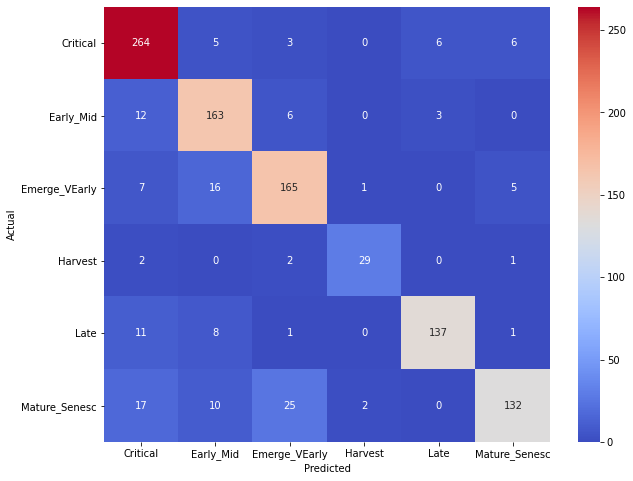

In [27]:
conf_mat = confusion_matrix(z_test, prediction)
fig, ax = plt.subplots(figsize=(10,8))
sns.heatmap(conf_mat, annot=True, fmt='d', cmap= 'coolwarm',
            xticklabels=labels, yticklabels=labels)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

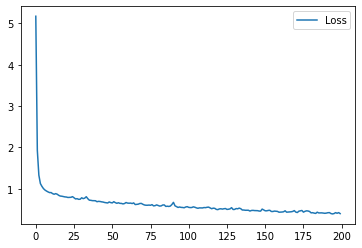

In [99]:
plt.plot(history.history['loss'], label='Loss')
plt.legend();

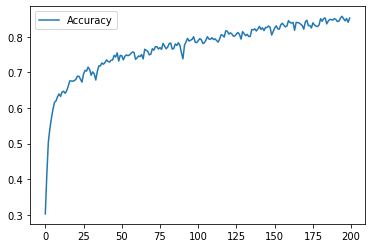

In [100]:
plt.plot(history.history['accuracy'], label='Accuracy')
plt.legend();

### More epochs

In [41]:
model = Sequential()
    #layer 1
model.add(Dense(64,
                   activation = 'relu',
                   input_dim = input_dim))

    #layer 2
model.add(Dense(128, activation = 'relu'))
    
    #layer 3
model.add(Dense(128, activation = 'relu'))

    #output layer
model.add(Dense(6, activation = 'softmax'))

    #Compile model
model.compile(loss = 'categorical_crossentropy' , optimizer = 'adam' , metrics = ['accuracy'] )

history = model.fit(X_train, y_train, epochs = 1700, batch_size = 512)

Epoch 1/1700
12/12 [==============================] - 0s 2ms/step - loss: 7.8756 - accuracy: 0.2848
Epoch 2/1700
12/12 [==============================] - 0s 2ms/step - loss: 1.7976 - accuracy: 0.4145
Epoch 3/1700
12/12 [==============================] - 0s 2ms/step - loss: 1.2546 - accuracy: 0.5251
Epoch 4/1700
12/12 [==============================] - 0s 2ms/step - loss: 1.0815 - accuracy: 0.5832
Epoch 5/1700
12/12 [==============================] - 0s 2ms/step - loss: 1.0209 - accuracy: 0.5913
Epoch 6/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.9881 - accuracy: 0.6087
Epoch 7/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.9261 - accuracy: 0.6384
Epoch 8/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.9507 - accuracy: 0.6152
Epoch 9/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.9304 - accuracy: 0.6301
Epoch 10/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.9220 - accuracy: 0.6287

12/12 [==============================] - 0s 2ms/step - loss: 0.4461 - accuracy: 0.8400
Epoch 163/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.4631 - accuracy: 0.8318
Epoch 164/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.4541 - accuracy: 0.8328
Epoch 165/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.4592 - accuracy: 0.8304
Epoch 166/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.4421 - accuracy: 0.8347
Epoch 167/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.4385 - accuracy: 0.8384
Epoch 168/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.4285 - accuracy: 0.8453
Epoch 169/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.4341 - accuracy: 0.8369
Epoch 170/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.4421 - accuracy: 0.8426
Epoch 171/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.4326 - accuracy: 0.

12/12 [==============================] - 0s 2ms/step - loss: 0.3021 - accuracy: 0.8847
Epoch 323/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.3083 - accuracy: 0.8864
Epoch 324/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.3033 - accuracy: 0.8885
Epoch 325/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.3026 - accuracy: 0.8920
Epoch 326/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.2993 - accuracy: 0.8881
Epoch 327/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.3099 - accuracy: 0.8832
Epoch 328/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2966 - accuracy: 0.8939
Epoch 329/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.3139 - accuracy: 0.8814
Epoch 330/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.3077 - accuracy: 0.8848
Epoch 331/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2967 - accuracy: 0.

12/12 [==============================] - 0s 1ms/step - loss: 0.2246 - accuracy: 0.9158
Epoch 483/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2367 - accuracy: 0.9112
Epoch 484/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2588 - accuracy: 0.9006
Epoch 485/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2100 - accuracy: 0.9240
Epoch 486/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1981 - accuracy: 0.9260
Epoch 487/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1987 - accuracy: 0.9278
Epoch 488/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.1848 - accuracy: 0.9335
Epoch 489/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.1986 - accuracy: 0.9238
Epoch 490/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.2387 - accuracy: 0.9113
Epoch 491/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.2079 - accuracy: 0.

12/12 [==============================] - 0s 2ms/step - loss: 0.1551 - accuracy: 0.9434
Epoch 643/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1593 - accuracy: 0.9389
Epoch 644/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1627 - accuracy: 0.9435
Epoch 645/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1737 - accuracy: 0.9349
Epoch 646/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1844 - accuracy: 0.9284
Epoch 647/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2074 - accuracy: 0.9237
Epoch 648/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1939 - accuracy: 0.9269
Epoch 649/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.2087 - accuracy: 0.9238
Epoch 650/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2091 - accuracy: 0.9196
Epoch 651/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1861 - accuracy: 0.

12/12 [==============================] - 0s 2ms/step - loss: 0.1013 - accuracy: 0.9661
Epoch 803/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0939 - accuracy: 0.9669
Epoch 804/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9646
Epoch 805/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1297 - accuracy: 0.9487
Epoch 806/1700
12/12 [==============================] - 0s 1ms/step - loss: 0.1227 - accuracy: 0.9540
Epoch 807/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1166 - accuracy: 0.9572
Epoch 808/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1213 - accuracy: 0.9519
Epoch 809/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1116 - accuracy: 0.9554
Epoch 810/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1256 - accuracy: 0.9504
Epoch 811/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1257 - accuracy: 0.

12/12 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9738
Epoch 963/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9699
Epoch 964/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1181 - accuracy: 0.9539
Epoch 965/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1257 - accuracy: 0.9527
Epoch 966/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1166 - accuracy: 0.9526
Epoch 967/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9624
Epoch 968/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9743
Epoch 969/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0799 - accuracy: 0.9723
Epoch 970/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1210 - accuracy: 0.9524
Epoch 971/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1080 - accuracy: 0.

12/12 [==============================] - 0s 2ms/step - loss: 0.1630 - accuracy: 0.9386
Epoch 1043/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.2272 - accuracy: 0.9215
Epoch 1044/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.3015 - accuracy: 0.8989
Epoch 1045/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1762 - accuracy: 0.9340
Epoch 1046/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1486 - accuracy: 0.9427
Epoch 1047/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1427 - accuracy: 0.9446
Epoch 1048/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1189 - accuracy: 0.9540
Epoch 1049/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1323 - accuracy: 0.9433
Epoch 1050/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1639 - accuracy: 0.9366
Epoch 1051/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1417 - acc

12/12 [==============================] - 0s 2ms/step - loss: 0.1140 - accuracy: 0.9583
Epoch 1201/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1180 - accuracy: 0.9547
Epoch 1202/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0991 - accuracy: 0.9615
Epoch 1203/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.1091 - accuracy: 0.9571
Epoch 1204/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0840 - accuracy: 0.9644
Epoch 1205/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0808 - accuracy: 0.9706
Epoch 1206/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0898 - accuracy: 0.9654
Epoch 1207/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0886 - accuracy: 0.9666
Epoch 1208/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9684
Epoch 1209/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0995 - acc

12/12 [==============================] - 0s 2ms/step - loss: 0.0715 - accuracy: 0.9705
Epoch 1359/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9751
Epoch 1360/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0762 - accuracy: 0.9691
Epoch 1361/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0653 - accuracy: 0.9760
Epoch 1362/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0504 - accuracy: 0.9827
Epoch 1363/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0655 - accuracy: 0.9737
Epoch 1364/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9770
Epoch 1365/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9790
Epoch 1366/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0522 - accuracy: 0.9812
Epoch 1367/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0591 - acc

12/12 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9901
Epoch 1517/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9895
Epoch 1518/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9904
Epoch 1519/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9880
Epoch 1520/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9922
Epoch 1521/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9930
Epoch 1522/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9909
Epoch 1523/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9845
Epoch 1524/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9881
Epoch 1525/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0355 - acc

12/12 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9926
Epoch 1675/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9940
Epoch 1676/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9962
Epoch 1677/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9976
Epoch 1678/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9965
Epoch 1679/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9959
Epoch 1680/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9944
Epoch 1681/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9943
Epoch 1682/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9951
Epoch 1683/1700
12/12 [==============================] - 0s 2ms/step - loss: 0.0179 - acc

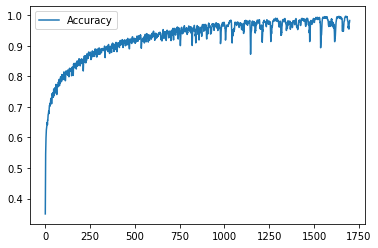

In [44]:
plt.plot(history.history['accuracy'], label='Accuracy')
plt.legend();

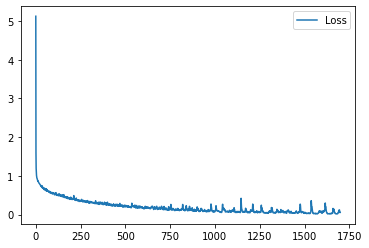

In [45]:
plt.plot(history.history['loss'], label='Loss')
plt.legend();

In [46]:
predictions = np.argmax(model.predict(X_test), axis=-1)
prediction = np.argmax(to_categorical(predictions), axis = 1)
prediction = encoder.inverse_transform(prediction)
correct = len([i for i, j in zip(prediction, z_test) if i == j])
perc_correct = round(len([i for i, j in zip(prediction, z_test) if i == j])*100/len(z_test), 2)
perc_correct

86.15

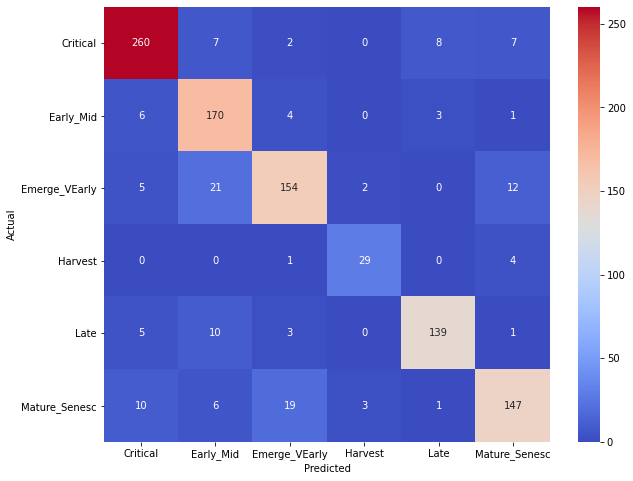

In [39]:
conf_mat = confusion_matrix(z_test, prediction)
fig, ax = plt.subplots(figsize=(10,8))
sns.heatmap(conf_mat, annot=True, fmt='d', cmap= 'coolwarm',
            xticklabels=labels, yticklabels=labels)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()